# Physical modeling

Code examples from [Think Complexity, 2nd edition](http://greenteapress.com/wp/complexity2), Chapter 7

Copyright 2016 Allen Downey, [MIT License](http://opensource.org/licenses/MIT)

In [2]:
from __future__ import print_function, division

%matplotlib inline
%precision 3

import warnings
warnings.filterwarnings('ignore')

import numpy as np
import matplotlib.pyplot as plt

import thinkplot

from matplotlib import rc
rc('animation', html='html5')

## Diffusion

Before we get to a Reaction-Diffusion model, we'll start with simple diffusion.

The kernel computes the difference between each cell and the sum of its neighbors.

At each time step, we compute this difference, multiply by a constant, and add it back in to the array.

In [3]:
from Cell2D import Cell2D, Cell2DViewer
from scipy.signal import correlate2d

class Diffusion(Cell2D):
    """Diffusion Cellular Automaton."""

    kernel = np.array([[0, 1, 0],
                       [1,-4, 1],
                       [0, 1, 0]])

    def __init__(self, n, m=None, r=0.1):
        """Initializes the attributes.

        n: number of rows
        m: number of columns
        r: diffusion rate constant
        """
        self.r = r
        m = n if m is None else m
        self.array = np.zeros((n, m), np.float)

    def step(self):
        """Executes one time step."""
        c = correlate2d(self.array, self.kernel, mode='same')
        self.array += self.r * c

We don't really have to customize the viewer.

In [4]:
class DiffusionViewer(Cell2DViewer):
    cmap = plt.get_cmap('Reds')

Here's a simple example starting with an "island" of material in the middle.

In [5]:
diff = Diffusion(n=9, r=0.1)
diff.add_cells(3, 3, '111', '111', '111')
viewer = DiffusionViewer(diff)

Here's the initial condition:

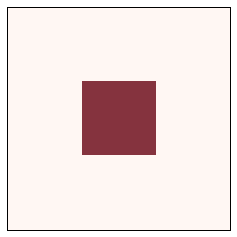

In [6]:
anim = viewer.animate()

And here's how it behaves over time: the "material" spreads out until the level is equal on the whole array.

In [7]:
anim

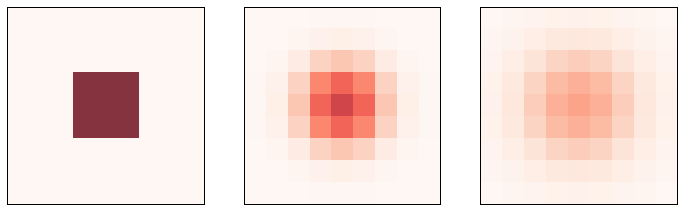

In [8]:
diff = Diffusion(n=9, r=0.1)
diff.add_cells(3, 3, '111', '111', '111')
viewer = DiffusionViewer(diff)

thinkplot.preplot(cols=3)
viewer.draw()

thinkplot.subplot(2)
viewer.step(5)
viewer.draw()

thinkplot.subplot(3)
viewer.step(10)
viewer.draw()

plt.savefig('chap07-1.pdf')

## Reaction-Diffusion

Now we'll add a second material and let them interact.

The following function helps with setting up the initial conditions.

In [9]:
def island(a, val, noise=None):
    """Adds an island in the middle of the array.
            
    val: height of the island
    noise: magnitude of random noise
    """
    noise = val if noise is None else noise
    n, m = a.shape
    r = min(n, m) // 20
    a[n//2-r:n//2+r, m//2-r:m//2+r] = val
    a += noise * np.random.random((n, m))

For the RD model, we have two arrays, one for each chemical.

Following [Sims](http://www.karlsims.com/rd.html), I'm using a kernel that includes the diagonal elements.  They have lower weights because they are farther from the center cell.

The `step` function computes these functions:

$\Delta A = r_a \nabla^2 A - AB^2 + f (1-A) $

$\Delta B = r_b \nabla^2 B + AB^2 - (k+f) B $

where $\nabla^2$ is the Laplace operator the kernel is intended to approximate.

In [10]:
class ReactionDiffusion(Cell2D):
    """Reaction-Diffusion Cellular Automaton."""

    kernel = np.array([[.05, .2, .05],
                       [ .2, -1, .2],
                       [.05, .2, .05]])

    options = dict(mode='same', boundary='wrap')

    def __init__(self, n, m=None, params=(0.5, 0.25, 0.035, 0.057)):
        """Initializes the attributes.

        n: number of rows
        m: number of columns
        params: tuple of (Da, Db, f, k)
        """
        
        self.params = params
        m = n if m is None else m
        self.array = np.ones((n, m), dtype=float)

        self.array2 = np.zeros((n, m), dtype=float)
        island(self.array2, val=0.1, noise=0.1)
        
    def step(self):
        """Executes one time step."""
        A = self.array
        B = self.array2
        ra, rb, f, k = self.params
        
        cA = correlate2d(A, self.kernel, **self.options)
        cB = correlate2d(B, self.kernel, **self.options)
        reaction = A * B**2
        self.array += ra * cA - reaction + f * (1-A) 
        self.array2 += rb * cB + reaction - (f+k) * B

The viewer for the CA shows both arrays with some transparency, so we can see where one, the other, or both, levels are high.

Unlike previous CAs, the state of each cell is meant to represent a continuous quantity, so it is appropriate to interpolate.

Note that `draw` has to make copies of the arrays because `step` updates the arrays in place.

In [11]:
class RDViewer(Cell2DViewer):
    """Generates images and animations."""
    
    cmapu = plt.get_cmap('Reds')
    cmapv = plt.get_cmap('Blues')

    options = dict(alpha=0.7,
                  interpolation='bicubic')
        
    def __init__(self, viewee):
        """Initializes the attributes.
        
        viewee: the object to be represented
        """
        self.viewee = viewee
        self.imu = None
        self.imv = None
        self.hlines = None
        self.vlines = None

    def draw(self, grid=False):
        """Draws the cells."""
        au = self.viewee.array.copy()
        av = self.viewee.array2.copy()
        
        n, m = av.shape
        plt.axis([0, m, 0, n])
        plt.xticks([])
        plt.yticks([])

        self.options['extent'] = [0, m, 0, n]
        self.imu = plt.imshow(au, cmap=self.cmapu, **self.options)
        self.imv = plt.imshow(av, cmap=self.cmapv, **self.options)

    def animate_func(self, i):
        """Draws one frame of the animation."""
        if i > 0:
            self.step(iters=100)

        self.imu.set_array(self.viewee.array)
        self.imv.set_array(self.viewee.array2)
        return (self.imu, self.imv)

Here's an example using `params3`, which yields blue dots that seem to undergo mitosis.

In [12]:
params1 = 0.5, 0.25, 0.035, 0.057   # white spots
params2 = 0.5, 0.25, 0.055, 0.062   # coral
params3 = 0.5, 0.25, 0.039, 0.065   # blue spots

rd = ReactionDiffusion(100, params=params3)
viewer = RDViewer(rd)

Here's a random starting condition with lots of A, a sprinkling of B everywhere, and an island of B in the middle.

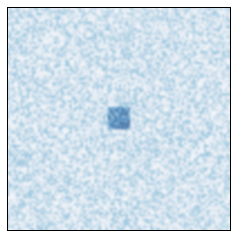

In [13]:
anim = viewer.animate(frames=100)

And here's how it behaves over time.

In [14]:
anim

I'll use the following function to generate figures using different parameters.

In [15]:
def make_viewer(f, k, n=100):
    """Makes a ReactionDiffusion viewer with given parameters.
    """
    params = 0.5, 0.25, f, k
    rd = ReactionDiffusion(n, params=params)
    viewer = RDViewer(rd)
    return viewer

These parameters yield pink stripes and spots on a blue background:

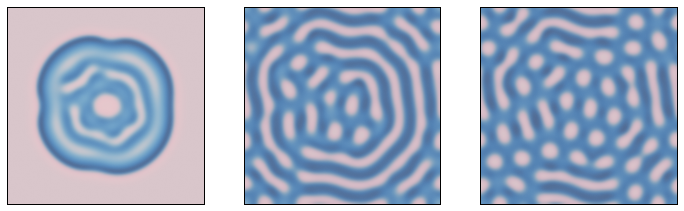

In [16]:
viewer = make_viewer(0.035, 0.057)

thinkplot.preplot(cols=3)
viewer.step(1000)
viewer.draw()

thinkplot.subplot(2)
viewer.step(2000)
viewer.draw()

thinkplot.subplot(3)
viewer.step(4000)
viewer.draw()

plt.savefig('chap07-2.pdf')

These parameters yield blue stripes on a pink background.

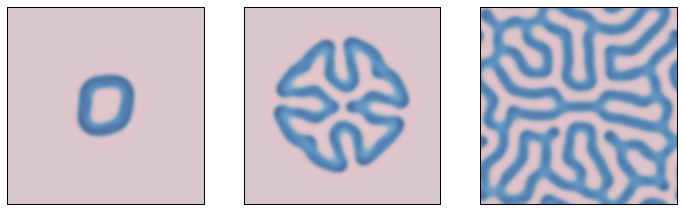

In [17]:
viewer = make_viewer(0.055, 0.062)

thinkplot.preplot(cols=3)
viewer.step(1000)
viewer.draw()

thinkplot.subplot(2)
viewer.step(2000)
viewer.draw()

thinkplot.subplot(3)
viewer.step(4000)
viewer.draw()

plt.savefig('chap07-3.pdf')

These parameters yield pink dots on a blue background

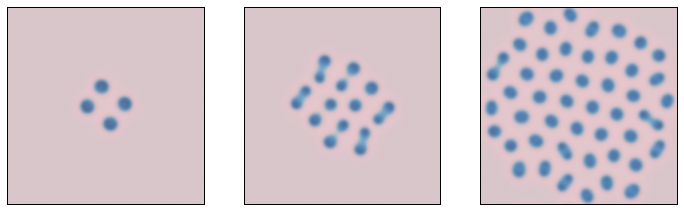

In [18]:
viewer = make_viewer(0.039, 0.065)

thinkplot.preplot(cols=3)
viewer.step(1000)
viewer.draw()

thinkplot.subplot(2)
viewer.step(2000)
viewer.draw()

thinkplot.subplot(3)
viewer.step(4000)
viewer.draw()

plt.savefig('chap07-4.pdf')

## Percolation

In the percolation model, each cell is porous with probability `p`.  We start with a row of wet cells at the time.  During each time step, a cell becomes wet if it is porous and at least one neighbor is wet (using a 4-cell neighborhood).  For each value of `p` we compute the probability that water reaches the bottom row.

Porous cells have state `1` and wet cells have state `5`, so if a cell has a wet neighbor, the sum of the neighbors will by `5` or more.


In [19]:
from scipy.signal import correlate2d

class Percolation(Cell2D):
    """Percolation Cellular Automaton."""

    kernel = np.array([[0, 1, 0],
                       [1, 0, 1],
                       [0, 1, 0]])

    def __init__(self, n, m=None, p=0.5, seed=None):
        """Initializes the attributes.

        n: number of rows
        m: number of columns
        p: probability of porousness
        """
        self.p = p
        m = n if m is None else m
        if seed is not None:
            np.random.seed(seed)
        self.array = np.random.choice([0, 1], (n, m), p=[1-p, p])
        
        # fill the top row with wet cells
        self.array[0] = 5

    def step(self):
        """Executes one time step."""
        a = self.array
        c = correlate2d(a, self.kernel, mode='same')
        print(c)
        self.array[(a==1) & (c>=5)] = 5
        
    def num_wet(self, cols=None):
        """Total number of wet cells.
        
        cols: number of columns to select
        """
        a = self.array[:, :cols]
        return np.sum(a == 5)
    
    def num_porous(self, cols=None):
        """Total number of porous cells."""
        a = self.array[:, :cols]
        return np.sum(a == 1)
    
    def bottom_row_wet(self):
        """Number of wet cells in the bottom row."""
        return np.sum(self.array[-1] == 5)

Nothing special about the viewer.

In [20]:
class PercolationViewer(Cell2DViewer):
    """Draws and animates a Percolation object."""
    cmap = plt.get_cmap('Blues')
    options = dict(alpha=0.6,
                   interpolation='none', 
                   vmin=0, vmax=5)

Here an example that shows the first three time steps.

[[ 5 11 11 11 10 10 11 11 11  5]
 [ 7  7  7  7  6  7  7  7  7  7]
 [ 2  3  3  1  3  2  3  3  2  2]
 [ 2  2  1  2  1  4  3  1  2  1]
 [ 1  2  1  0  3  3  2  1  1  1]
 [ 2  1  1  2  2  3  3  1  1  1]
 [ 0  3  2  1  3  3  2  2  1  2]
 [ 3  1  2  2  2  3  2  2  3  0]
 [ 1  4  2  3  1  2  3  3  1  3]
 [ 2  2  3  1  2  1  2  2  3  0]]
[[ 5 15 15 15 10 10 15 15 15  5]
 [11 11 15 11 10 11 11 15 11 11]
 [ 2  7  7  5  3  2  7  7  6  2]
 [ 2  2  1  2  1  4  3  1  2  1]
 [ 1  2  1  0  3  3  2  1  1  1]
 [ 2  1  1  2  2  3  3  1  1  1]
 [ 0  3  2  1  3  3  2  2  1  2]
 [ 3  1  2  2  2  3  2  2  3  0]
 [ 1  4  2  3  1  2  3  3  1  3]
 [ 2  2  3  1  2  1  2  2  3  0]]
[[ 5 15 15 15 10 10 15 15 15  5]
 [11 15 15 15 10 11 15 15 15 11]
 [ 6  7 15  5  7  6  7 15  6  6]
 [ 2  6  1  6  1  4  7  1  6  1]
 [ 1  2  1  0  3  3  2  1  1  1]
 [ 2  1  1  2  2  3  3  1  1  1]
 [ 0  3  2  1  3  3  2  2  1  2]
 [ 3  1  2  2  2  3  2  2  3  0]
 [ 1  4  2  3  1  2  3  3  1  3]
 [ 2  2  3  1  2  1  2  2  3  0]]


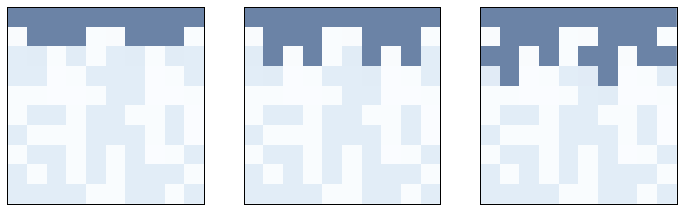

In [21]:
seed = 22
perc = Percolation(10, p=0.5, seed=seed)
viewer = PercolationViewer(perc)

thinkplot.preplot(cols=3)
viewer.step()
viewer.draw()

thinkplot.subplot(2)
viewer.step()
viewer.draw()

thinkplot.subplot(3)
viewer.step()
viewer.draw()

plt.savefig('chap07-5.pdf')

`test_perc` runs a percolation model and returns `True` if water reaches the bottom row and `False` otherwise.

In [22]:
def test_perc(perc):
    """Run a percolation model.
    
    Runs until water gets to the bottom row or nothing changes.
    
    returns: (boolean, number of steps)
    """
    num_wet = perc.num_wet()

    num_steps = 0
    while True:
        perc.step()
        num_steps += 1

        if perc.bottom_row_wet():
            return True, num_steps
        
        new_num_wet = perc.num_wet()
        if new_num_wet == num_wet:
            return False, num_steps

        num_wet = new_num_wet

Run a small example with `p=0.5` 

In [23]:
perc = Percolation(10, p=0.5, seed=seed)
flag, num_steps = test_perc(perc)
print(flag, num_steps)

[[ 5 11 11 11 10 10 11 11 11  5]
 [ 7  7  7  7  6  7  7  7  7  7]
 [ 2  3  3  1  3  2  3  3  2  2]
 [ 2  2  1  2  1  4  3  1  2  1]
 [ 1  2  1  0  3  3  2  1  1  1]
 [ 2  1  1  2  2  3  3  1  1  1]
 [ 0  3  2  1  3  3  2  2  1  2]
 [ 3  1  2  2  2  3  2  2  3  0]
 [ 1  4  2  3  1  2  3  3  1  3]
 [ 2  2  3  1  2  1  2  2  3  0]]
[[ 5 15 15 15 10 10 15 15 15  5]
 [11 11 15 11 10 11 11 15 11 11]
 [ 2  7  7  5  3  2  7  7  6  2]
 [ 2  2  1  2  1  4  3  1  2  1]
 [ 1  2  1  0  3  3  2  1  1  1]
 [ 2  1  1  2  2  3  3  1  1  1]
 [ 0  3  2  1  3  3  2  2  1  2]
 [ 3  1  2  2  2  3  2  2  3  0]
 [ 1  4  2  3  1  2  3  3  1  3]
 [ 2  2  3  1  2  1  2  2  3  0]]
[[ 5 15 15 15 10 10 15 15 15  5]
 [11 15 15 15 10 11 15 15 15 11]
 [ 6  7 15  5  7  6  7 15  6  6]
 [ 2  6  1  6  1  4  7  1  6  1]
 [ 1  2  1  0  3  3  2  1  1  1]
 [ 2  1  1  2  2  3  3  1  1  1]
 [ 0  3  2  1  3  3  2  2  1  2]
 [ 3  1  2  2  2  3  2  2  3  0]
 [ 1  4  2  3  1  2  3  3  1  3]
 [ 2  2  3  1  2  1  2  2  3  0]]
[[ 5 15

Here's the initial state:

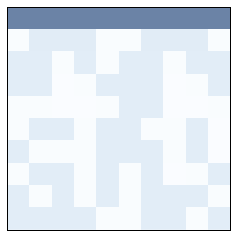

In [24]:
perc = Percolation(10, p=0.5, seed=seed)
viewer = PercolationViewer(perc)
anim = viewer.animate(frames=num_steps+1)

And here's the animation

In [25]:
anim

[[ 5 11 11 11 10 10 11 11 11  5]
 [ 7  7  7  7  6  7  7  7  7  7]
 [ 2  3  3  1  3  2  3  3  2  2]
 [ 2  2  1  2  1  4  3  1  2  1]
 [ 1  2  1  0  3  3  2  1  1  1]
 [ 2  1  1  2  2  3  3  1  1  1]
 [ 0  3  2  1  3  3  2  2  1  2]
 [ 3  1  2  2  2  3  2  2  3  0]
 [ 1  4  2  3  1  2  3  3  1  3]
 [ 2  2  3  1  2  1  2  2  3  0]]
[[ 5 15 15 15 10 10 15 15 15  5]
 [11 11 15 11 10 11 11 15 11 11]
 [ 2  7  7  5  3  2  7  7  6  2]
 [ 2  2  1  2  1  4  3  1  2  1]
 [ 1  2  1  0  3  3  2  1  1  1]
 [ 2  1  1  2  2  3  3  1  1  1]
 [ 0  3  2  1  3  3  2  2  1  2]
 [ 3  1  2  2  2  3  2  2  3  0]
 [ 1  4  2  3  1  2  3  3  1  3]
 [ 2  2  3  1  2  1  2  2  3  0]]
[[ 5 15 15 15 10 10 15 15 15  5]
 [11 15 15 15 10 11 15 15 15 11]
 [ 6  7 15  5  7  6  7 15  6  6]
 [ 2  6  1  6  1  4  7  1  6  1]
 [ 1  2  1  0  3  3  2  1  1  1]
 [ 2  1  1  2  2  3  3  1  1  1]
 [ 0  3  2  1  3  3  2  2  1  2]
 [ 3  1  2  2  2  3  2  2  3  0]
 [ 1  4  2  3  1  2  3  3  1  3]
 [ 2  2  3  1  2  1  2  2  3  0]]
[[ 5 15

For a given `p` we can estimate the probability of a percolating cluster by running several random configurations.

In [26]:
def estimate_prob_percolating(p=0.5, n=100, iters=100):
    """Estimates the probability of percolating.
    
    p: probability that a cell is permeable
    n: int number of rows and columns
    iters: number of arrays to test
    
    returns: float probability
    """
    count = 0
    for i in range(iters):
        perc = Percolation(n, p=p)
        flag, _ = test_perc(perc)
        if flag:
            count += 1
        
    return count / iters

At `p=0.55` the probability is low.

In [27]:
fraction = estimate_prob_percolating(p=0.55)
print(fraction)

[[ 6 11 11 ..., 10 10  6]
 [ 7  8  8 ...,  6  7  5]
 [ 2  4  3 ...,  2  1  3]
 ..., 
 [ 2  3  4 ...,  3  1  2]
 [ 1  3  3 ...,  2  3  1]
 [ 1  1  1 ...,  1  1  1]]
[[10 15 15 ..., 10 10 10]
 [11 16 16 ...,  6 11  5]
 [ 6  8  7 ...,  2  1  7]
 ..., 
 [ 2  3  4 ...,  3  1  2]
 [ 1  3  3 ...,  2  3  1]
 [ 1  1  1 ...,  1  1  1]]
[[10 15 15 ..., 10 10 10]
 [15 20 20 ...,  6 11  5]
 [10 16 11 ...,  2  1  7]
 ..., 
 [ 2  3  4 ...,  3  1  2]
 [ 1  3  3 ...,  2  3  1]
 [ 1  1  1 ...,  1  1  1]]
[[10 15 15 ..., 10 10 10]
 [15 20 20 ...,  6 11  5]
 [10 20 15 ...,  2  1  7]
 ..., 
 [ 2  3  4 ...,  3  1  2]
 [ 1  3  3 ...,  2  3  1]
 [ 1  1  1 ...,  1  1  1]]
[[10 15 15 ..., 10 10 10]
 [15 20 20 ...,  6 11  5]
 [10 20 15 ...,  2  1  7]
 ..., 
 [ 2  3  4 ...,  3  1  2]
 [ 1  3  3 ...,  2  3  1]
 [ 1  1  1 ...,  1  1  1]]
[[10 15 15 ..., 10 10 10]
 [15 20 20 ...,  6 11  5]
 [10 20 15 ...,  2  1  7]
 ..., 
 [ 2  3  4 ...,  3  1  2]
 [ 1  3  3 ...,  2  3  1]
 [ 1  1  1 ...,  1  1  1]]
[[10 15 15 ..., 

[[ 5 15 15 ..., 15 10 10]
 [10 10 15 ...,  5 15 10]
 [ 0 10 15 ..., 10 10 10]
 ..., 
 [ 1  0  2 ...,  1  3  3]
 [ 1  1  1 ...,  4  2  2]
 [ 0  1  2 ...,  0  2  1]]
[[ 5 15 15 ..., 15 10 10]
 [10 10 15 ...,  5 15 10]
 [ 0 10 15 ..., 10 10 10]
 ..., 
 [ 1  0  2 ...,  1  3  3]
 [ 1  1  1 ...,  4  2  2]
 [ 0  1  2 ...,  0  2  1]]
[[ 5 15 15 ..., 15 10 10]
 [10 10 15 ...,  5 15 10]
 [ 0 10 15 ..., 10 10 10]
 ..., 
 [ 1  0  2 ...,  1  3  3]
 [ 1  1  1 ...,  4  2  2]
 [ 0  1  2 ...,  0  2  1]]
[[ 5 15 15 ..., 15 10 10]
 [10 10 15 ...,  5 15 10]
 [ 0 10 15 ..., 10 10 10]
 ..., 
 [ 1  0  2 ...,  1  3  3]
 [ 1  1  1 ...,  4  2  2]
 [ 0  1  2 ...,  0  2  1]]
[[ 5 15 15 ..., 15 10 10]
 [10 10 15 ...,  5 15 10]
 [ 0 10 15 ..., 10 10 10]
 ..., 
 [ 1  0  2 ...,  1  3  3]
 [ 1  1  1 ...,  4  2  2]
 [ 0  1  2 ...,  0  2  1]]
[[ 5 15 15 ..., 15 10 10]
 [10 10 15 ...,  5 15 10]
 [ 0 10 15 ..., 10 10 10]
 ..., 
 [ 1  0  2 ...,  1  3  3]
 [ 1  1  1 ...,  4  2  2]
 [ 0  1  2 ...,  0  2  1]]
[[ 5 15 15 ..., 

[[10 10 15 ..., 15 10 10]
 [10 15 10 ..., 15 20  5]
 [10 11 10 ..., 20  6 11]
 ..., 
 [ 2  3  3 ...,  2  1  3]
 [ 1  3  1 ...,  2  3  2]
 [ 1  0  1 ...,  2  2  2]]
[[10 10 15 ..., 15 10 10]
 [10 15 10 ..., 15 20  5]
 [10 15 10 ..., 20 10 11]
 ..., 
 [ 2  3  3 ...,  2  1  3]
 [ 1  3  1 ...,  2  3  2]
 [ 1  0  1 ...,  2  2  2]]
[[10 10 15 ..., 15 10 10]
 [10 15 10 ..., 15 20  5]
 [10 15 10 ..., 20 10 15]
 ..., 
 [ 2  3  3 ...,  2  1  3]
 [ 1  3  1 ...,  2  3  2]
 [ 1  0  1 ...,  2  2  2]]
[[10 10 15 ..., 15 10 10]
 [10 15 10 ..., 15 20  5]
 [10 15 10 ..., 20 10 15]
 ..., 
 [ 2  3  3 ...,  2  1  3]
 [ 1  3  1 ...,  2  3  2]
 [ 1  0  1 ...,  2  2  2]]
[[10 10 15 ..., 15 10 10]
 [10 15 10 ..., 15 20  5]
 [10 15 10 ..., 20 10 15]
 ..., 
 [ 2  3  3 ...,  2  1  3]
 [ 1  3  1 ...,  2  3  2]
 [ 1  0  1 ...,  2  2  2]]
[[10 10 15 ..., 15 10 10]
 [10 15 10 ..., 15 20  5]
 [10 15 10 ..., 20 10 15]
 ..., 
 [ 2  3  3 ...,  2  1  3]
 [ 1  3  1 ...,  2  3  2]
 [ 1  0  1 ...,  2  2  2]]
[[10 10 15 ..., 

[[ 5 10 15 ..., 15 15  5]
 [10 15 10 ..., 15 15 15]
 [10 10 20 ..., 16 10 10]
 ..., 
 [ 2  3  2 ...,  3  4  3]
 [ 1  1  3 ...,  4  3  2]
 [ 0  1  1 ...,  2  2  1]]
[[ 5 10 15 ..., 15 15  5]
 [10 15 10 ..., 15 15 15]
 [10 10 20 ..., 16 10 10]
 ..., 
 [ 2  3  2 ...,  3  4  3]
 [ 1  1  3 ...,  4  3  2]
 [ 0  1  1 ...,  2  2  1]]
[[ 5 10 15 ..., 15 15  5]
 [10 15 10 ..., 15 15 15]
 [10 10 20 ..., 16 10 10]
 ..., 
 [ 2  3  2 ...,  3  4  3]
 [ 1  1  3 ...,  4  3  2]
 [ 0  1  1 ...,  2  2  1]]
[[ 5 10 15 ..., 15 15  5]
 [10 15 10 ..., 15 15 15]
 [10 10 20 ..., 16 10 10]
 ..., 
 [ 2  3  2 ...,  3  4  3]
 [ 1  1  3 ...,  4  3  2]
 [ 0  1  1 ...,  2  2  1]]
[[ 5 10 15 ..., 15 15  5]
 [10 15 10 ..., 15 15 15]
 [10 10 20 ..., 16 10 10]
 ..., 
 [ 2  3  2 ...,  3  4  3]
 [ 1  1  3 ...,  4  3  2]
 [ 0  1  1 ...,  2  2  1]]
[[ 5 10 15 ..., 15 15  5]
 [10 15 10 ..., 15 15 15]
 [10 10 20 ..., 20 10 10]
 ..., 
 [ 2  3  2 ...,  3  4  3]
 [ 1  1  3 ...,  4  3  2]
 [ 0  1  1 ...,  2  2  1]]
[[ 5 10 15 ..., 

 [ 2  2  3 ...,  2  0  1]]
[[10 10 10 ..., 15 15 10]
 [10 15 15 ..., 15 20 10]
 [15 15 15 ..., 20  5 15]
 ..., 
 [ 2  0  2 ...,  3  3  2]
 [ 1  3  2 ...,  1  3  1]
 [ 2  2  3 ...,  2  0  1]]
[[10 10 10 ..., 15 15 10]
 [10 15 15 ..., 15 20 10]
 [15 15 15 ..., 20  5 15]
 ..., 
 [ 2  0  2 ...,  3  3  2]
 [ 1  3  2 ...,  1  3  1]
 [ 2  2  3 ...,  2  0  1]]
[[10 10 10 ..., 15 15 10]
 [10 15 15 ..., 15 20 10]
 [15 15 15 ..., 20  5 15]
 ..., 
 [ 2  0  2 ...,  3  3  2]
 [ 1  3  2 ...,  1  3  1]
 [ 2  2  3 ...,  2  0  1]]
[[10 10 10 ..., 15 15 10]
 [10 15 15 ..., 15 20 10]
 [15 15 15 ..., 20  5 15]
 ..., 
 [ 2  0  2 ...,  3  3  2]
 [ 1  3  2 ...,  1  3  1]
 [ 2  2  3 ...,  2  0  1]]
[[10 10 10 ..., 15 15 10]
 [10 15 15 ..., 15 20 10]
 [15 15 15 ..., 20  5 15]
 ..., 
 [ 2  0  2 ...,  3  3  2]
 [ 1  3  2 ...,  1  3  1]
 [ 2  2  3 ...,  2  0  1]]
[[10 10 10 ..., 15 15 10]
 [10 15 15 ..., 15 20 10]
 [15 15 15 ..., 20  5 15]
 ..., 
 [ 2  0  2 ...,  3  3  2]
 [ 1  3  2 ...,  1  3  1]
 [ 2  2  3 ..., 

[[10 10 10 ..., 10 10 10]
 [10 15 10 ..., 10 10  5]
 [10  5  5 ...,  5  0  6]
 ..., 
 [ 2  3  4 ...,  3  3  2]
 [ 1  3  2 ...,  3  3  2]
 [ 1  1  2 ...,  3  1  1]]
[[10 10 10 ..., 10 10 10]
 [10 15 10 ..., 10 10  5]
 [10  5  5 ...,  5  0  6]
 ..., 
 [ 2  3  4 ...,  3  3  2]
 [ 1  3  2 ...,  3  3  2]
 [ 1  1  2 ...,  3  1  1]]
[[10 10 10 ..., 10 10 10]
 [10 15 10 ..., 10 10  5]
 [10  5  5 ...,  5  0  6]
 ..., 
 [ 2  3  4 ...,  3  3  2]
 [ 1  3  2 ...,  3  3  2]
 [ 1  1  2 ...,  3  1  1]]
[[10 10 10 ..., 10 10 10]
 [10 15 10 ..., 10 10  5]
 [10  5  5 ...,  5  0  6]
 ..., 
 [ 2  3  4 ...,  3  3  2]
 [ 1  3  2 ...,  3  3  2]
 [ 1  1  2 ...,  3  1  1]]
[[10 10 10 ..., 10 10 10]
 [10 15 10 ..., 10 10  5]
 [10  5  5 ...,  5  0  6]
 ..., 
 [ 2  3  4 ...,  3  3  2]
 [ 1  3  2 ...,  3  3  2]
 [ 1  1  2 ...,  3  1  1]]
[[10 10 10 ..., 10 10 10]
 [10 15 10 ..., 10 10  5]
 [10  5  5 ...,  5  0  6]
 ..., 
 [ 2  3  4 ...,  3  3  2]
 [ 1  3  2 ...,  3  3  2]
 [ 1  1  2 ...,  3  1  1]]
[[10 10 10 ..., 

[[ 5 10 15 ..., 15 15 10]
 [ 6 10 15 ..., 10 20 15]
 [ 0  7  5 ..., 11 15 10]
 ..., 
 [ 2  1  1 ...,  2  3  0]
 [ 1  3  1 ...,  2  0  2]
 [ 2  1  1 ...,  1  1  0]]
[[ 5 10 15 ..., 15 15 10]
 [ 6 10 15 ..., 10 20 15]
 [ 0  7  5 ..., 11 15 10]
 ..., 
 [ 2  1  1 ...,  2  3  0]
 [ 1  3  1 ...,  2  0  2]
 [ 2  1  1 ...,  1  1  0]]
[[ 5 10 15 ..., 15 15 10]
 [ 6 10 15 ..., 10 20 15]
 [ 0  7  5 ..., 11 15 10]
 ..., 
 [ 2  1  1 ...,  2  3  0]
 [ 1  3  1 ...,  2  0  2]
 [ 2  1  1 ...,  1  1  0]]
[[ 5 10 15 ..., 15 15 10]
 [ 6 10 15 ..., 10 20 15]
 [ 0  7  5 ..., 11 15 10]
 ..., 
 [ 2  1  1 ...,  2  3  0]
 [ 1  3  1 ...,  2  0  2]
 [ 2  1  1 ...,  1  1  0]]
[[ 5 10 15 ..., 15 15 10]
 [ 6 10 15 ..., 10 20 15]
 [ 0  7  5 ..., 11 15 10]
 ..., 
 [ 2  1  1 ...,  2  3  0]
 [ 1  3  1 ...,  2  0  2]
 [ 2  1  1 ...,  1  1  0]]
[[ 5 10 15 ..., 15 15 10]
 [ 6 10 15 ..., 10 20 15]
 [ 0  7  5 ..., 11 15 10]
 ..., 
 [ 2  1  1 ...,  2  3  0]
 [ 1  3  1 ...,  2  0  2]
 [ 2  1  1 ...,  1  1  0]]
[[ 5 10 15 ..., 

 [ 1  3  0 ...,  2  2  1]]
[[10 15 15 ..., 15 10  5]
 [15 20 15 ..., 10 10  6]
 [15 15 10 ..., 15  6  0]
 ..., 
 [ 2  1  1 ...,  2  2  1]
 [ 2  1  3 ...,  1  2  2]
 [ 1  3  0 ...,  2  2  1]]
[[10 15 15 ..., 15 10  5]
 [15 20 15 ..., 10 10  6]
 [15 15 10 ..., 15  6  0]
 ..., 
 [ 2  1  1 ...,  2  2  1]
 [ 2  1  3 ...,  1  2  2]
 [ 1  3  0 ...,  2  2  1]]
[[10 15 15 ..., 15 10  5]
 [15 20 15 ..., 10 10  6]
 [15 15 10 ..., 15  6  0]
 ..., 
 [ 2  1  1 ...,  2  2  1]
 [ 2  1  3 ...,  1  2  2]
 [ 1  3  0 ...,  2  2  1]]
[[10 15 15 ..., 15 10  5]
 [15 20 15 ..., 10 10  6]
 [15 15 10 ..., 15  6  0]
 ..., 
 [ 2  1  1 ...,  2  2  1]
 [ 2  1  3 ...,  1  2  2]
 [ 1  3  0 ...,  2  2  1]]
[[10 15 15 ..., 15 10  5]
 [15 20 15 ..., 10 10  6]
 [15 15 10 ..., 15  6  0]
 ..., 
 [ 2  1  1 ...,  2  2  1]
 [ 2  1  3 ...,  1  2  2]
 [ 1  3  0 ...,  2  2  1]]
[[10 15 15 ..., 15 10  5]
 [15 20 15 ..., 10 10  6]
 [15 15 10 ..., 15  6  0]
 ..., 
 [ 2  1  1 ...,  2  2  1]
 [ 2  1  3 ...,  1  2  2]
 [ 1  3  0 ..., 

[[ 5 15 15 ..., 10 15  5]
 [15 15 15 ..., 20  5 11]
 [ 5 20 15 ...,  5 12  0]
 ..., 
 [ 2  2  4 ...,  2  3  0]
 [ 2  2  3 ...,  2  0  3]
 [ 0  2  1 ...,  1  3  0]]
[[ 5 15 15 ..., 10 15  5]
 [15 15 15 ..., 20  5 11]
 [ 5 20 15 ...,  5 12  0]
 ..., 
 [ 2  2  4 ...,  2  3  0]
 [ 2  2  3 ...,  2  0  3]
 [ 0  2  1 ...,  1  3  0]]
[[ 5 15 15 ..., 10 15  5]
 [15 15 15 ..., 20  5 11]
 [ 5 20 15 ...,  5 12  0]
 ..., 
 [ 2  2  4 ...,  2  3  0]
 [ 2  2  3 ...,  2  0  3]
 [ 0  2  1 ...,  1  3  0]]
[[ 5 15 15 ..., 10 15  5]
 [15 15 15 ..., 20  5 11]
 [ 5 20 15 ...,  5 12  0]
 ..., 
 [ 2  2  4 ...,  2  3  0]
 [ 2  2  3 ...,  2  0  3]
 [ 0  2  1 ...,  1  3  0]]
[[ 5 15 15 ..., 10 15  5]
 [15 15 15 ..., 20  5 11]
 [ 5 20 15 ...,  5 12  0]
 ..., 
 [ 2  2  4 ...,  2  3  0]
 [ 2  2  3 ...,  2  0  3]
 [ 0  2  1 ...,  1  3  0]]
[[ 5 15 15 ..., 10 15  5]
 [15 15 15 ..., 20  5 11]
 [ 5 20 15 ...,  5 12  0]
 ..., 
 [ 2  2  4 ...,  2  3  0]
 [ 2  2  3 ...,  2  0  3]
 [ 0  2  1 ...,  1  3  0]]
[[ 5 15 15 ..., 

[[10 10 10 ..., 15 10 10]
 [ 5 15 10 ...,  5 15  5]
 [15 10 10 ...,  5  1  6]
 ..., 
 [ 2  2  1 ...,  0  1  1]
 [ 2  2  1 ...,  3  2  1]
 [ 2  1  1 ...,  2  2  2]]
[[10 10 10 ..., 15 10 10]
 [ 5 15 10 ...,  5 15  5]
 [15 10 10 ...,  5  1  6]
 ..., 
 [ 2  2  1 ...,  0  1  1]
 [ 2  2  1 ...,  3  2  1]
 [ 2  1  1 ...,  2  2  2]]
[[10 10 10 ..., 15 10 10]
 [ 5 15 10 ...,  5 15  5]
 [15 10 10 ...,  5  1  6]
 ..., 
 [ 2  2  1 ...,  0  1  1]
 [ 2  2  1 ...,  3  2  1]
 [ 2  1  1 ...,  2  2  2]]
[[10 10 10 ..., 15 10 10]
 [ 5 15 10 ...,  5 15  5]
 [15 10 10 ...,  5  1  6]
 ..., 
 [ 2  2  1 ...,  0  1  1]
 [ 2  2  1 ...,  3  2  1]
 [ 2  1  1 ...,  2  2  2]]
[[10 10 10 ..., 15 10 10]
 [ 5 15 10 ...,  5 15  5]
 [15 10 10 ...,  5  1  6]
 ..., 
 [ 2  2  1 ...,  0  1  1]
 [ 2  2  1 ...,  3  2  1]
 [ 2  1  1 ...,  2  2  2]]
[[10 10 10 ..., 15 10 10]
 [ 5 15 10 ...,  5 15  5]
 [15 10 10 ...,  5  1  6]
 ..., 
 [ 2  2  1 ...,  0  1  1]
 [ 2  2  1 ...,  3  2  1]
 [ 2  1  1 ...,  2  2  2]]
[[10 10 10 ..., 

[[10 10 15 ..., 10 15  5]
 [10 15 10 ..., 15 10 15]
 [10  5 10 ..., 15 10 10]
 ..., 
 [ 1  0  1 ...,  2  2  2]
 [ 1  1  1 ...,  1  3  3]
 [ 0  2  2 ...,  3  2  2]]
[[10 10 15 ..., 10 15  5]
 [10 15 10 ..., 15 10 15]
 [10  5 10 ..., 15 10 10]
 ..., 
 [ 1  0  1 ...,  2  2  2]
 [ 1  1  1 ...,  1  3  3]
 [ 0  2  2 ...,  3  2  2]]
[[10 10 15 ..., 10 15  5]
 [10 15 10 ..., 15 10 15]
 [10  5 10 ..., 15 10 10]
 ..., 
 [ 1  0  1 ...,  2  2  2]
 [ 1  1  1 ...,  1  3  3]
 [ 0  2  2 ...,  3  2  2]]
[[10 10 15 ..., 10 15  5]
 [10 15 10 ..., 15 10 15]
 [10  5 10 ..., 15 10 10]
 ..., 
 [ 1  0  1 ...,  2  2  2]
 [ 1  1  1 ...,  1  3  3]
 [ 0  2  2 ...,  3  2  2]]
[[10 10 15 ..., 10 15  5]
 [10 15 10 ..., 15 10 15]
 [10  5 10 ..., 15 10 10]
 ..., 
 [ 1  0  1 ...,  2  2  2]
 [ 1  1  1 ...,  1  3  3]
 [ 0  2  2 ...,  3  2  2]]
[[10 10 15 ..., 10 15  5]
 [10 15 10 ..., 15 10 15]
 [10  5 10 ..., 15 10 10]
 ..., 
 [ 1  0  1 ...,  2  2  2]
 [ 1  1  1 ...,  1  3  3]
 [ 0  2  2 ...,  3  2  2]]
[[10 10 15 ..., 

 [ 1  2  1 ...,  2  0  1]]
[[10 15 15 ..., 15 10 10]
 [10 20 10 ..., 10 15 10]
 [10 10 10 ...,  5 15 10]
 ..., 
 [ 2  2  1 ...,  3  1  2]
 [ 2  2  3 ...,  2  3  0]
 [ 1  2  1 ...,  2  0  1]]
[[10 15 15 ..., 15 10 10]
 [10 20 10 ..., 10 15 10]
 [10 10 10 ...,  5 15 10]
 ..., 
 [ 2  2  1 ...,  3  1  2]
 [ 2  2  3 ...,  2  3  0]
 [ 1  2  1 ...,  2  0  1]]
[[10 15 15 ..., 15 10 10]
 [10 20 10 ..., 10 15 10]
 [10 10 10 ...,  5 15 10]
 ..., 
 [ 2  2  1 ...,  3  1  2]
 [ 2  2  3 ...,  2  3  0]
 [ 1  2  1 ...,  2  0  1]]
[[10 15 15 ..., 15 10 10]
 [10 20 10 ..., 10 15 10]
 [10 10 10 ...,  5 15 10]
 ..., 
 [ 2  2  1 ...,  3  1  2]
 [ 2  2  3 ...,  2  3  0]
 [ 1  2  1 ...,  2  0  1]]
[[10 15 15 ..., 15 10 10]
 [10 20 10 ..., 10 15 10]
 [10 10 10 ...,  5 15 10]
 ..., 
 [ 2  2  1 ...,  3  1  2]
 [ 2  2  3 ...,  2  3  0]
 [ 1  2  1 ...,  2  0  1]]
[[10 15 15 ..., 15 10 10]
 [10 20 10 ..., 10 15 10]
 [10 10 10 ...,  5 15 10]
 ..., 
 [ 2  2  1 ...,  3  1  2]
 [ 2  2  3 ...,  2  3  0]
 [ 1  2  1 ..., 

[[ 5 15 15 ..., 10 10 10]
 [15 15 10 ...,  5 11  5]
 [10 15 15 ...,  2  1  6]
 ..., 
 [ 1  2  3 ...,  2  0  1]
 [ 1  2  3 ...,  1  2  0]
 [ 0  2  2 ...,  2  0  1]]
[[ 5 15 15 ..., 10 10 10]
 [15 15 10 ...,  5 11  5]
 [10 15 15 ...,  2  1  6]
 ..., 
 [ 1  2  3 ...,  2  0  1]
 [ 1  2  3 ...,  1  2  0]
 [ 0  2  2 ...,  2  0  1]]
[[ 5 15 15 ..., 10 10 10]
 [15 15 10 ...,  5 11  5]
 [10 15 15 ...,  2  1  6]
 ..., 
 [ 1  2  3 ...,  2  0  1]
 [ 1  2  3 ...,  1  2  0]
 [ 0  2  2 ...,  2  0  1]]
[[ 5 15 15 ..., 10 10 10]
 [15 15 10 ...,  5 11  5]
 [10 15 15 ...,  2  1  6]
 ..., 
 [ 1  2  3 ...,  2  0  1]
 [ 1  2  3 ...,  1  2  0]
 [ 0  2  2 ...,  2  0  1]]
[[ 5 15 15 ..., 10 10 10]
 [15 15 10 ...,  5 11  5]
 [10 15 15 ...,  2  1  6]
 ..., 
 [ 1  2  3 ...,  2  0  1]
 [ 1  2  3 ...,  1  2  0]
 [ 0  2  2 ...,  2  0  1]]
[[ 5 15 15 ..., 10 10 10]
 [15 15 10 ...,  5 11  5]
 [10 15 15 ...,  2  1  6]
 ..., 
 [ 1  2  3 ...,  2  0  1]
 [ 1  2  3 ...,  1  2  0]
 [ 0  2  2 ...,  2  0  1]]
[[ 5 15 15 ..., 

[[ 5 10 10 ..., 15 15  5]
 [ 6  6  6 ..., 10 10 11]
 [ 2  2  2 ..., 15  6  0]
 ..., 
 [ 2  4  3 ...,  2  1  1]
 [ 3  3  3 ...,  1  3  2]
 [ 1  2  2 ...,  3  1  1]]
[[ 6 11 11 ..., 11 10  6]
 [ 6  8  7 ...,  7  8  5]
 [ 2  1  3 ...,  4  2  3]
 ..., 
 [ 2  1  1 ...,  2  3  2]
 [ 1  2  1 ...,  1  3  2]
 [ 2  2  1 ...,  1  1  1]]
[[10 15 15 ..., 15 10 10]
 [10 16 15 ..., 11 16  5]
 [ 6  5  7 ...,  8  2  7]
 ..., 
 [ 2  1  1 ...,  2  3  2]
 [ 1  2  1 ...,  1  3  2]
 [ 2  2  1 ...,  1  1  1]]
[[10 15 15 ..., 15 10 10]
 [10 20 15 ..., 15 16  5]
 [10  5 15 ..., 12  6  7]
 ..., 
 [ 2  1  1 ...,  2  3  2]
 [ 1  2  1 ...,  1  3  2]
 [ 2  2  1 ...,  1  1  1]]
[[10 15 15 ..., 15 10 10]
 [10 20 15 ..., 15 20  5]
 [10  5 15 ..., 20  6 11]
 ..., 
 [ 2  1  1 ...,  2  3  2]
 [ 1  2  1 ...,  1  3  2]
 [ 2  2  1 ...,  1  1  1]]
[[10 15 15 ..., 15 10 10]
 [10 20 15 ..., 15 20  5]
 [10  5 15 ..., 20 10 11]
 ..., 
 [ 2  1  1 ...,  2  3  2]
 [ 1  2  1 ...,  1  3  2]
 [ 2  2  1 ...,  1  1  1]]
[[10 15 15 ..., 

 [ 2  3  2 ...,  1  2  1]]
[[ 5 10 10 ..., 10 10 10]
 [ 5  6  6 ...,  6 10  5]
 [ 1  1  3 ...,  1  1  5]
 ..., 
 [ 3  2  3 ...,  2  2  2]
 [ 3  4  2 ...,  3  2  2]
 [ 2  3  2 ...,  1  2  1]]
[[ 5 10 10 ..., 10 10 10]
 [ 5  6  6 ...,  6 10  5]
 [ 1  1  3 ...,  1  1  5]
 ..., 
 [ 3  2  3 ...,  2  2  2]
 [ 3  4  2 ...,  3  2  2]
 [ 2  3  2 ...,  1  2  1]]
[[ 5 10 10 ..., 10 10 10]
 [ 5  6  6 ...,  6 10  5]
 [ 1  1  3 ...,  1  1  5]
 ..., 
 [ 3  2  3 ...,  2  2  2]
 [ 3  4  2 ...,  3  2  2]
 [ 2  3  2 ...,  1  2  1]]
[[ 5 10 10 ..., 10 10 10]
 [ 5  6  6 ...,  6 10  5]
 [ 1  1  3 ...,  1  1  5]
 ..., 
 [ 3  2  3 ...,  2  2  2]
 [ 3  4  2 ...,  3  2  2]
 [ 2  3  2 ...,  1  2  1]]
[[ 5 10 10 ..., 10 10 10]
 [ 5  6  6 ...,  6 10  5]
 [ 1  1  3 ...,  1  1  5]
 ..., 
 [ 3  2  3 ...,  2  2  2]
 [ 3  4  2 ...,  3  2  2]
 [ 2  3  2 ...,  1  2  1]]
[[ 5 10 10 ..., 10 10 10]
 [ 5  6  6 ...,  6 10  5]
 [ 1  1  3 ...,  1  1  5]
 ..., 
 [ 3  2  3 ...,  2  2  2]
 [ 3  4  2 ...,  3  2  2]
 [ 2  3  2 ..., 

[[ 5 15 15 ..., 15 10  5]
 [10 15 15 ..., 15 10  6]
 [ 5 10 15 ..., 10 11  0]
 ..., 
 [ 1  1  4 ...,  2  3  3]
 [ 1  3  1 ...,  1  2  2]
 [ 1  1  2 ...,  1  1  1]]
[[ 5 15 15 ..., 15 10  5]
 [10 15 15 ..., 15 10  6]
 [ 5 10 15 ..., 10 11  0]
 ..., 
 [ 1  1  4 ...,  2  3  3]
 [ 1  3  1 ...,  1  2  2]
 [ 1  1  2 ...,  1  1  1]]
[[ 5 15 15 ..., 15 10  5]
 [10 15 15 ..., 15 10  6]
 [ 5 10 15 ..., 10 11  0]
 ..., 
 [ 1  1  4 ...,  2  3  3]
 [ 1  3  1 ...,  1  2  2]
 [ 1  1  2 ...,  1  1  1]]
[[ 5 15 15 ..., 15 10  5]
 [10 15 15 ..., 15 10  6]
 [ 5 10 15 ..., 10 11  0]
 ..., 
 [ 1  1  4 ...,  2  3  3]
 [ 1  3  1 ...,  1  2  2]
 [ 1  1  2 ...,  1  1  1]]
[[ 5 15 15 ..., 15 10  5]
 [10 15 15 ..., 15 10  6]
 [ 5 10 15 ..., 10 11  0]
 ..., 
 [ 1  1  4 ...,  2  3  3]
 [ 1  3  1 ...,  1  2  2]
 [ 1  1  2 ...,  1  1  1]]
[[ 5 15 15 ..., 15 10  5]
 [10 15 15 ..., 15 10  6]
 [ 5 10 15 ..., 10 11  0]
 ..., 
 [ 1  1  4 ...,  2  3  3]
 [ 1  3  1 ...,  1  2  2]
 [ 1  1  2 ...,  1  1  1]]
[[ 5 15 15 ..., 

[[10 15 15 ..., 10 10 10]
 [15 15 15 ..., 15 15  5]
 [ 5 11 10 ..., 10 10 15]
 ..., 
 [ 2  0  3 ...,  2  1  3]
 [ 1  2  2 ...,  3  4  1]
 [ 0  2  1 ...,  3  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 15 15 ..., 15 15  5]
 [ 5 11 10 ..., 10 10 15]
 ..., 
 [ 2  0  3 ...,  2  1  3]
 [ 1  2  2 ...,  3  4  1]
 [ 0  2  1 ...,  3  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 15 15 ..., 15 15  5]
 [ 5 11 10 ..., 10 10 15]
 ..., 
 [ 2  0  3 ...,  2  1  3]
 [ 1  2  2 ...,  3  4  1]
 [ 0  2  1 ...,  3  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 15 15 ..., 15 15  5]
 [ 5 11 10 ..., 10 10 15]
 ..., 
 [ 2  0  3 ...,  2  1  3]
 [ 1  2  2 ...,  3  4  1]
 [ 0  2  1 ...,  3  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 15 15 ..., 15 15  5]
 [ 5 11 10 ..., 10 10 15]
 ..., 
 [ 2  0  3 ...,  2  1  3]
 [ 1  2  2 ...,  3  4  1]
 [ 0  2  1 ...,  3  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 15 15 ..., 15 15  5]
 [ 5 11 10 ..., 10 10 15]
 ..., 
 [ 2  0  3 ...,  2  1  3]
 [ 1  2  2 ...,  3  4  1]
 [ 0  2  1 ...,  3  2  2]]
[[10 15 15 ..., 

[[10 15 15 ..., 15 15 10]
 [10 20 15 ..., 20 20 15]
 [10 10 15 ..., 15 20 15]
 ..., 
 [ 2  1  1 ...,  2  2  2]
 [ 1  1  1 ...,  2  2  2]
 [ 0  1  1 ...,  0  2  1]]
[[10 15 15 ..., 15 15 10]
 [10 20 15 ..., 20 20 15]
 [10 10 15 ..., 15 20 15]
 ..., 
 [ 2  1  1 ...,  2  2  2]
 [ 1  1  1 ...,  2  2  2]
 [ 0  1  1 ...,  0  2  1]]
[[10 15 15 ..., 15 15 10]
 [10 20 15 ..., 20 20 15]
 [10 10 15 ..., 15 20 15]
 ..., 
 [ 2  1  1 ...,  2  2  2]
 [ 1  1  1 ...,  2  2  2]
 [ 0  1  1 ...,  0  2  1]]
[[10 15 15 ..., 15 15 10]
 [10 20 15 ..., 20 20 15]
 [10 10 15 ..., 15 20 15]
 ..., 
 [ 2  1  1 ...,  2  2  2]
 [ 1  1  1 ...,  2  2  2]
 [ 0  1  1 ...,  0  2  1]]
[[10 15 15 ..., 15 15 10]
 [10 20 15 ..., 20 20 15]
 [10 10 15 ..., 15 20 15]
 ..., 
 [ 2  1  1 ...,  2  2  2]
 [ 1  1  1 ...,  2  2  2]
 [ 0  1  1 ...,  0  2  1]]
[[10 15 15 ..., 15 15 10]
 [10 20 15 ..., 20 20 15]
 [10 10 15 ..., 15 20 15]
 ..., 
 [ 2  1  1 ...,  2  2  2]
 [ 1  1  1 ...,  2  2  2]
 [ 0  1  1 ...,  0  2  1]]
[[10 15 15 ..., 

[[ 5 15 15 ..., 10 10 10]
 [15 15 20 ..., 10 10  5]
 [ 5 15 15 ...,  5 10  5]
 ..., 
 [ 2  2  2 ...,  2  3  3]
 [ 1  3  1 ...,  3  3  2]
 [ 2  0  1 ...,  1  3  2]]
[[ 5 15 15 ..., 10 10 10]
 [15 15 20 ..., 10 10  5]
 [ 5 15 15 ...,  5 10  5]
 ..., 
 [ 2  2  2 ...,  2  3  3]
 [ 1  3  1 ...,  3  3  2]
 [ 2  0  1 ...,  1  3  2]]
[[ 5 15 15 ..., 10 10 10]
 [15 15 20 ..., 10 10  5]
 [ 5 15 15 ...,  5 10  5]
 ..., 
 [ 2  2  2 ...,  2  3  3]
 [ 1  3  1 ...,  3  3  2]
 [ 2  0  1 ...,  1  3  2]]
[[ 5 15 15 ..., 10 10 10]
 [15 15 20 ..., 10 10  5]
 [ 5 15 15 ...,  5 10  5]
 ..., 
 [ 2  2  2 ...,  2  3  3]
 [ 1  3  1 ...,  3  3  2]
 [ 2  0  1 ...,  1  3  2]]
[[ 5 15 15 ..., 10 10 10]
 [15 15 20 ..., 10 10  5]
 [ 5 15 15 ...,  5 10  5]
 ..., 
 [ 2  2  2 ...,  2  3  3]
 [ 1  3  1 ...,  3  3  2]
 [ 2  0  1 ...,  1  3  2]]
[[ 5 15 15 ..., 10 10 10]
 [15 15 20 ..., 10 10  5]
 [ 5 15 15 ...,  5 10  5]
 ..., 
 [ 2  2  2 ...,  2  3  3]
 [ 1  3  1 ...,  3  3  2]
 [ 2  0  1 ...,  1  3  2]]
[[ 5 15 15 ..., 

[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 20 15 15]
 [ 5  0 10 ..., 10 20  5]
 ..., 
 [ 2  2  2 ...,  2  4  1]
 [ 2  2  3 ...,  4  2  3]
 [ 2  3  2 ...,  3  3  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 20 15 15]
 [ 5  0 10 ..., 10 20  5]
 ..., 
 [ 2  2  2 ...,  2  4  1]
 [ 2  2  3 ...,  4  2  3]
 [ 2  3  2 ...,  3  3  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 20 15 15]
 [ 5  0 10 ..., 10 20  5]
 ..., 
 [ 2  2  2 ...,  2  4  1]
 [ 2  2  3 ...,  4  2  3]
 [ 2  3  2 ...,  3  3  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 20 15 15]
 [ 5  0 10 ..., 10 20  5]
 ..., 
 [ 2  2  2 ...,  2  4  1]
 [ 2  2  3 ...,  4  2  3]
 [ 2  3  2 ...,  3  3  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 20 15 15]
 [ 5  0 10 ..., 10 20  5]
 ..., 
 [ 2  2  2 ...,  2  4  1]
 [ 2  2  3 ...,  4  2  3]
 [ 2  3  2 ...,  3  3  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 20 15 15]
 [ 5  0 10 ..., 10 20  5]
 ..., 
 [ 2  2  2 ...,  2  4  1]
 [ 2  2  3 ...,  4  2  3]
 [ 2  3  2 ...,  3  3  1]]
[[10 10 15 ..., 

[[10 15 15 ..., 15 15  5]
 [10 20 20 ..., 15 15 10]
 [15 15 20 ..., 20  5  5]
 ..., 
 [ 0  3  1 ...,  2  3  2]
 [ 2  2  4 ...,  2  2  1]
 [ 1  2  3 ...,  1  1  0]]
[[10 15 15 ..., 15 15  5]
 [10 20 20 ..., 15 15 10]
 [15 15 20 ..., 20  5  5]
 ..., 
 [ 0  3  1 ...,  2  3  2]
 [ 2  2  4 ...,  2  2  1]
 [ 1  2  3 ...,  1  1  0]]
[[10 15 15 ..., 15 15  5]
 [10 20 20 ..., 15 15 10]
 [15 15 20 ..., 20  5  5]
 ..., 
 [ 0  3  1 ...,  2  3  2]
 [ 2  2  4 ...,  2  2  1]
 [ 1  2  3 ...,  1  1  0]]
[[10 15 15 ..., 15 15  5]
 [10 20 20 ..., 15 15 10]
 [15 15 20 ..., 20  5  5]
 ..., 
 [ 0  3  1 ...,  2  3  2]
 [ 2  2  4 ...,  2  2  1]
 [ 1  2  3 ...,  1  1  0]]
[[10 15 15 ..., 15 15  5]
 [10 20 20 ..., 15 15 10]
 [15 15 20 ..., 20  5  5]
 ..., 
 [ 0  3  1 ...,  2  3  2]
 [ 2  2  4 ...,  2  2  1]
 [ 1  2  3 ...,  1  1  0]]
[[10 15 15 ..., 15 15  5]
 [10 20 20 ..., 15 15 10]
 [15 15 20 ..., 20  5  5]
 ..., 
 [ 0  3  1 ...,  2  3  2]
 [ 2  2  4 ...,  2  2  1]
 [ 1  2  3 ...,  1  1  0]]
[[10 15 15 ..., 

[[10 15 15 ..., 10 10 10]
 [15 15 10 ..., 10 10  5]
 [10 15  5 ...,  5 10 10]
 ..., 
 [ 2  2  1 ...,  0  3  1]
 [ 2  1  1 ...,  2  2  3]
 [ 0  1  0 ...,  1  3  2]]
[[10 15 15 ..., 10 10 10]
 [15 15 10 ..., 10 10  5]
 [10 15  5 ...,  5 10 10]
 ..., 
 [ 2  2  1 ...,  0  3  1]
 [ 2  1  1 ...,  2  2  3]
 [ 0  1  0 ...,  1  3  2]]
[[ 5 10 10 ..., 11 11  6]
 [ 6  6  5 ...,  8  8  7]
 [ 1  1  3 ...,  2  4  2]
 ..., 
 [ 2  3  3 ...,  3  3  2]
 [ 1  4  2 ...,  3  3  2]
 [ 2  0  3 ...,  3  2  1]]
[[ 5 10 10 ..., 15 15 10]
 [ 6  6  5 ..., 16 16 11]
 [ 1  1  3 ...,  6  8  6]
 ..., 
 [ 2  3  3 ...,  3  3  2]
 [ 1  4  2 ...,  3  3  2]
 [ 2  0  3 ...,  3  2  1]]
[[ 5 10 10 ..., 15 15 10]
 [ 6  6  5 ..., 20 20 15]
 [ 1  1  3 ..., 10 16 10]
 ..., 
 [ 2  3  3 ...,  3  3  2]
 [ 1  4  2 ...,  3  3  2]
 [ 2  0  3 ...,  3  2  1]]
[[ 5 10 10 ..., 15 15 10]
 [ 6  6  5 ..., 20 20 15]
 [ 1  1  3 ..., 10 20 10]
 ..., 
 [ 2  3  3 ...,  3  3  2]
 [ 1  4  2 ...,  3  3  2]
 [ 2  0  3 ...,  3  2  1]]
[[ 5 10 10 ..., 

[[ 5 10 15 ..., 10 15  5]
 [ 5 11  5 ..., 15 10 15]
 [ 2  1  6 ..., 10 20  5]
 ..., 
 [ 0  4  3 ...,  3  1  3]
 [ 3  1  3 ...,  2  2  1]
 [ 0  2  2 ...,  0  2  1]]
[[ 5 10 15 ..., 10 15  5]
 [ 5 11  5 ..., 15 10 15]
 [ 2  1  6 ..., 10 20  5]
 ..., 
 [ 0  4  3 ...,  3  1  3]
 [ 3  1  3 ...,  2  2  1]
 [ 0  2  2 ...,  0  2  1]]
[[ 5 10 15 ..., 10 15  5]
 [ 5 11  5 ..., 15 10 15]
 [ 2  1  6 ..., 10 20  5]
 ..., 
 [ 0  4  3 ...,  3  1  3]
 [ 3  1  3 ...,  2  2  1]
 [ 0  2  2 ...,  0  2  1]]
[[ 5 10 15 ..., 10 15  5]
 [ 5 11  5 ..., 15 10 15]
 [ 2  1  6 ..., 10 20  5]
 ..., 
 [ 0  4  3 ...,  3  1  3]
 [ 3  1  3 ...,  2  2  1]
 [ 0  2  2 ...,  0  2  1]]
[[ 5 10 15 ..., 10 15  5]
 [ 5 11  5 ..., 15 10 15]
 [ 2  1  6 ..., 10 20  5]
 ..., 
 [ 0  4  3 ...,  3  1  3]
 [ 3  1  3 ...,  2  2  1]
 [ 0  2  2 ...,  0  2  1]]
[[ 5 10 15 ..., 10 15  5]
 [ 5 11  5 ..., 15 10 15]
 [ 2  1  6 ..., 10 20  5]
 ..., 
 [ 0  4  3 ...,  3  1  3]
 [ 3  1  3 ...,  2  2  1]
 [ 0  2  2 ...,  0  2  1]]
[[ 5 10 15 ..., 

 [ 1  2  1 ...,  1  1  0]]
[[ 5 15 15 ..., 15 10 10]
 [11 11 10 ...,  5 15  6]
 [ 2  6  8 ...,  7  2  5]
 ..., 
 [ 2  2  2 ...,  2  3  1]
 [ 1  2  3 ...,  3  1  1]
 [ 1  2  1 ...,  1  1  0]]
[[ 5 15 15 ..., 15 10 10]
 [11 15 10 ...,  5 15 10]
 [ 6  6 12 ...,  7  6  5]
 ..., 
 [ 2  2  2 ...,  2  3  1]
 [ 1  2  3 ...,  3  1  1]
 [ 1  2  1 ...,  1  1  0]]
[[ 5 15 15 ..., 15 10 10]
 [15 15 10 ...,  5 15 10]
 [ 6 10 12 ...,  7  6  5]
 ..., 
 [ 2  2  2 ...,  2  3  1]
 [ 1  2  3 ...,  3  1  1]
 [ 1  2  1 ...,  1  1  0]]
[[ 5 15 15 ..., 15 10 10]
 [15 15 10 ...,  5 15 10]
 [10 10 12 ...,  7  6  5]
 ..., 
 [ 2  2  2 ...,  2  3  1]
 [ 1  2  3 ...,  3  1  1]
 [ 1  2  1 ...,  1  1  0]]
[[ 5 15 15 ..., 15 10 10]
 [15 15 10 ...,  5 15 10]
 [10 10 12 ...,  7  6  5]
 ..., 
 [ 2  2  2 ...,  2  3  1]
 [ 1  2  3 ...,  3  1  1]
 [ 1  2  1 ...,  1  1  0]]
[[ 5 15 15 ..., 15 10 10]
 [15 15 10 ...,  5 15 10]
 [10 10 12 ...,  7  6  5]
 ..., 
 [ 2  2  2 ...,  2  3  1]
 [ 1  2  3 ...,  3  1  1]
 [ 1  2  1 ..., 

[[ 5 10 15 ..., 10 15  5]
 [ 6 11 10 ..., 11  5 10]
 [ 1  2 11 ...,  0  7  1]
 ..., 
 [ 1  1  1 ...,  2  4  2]
 [ 2  1  3 ...,  3  2  3]
 [ 1  3  2 ...,  1  2  0]]
[[ 5 10 15 ..., 10 15  5]
 [ 6 11 10 ..., 11  5 10]
 [ 1  2 11 ...,  0  7  1]
 ..., 
 [ 1  1  1 ...,  2  4  2]
 [ 2  1  3 ...,  3  2  3]
 [ 1  3  2 ...,  1  2  0]]
[[ 5 10 15 ..., 10 15  5]
 [ 6 11 10 ..., 11  5 10]
 [ 1  2 11 ...,  0  7  1]
 ..., 
 [ 1  1  1 ...,  2  4  2]
 [ 2  1  3 ...,  3  2  3]
 [ 1  3  2 ...,  1  2  0]]
[[ 5 10 15 ..., 10 15  5]
 [ 6 11 10 ..., 11  5 10]
 [ 1  2 11 ...,  0  7  1]
 ..., 
 [ 1  1  1 ...,  2  4  2]
 [ 2  1  3 ...,  3  2  3]
 [ 1  3  2 ...,  1  2  0]]
[[ 5 10 15 ..., 10 15  5]
 [ 6 11 10 ..., 11  5 10]
 [ 1  2 11 ...,  0  7  1]
 ..., 
 [ 1  1  1 ...,  2  4  2]
 [ 2  1  3 ...,  3  2  3]
 [ 1  3  2 ...,  1  2  0]]
[[ 5 10 15 ..., 10 15  5]
 [ 6 11 10 ..., 11  5 10]
 [ 1  2 11 ...,  0  7  1]
 ..., 
 [ 1  1  1 ...,  2  4  2]
 [ 2  1  3 ...,  3  2  3]
 [ 1  3  2 ...,  1  2  0]]
[[ 5 10 15 ..., 

 [ 0  2  0 ...,  2  2  0]]
[[ 5 10 10 ..., 15 15 10]
 [ 6  6 10 ..., 15 20 15]
 [ 2  2  2 ..., 15 15 15]
 ..., 
 [ 1  2  2 ...,  1  3  0]
 [ 3  0  1 ...,  3  1  2]
 [ 0  2  0 ...,  2  2  0]]
[[ 5 10 10 ..., 15 15 10]
 [ 6  6 10 ..., 15 20 15]
 [ 2  2  2 ..., 15 15 15]
 ..., 
 [ 1  2  2 ...,  1  3  0]
 [ 3  0  1 ...,  3  1  2]
 [ 0  2  0 ...,  2  2  0]]
[[ 5 10 10 ..., 15 15 10]
 [ 6  6 10 ..., 15 20 15]
 [ 2  2  2 ..., 15 15 15]
 ..., 
 [ 1  2  2 ...,  1  3  0]
 [ 3  0  1 ...,  3  1  2]
 [ 0  2  0 ...,  2  2  0]]
[[ 5 10 10 ..., 15 15 10]
 [ 6  6 10 ..., 15 20 15]
 [ 2  2  2 ..., 15 15 15]
 ..., 
 [ 1  2  2 ...,  1  3  0]
 [ 3  0  1 ...,  3  1  2]
 [ 0  2  0 ...,  2  2  0]]
[[ 5 10 10 ..., 15 15 10]
 [ 6  6 10 ..., 15 20 15]
 [ 2  2  2 ..., 15 15 15]
 ..., 
 [ 1  2  2 ...,  1  3  0]
 [ 3  0  1 ...,  3  1  2]
 [ 0  2  0 ...,  2  2  0]]
[[ 5 10 10 ..., 15 15 10]
 [ 6  6 10 ..., 15 20 15]
 [ 2  2  2 ..., 15 15 15]
 ..., 
 [ 1  2  2 ...,  1  3  0]
 [ 3  0  1 ...,  3  1  2]
 [ 0  2  0 ..., 

[[10 15 15 ..., 10 15 10]
 [15 20 15 ..., 15 15 10]
 [10 15 20 ..., 10 15 15]
 ..., 
 [ 2  1  3 ...,  2  2  1]
 [ 2  4  1 ...,  2  3  3]
 [ 2  2  2 ...,  3  3  1]]
[[10 15 15 ..., 10 15 10]
 [15 20 15 ..., 15 15 10]
 [10 15 20 ..., 10 15 15]
 ..., 
 [ 2  1  3 ...,  2  2  1]
 [ 2  4  1 ...,  2  3  3]
 [ 2  2  2 ...,  3  3  1]]
[[10 15 15 ..., 10 15 10]
 [15 20 15 ..., 15 15 10]
 [10 15 20 ..., 10 15 15]
 ..., 
 [ 2  1  3 ...,  2  2  1]
 [ 2  4  1 ...,  2  3  3]
 [ 2  2  2 ...,  3  3  1]]
[[10 15 15 ..., 10 15 10]
 [15 20 15 ..., 15 15 10]
 [10 15 20 ..., 10 15 15]
 ..., 
 [ 2  1  3 ...,  2  2  1]
 [ 2  4  1 ...,  2  3  3]
 [ 2  2  2 ...,  3  3  1]]
[[10 15 15 ..., 10 15 10]
 [15 20 15 ..., 15 15 10]
 [10 15 20 ..., 10 15 15]
 ..., 
 [ 2  1  3 ...,  2  2  1]
 [ 2  4  1 ...,  2  3  3]
 [ 2  2  2 ...,  3  3  1]]
[[10 15 15 ..., 10 15 10]
 [15 20 15 ..., 15 15 10]
 [10 15 20 ..., 10 15 15]
 ..., 
 [ 2  1  3 ...,  2  2  1]
 [ 2  4  1 ...,  2  3  3]
 [ 2  2  2 ...,  3  3  1]]
[[10 15 15 ..., 

 [ 2  2  3 ...,  1  3  1]]
[[10 15 15 ..., 10 10 10]
 [15 15 10 ...,  6 10 10]
 [10 15 15 ...,  0  6 10]
 ..., 
 [ 2  3  3 ...,  0  4  2]
 [ 2  4  4 ...,  3  1  3]
 [ 2  2  3 ...,  1  3  1]]
[[10 15 15 ..., 10 10 10]
 [15 15 10 ...,  6 10 10]
 [10 15 15 ...,  0  6 10]
 ..., 
 [ 2  3  3 ...,  0  4  2]
 [ 2  4  4 ...,  3  1  3]
 [ 2  2  3 ...,  1  3  1]]
[[10 15 15 ..., 10 10 10]
 [15 15 10 ...,  6 10 10]
 [10 15 15 ...,  0  6 10]
 ..., 
 [ 2  3  3 ...,  0  4  2]
 [ 2  4  4 ...,  3  1  3]
 [ 2  2  3 ...,  1  3  1]]
[[10 15 15 ..., 10 10 10]
 [15 15 10 ...,  6 10 10]
 [10 15 15 ...,  0  6 10]
 ..., 
 [ 2  3  3 ...,  0  4  2]
 [ 2  4  4 ...,  3  1  3]
 [ 2  2  3 ...,  1  3  1]]
[[10 15 15 ..., 10 10 10]
 [15 15 10 ...,  6 10 10]
 [10 15 15 ...,  0  6 10]
 ..., 
 [ 2  3  3 ...,  0  4  2]
 [ 2  4  4 ...,  3  1  3]
 [ 2  2  3 ...,  1  3  1]]
[[10 15 15 ..., 10 10 10]
 [15 15 10 ...,  6 10 10]
 [10 15 15 ...,  0  6 10]
 ..., 
 [ 2  3  3 ...,  0  4  2]
 [ 2  4  4 ...,  3  1  3]
 [ 2  2  3 ..., 

[[10 10 15 ..., 15 15  5]
 [10 20 10 ..., 15 15 10]
 [10  5 15 ..., 20 10  6]
 ..., 
 [ 1  3  3 ...,  0  2  2]
 [ 2  2  2 ...,  2  2  2]
 [ 0  1  1 ...,  2  2  2]]
[[10 10 15 ..., 15 15  5]
 [10 20 10 ..., 15 15 10]
 [10  5 15 ..., 20 10  6]
 ..., 
 [ 1  3  3 ...,  0  2  2]
 [ 2  2  2 ...,  2  2  2]
 [ 0  1  1 ...,  2  2  2]]
[[10 10 15 ..., 15 15  5]
 [10 20 10 ..., 15 15 10]
 [10  5 15 ..., 20 10  6]
 ..., 
 [ 1  3  3 ...,  0  2  2]
 [ 2  2  2 ...,  2  2  2]
 [ 0  1  1 ...,  2  2  2]]
[[10 10 15 ..., 15 15  5]
 [10 20 10 ..., 15 15 10]
 [10  5 15 ..., 20 10  6]
 ..., 
 [ 1  3  3 ...,  0  2  2]
 [ 2  2  2 ...,  2  2  2]
 [ 0  1  1 ...,  2  2  2]]
[[10 10 15 ..., 15 15  5]
 [10 20 10 ..., 15 15 10]
 [10  5 15 ..., 20 10  6]
 ..., 
 [ 1  3  3 ...,  0  2  2]
 [ 2  2  2 ...,  2  2  2]
 [ 0  1  1 ...,  2  2  2]]
[[10 10 15 ..., 15 15  5]
 [10 20 10 ..., 15 15 10]
 [10  5 15 ..., 20 10  6]
 ..., 
 [ 1  3  3 ...,  0  2  2]
 [ 2  2  2 ...,  2  2  2]
 [ 0  1  1 ...,  2  2  2]]
[[10 10 15 ..., 

[[10 10 10 ..., 15 15 10]
 [10 10 10 ..., 10 20 10]
 [ 5  6  1 ..., 20 10 10]
 ..., 
 [ 1  3  2 ...,  3  3  2]
 [ 2  1  3 ...,  3  2  3]
 [ 1  2  1 ...,  2  3  1]]
[[10 10 10 ..., 15 15 10]
 [10 10 10 ..., 10 20 10]
 [ 5  6  1 ..., 20 10 10]
 ..., 
 [ 1  3  2 ...,  3  3  2]
 [ 2  1  3 ...,  3  2  3]
 [ 1  2  1 ...,  2  3  1]]
[[10 10 10 ..., 15 15 10]
 [10 10 10 ..., 10 20 10]
 [ 5  6  1 ..., 20 10 10]
 ..., 
 [ 1  3  2 ...,  3  3  2]
 [ 2  1  3 ...,  3  2  3]
 [ 1  2  1 ...,  2  3  1]]
[[10 10 10 ..., 15 15 10]
 [10 10 10 ..., 10 20 10]
 [ 5  6  1 ..., 20 10 10]
 ..., 
 [ 1  3  2 ...,  3  3  2]
 [ 2  1  3 ...,  3  2  3]
 [ 1  2  1 ...,  2  3  1]]
[[10 10 10 ..., 15 15 10]
 [10 10 10 ..., 10 20 10]
 [ 5  6  1 ..., 20 10 10]
 ..., 
 [ 1  3  2 ...,  3  3  2]
 [ 2  1  3 ...,  3  2  3]
 [ 1  2  1 ...,  2  3  1]]
[[10 10 10 ..., 15 15 10]
 [10 10 10 ..., 10 20 10]
 [ 5  6  1 ..., 20 10 10]
 ..., 
 [ 1  3  2 ...,  3  3  2]
 [ 2  1  3 ...,  3  2  3]
 [ 1  2  1 ...,  2  3  1]]
[[10 10 10 ..., 

At `p=0.6`, the probability is close to 50%, which suggests that the critical value is nearby.

In [28]:
fraction = estimate_prob_percolating(p=0.6)
print(fraction)

[[ 6 10 10 ..., 10 11  6]
 [ 5  7  6 ...,  8  7  7]
 [ 3  2  2 ...,  2  4  2]
 ..., 
 [ 3  2  4 ...,  3  2  2]
 [ 2  4  2 ...,  0  3  2]
 [ 2  2  3 ...,  2  1  1]]
[[10 10 10 ..., 10 15 10]
 [ 5 11  6 ..., 16 11 11]
 [ 7  2  2 ...,  2  8  6]
 ..., 
 [ 3  2  4 ...,  3  2  2]
 [ 2  4  2 ...,  0  3  2]
 [ 2  2  3 ...,  2  1  1]]
[[10 10 10 ..., 10 15 10]
 [ 5 11  6 ..., 16 15 15]
 [ 7  2  2 ...,  6 12 10]
 ..., 
 [ 3  2  4 ...,  3  2  2]
 [ 2  4  2 ...,  0  3  2]
 [ 2  2  3 ...,  2  1  1]]
[[10 10 10 ..., 10 15 10]
 [ 5 11  6 ..., 20 15 15]
 [ 7  2  2 ...,  6 20 10]
 ..., 
 [ 3  2  4 ...,  3  2  2]
 [ 2  4  2 ...,  0  3  2]
 [ 2  2  3 ...,  2  1  1]]
[[10 10 10 ..., 10 15 10]
 [ 5 11  6 ..., 20 15 15]
 [ 7  2  2 ..., 10 20 10]
 ..., 
 [ 3  2  4 ...,  3  2  2]
 [ 2  4  2 ...,  0  3  2]
 [ 2  2  3 ...,  2  1  1]]
[[10 10 10 ..., 10 15 10]
 [ 5 11  6 ..., 20 15 15]
 [ 7  2  2 ..., 10 20 10]
 ..., 
 [ 3  2  4 ...,  3  2  2]
 [ 2  4  2 ...,  0  3  2]
 [ 2  2  3 ...,  2  1  1]]
[[10 10 10 ..., 

 [ 2  2  3 ...,  2  1  1]]
[[10 10 10 ..., 10 15 10]
 [ 5 15 10 ..., 20 15 15]
 [15 10 10 ..., 10 20 10]
 ..., 
 [ 3  2  4 ...,  3  2  2]
 [ 2  4  2 ...,  0  3  2]
 [ 2  2  3 ...,  2  1  1]]
[[10 10 10 ..., 10 15 10]
 [ 5 15 10 ..., 20 15 15]
 [15 10 10 ..., 10 20 10]
 ..., 
 [ 3  2  4 ...,  3  2  2]
 [ 2  4  2 ...,  0  3  2]
 [ 2  2  3 ...,  2  1  1]]
[[10 10 10 ..., 10 15 10]
 [ 5 15 10 ..., 20 15 15]
 [15 10 10 ..., 10 20 10]
 ..., 
 [ 3  2  4 ...,  3  2  2]
 [ 2  4  2 ...,  0  3  2]
 [ 2  2  3 ...,  2  1  1]]
[[10 10 10 ..., 10 15 10]
 [ 5 15 10 ..., 20 15 15]
 [15 10 10 ..., 10 20 10]
 ..., 
 [ 3  2  4 ...,  3  2  2]
 [ 2  4  2 ...,  0  3  2]
 [ 2  2  3 ...,  2  1  1]]
[[10 10 10 ..., 10 15 10]
 [ 5 15 10 ..., 20 15 15]
 [15 10 10 ..., 10 20 10]
 ..., 
 [ 3  2  4 ...,  3  2  2]
 [ 2  4  2 ...,  0  3  2]
 [ 2  2  3 ...,  2  1  1]]
[[10 10 10 ..., 10 15 10]
 [ 5 15 10 ..., 20 15 15]
 [15 10 10 ..., 10 20 10]
 ..., 
 [ 3  2  4 ...,  3  2  2]
 [ 2  4  2 ...,  0  3  2]
 [ 2  2  3 ..., 

 [ 2  2  3 ...,  2  1  1]]
[[10 10 10 ..., 10 15 10]
 [ 5 15 10 ..., 20 15 15]
 [15 10 10 ..., 10 20 10]
 ..., 
 [ 3  2  4 ...,  3  2  2]
 [ 2  4  2 ...,  0  3  2]
 [ 2  2  3 ...,  2  1  1]]
[[10 10 10 ..., 10 15 10]
 [ 5 15 10 ..., 20 15 15]
 [15 10 10 ..., 10 20 10]
 ..., 
 [ 3  2  4 ...,  3  2  2]
 [ 2  4  2 ...,  0  3  2]
 [ 2  2  3 ...,  2  1  1]]
[[10 10 10 ..., 10 15 10]
 [ 5 15 10 ..., 20 15 15]
 [15 10 10 ..., 10 20 10]
 ..., 
 [ 3  2  4 ...,  3  2  2]
 [ 2  4  2 ...,  0  3  2]
 [ 2  2  3 ...,  2  1  1]]
[[10 10 10 ..., 10 15 10]
 [ 5 15 10 ..., 20 15 15]
 [15 10 10 ..., 10 20 10]
 ..., 
 [ 3  2  4 ...,  3  2  2]
 [ 2  4  2 ...,  0  3  2]
 [ 2  2  3 ...,  2  1  1]]
[[10 10 10 ..., 10 15 10]
 [ 5 15 10 ..., 20 15 15]
 [15 10 10 ..., 10 20 10]
 ..., 
 [ 3  2  4 ...,  3  2  2]
 [ 2  4  2 ...,  0  3  2]
 [ 2  2  3 ...,  2  1  1]]
[[10 10 10 ..., 10 15 10]
 [ 5 15 10 ..., 20 15 15]
 [15 10 10 ..., 10 20 10]
 ..., 
 [ 3  2  4 ...,  3  2  2]
 [ 2  4  2 ...,  0  3  2]
 [ 2  2  3 ..., 

[[10 15 10 ..., 15 15 10]
 [10 15 10 ..., 20 15 15]
 [11  5  6 ..., 10 20 10]
 ..., 
 [ 0  3  3 ...,  3  2  1]
 [ 2  2  2 ...,  2  3  2]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 10 ..., 15 15 10]
 [10 15 10 ..., 20 15 15]
 [11  5  6 ..., 10 20 10]
 ..., 
 [ 0  3  3 ...,  3  2  1]
 [ 2  2  2 ...,  2  3  2]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 10 ..., 15 15 10]
 [10 15 10 ..., 20 15 15]
 [11  5  6 ..., 10 20 10]
 ..., 
 [ 0  3  3 ...,  3  2  1]
 [ 2  2  2 ...,  2  3  2]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 10 ..., 15 15 10]
 [10 15 10 ..., 20 15 15]
 [11  5  6 ..., 10 20 10]
 ..., 
 [ 0  3  3 ...,  3  2  1]
 [ 2  2  2 ...,  2  3  2]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 10 ..., 15 15 10]
 [10 15 10 ..., 20 15 15]
 [11  5  6 ..., 10 20 10]
 ..., 
 [ 0  3  3 ...,  3  2  1]
 [ 2  2  2 ...,  2  3  2]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 10 ..., 15 15 10]
 [10 15 10 ..., 20 15 15]
 [11  5  6 ..., 10 20 10]
 ..., 
 [ 0  3  3 ...,  3  2  1]
 [ 2  2  2 ...,  2  3  2]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 10 ..., 

[[10 15 15 ..., 10 10 10]
 [10 20 15 ..., 10 15  5]
 [15 15 20 ..., 15  5 15]
 ..., 
 [ 3  1  3 ...,  2  3  2]
 [ 1  3  3 ...,  1  4  3]
 [ 1  2  2 ...,  3  2  2]]
[[10 15 15 ..., 10 10 10]
 [10 20 15 ..., 10 15  5]
 [15 15 20 ..., 15  5 15]
 ..., 
 [ 3  1  3 ...,  2  3  2]
 [ 1  3  3 ...,  1  4  3]
 [ 1  2  2 ...,  3  2  2]]
[[10 15 15 ..., 10 10 10]
 [10 20 15 ..., 10 15  5]
 [15 15 20 ..., 15  5 15]
 ..., 
 [ 3  1  3 ...,  2  3  2]
 [ 1  3  3 ...,  1  4  3]
 [ 1  2  2 ...,  3  2  2]]
[[10 15 15 ..., 10 10 10]
 [10 20 15 ..., 10 15  5]
 [15 15 20 ..., 15  5 15]
 ..., 
 [ 3  1  3 ...,  2  3  2]
 [ 1  3  3 ...,  1  4  3]
 [ 1  2  2 ...,  3  2  2]]
[[10 15 15 ..., 10 10 10]
 [10 20 15 ..., 10 15  5]
 [15 15 20 ..., 15  5 15]
 ..., 
 [ 3  1  3 ...,  2  3  2]
 [ 1  3  3 ...,  1  4  3]
 [ 1  2  2 ...,  3  2  2]]
[[10 15 15 ..., 10 10 10]
 [10 20 15 ..., 10 15  5]
 [15 15 20 ..., 15  5 15]
 ..., 
 [ 3  1  3 ...,  2  3  2]
 [ 1  3  3 ...,  1  4  3]
 [ 1  2  2 ...,  3  2  2]]
[[10 15 15 ..., 

[[10 15 15 ..., 10 10 10]
 [10 20 15 ..., 10 15  5]
 [15 15 20 ..., 15  5 15]
 ..., 
 [ 3  1  3 ...,  2  3  2]
 [ 1  3  3 ...,  1  4  3]
 [ 1  2  2 ...,  3  2  2]]
[[10 15 15 ..., 10 10 10]
 [10 20 15 ..., 10 15  5]
 [15 15 20 ..., 15  5 15]
 ..., 
 [ 3  1  3 ...,  2  3  2]
 [ 1  3  3 ...,  1  4  3]
 [ 1  2  2 ...,  3  2  2]]
[[10 15 15 ..., 10 10 10]
 [10 20 15 ..., 10 15  5]
 [15 15 20 ..., 15  5 15]
 ..., 
 [ 3  1  3 ...,  2  3  2]
 [ 1  3  3 ...,  1  4  3]
 [ 1  2  2 ...,  3  2  2]]
[[10 15 15 ..., 10 10 10]
 [10 20 15 ..., 10 15  5]
 [15 15 20 ..., 15  5 15]
 ..., 
 [ 3  1  3 ...,  2  3  2]
 [ 1  3  3 ...,  1  4  3]
 [ 1  2  2 ...,  3  2  2]]
[[10 15 15 ..., 10 10 10]
 [10 20 15 ..., 10 15  5]
 [15 15 20 ..., 15  5 15]
 ..., 
 [ 3  1  3 ...,  2  3  2]
 [ 1  3  3 ...,  1  4  3]
 [ 1  2  2 ...,  3  2  2]]
[[10 15 15 ..., 10 10 10]
 [10 20 15 ..., 10 15  5]
 [15 15 20 ..., 15  5 15]
 ..., 
 [ 3  1  3 ...,  2  3  2]
 [ 1  3  3 ...,  1  4  3]
 [ 1  2  2 ...,  3  2  2]]
[[10 15 15 ..., 

[[10 10 15 ..., 10 10 10]
 [10 15 15 ...,  6 11  5]
 [ 5 15 15 ...,  1  2  6]
 ..., 
 [ 2  3  3 ...,  3  2  2]
 [ 1  3  3 ...,  2  3  1]
 [ 1  1  2 ...,  2  1  1]]
[[10 10 15 ..., 10 10 10]
 [10 15 15 ...,  6 11  5]
 [ 5 15 15 ...,  1  2  6]
 ..., 
 [ 2  3  3 ...,  3  2  2]
 [ 1  3  3 ...,  2  3  1]
 [ 1  1  2 ...,  2  1  1]]
[[10 10 15 ..., 10 10 10]
 [10 15 15 ...,  6 11  5]
 [ 5 15 15 ...,  1  2  6]
 ..., 
 [ 2  3  3 ...,  3  2  2]
 [ 1  3  3 ...,  2  3  1]
 [ 1  1  2 ...,  2  1  1]]
[[10 10 15 ..., 10 10 10]
 [10 15 15 ...,  6 11  5]
 [ 5 15 15 ...,  1  2  6]
 ..., 
 [ 2  3  3 ...,  3  2  2]
 [ 1  3  3 ...,  2  3  1]
 [ 1  1  2 ...,  2  1  1]]
[[10 10 15 ..., 10 10 10]
 [10 15 15 ...,  6 11  5]
 [ 5 15 15 ...,  1  2  6]
 ..., 
 [ 2  3  3 ...,  3  2  2]
 [ 1  3  3 ...,  2  3  1]
 [ 1  1  2 ...,  2  1  1]]
[[10 10 15 ..., 10 10 10]
 [10 15 15 ...,  6 11  5]
 [ 5 15 15 ...,  1  2  6]
 ..., 
 [ 2  3  3 ...,  3  2  2]
 [ 1  3  3 ...,  2  3  1]
 [ 1  1  2 ...,  2  1  1]]
[[10 10 15 ..., 

[[10 10 15 ..., 10 10 10]
 [10 15 15 ...,  6 11  5]
 [ 5 15 15 ...,  1  2  6]
 ..., 
 [ 2  3  3 ...,  3  2  2]
 [ 1  3  3 ...,  2  3  1]
 [ 1  1  2 ...,  2  1  1]]
[[10 10 15 ..., 10 10 10]
 [10 15 15 ...,  6 11  5]
 [ 5 15 15 ...,  1  2  6]
 ..., 
 [ 2  3  3 ...,  3  2  2]
 [ 1  3  3 ...,  2  3  1]
 [ 1  1  2 ...,  2  1  1]]
[[10 10 15 ..., 10 10 10]
 [10 15 15 ...,  6 11  5]
 [ 5 15 15 ...,  1  2  6]
 ..., 
 [ 2  3  3 ...,  3  2  2]
 [ 1  3  3 ...,  2  3  1]
 [ 1  1  2 ...,  2  1  1]]
[[10 10 15 ..., 10 10 10]
 [10 15 15 ...,  6 11  5]
 [ 5 15 15 ...,  1  2  6]
 ..., 
 [ 2  3  3 ...,  3  2  2]
 [ 1  3  3 ...,  2  3  1]
 [ 1  1  2 ...,  2  1  1]]
[[10 10 15 ..., 10 10 10]
 [10 15 15 ...,  6 11  5]
 [ 5 15 15 ...,  1  2  6]
 ..., 
 [ 2  3  3 ...,  3  2  2]
 [ 1  3  3 ...,  2  3  1]
 [ 1  1  2 ...,  2  1  1]]
[[10 10 15 ..., 10 10 10]
 [10 15 15 ...,  6 11  5]
 [ 5 15 15 ...,  1  2  6]
 ..., 
 [ 2  3  3 ...,  3  2  2]
 [ 1  3  3 ...,  2  3  1]
 [ 1  1  2 ...,  2  1  1]]
[[10 10 15 ..., 

 [ 2  2  2 ...,  2  2  1]]
[[10 15 10 ..., 15 15  5]
 [15 10 11 ..., 15 15 15]
 [10 16  0 ..., 20 15 10]
 ..., 
 [ 2  3  4 ...,  4  2  3]
 [ 2  4  2 ...,  2  3  3]
 [ 2  2  2 ...,  2  2  1]]
[[10 15 10 ..., 15 15  5]
 [15 10 11 ..., 15 15 15]
 [10 16  0 ..., 20 15 10]
 ..., 
 [ 2  3  4 ...,  4  2  3]
 [ 2  4  2 ...,  2  3  3]
 [ 2  2  2 ...,  2  2  1]]
[[10 15 10 ..., 15 15  5]
 [15 10 11 ..., 15 15 15]
 [10 16  0 ..., 20 15 10]
 ..., 
 [ 2  3  4 ...,  4  2  3]
 [ 2  4  2 ...,  2  3  3]
 [ 2  2  2 ...,  2  2  1]]
[[10 15 10 ..., 15 15  5]
 [15 10 11 ..., 15 15 15]
 [10 16  0 ..., 20 15 10]
 ..., 
 [ 2  3  4 ...,  4  2  3]
 [ 2  4  2 ...,  2  3  3]
 [ 2  2  2 ...,  2  2  1]]
[[10 15 10 ..., 15 15  5]
 [15 10 11 ..., 15 15 15]
 [10 16  0 ..., 20 15 10]
 ..., 
 [ 2  3  4 ...,  4  2  3]
 [ 2  4  2 ...,  2  3  3]
 [ 2  2  2 ...,  2  2  1]]
[[10 15 10 ..., 15 15  5]
 [15 10 11 ..., 15 15 15]
 [10 16  0 ..., 20 15 10]
 ..., 
 [ 2  3  4 ...,  4  2  3]
 [ 2  4  2 ...,  2  3  3]
 [ 2  2  2 ..., 

[[10 15 10 ..., 15 15  5]
 [15 10 11 ..., 15 15 15]
 [10 16  0 ..., 20 15 10]
 ..., 
 [ 2  3  4 ...,  4  2  3]
 [ 2  4  2 ...,  2  3  3]
 [ 2  2  2 ...,  2  2  1]]
[[10 15 10 ..., 15 15  5]
 [15 10 11 ..., 15 15 15]
 [10 16  0 ..., 20 15 10]
 ..., 
 [ 2  3  4 ...,  4  2  3]
 [ 2  4  2 ...,  2  3  3]
 [ 2  2  2 ...,  2  2  1]]
[[10 15 10 ..., 15 15  5]
 [15 10 11 ..., 15 15 15]
 [10 16  0 ..., 20 15 10]
 ..., 
 [ 2  3  4 ...,  4  2  3]
 [ 2  4  2 ...,  2  3  3]
 [ 2  2  2 ...,  2  2  1]]
[[10 15 10 ..., 15 15  5]
 [15 10 11 ..., 15 15 15]
 [10 16  0 ..., 20 15 10]
 ..., 
 [ 2  3  4 ...,  4  2  3]
 [ 2  4  2 ...,  2  3  3]
 [ 2  2  2 ...,  2  2  1]]
[[10 15 10 ..., 15 15  5]
 [15 10 11 ..., 15 15 15]
 [10 16  0 ..., 20 15 10]
 ..., 
 [ 2  3  4 ...,  4  2  3]
 [ 2  4  2 ...,  2  3  3]
 [ 2  2  2 ...,  2  2  1]]
[[10 15 10 ..., 15 15  5]
 [15 10 11 ..., 15 15 15]
 [10 16  0 ..., 20 15 10]
 ..., 
 [ 2  3  4 ...,  4  2  3]
 [ 2  4  2 ...,  2  3  3]
 [ 2  2  2 ...,  2  2  1]]
[[10 15 10 ..., 

[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 20  5 11]
 [10 10 15 ...,  5 12  1]
 ..., 
 [ 3  4  3 ...,  3  3  1]
 [ 3  4  3 ...,  2  2  2]
 [ 2  3  3 ...,  2  2  1]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 20  5 11]
 [10 10 15 ...,  5 12  1]
 ..., 
 [ 3  4  3 ...,  3  3  1]
 [ 3  4  3 ...,  2  2  2]
 [ 2  3  3 ...,  2  2  1]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 20  5 11]
 [10 10 15 ...,  5 12  1]
 ..., 
 [ 3  4  3 ...,  3  3  1]
 [ 3  4  3 ...,  2  2  2]
 [ 2  3  3 ...,  2  2  1]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 20  5 11]
 [10 10 15 ...,  5 12  1]
 ..., 
 [ 3  4  3 ...,  3  3  1]
 [ 3  4  3 ...,  2  2  2]
 [ 2  3  3 ...,  2  2  1]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 20  5 11]
 [10 10 15 ...,  5 12  1]
 ..., 
 [ 3  4  3 ...,  3  3  1]
 [ 3  4  3 ...,  2  2  2]
 [ 2  3  3 ...,  2  2  1]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 20  5 11]
 [10 10 15 ...,  5 12  1]
 ..., 
 [ 3  4  3 ...,  3  3  1]
 [ 3  4  3 ...,  2  2  2]
 [ 2  3  3 ...,  2  2  1]]
[[ 5 15 10 ..., 

[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 20  5 11]
 [10 10 15 ...,  5 12  1]
 ..., 
 [ 3  4  3 ...,  3  3  1]
 [ 3  4  3 ...,  2  2  2]
 [ 2  3  3 ...,  2  2  1]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 20  5 11]
 [10 10 15 ...,  5 12  1]
 ..., 
 [ 3  4  3 ...,  3  3  1]
 [ 3  4  3 ...,  2  2  2]
 [ 2  3  3 ...,  2  2  1]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 20  5 11]
 [10 10 15 ...,  5 12  1]
 ..., 
 [ 3  4  3 ...,  3  3  1]
 [ 3  4  3 ...,  2  2  2]
 [ 2  3  3 ...,  2  2  1]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 20  5 11]
 [10 10 15 ...,  5 12  1]
 ..., 
 [ 3  4  3 ...,  3  3  1]
 [ 3  4  3 ...,  2  2  2]
 [ 2  3  3 ...,  2  2  1]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 20  5 11]
 [10 10 15 ...,  5 12  1]
 ..., 
 [ 3  4  3 ...,  3  3  1]
 [ 3  4  3 ...,  2  2  2]
 [ 2  3  3 ...,  2  2  1]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 20  5 11]
 [10 10 15 ...,  5 12  1]
 ..., 
 [ 3  4  3 ...,  3  3  1]
 [ 3  4  3 ...,  2  2  2]
 [ 2  3  3 ...,  2  2  1]]
[[ 5 15 10 ..., 

[[10 15 10 ..., 15 10 10]
 [15 10 16 ..., 15 15 10]
 [ 5 11  0 ..., 15 10 10]
 ..., 
 [ 2  2  4 ...,  3  3  1]
 [ 2  3  2 ...,  2  2  2]
 [ 1  1  1 ...,  2  1  0]]
[[10 15 10 ..., 15 10 10]
 [15 10 16 ..., 15 15 10]
 [ 5 11  0 ..., 15 10 10]
 ..., 
 [ 2  2  4 ...,  3  3  1]
 [ 2  3  2 ...,  2  2  2]
 [ 1  1  1 ...,  2  1  0]]
[[10 15 10 ..., 15 10 10]
 [15 10 16 ..., 15 15 10]
 [ 5 11  0 ..., 15 10 10]
 ..., 
 [ 2  2  4 ...,  3  3  1]
 [ 2  3  2 ...,  2  2  2]
 [ 1  1  1 ...,  2  1  0]]
[[10 15 10 ..., 15 10 10]
 [15 10 16 ..., 15 15 10]
 [ 5 11  0 ..., 15 10 10]
 ..., 
 [ 2  2  4 ...,  3  3  1]
 [ 2  3  2 ...,  2  2  2]
 [ 1  1  1 ...,  2  1  0]]
[[10 15 10 ..., 15 10 10]
 [15 10 16 ..., 15 15 10]
 [ 5 11  0 ..., 15 10 10]
 ..., 
 [ 2  2  4 ...,  3  3  1]
 [ 2  3  2 ...,  2  2  2]
 [ 1  1  1 ...,  2  1  0]]
[[10 15 10 ..., 15 10 10]
 [15 10 16 ..., 15 15 10]
 [ 5 11  0 ..., 15 10 10]
 ..., 
 [ 2  2  4 ...,  3  3  1]
 [ 2  3  2 ...,  2  2  2]
 [ 1  1  1 ...,  2  1  0]]
[[10 15 10 ..., 

[[10 15 10 ..., 10 15 10]
 [15 10 15 ..., 15 15 15]
 [ 5 20 10 ..., 10 20 10]
 ..., 
 [ 1  2  2 ...,  2  2  2]
 [ 1  1  2 ...,  3  2  2]
 [ 1  1  2 ...,  1  3  1]]
[[10 15 10 ..., 10 15 10]
 [15 10 15 ..., 15 15 15]
 [ 5 20 10 ..., 10 20 10]
 ..., 
 [ 1  2  2 ...,  2  2  2]
 [ 1  1  2 ...,  3  2  2]
 [ 1  1  2 ...,  1  3  1]]
[[10 15 10 ..., 10 15 10]
 [15 10 15 ..., 15 15 15]
 [ 5 20 10 ..., 10 20 10]
 ..., 
 [ 1  2  2 ...,  2  2  2]
 [ 1  1  2 ...,  3  2  2]
 [ 1  1  2 ...,  1  3  1]]
[[10 15 10 ..., 10 15 10]
 [15 10 15 ..., 15 15 15]
 [ 5 20 10 ..., 10 20 10]
 ..., 
 [ 1  2  2 ...,  2  2  2]
 [ 1  1  2 ...,  3  2  2]
 [ 1  1  2 ...,  1  3  1]]
[[10 15 10 ..., 10 15 10]
 [15 10 15 ..., 15 15 15]
 [ 5 20 10 ..., 10 20 10]
 ..., 
 [ 1  2  2 ...,  2  2  2]
 [ 1  1  2 ...,  3  2  2]
 [ 1  1  2 ...,  1  3  1]]
[[10 15 10 ..., 10 15 10]
 [15 10 15 ..., 15 15 15]
 [ 5 20 10 ..., 10 20 10]
 ..., 
 [ 1  2  2 ...,  2  2  2]
 [ 1  1  2 ...,  3  2  2]
 [ 1  1  2 ...,  1  3  1]]
[[10 15 10 ..., 

 [ 1  2  3 ...,  3  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 6 10 10 ..., 20 15 10]
 [ 0 11 10 ..., 10 11  6]
 ..., 
 [ 1  1  3 ...,  4  3  1]
 [ 1  2  2 ...,  3  3  2]
 [ 1  2  3 ...,  3  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 6 10 10 ..., 20 15 10]
 [ 0 11 10 ..., 10 11  6]
 ..., 
 [ 1  1  3 ...,  4  3  1]
 [ 1  2  2 ...,  3  3  2]
 [ 1  2  3 ...,  3  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 6 10 10 ..., 20 15 10]
 [ 0 11 10 ..., 10 11  6]
 ..., 
 [ 1  1  3 ...,  4  3  1]
 [ 1  2  2 ...,  3  3  2]
 [ 1  2  3 ...,  3  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 6 10 10 ..., 20 15 10]
 [ 0 11 10 ..., 10 11  6]
 ..., 
 [ 1  1  3 ...,  4  3  1]
 [ 1  2  2 ...,  3  3  2]
 [ 1  2  3 ...,  3  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 6 10 10 ..., 20 15 10]
 [ 0 11 10 ..., 10 11  6]
 ..., 
 [ 1  1  3 ...,  4  3  1]
 [ 1  2  2 ...,  3  3  2]
 [ 1  2  3 ...,  3  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 6 10 10 ..., 20 15 10]
 [ 0 11 10 ..., 10 11  6]
 ..., 
 [ 1  1  3 ...,  4  3  1]
 [ 1  2  2 ...,  3  3  2]
 [ 1  2  3 ..., 

[[ 5 10 15 ..., 15 15 10]
 [ 6 10 10 ..., 20 15 10]
 [ 0 11 10 ..., 10 11  6]
 ..., 
 [ 1  1  3 ...,  4  3  1]
 [ 1  2  2 ...,  3  3  2]
 [ 1  2  3 ...,  3  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 6 10 10 ..., 20 15 10]
 [ 0 11 10 ..., 10 11  6]
 ..., 
 [ 1  1  3 ...,  4  3  1]
 [ 1  2  2 ...,  3  3  2]
 [ 1  2  3 ...,  3  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 6 10 10 ..., 20 15 10]
 [ 0 11 10 ..., 10 11  6]
 ..., 
 [ 1  1  3 ...,  4  3  1]
 [ 1  2  2 ...,  3  3  2]
 [ 1  2  3 ...,  3  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 6 10 10 ..., 20 15 10]
 [ 0 11 10 ..., 10 11  6]
 ..., 
 [ 1  1  3 ...,  4  3  1]
 [ 1  2  2 ...,  3  3  2]
 [ 1  2  3 ...,  3  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 6 10 10 ..., 20 15 10]
 [ 0 11 10 ..., 10 11  6]
 ..., 
 [ 1  1  3 ...,  4  3  1]
 [ 1  2  2 ...,  3  3  2]
 [ 1  2  3 ...,  3  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 6 10 10 ..., 20 15 10]
 [ 0 11 10 ..., 10 11  6]
 ..., 
 [ 1  1  3 ...,  4  3  1]
 [ 1  2  2 ...,  3  3  2]
 [ 1  2  3 ...,  3  2  1]]
[[ 5 10 15 ..., 

[[10 15 10 ..., 15 10  5]
 [15 15 15 ..., 10 11  5]
 [15 10  6 ...,  6  0  1]
 ..., 
 [ 1  3  1 ...,  1  3  1]
 [ 1  2  2 ...,  3  2  2]
 [ 1  1  2 ...,  2  2  1]]
[[10 15 10 ..., 15 10  5]
 [15 15 15 ..., 10 11  5]
 [15 10  6 ...,  6  0  1]
 ..., 
 [ 1  3  1 ...,  1  3  1]
 [ 1  2  2 ...,  3  2  2]
 [ 1  1  2 ...,  2  2  1]]
[[10 15 10 ..., 15 10  5]
 [15 15 15 ..., 10 11  5]
 [15 10  6 ...,  6  0  1]
 ..., 
 [ 1  3  1 ...,  1  3  1]
 [ 1  2  2 ...,  3  2  2]
 [ 1  1  2 ...,  2  2  1]]
[[10 15 10 ..., 15 10  5]
 [15 15 15 ..., 10 11  5]
 [15 10  6 ...,  6  0  1]
 ..., 
 [ 1  3  1 ...,  1  3  1]
 [ 1  2  2 ...,  3  2  2]
 [ 1  1  2 ...,  2  2  1]]
[[10 15 10 ..., 15 10  5]
 [15 15 15 ..., 10 11  5]
 [15 10  6 ...,  6  0  1]
 ..., 
 [ 1  3  1 ...,  1  3  1]
 [ 1  2  2 ...,  3  2  2]
 [ 1  1  2 ...,  2  2  1]]
[[10 15 10 ..., 15 10  5]
 [15 15 15 ..., 10 11  5]
 [15 10  6 ...,  6  0  1]
 ..., 
 [ 1  3  1 ...,  1  3  1]
 [ 1  2  2 ...,  3  2  2]
 [ 1  1  2 ...,  2  2  1]]
[[10 15 10 ..., 

[[10 10 15 ..., 10 10 10]
 [10 20 10 ..., 15 15 10]
 [15 15 20 ..., 15 15 10]
 ..., 
 [ 1  3  3 ...,  3  3  3]
 [ 2  3  2 ...,  2  3  1]
 [ 2  1  3 ...,  1  0  2]]
[[10 10 15 ..., 10 10 10]
 [10 20 10 ..., 15 15 10]
 [15 15 20 ..., 15 15 10]
 ..., 
 [ 1  3  3 ...,  3  3  3]
 [ 2  3  2 ...,  2  3  1]
 [ 2  1  3 ...,  1  0  2]]
[[10 10 15 ..., 10 10 10]
 [10 20 10 ..., 15 15 10]
 [15 15 20 ..., 15 15 10]
 ..., 
 [ 1  3  3 ...,  3  3  3]
 [ 2  3  2 ...,  2  3  1]
 [ 2  1  3 ...,  1  0  2]]
[[10 10 15 ..., 10 10 10]
 [10 20 10 ..., 15 15 10]
 [15 15 20 ..., 15 15 10]
 ..., 
 [ 1  3  3 ...,  3  3  3]
 [ 2  3  2 ...,  2  3  1]
 [ 2  1  3 ...,  1  0  2]]
[[10 10 15 ..., 10 10 10]
 [10 20 10 ..., 15 15 10]
 [15 15 20 ..., 15 15 10]
 ..., 
 [ 1  3  3 ...,  3  3  3]
 [ 2  3  2 ...,  2  3  1]
 [ 2  1  3 ...,  1  0  2]]
[[10 10 15 ..., 10 10 10]
 [10 20 10 ..., 15 15 10]
 [15 15 20 ..., 15 15 10]
 ..., 
 [ 1  3  3 ...,  3  3  3]
 [ 2  3  2 ...,  2  3  1]
 [ 2  1  3 ...,  1  0  2]]
[[10 10 15 ..., 

[[ 5 10 15 ..., 15 15 10]
 [10 15 10 ..., 15 20 15]
 [10 10 15 ..., 10 20 15]
 ..., 
 [ 0  2  2 ...,  2  2  2]
 [ 1  1  1 ...,  2  3  1]
 [ 0  1  1 ...,  3  0  1]]
[[ 5 10 15 ..., 15 15 10]
 [10 15 10 ..., 15 20 15]
 [10 10 15 ..., 10 20 15]
 ..., 
 [ 0  2  2 ...,  2  2  2]
 [ 1  1  1 ...,  2  3  1]
 [ 0  1  1 ...,  3  0  1]]
[[ 5 10 15 ..., 15 15 10]
 [10 15 10 ..., 15 20 15]
 [10 10 15 ..., 10 20 15]
 ..., 
 [ 0  2  2 ...,  2  2  2]
 [ 1  1  1 ...,  2  3  1]
 [ 0  1  1 ...,  3  0  1]]
[[ 5 10 15 ..., 15 15 10]
 [10 15 10 ..., 15 20 15]
 [10 10 15 ..., 10 20 15]
 ..., 
 [ 0  2  2 ...,  2  2  2]
 [ 1  1  1 ...,  2  3  1]
 [ 0  1  1 ...,  3  0  1]]
[[ 5 10 15 ..., 15 15 10]
 [10 15 10 ..., 15 20 15]
 [10 10 15 ..., 10 20 15]
 ..., 
 [ 0  2  2 ...,  2  2  2]
 [ 1  1  1 ...,  2  3  1]
 [ 0  1  1 ...,  3  0  1]]
[[ 5 10 15 ..., 15 15 10]
 [10 15 10 ..., 15 20 15]
 [10 10 15 ..., 10 20 15]
 ..., 
 [ 0  2  2 ...,  2  2  2]
 [ 1  1  1 ...,  2  3  1]
 [ 0  1  1 ...,  3  0  1]]
[[ 5 10 15 ..., 

[[ 5 10 15 ..., 15 15 10]
 [10 15 10 ..., 15 20 15]
 [10 10 15 ..., 10 20 15]
 ..., 
 [ 0  2  2 ...,  2  2  2]
 [ 1  1  1 ...,  2  3  1]
 [ 0  1  1 ...,  3  0  1]]
[[ 5 10 15 ..., 15 15 10]
 [10 15 10 ..., 15 20 15]
 [10 10 15 ..., 10 20 15]
 ..., 
 [ 0  2  2 ...,  2  2  2]
 [ 1  1  1 ...,  2  3  1]
 [ 0  1  1 ...,  3  0  1]]
[[ 5 10 15 ..., 15 15 10]
 [10 15 10 ..., 15 20 15]
 [10 10 15 ..., 10 20 15]
 ..., 
 [ 0  2  2 ...,  2  2  2]
 [ 1  1  1 ...,  2  3  1]
 [ 0  1  1 ...,  3  0  1]]
[[ 5 10 15 ..., 15 15 10]
 [10 15 10 ..., 15 20 15]
 [10 10 15 ..., 10 20 15]
 ..., 
 [ 0  2  2 ...,  2  2  2]
 [ 1  1  1 ...,  2  3  1]
 [ 0  1  1 ...,  3  0  1]]
[[ 5 10 15 ..., 15 15 10]
 [10 15 10 ..., 15 20 15]
 [10 10 15 ..., 10 20 15]
 ..., 
 [ 0  2  2 ...,  2  2  2]
 [ 1  1  1 ...,  2  3  1]
 [ 0  1  1 ...,  3  0  1]]
[[ 5 10 15 ..., 15 15 10]
 [10 15 10 ..., 15 20 15]
 [10 10 15 ..., 10 20 15]
 ..., 
 [ 0  2  2 ...,  2  2  2]
 [ 1  1  1 ...,  2  3  1]
 [ 0  1  1 ...,  3  0  1]]
[[ 5 10 15 ..., 

[[10 10 10 ..., 10 15 10]
 [10 15 10 ..., 15 15 15]
 [10 15  5 ..., 15 15 15]
 ..., 
 [ 2  4  3 ...,  3  1  2]
 [ 2  4  2 ...,  2  4  1]
 [ 2  1  2 ...,  3  1  2]]
[[10 10 10 ..., 10 15 10]
 [10 15 10 ..., 15 15 15]
 [10 15  5 ..., 15 15 15]
 ..., 
 [ 2  4  3 ...,  3  1  2]
 [ 2  4  2 ...,  2  4  1]
 [ 2  1  2 ...,  3  1  2]]
[[10 10 10 ..., 10 15 10]
 [10 15 10 ..., 15 15 15]
 [10 15  5 ..., 15 15 15]
 ..., 
 [ 2  4  3 ...,  3  1  2]
 [ 2  4  2 ...,  2  4  1]
 [ 2  1  2 ...,  3  1  2]]
[[10 10 10 ..., 10 15 10]
 [10 15 10 ..., 15 15 15]
 [10 15  5 ..., 15 15 15]
 ..., 
 [ 2  4  3 ...,  3  1  2]
 [ 2  4  2 ...,  2  4  1]
 [ 2  1  2 ...,  3  1  2]]
[[10 10 10 ..., 10 15 10]
 [10 15 10 ..., 15 15 15]
 [10 15  5 ..., 15 15 15]
 ..., 
 [ 2  4  3 ...,  3  1  2]
 [ 2  4  2 ...,  2  4  1]
 [ 2  1  2 ...,  3  1  2]]
[[10 10 10 ..., 10 15 10]
 [10 15 10 ..., 15 15 15]
 [10 15  5 ..., 15 15 15]
 ..., 
 [ 2  4  3 ...,  3  1  2]
 [ 2  4  2 ...,  2  4  1]
 [ 2  1  2 ...,  3  1  2]]
[[10 10 10 ..., 

[[10 15 10 ..., 10 15  5]
 [10 15 10 ..., 20  5 15]
 [10  5 15 ...,  5 20  5]
 ..., 
 [ 2  4  2 ...,  2  1  3]
 [ 3  2  4 ...,  1  3  0]
 [ 1  3  2 ...,  1  0  2]]
[[10 15 10 ..., 10 15  5]
 [10 15 10 ..., 20  5 15]
 [10  5 15 ...,  5 20  5]
 ..., 
 [ 2  4  2 ...,  2  1  3]
 [ 3  2  4 ...,  1  3  0]
 [ 1  3  2 ...,  1  0  2]]
[[10 15 10 ..., 10 15  5]
 [10 15 10 ..., 20  5 15]
 [10  5 15 ...,  5 20  5]
 ..., 
 [ 2  4  2 ...,  2  1  3]
 [ 3  2  4 ...,  1  3  0]
 [ 1  3  2 ...,  1  0  2]]
[[10 15 10 ..., 10 15  5]
 [10 15 10 ..., 20  5 15]
 [10  5 15 ...,  5 20  5]
 ..., 
 [ 2  4  2 ...,  2  1  3]
 [ 3  2  4 ...,  1  3  0]
 [ 1  3  2 ...,  1  0  2]]
[[10 15 10 ..., 10 15  5]
 [10 15 10 ..., 20  5 15]
 [10  5 15 ...,  5 20  5]
 ..., 
 [ 2  4  2 ...,  2  1  3]
 [ 3  2  4 ...,  1  3  0]
 [ 1  3  2 ...,  1  0  2]]
[[10 15 10 ..., 10 15  5]
 [10 15 10 ..., 20  5 15]
 [10  5 15 ...,  5 20  5]
 ..., 
 [ 2  4  2 ...,  2  1  3]
 [ 3  2  4 ...,  1  3  0]
 [ 1  3  2 ...,  1  0  2]]
[[10 15 10 ..., 

[[10 15 15 ..., 10 10  5]
 [15 20 20 ..., 15  5  6]
 [15 15 15 ...,  5 11  0]
 ..., 
 [ 1  4  3 ...,  4  0  2]
 [ 2  2  2 ...,  2  4  0]
 [ 1  1  2 ...,  3  1  2]]
[[10 15 15 ..., 10 10  5]
 [15 20 20 ..., 15  5  6]
 [15 15 15 ...,  5 11  0]
 ..., 
 [ 1  4  3 ...,  4  0  2]
 [ 2  2  2 ...,  2  4  0]
 [ 1  1  2 ...,  3  1  2]]
[[10 15 15 ..., 10 10  5]
 [15 20 20 ..., 15  5  6]
 [15 15 15 ...,  5 11  0]
 ..., 
 [ 1  4  3 ...,  4  0  2]
 [ 2  2  2 ...,  2  4  0]
 [ 1  1  2 ...,  3  1  2]]
[[10 15 15 ..., 10 10  5]
 [15 20 20 ..., 15  5  6]
 [15 15 15 ...,  5 11  0]
 ..., 
 [ 1  4  3 ...,  4  0  2]
 [ 2  2  2 ...,  2  4  0]
 [ 1  1  2 ...,  3  1  2]]
[[10 15 15 ..., 10 10  5]
 [15 20 20 ..., 15  5  6]
 [15 15 15 ...,  5 11  0]
 ..., 
 [ 1  4  3 ...,  4  0  2]
 [ 2  2  2 ...,  2  4  0]
 [ 1  1  2 ...,  3  1  2]]
[[10 15 15 ..., 10 10  5]
 [15 20 20 ..., 15  5  6]
 [15 15 15 ...,  5 11  0]
 ..., 
 [ 1  4  3 ...,  4  0  2]
 [ 2  2  2 ...,  2  4  0]
 [ 1  1  2 ...,  3  1  2]]
[[10 15 15 ..., 

 [ 1  3  2 ...,  2  0  1]]
[[ 5 15 15 ..., 15 15 10]
 [10 15 20 ..., 15 15 10]
 [10 10 15 ...,  5  5  5]
 ..., 
 [ 2  3  4 ...,  3  1  2]
 [ 3  3  2 ...,  0  2  0]
 [ 1  3  2 ...,  2  0  1]]
[[ 5 15 15 ..., 15 15 10]
 [10 15 20 ..., 15 15 10]
 [10 10 15 ...,  5  5  5]
 ..., 
 [ 2  3  4 ...,  3  1  2]
 [ 3  3  2 ...,  0  2  0]
 [ 1  3  2 ...,  2  0  1]]
[[ 5 15 15 ..., 15 15 10]
 [10 15 20 ..., 15 15 10]
 [10 10 15 ...,  5  5  5]
 ..., 
 [ 2  3  4 ...,  3  1  2]
 [ 3  3  2 ...,  0  2  0]
 [ 1  3  2 ...,  2  0  1]]
[[ 5 15 15 ..., 15 15 10]
 [10 15 20 ..., 15 15 10]
 [10 10 15 ...,  5  5  5]
 ..., 
 [ 2  3  4 ...,  3  1  2]
 [ 3  3  2 ...,  0  2  0]
 [ 1  3  2 ...,  2  0  1]]
[[ 5 15 15 ..., 15 15 10]
 [10 15 20 ..., 15 15 10]
 [10 10 15 ...,  5  5  5]
 ..., 
 [ 2  3  4 ...,  3  1  2]
 [ 3  3  2 ...,  0  2  0]
 [ 1  3  2 ...,  2  0  1]]
[[ 5 15 15 ..., 15 15 10]
 [10 15 20 ..., 15 15 10]
 [10 10 15 ...,  5  5  5]
 ..., 
 [ 2  3  4 ...,  3  1  2]
 [ 3  3  2 ...,  0  2  0]
 [ 1  3  2 ..., 

 [ 1  1  2 ...,  3  2  2]]
[[ 5 10 15 ..., 10 15  5]
 [ 5 11 10 ..., 20  5 10]
 [ 1  1 11 ..., 10 15  0]
 ..., 
 [ 1  4  3 ...,  1  2  1]
 [ 2  2  2 ...,  4  3  1]
 [ 1  1  2 ...,  3  2  2]]
[[ 5 10 15 ..., 10 15  5]
 [ 5 11 10 ..., 20  5 10]
 [ 1  1 11 ..., 10 15  0]
 ..., 
 [ 1  4  3 ...,  1  2  1]
 [ 2  2  2 ...,  4  3  1]
 [ 1  1  2 ...,  3  2  2]]
[[ 5 10 15 ..., 10 15  5]
 [ 5 11 10 ..., 20  5 10]
 [ 1  1 11 ..., 10 15  0]
 ..., 
 [ 1  4  3 ...,  1  2  1]
 [ 2  2  2 ...,  4  3  1]
 [ 1  1  2 ...,  3  2  2]]
[[ 5 10 15 ..., 10 15  5]
 [ 5 11 10 ..., 20  5 10]
 [ 1  1 11 ..., 10 15  0]
 ..., 
 [ 1  4  3 ...,  1  2  1]
 [ 2  2  2 ...,  4  3  1]
 [ 1  1  2 ...,  3  2  2]]
[[ 5 10 15 ..., 10 15  5]
 [ 5 11 10 ..., 20  5 10]
 [ 1  1 11 ..., 10 15  0]
 ..., 
 [ 1  4  3 ...,  1  2  1]
 [ 2  2  2 ...,  4  3  1]
 [ 1  1  2 ...,  3  2  2]]
[[ 5 10 15 ..., 10 15  5]
 [ 5 11 10 ..., 20  5 10]
 [ 1  1 11 ..., 10 15  0]
 ..., 
 [ 1  4  3 ...,  1  2  1]
 [ 2  2  2 ...,  4  3  1]
 [ 1  1  2 ..., 

[[ 5 10 15 ..., 10 15  5]
 [ 5 11 10 ..., 20  5 10]
 [ 1  1 11 ..., 10 15  0]
 ..., 
 [ 1  4  3 ...,  1  2  1]
 [ 2  2  2 ...,  4  3  1]
 [ 1  1  2 ...,  3  2  2]]
[[ 5 10 15 ..., 10 15  5]
 [ 5 11 10 ..., 20  5 10]
 [ 1  1 11 ..., 10 15  0]
 ..., 
 [ 1  4  3 ...,  1  2  1]
 [ 2  2  2 ...,  4  3  1]
 [ 1  1  2 ...,  3  2  2]]
[[ 5 10 15 ..., 10 15  5]
 [ 5 11 10 ..., 20  5 10]
 [ 1  1 11 ..., 10 15  0]
 ..., 
 [ 1  4  3 ...,  1  2  1]
 [ 2  2  2 ...,  4  3  1]
 [ 1  1  2 ...,  3  2  2]]
[[ 5 10 15 ..., 10 15  5]
 [ 5 11 10 ..., 20  5 10]
 [ 1  1 11 ..., 10 15  0]
 ..., 
 [ 1  4  3 ...,  1  2  1]
 [ 2  2  2 ...,  4  3  1]
 [ 1  1  2 ...,  3  2  2]]
[[ 5 10 15 ..., 10 15  5]
 [ 5 11 10 ..., 20  5 10]
 [ 1  1 11 ..., 10 15  0]
 ..., 
 [ 1  4  3 ...,  1  2  1]
 [ 2  2  2 ...,  4  3  1]
 [ 1  1  2 ...,  3  2  2]]
[[ 5 10 15 ..., 10 15  5]
 [ 5 11 10 ..., 20  5 10]
 [ 1  1 11 ..., 10 15  0]
 ..., 
 [ 1  4  3 ...,  1  2  1]
 [ 2  2  2 ...,  4  3  1]
 [ 1  1  2 ...,  3  2  2]]
[[ 5 10 15 ..., 

 [ 2  3  2 ...,  2  3  1]]
[[ 5 10 15 ..., 10 15  5]
 [ 5 15 15 ..., 16  5 11]
 [10 10 15 ...,  0  8  1]
 ..., 
 [ 3  3  4 ...,  3  3  1]
 [ 3  4  2 ...,  3  2  3]
 [ 2  3  2 ...,  2  3  1]]
[[ 5 10 15 ..., 10 15  5]
 [ 5 15 15 ..., 16  5 11]
 [10 10 15 ...,  0  8  1]
 ..., 
 [ 3  3  4 ...,  3  3  1]
 [ 3  4  2 ...,  3  2  3]
 [ 2  3  2 ...,  2  3  1]]
[[ 5 10 15 ..., 10 15  5]
 [ 5 15 15 ..., 16  5 11]
 [10 10 15 ...,  0  8  1]
 ..., 
 [ 3  3  4 ...,  3  3  1]
 [ 3  4  2 ...,  3  2  3]
 [ 2  3  2 ...,  2  3  1]]
[[ 5 10 15 ..., 10 15  5]
 [ 5 15 15 ..., 16  5 11]
 [10 10 15 ...,  0  8  1]
 ..., 
 [ 3  3  4 ...,  3  3  1]
 [ 3  4  2 ...,  3  2  3]
 [ 2  3  2 ...,  2  3  1]]
[[ 5 10 15 ..., 10 15  5]
 [ 5 15 15 ..., 16  5 11]
 [10 10 15 ...,  0  8  1]
 ..., 
 [ 3  3  4 ...,  3  3  1]
 [ 3  4  2 ...,  3  2  3]
 [ 2  3  2 ...,  2  3  1]]
[[ 5 10 15 ..., 10 15  5]
 [ 5 15 15 ..., 16  5 11]
 [10 10 15 ...,  0  8  1]
 ..., 
 [ 3  3  4 ...,  3  3  1]
 [ 3  4  2 ...,  3  2  3]
 [ 2  3  2 ..., 

 [ 2  3  2 ...,  2  3  1]]
[[ 5 10 15 ..., 10 15  5]
 [ 5 15 15 ..., 16  5 11]
 [10 10 15 ...,  0  8  1]
 ..., 
 [ 3  3  4 ...,  3  3  1]
 [ 3  4  2 ...,  3  2  3]
 [ 2  3  2 ...,  2  3  1]]
[[ 5 10 15 ..., 10 15  5]
 [ 5 15 15 ..., 16  5 11]
 [10 10 15 ...,  0  8  1]
 ..., 
 [ 3  3  4 ...,  3  3  1]
 [ 3  4  2 ...,  3  2  3]
 [ 2  3  2 ...,  2  3  1]]
[[ 5 10 15 ..., 10 15  5]
 [ 5 15 15 ..., 16  5 11]
 [10 10 15 ...,  0  8  1]
 ..., 
 [ 3  3  4 ...,  3  3  1]
 [ 3  4  2 ...,  3  2  3]
 [ 2  3  2 ...,  2  3  1]]
[[ 5 10 15 ..., 10 15  5]
 [ 5 15 15 ..., 16  5 11]
 [10 10 15 ...,  0  8  1]
 ..., 
 [ 3  3  4 ...,  3  3  1]
 [ 3  4  2 ...,  3  2  3]
 [ 2  3  2 ...,  2  3  1]]
[[ 5 10 15 ..., 10 15  5]
 [ 5 15 15 ..., 16  5 11]
 [10 10 15 ...,  0  8  1]
 ..., 
 [ 3  3  4 ...,  3  3  1]
 [ 3  4  2 ...,  3  2  3]
 [ 2  3  2 ...,  2  3  1]]
[[ 5 10 15 ..., 10 15  5]
 [ 5 15 15 ..., 16  5 11]
 [10 10 15 ...,  0  8  1]
 ..., 
 [ 3  3  4 ...,  3  3  1]
 [ 3  4  2 ...,  3  2  3]
 [ 2  3  2 ..., 

[[ 5 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 15 10 11]
 [10  5 15 ..., 15 11  1]
 ..., 
 [ 3  4  3 ...,  4  3  1]
 [ 3  4  4 ...,  3  2  3]
 [ 2  3  3 ...,  2  3  0]]
[[ 5 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 15 10 11]
 [10  5 15 ..., 15 11  1]
 ..., 
 [ 3  4  3 ...,  4  3  1]
 [ 3  4  4 ...,  3  2  3]
 [ 2  3  3 ...,  2  3  0]]
[[ 5 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 15 10 11]
 [10  5 15 ..., 15 11  1]
 ..., 
 [ 3  4  3 ...,  4  3  1]
 [ 3  4  4 ...,  3  2  3]
 [ 2  3  3 ...,  2  3  0]]
[[ 5 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 15 10 11]
 [10  5 15 ..., 15 11  1]
 ..., 
 [ 3  4  3 ...,  4  3  1]
 [ 3  4  4 ...,  3  2  3]
 [ 2  3  3 ...,  2  3  0]]
[[ 5 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 15 10 11]
 [10  5 15 ..., 15 11  1]
 ..., 
 [ 3  4  3 ...,  4  3  1]
 [ 3  4  4 ...,  3  2  3]
 [ 2  3  3 ...,  2  3  0]]
[[ 5 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 15 10 11]
 [10  5 15 ..., 15 11  1]
 ..., 
 [ 3  4  3 ...,  4  3  1]
 [ 3  4  4 ...,  3  2  3]
 [ 2  3  3 ...,  2  3  0]]
[[ 5 10 15 ..., 

 [ 2  3  3 ...,  2  3  0]]
[[ 5 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 15 10 11]
 [10  5 15 ..., 15 11  1]
 ..., 
 [ 3  4  3 ...,  4  3  1]
 [ 3  4  4 ...,  3  2  3]
 [ 2  3  3 ...,  2  3  0]]
[[ 5 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 15 10 11]
 [10  5 15 ..., 15 11  1]
 ..., 
 [ 3  4  3 ...,  4  3  1]
 [ 3  4  4 ...,  3  2  3]
 [ 2  3  3 ...,  2  3  0]]
[[ 5 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 15 10 11]
 [10  5 15 ..., 15 11  1]
 ..., 
 [ 3  4  3 ...,  4  3  1]
 [ 3  4  4 ...,  3  2  3]
 [ 2  3  3 ...,  2  3  0]]
[[ 5 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 15 10 11]
 [10  5 15 ..., 15 11  1]
 ..., 
 [ 3  4  3 ...,  4  3  1]
 [ 3  4  4 ...,  3  2  3]
 [ 2  3  3 ...,  2  3  0]]
[[ 5 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 15 10 11]
 [10  5 15 ..., 15 11  1]
 ..., 
 [ 3  4  3 ...,  4  3  1]
 [ 3  4  4 ...,  3  2  3]
 [ 2  3  3 ...,  2  3  0]]
[[ 5 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 15 10 11]
 [10  5 15 ..., 15 11  1]
 ..., 
 [ 3  4  3 ...,  4  3  1]
 [ 3  4  4 ...,  3  2  3]
 [ 2  3  3 ..., 

[[ 5 15 10 ..., 15 15 10]
 [15 10 15 ..., 20 15 10]
 [ 5 15  5 ..., 10 15 10]
 ..., 
 [ 3  3  2 ...,  1  2  2]
 [ 2  2  4 ...,  3  1  1]
 [ 1  3  1 ...,  1  1  1]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 15 ..., 20 15 10]
 [ 5 15  5 ..., 10 15 10]
 ..., 
 [ 3  3  2 ...,  1  2  2]
 [ 2  2  4 ...,  3  1  1]
 [ 1  3  1 ...,  1  1  1]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 15 ..., 20 15 10]
 [ 5 15  5 ..., 10 15 10]
 ..., 
 [ 3  3  2 ...,  1  2  2]
 [ 2  2  4 ...,  3  1  1]
 [ 1  3  1 ...,  1  1  1]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 15 ..., 20 15 10]
 [ 5 15  5 ..., 10 15 10]
 ..., 
 [ 3  3  2 ...,  1  2  2]
 [ 2  2  4 ...,  3  1  1]
 [ 1  3  1 ...,  1  1  1]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 15 ..., 20 15 10]
 [ 5 15  5 ..., 10 15 10]
 ..., 
 [ 3  3  2 ...,  1  2  2]
 [ 2  2  4 ...,  3  1  1]
 [ 1  3  1 ...,  1  1  1]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 15 ..., 20 15 10]
 [ 5 15  5 ..., 10 15 10]
 ..., 
 [ 3  3  2 ...,  1  2  2]
 [ 2  2  4 ...,  3  1  1]
 [ 1  3  1 ...,  1  1  1]]
[[ 5 15 10 ..., 

 [ 1  3  1 ...,  1  1  1]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 15 ..., 20 15 10]
 [ 5 15  5 ..., 10 15 10]
 ..., 
 [ 3  3  2 ...,  1  2  2]
 [ 2  2  4 ...,  3  1  1]
 [ 1  3  1 ...,  1  1  1]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 15 ..., 20 15 10]
 [ 5 15  5 ..., 10 15 10]
 ..., 
 [ 3  3  2 ...,  1  2  2]
 [ 2  2  4 ...,  3  1  1]
 [ 1  3  1 ...,  1  1  1]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 15 ..., 20 15 10]
 [ 5 15  5 ..., 10 15 10]
 ..., 
 [ 3  3  2 ...,  1  2  2]
 [ 2  2  4 ...,  3  1  1]
 [ 1  3  1 ...,  1  1  1]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 15 ..., 20 15 10]
 [ 5 15  5 ..., 10 15 10]
 ..., 
 [ 3  3  2 ...,  1  2  2]
 [ 2  2  4 ...,  3  1  1]
 [ 1  3  1 ...,  1  1  1]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 15 ..., 20 15 10]
 [ 5 15  5 ..., 10 15 10]
 ..., 
 [ 3  3  2 ...,  1  2  2]
 [ 2  2  4 ...,  3  1  1]
 [ 1  3  1 ...,  1  1  1]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 15 ..., 20 15 10]
 [ 5 15  5 ..., 10 15 10]
 ..., 
 [ 3  3  2 ...,  1  2  2]
 [ 2  2  4 ...,  3  1  1]
 [ 1  3  1 ..., 

 [ 1  2  1 ...,  1  2  0]]
[[10 10 15 ..., 15 15 10]
 [ 5 15 10 ..., 15 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 2  3  4 ...,  2  3  2]
 [ 2  3  2 ...,  3  1  2]
 [ 1  2  1 ...,  1  2  0]]
[[10 10 15 ..., 15 15 10]
 [ 5 15 10 ..., 15 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 2  3  4 ...,  2  3  2]
 [ 2  3  2 ...,  3  1  2]
 [ 1  2  1 ...,  1  2  0]]
[[10 10 15 ..., 15 15 10]
 [ 5 15 10 ..., 15 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 2  3  4 ...,  2  3  2]
 [ 2  3  2 ...,  3  1  2]
 [ 1  2  1 ...,  1  2  0]]
[[10 10 15 ..., 15 15 10]
 [ 5 15 10 ..., 15 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 2  3  4 ...,  2  3  2]
 [ 2  3  2 ...,  3  1  2]
 [ 1  2  1 ...,  1  2  0]]
[[10 10 15 ..., 15 15 10]
 [ 5 15 10 ..., 15 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 2  3  4 ...,  2  3  2]
 [ 2  3  2 ...,  3  1  2]
 [ 1  2  1 ...,  1  2  0]]
[[10 10 15 ..., 15 15 10]
 [ 5 15 10 ..., 15 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 2  3  4 ...,  2  3  2]
 [ 2  3  2 ...,  3  1  2]
 [ 1  2  1 ..., 

[[ 5 15 15 ..., 15 10  5]
 [15 15 10 ..., 10 11  6]
 [10 15 20 ...,  6  1  2]
 ..., 
 [ 1  4  3 ...,  2  1  1]
 [ 2  2  4 ...,  3  2  0]
 [ 0  2  2 ...,  1  1  2]]
[[ 5 15 15 ..., 15 10  5]
 [15 15 10 ..., 10 11  6]
 [10 15 20 ...,  6  1  2]
 ..., 
 [ 1  4  3 ...,  2  1  1]
 [ 2  2  4 ...,  3  2  0]
 [ 0  2  2 ...,  1  1  2]]
[[ 5 15 15 ..., 15 10  5]
 [15 15 10 ..., 10 11  6]
 [10 15 20 ...,  6  1  2]
 ..., 
 [ 1  4  3 ...,  2  1  1]
 [ 2  2  4 ...,  3  2  0]
 [ 0  2  2 ...,  1  1  2]]
[[ 5 15 15 ..., 15 10  5]
 [15 15 10 ..., 10 11  6]
 [10 15 20 ...,  6  1  2]
 ..., 
 [ 1  4  3 ...,  2  1  1]
 [ 2  2  4 ...,  3  2  0]
 [ 0  2  2 ...,  1  1  2]]
[[ 5 15 15 ..., 15 10  5]
 [15 15 10 ..., 10 11  6]
 [10 15 20 ...,  6  1  2]
 ..., 
 [ 1  4  3 ...,  2  1  1]
 [ 2  2  4 ...,  3  2  0]
 [ 0  2  2 ...,  1  1  2]]
[[ 5 15 15 ..., 15 10  5]
 [15 15 10 ..., 10 11  6]
 [10 15 20 ...,  6  1  2]
 ..., 
 [ 1  4  3 ...,  2  1  1]
 [ 2  2  4 ...,  3  2  0]
 [ 0  2  2 ...,  1  1  2]]
[[ 5 15 15 ..., 

[[ 5 15 15 ..., 15 10  5]
 [15 15 10 ..., 10 11  6]
 [10 15 20 ...,  6  1  2]
 ..., 
 [ 1  4  3 ...,  2  1  1]
 [ 2  2  4 ...,  3  2  0]
 [ 0  2  2 ...,  1  1  2]]
[[ 5 15 15 ..., 15 10  5]
 [15 15 10 ..., 10 11  6]
 [10 15 20 ...,  6  1  2]
 ..., 
 [ 1  4  3 ...,  2  1  1]
 [ 2  2  4 ...,  3  2  0]
 [ 0  2  2 ...,  1  1  2]]
[[ 5 15 15 ..., 15 10  5]
 [15 15 10 ..., 10 11  6]
 [10 15 20 ...,  6  1  2]
 ..., 
 [ 1  4  3 ...,  2  1  1]
 [ 2  2  4 ...,  3  2  0]
 [ 0  2  2 ...,  1  1  2]]
[[ 5 15 15 ..., 15 10  5]
 [15 15 10 ..., 10 11  6]
 [10 15 20 ...,  6  1  2]
 ..., 
 [ 1  4  3 ...,  2  1  1]
 [ 2  2  4 ...,  3  2  0]
 [ 0  2  2 ...,  1  1  2]]
[[ 5 15 15 ..., 15 10  5]
 [15 15 10 ..., 10 11  6]
 [10 15 20 ...,  6  1  2]
 ..., 
 [ 1  4  3 ...,  2  1  1]
 [ 2  2  4 ...,  3  2  0]
 [ 0  2  2 ...,  1  1  2]]
[[ 5 15 15 ..., 15 10  5]
 [15 15 10 ..., 10 11  6]
 [10 15 20 ...,  6  1  2]
 ..., 
 [ 1  4  3 ...,  2  1  1]
 [ 2  2  4 ...,  3  2  0]
 [ 0  2  2 ...,  1  1  2]]
[[ 5 15 15 ..., 

 [ 1  0  3 ...,  0  2  0]]
[[10 10 10 ..., 10 10 10]
 [10 15 15 ..., 10 15 10]
 [10 15 10 ..., 11  5 15]
 ..., 
 [ 1  1  4 ...,  2  2  2]
 [ 0  3  0 ...,  2  1  2]
 [ 1  0  3 ...,  0  2  0]]
[[10 10 10 ..., 10 10 10]
 [10 15 15 ..., 10 15 10]
 [10 15 10 ..., 11  5 15]
 ..., 
 [ 1  1  4 ...,  2  2  2]
 [ 0  3  0 ...,  2  1  2]
 [ 1  0  3 ...,  0  2  0]]
[[10 10 10 ..., 10 10 10]
 [10 15 15 ..., 10 15 10]
 [10 15 10 ..., 11  5 15]
 ..., 
 [ 1  1  4 ...,  2  2  2]
 [ 0  3  0 ...,  2  1  2]
 [ 1  0  3 ...,  0  2  0]]
[[10 10 10 ..., 10 10 10]
 [10 15 15 ..., 10 15 10]
 [10 15 10 ..., 11  5 15]
 ..., 
 [ 1  1  4 ...,  2  2  2]
 [ 0  3  0 ...,  2  1  2]
 [ 1  0  3 ...,  0  2  0]]
[[10 10 10 ..., 10 10 10]
 [10 15 15 ..., 10 15 10]
 [10 15 10 ..., 11  5 15]
 ..., 
 [ 1  1  4 ...,  2  2  2]
 [ 0  3  0 ...,  2  1  2]
 [ 1  0  3 ...,  0  2  0]]
[[10 10 10 ..., 10 10 10]
 [10 15 15 ..., 10 15 10]
 [10 15 10 ..., 11  5 15]
 ..., 
 [ 1  1  4 ...,  2  2  2]
 [ 0  3  0 ...,  2  1  2]
 [ 1  0  3 ..., 

[[10 10 10 ..., 10 10 10]
 [10 15 15 ..., 10 15 10]
 [10 15 10 ..., 11  5 15]
 ..., 
 [ 1  1  4 ...,  2  2  2]
 [ 0  3  0 ...,  2  1  2]
 [ 1  0  3 ...,  0  2  0]]
[[10 10 10 ..., 10 10 10]
 [10 15 15 ..., 10 15 10]
 [10 15 10 ..., 11  5 15]
 ..., 
 [ 1  1  4 ...,  2  2  2]
 [ 0  3  0 ...,  2  1  2]
 [ 1  0  3 ...,  0  2  0]]
[[10 10 10 ..., 10 10 10]
 [10 15 15 ..., 10 15 10]
 [10 15 10 ..., 11  5 15]
 ..., 
 [ 1  1  4 ...,  2  2  2]
 [ 0  3  0 ...,  2  1  2]
 [ 1  0  3 ...,  0  2  0]]
[[10 10 10 ..., 10 10 10]
 [10 15 15 ..., 10 15 10]
 [10 15 10 ..., 11  5 15]
 ..., 
 [ 1  1  4 ...,  2  2  2]
 [ 0  3  0 ...,  2  1  2]
 [ 1  0  3 ...,  0  2  0]]
[[10 10 10 ..., 10 10 10]
 [10 15 15 ..., 10 15 10]
 [10 15 10 ..., 11  5 15]
 ..., 
 [ 1  1  4 ...,  2  2  2]
 [ 0  3  0 ...,  2  1  2]
 [ 1  0  3 ...,  0  2  0]]
[[10 10 10 ..., 10 10 10]
 [10 15 15 ..., 10 15 10]
 [10 15 10 ..., 11  5 15]
 ..., 
 [ 1  1  4 ...,  2  2  2]
 [ 0  3  0 ...,  2  1  2]
 [ 1  0  3 ...,  0  2  0]]
[[10 10 10 ..., 

[[10 10 15 ..., 15 10 10]
 [10 20  5 ..., 15 20  5]
 [10 10 20 ..., 15  5 11]
 ..., 
 [ 1  4  1 ...,  1  3  2]
 [ 2  2  3 ...,  3  2  3]
 [ 1  1  1 ...,  2  2  1]]
[[10 10 15 ..., 15 10 10]
 [10 20  5 ..., 15 20  5]
 [10 10 20 ..., 15  5 11]
 ..., 
 [ 1  4  1 ...,  1  3  2]
 [ 2  2  3 ...,  3  2  3]
 [ 1  1  1 ...,  2  2  1]]
[[10 10 15 ..., 15 10 10]
 [10 20  5 ..., 15 20  5]
 [10 10 20 ..., 15  5 11]
 ..., 
 [ 1  4  1 ...,  1  3  2]
 [ 2  2  3 ...,  3  2  3]
 [ 1  1  1 ...,  2  2  1]]
[[10 10 15 ..., 15 10 10]
 [10 20  5 ..., 15 20  5]
 [10 10 20 ..., 15  5 11]
 ..., 
 [ 1  4  1 ...,  1  3  2]
 [ 2  2  3 ...,  3  2  3]
 [ 1  1  1 ...,  2  2  1]]
[[10 10 15 ..., 15 10 10]
 [10 20  5 ..., 15 20  5]
 [10 10 20 ..., 15  5 11]
 ..., 
 [ 1  4  1 ...,  1  3  2]
 [ 2  2  3 ...,  3  2  3]
 [ 1  1  1 ...,  2  2  1]]
[[10 10 15 ..., 15 10 10]
 [10 20  5 ..., 15 20  5]
 [10 10 20 ..., 15  5 11]
 ..., 
 [ 1  4  1 ...,  1  3  2]
 [ 2  2  3 ...,  3  2  3]
 [ 1  1  1 ...,  2  2  1]]
[[10 10 15 ..., 

[[10 10 15 ..., 15 10 10]
 [10 20  5 ..., 15 20  5]
 [10 10 20 ..., 15  5 11]
 ..., 
 [ 1  4  1 ...,  1  3  2]
 [ 2  2  3 ...,  3  2  3]
 [ 1  1  1 ...,  2  2  1]]
[[10 10 15 ..., 15 10 10]
 [10 20  5 ..., 15 20  5]
 [10 10 20 ..., 15  5 11]
 ..., 
 [ 1  4  1 ...,  1  3  2]
 [ 2  2  3 ...,  3  2  3]
 [ 1  1  1 ...,  2  2  1]]
[[10 10 15 ..., 15 10 10]
 [10 20  5 ..., 15 20  5]
 [10 10 20 ..., 15  5 11]
 ..., 
 [ 1  4  1 ...,  1  3  2]
 [ 2  2  3 ...,  3  2  3]
 [ 1  1  1 ...,  2  2  1]]
[[10 10 15 ..., 15 10 10]
 [10 20  5 ..., 15 20  5]
 [10 10 20 ..., 15  5 11]
 ..., 
 [ 1  4  1 ...,  1  3  2]
 [ 2  2  3 ...,  3  2  3]
 [ 1  1  1 ...,  2  2  1]]
[[10 10 15 ..., 15 10 10]
 [10 20  5 ..., 15 20  5]
 [10 10 20 ..., 15  5 11]
 ..., 
 [ 1  4  1 ...,  1  3  2]
 [ 2  2  3 ...,  3  2  3]
 [ 1  1  1 ...,  2  2  1]]
[[10 10 15 ..., 15 10 10]
 [10 20  5 ..., 15 20  5]
 [10 10 20 ..., 15  5 11]
 ..., 
 [ 1  4  1 ...,  1  3  2]
 [ 2  2  3 ...,  3  2  3]
 [ 1  1  1 ...,  2  2  1]]
[[10 10 15 ..., 

[[10 15 15 ..., 10 15 10]
 [15 15 15 ..., 20 15 15]
 [ 5 15  5 ..., 15 15 15]
 ..., 
 [ 2  2  2 ...,  1  1  1]
 [ 1  3  2 ...,  2  1  1]
 [ 1  1  3 ...,  1  1  1]]
[[10 15 15 ..., 10 15 10]
 [15 15 15 ..., 20 15 15]
 [ 5 15  5 ..., 15 15 15]
 ..., 
 [ 2  2  2 ...,  1  1  1]
 [ 1  3  2 ...,  2  1  1]
 [ 1  1  3 ...,  1  1  1]]
[[10 15 15 ..., 10 15 10]
 [15 15 15 ..., 20 15 15]
 [ 5 15  5 ..., 15 15 15]
 ..., 
 [ 2  2  2 ...,  1  1  1]
 [ 1  3  2 ...,  2  1  1]
 [ 1  1  3 ...,  1  1  1]]
[[10 15 15 ..., 10 15 10]
 [15 15 15 ..., 20 15 15]
 [ 5 15  5 ..., 15 15 15]
 ..., 
 [ 2  2  2 ...,  1  1  1]
 [ 1  3  2 ...,  2  1  1]
 [ 1  1  3 ...,  1  1  1]]
[[10 15 15 ..., 10 15 10]
 [15 15 15 ..., 20 15 15]
 [ 5 15  5 ..., 15 15 15]
 ..., 
 [ 2  2  2 ...,  1  1  1]
 [ 1  3  2 ...,  2  1  1]
 [ 1  1  3 ...,  1  1  1]]
[[10 15 15 ..., 10 15 10]
 [15 15 15 ..., 20 15 15]
 [ 5 15  5 ..., 15 15 15]
 ..., 
 [ 2  2  2 ...,  1  1  1]
 [ 1  3  2 ...,  2  1  1]
 [ 1  1  3 ...,  1  1  1]]
[[10 15 15 ..., 

[[10 15 15 ..., 15 15  5]
 [15 20 20 ..., 10 15 10]
 [15 15 15 ..., 15 10 10]
 ..., 
 [ 3  3  2 ...,  3  4  3]
 [ 3  2  3 ...,  3  3  2]
 [ 1  3  1 ...,  2  2  2]]
[[10 15 15 ..., 15 15  5]
 [15 20 20 ..., 10 15 10]
 [15 15 15 ..., 15 10 10]
 ..., 
 [ 3  3  2 ...,  3  4  3]
 [ 3  2  3 ...,  3  3  2]
 [ 1  3  1 ...,  2  2  2]]
[[10 15 15 ..., 15 15  5]
 [15 20 20 ..., 10 15 10]
 [15 15 15 ..., 15 10 10]
 ..., 
 [ 3  3  2 ...,  3  4  3]
 [ 3  2  3 ...,  3  3  2]
 [ 1  3  1 ...,  2  2  2]]
[[10 15 15 ..., 15 15  5]
 [15 20 20 ..., 10 15 10]
 [15 15 15 ..., 15 10 10]
 ..., 
 [ 3  3  2 ...,  3  4  3]
 [ 3  2  3 ...,  3  3  2]
 [ 1  3  1 ...,  2  2  2]]
[[10 15 15 ..., 15 15  5]
 [15 20 20 ..., 10 15 10]
 [15 15 15 ..., 15 10 10]
 ..., 
 [ 3  3  2 ...,  3  4  3]
 [ 3  2  3 ...,  3  3  2]
 [ 1  3  1 ...,  2  2  2]]
[[10 15 15 ..., 15 15  5]
 [15 20 20 ..., 10 15 10]
 [15 15 15 ..., 15 10 10]
 ..., 
 [ 3  3  2 ...,  3  4  3]
 [ 3  2  3 ...,  3  3  2]
 [ 1  3  1 ...,  2  2  2]]
[[10 15 15 ..., 

[[ 5 15 15 ..., 15 10 10]
 [10 15 15 ..., 10 15  5]
 [ 5 15 10 ..., 10  5  5]
 ..., 
 [ 1  1  3 ...,  3  2  3]
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  3 ...,  1  1  2]]
[[ 5 15 15 ..., 15 10 10]
 [10 15 15 ..., 10 15  5]
 [ 5 15 10 ..., 10  5  5]
 ..., 
 [ 1  1  3 ...,  3  2  3]
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  3 ...,  1  1  2]]
[[ 5 15 15 ..., 15 10 10]
 [10 15 15 ..., 10 15  5]
 [ 5 15 10 ..., 10  5  5]
 ..., 
 [ 1  1  3 ...,  3  2  3]
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  3 ...,  1  1  2]]
[[ 5 15 15 ..., 15 10 10]
 [10 15 15 ..., 10 15  5]
 [ 5 15 10 ..., 10  5  5]
 ..., 
 [ 1  1  3 ...,  3  2  3]
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  3 ...,  1  1  2]]
[[ 5 15 15 ..., 15 10 10]
 [10 15 15 ..., 10 15  5]
 [ 5 15 10 ..., 10  5  5]
 ..., 
 [ 1  1  3 ...,  3  2  3]
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  3 ...,  1  1  2]]
[[ 5 15 15 ..., 15 10 10]
 [10 15 15 ..., 10 15  5]
 [ 5 15 10 ..., 10  5  5]
 ..., 
 [ 1  1  3 ...,  3  2  3]
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  3 ...,  1  1  2]]
[[ 5 15 15 ..., 

 [ 1  1  2 ...,  3  0  1]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ..., 10  6  6]
 [15 20 15 ..., 11  1  2]
 ..., 
 [ 2  3  4 ...,  4  0  2]
 [ 1  3  2 ...,  1  3  0]
 [ 1  1  2 ...,  3  0  1]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ..., 10  6  6]
 [15 20 15 ..., 11  1  2]
 ..., 
 [ 2  3  4 ...,  4  0  2]
 [ 1  3  2 ...,  1  3  0]
 [ 1  1  2 ...,  3  0  1]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ..., 10  6  6]
 [15 20 15 ..., 11  1  2]
 ..., 
 [ 2  3  4 ...,  4  0  2]
 [ 1  3  2 ...,  1  3  0]
 [ 1  1  2 ...,  3  0  1]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ..., 10  6  6]
 [15 20 15 ..., 11  1  2]
 ..., 
 [ 2  3  4 ...,  4  0  2]
 [ 1  3  2 ...,  1  3  0]
 [ 1  1  2 ...,  3  0  1]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ..., 10  6  6]
 [15 20 15 ..., 11  1  2]
 ..., 
 [ 2  3  4 ...,  4  0  2]
 [ 1  3  2 ...,  1  3  0]
 [ 1  1  2 ...,  3  0  1]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ..., 10  6  6]
 [15 20 15 ..., 11  1  2]
 ..., 
 [ 2  3  4 ...,  4  0  2]
 [ 1  3  2 ...,  1  3  0]
 [ 1  1  2 ..., 

[[10 15 15 ..., 10 10  5]
 [15 15 15 ..., 15 10 10]
 [10 15 10 ..., 10 10 10]
 ..., 
 [ 2  2  2 ...,  4  4  3]
 [ 2  3  2 ...,  3  3  2]
 [ 2  1  3 ...,  1  1  1]]
[[10 15 15 ..., 10 10  5]
 [15 15 15 ..., 15 10 10]
 [10 15 10 ..., 10 10 10]
 ..., 
 [ 2  2  2 ...,  4  4  3]
 [ 2  3  2 ...,  3  3  2]
 [ 2  1  3 ...,  1  1  1]]
[[10 15 15 ..., 10 10  5]
 [15 15 15 ..., 15 10 10]
 [10 15 10 ..., 10 10 10]
 ..., 
 [ 2  2  2 ...,  4  4  3]
 [ 2  3  2 ...,  3  3  2]
 [ 2  1  3 ...,  1  1  1]]
[[10 15 15 ..., 10 10  5]
 [15 15 15 ..., 15 10 10]
 [10 15 10 ..., 10 10 10]
 ..., 
 [ 2  2  2 ...,  4  4  3]
 [ 2  3  2 ...,  3  3  2]
 [ 2  1  3 ...,  1  1  1]]
[[10 15 15 ..., 10 10  5]
 [15 15 15 ..., 15 10 10]
 [10 15 10 ..., 10 10 10]
 ..., 
 [ 2  2  2 ...,  4  4  3]
 [ 2  3  2 ...,  3  3  2]
 [ 2  1  3 ...,  1  1  1]]
[[10 15 15 ..., 10 10  5]
 [15 15 15 ..., 15 10 10]
 [10 15 10 ..., 10 10 10]
 ..., 
 [ 2  2  2 ...,  4  4  3]
 [ 2  3  2 ...,  3  3  2]
 [ 2  1  3 ...,  1  1  1]]
[[10 15 15 ..., 

[[10 15 15 ..., 10 10  5]
 [15 15 15 ..., 15 10 10]
 [10 15 10 ..., 10 10 10]
 ..., 
 [ 2  2  2 ...,  4  4  3]
 [ 2  3  2 ...,  3  3  2]
 [ 2  1  3 ...,  1  1  1]]
[[10 15 15 ..., 10 10  5]
 [15 15 15 ..., 15 10 10]
 [10 15 10 ..., 10 10 10]
 ..., 
 [ 2  2  2 ...,  4  4  3]
 [ 2  3  2 ...,  3  3  2]
 [ 2  1  3 ...,  1  1  1]]
[[10 15 15 ..., 10 10  5]
 [15 15 15 ..., 15 10 10]
 [10 15 10 ..., 10 10 10]
 ..., 
 [ 2  2  2 ...,  4  4  3]
 [ 2  3  2 ...,  3  3  2]
 [ 2  1  3 ...,  1  1  1]]
[[10 15 15 ..., 10 10  5]
 [15 15 15 ..., 15 10 10]
 [10 15 10 ..., 10 10 10]
 ..., 
 [ 2  2  2 ...,  4  4  3]
 [ 2  3  2 ...,  3  3  2]
 [ 2  1  3 ...,  1  1  1]]
[[10 15 15 ..., 10 10  5]
 [15 15 15 ..., 15 10 10]
 [10 15 10 ..., 10 10 10]
 ..., 
 [ 2  2  2 ...,  4  4  3]
 [ 2  3  2 ...,  3  3  2]
 [ 2  1  3 ...,  1  1  1]]
[[10 15 15 ..., 10 10  5]
 [15 15 15 ..., 15 10 10]
 [10 15 10 ..., 10 10 10]
 ..., 
 [ 2  2  2 ...,  4  4  3]
 [ 2  3  2 ...,  3  3  2]
 [ 2  1  3 ...,  1  1  1]]
[[10 15 15 ..., 

[[10 10 10 ..., 15 15 10]
 [10 15  5 ..., 15 20 15]
 [10 10 15 ..., 20 20 10]
 ..., 
 [ 3  3  1 ...,  2  1  0]
 [ 2  2  3 ...,  1  2  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 10 10 ..., 15 15 10]
 [10 15  5 ..., 15 20 15]
 [10 10 15 ..., 20 20 10]
 ..., 
 [ 3  3  1 ...,  2  1  0]
 [ 2  2  3 ...,  1  2  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 10 10 ..., 15 15 10]
 [10 15  5 ..., 15 20 15]
 [10 10 15 ..., 20 20 10]
 ..., 
 [ 3  3  1 ...,  2  1  0]
 [ 2  2  3 ...,  1  2  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 10 10 ..., 15 15 10]
 [10 15  5 ..., 15 20 15]
 [10 10 15 ..., 20 20 10]
 ..., 
 [ 3  3  1 ...,  2  1  0]
 [ 2  2  3 ...,  1  2  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 10 10 ..., 15 15 10]
 [10 15  5 ..., 15 20 15]
 [10 10 15 ..., 20 20 10]
 ..., 
 [ 3  3  1 ...,  2  1  0]
 [ 2  2  3 ...,  1  2  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 10 10 ..., 15 15 10]
 [10 15  5 ..., 15 20 15]
 [10 10 15 ..., 20 20 10]
 ..., 
 [ 3  3  1 ...,  2  1  0]
 [ 2  2  3 ...,  1  2  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 10 10 ..., 

 [ 1  2  1 ...,  3  3  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 20 ..., 15 15 10]
 [10 15 15 ..., 15 10 10]
 ..., 
 [ 1  3  0 ...,  3  2  2]
 [ 2  1  2 ...,  2  3  2]
 [ 1  2  1 ...,  3  3  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 20 ..., 15 15 10]
 [10 15 15 ..., 15 10 10]
 ..., 
 [ 1  3  0 ...,  3  2  2]
 [ 2  1  2 ...,  2  3  2]
 [ 1  2  1 ...,  3  3  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 20 ..., 15 15 10]
 [10 15 15 ..., 15 10 10]
 ..., 
 [ 1  3  0 ...,  3  2  2]
 [ 2  1  2 ...,  2  3  2]
 [ 1  2  1 ...,  3  3  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 20 ..., 15 15 10]
 [10 15 15 ..., 15 10 10]
 ..., 
 [ 1  3  0 ...,  3  2  2]
 [ 2  1  2 ...,  2  3  2]
 [ 1  2  1 ...,  3  3  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 20 ..., 15 15 10]
 [10 15 15 ..., 15 10 10]
 ..., 
 [ 1  3  0 ...,  3  2  2]
 [ 2  1  2 ...,  2  3  2]
 [ 1  2  1 ...,  3  3  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 20 ..., 15 15 10]
 [10 15 15 ..., 15 10 10]
 ..., 
 [ 1  3  0 ...,  3  2  2]
 [ 2  1  2 ...,  2  3  2]
 [ 1  2  1 ..., 

[[ 5 15 10 ..., 10 15 10]
 [15 10 15 ..., 15 15 10]
 [ 5 15 10 ...,  5  5 15]
 ..., 
 [ 1  2  2 ...,  2  1  1]
 [ 2  0  2 ...,  3  0  1]
 [ 0  2  0 ...,  0  2  0]]
[[ 5 15 10 ..., 10 15 10]
 [15 10 15 ..., 15 15 10]
 [ 5 15 10 ...,  5  5 15]
 ..., 
 [ 1  2  2 ...,  2  1  1]
 [ 2  0  2 ...,  3  0  1]
 [ 0  2  0 ...,  0  2  0]]
[[ 5 15 10 ..., 10 15 10]
 [15 10 15 ..., 15 15 10]
 [ 5 15 10 ...,  5  5 15]
 ..., 
 [ 1  2  2 ...,  2  1  1]
 [ 2  0  2 ...,  3  0  1]
 [ 0  2  0 ...,  0  2  0]]
[[ 5 15 10 ..., 10 15 10]
 [15 10 15 ..., 15 15 10]
 [ 5 15 10 ...,  5  5 15]
 ..., 
 [ 1  2  2 ...,  2  1  1]
 [ 2  0  2 ...,  3  0  1]
 [ 0  2  0 ...,  0  2  0]]
[[ 5 15 10 ..., 10 15 10]
 [15 10 15 ..., 15 15 10]
 [ 5 15 10 ...,  5  5 15]
 ..., 
 [ 1  2  2 ...,  2  1  1]
 [ 2  0  2 ...,  3  0  1]
 [ 0  2  0 ...,  0  2  0]]
[[ 5 15 10 ..., 10 15 10]
 [15 10 15 ..., 15 15 10]
 [ 5 15 10 ...,  5  5 15]
 ..., 
 [ 1  2  2 ...,  2  1  1]
 [ 2  0  2 ...,  3  0  1]
 [ 0  2  0 ...,  0  2  0]]
[[ 5 15 10 ..., 

[[ 5 15 10 ..., 10 15 10]
 [15 10 15 ..., 15 15 10]
 [ 5 15 10 ...,  5  5 15]
 ..., 
 [ 1  2  2 ...,  2  1  1]
 [ 2  0  2 ...,  3  0  1]
 [ 0  2  0 ...,  0  2  0]]
[[ 5 15 10 ..., 10 15 10]
 [15 10 15 ..., 15 15 10]
 [ 5 15 10 ...,  5  5 15]
 ..., 
 [ 1  2  2 ...,  2  1  1]
 [ 2  0  2 ...,  3  0  1]
 [ 0  2  0 ...,  0  2  0]]
[[ 5 15 10 ..., 10 15 10]
 [15 10 15 ..., 15 15 10]
 [ 5 15 10 ...,  5  5 15]
 ..., 
 [ 1  2  2 ...,  2  1  1]
 [ 2  0  2 ...,  3  0  1]
 [ 0  2  0 ...,  0  2  0]]
[[ 5 15 10 ..., 10 15 10]
 [15 10 15 ..., 15 15 10]
 [ 5 15 10 ...,  5  5 15]
 ..., 
 [ 1  2  2 ...,  2  1  1]
 [ 2  0  2 ...,  3  0  1]
 [ 0  2  0 ...,  0  2  0]]
[[ 5 15 10 ..., 10 15 10]
 [15 10 15 ..., 15 15 10]
 [ 5 15 10 ...,  5  5 15]
 ..., 
 [ 1  2  2 ...,  2  1  1]
 [ 2  0  2 ...,  3  0  1]
 [ 0  2  0 ...,  0  2  0]]
[[ 5 15 10 ..., 10 15 10]
 [15 10 15 ..., 15 15 10]
 [ 5 15 10 ...,  5  5 15]
 ..., 
 [ 1  2  2 ...,  2  1  1]
 [ 2  0  2 ...,  3  0  1]
 [ 0  2  0 ...,  0  2  0]]
[[ 5 15 10 ..., 

[[ 5 15 15 ..., 15 15 10]
 [15 15 20 ..., 15 20 15]
 [10 15 20 ..., 15 10 15]
 ..., 
 [ 2  4  1 ...,  4  3  2]
 [ 2  3  4 ...,  4  3  3]
 [ 2  2  3 ...,  2  3  1]]
[[ 5 15 15 ..., 15 15 10]
 [15 15 20 ..., 15 20 15]
 [10 15 20 ..., 15 10 15]
 ..., 
 [ 2  4  1 ...,  4  3  2]
 [ 2  3  4 ...,  4  3  3]
 [ 2  2  3 ...,  2  3  1]]
[[ 5 15 15 ..., 15 15 10]
 [15 15 20 ..., 15 20 15]
 [10 15 20 ..., 15 10 15]
 ..., 
 [ 2  4  1 ...,  4  3  2]
 [ 2  3  4 ...,  4  3  3]
 [ 2  2  3 ...,  2  3  1]]
[[ 5 15 15 ..., 15 15 10]
 [15 15 20 ..., 15 20 15]
 [10 15 20 ..., 15 10 15]
 ..., 
 [ 2  4  1 ...,  4  3  2]
 [ 2  3  4 ...,  4  3  3]
 [ 2  2  3 ...,  2  3  1]]
[[ 5 15 15 ..., 15 15 10]
 [15 15 20 ..., 15 20 15]
 [10 15 20 ..., 15 10 15]
 ..., 
 [ 2  4  1 ...,  4  3  2]
 [ 2  3  4 ...,  4  3  3]
 [ 2  2  3 ...,  2  3  1]]
[[ 5 15 15 ..., 15 15 10]
 [15 15 20 ..., 15 20 15]
 [10 15 20 ..., 15 10 15]
 ..., 
 [ 2  4  1 ...,  4  3  2]
 [ 2  3  4 ...,  4  3  3]
 [ 2  2  3 ...,  2  3  1]]
[[ 5 15 15 ..., 

 [ 2  2  2 ...,  2  2  2]]
[[ 5 15 10 ..., 10 15 10]
 [10  5 10 ..., 15 15 15]
 [ 5  5  2 ..., 10 20 15]
 ..., 
 [ 1  2  1 ...,  3  3  2]
 [ 2  3  2 ...,  3  3  2]
 [ 2  2  2 ...,  2  2  2]]
[[ 5 15 10 ..., 10 15 10]
 [10  5 10 ..., 15 15 15]
 [ 5  5  2 ..., 10 20 15]
 ..., 
 [ 1  2  1 ...,  3  3  2]
 [ 2  3  2 ...,  3  3  2]
 [ 2  2  2 ...,  2  2  2]]
[[ 5 15 10 ..., 10 15 10]
 [10  5 10 ..., 15 15 15]
 [ 5  5  2 ..., 10 20 15]
 ..., 
 [ 1  2  1 ...,  3  3  2]
 [ 2  3  2 ...,  3  3  2]
 [ 2  2  2 ...,  2  2  2]]
[[ 5 15 10 ..., 10 15 10]
 [10  5 10 ..., 15 15 15]
 [ 5  5  2 ..., 10 20 15]
 ..., 
 [ 1  2  1 ...,  3  3  2]
 [ 2  3  2 ...,  3  3  2]
 [ 2  2  2 ...,  2  2  2]]
[[ 5 15 10 ..., 10 15 10]
 [10  5 10 ..., 15 15 15]
 [ 5  5  2 ..., 10 20 15]
 ..., 
 [ 1  2  1 ...,  3  3  2]
 [ 2  3  2 ...,  3  3  2]
 [ 2  2  2 ...,  2  2  2]]
[[ 5 15 10 ..., 10 15 10]
 [10  5 10 ..., 15 15 15]
 [ 5  5  2 ..., 10 20 15]
 ..., 
 [ 1  2  1 ...,  3  3  2]
 [ 2  3  2 ...,  3  3  2]
 [ 2  2  2 ..., 

[[ 5 15 10 ..., 10 15 10]
 [10  5 10 ..., 15 15 15]
 [ 5  5  2 ..., 10 20 15]
 ..., 
 [ 1  2  1 ...,  3  3  2]
 [ 2  3  2 ...,  3  3  2]
 [ 2  2  2 ...,  2  2  2]]
[[ 5 15 10 ..., 10 15 10]
 [10  5 10 ..., 15 15 15]
 [ 5  5  2 ..., 10 20 15]
 ..., 
 [ 1  2  1 ...,  3  3  2]
 [ 2  3  2 ...,  3  3  2]
 [ 2  2  2 ...,  2  2  2]]
[[ 5 15 10 ..., 10 15 10]
 [10  5 10 ..., 15 15 15]
 [ 5  5  2 ..., 10 20 15]
 ..., 
 [ 1  2  1 ...,  3  3  2]
 [ 2  3  2 ...,  3  3  2]
 [ 2  2  2 ...,  2  2  2]]
[[ 5 15 10 ..., 10 15 10]
 [10  5 10 ..., 15 15 15]
 [ 5  5  2 ..., 10 20 15]
 ..., 
 [ 1  2  1 ...,  3  3  2]
 [ 2  3  2 ...,  3  3  2]
 [ 2  2  2 ...,  2  2  2]]
[[ 5 15 10 ..., 10 15 10]
 [10  5 10 ..., 15 15 15]
 [ 5  5  2 ..., 10 20 15]
 ..., 
 [ 1  2  1 ...,  3  3  2]
 [ 2  3  2 ...,  3  3  2]
 [ 2  2  2 ...,  2  2  2]]
[[ 5 15 10 ..., 10 15 10]
 [10  5 10 ..., 15 15 15]
 [ 5  5  2 ..., 10 20 15]
 ..., 
 [ 1  2  1 ...,  3  3  2]
 [ 2  3  2 ...,  3  3  2]
 [ 2  2  2 ...,  2  2  2]]
[[ 6 10 11 ..., 

[[10 15 15 ..., 10 10  5]
 [10 20 15 ..., 10 10 10]
 [10 15 20 ..., 10 10 10]
 ..., 
 [ 1  3  2 ...,  1  3  1]
 [ 2  1  3 ...,  3  3  2]
 [ 0  3  0 ...,  3  2  2]]
[[10 15 15 ..., 10 10  5]
 [10 20 15 ..., 10 10 10]
 [10 15 20 ..., 10 10 10]
 ..., 
 [ 1  3  2 ...,  1  3  1]
 [ 2  1  3 ...,  3  3  2]
 [ 0  3  0 ...,  3  2  2]]
[[10 15 15 ..., 10 10  5]
 [10 20 15 ..., 10 10 10]
 [10 15 20 ..., 10 10 10]
 ..., 
 [ 1  3  2 ...,  1  3  1]
 [ 2  1  3 ...,  3  3  2]
 [ 0  3  0 ...,  3  2  2]]
[[10 15 15 ..., 10 10  5]
 [10 20 15 ..., 10 10 10]
 [10 15 20 ..., 10 10 10]
 ..., 
 [ 1  3  2 ...,  1  3  1]
 [ 2  1  3 ...,  3  3  2]
 [ 0  3  0 ...,  3  2  2]]
[[10 15 15 ..., 10 10  5]
 [10 20 15 ..., 10 10 10]
 [10 15 20 ..., 10 10 10]
 ..., 
 [ 1  3  2 ...,  1  3  1]
 [ 2  1  3 ...,  3  3  2]
 [ 0  3  0 ...,  3  2  2]]
[[10 15 15 ..., 10 10  5]
 [10 20 15 ..., 10 10 10]
 [10 15 20 ..., 10 10 10]
 ..., 
 [ 1  3  2 ...,  1  3  1]
 [ 2  1  3 ...,  3  3  2]
 [ 0  3  0 ...,  3  2  2]]
[[10 15 15 ..., 

[[10 15 10 ..., 15 15 10]
 [10 15 20 ..., 10 20 15]
 [10 15 15 ..., 15 15 15]
 ..., 
 [ 0  2  2 ...,  1  3  1]
 [ 2  2  1 ...,  2  1  3]
 [ 1  1  2 ...,  2  3  1]]
[[10 15 10 ..., 15 15 10]
 [10 15 20 ..., 10 20 15]
 [10 15 15 ..., 15 15 15]
 ..., 
 [ 0  2  2 ...,  1  3  1]
 [ 2  2  1 ...,  2  1  3]
 [ 1  1  2 ...,  2  3  1]]
[[10 15 10 ..., 15 15 10]
 [10 15 20 ..., 10 20 15]
 [10 15 15 ..., 15 15 15]
 ..., 
 [ 0  2  2 ...,  1  3  1]
 [ 2  2  1 ...,  2  1  3]
 [ 1  1  2 ...,  2  3  1]]
[[10 15 10 ..., 15 15 10]
 [10 15 20 ..., 10 20 15]
 [10 15 15 ..., 15 15 15]
 ..., 
 [ 0  2  2 ...,  1  3  1]
 [ 2  2  1 ...,  2  1  3]
 [ 1  1  2 ...,  2  3  1]]
[[10 15 10 ..., 15 15 10]
 [10 15 20 ..., 10 20 15]
 [10 15 15 ..., 15 15 15]
 ..., 
 [ 0  2  2 ...,  1  3  1]
 [ 2  2  1 ...,  2  1  3]
 [ 1  1  2 ...,  2  3  1]]
[[10 15 10 ..., 15 15 10]
 [10 15 20 ..., 10 20 15]
 [10 15 15 ..., 15 15 15]
 ..., 
 [ 0  2  2 ...,  1  3  1]
 [ 2  2  1 ...,  2  1  3]
 [ 1  1  2 ...,  2  3  1]]
[[10 15 10 ..., 

[[10 15 10 ..., 15 15 10]
 [10 15 20 ..., 10 20 15]
 [10 15 15 ..., 15 15 15]
 ..., 
 [ 0  2  2 ...,  1  3  1]
 [ 2  2  1 ...,  2  1  3]
 [ 1  1  2 ...,  2  3  1]]
[[10 15 10 ..., 15 15 10]
 [10 15 20 ..., 10 20 15]
 [10 15 15 ..., 15 15 15]
 ..., 
 [ 0  2  2 ...,  1  3  1]
 [ 2  2  1 ...,  2  1  3]
 [ 1  1  2 ...,  2  3  1]]
[[10 15 10 ..., 15 15 10]
 [10 15 20 ..., 10 20 15]
 [10 15 15 ..., 15 15 15]
 ..., 
 [ 0  2  2 ...,  1  3  1]
 [ 2  2  1 ...,  2  1  3]
 [ 1  1  2 ...,  2  3  1]]
[[10 15 10 ..., 15 15 10]
 [10 15 20 ..., 10 20 15]
 [10 15 15 ..., 15 15 15]
 ..., 
 [ 0  2  2 ...,  1  3  1]
 [ 2  2  1 ...,  2  1  3]
 [ 1  1  2 ...,  2  3  1]]
[[10 15 10 ..., 15 15 10]
 [10 15 20 ..., 10 20 15]
 [10 15 15 ..., 15 15 15]
 ..., 
 [ 0  2  2 ...,  1  3  1]
 [ 2  2  1 ...,  2  1  3]
 [ 1  1  2 ...,  2  3  1]]
[[10 15 10 ..., 15 15 10]
 [10 15 20 ..., 10 20 15]
 [10 15 15 ..., 15 15 15]
 ..., 
 [ 0  2  2 ...,  1  3  1]
 [ 2  2  1 ...,  2  1  3]
 [ 1  1  2 ...,  2  3  1]]
[[10 15 10 ..., 

[[10 15 15 ..., 10 15 10]
 [15 20 20 ..., 10 15 15]
 [15 20 20 ...,  6 10 15]
 ..., 
 [ 2  2  2 ...,  1  2  1]
 [ 2  3  2 ...,  3  1  3]
 [ 2  3  2 ...,  1  3  1]]
[[10 15 15 ..., 10 15 10]
 [15 20 20 ..., 10 15 15]
 [15 20 20 ...,  6 10 15]
 ..., 
 [ 2  2  2 ...,  1  2  1]
 [ 2  3  2 ...,  3  1  3]
 [ 2  3  2 ...,  1  3  1]]
[[10 15 15 ..., 10 15 10]
 [15 20 20 ..., 10 15 15]
 [15 20 20 ...,  6 10 15]
 ..., 
 [ 2  2  2 ...,  1  2  1]
 [ 2  3  2 ...,  3  1  3]
 [ 2  3  2 ...,  1  3  1]]
[[10 15 15 ..., 10 15 10]
 [15 20 20 ..., 10 15 15]
 [15 20 20 ...,  6 10 15]
 ..., 
 [ 2  2  2 ...,  1  2  1]
 [ 2  3  2 ...,  3  1  3]
 [ 2  3  2 ...,  1  3  1]]
[[10 15 15 ..., 10 15 10]
 [15 20 20 ..., 10 15 15]
 [15 20 20 ...,  6 10 15]
 ..., 
 [ 2  2  2 ...,  1  2  1]
 [ 2  3  2 ...,  3  1  3]
 [ 2  3  2 ...,  1  3  1]]
[[10 15 15 ..., 10 15 10]
 [15 20 20 ..., 10 15 15]
 [15 20 20 ...,  6 10 15]
 ..., 
 [ 2  2  2 ...,  1  2  1]
 [ 2  3  2 ...,  3  1  3]
 [ 2  3  2 ...,  1  3  1]]
[[10 15 15 ..., 

[[10 10 15 ..., 15 15  5]
 [ 5 20 15 ..., 10 15 15]
 [10 10 20 ..., 15 15 10]
 ..., 
 [ 2  1  2 ...,  2  4  2]
 [ 1  1  1 ...,  2  3  3]
 [ 1  2  1 ...,  3  2  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 20 15 ..., 10 15 15]
 [10 10 20 ..., 15 15 10]
 ..., 
 [ 2  1  2 ...,  2  4  2]
 [ 1  1  1 ...,  2  3  3]
 [ 1  2  1 ...,  3  2  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 20 15 ..., 10 15 15]
 [10 10 20 ..., 15 15 10]
 ..., 
 [ 2  1  2 ...,  2  4  2]
 [ 1  1  1 ...,  2  3  3]
 [ 1  2  1 ...,  3  2  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 20 15 ..., 10 15 15]
 [10 10 20 ..., 15 15 10]
 ..., 
 [ 2  1  2 ...,  2  4  2]
 [ 1  1  1 ...,  2  3  3]
 [ 1  2  1 ...,  3  2  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 20 15 ..., 10 15 15]
 [10 10 20 ..., 15 15 10]
 ..., 
 [ 2  1  2 ...,  2  4  2]
 [ 1  1  1 ...,  2  3  3]
 [ 1  2  1 ...,  3  2  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 20 15 ..., 10 15 15]
 [10 10 20 ..., 15 15 10]
 ..., 
 [ 2  1  2 ...,  2  4  2]
 [ 1  1  1 ...,  2  3  3]
 [ 1  2  1 ...,  3  2  1]]
[[10 10 15 ..., 

[[10 10 15 ..., 15 15  5]
 [ 5 20 15 ..., 10 15 15]
 [10 10 20 ..., 15 15 10]
 ..., 
 [ 2  1  2 ...,  2  4  2]
 [ 1  1  1 ...,  2  3  3]
 [ 1  2  1 ...,  3  2  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 20 15 ..., 10 15 15]
 [10 10 20 ..., 15 15 10]
 ..., 
 [ 2  1  2 ...,  2  4  2]
 [ 1  1  1 ...,  2  3  3]
 [ 1  2  1 ...,  3  2  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 20 15 ..., 10 15 15]
 [10 10 20 ..., 15 15 10]
 ..., 
 [ 2  1  2 ...,  2  4  2]
 [ 1  1  1 ...,  2  3  3]
 [ 1  2  1 ...,  3  2  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 20 15 ..., 10 15 15]
 [10 10 20 ..., 15 15 10]
 ..., 
 [ 2  1  2 ...,  2  4  2]
 [ 1  1  1 ...,  2  3  3]
 [ 1  2  1 ...,  3  2  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 20 15 ..., 10 15 15]
 [10 10 20 ..., 15 15 10]
 ..., 
 [ 2  1  2 ...,  2  4  2]
 [ 1  1  1 ...,  2  3  3]
 [ 1  2  1 ...,  3  2  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 20 15 ..., 10 15 15]
 [10 10 20 ..., 15 15 10]
 ..., 
 [ 2  1  2 ...,  2  4  2]
 [ 1  1  1 ...,  2  3  3]
 [ 1  2  1 ...,  3  2  1]]
[[10 10 15 ..., 

[[ 5 10 15 ..., 10 10 10]
 [ 5 10  5 ..., 10 15 10]
 [ 1  1  6 ..., 15 10 15]
 ..., 
 [ 2  4  2 ...,  2  4  1]
 [ 3  1  3 ...,  4  2  3]
 [ 0  3  1 ...,  1  3  1]]
[[ 5 10 15 ..., 10 10 10]
 [ 5 10  5 ..., 10 15 10]
 [ 1  1  6 ..., 15 10 15]
 ..., 
 [ 2  4  2 ...,  2  4  1]
 [ 3  1  3 ...,  4  2  3]
 [ 0  3  1 ...,  1  3  1]]
[[ 5 10 15 ..., 10 10 10]
 [ 5 10  5 ..., 10 15 10]
 [ 1  1  6 ..., 15 10 15]
 ..., 
 [ 2  4  2 ...,  2  4  1]
 [ 3  1  3 ...,  4  2  3]
 [ 0  3  1 ...,  1  3  1]]
[[ 5 10 15 ..., 10 10 10]
 [ 5 10  5 ..., 10 15 10]
 [ 1  1  6 ..., 15 10 15]
 ..., 
 [ 2  4  2 ...,  2  4  1]
 [ 3  1  3 ...,  4  2  3]
 [ 0  3  1 ...,  1  3  1]]
[[ 5 10 15 ..., 10 10 10]
 [ 5 10  5 ..., 10 15 10]
 [ 1  1  6 ..., 15 10 15]
 ..., 
 [ 2  4  2 ...,  2  4  1]
 [ 3  1  3 ...,  4  2  3]
 [ 0  3  1 ...,  1  3  1]]
[[ 5 10 15 ..., 10 10 10]
 [ 5 10  5 ..., 10 15 10]
 [ 1  1  6 ..., 15 10 15]
 ..., 
 [ 2  4  2 ...,  2  4  1]
 [ 3  1  3 ...,  4  2  3]
 [ 0  3  1 ...,  1  3  1]]
[[ 5 10 15 ..., 

[[ 5 10 15 ..., 10 10 10]
 [ 5 10  5 ..., 10 15 10]
 [ 1  1  6 ..., 15 10 15]
 ..., 
 [ 2  4  2 ...,  2  4  1]
 [ 3  1  3 ...,  4  2  3]
 [ 0  3  1 ...,  1  3  1]]
[[ 5 10 15 ..., 10 10 10]
 [ 5 10  5 ..., 10 15 10]
 [ 1  1  6 ..., 15 10 15]
 ..., 
 [ 2  4  2 ...,  2  4  1]
 [ 3  1  3 ...,  4  2  3]
 [ 0  3  1 ...,  1  3  1]]
[[ 5 10 15 ..., 10 10 10]
 [ 5 10  5 ..., 10 15 10]
 [ 1  1  6 ..., 15 10 15]
 ..., 
 [ 2  4  2 ...,  2  4  1]
 [ 3  1  3 ...,  4  2  3]
 [ 0  3  1 ...,  1  3  1]]
[[ 5 10 15 ..., 10 10 10]
 [ 5 10  5 ..., 10 15 10]
 [ 1  1  6 ..., 15 10 15]
 ..., 
 [ 2  4  2 ...,  2  4  1]
 [ 3  1  3 ...,  4  2  3]
 [ 0  3  1 ...,  1  3  1]]
[[ 5 10 15 ..., 10 10 10]
 [ 5 10  5 ..., 10 15 10]
 [ 1  1  6 ..., 15 10 15]
 ..., 
 [ 2  4  2 ...,  2  4  1]
 [ 3  1  3 ...,  4  2  3]
 [ 0  3  1 ...,  1  3  1]]
[[ 5 10 15 ..., 10 10 10]
 [ 5 10  5 ..., 10 15 10]
 [ 1  1  6 ..., 15 10 15]
 ..., 
 [ 2  4  2 ...,  2  4  1]
 [ 3  1  3 ...,  4  2  3]
 [ 0  3  1 ...,  1  3  1]]
[[ 5 10 15 ..., 

 [ 0  3  1 ...,  1  3  1]]
[[ 5 10 15 ..., 10 10 10]
 [ 5 10  5 ..., 10 15 10]
 [ 1  1  6 ..., 15 10 15]
 ..., 
 [ 2  4  2 ...,  2  4  1]
 [ 3  1  3 ...,  4  2  3]
 [ 0  3  1 ...,  1  3  1]]
[[ 5 10 15 ..., 10 10 10]
 [ 5 10  5 ..., 10 15 10]
 [ 1  1  6 ..., 15 10 15]
 ..., 
 [ 2  4  2 ...,  2  4  1]
 [ 3  1  3 ...,  4  2  3]
 [ 0  3  1 ...,  1  3  1]]
[[ 5 10 15 ..., 10 10 10]
 [ 5 10  5 ..., 10 15 10]
 [ 1  1  6 ..., 15 10 15]
 ..., 
 [ 2  4  2 ...,  2  4  1]
 [ 3  1  3 ...,  4  2  3]
 [ 0  3  1 ...,  1  3  1]]
[[ 5 10 15 ..., 10 10 10]
 [ 5 10  5 ..., 10 15 10]
 [ 1  1  6 ..., 15 10 15]
 ..., 
 [ 2  4  2 ...,  2  4  1]
 [ 3  1  3 ...,  4  2  3]
 [ 0  3  1 ...,  1  3  1]]
[[ 5 10 15 ..., 10 10 10]
 [ 5 10  5 ..., 10 15 10]
 [ 1  1  6 ..., 15 10 15]
 ..., 
 [ 2  4  2 ...,  2  4  1]
 [ 3  1  3 ...,  4  2  3]
 [ 0  3  1 ...,  1  3  1]]
[[ 5 10 15 ..., 10 10 10]
 [ 5 10  5 ..., 10 15 10]
 [ 1  1  6 ..., 15 10 15]
 ..., 
 [ 2  4  2 ...,  2  4  1]
 [ 3  1  3 ...,  4  2  3]
 [ 0  3  1 ..., 

[[ 5 15 15 ..., 10 10  5]
 [11 10 15 ..., 11  5  6]
 [ 1  6 10 ...,  0  2  0]
 ..., 
 [ 3  3  1 ...,  3  2  1]
 [ 2  2  4 ...,  1  1  1]
 [ 1  3  1 ...,  2  1  0]]
[[ 5 15 15 ..., 10 10  5]
 [11 10 15 ..., 11  5  6]
 [ 1  6 10 ...,  0  2  0]
 ..., 
 [ 3  3  1 ...,  3  2  1]
 [ 2  2  4 ...,  1  1  1]
 [ 1  3  1 ...,  2  1  0]]
[[ 5 15 15 ..., 10 10  5]
 [11 10 15 ..., 11  5  6]
 [ 1  6 10 ...,  0  2  0]
 ..., 
 [ 3  3  1 ...,  3  2  1]
 [ 2  2  4 ...,  1  1  1]
 [ 1  3  1 ...,  2  1  0]]
[[ 5 15 15 ..., 10 10  5]
 [11 10 15 ..., 11  5  6]
 [ 1  6 10 ...,  0  2  0]
 ..., 
 [ 3  3  1 ...,  3  2  1]
 [ 2  2  4 ...,  1  1  1]
 [ 1  3  1 ...,  2  1  0]]
[[ 5 15 15 ..., 10 10  5]
 [11 10 15 ..., 11  5  6]
 [ 1  6 10 ...,  0  2  0]
 ..., 
 [ 3  3  1 ...,  3  2  1]
 [ 2  2  4 ...,  1  1  1]
 [ 1  3  1 ...,  2  1  0]]
[[ 5 15 15 ..., 10 10  5]
 [11 10 15 ..., 11  5  6]
 [ 1  6 10 ...,  0  2  0]
 ..., 
 [ 3  3  1 ...,  3  2  1]
 [ 2  2  4 ...,  1  1  1]
 [ 1  3  1 ...,  2  1  0]]
[[ 5 15 15 ..., 

[[ 5 15 15 ..., 10 10  5]
 [11 10 15 ..., 11  5  6]
 [ 1  6 10 ...,  0  2  0]
 ..., 
 [ 3  3  1 ...,  3  2  1]
 [ 2  2  4 ...,  1  1  1]
 [ 1  3  1 ...,  2  1  0]]
[[ 5 15 15 ..., 10 10  5]
 [11 10 15 ..., 11  5  6]
 [ 1  6 10 ...,  0  2  0]
 ..., 
 [ 3  3  1 ...,  3  2  1]
 [ 2  2  4 ...,  1  1  1]
 [ 1  3  1 ...,  2  1  0]]
[[ 5 15 15 ..., 10 10  5]
 [11 10 15 ..., 11  5  6]
 [ 1  6 10 ...,  0  2  0]
 ..., 
 [ 3  3  1 ...,  3  2  1]
 [ 2  2  4 ...,  1  1  1]
 [ 1  3  1 ...,  2  1  0]]
[[ 5 15 15 ..., 10 10  5]
 [11 10 15 ..., 11  5  6]
 [ 1  6 10 ...,  0  2  0]
 ..., 
 [ 3  3  1 ...,  3  2  1]
 [ 2  2  4 ...,  1  1  1]
 [ 1  3  1 ...,  2  1  0]]
[[ 5 15 15 ..., 10 10  5]
 [11 10 15 ..., 11  5  6]
 [ 1  6 10 ...,  0  2  0]
 ..., 
 [ 3  3  1 ...,  3  2  1]
 [ 2  2  4 ...,  1  1  1]
 [ 1  3  1 ...,  2  1  0]]
[[ 5 15 15 ..., 10 10  5]
 [11 10 15 ..., 11  5  6]
 [ 1  6 10 ...,  0  2  0]
 ..., 
 [ 3  3  1 ...,  3  2  1]
 [ 2  2  4 ...,  1  1  1]
 [ 1  3  1 ...,  2  1  0]]
[[ 5 15 15 ..., 

[[ 5 15 15 ..., 10 10  5]
 [11 10 15 ..., 11  5  6]
 [ 1  6 10 ...,  0  2  0]
 ..., 
 [ 3  3  1 ...,  3  2  1]
 [ 2  2  4 ...,  1  1  1]
 [ 1  3  1 ...,  2  1  0]]
[[ 5 15 15 ..., 10 10  5]
 [11 10 15 ..., 11  5  6]
 [ 1  6 10 ...,  0  2  0]
 ..., 
 [ 3  3  1 ...,  3  2  1]
 [ 2  2  4 ...,  1  1  1]
 [ 1  3  1 ...,  2  1  0]]
[[ 5 15 15 ..., 10 10  5]
 [11 10 15 ..., 11  5  6]
 [ 1  6 10 ...,  0  2  0]
 ..., 
 [ 3  3  1 ...,  3  2  1]
 [ 2  2  4 ...,  1  1  1]
 [ 1  3  1 ...,  2  1  0]]
[[ 5 15 15 ..., 10 10  5]
 [11 10 15 ..., 11  5  6]
 [ 1  6 10 ...,  0  2  0]
 ..., 
 [ 3  3  1 ...,  3  2  1]
 [ 2  2  4 ...,  1  1  1]
 [ 1  3  1 ...,  2  1  0]]
[[ 5 15 15 ..., 10 10  5]
 [11 10 15 ..., 11  5  6]
 [ 1  6 10 ...,  0  2  0]
 ..., 
 [ 3  3  1 ...,  3  2  1]
 [ 2  2  4 ...,  1  1  1]
 [ 1  3  1 ...,  2  1  0]]
[[ 5 15 15 ..., 10 10  5]
 [11 10 15 ..., 11  5  6]
 [ 1  6 10 ...,  0  2  0]
 ..., 
 [ 3  3  1 ...,  3  2  1]
 [ 2  2  4 ...,  1  1  1]
 [ 1  3  1 ...,  2  1  0]]
[[ 5 15 15 ..., 

[[10 15 15 ..., 15 10 10]
 [15 20 10 ...,  5 15 10]
 [10 10 16 ..., 15 10  5]
 ..., 
 [ 3  2  2 ...,  2  3  1]
 [ 2  3  3 ...,  4  1  3]
 [ 2  3  2 ...,  1  3  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 10 ...,  5 15 10]
 [10 10 16 ..., 15 10  5]
 ..., 
 [ 3  2  2 ...,  2  3  1]
 [ 2  3  3 ...,  4  1  3]
 [ 2  3  2 ...,  1  3  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 10 ...,  5 15 10]
 [10 10 16 ..., 15 10  5]
 ..., 
 [ 3  2  2 ...,  2  3  1]
 [ 2  3  3 ...,  4  1  3]
 [ 2  3  2 ...,  1  3  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 10 ...,  5 15 10]
 [10 10 16 ..., 15 10  5]
 ..., 
 [ 3  2  2 ...,  2  3  1]
 [ 2  3  3 ...,  4  1  3]
 [ 2  3  2 ...,  1  3  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 10 ...,  5 15 10]
 [10 10 16 ..., 15 10  5]
 ..., 
 [ 3  2  2 ...,  2  3  1]
 [ 2  3  3 ...,  4  1  3]
 [ 2  3  2 ...,  1  3  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 10 ...,  5 15 10]
 [10 10 16 ..., 15 10  5]
 ..., 
 [ 3  2  2 ...,  2  3  1]
 [ 2  3  3 ...,  4  1  3]
 [ 2  3  2 ...,  1  3  1]]
[[10 15 15 ..., 

 [ 0  2  1 ...,  2  3  2]]
[[10 15 15 ..., 15 15 10]
 [15 15 20 ..., 20 20 15]
 [10 20 15 ..., 20 15 15]
 ..., 
 [ 2  2  1 ...,  4  2  2]
 [ 2  1  3 ...,  2  4  2]
 [ 0  2  1 ...,  2  3  2]]
[[10 15 15 ..., 15 15 10]
 [15 15 20 ..., 20 20 15]
 [10 20 15 ..., 20 15 15]
 ..., 
 [ 2  2  1 ...,  4  2  2]
 [ 2  1  3 ...,  2  4  2]
 [ 0  2  1 ...,  2  3  2]]
[[10 15 15 ..., 15 15 10]
 [15 15 20 ..., 20 20 15]
 [10 20 15 ..., 20 15 15]
 ..., 
 [ 2  2  1 ...,  4  2  2]
 [ 2  1  3 ...,  2  4  2]
 [ 0  2  1 ...,  2  3  2]]
[[10 15 15 ..., 15 15 10]
 [15 15 20 ..., 20 20 15]
 [10 20 15 ..., 20 15 15]
 ..., 
 [ 2  2  1 ...,  4  2  2]
 [ 2  1  3 ...,  2  4  2]
 [ 0  2  1 ...,  2  3  2]]
[[10 15 15 ..., 15 15 10]
 [15 15 20 ..., 20 20 15]
 [10 20 15 ..., 20 15 15]
 ..., 
 [ 2  2  1 ...,  4  2  2]
 [ 2  1  3 ...,  2  4  2]
 [ 0  2  1 ...,  2  3  2]]
[[10 15 15 ..., 15 15 10]
 [15 15 20 ..., 20 20 15]
 [10 20 15 ..., 20 15 15]
 ..., 
 [ 2  2  1 ...,  4  2  2]
 [ 2  1  3 ...,  2  4  2]
 [ 0  2  1 ..., 

[[10 15 10 ..., 15 15 10]
 [15 15 15 ..., 10 20 15]
 [10 20 10 ..., 20 15 10]
 ..., 
 [ 2  0  3 ...,  2  2  2]
 [ 0  2  1 ...,  2  2  1]
 [ 1  1  2 ...,  2  2  1]]
[[10 15 10 ..., 15 15 10]
 [15 15 15 ..., 10 20 15]
 [10 20 10 ..., 20 15 10]
 ..., 
 [ 2  0  3 ...,  2  2  2]
 [ 0  2  1 ...,  2  2  1]
 [ 1  1  2 ...,  2  2  1]]
[[10 15 10 ..., 15 15 10]
 [15 15 15 ..., 10 20 15]
 [10 20 10 ..., 20 15 10]
 ..., 
 [ 2  0  3 ...,  2  2  2]
 [ 0  2  1 ...,  2  2  1]
 [ 1  1  2 ...,  2  2  1]]
[[10 15 10 ..., 15 15 10]
 [15 15 15 ..., 10 20 15]
 [10 20 10 ..., 20 15 10]
 ..., 
 [ 2  0  3 ...,  2  2  2]
 [ 0  2  1 ...,  2  2  1]
 [ 1  1  2 ...,  2  2  1]]
[[10 15 10 ..., 15 15 10]
 [15 15 15 ..., 10 20 15]
 [10 20 10 ..., 20 15 10]
 ..., 
 [ 2  0  3 ...,  2  2  2]
 [ 0  2  1 ...,  2  2  1]
 [ 1  1  2 ...,  2  2  1]]
[[10 15 10 ..., 15 15 10]
 [15 15 15 ..., 10 20 15]
 [10 20 10 ..., 20 15 10]
 ..., 
 [ 2  0  3 ...,  2  2  2]
 [ 0  2  1 ...,  2  2  1]
 [ 1  1  2 ...,  2  2  1]]
[[10 15 10 ..., 

[[10 15 10 ..., 15 10  5]
 [10 10 20 ..., 15 15 10]
 [ 6 10  5 ..., 20 15 10]
 ..., 
 [ 1  2  2 ...,  2  3  2]
 [ 1  2  3 ...,  2  3  3]
 [ 1  1  3 ...,  2  2  2]]
[[10 15 10 ..., 15 10  5]
 [10 10 20 ..., 15 15 10]
 [ 6 10  5 ..., 20 15 10]
 ..., 
 [ 1  2  2 ...,  2  3  2]
 [ 1  2  3 ...,  2  3  3]
 [ 1  1  3 ...,  2  2  2]]
[[10 15 10 ..., 15 10  5]
 [10 10 20 ..., 15 15 10]
 [ 6 10  5 ..., 20 15 10]
 ..., 
 [ 1  2  2 ...,  2  3  2]
 [ 1  2  3 ...,  2  3  3]
 [ 1  1  3 ...,  2  2  2]]
[[10 15 10 ..., 15 10  5]
 [10 10 20 ..., 15 15 10]
 [ 6 10  5 ..., 20 15 10]
 ..., 
 [ 1  2  2 ...,  2  3  2]
 [ 1  2  3 ...,  2  3  3]
 [ 1  1  3 ...,  2  2  2]]
[[10 15 10 ..., 15 10  5]
 [10 10 20 ..., 15 15 10]
 [ 6 10  5 ..., 20 15 10]
 ..., 
 [ 1  2  2 ...,  2  3  2]
 [ 1  2  3 ...,  2  3  3]
 [ 1  1  3 ...,  2  2  2]]
[[10 15 10 ..., 15 10  5]
 [10 10 20 ..., 15 15 10]
 [ 6 10  5 ..., 20 15 10]
 ..., 
 [ 1  2  2 ...,  2  3  2]
 [ 1  2  3 ...,  2  3  3]
 [ 1  1  3 ...,  2  2  2]]
[[10 15 10 ..., 

[[ 5 15 10 ..., 15 10  5]
 [11  5 15 ..., 15 15 10]
 [ 0 12  5 ..., 15 15 10]
 ..., 
 [ 3  2  4 ...,  3  2  3]
 [ 1  4  2 ...,  3  3  2]
 [ 2  1  3 ...,  2  2  1]]
[[ 5 15 10 ..., 15 10  5]
 [11  5 15 ..., 15 15 10]
 [ 0 12  5 ..., 15 15 10]
 ..., 
 [ 3  2  4 ...,  3  2  3]
 [ 1  4  2 ...,  3  3  2]
 [ 2  1  3 ...,  2  2  1]]
[[ 5 15 10 ..., 15 10  5]
 [11  5 15 ..., 15 15 10]
 [ 0 12  5 ..., 15 15 10]
 ..., 
 [ 3  2  4 ...,  3  2  3]
 [ 1  4  2 ...,  3  3  2]
 [ 2  1  3 ...,  2  2  1]]
[[ 5 15 10 ..., 15 10  5]
 [11  5 15 ..., 15 15 10]
 [ 0 12  5 ..., 15 15 10]
 ..., 
 [ 3  2  4 ...,  3  2  3]
 [ 1  4  2 ...,  3  3  2]
 [ 2  1  3 ...,  2  2  1]]
[[ 5 15 10 ..., 15 10  5]
 [11  5 15 ..., 15 15 10]
 [ 0 12  5 ..., 15 15 10]
 ..., 
 [ 3  2  4 ...,  3  2  3]
 [ 1  4  2 ...,  3  3  2]
 [ 2  1  3 ...,  2  2  1]]
[[ 5 15 10 ..., 15 10  5]
 [11  5 15 ..., 15 15 10]
 [ 0 12  5 ..., 15 15 10]
 ..., 
 [ 3  2  4 ...,  3  2  3]
 [ 1  4  2 ...,  3  3  2]
 [ 2  1  3 ...,  2  2  1]]
[[ 5 15 10 ..., 

[[10 15 15 ..., 10 15  5]
 [15 15 20 ..., 15 10 15]
 [ 5 15  5 ..., 10 20 10]
 ..., 
 [ 1  3  4 ...,  3  3  3]
 [ 1  2  2 ...,  3  3  2]
 [ 0  0  2 ...,  2  2  1]]
[[10 15 15 ..., 10 15  5]
 [15 15 20 ..., 15 10 15]
 [ 5 15  5 ..., 10 20 10]
 ..., 
 [ 1  3  4 ...,  3  3  3]
 [ 1  2  2 ...,  3  3  2]
 [ 0  0  2 ...,  2  2  1]]
[[10 15 15 ..., 10 15  5]
 [15 15 20 ..., 15 10 15]
 [ 5 15  5 ..., 10 20 10]
 ..., 
 [ 1  3  4 ...,  3  3  3]
 [ 1  2  2 ...,  3  3  2]
 [ 0  0  2 ...,  2  2  1]]
[[10 15 15 ..., 10 15  5]
 [15 15 20 ..., 15 10 15]
 [ 5 15  5 ..., 10 20 10]
 ..., 
 [ 1  3  4 ...,  3  3  3]
 [ 1  2  2 ...,  3  3  2]
 [ 0  0  2 ...,  2  2  1]]
[[10 15 15 ..., 10 15  5]
 [15 15 20 ..., 15 10 15]
 [ 5 15  5 ..., 10 20 10]
 ..., 
 [ 1  3  4 ...,  3  3  3]
 [ 1  2  2 ...,  3  3  2]
 [ 0  0  2 ...,  2  2  1]]
[[10 15 15 ..., 10 15  5]
 [15 15 20 ..., 15 10 15]
 [ 5 15  5 ..., 10 20 10]
 ..., 
 [ 1  3  4 ...,  3  3  3]
 [ 1  2  2 ...,  3  3  2]
 [ 0  0  2 ...,  2  2  1]]
[[10 15 15 ..., 

[[10 15 15 ..., 10 10  5]
 [10 15 20 ..., 15  5  5]
 [10 15 10 ..., 10 10  5]
 ..., 
 [ 1  2  2 ...,  2  3  1]
 [ 1  2  1 ...,  2  1  2]
 [ 1  0  3 ...,  0  2  1]]
[[10 15 15 ..., 10 10  5]
 [10 15 20 ..., 15  5  5]
 [10 15 10 ..., 10 10  5]
 ..., 
 [ 1  2  2 ...,  2  3  1]
 [ 1  2  1 ...,  2  1  2]
 [ 1  0  3 ...,  0  2  1]]
[[10 15 15 ..., 10 10  5]
 [10 15 20 ..., 15  5  5]
 [10 15 10 ..., 10 10  5]
 ..., 
 [ 1  2  2 ...,  2  3  1]
 [ 1  2  1 ...,  2  1  2]
 [ 1  0  3 ...,  0  2  1]]
[[10 15 15 ..., 10 10  5]
 [10 15 20 ..., 15  5  5]
 [10 15 10 ..., 10 10  5]
 ..., 
 [ 1  2  2 ...,  2  3  1]
 [ 1  2  1 ...,  2  1  2]
 [ 1  0  3 ...,  0  2  1]]
[[10 15 15 ..., 10 10  5]
 [10 15 20 ..., 15  5  5]
 [10 15 10 ..., 10 10  5]
 ..., 
 [ 1  2  2 ...,  2  3  1]
 [ 1  2  1 ...,  2  1  2]
 [ 1  0  3 ...,  0  2  1]]
[[10 15 15 ..., 10 10  5]
 [10 15 20 ..., 15  5  5]
 [10 15 10 ..., 10 10  5]
 ..., 
 [ 1  2  2 ...,  2  3  1]
 [ 1  2  1 ...,  2  1  2]
 [ 1  0  3 ...,  0  2  1]]
[[10 15 15 ..., 

[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 15 15 10]
 [15 10 15 ..., 11  6  6]
 ..., 
 [ 2  2  2 ...,  3  3  1]
 [ 1  3  3 ...,  2  2  2]
 [ 2  1  2 ...,  2  2  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 15 15 10]
 [15 10 15 ..., 11  6  6]
 ..., 
 [ 2  2  2 ...,  3  3  1]
 [ 1  3  3 ...,  2  2  2]
 [ 2  1  2 ...,  2  2  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 15 15 10]
 [15 10 15 ..., 11  6  6]
 ..., 
 [ 2  2  2 ...,  3  3  1]
 [ 1  3  3 ...,  2  2  2]
 [ 2  1  2 ...,  2  2  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 15 15 10]
 [15 10 15 ..., 11  6  6]
 ..., 
 [ 2  2  2 ...,  3  3  1]
 [ 1  3  3 ...,  2  2  2]
 [ 2  1  2 ...,  2  2  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 15 15 10]
 [15 10 15 ..., 11  6  6]
 ..., 
 [ 2  2  2 ...,  3  3  1]
 [ 1  3  3 ...,  2  2  2]
 [ 2  1  2 ...,  2  2  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 15 15 10]
 [15 10 15 ..., 11  6  6]
 ..., 
 [ 2  2  2 ...,  3  3  1]
 [ 1  3  3 ...,  2  2  2]
 [ 2  1  2 ...,  2  2  1]]
[[10 15 15 ..., 

[[ 5 10 15 ..., 10 15 10]
 [ 5 15 10 ..., 15 15 15]
 [10 10 15 ..., 11 10 15]
 ..., 
 [ 3  4  3 ...,  3  2  2]
 [ 2  2  3 ...,  2  1  2]
 [ 1  2  0 ...,  1  2  0]]
[[ 5 10 15 ..., 10 15 10]
 [ 5 15 10 ..., 15 15 15]
 [10 10 15 ..., 11 10 15]
 ..., 
 [ 3  4  3 ...,  3  2  2]
 [ 2  2  3 ...,  2  1  2]
 [ 1  2  0 ...,  1  2  0]]
[[ 5 10 15 ..., 10 15 10]
 [ 5 15 10 ..., 15 15 15]
 [10 10 15 ..., 11 10 15]
 ..., 
 [ 3  4  3 ...,  3  2  2]
 [ 2  2  3 ...,  2  1  2]
 [ 1  2  0 ...,  1  2  0]]
[[ 5 10 15 ..., 10 15 10]
 [ 5 15 10 ..., 15 15 15]
 [10 10 15 ..., 11 10 15]
 ..., 
 [ 3  4  3 ...,  3  2  2]
 [ 2  2  3 ...,  2  1  2]
 [ 1  2  0 ...,  1  2  0]]
[[ 5 10 15 ..., 10 15 10]
 [ 5 15 10 ..., 15 15 15]
 [10 10 15 ..., 11 10 15]
 ..., 
 [ 3  4  3 ...,  3  2  2]
 [ 2  2  3 ...,  2  1  2]
 [ 1  2  0 ...,  1  2  0]]
[[ 5 10 15 ..., 10 15 10]
 [ 5 15 10 ..., 15 15 15]
 [10 10 15 ..., 11 10 15]
 ..., 
 [ 3  4  3 ...,  3  2  2]
 [ 2  2  3 ...,  2  1  2]
 [ 1  2  0 ...,  1  2  0]]
[[ 5 10 15 ..., 

[[10 15 15 ..., 15 10  5]
 [10 15 20 ..., 10 15  5]
 [10 15 10 ..., 15 10  5]
 ..., 
 [ 3  3  3 ...,  0  4  1]
 [ 2  3  2 ...,  3  1  3]
 [ 1  2  1 ...,  1  2  1]]
[[10 15 15 ..., 15 10  5]
 [10 15 20 ..., 10 15  5]
 [10 15 10 ..., 15 10  5]
 ..., 
 [ 3  3  3 ...,  0  4  1]
 [ 2  3  2 ...,  3  1  3]
 [ 1  2  1 ...,  1  2  1]]
[[10 15 15 ..., 15 10  5]
 [10 15 20 ..., 10 15  5]
 [10 15 10 ..., 15 10  5]
 ..., 
 [ 3  3  3 ...,  0  4  1]
 [ 2  3  2 ...,  3  1  3]
 [ 1  2  1 ...,  1  2  1]]
[[10 15 15 ..., 15 10  5]
 [10 15 20 ..., 10 15  5]
 [10 15 10 ..., 15 10  5]
 ..., 
 [ 3  3  3 ...,  0  4  1]
 [ 2  3  2 ...,  3  1  3]
 [ 1  2  1 ...,  1  2  1]]
[[10 15 15 ..., 15 10  5]
 [10 15 20 ..., 10 15  5]
 [10 15 10 ..., 15 10  5]
 ..., 
 [ 3  3  3 ...,  0  4  1]
 [ 2  3  2 ...,  3  1  3]
 [ 1  2  1 ...,  1  2  1]]
[[10 15 15 ..., 15 10  5]
 [10 15 20 ..., 10 15  5]
 [10 15 10 ..., 15 10  5]
 ..., 
 [ 3  3  3 ...,  0  4  1]
 [ 2  3  2 ...,  3  1  3]
 [ 1  2  1 ...,  1  2  1]]
[[10 15 15 ..., 

[[ 5 15 15 ..., 15 15 10]
 [11 10 15 ..., 20 20 15]
 [ 0 16 10 ..., 20 20 10]
 ..., 
 [ 2  2  3 ...,  4  3  1]
 [ 2  2  1 ...,  3  3  3]
 [ 1  1  1 ...,  3  2  1]]
[[ 5 15 15 ..., 15 15 10]
 [11 10 15 ..., 20 20 15]
 [ 0 16 10 ..., 20 20 10]
 ..., 
 [ 2  2  3 ...,  4  3  1]
 [ 2  2  1 ...,  3  3  3]
 [ 1  1  1 ...,  3  2  1]]
[[ 5 15 15 ..., 15 15 10]
 [11 10 15 ..., 20 20 15]
 [ 0 16 10 ..., 20 20 10]
 ..., 
 [ 2  2  3 ...,  4  3  1]
 [ 2  2  1 ...,  3  3  3]
 [ 1  1  1 ...,  3  2  1]]
[[ 5 15 15 ..., 15 15 10]
 [11 10 15 ..., 20 20 15]
 [ 0 16 10 ..., 20 20 10]
 ..., 
 [ 2  2  3 ...,  4  3  1]
 [ 2  2  1 ...,  3  3  3]
 [ 1  1  1 ...,  3  2  1]]
[[ 5 15 15 ..., 15 15 10]
 [11 10 15 ..., 20 20 15]
 [ 0 16 10 ..., 20 20 10]
 ..., 
 [ 2  2  3 ...,  4  3  1]
 [ 2  2  1 ...,  3  3  3]
 [ 1  1  1 ...,  3  2  1]]
[[ 5 15 15 ..., 15 15 10]
 [11 10 15 ..., 20 20 15]
 [ 0 16 10 ..., 20 20 10]
 ..., 
 [ 2  2  3 ...,  4  3  1]
 [ 2  2  1 ...,  3  3  3]
 [ 1  1  1 ...,  3  2  1]]
[[ 5 15 15 ..., 

[[ 5 15 10 ..., 15 15  5]
 [11  5 15 ..., 20 10 11]
 [ 0  6  6 ..., 10 11  0]
 ..., 
 [ 2  0  2 ...,  2  3  2]
 [ 0  3  1 ...,  3  1  1]
 [ 2  1  2 ...,  0  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [11  5 15 ..., 20 10 11]
 [ 0  6  6 ..., 10 11  0]
 ..., 
 [ 2  0  2 ...,  2  3  2]
 [ 0  3  1 ...,  3  1  1]
 [ 2  1  2 ...,  0  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [11  5 15 ..., 20 10 11]
 [ 0  6  6 ..., 10 11  0]
 ..., 
 [ 2  0  2 ...,  2  3  2]
 [ 0  3  1 ...,  3  1  1]
 [ 2  1  2 ...,  0  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [11  5 15 ..., 20 10 11]
 [ 0  6  6 ..., 10 11  0]
 ..., 
 [ 2  0  2 ...,  2  3  2]
 [ 0  3  1 ...,  3  1  1]
 [ 2  1  2 ...,  0  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [11  5 15 ..., 20 10 11]
 [ 0  6  6 ..., 10 11  0]
 ..., 
 [ 2  0  2 ...,  2  3  2]
 [ 0  3  1 ...,  3  1  1]
 [ 2  1  2 ...,  0  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [11  5 15 ..., 20 10 11]
 [ 0  6  6 ..., 10 11  0]
 ..., 
 [ 2  0  2 ...,  2  3  2]
 [ 0  3  1 ...,  3  1  1]
 [ 2  1  2 ...,  0  1  0]]
[[ 5 15 10 ..., 

[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 15 20 10]
 [10 15 20 ..., 20 10 10]
 ..., 
 [ 3  2  3 ...,  2  2  0]
 [ 2  3  1 ...,  2  2  1]
 [ 1  1  1 ...,  3  2  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 15 20 10]
 [10 15 20 ..., 20 10 10]
 ..., 
 [ 3  2  3 ...,  2  2  0]
 [ 2  3  1 ...,  2  2  1]
 [ 1  1  1 ...,  3  2  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 15 20 10]
 [10 15 20 ..., 20 10 10]
 ..., 
 [ 3  2  3 ...,  2  2  0]
 [ 2  3  1 ...,  2  2  1]
 [ 1  1  1 ...,  3  2  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 15 20 10]
 [10 15 20 ..., 20 10 10]
 ..., 
 [ 3  2  3 ...,  2  2  0]
 [ 2  3  1 ...,  2  2  1]
 [ 1  1  1 ...,  3  2  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 15 20 10]
 [10 15 20 ..., 20 10 10]
 ..., 
 [ 3  2  3 ...,  2  2  0]
 [ 2  3  1 ...,  2  2  1]
 [ 1  1  1 ...,  3  2  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 15 20 10]
 [10 15 20 ..., 20 10 10]
 ..., 
 [ 3  2  3 ...,  2  2  0]
 [ 2  3  1 ...,  2  2  1]
 [ 1  1  1 ...,  3  2  1]]
[[10 15 15 ..., 

[[ 5 15 15 ..., 10 15  5]
 [15 15 15 ..., 15  5 15]
 [10 20 20 ...,  5 15  5]
 ..., 
 [ 2  1  2 ...,  1  3  2]
 [ 1  2  1 ...,  1  1  3]
 [ 1  2  2 ...,  0  2  0]]
[[ 5 15 15 ..., 10 15  5]
 [15 15 15 ..., 15  5 15]
 [10 20 20 ...,  5 15  5]
 ..., 
 [ 2  1  2 ...,  1  3  2]
 [ 1  2  1 ...,  1  1  3]
 [ 1  2  2 ...,  0  2  0]]
[[ 5 15 15 ..., 10 15  5]
 [15 15 15 ..., 15  5 15]
 [10 20 20 ...,  5 15  5]
 ..., 
 [ 2  1  2 ...,  1  3  2]
 [ 1  2  1 ...,  1  1  3]
 [ 1  2  2 ...,  0  2  0]]
[[ 5 15 15 ..., 10 15  5]
 [15 15 15 ..., 15  5 15]
 [10 20 20 ...,  5 15  5]
 ..., 
 [ 2  1  2 ...,  1  3  2]
 [ 1  2  1 ...,  1  1  3]
 [ 1  2  2 ...,  0  2  0]]
[[ 5 15 15 ..., 10 15  5]
 [15 15 15 ..., 15  5 15]
 [10 20 20 ...,  5 15  5]
 ..., 
 [ 2  1  2 ...,  1  3  2]
 [ 1  2  1 ...,  1  1  3]
 [ 1  2  2 ...,  0  2  0]]
[[ 5 15 15 ..., 10 15  5]
 [15 15 15 ..., 15  5 15]
 [10 20 20 ...,  5 15  5]
 ..., 
 [ 2  1  2 ...,  1  3  2]
 [ 1  2  1 ...,  1  1  3]
 [ 1  2  2 ...,  0  2  0]]
[[ 5 15 15 ..., 

[[10 15 10 ..., 10 15  5]
 [15 10 15 ..., 16  5 11]
 [10 20  5 ...,  1  7  1]
 ..., 
 [ 1  3  3 ...,  3  0  2]
 [ 2  2  3 ...,  2  2  1]
 [ 0  3  2 ...,  1  2  1]]
[[10 15 10 ..., 10 15  5]
 [15 10 15 ..., 16  5 11]
 [10 20  5 ...,  1  7  1]
 ..., 
 [ 1  3  3 ...,  3  0  2]
 [ 2  2  3 ...,  2  2  1]
 [ 0  3  2 ...,  1  2  1]]
[[10 15 10 ..., 10 15  5]
 [15 10 15 ..., 16  5 11]
 [10 20  5 ...,  1  7  1]
 ..., 
 [ 1  3  3 ...,  3  0  2]
 [ 2  2  3 ...,  2  2  1]
 [ 0  3  2 ...,  1  2  1]]
[[10 15 10 ..., 10 15  5]
 [15 10 15 ..., 16  5 11]
 [10 20  5 ...,  1  7  1]
 ..., 
 [ 1  3  3 ...,  3  0  2]
 [ 2  2  3 ...,  2  2  1]
 [ 0  3  2 ...,  1  2  1]]
[[10 15 10 ..., 10 15  5]
 [15 10 15 ..., 16  5 11]
 [10 20  5 ...,  1  7  1]
 ..., 
 [ 1  3  3 ...,  3  0  2]
 [ 2  2  3 ...,  2  2  1]
 [ 0  3  2 ...,  1  2  1]]
[[10 15 10 ..., 10 15  5]
 [15 10 15 ..., 16  5 11]
 [10 20  5 ...,  1  7  1]
 ..., 
 [ 1  3  3 ...,  3  0  2]
 [ 2  2  3 ...,  2  2  1]
 [ 0  3  2 ...,  1  2  1]]
[[10 15 10 ..., 

[[ 5 15 15 ..., 10 10  5]
 [15 15 15 ..., 11  5  5]
 [ 5 15 10 ...,  0  2  1]
 ..., 
 [ 3  3  2 ...,  3  4  1]
 [ 2  3  2 ...,  4  3  2]
 [ 2  1  2 ...,  2  2  2]]
[[ 5 15 15 ..., 10 10  5]
 [15 15 15 ..., 11  5  5]
 [ 5 15 10 ...,  0  2  1]
 ..., 
 [ 3  3  2 ...,  3  4  1]
 [ 2  3  2 ...,  4  3  2]
 [ 2  1  2 ...,  2  2  2]]
[[ 5 15 15 ..., 10 10  5]
 [15 15 15 ..., 11  5  5]
 [ 5 15 10 ...,  0  2  1]
 ..., 
 [ 3  3  2 ...,  3  4  1]
 [ 2  3  2 ...,  4  3  2]
 [ 2  1  2 ...,  2  2  2]]
[[ 5 15 15 ..., 10 10  5]
 [15 15 15 ..., 11  5  5]
 [ 5 15 10 ...,  0  2  1]
 ..., 
 [ 3  3  2 ...,  3  4  1]
 [ 2  3  2 ...,  4  3  2]
 [ 2  1  2 ...,  2  2  2]]
[[ 5 15 15 ..., 10 10  5]
 [15 15 15 ..., 11  5  5]
 [ 5 15 10 ...,  0  2  1]
 ..., 
 [ 3  3  2 ...,  3  4  1]
 [ 2  3  2 ...,  4  3  2]
 [ 2  1  2 ...,  2  2  2]]
[[ 5 15 15 ..., 10 10  5]
 [15 15 15 ..., 11  5  5]
 [ 5 15 10 ...,  0  2  1]
 ..., 
 [ 3  3  2 ...,  3  4  1]
 [ 2  3  2 ...,  4  3  2]
 [ 2  1  2 ...,  2  2  2]]
[[ 5 15 15 ..., 

[[10 15 15 ..., 10 15  5]
 [15 20 15 ..., 10  5 11]
 [15 15 15 ..., 10  6  0]
 ..., 
 [ 2  2  3 ...,  4  4  3]
 [ 1  3  3 ...,  3  4  3]
 [ 2  2  2 ...,  3  2  2]]
[[10 15 15 ..., 10 15  5]
 [15 20 15 ..., 10  5 11]
 [15 15 15 ..., 10  6  0]
 ..., 
 [ 2  2  3 ...,  4  4  3]
 [ 1  3  3 ...,  3  4  3]
 [ 2  2  2 ...,  3  2  2]]
[[10 15 15 ..., 10 15  5]
 [15 20 15 ..., 10  5 11]
 [15 15 15 ..., 10  6  0]
 ..., 
 [ 2  2  3 ...,  4  4  3]
 [ 1  3  3 ...,  3  4  3]
 [ 2  2  2 ...,  3  2  2]]
[[10 15 15 ..., 10 15  5]
 [15 20 15 ..., 10  5 11]
 [15 15 15 ..., 10  6  0]
 ..., 
 [ 2  2  3 ...,  4  4  3]
 [ 1  3  3 ...,  3  4  3]
 [ 2  2  2 ...,  3  2  2]]
[[10 15 15 ..., 10 15  5]
 [15 20 15 ..., 10  5 11]
 [15 15 15 ..., 10  6  0]
 ..., 
 [ 2  2  3 ...,  4  4  3]
 [ 1  3  3 ...,  3  4  3]
 [ 2  2  2 ...,  3  2  2]]
[[10 15 15 ..., 10 15  5]
 [15 20 15 ..., 10  5 11]
 [15 15 15 ..., 10  6  0]
 ..., 
 [ 2  2  3 ...,  4  4  3]
 [ 1  3  3 ...,  3  4  3]
 [ 2  2  2 ...,  3  2  2]]
[[10 15 15 ..., 

[[10 15 15 ..., 10 15  5]
 [15 20 15 ..., 10  5 11]
 [15 15 15 ..., 10  6  0]
 ..., 
 [ 2  2  3 ...,  4  4  3]
 [ 1  3  3 ...,  3  4  3]
 [ 2  2  2 ...,  3  2  2]]
[[10 15 15 ..., 10 15  5]
 [15 20 15 ..., 10  5 11]
 [15 15 15 ..., 10  6  0]
 ..., 
 [ 2  2  3 ...,  4  4  3]
 [ 1  3  3 ...,  3  4  3]
 [ 2  2  2 ...,  3  2  2]]
[[10 15 15 ..., 10 15  5]
 [15 20 15 ..., 10  5 11]
 [15 15 15 ..., 10  6  0]
 ..., 
 [ 2  2  3 ...,  4  4  3]
 [ 1  3  3 ...,  3  4  3]
 [ 2  2  2 ...,  3  2  2]]
[[10 15 15 ..., 10 15  5]
 [15 20 15 ..., 10  5 11]
 [15 15 15 ..., 10  6  0]
 ..., 
 [ 2  2  3 ...,  4  4  3]
 [ 1  3  3 ...,  3  4  3]
 [ 2  2  2 ...,  3  2  2]]
[[10 15 15 ..., 10 15  5]
 [15 20 15 ..., 10  5 11]
 [15 15 15 ..., 10  6  0]
 ..., 
 [ 2  2  3 ...,  4  4  3]
 [ 1  3  3 ...,  3  4  3]
 [ 2  2  2 ...,  3  2  2]]
[[10 15 15 ..., 10 15  5]
 [15 20 15 ..., 10  5 11]
 [15 15 15 ..., 10  6  0]
 ..., 
 [ 2  2  3 ...,  4  4  3]
 [ 1  3  3 ...,  3  4  3]
 [ 2  2  2 ...,  3  2  2]]
[[10 15 15 ..., 

[[ 5 10 15 ..., 15 15  5]
 [10 15 10 ..., 15 10 11]
 [10 10 15 ...,  6  7  1]
 ..., 
 [ 1  3  2 ...,  2  2  1]
 [ 3  1  4 ...,  3  0  1]
 [ 0  3  2 ...,  1  2  0]]
[[ 5 10 15 ..., 15 15  5]
 [10 15 10 ..., 15 10 11]
 [10 10 15 ...,  6  7  1]
 ..., 
 [ 1  3  2 ...,  2  2  1]
 [ 3  1  4 ...,  3  0  1]
 [ 0  3  2 ...,  1  2  0]]
[[ 5 10 15 ..., 15 15  5]
 [10 15 10 ..., 15 10 11]
 [10 10 15 ...,  6  7  1]
 ..., 
 [ 1  3  2 ...,  2  2  1]
 [ 3  1  4 ...,  3  0  1]
 [ 0  3  2 ...,  1  2  0]]
[[ 5 10 15 ..., 15 15  5]
 [10 15 10 ..., 15 10 11]
 [10 10 15 ...,  6  7  1]
 ..., 
 [ 1  3  2 ...,  2  2  1]
 [ 3  1  4 ...,  3  0  1]
 [ 0  3  2 ...,  1  2  0]]
[[ 5 10 15 ..., 15 15  5]
 [10 15 10 ..., 15 10 11]
 [10 10 15 ...,  6  7  1]
 ..., 
 [ 1  3  2 ...,  2  2  1]
 [ 3  1  4 ...,  3  0  1]
 [ 0  3  2 ...,  1  2  0]]
[[ 5 10 15 ..., 15 15  5]
 [10 15 10 ..., 15 10 11]
 [10 10 15 ...,  6  7  1]
 ..., 
 [ 1  3  2 ...,  2  2  1]
 [ 3  1  4 ...,  3  0  1]
 [ 0  3  2 ...,  1  2  0]]
[[ 5 10 15 ..., 

[[ 5 15 15 ..., 15 10  5]
 [15 10 10 ..., 10 15 10]
 [ 5 15 15 ..., 20 15 10]
 ..., 
 [ 2  2  2 ...,  3  3  0]
 [ 1  3  2 ...,  2  2  2]
 [ 1  1  2 ...,  3  2  1]]
[[ 5 15 15 ..., 15 10  5]
 [15 10 10 ..., 10 15 10]
 [ 5 15 15 ..., 20 15 10]
 ..., 
 [ 2  2  2 ...,  3  3  0]
 [ 1  3  2 ...,  2  2  2]
 [ 1  1  2 ...,  3  2  1]]
[[ 5 15 15 ..., 15 10  5]
 [15 10 10 ..., 10 15 10]
 [ 5 15 15 ..., 20 15 10]
 ..., 
 [ 2  2  2 ...,  3  3  0]
 [ 1  3  2 ...,  2  2  2]
 [ 1  1  2 ...,  3  2  1]]
[[ 5 15 15 ..., 15 10  5]
 [15 10 10 ..., 10 15 10]
 [ 5 15 15 ..., 20 15 10]
 ..., 
 [ 2  2  2 ...,  3  3  0]
 [ 1  3  2 ...,  2  2  2]
 [ 1  1  2 ...,  3  2  1]]
[[ 5 15 15 ..., 15 10  5]
 [15 10 10 ..., 10 15 10]
 [ 5 15 15 ..., 20 15 10]
 ..., 
 [ 2  2  2 ...,  3  3  0]
 [ 1  3  2 ...,  2  2  2]
 [ 1  1  2 ...,  3  2  1]]
[[ 5 15 15 ..., 15 10  5]
 [15 10 10 ..., 10 15 10]
 [ 5 15 15 ..., 20 15 10]
 ..., 
 [ 2  2  2 ...,  3  3  0]
 [ 1  3  2 ...,  2  2  2]
 [ 1  1  2 ...,  3  2  1]]
[[ 5 15 15 ..., 

[[10 15 10 ..., 15 15  5]
 [15 10 10 ..., 15 15 10]
 [10 15  1 ..., 10 10  5]
 ..., 
 [ 3  3  2 ...,  2  3  2]
 [ 1  4  2 ...,  4  2  2]
 [ 2  0  2 ...,  1  2  1]]
[[10 15 10 ..., 15 15  5]
 [15 10 10 ..., 15 15 10]
 [10 15  1 ..., 10 10  5]
 ..., 
 [ 3  3  2 ...,  2  3  2]
 [ 1  4  2 ...,  4  2  2]
 [ 2  0  2 ...,  1  2  1]]
[[10 15 10 ..., 15 15  5]
 [15 10 10 ..., 15 15 10]
 [10 15  1 ..., 10 10  5]
 ..., 
 [ 3  3  2 ...,  2  3  2]
 [ 1  4  2 ...,  4  2  2]
 [ 2  0  2 ...,  1  2  1]]
[[10 15 10 ..., 15 15  5]
 [15 10 10 ..., 15 15 10]
 [10 15  1 ..., 10 10  5]
 ..., 
 [ 3  3  2 ...,  2  3  2]
 [ 1  4  2 ...,  4  2  2]
 [ 2  0  2 ...,  1  2  1]]
[[10 15 10 ..., 15 15  5]
 [15 10 10 ..., 15 15 10]
 [10 15  1 ..., 10 10  5]
 ..., 
 [ 3  3  2 ...,  2  3  2]
 [ 1  4  2 ...,  4  2  2]
 [ 2  0  2 ...,  1  2  1]]
[[10 15 10 ..., 15 15  5]
 [15 10 10 ..., 15 15 10]
 [10 15  1 ..., 10 10  5]
 ..., 
 [ 3  3  2 ...,  2  3  2]
 [ 1  4  2 ...,  4  2  2]
 [ 2  0  2 ...,  1  2  1]]
[[10 15 10 ..., 

[[10 15 10 ..., 15 15  5]
 [15 10 10 ..., 15 15 10]
 [10 15  1 ..., 10 10  5]
 ..., 
 [ 3  3  2 ...,  2  3  2]
 [ 1  4  2 ...,  4  2  2]
 [ 2  0  2 ...,  1  2  1]]
[[10 15 10 ..., 15 15  5]
 [15 10 10 ..., 15 15 10]
 [10 15  1 ..., 10 10  5]
 ..., 
 [ 3  3  2 ...,  2  3  2]
 [ 1  4  2 ...,  4  2  2]
 [ 2  0  2 ...,  1  2  1]]
[[10 15 10 ..., 15 15  5]
 [15 10 10 ..., 15 15 10]
 [10 15  1 ..., 10 10  5]
 ..., 
 [ 3  3  2 ...,  2  3  2]
 [ 1  4  2 ...,  4  2  2]
 [ 2  0  2 ...,  1  2  1]]
[[10 15 10 ..., 15 15  5]
 [15 10 10 ..., 15 15 10]
 [10 15  1 ..., 10 10  5]
 ..., 
 [ 3  3  2 ...,  2  3  2]
 [ 1  4  2 ...,  4  2  2]
 [ 2  0  2 ...,  1  2  1]]
[[10 15 10 ..., 15 15  5]
 [15 10 10 ..., 15 15 10]
 [10 15  1 ..., 10 10  5]
 ..., 
 [ 3  3  2 ...,  2  3  2]
 [ 1  4  2 ...,  4  2  2]
 [ 2  0  2 ...,  1  2  1]]
[[10 15 10 ..., 15 15  5]
 [15 10 10 ..., 15 15 10]
 [10 15  1 ..., 10 10  5]
 ..., 
 [ 3  3  2 ...,  2  3  2]
 [ 1  4  2 ...,  4  2  2]
 [ 2  0  2 ...,  1  2  1]]
[[10 15 10 ..., 

 [ 1  0  1 ...,  1  3  2]]
[[10 10 10 ..., 15 15 10]
 [10 10 10 ..., 15 15 10]
 [ 5  5  0 ...,  6  5  5]
 ..., 
 [ 1  1  2 ...,  2  3  2]
 [ 0  1  1 ...,  4  3  2]
 [ 1  0  1 ...,  1  3  2]]
[[10 10 10 ..., 15 15 10]
 [10 10 10 ..., 15 15 10]
 [ 5  5  0 ...,  6  5  5]
 ..., 
 [ 1  1  2 ...,  2  3  2]
 [ 0  1  1 ...,  4  3  2]
 [ 1  0  1 ...,  1  3  2]]
[[10 10 10 ..., 15 15 10]
 [10 10 10 ..., 15 15 10]
 [ 5  5  0 ...,  6  5  5]
 ..., 
 [ 1  1  2 ...,  2  3  2]
 [ 0  1  1 ...,  4  3  2]
 [ 1  0  1 ...,  1  3  2]]
[[ 5 10 11 ..., 11 11  6]
 [ 6  6  5 ...,  6  7  7]
 [ 0  1  3 ...,  2  3  2]
 ..., 
 [ 3  4  4 ...,  2  3  1]
 [ 2  4  3 ...,  2  2  1]
 [ 2  2  2 ...,  1  1  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 6 10  5 ..., 10 15 11]
 [ 0  1  7 ...,  6  7  6]
 ..., 
 [ 3  4  4 ...,  2  3  1]
 [ 2  4  3 ...,  2  2  1]
 [ 2  2  2 ...,  1  1  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 6 10  5 ..., 10 15 15]
 [ 0  1  7 ...,  6 11  6]
 ..., 
 [ 3  4  4 ...,  2  3  1]
 [ 2  4  3 ...,  2  2  1]
 [ 2  2  2 ..., 

[[ 5 10 15 ..., 15 15 10]
 [ 6 10  5 ..., 10 15 15]
 [ 0  1 11 ..., 10 15 10]
 ..., 
 [ 3  4  4 ...,  2  3  1]
 [ 2  4  3 ...,  2  2  1]
 [ 2  2  2 ...,  1  1  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 6 10  5 ..., 10 15 15]
 [ 0  1 11 ..., 10 15 10]
 ..., 
 [ 3  4  4 ...,  2  3  1]
 [ 2  4  3 ...,  2  2  1]
 [ 2  2  2 ...,  1  1  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 6 10  5 ..., 10 15 15]
 [ 0  1 11 ..., 10 15 10]
 ..., 
 [ 3  4  4 ...,  2  3  1]
 [ 2  4  3 ...,  2  2  1]
 [ 2  2  2 ...,  1  1  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 6 10  5 ..., 10 15 15]
 [ 0  1 11 ..., 10 15 10]
 ..., 
 [ 3  4  4 ...,  2  3  1]
 [ 2  4  3 ...,  2  2  1]
 [ 2  2  2 ...,  1  1  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 6 10  5 ..., 10 15 15]
 [ 0  1 11 ..., 10 15 10]
 ..., 
 [ 3  4  4 ...,  2  3  1]
 [ 2  4  3 ...,  2  2  1]
 [ 2  2  2 ...,  1  1  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 6 10  5 ..., 10 15 15]
 [ 0  1 11 ..., 10 15 10]
 ..., 
 [ 3  4  4 ...,  2  3  1]
 [ 2  4  3 ...,  2  2  1]
 [ 2  2  2 ...,  1  1  1]]
[[ 5 10 15 ..., 

[[10 10 10 ..., 15 10 10]
 [10 10 10 ..., 10 20  5]
 [10 10 10 ..., 20  5 10]
 ..., 
 [ 2  2  3 ...,  2  3  2]
 [ 1  4  2 ...,  2  3  2]
 [ 2  2  2 ...,  3  1  2]]
[[10 10 10 ..., 15 10 10]
 [10 10 10 ..., 10 20  5]
 [10 10 10 ..., 20  5 10]
 ..., 
 [ 2  2  3 ...,  2  3  2]
 [ 1  4  2 ...,  2  3  2]
 [ 2  2  2 ...,  3  1  2]]
[[10 10 10 ..., 15 10 10]
 [10 10 10 ..., 10 20  5]
 [10 10 10 ..., 20  5 10]
 ..., 
 [ 2  2  3 ...,  2  3  2]
 [ 1  4  2 ...,  2  3  2]
 [ 2  2  2 ...,  3  1  2]]
[[10 10 10 ..., 15 10 10]
 [10 10 10 ..., 10 20  5]
 [10 10 10 ..., 20  5 10]
 ..., 
 [ 2  2  3 ...,  2  3  2]
 [ 1  4  2 ...,  2  3  2]
 [ 2  2  2 ...,  3  1  2]]
[[10 10 10 ..., 15 10 10]
 [10 10 10 ..., 10 20  5]
 [10 10 10 ..., 20  5 10]
 ..., 
 [ 2  2  3 ...,  2  3  2]
 [ 1  4  2 ...,  2  3  2]
 [ 2  2  2 ...,  3  1  2]]
[[10 10 10 ..., 15 10 10]
 [10 10 10 ..., 10 20  5]
 [10 10 10 ..., 20  5 10]
 ..., 
 [ 2  2  3 ...,  2  3  2]
 [ 1  4  2 ...,  2  3  2]
 [ 2  2  2 ...,  3  1  2]]
[[10 10 10 ..., 

[[ 5 15 15 ..., 15 15  5]
 [10 10 15 ..., 20 15 15]
 [ 0 15 15 ..., 15 15 10]
 ..., 
 [ 2  2  2 ...,  3  4  1]
 [ 2  3  2 ...,  3  2  3]
 [ 2  2  3 ...,  1  3  1]]
[[ 5 15 15 ..., 15 15  5]
 [10 10 15 ..., 20 15 15]
 [ 0 15 15 ..., 15 15 10]
 ..., 
 [ 2  2  2 ...,  3  4  1]
 [ 2  3  2 ...,  3  2  3]
 [ 2  2  3 ...,  1  3  1]]
[[ 5 15 15 ..., 15 15  5]
 [10 10 15 ..., 20 15 15]
 [ 0 15 15 ..., 15 15 10]
 ..., 
 [ 2  2  2 ...,  3  4  1]
 [ 2  3  2 ...,  3  2  3]
 [ 2  2  3 ...,  1  3  1]]
[[ 5 15 15 ..., 15 15  5]
 [10 10 15 ..., 20 15 15]
 [ 0 15 15 ..., 15 15 10]
 ..., 
 [ 2  2  2 ...,  3  4  1]
 [ 2  3  2 ...,  3  2  3]
 [ 2  2  3 ...,  1  3  1]]
[[ 5 15 15 ..., 15 15  5]
 [10 10 15 ..., 20 15 15]
 [ 0 15 15 ..., 15 15 10]
 ..., 
 [ 2  2  2 ...,  3  4  1]
 [ 2  3  2 ...,  3  2  3]
 [ 2  2  3 ...,  1  3  1]]
[[ 5 15 15 ..., 15 15  5]
 [10 10 15 ..., 20 15 15]
 [ 0 15 15 ..., 15 15 10]
 ..., 
 [ 2  2  2 ...,  3  4  1]
 [ 2  3  2 ...,  3  2  3]
 [ 2  2  3 ...,  1  3  1]]
[[ 5 15 15 ..., 

[[10 15 10 ..., 15 15 10]
 [15 15 15 ..., 20 20 15]
 [15 15 15 ..., 20 20 15]
 ..., 
 [ 3  3  3 ...,  2  3  1]
 [ 2  4  2 ...,  3  2  2]
 [ 2  1  3 ...,  1  2  1]]
[[10 15 10 ..., 15 15 10]
 [15 15 15 ..., 20 20 15]
 [15 15 15 ..., 20 20 15]
 ..., 
 [ 3  3  3 ...,  2  3  1]
 [ 2  4  2 ...,  3  2  2]
 [ 2  1  3 ...,  1  2  1]]
[[10 15 10 ..., 15 15 10]
 [15 15 15 ..., 20 20 15]
 [15 15 15 ..., 20 20 15]
 ..., 
 [ 3  3  3 ...,  2  3  1]
 [ 2  4  2 ...,  3  2  2]
 [ 2  1  3 ...,  1  2  1]]
[[10 15 10 ..., 15 15 10]
 [15 15 15 ..., 20 20 15]
 [15 15 15 ..., 20 20 15]
 ..., 
 [ 3  3  3 ...,  2  3  1]
 [ 2  4  2 ...,  3  2  2]
 [ 2  1  3 ...,  1  2  1]]
[[10 15 10 ..., 15 15 10]
 [15 15 15 ..., 20 20 15]
 [15 15 15 ..., 20 20 15]
 ..., 
 [ 3  3  3 ...,  2  3  1]
 [ 2  4  2 ...,  3  2  2]
 [ 2  1  3 ...,  1  2  1]]
[[10 15 10 ..., 15 15 10]
 [15 15 15 ..., 20 20 15]
 [15 15 15 ..., 20 20 15]
 ..., 
 [ 3  3  3 ...,  2  3  1]
 [ 2  4  2 ...,  3  2  2]
 [ 2  1  3 ...,  1  2  1]]
[[10 15 10 ..., 

[[10 15 10 ..., 15 15 10]
 [15 15 15 ..., 20 20 15]
 [15 15 15 ..., 20 20 15]
 ..., 
 [ 3  3  3 ...,  2  7  1]
 [ 2  4  2 ...,  3  2  2]
 [ 2  1  3 ...,  1  2  1]]
[[10 15 10 ..., 15 15 10]
 [15 15 15 ..., 20 20 15]
 [15 15 15 ..., 20 20 15]
 ..., 
 [ 3  3  3 ...,  2  7  1]
 [ 2  4  2 ...,  3  2  2]
 [ 2  1  3 ...,  1  2  1]]
[[10 15 10 ..., 15 15 10]
 [15 15 15 ..., 20 20 15]
 [15 15 15 ..., 20 20 15]
 ..., 
 [ 3  3  3 ...,  2  7  1]
 [ 2  4  2 ...,  3  2  2]
 [ 2  1  3 ...,  1  2  1]]
[[10 15 10 ..., 15 15 10]
 [15 15 15 ..., 20 20 15]
 [15 15 15 ..., 20 20 15]
 ..., 
 [ 3  3  3 ...,  2  7  1]
 [ 2  4  2 ...,  3  2  2]
 [ 2  1  3 ...,  1  2  1]]
[[10 15 10 ..., 15 15 10]
 [15 15 15 ..., 20 20 15]
 [15 15 15 ..., 20 20 15]
 ..., 
 [ 3  3  3 ...,  2  7  1]
 [ 2  4  2 ...,  3  2  2]
 [ 2  1  3 ...,  1  2  1]]
[[10 15 10 ..., 15 15 10]
 [15 15 15 ..., 20 20 15]
 [15 15 15 ..., 20 20 15]
 ..., 
 [ 3  3  3 ...,  2  7  1]
 [ 2  4  2 ...,  3  2  2]
 [ 2  1  3 ...,  1  2  1]]
[[ 5 10 11 ..., 

 [ 1  2  2 ...,  2  2  1]]
[[10 10 15 ..., 15 10  5]
 [10 20  5 ..., 10 11  6]
 [15 10 15 ...,  7  2  2]
 ..., 
 [ 2  1  4 ...,  3  4  2]
 [ 2  3  2 ...,  2  2  3]
 [ 1  2  2 ...,  2  2  1]]
[[10 10 15 ..., 15 10  5]
 [10 20  5 ..., 10 11  6]
 [15 10 15 ...,  7  2  2]
 ..., 
 [ 2  1  4 ...,  3  4  2]
 [ 2  3  2 ...,  2  2  3]
 [ 1  2  2 ...,  2  2  1]]
[[10 10 15 ..., 15 10  5]
 [10 20  5 ..., 10 11  6]
 [15 10 15 ...,  7  2  2]
 ..., 
 [ 2  1  4 ...,  3  4  2]
 [ 2  3  2 ...,  2  2  3]
 [ 1  2  2 ...,  2  2  1]]
[[10 10 15 ..., 15 10  5]
 [10 20  5 ..., 10 11  6]
 [15 10 15 ...,  7  2  2]
 ..., 
 [ 2  1  4 ...,  3  4  2]
 [ 2  3  2 ...,  2  2  3]
 [ 1  2  2 ...,  2  2  1]]
[[10 10 15 ..., 15 10  5]
 [10 20  5 ..., 10 11  6]
 [15 10 15 ...,  7  2  2]
 ..., 
 [ 2  1  4 ...,  3  4  2]
 [ 2  3  2 ...,  2  2  3]
 [ 1  2  2 ...,  2  2  1]]
[[10 10 15 ..., 15 10  5]
 [10 20  5 ..., 10 11  6]
 [15 10 15 ...,  7  2  2]
 ..., 
 [ 2  1  4 ...,  3  4  2]
 [ 2  3  2 ...,  2  2  3]
 [ 1  2  2 ..., 

[[ 5 15 10 ..., 15 15  5]
 [10  5 10 ..., 20 10 11]
 [ 0 10  0 ..., 10 11  1]
 ..., 
 [ 2  2  3 ...,  3  2  1]
 [ 0  3  2 ...,  3  3  2]
 [ 1  1  2 ...,  3  3  1]]
[[ 5 15 10 ..., 15 15  5]
 [10  5 10 ..., 20 10 11]
 [ 0 10  0 ..., 10 11  1]
 ..., 
 [ 2  2  3 ...,  3  2  1]
 [ 0  3  2 ...,  3  3  2]
 [ 1  1  2 ...,  3  3  1]]
[[ 5 15 10 ..., 15 15  5]
 [10  5 10 ..., 20 10 11]
 [ 0 10  0 ..., 10 11  1]
 ..., 
 [ 2  2  3 ...,  3  2  1]
 [ 0  3  2 ...,  3  3  2]
 [ 1  1  2 ...,  3  3  1]]
[[ 5 15 10 ..., 15 15  5]
 [10  5 10 ..., 20 10 11]
 [ 0 10  0 ..., 10 11  1]
 ..., 
 [ 2  2  3 ...,  3  2  1]
 [ 0  3  2 ...,  3  3  2]
 [ 1  1  2 ...,  3  3  1]]
[[ 5 15 10 ..., 15 15  5]
 [10  5 10 ..., 20 10 11]
 [ 0 10  0 ..., 10 11  1]
 ..., 
 [ 2  2  3 ...,  3  2  1]
 [ 0  3  2 ...,  3  3  2]
 [ 1  1  2 ...,  3  3  1]]
[[ 5 15 10 ..., 15 15  5]
 [10  5 10 ..., 20 10 11]
 [ 0 10  0 ..., 10 11  1]
 ..., 
 [ 2  2  3 ...,  3  2  1]
 [ 0  3  2 ...,  3  3  2]
 [ 1  1  2 ...,  3  3  1]]
[[ 5 15 10 ..., 

[[10 15 15 ..., 15 10 10]
 [10 20 20 ...,  5 20 10]
 [15 15 20 ..., 15 10 15]
 ..., 
 [ 1  1  2 ...,  1  1  1]
 [ 1  2  1 ...,  1  1  2]
 [ 0  1  2 ...,  1  2  1]]
[[10 15 15 ..., 15 10 10]
 [10 20 20 ...,  5 20 10]
 [15 15 20 ..., 15 10 15]
 ..., 
 [ 1  1  2 ...,  1  1  1]
 [ 1  2  1 ...,  1  1  2]
 [ 0  1  2 ...,  1  2  1]]
[[10 15 15 ..., 15 10 10]
 [10 20 20 ...,  5 20 10]
 [15 15 20 ..., 15 10 15]
 ..., 
 [ 1  1  2 ...,  1  1  1]
 [ 1  2  1 ...,  1  1  2]
 [ 0  1  2 ...,  1  2  1]]
[[10 15 15 ..., 15 10 10]
 [10 20 20 ...,  5 20 10]
 [15 15 20 ..., 15 10 15]
 ..., 
 [ 1  1  2 ...,  1  1  1]
 [ 1  2  1 ...,  1  1  2]
 [ 0  1  2 ...,  1  2  1]]
[[10 15 15 ..., 15 10 10]
 [10 20 20 ...,  5 20 10]
 [15 15 20 ..., 15 10 15]
 ..., 
 [ 1  1  2 ...,  1  1  1]
 [ 1  2  1 ...,  1  1  2]
 [ 0  1  2 ...,  1  2  1]]
[[10 15 15 ..., 15 10 10]
 [10 20 20 ...,  5 20 10]
 [15 15 20 ..., 15 10 15]
 ..., 
 [ 1  1  2 ...,  1  1  1]
 [ 1  2  1 ...,  1  1  2]
 [ 0  1  2 ...,  1  2  1]]
[[10 15 15 ..., 

 [ 1  2  3 ...,  0  3  1]]
[[10 15 10 ..., 10 15 10]
 [15 15 20 ..., 15 15 15]
 [15 20 10 ..., 10 15 15]
 ..., 
 [ 1  3  3 ...,  0  2  1]
 [ 1  3  3 ...,  3  1  3]
 [ 1  2  3 ...,  0  3  1]]
[[10 15 10 ..., 10 15 10]
 [15 15 20 ..., 15 15 15]
 [15 20 10 ..., 10 15 15]
 ..., 
 [ 1  3  3 ...,  0  2  1]
 [ 1  3  3 ...,  3  1  3]
 [ 1  2  3 ...,  0  3  1]]
[[10 15 10 ..., 10 15 10]
 [15 15 20 ..., 15 15 15]
 [15 20 10 ..., 10 15 15]
 ..., 
 [ 1  3  3 ...,  0  2  1]
 [ 1  3  3 ...,  3  1  3]
 [ 1  2  3 ...,  0  3  1]]
[[10 15 10 ..., 10 15 10]
 [15 15 20 ..., 15 15 15]
 [15 20 10 ..., 10 15 15]
 ..., 
 [ 1  3  3 ...,  0  2  1]
 [ 1  3  3 ...,  3  1  3]
 [ 1  2  3 ...,  0  3  1]]
[[10 15 10 ..., 10 15 10]
 [15 15 20 ..., 15 15 15]
 [15 20 10 ..., 10 15 15]
 ..., 
 [ 1  3  3 ...,  0  2  1]
 [ 1  3  3 ...,  3  1  3]
 [ 1  2  3 ...,  0  3  1]]
[[10 15 10 ..., 10 15 10]
 [15 15 20 ..., 15 15 15]
 [15 20 10 ..., 10 15 15]
 ..., 
 [ 1  3  3 ...,  0  2  1]
 [ 1  3  3 ...,  3  1  3]
 [ 1  2  3 ..., 

[[ 5 15 15 ..., 10 10 10]
 [10 15 10 ..., 10 15 10]
 [ 5  5 10 ..., 10 15 15]
 ..., 
 [ 2  2  2 ...,  2  3  1]
 [ 2  2  2 ...,  4  1  2]
 [ 1  1  1 ...,  1  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [10 15 10 ..., 10 15 10]
 [ 5  5 10 ..., 10 15 15]
 ..., 
 [ 2  2  2 ...,  2  3  1]
 [ 2  2  2 ...,  4  1  2]
 [ 1  1  1 ...,  1  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [10 15 10 ..., 10 15 10]
 [ 5  5 10 ..., 10 15 15]
 ..., 
 [ 2  2  2 ...,  2  3  1]
 [ 2  2  2 ...,  4  1  2]
 [ 1  1  1 ...,  1  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [10 15 10 ..., 10 15 10]
 [ 5  5 10 ..., 10 15 15]
 ..., 
 [ 2  2  2 ...,  2  3  1]
 [ 2  2  2 ...,  4  1  2]
 [ 1  1  1 ...,  1  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [10 15 10 ..., 10 15 10]
 [ 5  5 10 ..., 10 15 15]
 ..., 
 [ 2  2  2 ...,  2  3  1]
 [ 2  2  2 ...,  4  1  2]
 [ 1  1  1 ...,  1  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [10 15 10 ..., 10 15 10]
 [ 5  5 10 ..., 10 15 15]
 ..., 
 [ 2  2  2 ...,  2  3  1]
 [ 2  2  2 ...,  4  1  2]
 [ 1  1  1 ...,  1  2  1]]
[[ 5 15 15 ..., 

[[10 10 10 ..., 10 10 10]
 [10 10 10 ..., 10 15 10]
 [10 10 10 ..., 15 15 15]
 ..., 
 [ 1  2  1 ...,  2  1  3]
 [ 2  1  1 ...,  3  4  1]
 [ 1  2  1 ...,  3  2  2]]
[[10 10 10 ..., 10 10 10]
 [10 10 10 ..., 10 15 10]
 [10 10 10 ..., 15 15 15]
 ..., 
 [ 1  2  1 ...,  2  1  3]
 [ 2  1  1 ...,  3  4  1]
 [ 1  2  1 ...,  3  2  2]]
[[10 10 10 ..., 10 10 10]
 [10 10 10 ..., 10 15 10]
 [10 10 10 ..., 15 15 15]
 ..., 
 [ 1  2  1 ...,  2  1  3]
 [ 2  1  1 ...,  3  4  1]
 [ 1  2  1 ...,  3  2  2]]
[[10 10 10 ..., 10 10 10]
 [10 10 10 ..., 10 15 10]
 [10 10 10 ..., 15 15 15]
 ..., 
 [ 1  2  1 ...,  2  1  3]
 [ 2  1  1 ...,  3  4  1]
 [ 1  2  1 ...,  3  2  2]]
[[10 10 10 ..., 10 10 10]
 [10 10 10 ..., 10 15 10]
 [10 10 10 ..., 15 15 15]
 ..., 
 [ 1  2  1 ...,  2  1  3]
 [ 2  1  1 ...,  3  4  1]
 [ 1  2  1 ...,  3  2  2]]
[[10 10 10 ..., 10 10 10]
 [10 10 10 ..., 10 15 10]
 [10 10 10 ..., 15 15 15]
 ..., 
 [ 1  2  1 ...,  2  1  3]
 [ 2  1  1 ...,  3  4  1]
 [ 1  2  1 ...,  3  2  2]]
[[10 10 10 ..., 

[[10 10 10 ..., 15 15 10]
 [ 5 11  5 ..., 15 15 10]
 [ 6  0  2 ...,  5 10  6]
 ..., 
 [ 0  3  2 ...,  1  2  1]
 [ 2  2  3 ...,  3  2  2]
 [ 1  2  3 ...,  2  3  2]]
[[10 10 10 ..., 15 15 10]
 [ 5 11  5 ..., 15 15 10]
 [ 6  0  2 ...,  5 10  6]
 ..., 
 [ 0  3  2 ...,  1  2  1]
 [ 2  2  3 ...,  3  2  2]
 [ 1  2  3 ...,  2  3  2]]
[[10 10 10 ..., 15 15 10]
 [ 5 11  5 ..., 15 15 10]
 [ 6  0  2 ...,  5 10  6]
 ..., 
 [ 0  3  2 ...,  1  2  1]
 [ 2  2  3 ...,  3  2  2]
 [ 1  2  3 ...,  2  3  2]]
[[10 10 10 ..., 15 15 10]
 [ 5 11  5 ..., 15 15 10]
 [ 6  0  2 ...,  5 10  6]
 ..., 
 [ 0  3  2 ...,  1  2  1]
 [ 2  2  3 ...,  3  2  2]
 [ 1  2  3 ...,  2  3  2]]
[[10 10 10 ..., 15 15 10]
 [ 5 11  5 ..., 15 15 10]
 [ 6  0  2 ...,  5 10  6]
 ..., 
 [ 0  3  2 ...,  1  2  1]
 [ 2  2  3 ...,  3  2  2]
 [ 1  2  3 ...,  2  3  2]]
[[10 10 10 ..., 15 15 10]
 [ 5 11  5 ..., 15 15 10]
 [ 6  0  2 ...,  5 10  6]
 ..., 
 [ 0  3  2 ...,  1  2  1]
 [ 2  2  3 ...,  3  2  2]
 [ 1  2  3 ...,  2  3  2]]
[[10 10 10 ..., 

[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 15 20 10]
 [15 15 15 ..., 15 15 15]
 ..., 
 [ 1  2  3 ...,  1  3  0]
 [ 1  2  1 ...,  3  2  2]
 [ 1  1  2 ...,  3  2  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 15 20 10]
 [15 15 15 ..., 15 15 15]
 ..., 
 [ 1  2  3 ...,  1  3  0]
 [ 1  2  1 ...,  3  2  2]
 [ 1  1  2 ...,  3  2  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 15 20 10]
 [15 15 15 ..., 15 15 15]
 ..., 
 [ 1  2  3 ...,  1  3  0]
 [ 1  2  1 ...,  3  2  2]
 [ 1  1  2 ...,  3  2  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 15 20 10]
 [15 15 15 ..., 15 15 15]
 ..., 
 [ 1  2  3 ...,  1  3  0]
 [ 1  2  1 ...,  3  2  2]
 [ 1  1  2 ...,  3  2  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 15 20 10]
 [15 15 15 ..., 15 15 15]
 ..., 
 [ 1  2  3 ...,  1  3  0]
 [ 1  2  1 ...,  3  2  2]
 [ 1  1  2 ...,  3  2  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 15 20 10]
 [15 15 15 ..., 15 15 15]
 ..., 
 [ 1  2  3 ...,  1  3  0]
 [ 1  2  1 ...,  3  2  2]
 [ 1  1  2 ...,  3  2  1]]
[[10 15 15 ..., 

[[10 15 10 ..., 15 15 10]
 [15 10 15 ..., 10 20 15]
 [10 15  5 ..., 10 10 15]
 ..., 
 [ 1  4  1 ...,  1  3  1]
 [ 3  0  4 ...,  2  0  2]
 [ 0  3  0 ...,  1  2  0]]
[[10 15 10 ..., 15 15 10]
 [15 10 15 ..., 10 20 15]
 [10 15  5 ..., 10 10 15]
 ..., 
 [ 1  4  1 ...,  1  3  1]
 [ 3  0  4 ...,  2  0  2]
 [ 0  3  0 ...,  1  2  0]]
[[ 5 11 11 ..., 11 11  6]
 [ 7  7  6 ...,  7  7  7]
 [ 1  3  4 ...,  2  3  2]
 ..., 
 [ 1  2  1 ...,  1  3  2]
 [ 1  1  3 ...,  4  2  2]
 [ 0  2  2 ...,  1  3  2]]
[[ 5 15 15 ..., 15 15 10]
 [11 11 10 ..., 15 15 11]
 [ 1  7  8 ...,  6  7  6]
 ..., 
 [ 1  2  1 ...,  1  3  2]
 [ 1  1  3 ...,  4  2  2]
 [ 0  2  2 ...,  1  3  2]]
[[ 5 15 15 ..., 15 15 10]
 [11 15 10 ..., 15 15 15]
 [ 5  7 12 ..., 10 11  6]
 ..., 
 [ 1  2  1 ...,  1  3  2]
 [ 1  1  3 ...,  4  2  2]
 [ 0  2  2 ...,  1  3  2]]
[[ 5 15 15 ..., 15 15 10]
 [15 15 10 ..., 15 15 15]
 [ 5 15 12 ..., 10 11 10]
 ..., 
 [ 1  2  1 ...,  1  3  2]
 [ 1  1  3 ...,  4  2  2]
 [ 0  2  2 ...,  1  3  2]]
[[ 5 15 15 ..., 

[[ 5 10 15 ..., 15 10 10]
 [ 6 11 10 ..., 10 15  5]
 [ 1  1  6 ..., 11  1  6]
 ..., 
 [ 2  1  1 ...,  1  2  2]
 [ 2  3  0 ...,  2  2  1]
 [ 2  1  2 ...,  2  1  1]]
[[ 5 10 15 ..., 15 10 10]
 [ 6 11 10 ..., 10 15  5]
 [ 1  1  6 ..., 11  1  6]
 ..., 
 [ 2  1  1 ...,  1  2  2]
 [ 2  3  0 ...,  2  2  1]
 [ 2  1  2 ...,  2  1  1]]
[[ 5 10 15 ..., 15 10 10]
 [ 6 11 10 ..., 10 15  5]
 [ 1  1  6 ..., 11  1  6]
 ..., 
 [ 2  1  1 ...,  1  2  2]
 [ 2  3  0 ...,  2  2  1]
 [ 2  1  2 ...,  2  1  1]]
[[ 5 10 15 ..., 15 10 10]
 [ 6 11 10 ..., 10 15  5]
 [ 1  1  6 ..., 11  1  6]
 ..., 
 [ 2  1  1 ...,  1  2  2]
 [ 2  3  0 ...,  2  2  1]
 [ 2  1  2 ...,  2  1  1]]
[[ 5 10 15 ..., 15 10 10]
 [ 6 11 10 ..., 10 15  5]
 [ 1  1  6 ..., 11  1  6]
 ..., 
 [ 2  1  1 ...,  1  2  2]
 [ 2  3  0 ...,  2  2  1]
 [ 2  1  2 ...,  2  1  1]]
[[ 5 10 15 ..., 15 10 10]
 [ 6 11 10 ..., 10 15  5]
 [ 1  1  6 ..., 11  1  6]
 ..., 
 [ 2  1  1 ...,  1  2  2]
 [ 2  3  0 ...,  2  2  1]
 [ 2  1  2 ...,  2  1  1]]
[[ 5 10 15 ..., 

[[10 10 15 ..., 15 15 10]
 [10 20 10 ..., 10 20 15]
 [10 15 10 ..., 10 15 15]
 ..., 
 [ 2  3  3 ...,  4  3  2]
 [ 2  4  2 ...,  4  4  2]
 [ 2  2  3 ...,  3  3  2]]
[[10 10 15 ..., 15 15 10]
 [10 20 10 ..., 10 20 15]
 [10 15 10 ..., 10 15 15]
 ..., 
 [ 2  3  3 ...,  4  3  2]
 [ 2  4  2 ...,  4  4  2]
 [ 2  2  3 ...,  3  3  2]]
[[10 10 15 ..., 15 15 10]
 [10 20 10 ..., 10 20 15]
 [10 15 10 ..., 10 15 15]
 ..., 
 [ 2  3  3 ...,  4  3  2]
 [ 2  4  2 ...,  4  4  2]
 [ 2  2  3 ...,  3  3  2]]
[[10 10 15 ..., 15 15 10]
 [10 20 10 ..., 10 20 15]
 [10 15 10 ..., 10 15 15]
 ..., 
 [ 2  3  3 ...,  4  3  2]
 [ 2  4  2 ...,  4  4  2]
 [ 2  2  3 ...,  3  3  2]]
[[10 10 15 ..., 15 15 10]
 [10 20 10 ..., 10 20 15]
 [10 15 10 ..., 10 15 15]
 ..., 
 [ 2  3  3 ...,  4  3  2]
 [ 2  4  2 ...,  4  4  2]
 [ 2  2  3 ...,  3  3  2]]
[[10 10 15 ..., 15 15 10]
 [10 20 10 ..., 10 20 15]
 [10 15 10 ..., 10 15 15]
 ..., 
 [ 2  3  3 ...,  4  3  2]
 [ 2  4  2 ...,  4  4  2]
 [ 2  2  3 ...,  3  3  2]]
[[10 10 15 ..., 

[[10 15 15 ..., 15 15  5]
 [15 15 15 ..., 15 15 15]
 [ 5 11 10 ..., 15 15 10]
 ..., 
 [ 2  2  1 ...,  2  2  2]
 [ 2  3  2 ...,  2  2  2]
 [ 2  1  1 ...,  2  2  1]]
[[10 15 15 ..., 15 15  5]
 [15 15 15 ..., 15 15 15]
 [ 5 11 10 ..., 15 15 10]
 ..., 
 [ 2  2  1 ...,  2  2  2]
 [ 2  3  2 ...,  2  2  2]
 [ 2  1  1 ...,  2  2  1]]
[[10 15 15 ..., 15 15  5]
 [15 15 15 ..., 15 15 15]
 [ 5 11 10 ..., 15 15 10]
 ..., 
 [ 2  2  1 ...,  2  2  2]
 [ 2  3  2 ...,  2  2  2]
 [ 2  1  1 ...,  2  2  1]]
[[10 15 15 ..., 15 15  5]
 [15 15 15 ..., 15 15 15]
 [ 5 11 10 ..., 15 15 10]
 ..., 
 [ 2  2  1 ...,  2  2  2]
 [ 2  3  2 ...,  2  2  2]
 [ 2  1  1 ...,  2  2  1]]
[[10 15 15 ..., 15 15  5]
 [15 15 15 ..., 15 15 15]
 [ 5 11 10 ..., 15 15 10]
 ..., 
 [ 2  2  1 ...,  2  2  2]
 [ 2  3  2 ...,  2  2  2]
 [ 2  1  1 ...,  2  2  1]]
[[10 15 15 ..., 15 15  5]
 [15 15 15 ..., 15 15 15]
 [ 5 11 10 ..., 15 15 10]
 ..., 
 [ 2  2  1 ...,  2  2  2]
 [ 2  3  2 ...,  2  2  2]
 [ 2  1  1 ...,  2  2  1]]
[[10 15 15 ..., 

 [ 1  3  2 ...,  0  2  0]]
[[10 10 15 ..., 15 10 10]
 [10 15 15 ..., 15 20 10]
 [ 5 15 10 ..., 10 10 15]
 ..., 
 [ 1  3  2 ...,  0  2  1]
 [ 3  3  2 ...,  3  0  2]
 [ 1  3  2 ...,  0  2  0]]
[[10 10 15 ..., 15 10 10]
 [10 15 15 ..., 15 20 10]
 [ 5 15 10 ..., 10 10 15]
 ..., 
 [ 1  3  2 ...,  0  2  1]
 [ 3  3  2 ...,  3  0  2]
 [ 1  3  2 ...,  0  2  0]]
[[10 10 15 ..., 15 10 10]
 [10 15 15 ..., 15 20 10]
 [ 5 15 10 ..., 10 10 15]
 ..., 
 [ 1  3  2 ...,  0  2  1]
 [ 3  3  2 ...,  3  0  2]
 [ 1  3  2 ...,  0  2  0]]
[[10 10 15 ..., 15 10 10]
 [10 15 15 ..., 15 20 10]
 [ 5 15 10 ..., 10 10 15]
 ..., 
 [ 1  3  2 ...,  0  2  1]
 [ 3  3  2 ...,  3  0  2]
 [ 1  3  2 ...,  0  2  0]]
[[10 10 15 ..., 15 10 10]
 [10 15 15 ..., 15 20 10]
 [ 5 15 10 ..., 10 10 15]
 ..., 
 [ 1  3  2 ...,  0  2  1]
 [ 3  3  2 ...,  3  0  2]
 [ 1  3  2 ...,  0  2  0]]
[[10 10 15 ..., 15 10 10]
 [10 15 15 ..., 15 20 10]
 [ 5 15 10 ..., 10 10 15]
 ..., 
 [ 1  3  2 ...,  0  2  1]
 [ 3  3  2 ...,  3  0  2]
 [ 1  3  2 ..., 

[[ 5 15 15 ..., 15 15 10]
 [10 10 20 ..., 20 15 15]
 [ 1 11  5 ...,  5 20 10]
 ..., 
 [ 3  3  4 ...,  1  2  2]
 [ 3  3  3 ...,  4  2  2]
 [ 1  2  2 ...,  1  3  1]]
[[ 5 15 15 ..., 15 15 10]
 [10 10 20 ..., 20 15 15]
 [ 1 11  5 ...,  5 20 10]
 ..., 
 [ 3  3  4 ...,  1  2  2]
 [ 3  3  3 ...,  4  2  2]
 [ 1  2  2 ...,  1  3  1]]
[[ 5 15 15 ..., 15 15 10]
 [10 10 20 ..., 20 15 15]
 [ 1 11  5 ...,  5 20 10]
 ..., 
 [ 3  3  4 ...,  1  2  2]
 [ 3  3  3 ...,  4  2  2]
 [ 1  2  2 ...,  1  3  1]]
[[ 5 15 15 ..., 15 15 10]
 [10 10 20 ..., 20 15 15]
 [ 1 11  5 ...,  5 20 10]
 ..., 
 [ 3  3  4 ...,  1  2  2]
 [ 3  3  3 ...,  4  2  2]
 [ 1  2  2 ...,  1  3  1]]
[[ 5 15 15 ..., 15 15 10]
 [10 10 20 ..., 20 15 15]
 [ 1 11  5 ...,  5 20 10]
 ..., 
 [ 3  3  4 ...,  1  2  2]
 [ 3  3  3 ...,  4  2  2]
 [ 1  2  2 ...,  1  3  1]]
[[ 5 15 15 ..., 15 15 10]
 [10 10 20 ..., 20 15 15]
 [ 1 11  5 ...,  5 20 10]
 ..., 
 [ 3  3  4 ...,  1  2  2]
 [ 3  3  3 ...,  4  2  2]
 [ 1  2  2 ...,  1  3  1]]
[[ 5 15 15 ..., 

[[ 5 15 10 ..., 15 15 10]
 [10  5 10 ..., 20 20 10]
 [ 0  6  2 ..., 15 15 10]
 ..., 
 [ 2  2  2 ...,  2  3  2]
 [ 1  2  2 ...,  2  3  3]
 [ 1  2  2 ...,  2  2  1]]
[[ 5 15 10 ..., 15 15 10]
 [10  5 10 ..., 20 20 10]
 [ 0  6  2 ..., 15 15 10]
 ..., 
 [ 2  2  2 ...,  2  3  2]
 [ 1  2  2 ...,  2  3  3]
 [ 1  2  2 ...,  2  2  1]]
[[ 5 15 10 ..., 15 15 10]
 [10  5 10 ..., 20 20 10]
 [ 0  6  2 ..., 15 15 10]
 ..., 
 [ 2  2  2 ...,  2  3  2]
 [ 1  2  2 ...,  2  3  3]
 [ 1  2  2 ...,  2  2  1]]
[[ 5 15 10 ..., 15 15 10]
 [10  5 10 ..., 20 20 10]
 [ 0  6  2 ..., 15 15 10]
 ..., 
 [ 2  2  2 ...,  2  3  2]
 [ 1  2  2 ...,  2  3  3]
 [ 1  2  2 ...,  2  2  1]]
[[ 5 15 10 ..., 15 15 10]
 [10  5 10 ..., 20 20 10]
 [ 0  6  2 ..., 15 15 10]
 ..., 
 [ 2  2  2 ...,  2  3  2]
 [ 1  2  2 ...,  2  3  3]
 [ 1  2  2 ...,  2  2  1]]
[[ 5 15 10 ..., 15 15 10]
 [10  5 10 ..., 20 20 10]
 [ 0  6  2 ..., 15 15 10]
 ..., 
 [ 2  2  2 ...,  2  3  2]
 [ 1  2  2 ...,  2  3  3]
 [ 1  2  2 ...,  2  2  1]]
[[ 5 15 10 ..., 

[[10 10 15 ..., 10 15 10]
 [ 5 20 15 ..., 20 10 15]
 [10  5 15 ..., 10 20  5]
 ..., 
 [ 2  1  2 ...,  2  2  2]
 [ 1  3  3 ...,  3  3  1]
 [ 2  2  3 ...,  3  2  2]]
[[10 10 15 ..., 10 15 10]
 [ 5 20 15 ..., 20 10 15]
 [10  5 15 ..., 10 20  5]
 ..., 
 [ 2  1  2 ...,  2  2  2]
 [ 1  3  3 ...,  3  3  1]
 [ 2  2  3 ...,  3  2  2]]
[[10 10 15 ..., 10 15 10]
 [ 5 20 15 ..., 20 10 15]
 [10  5 15 ..., 10 20  5]
 ..., 
 [ 2  1  2 ...,  2  2  2]
 [ 1  3  3 ...,  3  3  1]
 [ 2  2  3 ...,  3  2  2]]
[[10 10 15 ..., 10 15 10]
 [ 5 20 15 ..., 20 10 15]
 [10  5 15 ..., 10 20  5]
 ..., 
 [ 2  1  2 ...,  2  2  2]
 [ 1  3  3 ...,  3  3  1]
 [ 2  2  3 ...,  3  2  2]]
[[10 10 15 ..., 10 15 10]
 [ 5 20 15 ..., 20 10 15]
 [10  5 15 ..., 10 20  5]
 ..., 
 [ 2  1  2 ...,  2  2  2]
 [ 1  3  3 ...,  3  3  1]
 [ 2  2  3 ...,  3  2  2]]
[[10 10 15 ..., 10 15 10]
 [ 5 20 15 ..., 20 10 15]
 [10  5 15 ..., 10 20  5]
 ..., 
 [ 2  1  2 ...,  2  2  2]
 [ 1  3  3 ...,  3  3  1]
 [ 2  2  3 ...,  3  2  2]]
[[10 10 15 ..., 

[[10 15 15 ..., 15 10 10]
 [15 15 15 ...,  5 15 10]
 [10 10 15 ..., 10 10  5]
 ..., 
 [ 2  3  3 ...,  4  1  2]
 [ 3  3  4 ...,  2  4  0]
 [ 1  3  2 ...,  2  1  2]]
[[10 15 15 ..., 15 10 10]
 [15 15 15 ...,  5 15 10]
 [10 10 15 ..., 10 10  5]
 ..., 
 [ 2  3  3 ...,  4  1  2]
 [ 3  3  4 ...,  2  4  0]
 [ 1  3  2 ...,  2  1  2]]
[[10 15 15 ..., 15 10 10]
 [15 15 15 ...,  5 15 10]
 [10 10 15 ..., 10 10  5]
 ..., 
 [ 2  3  3 ...,  4  1  2]
 [ 3  3  4 ...,  2  4  0]
 [ 1  3  2 ...,  2  1  2]]
[[10 15 15 ..., 15 10 10]
 [15 15 15 ...,  5 15 10]
 [10 10 15 ..., 10 10  5]
 ..., 
 [ 2  3  3 ...,  4  1  2]
 [ 3  3  4 ...,  2  4  0]
 [ 1  3  2 ...,  2  1  2]]
[[10 15 15 ..., 15 10 10]
 [15 15 15 ...,  5 15 10]
 [10 10 15 ..., 10 10  5]
 ..., 
 [ 2  3  3 ...,  4  1  2]
 [ 3  3  4 ...,  2  4  0]
 [ 1  3  2 ...,  2  1  2]]
[[10 15 15 ..., 15 10 10]
 [15 15 15 ...,  5 15 10]
 [10 10 15 ..., 10 10  5]
 ..., 
 [ 2  3  3 ...,  4  1  2]
 [ 3  3  4 ...,  2  4  0]
 [ 1  3  2 ...,  2  1  2]]
[[10 15 15 ..., 

 [ 2  2  3 ...,  2  2  2]]
[[10 10 10 ..., 15 10 10]
 [10 15  5 ..., 15 20 10]
 [10 10 10 ..., 20 15 15]
 ..., 
 [ 2  1  1 ...,  3  3  3]
 [ 2  3  1 ...,  2  4  2]
 [ 2  2  3 ...,  2  2  2]]
[[10 10 10 ..., 15 10 10]
 [10 15  5 ..., 15 20 10]
 [10 10 10 ..., 20 15 15]
 ..., 
 [ 2  1  1 ...,  3  3  3]
 [ 2  3  1 ...,  2  4  2]
 [ 2  2  3 ...,  2  2  2]]
[[10 10 10 ..., 15 10 10]
 [10 15  5 ..., 15 20 10]
 [10 10 10 ..., 20 15 15]
 ..., 
 [ 2  1  1 ...,  3  3  3]
 [ 2  3  1 ...,  2  4  2]
 [ 2  2  3 ...,  2  2  2]]
[[10 10 10 ..., 15 10 10]
 [10 15  5 ..., 15 20 10]
 [10 10 10 ..., 20 15 15]
 ..., 
 [ 2  1  1 ...,  3  3  3]
 [ 2  3  1 ...,  2  4  2]
 [ 2  2  3 ...,  2  2  2]]
[[10 10 10 ..., 15 10 10]
 [10 15  5 ..., 15 20 10]
 [10 10 10 ..., 20 15 15]
 ..., 
 [ 2  1  1 ...,  3  3  3]
 [ 2  3  1 ...,  2  4  2]
 [ 2  2  3 ...,  2  2  2]]
[[10 10 10 ..., 15 10 10]
 [10 15  5 ..., 15 20 10]
 [10 10 10 ..., 20 15 15]
 ..., 
 [ 2  1  1 ...,  3  3  3]
 [ 2  3  1 ...,  2  4  2]
 [ 2  2  3 ..., 

 [ 2  1  3 ...,  1  0  2]]
[[ 5 15 15 ..., 15 10  5]
 [10 10 10 ..., 10 10  5]
 [ 1  6  5 ..., 15  5  0]
 ..., 
 [ 2  2  3 ...,  3  1  3]
 [ 1  4  1 ...,  1  3  0]
 [ 2  1  3 ...,  1  0  2]]
[[ 5 15 15 ..., 15 10  5]
 [10 10 10 ..., 10 10  5]
 [ 1  6  5 ..., 15  5  0]
 ..., 
 [ 2  2  3 ...,  3  1  3]
 [ 1  4  1 ...,  1  3  0]
 [ 2  1  3 ...,  1  0  2]]
[[ 5 15 15 ..., 15 10  5]
 [10 10 10 ..., 10 10  5]
 [ 1  6  5 ..., 15  5  0]
 ..., 
 [ 2  2  3 ...,  3  1  3]
 [ 1  4  1 ...,  1  3  0]
 [ 2  1  3 ...,  1  0  2]]
[[ 5 15 15 ..., 15 10  5]
 [10 10 10 ..., 10 10  5]
 [ 1  6  5 ..., 15  5  0]
 ..., 
 [ 2  2  3 ...,  3  1  3]
 [ 1  4  1 ...,  1  3  0]
 [ 2  1  3 ...,  1  0  2]]
[[ 5 15 15 ..., 15 10  5]
 [10 10 10 ..., 10 10  5]
 [ 1  6  5 ..., 15  5  0]
 ..., 
 [ 2  2  3 ...,  3  1  3]
 [ 1  4  1 ...,  1  3  0]
 [ 2  1  3 ...,  1  0  2]]
[[ 5 15 15 ..., 15 10  5]
 [10 10 10 ..., 10 10  5]
 [ 1  6  5 ..., 15  5  0]
 ..., 
 [ 2  2  3 ...,  3  1  3]
 [ 1  4  1 ...,  1  3  0]
 [ 2  1  3 ..., 

At `p=0.65` the probability is high.

In [29]:
fraction = estimate_prob_percolating(p=0.65)
print(fraction)

[[ 5 10 11 ..., 11 11  5]
 [ 6  7  7 ...,  8  7  6]
 [ 2  2  4 ...,  4  3  2]
 ..., 
 [ 1  3  1 ...,  2  2  2]
 [ 1  2  3 ...,  2  2  2]
 [ 2  1  2 ...,  1  3  0]]
[[ 5 10 15 ..., 15 15  5]
 [ 6 11 11 ..., 16 11 10]
 [ 2  2  8 ...,  8  7  2]
 ..., 
 [ 1  3  1 ...,  2  2  2]
 [ 1  2  3 ...,  2  2  2]
 [ 2  1  2 ...,  1  3  0]]
[[ 5 10 15 ..., 15 15  5]
 [ 6 11 15 ..., 20 15 10]
 [ 2  6 12 ..., 16 11  6]
 ..., 
 [ 1  3  1 ...,  2  2  2]
 [ 1  2  3 ...,  2  2  2]
 [ 2  1  2 ...,  1  3  0]]
[[ 5 10 15 ..., 15 15  5]
 [ 6 15 15 ..., 20 15 10]
 [ 6  6 20 ..., 20 15  6]
 ..., 
 [ 1  3  1 ...,  2  2  2]
 [ 1  2  3 ...,  2  2  2]
 [ 2  1  2 ...,  1  3  0]]
[[ 5 10 15 ..., 15 15  5]
 [10 15 15 ..., 20 15 10]
 [ 6 10 20 ..., 20 15 10]
 ..., 
 [ 1  3  1 ...,  2  2  2]
 [ 1  2  3 ...,  2  2  2]
 [ 2  1  2 ...,  1  3  0]]
[[ 5 10 15 ..., 15 15  5]
 [10 15 15 ..., 20 15 10]
 [10 10 20 ..., 20 15 10]
 ..., 
 [ 1  3  1 ...,  2  2  2]
 [ 1  2  3 ...,  2  2  2]
 [ 2  1  2 ...,  1  3  0]]
[[ 5 10 15 ..., 

[[ 5 15 15 ..., 15 10 10]
 [15 15 15 ..., 15 20 10]
 [ 5 15 20 ..., 10 15 15]
 ..., 
 [ 2  1  2 ...,  3  3  3]
 [ 1  3  2 ...,  4  3  2]
 [ 2  1  2 ...,  2  3  2]]
[[ 5 15 15 ..., 15 10 10]
 [15 15 15 ..., 15 20 10]
 [ 5 15 20 ..., 10 15 15]
 ..., 
 [ 2  1  2 ...,  3  3  3]
 [ 1  3  2 ...,  4  3  2]
 [ 2  1  2 ...,  2  3  2]]
[[ 5 15 15 ..., 15 10 10]
 [15 15 15 ..., 15 20 10]
 [ 5 15 20 ..., 10 15 15]
 ..., 
 [ 2  1  2 ...,  3  3  3]
 [ 1  3  2 ...,  4  3  2]
 [ 2  1  2 ...,  2  3  2]]
[[ 5 15 15 ..., 15 10 10]
 [15 15 15 ..., 15 20 10]
 [ 5 15 20 ..., 10 15 15]
 ..., 
 [ 2  1  2 ...,  3  3  3]
 [ 1  3  2 ...,  4  3  2]
 [ 2  1  2 ...,  2  3  2]]
[[ 5 15 15 ..., 15 10 10]
 [15 15 15 ..., 15 20 10]
 [ 5 15 20 ..., 10 15 15]
 ..., 
 [ 2  1  2 ...,  3  3  3]
 [ 1  3  2 ...,  4  3  2]
 [ 2  1  2 ...,  2  3  2]]
[[ 5 15 15 ..., 15 10 10]
 [15 15 15 ..., 15 20 10]
 [ 5 15 20 ..., 10 15 15]
 ..., 
 [ 2  1  2 ...,  3  3  3]
 [ 1  3  2 ...,  4  3  2]
 [ 2  1  2 ...,  2  3  2]]
[[ 5 15 15 ..., 

[[10 10 10 ..., 10 10 10]
 [10 15 10 ..., 10 15 10]
 [10 15 10 ..., 15  5 15]
 ..., 
 [ 2  3  3 ...,  3  1  3]
 [ 3  3  2 ...,  2  2  0]
 [ 1  3  1 ...,  0  0  1]]
[[10 10 10 ..., 10 10 10]
 [10 15 10 ..., 10 15 10]
 [10 15 10 ..., 15  5 15]
 ..., 
 [ 2  3  3 ...,  3  1  3]
 [ 3  3  2 ...,  2  2  0]
 [ 1  3  1 ...,  0  0  1]]
[[10 10 10 ..., 10 10 10]
 [10 15 10 ..., 10 15 10]
 [10 15 10 ..., 15  5 15]
 ..., 
 [ 2  3  3 ...,  3  1  3]
 [ 3  3  2 ...,  2  2  0]
 [ 1  3  1 ...,  0  0  1]]
[[10 10 10 ..., 10 10 10]
 [10 15 10 ..., 10 15 10]
 [10 15 10 ..., 15  5 15]
 ..., 
 [ 2  3  3 ...,  3  1  3]
 [ 3  3  2 ...,  2  2  0]
 [ 1  3  1 ...,  0  0  1]]
[[10 10 10 ..., 10 10 10]
 [10 15 10 ..., 10 15 10]
 [10 15 10 ..., 15  5 15]
 ..., 
 [ 2  3  3 ...,  3  1  3]
 [ 3  3  2 ...,  2  2  0]
 [ 1  3  1 ...,  0  0  1]]
[[10 10 10 ..., 10 10 10]
 [10 15 10 ..., 10 15 10]
 [10 15 10 ..., 15  5 15]
 ..., 
 [ 2  3  3 ...,  3  1  3]
 [ 3  3  2 ...,  2  2  0]
 [ 1  3  1 ...,  0  0  1]]
[[10 10 10 ..., 

[[ 5 15 15 ..., 15 10 10]
 [10 15 20 ..., 15 20 10]
 [10 15 15 ..., 20 10 10]
 ..., 
 [ 1  4  2 ...,  3  3  2]
 [ 2  1  2 ...,  2  4  2]
 [ 0  1  1 ...,  3  1  2]]
[[ 5 15 15 ..., 15 10 10]
 [10 15 20 ..., 15 20 10]
 [10 15 15 ..., 20 10 10]
 ..., 
 [ 1  4  2 ...,  3  3  2]
 [ 2  1  2 ...,  2  4  2]
 [ 0  1  1 ...,  3  1  2]]
[[ 5 15 15 ..., 15 10 10]
 [10 15 20 ..., 15 20 10]
 [10 15 15 ..., 20 10 10]
 ..., 
 [ 1  4  2 ...,  3  3  2]
 [ 2  1  2 ...,  2  4  2]
 [ 0  1  1 ...,  3  1  2]]
[[ 5 15 15 ..., 15 10 10]
 [10 15 20 ..., 15 20 10]
 [10 15 15 ..., 20 10 10]
 ..., 
 [ 1  4  2 ...,  3  3  2]
 [ 2  1  2 ...,  2  4  2]
 [ 0  1  1 ...,  3  1  2]]
[[ 5 15 15 ..., 15 10 10]
 [10 15 20 ..., 15 20 10]
 [10 15 15 ..., 20 10 10]
 ..., 
 [ 1  4  2 ...,  3  3  2]
 [ 2  1  2 ...,  2  4  2]
 [ 0  1  1 ...,  3  1  2]]
[[ 5 15 15 ..., 15 10 10]
 [10 15 20 ..., 15 20 10]
 [10 15 15 ..., 20 10 10]
 ..., 
 [ 1  4  2 ...,  3  3  2]
 [ 2  1  2 ...,  2  4  2]
 [ 0  1  1 ...,  3  1  2]]
[[ 5 15 15 ..., 

[[10 15 15 ..., 10 15 10]
 [15 20 15 ..., 20 10 15]
 [15 15 15 ..., 10 15  5]
 ..., 
 [ 2  2  3 ...,  2  2  1]
 [ 2  4  3 ...,  3  2  2]
 [ 2  2  3 ...,  3  2  1]]
[[10 15 15 ..., 10 15 10]
 [15 20 15 ..., 20 10 15]
 [15 15 15 ..., 10 15  5]
 ..., 
 [ 2  2  3 ...,  2  2  1]
 [ 2  4  3 ...,  3  2  2]
 [ 2  2  3 ...,  3  2  1]]
[[10 15 15 ..., 10 15 10]
 [15 20 15 ..., 20 10 15]
 [15 15 15 ..., 10 15  5]
 ..., 
 [ 2  2  3 ...,  2  2  1]
 [ 2  4  3 ...,  3  2  2]
 [ 2  2  3 ...,  3  2  1]]
[[10 15 15 ..., 10 15 10]
 [15 20 15 ..., 20 10 15]
 [15 15 15 ..., 10 15  5]
 ..., 
 [ 2  2  3 ...,  2  2  1]
 [ 2  4  3 ...,  3  2  2]
 [ 2  2  3 ...,  3  2  1]]
[[10 15 15 ..., 10 15 10]
 [15 20 15 ..., 20 10 15]
 [15 15 15 ..., 10 15  5]
 ..., 
 [ 2  2  3 ...,  2  2  1]
 [ 2  4  3 ...,  3  2  2]
 [ 2  2  3 ...,  3  2  1]]
[[10 15 15 ..., 10 15 10]
 [15 20 15 ..., 20 10 15]
 [15 15 15 ..., 10 15  5]
 ..., 
 [ 2  2  3 ...,  2  2  1]
 [ 2  4  3 ...,  3  2  2]
 [ 2  2  3 ...,  3  2  1]]
[[10 15 15 ..., 

[[10 15 15 ..., 15 10 10]
 [15 20 15 ...,  5 20 10]
 [15 20 15 ..., 15  5 15]
 ..., 
 [ 2  3  4 ...,  3  3  2]
 [ 3  3  1 ...,  2  4  2]
 [ 1  2  3 ...,  2  2  2]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ...,  5 20 10]
 [15 20 15 ..., 15  5 15]
 ..., 
 [ 2  3  4 ...,  3  3  2]
 [ 3  3  1 ...,  2  4  2]
 [ 1  2  3 ...,  2  2  2]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ...,  5 20 10]
 [15 20 15 ..., 15  5 15]
 ..., 
 [ 2  3  4 ...,  3  3  2]
 [ 3  3  1 ...,  2  4  2]
 [ 1  2  3 ...,  2  2  2]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ...,  5 20 10]
 [15 20 15 ..., 15  5 15]
 ..., 
 [ 2  3  4 ...,  3  3  2]
 [ 3  3  1 ...,  2  4  2]
 [ 1  2  3 ...,  2  2  2]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ...,  5 20 10]
 [15 20 15 ..., 15  5 15]
 ..., 
 [ 2  3  4 ...,  3  3  2]
 [ 3  3  1 ...,  2  4  2]
 [ 1  2  3 ...,  2  2  2]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ...,  5 20 10]
 [15 20 15 ..., 15  5 15]
 ..., 
 [ 2  3  4 ...,  3  3  2]
 [ 3  3  1 ...,  2  4  2]
 [ 1  2  3 ...,  2  2  2]]
[[10 15 15 ..., 

 [ 2  1  3 ...,  2  2  2]]
[[ 5 15 15 ..., 15 15  5]
 [10 10 15 ..., 20 10 10]
 [ 5 10 15 ..., 10 11  1]
 ..., 
 [ 2  2  3 ...,  3  3  3]
 [ 2  3  2 ...,  3  3  2]
 [ 2  1  3 ...,  2  2  2]]
[[ 5 15 15 ..., 15 15  5]
 [10 10 15 ..., 20 10 10]
 [ 5 10 15 ..., 10 11  1]
 ..., 
 [ 2  2  3 ...,  3  3  3]
 [ 2  3  2 ...,  3  3  2]
 [ 2  1  3 ...,  2  2  2]]
[[ 5 15 15 ..., 15 15  5]
 [10 10 15 ..., 20 10 10]
 [ 5 10 15 ..., 10 11  1]
 ..., 
 [ 2  2  3 ...,  3  3  3]
 [ 2  3  2 ...,  3  3  2]
 [ 2  1  3 ...,  2  2  2]]
[[ 6 11 11 ..., 11 11  6]
 [ 7  7  7 ...,  7  7  7]
 [ 2  3  3 ...,  2  4  2]
 ..., 
 [ 2  2  3 ...,  1  3  2]
 [ 2  2  2 ...,  3  2  2]
 [ 1  1  2 ...,  1  2  2]]
[[10 15 15 ..., 15 15 10]
 [11 15 11 ..., 11 15 11]
 [ 6  7  7 ...,  6  8  6]
 ..., 
 [ 2  2  3 ...,  1  3  2]
 [ 2  2  2 ...,  3  2  2]
 [ 1  1  2 ...,  1  2  2]]
[[10 15 15 ..., 15 15 10]
 [15 15 15 ..., 15 15 15]
 [ 6 15  7 ...,  6 16  6]
 ..., 
 [ 2  2  3 ...,  1  3  2]
 [ 2  2  2 ...,  3  2  2]
 [ 1  1  2 ..., 

[[ 5 10 15 ..., 10 10 10]
 [10 15 10 ..., 10 10  5]
 [ 5 15 15 ...,  5  5  5]
 ..., 
 [ 1  3  3 ...,  1  3  2]
 [ 2  1  3 ...,  3  2  2]
 [ 0  1  1 ...,  2  3  2]]
[[ 5 10 15 ..., 10 10 10]
 [10 15 10 ..., 10 10  5]
 [ 5 15 15 ...,  5  5  5]
 ..., 
 [ 1  3  3 ...,  1  3  2]
 [ 2  1  3 ...,  3  2  2]
 [ 0  1  1 ...,  2  3  2]]
[[ 5 10 15 ..., 10 10 10]
 [10 15 10 ..., 10 10  5]
 [ 5 15 15 ...,  5  5  5]
 ..., 
 [ 1  3  3 ...,  1  3  2]
 [ 2  1  3 ...,  3  2  2]
 [ 0  1  1 ...,  2  3  2]]
[[ 5 10 15 ..., 10 10 10]
 [10 15 10 ..., 10 10  5]
 [ 5 15 15 ...,  5  5  5]
 ..., 
 [ 1  3  3 ...,  1  3  2]
 [ 2  1  3 ...,  3  2  2]
 [ 0  1  1 ...,  2  3  2]]
[[ 5 10 15 ..., 10 10 10]
 [10 15 10 ..., 10 10  5]
 [ 5 15 15 ...,  5  5  5]
 ..., 
 [ 1  3  3 ...,  1  3  2]
 [ 2  1  3 ...,  3  2  2]
 [ 0  1  1 ...,  2  3  2]]
[[ 5 10 15 ..., 10 10 10]
 [10 15 10 ..., 10 10  5]
 [ 5 15 15 ...,  5  5  5]
 ..., 
 [ 1  3  3 ...,  1  3  2]
 [ 2  1  3 ...,  3  2  2]
 [ 0  1  1 ...,  2  3  2]]
[[ 5 10 15 ..., 

[[ 5 10 10 ..., 15 15 10]
 [ 5  6 11 ..., 15 20 15]
 [ 2  1  1 ..., 15 10 10]
 ..., 
 [ 2  1  1 ...,  4  4  3]
 [ 1  3  3 ...,  2  3  3]
 [ 2  2  3 ...,  2  2  1]]
[[ 5 10 10 ..., 15 15 10]
 [ 5  6 11 ..., 15 20 15]
 [ 2  1  1 ..., 15 10 10]
 ..., 
 [ 2  1  1 ...,  4  4  3]
 [ 1  3  3 ...,  2  3  3]
 [ 2  2  3 ...,  2  2  1]]
[[ 5 10 10 ..., 15 15 10]
 [ 5  6 11 ..., 15 20 15]
 [ 2  1  1 ..., 15 10 10]
 ..., 
 [ 2  1  1 ...,  4  4  3]
 [ 1  3  3 ...,  2  3  3]
 [ 2  2  3 ...,  2  2  1]]
[[ 5 10 10 ..., 15 15 10]
 [ 5  6 11 ..., 15 20 15]
 [ 2  1  1 ..., 15 10 10]
 ..., 
 [ 2  1  1 ...,  4  4  3]
 [ 1  3  3 ...,  2  3  3]
 [ 2  2  3 ...,  2  2  1]]
[[ 5 10 10 ..., 15 15 10]
 [ 5  6 11 ..., 15 20 15]
 [ 2  1  1 ..., 15 10 10]
 ..., 
 [ 2  1  1 ...,  4  4  3]
 [ 1  3  3 ...,  2  3  3]
 [ 2  2  3 ...,  2  2  1]]
[[ 5 10 10 ..., 15 15 10]
 [ 5  6 11 ..., 15 20 15]
 [ 2  1  1 ..., 15 10 10]
 ..., 
 [ 2  1  1 ...,  4  4  3]
 [ 1  3  3 ...,  2  3  3]
 [ 2  2  3 ...,  2  2  1]]
[[ 5 10 10 ..., 

 [ 1  3  2 ...,  2  3  2]]
[[10 10 15 ..., 15 10 10]
 [ 5 15 10 ..., 15 15 10]
 [10 10 10 ..., 10 15 10]
 ..., 
 [ 3  3  4 ...,  3  3  3]
 [ 3  3  3 ...,  4  4  3]
 [ 1  3  2 ...,  2  3  2]]
[[10 10 15 ..., 15 10 10]
 [ 5 15 10 ..., 15 15 10]
 [10 10 10 ..., 10 15 10]
 ..., 
 [ 3  3  4 ...,  3  3  3]
 [ 3  3  3 ...,  4  4  3]
 [ 1  3  2 ...,  2  3  2]]
[[10 10 15 ..., 15 10 10]
 [ 5 15 10 ..., 15 15 10]
 [10 10 10 ..., 10 15 10]
 ..., 
 [ 3  3  4 ...,  3  3  3]
 [ 3  3  3 ...,  4  4  3]
 [ 1  3  2 ...,  2  3  2]]
[[10 10 15 ..., 15 10 10]
 [ 5 15 10 ..., 15 15 10]
 [10 10 10 ..., 10 15 10]
 ..., 
 [ 3  3  4 ...,  3  3  3]
 [ 3  3  3 ...,  4  4  3]
 [ 1  3  2 ...,  2  3  2]]
[[10 10 15 ..., 15 10 10]
 [ 5 15 10 ..., 15 15 10]
 [10 10 10 ..., 10 15 10]
 ..., 
 [ 3  3  4 ...,  3  3  3]
 [ 3  3  3 ...,  4  4  3]
 [ 1  3  2 ...,  2  3  2]]
[[10 10 15 ..., 15 10 10]
 [ 5 15 10 ..., 15 15 10]
 [10 10 10 ..., 10 15 10]
 ..., 
 [ 3  3  4 ...,  3  3  3]
 [ 3  3  3 ...,  4  4  3]
 [ 1  3  2 ..., 

[[ 5 10 15 ..., 10 15 10]
 [ 5 15 15 ..., 15 15 10]
 [10 10 15 ...,  5  5 11]
 ..., 
 [ 3  2  2 ...,  2  2  2]
 [ 1  3  3 ...,  1  2  2]
 [ 2  1  1 ...,  2  2  1]]
[[ 5 10 15 ..., 10 15 10]
 [ 5 15 15 ..., 15 15 10]
 [10 10 15 ...,  5  5 11]
 ..., 
 [ 3  2  2 ...,  2  2  2]
 [ 1  3  3 ...,  1  2  2]
 [ 2  1  1 ...,  2  2  1]]
[[ 5 10 15 ..., 10 15 10]
 [ 5 15 15 ..., 15 15 10]
 [10 10 15 ...,  5  5 11]
 ..., 
 [ 3  2  2 ...,  2  2  2]
 [ 1  3  3 ...,  1  2  2]
 [ 2  1  1 ...,  2  2  1]]
[[ 5 10 15 ..., 10 15 10]
 [ 5 15 15 ..., 15 15 10]
 [10 10 15 ...,  5  5 11]
 ..., 
 [ 3  2  2 ...,  2  2  2]
 [ 1  3  3 ...,  1  2  2]
 [ 2  1  1 ...,  2  2  1]]
[[ 5 10 15 ..., 10 15 10]
 [ 5 15 15 ..., 15 15 10]
 [10 10 15 ...,  5  5 11]
 ..., 
 [ 3  2  2 ...,  2  2  2]
 [ 1  3  3 ...,  1  2  2]
 [ 2  1  1 ...,  2  2  1]]
[[ 5 10 15 ..., 10 15 10]
 [ 5 15 15 ..., 15 15 10]
 [10 10 15 ...,  5  5 11]
 ..., 
 [ 3  2  2 ...,  2  2  2]
 [ 1  3  3 ...,  1  2  2]
 [ 2  1  1 ...,  2  2  1]]
[[ 5 10 15 ..., 

[[10 10 10 ..., 15 10  5]
 [10 10  5 ..., 15 10  5]
 [10 10 10 ..., 10  6  1]
 ..., 
 [ 2  2  3 ...,  3  2  1]
 [ 2  4  2 ...,  2  3  1]
 [ 2  2  3 ...,  2  1  1]]
[[10 10 10 ..., 15 10  5]
 [10 10  5 ..., 15 10  5]
 [10 10 10 ..., 10  6  1]
 ..., 
 [ 2  2  3 ...,  3  2  1]
 [ 2  4  2 ...,  2  3  1]
 [ 2  2  3 ...,  2  1  1]]
[[10 10 10 ..., 15 10  5]
 [10 10  5 ..., 15 10  5]
 [10 10 10 ..., 10  6  1]
 ..., 
 [ 2  2  3 ...,  3  2  1]
 [ 2  4  2 ...,  2  3  1]
 [ 2  2  3 ...,  2  1  1]]
[[10 10 10 ..., 15 10  5]
 [10 10  5 ..., 15 10  5]
 [10 10 10 ..., 10  6  1]
 ..., 
 [ 2  2  3 ...,  3  2  1]
 [ 2  4  2 ...,  2  3  1]
 [ 2  2  3 ...,  2  1  1]]
[[10 10 10 ..., 15 10  5]
 [10 10  5 ..., 15 10  5]
 [10 10 10 ..., 10  6  1]
 ..., 
 [ 2  2  3 ...,  3  2  1]
 [ 2  4  2 ...,  2  3  1]
 [ 2  2  3 ...,  2  1  1]]
[[10 10 10 ..., 15 10  5]
 [10 10  5 ..., 15 10  5]
 [10 10 10 ..., 10  6  1]
 ..., 
 [ 2  2  3 ...,  3  2  1]
 [ 2  4  2 ...,  2  3  1]
 [ 2  2  3 ...,  2  1  1]]
[[10 10 10 ..., 

[[10 10 15 ..., 15 15 10]
 [10 15 10 ..., 15 20 15]
 [10 15 15 ..., 15 20 15]
 ..., 
 [ 3  3  4 ...,  3  3  2]
 [ 3  4  2 ...,  2  2  2]
 [ 2  2  2 ...,  1  2  0]]
[[10 10 15 ..., 15 15 10]
 [10 15 10 ..., 15 20 15]
 [10 15 15 ..., 15 20 15]
 ..., 
 [ 3  3  4 ...,  3  3  2]
 [ 3  4  2 ...,  2  2  2]
 [ 2  2  2 ...,  1  2  0]]
[[10 10 15 ..., 15 15 10]
 [10 15 10 ..., 15 20 15]
 [10 15 15 ..., 15 20 15]
 ..., 
 [ 3  3  4 ...,  3  3  2]
 [ 3  4  2 ...,  2  2  2]
 [ 2  2  2 ...,  1  2  0]]
[[10 10 15 ..., 15 15 10]
 [10 15 10 ..., 15 20 15]
 [10 15 15 ..., 15 20 15]
 ..., 
 [ 3  3  4 ...,  3  3  2]
 [ 3  4  2 ...,  2  2  2]
 [ 2  2  2 ...,  1  2  0]]
[[10 10 15 ..., 15 15 10]
 [10 15 10 ..., 15 20 15]
 [10 15 15 ..., 15 20 15]
 ..., 
 [ 3  3  4 ...,  3  3  2]
 [ 3  4  2 ...,  2  2  2]
 [ 2  2  2 ...,  1  2  0]]
[[10 10 15 ..., 15 15 10]
 [10 15 10 ..., 15 20 15]
 [10 15 15 ..., 15 20 15]
 ..., 
 [ 3  3  4 ...,  3  3  2]
 [ 3  4  2 ...,  2  2  2]
 [ 2  2  2 ...,  1  2  0]]
[[10 10 15 ..., 

[[10 15 15 ..., 10 15 10]
 [10 20 20 ..., 10 15 15]
 [10 10 15 ..., 15 15 10]
 ..., 
 [ 1  2  2 ...,  3  4  1]
 [ 2  2  1 ...,  4  1  2]
 [ 1  1  3 ...,  2  2  0]]
[[10 15 15 ..., 10 15 10]
 [10 20 20 ..., 10 15 15]
 [10 10 15 ..., 15 15 10]
 ..., 
 [ 1  2  2 ...,  3  4  1]
 [ 2  2  1 ...,  4  1  2]
 [ 1  1  3 ...,  2  2  0]]
[[10 15 15 ..., 10 15 10]
 [10 20 20 ..., 10 15 15]
 [10 10 15 ..., 15 15 10]
 ..., 
 [ 1  2  2 ...,  3  4  1]
 [ 2  2  1 ...,  4  1  2]
 [ 1  1  3 ...,  2  2  0]]
[[10 15 15 ..., 10 15 10]
 [10 20 20 ..., 10 15 15]
 [10 10 15 ..., 15 15 10]
 ..., 
 [ 1  2  2 ...,  3  4  1]
 [ 2  2  1 ...,  4  1  2]
 [ 1  1  3 ...,  2  2  0]]
[[10 15 15 ..., 10 15 10]
 [10 20 20 ..., 10 15 15]
 [10 10 15 ..., 15 15 10]
 ..., 
 [ 1  2  2 ...,  3  4  1]
 [ 2  2  1 ...,  4  1  2]
 [ 1  1  3 ...,  2  2  0]]
[[10 15 15 ..., 10 15 10]
 [10 20 20 ..., 10 15 15]
 [10 10 15 ..., 15 15 10]
 ..., 
 [ 1  2  2 ...,  3  4  1]
 [ 2  2  1 ...,  4  1  2]
 [ 1  1  3 ...,  2  2  0]]
[[10 15 15 ..., 

[[10 10 15 ..., 15 15 10]
 [ 5 20 15 ..., 15 20 10]
 [15  5 15 ..., 15 10 15]
 ..., 
 [ 3  2  3 ...,  4  1  3]
 [ 1  3  3 ...,  1  4  1]
 [ 1  1  2 ...,  3  1  2]]
[[10 10 15 ..., 15 15 10]
 [ 5 20 15 ..., 15 20 10]
 [15  5 15 ..., 15 10 15]
 ..., 
 [ 3  2  3 ...,  4  1  3]
 [ 1  3  3 ...,  1  4  1]
 [ 1  1  2 ...,  3  1  2]]
[[10 10 15 ..., 15 15 10]
 [ 5 20 15 ..., 15 20 10]
 [15  5 15 ..., 15 10 15]
 ..., 
 [ 3  2  3 ...,  4  1  3]
 [ 1  3  3 ...,  1  4  1]
 [ 1  1  2 ...,  3  1  2]]
[[10 10 15 ..., 15 15 10]
 [ 5 20 15 ..., 15 20 10]
 [15  5 15 ..., 15 10 15]
 ..., 
 [ 3  2  3 ...,  4  1  3]
 [ 1  3  3 ...,  1  4  1]
 [ 1  1  2 ...,  3  1  2]]
[[10 10 15 ..., 15 15 10]
 [ 5 20 15 ..., 15 20 10]
 [15  5 15 ..., 15 10 15]
 ..., 
 [ 3  2  3 ...,  4  1  3]
 [ 1  3  3 ...,  1  4  1]
 [ 1  1  2 ...,  3  1  2]]
[[10 10 15 ..., 15 15 10]
 [ 5 20 15 ..., 15 20 10]
 [15  5 15 ..., 15 10 15]
 ..., 
 [ 3  2  3 ...,  4  1  3]
 [ 1  3  3 ...,  1  4  1]
 [ 1  1  2 ...,  3  1  2]]
[[10 10 15 ..., 

[[10 15 15 ..., 10 15 10]
 [15 20 15 ..., 20 15 15]
 [15 10 20 ...,  5 20 10]
 ..., 
 [ 2  4  4 ...,  3  2  2]
 [ 3  4  3 ...,  3  4  1]
 [ 2  2  2 ...,  3  2  2]]
[[10 15 15 ..., 10 15 10]
 [15 20 15 ..., 20 15 15]
 [15 10 20 ...,  5 20 10]
 ..., 
 [ 2  4  4 ...,  3  2  2]
 [ 3  4  3 ...,  3  4  1]
 [ 2  2  2 ...,  3  2  2]]
[[10 15 15 ..., 10 15 10]
 [15 20 15 ..., 20 15 15]
 [15 10 20 ...,  5 20 10]
 ..., 
 [ 2  4  4 ...,  3  2  2]
 [ 3  4  3 ...,  3  4  1]
 [ 2  2  2 ...,  3  2  2]]
[[10 15 15 ..., 10 15 10]
 [15 20 15 ..., 20 15 15]
 [15 10 20 ...,  5 20 10]
 ..., 
 [ 2  4  4 ...,  3  2  2]
 [ 3  4  3 ...,  3  4  1]
 [ 2  2  2 ...,  3  2  2]]
[[10 15 15 ..., 10 15 10]
 [15 20 15 ..., 20 15 15]
 [15 10 20 ...,  5 20 10]
 ..., 
 [ 2  4  4 ...,  3  2  2]
 [ 3  4  3 ...,  3  4  1]
 [ 2  2  2 ...,  3  2  2]]
[[10 15 15 ..., 10 15 10]
 [15 20 15 ..., 20 15 15]
 [15 10 20 ...,  5 20 10]
 ..., 
 [ 2  4  4 ...,  3  2  2]
 [ 3  4  3 ...,  3  4  1]
 [ 2  2  2 ...,  3  2  2]]
[[10 15 15 ..., 

[[ 5 10 15 ..., 10 15 10]
 [10 15 10 ..., 10 15 15]
 [ 5 10 15 ..., 10 15 15]
 ..., 
 [ 0  1  2 ...,  2  3  3]
 [ 1  1  3 ...,  3  2  2]
 [ 0  2  2 ...,  1  2  1]]
[[ 5 10 15 ..., 10 15 10]
 [10 15 10 ..., 10 15 15]
 [ 5 10 15 ..., 10 15 15]
 ..., 
 [ 0  1  2 ...,  2  3  3]
 [ 1  1  3 ...,  3  2  2]
 [ 0  2  2 ...,  1  2  1]]
[[ 5 10 15 ..., 10 15 10]
 [10 15 10 ..., 10 15 15]
 [ 5 10 15 ..., 10 15 15]
 ..., 
 [ 0  1  2 ...,  2  3  3]
 [ 1  1  3 ...,  3  2  2]
 [ 0  2  2 ...,  1  2  1]]
[[ 5 10 15 ..., 10 15 10]
 [10 15 10 ..., 10 15 15]
 [ 5 10 15 ..., 10 15 15]
 ..., 
 [ 0  1  2 ...,  2  3  3]
 [ 1  1  3 ...,  3  2  2]
 [ 0  2  2 ...,  1  2  1]]
[[ 5 10 15 ..., 10 15 10]
 [10 15 10 ..., 10 15 15]
 [ 5 10 15 ..., 10 15 15]
 ..., 
 [ 0  1  2 ...,  2  3  3]
 [ 1  1  3 ...,  3  2  2]
 [ 0  2  2 ...,  1  2  1]]
[[ 5 10 15 ..., 10 15 10]
 [10 15 10 ..., 10 15 15]
 [ 5 10 15 ..., 10 15 15]
 ..., 
 [ 0  1  2 ...,  2  3  3]
 [ 1  1  3 ...,  3  2  2]
 [ 0  2  2 ...,  1  2  1]]
[[ 5 10 15 ..., 

[[10 15 15 ..., 10 15  5]
 [10 20 20 ..., 10  5 11]
 [10 10 15 ...,  1  6  1]
 ..., 
 [ 3  4  4 ...,  4  1  2]
 [ 3  4  3 ...,  1  4  2]
 [ 2  2  3 ...,  3  1  2]]
[[10 15 15 ..., 10 15  5]
 [10 20 20 ..., 10  5 11]
 [10 10 15 ...,  1  6  1]
 ..., 
 [ 3  4  4 ...,  4  1  2]
 [ 3  4  3 ...,  1  4  2]
 [ 2  2  3 ...,  3  1  2]]
[[10 15 15 ..., 10 15  5]
 [10 20 20 ..., 10  5 11]
 [10 10 15 ...,  1  6  1]
 ..., 
 [ 3  4  4 ...,  4  1  2]
 [ 3  4  3 ...,  1  4  2]
 [ 2  2  3 ...,  3  1  2]]
[[10 15 15 ..., 10 15  5]
 [10 20 20 ..., 10  5 11]
 [10 10 15 ...,  1  6  1]
 ..., 
 [ 3  4  4 ...,  4  1  2]
 [ 3  4  3 ...,  1  4  2]
 [ 2  2  3 ...,  3  1  2]]
[[10 15 15 ..., 10 15  5]
 [10 20 20 ..., 10  5 11]
 [10 10 15 ...,  1  6  1]
 ..., 
 [ 3  4  4 ...,  4  1  2]
 [ 3  4  3 ...,  1  4  2]
 [ 2  2  3 ...,  3  1  2]]
[[10 15 15 ..., 10 15  5]
 [10 20 20 ..., 10  5 11]
 [10 10 15 ...,  1  6  1]
 ..., 
 [ 3  4  4 ...,  4  1  2]
 [ 3  4  3 ...,  1  4  2]
 [ 2  2  3 ...,  3  1  2]]
[[10 15 15 ..., 

 [ 2  3  3 ...,  2  2  1]]
[[10 15 15 ..., 15 15  5]
 [10 20 20 ..., 15 15 15]
 [10 10 15 ..., 20 15 10]
 ..., 
 [ 3  2  4 ...,  3  2  1]
 [ 2  4  3 ...,  2  2  2]
 [ 2  3  3 ...,  2  2  1]]
[[10 15 15 ..., 15 15  5]
 [10 20 20 ..., 15 15 15]
 [10 10 15 ..., 20 15 10]
 ..., 
 [ 3  2  4 ...,  3  2  1]
 [ 2  4  3 ...,  2  2  2]
 [ 2  3  3 ...,  2  2  1]]
[[10 15 15 ..., 15 15  5]
 [10 20 20 ..., 15 15 15]
 [10 10 15 ..., 20 15 10]
 ..., 
 [ 3  2  4 ...,  3  2  1]
 [ 2  4  3 ...,  2  2  2]
 [ 2  3  3 ...,  2  2  1]]
[[10 15 15 ..., 15 15  5]
 [10 20 20 ..., 15 15 15]
 [10 10 15 ..., 20 15 10]
 ..., 
 [ 3  2  4 ...,  3  2  1]
 [ 2  4  3 ...,  2  2  2]
 [ 2  3  3 ...,  2  2  1]]
[[10 15 15 ..., 15 15  5]
 [10 20 20 ..., 15 15 15]
 [10 10 15 ..., 20 15 10]
 ..., 
 [ 3  2  4 ...,  3  2  1]
 [ 2  4  3 ...,  2  2  2]
 [ 2  3  3 ...,  2  2  1]]
[[10 15 15 ..., 15 15  5]
 [10 20 20 ..., 15 15 15]
 [10 10 15 ..., 20 15 10]
 ..., 
 [ 3  2  4 ...,  3  2  1]
 [ 2  4  3 ...,  2  2  2]
 [ 2  3  3 ..., 

[[ 5 15 10 ..., 10 15  5]
 [15 10 15 ..., 15  5 11]
 [ 5 10 10 ...,  5  7  0]
 ..., 
 [ 2  3  2 ...,  2  2  3]
 [ 2  2  4 ...,  3  3  3]
 [ 1  3  2 ...,  1  3  2]]
[[ 5 15 10 ..., 10 15  5]
 [15 10 15 ..., 15  5 11]
 [ 5 10 10 ...,  5  7  0]
 ..., 
 [ 2  3  2 ...,  2  2  3]
 [ 2  2  4 ...,  3  3  3]
 [ 1  3  2 ...,  1  3  2]]
[[ 5 15 10 ..., 10 15  5]
 [15 10 15 ..., 15  5 11]
 [ 5 10 10 ...,  5  7  0]
 ..., 
 [ 2  3  2 ...,  2  2  3]
 [ 2  2  4 ...,  3  3  3]
 [ 1  3  2 ...,  1  3  2]]
[[ 5 15 10 ..., 10 15  5]
 [15 10 15 ..., 15  5 11]
 [ 5 10 10 ...,  5  7  0]
 ..., 
 [ 2  3  2 ...,  2  2  3]
 [ 2  2  4 ...,  3  3  3]
 [ 1  3  2 ...,  1  3  2]]
[[ 5 15 10 ..., 10 15  5]
 [15 10 15 ..., 15  5 11]
 [ 5 10 10 ...,  5  7  0]
 ..., 
 [ 2  3  2 ...,  2  2  3]
 [ 2  2  4 ...,  3  3  3]
 [ 1  3  2 ...,  1  3  2]]
[[ 5 15 10 ..., 10 15  5]
 [15 10 15 ..., 15  5 11]
 [ 5 10 10 ...,  5  7  0]
 ..., 
 [ 2  3  2 ...,  2  2  3]
 [ 2  2  4 ...,  3  3  3]
 [ 1  3  2 ...,  1  3  2]]
[[ 5 15 10 ..., 

 [ 2  2  2 ...,  1  1  1]]
[[10 15 10 ..., 15 15 10]
 [15 10 20 ..., 15 20 15]
 [ 5 20 10 ..., 15 20 15]
 ..., 
 [ 2  2  1 ...,  3  2  3]
 [ 2  2  3 ...,  3  3  1]
 [ 2  2  2 ...,  1  1  1]]
[[10 15 10 ..., 15 15 10]
 [15 10 20 ..., 15 20 15]
 [ 5 20 10 ..., 15 20 15]
 ..., 
 [ 2  2  1 ...,  3  2  3]
 [ 2  2  3 ...,  3  3  1]
 [ 2  2  2 ...,  1  1  1]]
[[10 15 10 ..., 15 15 10]
 [15 10 20 ..., 15 20 15]
 [ 5 20 10 ..., 15 20 15]
 ..., 
 [ 2  2  1 ...,  3  2  3]
 [ 2  2  3 ...,  3  3  1]
 [ 2  2  2 ...,  1  1  1]]
[[10 15 10 ..., 15 15 10]
 [15 10 20 ..., 15 20 15]
 [ 5 20 10 ..., 15 20 15]
 ..., 
 [ 2  2  1 ...,  3  2  3]
 [ 2  2  3 ...,  3  3  1]
 [ 2  2  2 ...,  1  1  1]]
[[10 15 10 ..., 15 15 10]
 [15 10 20 ..., 15 20 15]
 [ 5 20 10 ..., 15 20 15]
 ..., 
 [ 2  2  1 ...,  3  2  3]
 [ 2  2  3 ...,  3  3  1]
 [ 2  2  2 ...,  1  1  1]]
[[10 15 10 ..., 15 15 10]
 [15 10 20 ..., 15 20 15]
 [ 5 20 10 ..., 15 20 15]
 ..., 
 [ 2  2  1 ...,  3  2  3]
 [ 2  2  3 ...,  3  3  1]
 [ 2  2  2 ..., 

[[10 15 15 ..., 10 10  5]
 [15 20 20 ...,  5  5  5]
 [15 20 20 ...,  5  0  1]
 ..., 
 [ 2  3  4 ...,  4  3  2]
 [ 1  4  3 ...,  4  3  2]
 [ 2  1  3 ...,  3  3  1]]
[[10 15 15 ..., 10 10  5]
 [15 20 20 ...,  5  5  5]
 [15 20 20 ...,  5  0  1]
 ..., 
 [ 2  3  4 ...,  4  3  2]
 [ 1  4  3 ...,  4  3  2]
 [ 2  1  3 ...,  3  3  1]]
[[10 15 15 ..., 10 10  5]
 [15 20 20 ...,  5  5  5]
 [15 20 20 ...,  5  0  1]
 ..., 
 [ 2  3  4 ...,  4  3  2]
 [ 1  4  3 ...,  4  3  2]
 [ 2  1  3 ...,  3  3  1]]
[[10 15 15 ..., 10 10  5]
 [15 20 20 ...,  5  5  5]
 [15 20 20 ...,  5  0  1]
 ..., 
 [ 2  3  4 ...,  4  3  2]
 [ 1  4  3 ...,  4  3  2]
 [ 2  1  3 ...,  3  3  1]]
[[10 15 15 ..., 10 10  5]
 [15 20 20 ...,  5  5  5]
 [15 20 20 ...,  5  0  1]
 ..., 
 [ 2  3  4 ...,  4  3  2]
 [ 1  4  3 ...,  4  3  2]
 [ 2  1  3 ...,  3  3  1]]
[[10 15 15 ..., 10 10  5]
 [15 20 20 ...,  5  5  5]
 [15 20 20 ...,  5  0  1]
 ..., 
 [ 2  3  4 ...,  4  3  2]
 [ 1  4  3 ...,  4  3  2]
 [ 2  1  3 ...,  3  3  1]]
[[10 15 15 ..., 

 [ 2  2  3 ...,  2  3  2]]
[[10 10 10 ..., 10 15  5]
 [10 15 10 ..., 15 10 15]
 [15 10 15 ..., 10 15 10]
 ..., 
 [ 2  2  3 ...,  2  2  2]
 [ 1  3  2 ...,  3  3  2]
 [ 2  2  3 ...,  2  3  2]]
[[10 10 10 ..., 10 15  5]
 [10 15 10 ..., 15 10 15]
 [15 10 15 ..., 10 15 10]
 ..., 
 [ 2  2  3 ...,  2  2  2]
 [ 1  3  2 ...,  3  3  2]
 [ 2  2  3 ...,  2  3  2]]
[[10 10 10 ..., 10 15  5]
 [10 15 10 ..., 15 10 15]
 [15 10 15 ..., 10 15 10]
 ..., 
 [ 2  2  3 ...,  2  2  2]
 [ 1  3  2 ...,  3  3  2]
 [ 2  2  3 ...,  2  3  2]]
[[10 10 10 ..., 10 15  5]
 [10 15 10 ..., 15 10 15]
 [15 10 15 ..., 10 15 10]
 ..., 
 [ 2  2  3 ...,  2  2  2]
 [ 1  3  2 ...,  3  3  2]
 [ 2  2  3 ...,  2  3  2]]
[[10 10 10 ..., 10 15  5]
 [10 15 10 ..., 15 10 15]
 [15 10 15 ..., 10 15 10]
 ..., 
 [ 2  2  3 ...,  2  2  2]
 [ 1  3  2 ...,  3  3  2]
 [ 2  2  3 ...,  2  3  2]]
[[10 10 10 ..., 10 15  5]
 [10 15 10 ..., 15 10 15]
 [15 10 15 ..., 10 15 10]
 ..., 
 [ 2  2  3 ...,  2  2  2]
 [ 1  3  2 ...,  3  3  2]
 [ 2  2  3 ..., 

 [ 0  1  2 ...,  1  3  0]]
[[10 15 10 ..., 10 10 10]
 [10 15 15 ..., 10 15 10]
 [15 10  5 ..., 15 10 10]
 ..., 
 [ 2  2  2 ...,  2  3  0]
 [ 1  2  2 ...,  4  1  2]
 [ 0  1  2 ...,  1  3  0]]
[[10 15 10 ..., 10 10 10]
 [10 15 15 ..., 10 15 10]
 [15 10  5 ..., 15 10 10]
 ..., 
 [ 2  2  2 ...,  2  3  0]
 [ 1  2  2 ...,  4  1  2]
 [ 0  1  2 ...,  1  3  0]]
[[10 15 10 ..., 10 10 10]
 [10 15 15 ..., 10 15 10]
 [15 10  5 ..., 15 10 10]
 ..., 
 [ 2  2  2 ...,  2  3  0]
 [ 1  2  2 ...,  4  1  2]
 [ 0  1  2 ...,  1  3  0]]
[[10 15 10 ..., 10 10 10]
 [10 15 15 ..., 10 15 10]
 [15 10  5 ..., 15 10 10]
 ..., 
 [ 2  2  2 ...,  2  3  0]
 [ 1  2  2 ...,  4  1  2]
 [ 0  1  2 ...,  1  3  0]]
[[10 15 10 ..., 10 10 10]
 [10 15 15 ..., 10 15 10]
 [15 10  5 ..., 15 10 10]
 ..., 
 [ 2  2  2 ...,  2  3  0]
 [ 1  2  2 ...,  4  1  2]
 [ 0  1  2 ...,  1  3  0]]
[[10 15 10 ..., 10 10 10]
 [10 15 15 ..., 10 15 10]
 [15 10  5 ..., 15 10 10]
 ..., 
 [ 2  2  2 ...,  2  3  0]
 [ 1  2  2 ...,  4  1  2]
 [ 0  1  2 ..., 

[[ 5 10 10 ..., 15 15  5]
 [10 10  5 ..., 15 10 15]
 [10  5 15 ...,  5 15  5]
 ..., 
 [ 2  2  4 ...,  2  2  0]
 [ 2  3  4 ...,  1  1  1]
 [ 1  3  2 ...,  1  0  0]]
[[ 5 10 10 ..., 15 15  5]
 [10 10  5 ..., 15 10 15]
 [10  5 15 ...,  5 15  5]
 ..., 
 [ 2  2  4 ...,  2  2  0]
 [ 2  3  4 ...,  1  1  1]
 [ 1  3  2 ...,  1  0  0]]
[[ 6 11 11 ..., 11 11  6]
 [ 6  7  8 ...,  7  8  6]
 [ 1  3  2 ...,  3  3  3]
 ..., 
 [ 3  2  3 ...,  2  2  2]
 [ 2  4  1 ...,  0  3  2]
 [ 2  1  2 ...,  3  1  2]]
[[10 15 15 ..., 15 15 10]
 [10 15 16 ..., 11 16 10]
 [ 5  7  6 ...,  7  7  7]
 ..., 
 [ 3  2  3 ...,  2  2  2]
 [ 2  4  1 ...,  0  3  2]
 [ 2  1  2 ...,  3  1  2]]
[[10 15 15 ..., 15 15 10]
 [10 15 20 ..., 15 20 10]
 [ 5 11  6 ..., 11 11 11]
 ..., 
 [ 3  2  3 ...,  2  2  2]
 [ 2  4  1 ...,  0  3  2]
 [ 2  1  2 ...,  3  1  2]]
[[10 15 15 ..., 15 15 10]
 [10 15 20 ..., 15 20 10]
 [ 5 11 10 ..., 15 15 11]
 ..., 
 [ 3  2  3 ...,  2  2  2]
 [ 2  4  1 ...,  0  3  2]
 [ 2  1  2 ...,  3  1  2]]
[[10 15 15 ..., 

[[10 10 15 ..., 15 10 10]
 [10 20 10 ..., 15 20  5]
 [10 15 20 ..., 20 10 10]
 ..., 
 [ 3  2  2 ...,  1  3  1]
 [ 3  2  3 ...,  3  1  1]
 [ 1  3  1 ...,  2  2  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 10 ..., 15 20  5]
 [10 15 20 ..., 20 10 10]
 ..., 
 [ 3  2  2 ...,  1  3  1]
 [ 3  2  3 ...,  3  1  1]
 [ 1  3  1 ...,  2  2  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 10 ..., 15 20  5]
 [10 15 20 ..., 20 10 10]
 ..., 
 [ 3  2  2 ...,  1  3  1]
 [ 3  2  3 ...,  3  1  1]
 [ 1  3  1 ...,  2  2  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 10 ..., 15 20  5]
 [10 15 20 ..., 20 10 10]
 ..., 
 [ 3  2  2 ...,  1  3  1]
 [ 3  2  3 ...,  3  1  1]
 [ 1  3  1 ...,  2  2  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 10 ..., 15 20  5]
 [10 15 20 ..., 20 10 10]
 ..., 
 [ 3  2  2 ...,  1  3  1]
 [ 3  2  3 ...,  3  1  1]
 [ 1  3  1 ...,  2  2  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 10 ..., 15 20  5]
 [10 15 20 ..., 20 10 10]
 ..., 
 [ 3  2  2 ...,  1  3  1]
 [ 3  2  3 ...,  3  1  1]
 [ 1  3  1 ...,  2  2  1]]
[[10 10 15 ..., 

[[ 5 15 15 ..., 10 15 10]
 [10 15 20 ..., 10 10 10]
 [10 15 15 ..., 10 10 10]
 ..., 
 [ 2  4  2 ...,  3  2  1]
 [ 3  3  3 ...,  4  3  1]
 [ 2  2  3 ...,  3  2  1]]
[[ 5 15 15 ..., 10 15 10]
 [10 15 20 ..., 10 10 10]
 [10 15 15 ..., 10 10 10]
 ..., 
 [ 2  4  2 ...,  3  2  1]
 [ 3  3  3 ...,  4  3  1]
 [ 2  2  3 ...,  3  2  1]]
[[ 5 15 15 ..., 10 15 10]
 [10 15 20 ..., 10 10 10]
 [10 15 15 ..., 10 10 10]
 ..., 
 [ 2  4  2 ...,  3  2  1]
 [ 3  3  3 ...,  4  3  1]
 [ 2  2  3 ...,  3  2  1]]
[[ 5 15 15 ..., 10 15 10]
 [10 15 20 ..., 10 10 10]
 [10 15 15 ..., 10 10 10]
 ..., 
 [ 2  4  2 ...,  3  2  1]
 [ 3  3  3 ...,  4  3  1]
 [ 2  2  3 ...,  3  2  1]]
[[ 5 15 15 ..., 10 15 10]
 [10 15 20 ..., 10 10 10]
 [10 15 15 ..., 10 10 10]
 ..., 
 [ 2  4  2 ...,  3  2  1]
 [ 3  3  3 ...,  4  3  1]
 [ 2  2  3 ...,  3  2  1]]
[[ 5 15 15 ..., 10 15 10]
 [10 15 20 ..., 10 10 10]
 [10 15 15 ..., 10 10 10]
 ..., 
 [ 2  4  2 ...,  3  2  1]
 [ 3  3  3 ...,  4  3  1]
 [ 2  2  3 ...,  3  2  1]]
[[ 5 15 15 ..., 

 [ 2  3  2 ...,  0  2  1]]
[[10 15 15 ..., 10 15 10]
 [15 20 20 ..., 15 15 10]
 [15 20 20 ..., 15 10 11]
 ..., 
 [ 2  3  2 ...,  3  3  3]
 [ 3  2  4 ...,  2  2  2]
 [ 2  3  2 ...,  0  2  1]]
[[10 15 15 ..., 10 15 10]
 [15 20 20 ..., 15 15 10]
 [15 20 20 ..., 15 10 11]
 ..., 
 [ 2  3  2 ...,  3  3  3]
 [ 3  2  4 ...,  2  2  2]
 [ 2  3  2 ...,  0  2  1]]
[[10 15 15 ..., 10 15 10]
 [15 20 20 ..., 15 15 10]
 [15 20 20 ..., 15 10 11]
 ..., 
 [ 2  3  2 ...,  3  3  3]
 [ 3  2  4 ...,  2  2  2]
 [ 2  3  2 ...,  0  2  1]]
[[10 15 15 ..., 10 15 10]
 [15 20 20 ..., 15 15 10]
 [15 20 20 ..., 15 10 11]
 ..., 
 [ 2  3  2 ...,  3  3  3]
 [ 3  2  4 ...,  2  2  2]
 [ 2  3  2 ...,  0  2  1]]
[[10 15 15 ..., 10 15 10]
 [15 20 20 ..., 15 15 10]
 [15 20 20 ..., 15 10 11]
 ..., 
 [ 2  3  2 ...,  3  3  3]
 [ 3  2  4 ...,  2  2  2]
 [ 2  3  2 ...,  0  2  1]]
[[10 15 15 ..., 10 15 10]
 [15 20 20 ..., 15 15 10]
 [15 20 20 ..., 15 10 11]
 ..., 
 [ 2  3  2 ...,  3  3  3]
 [ 3  2  4 ...,  2  2  2]
 [ 2  3  2 ..., 

[[ 5 10 15 ..., 10 15  5]
 [ 6 11  5 ..., 15 10 10]
 [ 2  1  7 ..., 15 10 10]
 ..., 
 [ 1  4  2 ...,  3  4  2]
 [ 3  2  4 ...,  3  4  3]
 [ 1  3  1 ...,  2  3  2]]
[[ 5 10 15 ..., 10 15  5]
 [ 6 11  5 ..., 15 10 10]
 [ 2  1  7 ..., 15 10 10]
 ..., 
 [ 1  4  2 ...,  3  4  2]
 [ 3  2  4 ...,  3  4  3]
 [ 1  3  1 ...,  2  3  2]]
[[ 5 10 15 ..., 10 15  5]
 [ 6 11  5 ..., 15 10 10]
 [ 2  1  7 ..., 15 10 10]
 ..., 
 [ 1  4  2 ...,  3  4  2]
 [ 3  2  4 ...,  3  4  3]
 [ 1  3  1 ...,  2  3  2]]
[[ 5 10 15 ..., 10 15  5]
 [ 6 11  5 ..., 15 10 10]
 [ 2  1  7 ..., 15 10 10]
 ..., 
 [ 1  4  2 ...,  3  4  2]
 [ 3  2  4 ...,  3  4  3]
 [ 1  3  1 ...,  2  3  2]]
[[ 5 10 15 ..., 10 15  5]
 [ 6 11  5 ..., 15 10 10]
 [ 2  1  7 ..., 15 10 10]
 ..., 
 [ 1  4  2 ...,  3  4  2]
 [ 3  2  4 ...,  3  4  3]
 [ 1  3  1 ...,  2  3  2]]
[[ 5 10 15 ..., 10 15  5]
 [ 6 11  5 ..., 15 10 10]
 [ 2  1  7 ..., 15 10 10]
 ..., 
 [ 1  4  2 ...,  3  4  2]
 [ 3  2  4 ...,  3  4  3]
 [ 1  3  1 ...,  2  3  2]]
[[ 5 10 15 ..., 

[[ 5 15 15 ..., 15 15 10]
 [15 15 20 ..., 15 20 15]
 [ 5 20 20 ..., 15 15 10]
 ..., 
 [ 2  4  2 ...,  4  3  3]
 [ 2  2  4 ...,  2  3  3]
 [ 1  2  1 ...,  1  2  1]]
[[ 5 15 15 ..., 15 15 10]
 [15 15 20 ..., 15 20 15]
 [ 5 20 20 ..., 15 15 10]
 ..., 
 [ 2  4  2 ...,  4  3  3]
 [ 2  2  4 ...,  2  3  3]
 [ 1  2  1 ...,  1  2  1]]
[[ 5 15 15 ..., 15 15 10]
 [15 15 20 ..., 15 20 15]
 [ 5 20 20 ..., 15 15 10]
 ..., 
 [ 2  4  2 ...,  4  3  3]
 [ 2  2  4 ...,  2  3  3]
 [ 1  2  1 ...,  1  2  1]]
[[ 5 15 15 ..., 15 15 10]
 [15 15 20 ..., 15 20 15]
 [ 5 20 20 ..., 15 15 10]
 ..., 
 [ 2  4  2 ...,  4  3  3]
 [ 2  2  4 ...,  2  3  3]
 [ 1  2  1 ...,  1  2  1]]
[[ 5 15 15 ..., 15 15 10]
 [15 15 20 ..., 15 20 15]
 [ 5 20 20 ..., 15 15 10]
 ..., 
 [ 2  4  2 ...,  4  3  3]
 [ 2  2  4 ...,  2  3  3]
 [ 1  2  1 ...,  1  2  1]]
[[ 5 15 15 ..., 15 15 10]
 [15 15 20 ..., 15 20 15]
 [ 5 20 20 ..., 15 15 10]
 ..., 
 [ 2  4  2 ...,  4  3  3]
 [ 2  2  4 ...,  2  3  3]
 [ 1  2  1 ...,  1  2  1]]
[[ 5 15 15 ..., 

[[10 15 10 ..., 15 15  5]
 [10 10 20 ..., 20 15 15]
 [ 6 10  5 ..., 15 20  5]
 ..., 
 [ 3  3  3 ...,  2  1  2]
 [ 2  3  2 ...,  2  2  1]
 [ 1  2  1 ...,  2  1  1]]
[[10 15 10 ..., 15 15  5]
 [10 10 20 ..., 20 15 15]
 [ 6 10  5 ..., 15 20  5]
 ..., 
 [ 3  3  3 ...,  2  1  2]
 [ 2  3  2 ...,  2  2  1]
 [ 1  2  1 ...,  2  1  1]]
[[10 15 10 ..., 15 15  5]
 [10 10 20 ..., 20 15 15]
 [ 6 10  5 ..., 15 20  5]
 ..., 
 [ 3  3  3 ...,  2  1  2]
 [ 2  3  2 ...,  2  2  1]
 [ 1  2  1 ...,  2  1  1]]
[[10 15 10 ..., 15 15  5]
 [10 10 20 ..., 20 15 15]
 [ 6 10  5 ..., 15 20  5]
 ..., 
 [ 3  3  3 ...,  2  1  2]
 [ 2  3  2 ...,  2  2  1]
 [ 1  2  1 ...,  2  1  1]]
[[10 15 10 ..., 15 15  5]
 [10 10 20 ..., 20 15 15]
 [ 6 10  5 ..., 15 20  5]
 ..., 
 [ 3  3  3 ...,  2  1  2]
 [ 2  3  2 ...,  2  2  1]
 [ 1  2  1 ...,  2  1  1]]
[[10 15 10 ..., 15 15  5]
 [10 10 20 ..., 20 15 15]
 [ 6 10  5 ..., 15 20  5]
 ..., 
 [ 3  3  3 ...,  2  1  2]
 [ 2  3  2 ...,  2  2  1]
 [ 1  2  1 ...,  2  1  1]]
[[10 15 10 ..., 

[[10 15 15 ..., 15 15 10]
 [15 15 10 ..., 10 20 15]
 [ 5 11  6 ..., 11 10 15]
 ..., 
 [ 3  4  2 ...,  2  2  3]
 [ 3  3  3 ...,  3  3  3]
 [ 1  2  1 ...,  2  3  2]]
[[10 15 15 ..., 15 15 10]
 [15 15 10 ..., 10 20 15]
 [ 5 11  6 ..., 11 10 15]
 ..., 
 [ 3  4  2 ...,  2  2  3]
 [ 3  3  3 ...,  3  3  3]
 [ 1  2  1 ...,  2  3  2]]
[[10 15 15 ..., 15 15 10]
 [15 15 10 ..., 10 20 15]
 [ 5 11  6 ..., 11 10 15]
 ..., 
 [ 3  4  2 ...,  2  2  3]
 [ 3  3  3 ...,  3  3  3]
 [ 1  2  1 ...,  2  3  2]]
[[10 15 15 ..., 15 15 10]
 [15 15 10 ..., 10 20 15]
 [ 5 11  6 ..., 11 10 15]
 ..., 
 [ 3  4  2 ...,  2  2  3]
 [ 3  3  3 ...,  3  3  3]
 [ 1  2  1 ...,  2  3  2]]
[[10 15 15 ..., 15 15 10]
 [15 15 10 ..., 10 20 15]
 [ 5 11  6 ..., 11 10 15]
 ..., 
 [ 3  4  2 ...,  2  2  3]
 [ 3  3  3 ...,  3  3  3]
 [ 1  2  1 ...,  2  3  2]]
[[10 15 15 ..., 15 15 10]
 [15 15 10 ..., 10 20 15]
 [ 5 11  6 ..., 11 10 15]
 ..., 
 [ 3  4  2 ...,  2  2  3]
 [ 3  3  3 ...,  3  3  3]
 [ 1  2  1 ...,  2  3  2]]
[[10 15 15 ..., 

[[10 15 15 ..., 10 15 10]
 [15 20 15 ..., 15 15 15]
 [10 15 15 ..., 15 10 15]
 ..., 
 [ 2  2  2 ...,  2  3  1]
 [ 2  2  4 ...,  3  2  3]
 [ 1  3  0 ...,  2  3  1]]
[[10 15 15 ..., 10 15 10]
 [15 20 15 ..., 15 15 15]
 [10 15 15 ..., 15 10 15]
 ..., 
 [ 2  2  2 ...,  2  3  1]
 [ 2  2  4 ...,  3  2  3]
 [ 1  3  0 ...,  2  3  1]]
[[10 15 15 ..., 10 15 10]
 [15 20 15 ..., 15 15 15]
 [10 15 15 ..., 15 10 15]
 ..., 
 [ 2  2  2 ...,  2  3  1]
 [ 2  2  4 ...,  3  2  3]
 [ 1  3  0 ...,  2  3  1]]
[[10 15 15 ..., 10 15 10]
 [15 20 15 ..., 15 15 15]
 [10 15 15 ..., 15 10 15]
 ..., 
 [ 2  2  2 ...,  2  3  1]
 [ 2  2  4 ...,  3  2  3]
 [ 1  3  0 ...,  2  3  1]]
[[10 15 15 ..., 10 15 10]
 [15 20 15 ..., 15 15 15]
 [10 15 15 ..., 15 10 15]
 ..., 
 [ 2  2  2 ...,  2  3  1]
 [ 2  2  4 ...,  3  2  3]
 [ 1  3  0 ...,  2  3  1]]
[[10 15 15 ..., 10 15 10]
 [15 20 15 ..., 15 15 15]
 [10 15 15 ..., 15 10 15]
 ..., 
 [ 2  2  2 ...,  2  3  1]
 [ 2  2  4 ...,  3  2  3]
 [ 1  3  0 ...,  2  3  1]]
[[10 15 15 ..., 

[[10 15 10 ..., 15 15  5]
 [10 10 15 ..., 20 15 10]
 [10  5  5 ..., 10 15  5]
 ..., 
 [ 1  2  1 ...,  3  3  3]
 [ 1  1  2 ...,  2  3  2]
 [ 1  1  0 ...,  1  2  1]]
[[10 15 10 ..., 15 15  5]
 [10 10 15 ..., 20 15 10]
 [10  5  5 ..., 10 15  5]
 ..., 
 [ 1  2  1 ...,  3  3  3]
 [ 1  1  2 ...,  2  3  2]
 [ 1  1  0 ...,  1  2  1]]
[[10 15 10 ..., 15 15  5]
 [10 10 15 ..., 20 15 10]
 [10  5  5 ..., 10 15  5]
 ..., 
 [ 1  2  1 ...,  3  3  3]
 [ 1  1  2 ...,  2  3  2]
 [ 1  1  0 ...,  1  2  1]]
[[10 15 10 ..., 15 15  5]
 [10 10 15 ..., 20 15 10]
 [10  5  5 ..., 10 15  5]
 ..., 
 [ 1  2  1 ...,  3  3  3]
 [ 1  1  2 ...,  2  3  2]
 [ 1  1  0 ...,  1  2  1]]
[[10 15 10 ..., 15 15  5]
 [10 10 15 ..., 20 15 10]
 [10  5  5 ..., 10 15  5]
 ..., 
 [ 1  2  1 ...,  3  3  3]
 [ 1  1  2 ...,  2  3  2]
 [ 1  1  0 ...,  1  2  1]]
[[10 15 10 ..., 15 15  5]
 [10 10 15 ..., 20 15 10]
 [10  5  5 ..., 10 15  5]
 ..., 
 [ 1  2  1 ...,  3  3  3]
 [ 1  1  2 ...,  2  3  2]
 [ 1  1  0 ...,  1  2  1]]
[[10 15 10 ..., 

 [ 2  3  3 ...,  1  3  2]]
[[10 15 10 ..., 15 10  5]
 [10 15 20 ..., 15 15 10]
 [15 15 15 ..., 20 15 10]
 ..., 
 [ 3  4  2 ...,  2  3  2]
 [ 3  4  4 ...,  2  3  3]
 [ 2  3  3 ...,  1  3  2]]
[[10 15 10 ..., 15 10  5]
 [10 15 20 ..., 15 15 10]
 [15 15 15 ..., 20 15 10]
 ..., 
 [ 3  4  2 ...,  2  3  2]
 [ 3  4  4 ...,  2  3  3]
 [ 2  3  3 ...,  1  3  2]]
[[10 15 10 ..., 15 10  5]
 [10 15 20 ..., 15 15 10]
 [15 15 15 ..., 20 15 10]
 ..., 
 [ 3  4  2 ...,  2  3  2]
 [ 3  4  4 ...,  2  3  3]
 [ 2  3  3 ...,  1  3  2]]
[[10 15 10 ..., 15 10  5]
 [10 15 20 ..., 15 15 10]
 [15 15 15 ..., 20 15 10]
 ..., 
 [ 3  4  2 ...,  2  3  2]
 [ 3  4  4 ...,  2  3  3]
 [ 2  3  3 ...,  1  3  2]]
[[10 15 10 ..., 15 10  5]
 [10 15 20 ..., 15 15 10]
 [15 15 15 ..., 20 15 10]
 ..., 
 [ 3  4  2 ...,  2  3  2]
 [ 3  4  4 ...,  2  3  3]
 [ 2  3  3 ...,  1  3  2]]
[[10 15 10 ..., 15 10  5]
 [10 15 20 ..., 15 15 10]
 [15 15 15 ..., 20 15 10]
 ..., 
 [ 3  4  2 ...,  2  3  2]
 [ 3  4  4 ...,  2  3  3]
 [ 2  3  3 ..., 

[[ 5 10 15 ..., 10 15  5]
 [10 15 10 ..., 20 10 15]
 [10 10 15 ..., 10 20 10]
 ..., 
 [ 3  3  4 ...,  4  3  1]
 [ 3  4  2 ...,  4  3  3]
 [ 2  2  3 ...,  3  3  1]]
[[ 5 10 15 ..., 10 15  5]
 [10 15 10 ..., 20 10 15]
 [10 10 15 ..., 10 20 10]
 ..., 
 [ 3  3  4 ...,  4  3  1]
 [ 3  4  2 ...,  4  3  3]
 [ 2  2  3 ...,  3  3  1]]
[[ 5 10 15 ..., 10 15  5]
 [10 15 10 ..., 20 10 15]
 [10 10 15 ..., 10 20 10]
 ..., 
 [ 3  3  4 ...,  4  3  1]
 [ 3  4  2 ...,  4  3  3]
 [ 2  2  3 ...,  3  3  1]]
[[ 5 10 15 ..., 10 15  5]
 [10 15 10 ..., 20 10 15]
 [10 10 15 ..., 10 20 10]
 ..., 
 [ 3  3  4 ...,  4  3  1]
 [ 3  4  2 ...,  4  3  3]
 [ 2  2  3 ...,  3  3  1]]
[[ 5 10 15 ..., 10 15  5]
 [10 15 10 ..., 20 10 15]
 [10 10 15 ..., 10 20 10]
 ..., 
 [ 3  3  4 ...,  4  3  1]
 [ 3  4  2 ...,  4  3  3]
 [ 2  2  3 ...,  3  3  1]]
[[ 5 10 15 ..., 10 15  5]
 [10 15 10 ..., 20 10 15]
 [10 10 15 ..., 10 20 10]
 ..., 
 [ 3  3  4 ...,  4  3  1]
 [ 3  4  2 ...,  4  3  3]
 [ 2  2  3 ...,  3  3  1]]
[[ 5 10 15 ..., 

[[ 5 15 15 ..., 15 15 10]
 [15 15 20 ..., 20 20 15]
 [10 15 20 ..., 15 20 15]
 ..., 
 [ 2  4  3 ...,  3  3  1]
 [ 3  2  3 ...,  4  2  1]
 [ 1  3  2 ...,  1  2  1]]
[[ 5 15 15 ..., 15 15 10]
 [15 15 20 ..., 20 20 15]
 [10 15 20 ..., 15 20 15]
 ..., 
 [ 2  4  3 ...,  3  3  1]
 [ 3  2  3 ...,  4  2  1]
 [ 1  3  2 ...,  1  2  1]]
[[ 5 15 15 ..., 15 15 10]
 [15 15 20 ..., 20 20 15]
 [10 15 20 ..., 15 20 15]
 ..., 
 [ 2  4  3 ...,  3  3  1]
 [ 3  2  3 ...,  4  2  1]
 [ 1  3  2 ...,  1  2  1]]
[[ 5 15 15 ..., 15 15 10]
 [15 15 20 ..., 20 20 15]
 [10 15 20 ..., 15 20 15]
 ..., 
 [ 2  4  3 ...,  3  3  1]
 [ 3  2  3 ...,  4  2  1]
 [ 1  3  2 ...,  1  2  1]]
[[ 5 15 15 ..., 15 15 10]
 [15 15 20 ..., 20 20 15]
 [10 15 20 ..., 15 20 15]
 ..., 
 [ 2  4  3 ...,  3  3  1]
 [ 3  2  3 ...,  4  2  1]
 [ 1  3  2 ...,  1  2  1]]
[[ 5 15 15 ..., 15 15 10]
 [15 15 20 ..., 20 20 15]
 [10 15 20 ..., 15 20 15]
 ..., 
 [ 2  4  3 ...,  3  3  1]
 [ 3  2  3 ...,  4  2  1]
 [ 1  3  2 ...,  1  2  1]]
[[ 5 15 15 ..., 

 [ 2  3  3 ...,  3  2  1]]
[[10 10 10 ..., 10 15  5]
 [ 5 10  5 ..., 10 10 15]
 [ 5  5  5 ...,  6 15 10]
 ..., 
 [ 3  3  3 ...,  4  2  1]
 [ 3  4  2 ...,  2  3  2]
 [ 2  3  3 ...,  3  2  1]]
[[10 10 10 ..., 10 15  5]
 [ 5 10  5 ..., 10 10 15]
 [ 5  5  5 ...,  6 15 10]
 ..., 
 [ 3  3  3 ...,  4  2  1]
 [ 3  4  2 ...,  2  3  2]
 [ 2  3  3 ...,  3  2  1]]
[[10 10 10 ..., 10 15  5]
 [ 5 10  5 ..., 10 10 15]
 [ 5  5  5 ...,  6 15 10]
 ..., 
 [ 3  3  3 ...,  4  2  1]
 [ 3  4  2 ...,  2  3  2]
 [ 2  3  3 ...,  3  2  1]]
[[10 10 10 ..., 10 15  5]
 [ 5 10  5 ..., 10 10 15]
 [ 5  5  5 ...,  6 15 10]
 ..., 
 [ 3  3  3 ...,  4  2  1]
 [ 3  4  2 ...,  2  3  2]
 [ 2  3  3 ...,  3  2  1]]
[[10 10 10 ..., 10 15  5]
 [ 5 10  5 ..., 10 10 15]
 [ 5  5  5 ...,  6 15 10]
 ..., 
 [ 3  3  3 ...,  4  2  1]
 [ 3  4  2 ...,  2  3  2]
 [ 2  3  3 ...,  3  2  1]]
[[10 10 10 ..., 10 15  5]
 [ 5 10  5 ..., 10 10 15]
 [ 5  5  5 ...,  6 15 10]
 ..., 
 [ 3  3  3 ...,  4  2  1]
 [ 3  4  2 ...,  2  3  2]
 [ 2  3  3 ..., 

[[ 5 10 10 ..., 10 15 10]
 [ 5  5 10 ..., 20 10 15]
 [ 1  0  1 ..., 10 20 10]
 ..., 
 [ 1  2  3 ...,  2  1  2]
 [ 3  2  3 ...,  2  3  1]
 [ 0  3  2 ...,  2  2  1]]
[[ 5 10 10 ..., 10 15 10]
 [ 5  5 10 ..., 20 10 15]
 [ 1  0  1 ..., 10 20 10]
 ..., 
 [ 1  2  3 ...,  2  1  2]
 [ 3  2  3 ...,  2  3  1]
 [ 0  3  2 ...,  2  2  1]]
[[ 5 10 10 ..., 10 15 10]
 [ 5  5 10 ..., 20 10 15]
 [ 1  0  1 ..., 10 20 10]
 ..., 
 [ 1  2  3 ...,  2  1  2]
 [ 3  2  3 ...,  2  3  1]
 [ 0  3  2 ...,  2  2  1]]
[[ 5 10 10 ..., 10 15 10]
 [ 5  5 10 ..., 20 10 15]
 [ 1  0  1 ..., 10 20 10]
 ..., 
 [ 1  2  3 ...,  2  1  2]
 [ 3  2  3 ...,  2  3  1]
 [ 0  3  2 ...,  2  2  1]]
[[ 5 10 10 ..., 10 15 10]
 [ 5  5 10 ..., 20 10 15]
 [ 1  0  1 ..., 10 20 10]
 ..., 
 [ 1  2  3 ...,  2  1  2]
 [ 3  2  3 ...,  2  3  1]
 [ 0  3  2 ...,  2  2  1]]
[[ 5 10 10 ..., 10 15 10]
 [ 5  5 10 ..., 20 10 15]
 [ 1  0  1 ..., 10 20 10]
 ..., 
 [ 1  2  3 ...,  2  1  2]
 [ 3  2  3 ...,  2  3  1]
 [ 0  3  2 ...,  2  2  1]]
[[ 5 10 10 ..., 

[[10 10 15 ..., 15 10 10]
 [ 5 15 15 ..., 10 20 10]
 [ 5  5 10 ..., 15 15 10]
 ..., 
 [ 1  3  3 ...,  3  2  2]
 [ 3  3  3 ...,  3  2  2]
 [ 1  3  2 ...,  2  2  0]]
[[10 10 15 ..., 15 10 10]
 [ 5 15 15 ..., 10 20 10]
 [ 5  5 10 ..., 15 15 10]
 ..., 
 [ 1  3  3 ...,  3  2  2]
 [ 3  3  3 ...,  3  2  2]
 [ 1  3  2 ...,  2  2  0]]
[[10 10 15 ..., 15 10 10]
 [ 5 15 15 ..., 10 20 10]
 [ 5  5 10 ..., 15 15 10]
 ..., 
 [ 1  3  3 ...,  3  2  2]
 [ 3  3  3 ...,  3  2  2]
 [ 1  3  2 ...,  2  2  0]]
[[10 10 15 ..., 15 10 10]
 [ 5 15 15 ..., 10 20 10]
 [ 5  5 10 ..., 15 15 10]
 ..., 
 [ 1  3  3 ...,  3  2  2]
 [ 3  3  3 ...,  3  2  2]
 [ 1  3  2 ...,  2  2  0]]
[[10 10 15 ..., 15 10 10]
 [ 5 15 15 ..., 10 20 10]
 [ 5  5 10 ..., 15 15 10]
 ..., 
 [ 1  3  3 ...,  3  2  2]
 [ 3  3  3 ...,  3  2  2]
 [ 1  3  2 ...,  2  2  0]]
[[10 10 15 ..., 15 10 10]
 [ 5 15 15 ..., 10 20 10]
 [ 5  5 10 ..., 15 15 10]
 ..., 
 [ 1  3  3 ...,  3  2  2]
 [ 3  3  3 ...,  3  2  2]
 [ 1  3  2 ...,  2  2  0]]
[[10 10 15 ..., 

[[10 15 15 ..., 15 10 10]
 [15 15 20 ..., 15 20  5]
 [10 15 15 ..., 20  5 15]
 ..., 
 [ 3  4  1 ...,  2  4  1]
 [ 2  3  3 ...,  4  2  2]
 [ 2  2  1 ...,  2  2  1]]
[[10 15 15 ..., 15 10 10]
 [15 15 20 ..., 15 20  5]
 [10 15 15 ..., 20  5 15]
 ..., 
 [ 3  4  1 ...,  2  4  1]
 [ 2  3  3 ...,  4  2  2]
 [ 2  2  1 ...,  2  2  1]]
[[10 15 15 ..., 15 10 10]
 [15 15 20 ..., 15 20  5]
 [10 15 15 ..., 20  5 15]
 ..., 
 [ 3  4  1 ...,  2  4  1]
 [ 2  3  3 ...,  4  2  2]
 [ 2  2  1 ...,  2  2  1]]
[[10 15 15 ..., 15 10 10]
 [15 15 20 ..., 15 20  5]
 [10 15 15 ..., 20  5 15]
 ..., 
 [ 3  4  1 ...,  2  4  1]
 [ 2  3  3 ...,  4  2  2]
 [ 2  2  1 ...,  2  2  1]]
[[10 15 15 ..., 15 10 10]
 [15 15 20 ..., 15 20  5]
 [10 15 15 ..., 20  5 15]
 ..., 
 [ 3  4  1 ...,  2  4  1]
 [ 2  3  3 ...,  4  2  2]
 [ 2  2  1 ...,  2  2  1]]
[[10 15 15 ..., 15 10 10]
 [15 15 20 ..., 15 20  5]
 [10 15 15 ..., 20  5 15]
 ..., 
 [ 3  4  1 ...,  2  4  1]
 [ 2  3  3 ...,  4  2  2]
 [ 2  2  1 ...,  2  2  1]]
[[10 15 15 ..., 

 [ 2  3  2 ...,  2  2  2]]
[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 10 20 15]
 [15 15 10 ..., 10 15 10]
 ..., 
 [ 1  2  1 ...,  2  2  2]
 [ 2  3  3 ...,  1  3  2]
 [ 2  3  2 ...,  2  2  2]]
[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 10 20 15]
 [15 15 10 ..., 10 15 10]
 ..., 
 [ 1  2  1 ...,  2  2  2]
 [ 2  3  3 ...,  1  3  2]
 [ 2  3  2 ...,  2  2  2]]
[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 10 20 15]
 [15 15 10 ..., 10 15 10]
 ..., 
 [ 1  2  1 ...,  2  2  2]
 [ 2  3  3 ...,  1  3  2]
 [ 2  3  2 ...,  2  2  2]]
[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 10 20 15]
 [15 15 10 ..., 10 15 10]
 ..., 
 [ 1  2  1 ...,  2  2  2]
 [ 2  3  3 ...,  1  3  2]
 [ 2  3  2 ...,  2  2  2]]
[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 10 20 15]
 [15 15 10 ..., 10 15 10]
 ..., 
 [ 1  2  1 ...,  2  2  2]
 [ 2  3  3 ...,  1  3  2]
 [ 2  3  2 ...,  2  2  2]]
[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 10 20 15]
 [15 15 10 ..., 10 15 10]
 ..., 
 [ 1  2  1 ...,  2  2  2]
 [ 2  3  3 ...,  1  3  2]
 [ 2  3  2 ..., 

[[ 5 11 10 ..., 11 10  5]
 [ 6  6  8 ...,  6  7  5]
 [ 1  3  2 ...,  3  1  2]
 ..., 
 [ 3  2  3 ...,  2  3  2]
 [ 2  4  4 ...,  3  3  2]
 [ 2  3  2 ...,  3  2  2]]
[[ 5 15 10 ..., 15 10  5]
 [10  6 16 ...,  6 11  5]
 [ 1  7  2 ...,  7  1  2]
 ..., 
 [ 3  2  3 ...,  2  3  2]
 [ 2  4  4 ...,  3  3  2]
 [ 2  3  2 ...,  3  2  2]]
[[ 5 15 10 ..., 15 10  5]
 [10 10 16 ..., 10 11  5]
 [ 5  7 10 ...,  7  5  2]
 ..., 
 [ 3  2  3 ...,  2  3  2]
 [ 2  4  4 ...,  3  3  2]
 [ 2  3  2 ...,  3  2  2]]
[[ 5 15 10 ..., 15 10  5]
 [10 10 20 ..., 10 15  5]
 [ 5 15 10 ..., 15  5  6]
 ..., 
 [ 3  2  3 ...,  2  3  2]
 [ 2  4  4 ...,  3  3  2]
 [ 2  3  2 ...,  3  2  2]]
[[ 5 15 10 ..., 15 10  5]
 [10 10 20 ..., 10 15  5]
 [ 5 15 10 ..., 15  5  6]
 ..., 
 [ 3  2  3 ...,  2  3  2]
 [ 2  4  4 ...,  3  3  2]
 [ 2  3  2 ...,  3  2  2]]
[[ 5 15 10 ..., 15 10  5]
 [10 10 20 ..., 10 15  5]
 [ 5 15 10 ..., 15  5  6]
 ..., 
 [ 3  2  3 ...,  2  3  2]
 [ 2  4  4 ...,  3  3  2]
 [ 2  3  2 ...,  3  2  2]]
[[ 5 15 10 ..., 

[[ 5 15 10 ..., 15 10 10]
 [10 10 16 ..., 10 16  5]
 [ 6  6 11 ...,  6  6  7]
 ..., 
 [ 3  3  2 ...,  2  0  2]
 [ 2  3  4 ...,  2  3  1]
 [ 2  3  1 ...,  3  2  1]]
[[ 5 15 10 ..., 15 10 10]
 [10 10 20 ..., 10 20  5]
 [ 6 10 11 ..., 10  6 11]
 ..., 
 [ 3  3  2 ...,  2  0  2]
 [ 2  3  4 ...,  2  3  1]
 [ 2  3  1 ...,  3  2  1]]
[[ 5 15 10 ..., 15 10 10]
 [10 10 20 ..., 10 20  5]
 [ 6 10 15 ..., 10 10 11]
 ..., 
 [ 3  3  2 ...,  2  0  2]
 [ 2  3  4 ...,  2  3  1]
 [ 2  3  1 ...,  3  2  1]]
[[ 5 15 10 ..., 15 10 10]
 [10 10 20 ..., 10 20  5]
 [ 6 10 15 ..., 10 10 15]
 ..., 
 [ 3  3  2 ...,  2  0  2]
 [ 2  3  4 ...,  2  3  1]
 [ 2  3  1 ...,  3  2  1]]
[[ 5 15 10 ..., 15 10 10]
 [10 10 20 ..., 10 20  5]
 [ 6 10 15 ..., 10 10 15]
 ..., 
 [ 3  3  2 ...,  2  0  2]
 [ 2  3  4 ...,  2  3  1]
 [ 2  3  1 ...,  3  2  1]]
[[ 5 15 10 ..., 15 10 10]
 [10 10 20 ..., 10 20  5]
 [ 6 10 15 ..., 10 10 15]
 ..., 
 [ 3  3  2 ...,  2  0  2]
 [ 2  3  4 ...,  2  3  1]
 [ 2  3  1 ...,  3  2  1]]
[[ 5 15 10 ..., 

 [ 1  1  2 ...,  2  2  2]]
[[10 10 10 ..., 15 15 10]
 [10 10  5 ..., 20 20 15]
 [10  5  5 ..., 15 15 10]
 ..., 
 [ 1  2  2 ...,  2  3  3]
 [ 1  2  1 ...,  1  3  3]
 [ 1  1  2 ...,  2  2  2]]
[[10 10 10 ..., 15 15 10]
 [10 10  5 ..., 20 20 15]
 [10  5  5 ..., 15 15 10]
 ..., 
 [ 1  2  2 ...,  2  3  3]
 [ 1  2  1 ...,  1  3  3]
 [ 1  1  2 ...,  2  2  2]]
[[10 10 10 ..., 15 15 10]
 [10 10  5 ..., 20 20 15]
 [10  5  5 ..., 15 15 10]
 ..., 
 [ 1  2  2 ...,  2  3  3]
 [ 1  2  1 ...,  1  3  3]
 [ 1  1  2 ...,  2  2  2]]
[[10 10 10 ..., 15 15 10]
 [10 10  5 ..., 20 20 15]
 [10  5  5 ..., 15 15 10]
 ..., 
 [ 1  2  2 ...,  2  3  3]
 [ 1  2  1 ...,  1  3  3]
 [ 1  1  2 ...,  2  2  2]]
[[10 10 10 ..., 15 15 10]
 [10 10  5 ..., 20 20 15]
 [10  5  5 ..., 15 15 10]
 ..., 
 [ 1  2  2 ...,  2  3  3]
 [ 1  2  1 ...,  1  3  3]
 [ 1  1  2 ...,  2  2  2]]
[[10 10 10 ..., 15 15 10]
 [10 10  5 ..., 20 20 15]
 [10  5  5 ..., 15 15 10]
 ..., 
 [ 1  2  2 ...,  2  3  3]
 [ 1  2  1 ...,  1  3  3]
 [ 1  1  2 ..., 

[[ 5 15 15 ..., 10 15 10]
 [10 15 20 ..., 20 15 10]
 [ 5 15 20 ..., 15 15 15]
 ..., 
 [ 3  3  3 ...,  2  3  1]
 [ 2  4  2 ...,  3  2  1]
 [ 2  1  3 ...,  2  1  1]]
[[ 5 15 15 ..., 10 15 10]
 [10 15 20 ..., 20 15 10]
 [ 5 15 20 ..., 15 15 15]
 ..., 
 [ 3  3  3 ...,  2  3  1]
 [ 2  4  2 ...,  3  2  1]
 [ 2  1  3 ...,  2  1  1]]
[[ 5 15 15 ..., 10 15 10]
 [10 15 20 ..., 20 15 10]
 [ 5 15 20 ..., 15 15 15]
 ..., 
 [ 3  3  3 ...,  2  3  1]
 [ 2  4  2 ...,  3  2  1]
 [ 2  1  3 ...,  2  1  1]]
[[ 5 15 15 ..., 10 15 10]
 [10 15 20 ..., 20 15 10]
 [ 5 15 20 ..., 15 15 15]
 ..., 
 [ 3  3  3 ...,  2  3  1]
 [ 2  4  2 ...,  3  2  1]
 [ 2  1  3 ...,  2  1  1]]
[[ 5 15 15 ..., 10 15 10]
 [10 15 20 ..., 20 15 10]
 [ 5 15 20 ..., 15 15 15]
 ..., 
 [ 3  3  3 ...,  2  3  1]
 [ 2  4  2 ...,  3  2  1]
 [ 2  1  3 ...,  2  1  1]]
[[ 5 15 15 ..., 10 15 10]
 [10 15 20 ..., 20 15 10]
 [ 5 15 20 ..., 15 15 15]
 ..., 
 [ 3  3  3 ...,  2  3  1]
 [ 2  4  2 ...,  3  2  1]
 [ 2  1  3 ...,  2  1  1]]
[[ 5 15 15 ..., 

[[ 5 10 15 ..., 10 15 10]
 [ 5 10 15 ..., 15 10 10]
 [ 1  6 10 ..., 10 10 10]
 ..., 
 [ 2  0  4 ...,  4  2  2]
 [ 1  3  1 ...,  2  4  2]
 [ 1  1  3 ...,  2  2  2]]
[[ 5 10 15 ..., 10 15 10]
 [ 5 10 15 ..., 15 10 10]
 [ 1  6 10 ..., 10 10 10]
 ..., 
 [ 2  0  4 ...,  4  2  2]
 [ 1  3  1 ...,  2  4  2]
 [ 1  1  3 ...,  2  2  2]]
[[ 5 10 15 ..., 10 15 10]
 [ 5 10 15 ..., 15 10 10]
 [ 1  6 10 ..., 10 10 10]
 ..., 
 [ 2  0  4 ...,  4  2  2]
 [ 1  3  1 ...,  2  4  2]
 [ 1  1  3 ...,  2  2  2]]
[[ 5 10 15 ..., 10 15 10]
 [ 5 10 15 ..., 15 10 10]
 [ 1  6 10 ..., 10 10 10]
 ..., 
 [ 2  0  4 ...,  4  2  2]
 [ 1  3  1 ...,  2  4  2]
 [ 1  1  3 ...,  2  2  2]]
[[ 5 10 15 ..., 10 15 10]
 [ 5 10 15 ..., 15 10 10]
 [ 1  6 10 ..., 10 10 10]
 ..., 
 [ 2  0  4 ...,  4  2  2]
 [ 1  3  1 ...,  2  4  2]
 [ 1  1  3 ...,  2  2  2]]
[[ 5 10 15 ..., 10 15 10]
 [ 5 10 15 ..., 15 10 10]
 [ 1  6 10 ..., 10 10 10]
 ..., 
 [ 2  0  4 ...,  4  2  2]
 [ 1  3  1 ...,  2  4  2]
 [ 1  1  3 ...,  2  2  2]]
[[ 5 10 15 ..., 

 [ 2  2  3 ...,  3  1  2]]
[[ 5 15 15 ..., 15 10 10]
 [15 10 15 ..., 10 20 10]
 [ 5 15 10 ..., 15 10 15]
 ..., 
 [ 3  3  4 ...,  2  2  1]
 [ 2  4  3 ...,  1  3  2]
 [ 2  2  3 ...,  3  1  2]]
[[ 5 15 15 ..., 15 10 10]
 [15 10 15 ..., 10 20 10]
 [ 5 15 10 ..., 15 10 15]
 ..., 
 [ 3  3  4 ...,  2  2  1]
 [ 2  4  3 ...,  1  3  2]
 [ 2  2  3 ...,  3  1  2]]
[[ 5 15 15 ..., 15 10 10]
 [15 10 15 ..., 10 20 10]
 [ 5 15 10 ..., 15 10 15]
 ..., 
 [ 3  3  4 ...,  2  2  1]
 [ 2  4  3 ...,  1  3  2]
 [ 2  2  3 ...,  3  1  2]]
[[ 5 15 15 ..., 15 10 10]
 [15 10 15 ..., 10 20 10]
 [ 5 15 10 ..., 15 10 15]
 ..., 
 [ 3  3  4 ...,  2  2  1]
 [ 2  4  3 ...,  1  3  2]
 [ 2  2  3 ...,  3  1  2]]
[[ 5 15 15 ..., 15 10 10]
 [15 10 15 ..., 10 20 10]
 [ 5 15 10 ..., 15 10 15]
 ..., 
 [ 3  3  4 ...,  2  2  1]
 [ 2  4  3 ...,  1  3  2]
 [ 2  2  3 ...,  3  1  2]]
[[ 5 15 15 ..., 15 10 10]
 [15 10 15 ..., 10 20 10]
 [ 5 15 10 ..., 15 10 15]
 ..., 
 [ 3  3  4 ...,  2  2  1]
 [ 2  4  3 ...,  1  3  2]
 [ 2  2  3 ..., 

[[10 15 15 ..., 15 15 10]
 [10 20 15 ..., 20 20 10]
 [11  5 20 ..., 15 15 15]
 ..., 
 [ 3  4  3 ...,  4  3  1]
 [ 3  3  3 ...,  3  3  3]
 [ 2  3  1 ...,  3  3  1]]
[[10 15 15 ..., 15 15 10]
 [10 20 15 ..., 20 20 10]
 [11  5 20 ..., 15 15 15]
 ..., 
 [ 3  4  3 ...,  4  3  1]
 [ 3  3  3 ...,  3  3  3]
 [ 2  3  1 ...,  3  3  1]]
[[10 15 15 ..., 15 15 10]
 [10 20 15 ..., 20 20 10]
 [11  5 20 ..., 15 15 15]
 ..., 
 [ 3  4  3 ...,  4  3  1]
 [ 3  3  3 ...,  3  3  3]
 [ 2  3  1 ...,  3  3  1]]
[[10 15 15 ..., 15 15 10]
 [10 20 15 ..., 20 20 10]
 [11  5 20 ..., 15 15 15]
 ..., 
 [ 3  4  3 ...,  4  3  1]
 [ 3  3  3 ...,  3  3  3]
 [ 2  3  1 ...,  3  3  1]]
[[10 15 15 ..., 15 15 10]
 [10 20 15 ..., 20 20 10]
 [11  5 20 ..., 15 15 15]
 ..., 
 [ 3  4  3 ...,  4  3  1]
 [ 3  3  3 ...,  3  3  3]
 [ 2  3  1 ...,  3  3  1]]
[[10 15 15 ..., 15 15 10]
 [10 20 15 ..., 20 20 10]
 [11  5 20 ..., 15 15 15]
 ..., 
 [ 3  4  3 ...,  4  3  1]
 [ 3  3  3 ...,  3  3  3]
 [ 2  3  1 ...,  3  3  1]]
[[10 15 15 ..., 

[[10 10 15 ..., 10 15 10]
 [ 5 20 15 ..., 15 10 10]
 [10 10 10 ..., 10 15 10]
 ..., 
 [ 2  3  3 ...,  2  3  2]
 [ 2  2  2 ...,  3  3  2]
 [ 0  1  2 ...,  2  1  2]]
[[10 10 15 ..., 10 15 10]
 [ 5 20 15 ..., 15 10 10]
 [10 10 10 ..., 10 15 10]
 ..., 
 [ 2  3  3 ...,  2  3  2]
 [ 2  2  2 ...,  3  3  2]
 [ 0  1  2 ...,  2  1  2]]
[[10 10 15 ..., 10 15 10]
 [ 5 20 15 ..., 15 10 10]
 [10 10 10 ..., 10 15 10]
 ..., 
 [ 2  3  3 ...,  2  3  2]
 [ 2  2  2 ...,  3  3  2]
 [ 0  1  2 ...,  2  1  2]]
[[10 10 15 ..., 10 15 10]
 [ 5 20 15 ..., 15 10 10]
 [10 10 10 ..., 10 15 10]
 ..., 
 [ 2  3  3 ...,  2  3  2]
 [ 2  2  2 ...,  3  3  2]
 [ 0  1  2 ...,  2  1  2]]
[[10 10 15 ..., 10 15 10]
 [ 5 20 15 ..., 15 10 10]
 [10 10 10 ..., 10 15 10]
 ..., 
 [ 2  3  3 ...,  2  3  2]
 [ 2  2  2 ...,  3  3  2]
 [ 0  1  2 ...,  2  1  2]]
[[10 10 15 ..., 10 15 10]
 [ 5 20 15 ..., 15 10 10]
 [10 10 10 ..., 10 15 10]
 ..., 
 [ 2  3  3 ...,  2  3  2]
 [ 2  2  2 ...,  3  3  2]
 [ 0  1  2 ...,  2  1  2]]
[[10 10 15 ..., 

[[10 15 10 ..., 15 15 10]
 [10 15 15 ..., 15 20 15]
 [15 15 10 ..., 20 10 15]
 ..., 
 [ 3  1  3 ...,  4  2  1]
 [ 2  3  2 ...,  2  2  1]
 [ 2  2  2 ...,  1  2  0]]
[[10 15 10 ..., 15 15 10]
 [10 15 15 ..., 15 20 15]
 [15 15 10 ..., 20 10 15]
 ..., 
 [ 3  1  3 ...,  4  2  1]
 [ 2  3  2 ...,  2  2  1]
 [ 2  2  2 ...,  1  2  0]]
[[10 15 10 ..., 15 15 10]
 [10 15 15 ..., 15 20 15]
 [15 15 10 ..., 20 10 15]
 ..., 
 [ 3  1  3 ...,  4  2  1]
 [ 2  3  2 ...,  2  2  1]
 [ 2  2  2 ...,  1  2  0]]
[[10 15 10 ..., 15 15 10]
 [10 15 15 ..., 15 20 15]
 [15 15 10 ..., 20 10 15]
 ..., 
 [ 3  1  3 ...,  4  2  1]
 [ 2  3  2 ...,  2  2  1]
 [ 2  2  2 ...,  1  2  0]]
[[10 15 10 ..., 15 15 10]
 [10 15 15 ..., 15 20 15]
 [15 15 10 ..., 20 10 15]
 ..., 
 [ 3  1  3 ...,  4  2  1]
 [ 2  3  2 ...,  2  2  1]
 [ 2  2  2 ...,  1  2  0]]
[[10 15 10 ..., 15 15 10]
 [10 15 15 ..., 15 20 15]
 [15 15 10 ..., 20 10 15]
 ..., 
 [ 3  1  3 ...,  4  2  1]
 [ 2  3  2 ...,  2  2  1]
 [ 2  2  2 ...,  1  2  0]]
[[10 15 10 ..., 

[[10 10 15 ..., 15 15  5]
 [10 20 10 ..., 15 15 15]
 [15 10 20 ..., 20 20 10]
 ..., 
 [ 2  3  1 ...,  4  3  3]
 [ 2  2  2 ...,  2  3  3]
 [ 2  2  1 ...,  1  2  1]]
[[10 10 15 ..., 15 15  5]
 [10 20 10 ..., 15 15 15]
 [15 10 20 ..., 20 20 10]
 ..., 
 [ 2  3  1 ...,  4  3  3]
 [ 2  2  2 ...,  2  3  3]
 [ 2  2  1 ...,  1  2  1]]
[[10 10 15 ..., 15 15  5]
 [10 20 10 ..., 15 15 15]
 [15 10 20 ..., 20 20 10]
 ..., 
 [ 2  3  1 ...,  4  3  3]
 [ 2  2  2 ...,  2  3  3]
 [ 2  2  1 ...,  1  2  1]]
[[10 10 15 ..., 15 15  5]
 [10 20 10 ..., 15 15 15]
 [15 10 20 ..., 20 20 10]
 ..., 
 [ 2  3  1 ...,  4  3  3]
 [ 2  2  2 ...,  2  3  3]
 [ 2  2  1 ...,  1  2  1]]
[[10 10 15 ..., 15 15  5]
 [10 20 10 ..., 15 15 15]
 [15 10 20 ..., 20 20 10]
 ..., 
 [ 2  3  1 ...,  4  3  3]
 [ 2  2  2 ...,  2  3  3]
 [ 2  2  1 ...,  1  2  1]]
[[10 10 15 ..., 15 15  5]
 [10 20 10 ..., 15 15 15]
 [15 10 20 ..., 20 20 10]
 ..., 
 [ 2  3  1 ...,  4  3  3]
 [ 2  2  2 ...,  2  3  3]
 [ 2  2  1 ...,  1  2  1]]
[[10 10 15 ..., 

 [ 2  3  2 ...,  2  3  1]]
[[ 5 10 10 ..., 15 15 10]
 [10 10 15 ..., 10 15 15]
 [ 5 15 10 ...,  6 10 10]
 ..., 
 [ 2  2  2 ...,  2  4  3]
 [ 3  2  2 ...,  4  3  3]
 [ 2  3  2 ...,  2  3  1]]
[[ 5 10 10 ..., 15 15 10]
 [10 10 15 ..., 10 15 15]
 [ 5 15 10 ...,  6 10 10]
 ..., 
 [ 2  2  2 ...,  2  4  3]
 [ 3  2  2 ...,  4  3  3]
 [ 2  3  2 ...,  2  3  1]]
[[ 5 10 10 ..., 15 15 10]
 [10 10 15 ..., 10 15 15]
 [ 5 15 10 ...,  6 10 10]
 ..., 
 [ 2  2  2 ...,  2  4  3]
 [ 3  2  2 ...,  4  3  3]
 [ 2  3  2 ...,  2  3  1]]
[[ 5 10 10 ..., 15 15 10]
 [10 10 15 ..., 10 15 15]
 [ 5 15 10 ...,  6 10 10]
 ..., 
 [ 2  2  2 ...,  2  4  3]
 [ 3  2  2 ...,  4  3  3]
 [ 2  3  2 ...,  2  3  1]]
[[ 5 10 10 ..., 15 15 10]
 [10 10 15 ..., 10 15 15]
 [ 5 15 10 ...,  6 10 10]
 ..., 
 [ 2  2  2 ...,  2  4  3]
 [ 3  2  2 ...,  4  3  3]
 [ 2  3  2 ...,  2  3  1]]
[[ 5 10 10 ..., 15 15 10]
 [10 10 15 ..., 10 15 15]
 [ 5 15 10 ...,  6 10 10]
 ..., 
 [ 2  2  2 ...,  2  4  3]
 [ 3  2  2 ...,  4  3  3]
 [ 2  3  2 ..., 

[[ 5 15 15 ..., 15 10  5]
 [10 10 20 ..., 10 15 10]
 [ 5 15 10 ..., 20 10  5]
 ..., 
 [ 2  2  3 ...,  4  3  2]
 [ 1  2  3 ...,  3  4  2]
 [ 0  2  2 ...,  3  2  2]]
[[ 5 15 15 ..., 15 10  5]
 [10 10 20 ..., 10 15 10]
 [ 5 15 10 ..., 20 10  5]
 ..., 
 [ 2  2  3 ...,  4  3  2]
 [ 1  2  3 ...,  3  4  2]
 [ 0  2  2 ...,  3  2  2]]
[[ 5 15 15 ..., 15 10  5]
 [10 10 20 ..., 10 15 10]
 [ 5 15 10 ..., 20 10  5]
 ..., 
 [ 2  2  3 ...,  4  3  2]
 [ 1  2  3 ...,  3  4  2]
 [ 0  2  2 ...,  3  2  2]]
[[ 5 15 15 ..., 15 10  5]
 [10 10 20 ..., 10 15 10]
 [ 5 15 10 ..., 20 10  5]
 ..., 
 [ 2  2  3 ...,  4  3  2]
 [ 1  2  3 ...,  3  4  2]
 [ 0  2  2 ...,  3  2  2]]
[[ 5 15 15 ..., 15 10  5]
 [10 10 20 ..., 10 15 10]
 [ 5 15 10 ..., 20 10  5]
 ..., 
 [ 2  2  3 ...,  4  3  2]
 [ 1  2  3 ...,  3  4  2]
 [ 0  2  2 ...,  3  2  2]]
[[ 5 15 15 ..., 15 10  5]
 [10 10 20 ..., 10 15 10]
 [ 5 15 10 ..., 20 10  5]
 ..., 
 [ 2  2  3 ...,  4  3  2]
 [ 1  2  3 ...,  3  4  2]
 [ 0  2  2 ...,  3  2  2]]
[[ 5 15 15 ..., 

 [ 1  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [10 15 20 ..., 15 20  5]
 [10 15 10 ..., 20 10 10]
 ..., 
 [ 1  4  0 ...,  2  1  1]
 [ 3  1  3 ...,  3  2  0]
 [ 1  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [10 15 20 ..., 15 20  5]
 [10 15 10 ..., 20 10 10]
 ..., 
 [ 1  4  0 ...,  2  1  1]
 [ 3  1  3 ...,  3  2  0]
 [ 1  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [10 15 20 ..., 15 20  5]
 [10 15 10 ..., 20 10 10]
 ..., 
 [ 1  4  0 ...,  2  1  1]
 [ 3  1  3 ...,  3  2  0]
 [ 1  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [10 15 20 ..., 15 20  5]
 [10 15 10 ..., 20 10 10]
 ..., 
 [ 1  4  0 ...,  2  1  1]
 [ 3  1  3 ...,  3  2  0]
 [ 1  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [10 15 20 ..., 15 20  5]
 [10 15 10 ..., 20 10 10]
 ..., 
 [ 1  4  0 ...,  2  1  1]
 [ 3  1  3 ...,  3  2  0]
 [ 1  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [10 15 20 ..., 15 20  5]
 [10 15 10 ..., 20 10 10]
 ..., 
 [ 1  4  0 ...,  2  1  1]
 [ 3  1  3 ...,  3  2  0]
 [ 1  2  2 ..., 

 [ 2  2  2 ...,  3  2  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 15 ..., 15 15 15]
 [15 10 20 ..., 15 15 10]
 ..., 
 [ 3  2  4 ...,  3  3  2]
 [ 2  4  2 ...,  2  3  2]
 [ 2  2  2 ...,  3  2  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 15 ..., 15 15 15]
 [15 10 20 ..., 15 15 10]
 ..., 
 [ 3  2  4 ...,  3  3  2]
 [ 2  4  2 ...,  2  3  2]
 [ 2  2  2 ...,  3  2  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 15 ..., 15 15 15]
 [15 10 20 ..., 15 15 10]
 ..., 
 [ 3  2  4 ...,  3  3  2]
 [ 2  4  2 ...,  2  3  2]
 [ 2  2  2 ...,  3  2  2]]
[[ 6 10 10 ..., 10 11  5]
 [ 5  7  6 ...,  8  6  7]
 [ 2  0  2 ...,  3  4  2]
 ..., 
 [ 2  2  2 ...,  0  1  1]
 [ 1  3  2 ...,  1  1  0]
 [ 2  2  1 ...,  2  1  1]]
[[10 10 10 ..., 10 15  5]
 [ 5 11 10 ..., 16  6 11]
 [ 6  0  2 ...,  3  8  2]
 ..., 
 [ 2  2  2 ...,  0  1  1]
 [ 1  3  2 ...,  1  1  0]
 [ 2  2  1 ...,  2  1  1]]
[[10 10 10 ..., 10 15  5]
 [ 5 11 10 ..., 16 10 11]
 [ 6  0  6 ..., 11  8  6]
 ..., 
 [ 2  2  2 ...,  0  1  1]
 [ 1  3  2 ...,  1  1  0]
 [ 2  2  1 ..., 

[[10 10 10 ..., 15 10 10]
 [10 10 11 ..., 15 20 10]
 [10 11  0 ..., 15 15 10]
 ..., 
 [ 3  2  3 ...,  1  2  1]
 [ 2  4  2 ...,  1  1  2]
 [ 2  2  3 ...,  1  1  1]]
[[10 10 10 ..., 15 10 10]
 [10 10 11 ..., 15 20 10]
 [10 11  0 ..., 15 15 10]
 ..., 
 [ 3  2  3 ...,  1  2  1]
 [ 2  4  2 ...,  1  1  2]
 [ 2  2  3 ...,  1  1  1]]
[[10 10 10 ..., 15 10 10]
 [10 10 11 ..., 15 20 10]
 [10 11  0 ..., 15 15 10]
 ..., 
 [ 3  2  3 ...,  1  2  1]
 [ 2  4  2 ...,  1  1  2]
 [ 2  2  3 ...,  1  1  1]]
[[10 10 10 ..., 15 10 10]
 [10 10 11 ..., 15 20 10]
 [10 11  0 ..., 15 15 10]
 ..., 
 [ 3  2  3 ...,  1  2  1]
 [ 2  4  2 ...,  1  1  2]
 [ 2  2  3 ...,  1  1  1]]
[[10 10 10 ..., 15 10 10]
 [10 10 11 ..., 15 20 10]
 [10 11  0 ..., 15 15 10]
 ..., 
 [ 3  2  3 ...,  1  2  1]
 [ 2  4  2 ...,  1  1  2]
 [ 2  2  3 ...,  1  1  1]]
[[10 10 10 ..., 15 10 10]
 [10 10 11 ..., 15 20 10]
 [10 11  0 ..., 15 15 10]
 ..., 
 [ 3  2  3 ...,  1  2  1]
 [ 2  4  2 ...,  1  1  2]
 [ 2  2  3 ...,  1  1  1]]
[[10 10 10 ..., 

[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 20 20 10]
 [15 20 20 ..., 10 15 15]
 ..., 
 [ 2  2  3 ...,  4  3  1]
 [ 1  3  2 ...,  3  2  3]
 [ 2  1  3 ...,  1  3  0]]
[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 20 20 10]
 [15 20 20 ..., 10 15 15]
 ..., 
 [ 2  2  3 ...,  4  3  1]
 [ 1  3  2 ...,  3  2  3]
 [ 2  1  3 ...,  1  3  0]]
[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 20 20 10]
 [15 20 20 ..., 10 15 15]
 ..., 
 [ 2  2  3 ...,  4  3  1]
 [ 1  3  2 ...,  3  2  3]
 [ 2  1  3 ...,  1  3  0]]
[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 20 20 10]
 [15 20 20 ..., 10 15 15]
 ..., 
 [ 2  2  3 ...,  4  3  1]
 [ 1  3  2 ...,  3  2  3]
 [ 2  1  3 ...,  1  3  0]]
[[ 5 11 11 ..., 11 11  6]
 [ 7  7  6 ...,  7  8  7]
 [ 1  2  4 ...,  2  4  3]
 ..., 
 [ 0  2  2 ...,  1  2  2]
 [ 1  1  2 ...,  2  1  1]
 [ 1  0  2 ...,  1  2  1]]
[[ 5 15 15 ..., 15 15 10]
 [11 11 10 ..., 11 16 11]
 [ 1  6  8 ...,  6  8  7]
 ..., 
 [ 0  2  2 ...,  1  2  2]
 [ 1  1  2 ...,  2  1  1]
 [ 1  0  2 ...,  1  2  1]]
[[ 5 15 15 ..., 

[[10 15 15 ..., 15 10  5]
 [10 20 15 ..., 15 10  6]
 [15 10 15 ..., 10 11  0]
 ..., 
 [ 2  3  3 ...,  3  1  3]
 [ 2  2  2 ...,  2  4  1]
 [ 1  1  1 ...,  3  2  2]]
[[10 15 15 ..., 15 10  5]
 [10 20 15 ..., 15 10  6]
 [15 10 15 ..., 10 11  0]
 ..., 
 [ 2  3  3 ...,  3  1  3]
 [ 2  2  2 ...,  2  4  1]
 [ 1  1  1 ...,  3  2  2]]
[[10 15 15 ..., 15 10  5]
 [10 20 15 ..., 15 10  6]
 [15 10 15 ..., 10 11  0]
 ..., 
 [ 2  3  3 ...,  3  1  3]
 [ 2  2  2 ...,  2  4  1]
 [ 1  1  1 ...,  3  2  2]]
[[10 15 15 ..., 15 10  5]
 [10 20 15 ..., 15 10  6]
 [15 10 15 ..., 10 11  0]
 ..., 
 [ 2  3  3 ...,  3  1  3]
 [ 2  2  2 ...,  2  4  1]
 [ 1  1  1 ...,  3  2  2]]
[[10 15 15 ..., 15 10  5]
 [10 20 15 ..., 15 10  6]
 [15 10 15 ..., 10 11  0]
 ..., 
 [ 2  3  3 ...,  3  1  3]
 [ 2  2  2 ...,  2  4  1]
 [ 1  1  1 ...,  3  2  2]]
[[10 15 15 ..., 15 10  5]
 [10 20 15 ..., 15 10  6]
 [15 10 15 ..., 10 11  0]
 ..., 
 [ 2  3  3 ...,  3  1  3]
 [ 2  2  2 ...,  2  4  1]
 [ 1  1  1 ...,  3  2  2]]
[[10 15 15 ..., 

 [ 1  2  3 ...,  2  1  1]]
[[10 15 15 ..., 10 15 10]
 [15 15 15 ..., 20 15 15]
 [ 5 20 15 ..., 15 20 15]
 ..., 
 [ 2  3  3 ...,  2  2  2]
 [ 1  3  3 ...,  1  2  2]
 [ 1  2  3 ...,  2  1  1]]
[[10 15 15 ..., 10 15 10]
 [15 15 15 ..., 20 15 15]
 [ 5 20 15 ..., 15 20 15]
 ..., 
 [ 2  3  3 ...,  2  2  2]
 [ 1  3  3 ...,  1  2  2]
 [ 1  2  3 ...,  2  1  1]]
[[10 15 15 ..., 10 15 10]
 [15 15 15 ..., 20 15 15]
 [ 5 20 15 ..., 15 20 15]
 ..., 
 [ 2  3  3 ...,  2  2  2]
 [ 1  3  3 ...,  1  2  2]
 [ 1  2  3 ...,  2  1  1]]
[[10 15 15 ..., 10 15 10]
 [15 15 15 ..., 20 15 15]
 [ 5 20 15 ..., 15 20 15]
 ..., 
 [ 2  3  3 ...,  2  2  2]
 [ 1  3  3 ...,  1  2  2]
 [ 1  2  3 ...,  2  1  1]]
[[10 15 15 ..., 10 15 10]
 [15 15 15 ..., 20 15 15]
 [ 5 20 15 ..., 15 20 15]
 ..., 
 [ 2  3  3 ...,  2  2  2]
 [ 1  3  3 ...,  1  2  2]
 [ 1  2  3 ...,  2  1  1]]
[[10 15 15 ..., 10 15 10]
 [15 15 15 ..., 20 15 15]
 [ 5 20 15 ..., 15 20 15]
 ..., 
 [ 2  3  3 ...,  2  2  2]
 [ 1  3  3 ...,  1  2  2]
 [ 1  2  3 ..., 

We can search for the critical value by random walk: if there's a percolating cluster, we decrease `p`; otherwise we increase it.

The path should go to the critical point and wander around it.

In [30]:
def find_critical(p=0.6, n=100, iters=100):
    """Estimate p_crit by random walk.
    
    returns: list of p that should wander around p_crit
    """
    ps = [p]
    for i in range(iters):
        perc = Percolation(n=n, p=p)
        flag, _ = test_perc(perc)
        if flag:
            p -= 0.005
        else:
            p += 0.005
        ps.append(p)
    return ps

Let's see whether the critical value depends on the size of the grid.

With `n=50`, the random walk wanders around 0.59.

[[ 6 10 11 ..., 11 11  6]
 [ 6  8  7 ...,  6  7  7]
 [ 3  3  2 ...,  3  2  2]
 ..., 
 [ 0  2  0 ...,  3  1  2]
 [ 2  0  3 ...,  2  3  1]
 [ 0  3  1 ...,  2  2  1]]
[[10 10 15 ..., 15 15 10]
 [ 6 16 11 ..., 10 15 11]
 [ 7  3  6 ...,  7  6  6]
 ..., 
 [ 0  2  0 ...,  3  1  2]
 [ 2  0  3 ...,  2  3  1]
 [ 0  3  1 ...,  2  2  1]]
[[10 10 15 ..., 15 15 10]
 [10 16 15 ..., 10 15 15]
 [ 7 11  6 ...,  7 10  6]
 ..., 
 [ 0  2  0 ...,  3  1  2]
 [ 2  0  3 ...,  2  3  1]
 [ 0  3  1 ...,  2  2  1]]
[[10 10 15 ..., 15 15 10]
 [10 20 15 ..., 10 15 15]
 [15 11 10 ..., 11 10 10]
 ..., 
 [ 0  2  0 ...,  3  1  2]
 [ 2  0  3 ...,  2  3  1]
 [ 0  3  1 ...,  2  2  1]]
[[10 10 15 ..., 15 15 10]
 [10 20 15 ..., 10 15 15]
 [15 15 10 ..., 11 10 10]
 ..., 
 [ 0  2  0 ...,  3  1  2]
 [ 2  0  3 ...,  2  3  1]
 [ 0  3  1 ...,  2  2  1]]
[[10 10 15 ..., 15 15 10]
 [10 20 15 ..., 10 15 15]
 [15 15 10 ..., 15 10 10]
 ..., 
 [ 0  2  0 ...,  3  1  2]
 [ 2  0  3 ...,  2  3  1]
 [ 0  3  1 ...,  2  2  1]]
[[10 10 15 ..., 

 [ 2  2  3 ...,  1  2  1]]
[[10 10 15 ..., 15 15 10]
 [ 5 15 15 ..., 15 15 10]
 [10 10 10 ..., 10 10  5]
 ..., 
 [ 2  2  3 ...,  1  3  3]
 [ 2  3  1 ...,  2  2  2]
 [ 2  2  3 ...,  1  2  1]]
[[10 10 15 ..., 15 15 10]
 [ 5 15 15 ..., 15 15 10]
 [10 10 10 ..., 10 10  5]
 ..., 
 [ 2  2  3 ...,  1  3  3]
 [ 2  3  1 ...,  2  2  2]
 [ 2  2  3 ...,  1  2  1]]
[[10 10 15 ..., 15 15 10]
 [ 5 15 15 ..., 15 15 10]
 [10 10 10 ..., 10 10  5]
 ..., 
 [ 2  2  3 ...,  1  3  3]
 [ 2  3  1 ...,  2  2  2]
 [ 2  2  3 ...,  1  2  1]]
[[10 10 15 ..., 15 15 10]
 [ 5 15 15 ..., 15 15 10]
 [10 10 10 ..., 10 10  5]
 ..., 
 [ 2  2  3 ...,  1  3  3]
 [ 2  3  1 ...,  2  2  2]
 [ 2  2  3 ...,  1  2  1]]
[[10 10 15 ..., 15 15 10]
 [ 5 15 15 ..., 15 15 10]
 [10 10 10 ..., 10 10  5]
 ..., 
 [ 2  2  3 ...,  1  3  3]
 [ 2  3  1 ...,  2  2  2]
 [ 2  2  3 ...,  1  2  1]]
[[10 10 15 ..., 15 15 10]
 [ 5 15 15 ..., 15 15 10]
 [10 10 10 ..., 10 10  5]
 ..., 
 [ 2  2  3 ...,  1  3  3]
 [ 2  3  1 ...,  2  2  2]
 [ 2  2  3 ..., 

 [ 2  2  2 ...,  1  2  1]]
[[10 15 15 ..., 10 15 10]
 [15 15 20 ..., 10 15 10]
 [10 20  5 ..., 10 10 15]
 ..., 
 [ 1  4  2 ...,  2  2  1]
 [ 2  2  3 ...,  1  2  3]
 [ 2  2  2 ...,  1  2  1]]
[[10 15 15 ..., 10 15 10]
 [15 15 20 ..., 10 15 10]
 [10 20  5 ..., 10 10 15]
 ..., 
 [ 1  4  2 ...,  2  2  1]
 [ 2  2  3 ...,  1  2  3]
 [ 2  2  2 ...,  1  2  1]]
[[10 15 15 ..., 10 15 10]
 [15 15 20 ..., 10 15 10]
 [10 20  5 ..., 10 10 15]
 ..., 
 [ 1  4  2 ...,  2  2  1]
 [ 2  2  3 ...,  1  2  3]
 [ 2  2  2 ...,  1  2  1]]
[[10 15 15 ..., 10 15 10]
 [15 15 20 ..., 10 15 10]
 [10 20  5 ..., 10 10 15]
 ..., 
 [ 1  4  2 ...,  2  2  1]
 [ 2  2  3 ...,  1  2  3]
 [ 2  2  2 ...,  1  2  1]]
[[10 15 15 ..., 10 15 10]
 [15 15 20 ..., 10 15 10]
 [10 20  5 ..., 10 10 15]
 ..., 
 [ 1  4  2 ...,  2  2  1]
 [ 2  2  3 ...,  1  2  3]
 [ 2  2  2 ...,  1  2  1]]
[[10 15 15 ..., 10 15 10]
 [15 15 20 ..., 10 15 10]
 [10 20  5 ..., 10 10 15]
 ..., 
 [ 1  4  2 ...,  2  2  1]
 [ 2  2  3 ...,  1  2  3]
 [ 2  2  2 ..., 

 [ 2  2  3 ...,  0  3  0]]
[[ 5 15 10 ..., 10 15 10]
 [11  5 20 ..., 10 15 15]
 [ 0 16  5 ..., 10 15 15]
 ..., 
 [ 1  3  2 ...,  3  2  2]
 [ 1  3  4 ...,  2  1  2]
 [ 2  2  3 ...,  0  3  0]]
[[ 5 15 10 ..., 10 15 10]
 [11  5 20 ..., 10 15 15]
 [ 0 16  5 ..., 10 15 15]
 ..., 
 [ 1  3  2 ...,  3  2  2]
 [ 1  3  4 ...,  2  1  2]
 [ 2  2  3 ...,  0  3  0]]
[[ 5 15 10 ..., 10 15 10]
 [11  5 20 ..., 10 15 15]
 [ 0 16  5 ..., 10 15 15]
 ..., 
 [ 1  3  2 ...,  3  2  2]
 [ 1  3  4 ...,  2  1  2]
 [ 2  2  3 ...,  0  3  0]]
[[ 5 15 10 ..., 10 15 10]
 [11  5 20 ..., 10 15 15]
 [ 0 16  5 ..., 10 15 15]
 ..., 
 [ 1  3  2 ...,  3  2  2]
 [ 1  3  4 ...,  2  1  2]
 [ 2  2  3 ...,  0  3  0]]
[[ 5 15 10 ..., 10 15 10]
 [11  5 20 ..., 10 15 15]
 [ 0 16  5 ..., 10 15 15]
 ..., 
 [ 1  3  2 ...,  3  2  2]
 [ 1  3  4 ...,  2  1  2]
 [ 2  2  3 ...,  0  3  0]]
[[ 5 15 10 ..., 10 15 10]
 [11  5 20 ..., 10 15 15]
 [ 0 16  5 ..., 10 15 15]
 ..., 
 [ 1  3  2 ...,  3  2  2]
 [ 1  3  4 ...,  2  1  2]
 [ 2  2  3 ..., 

 [ 0  2  2 ...,  3  2  1]]
[[10 10 10 ..., 10 10 10]
 [ 5 15 10 ..., 15 15 10]
 [10 10 10 ..., 15 15 10]
 ..., 
 [ 1  0  4 ...,  3  2  2]
 [ 1  2  2 ...,  3  3  2]
 [ 0  2  2 ...,  3  2  1]]
[[10 10 10 ..., 10 10 10]
 [ 5 15 10 ..., 15 15 10]
 [10 10 10 ..., 15 15 10]
 ..., 
 [ 1  0  4 ...,  3  2  2]
 [ 1  2  2 ...,  3  3  2]
 [ 0  2  2 ...,  3  2  1]]
[[10 10 10 ..., 10 10 10]
 [ 5 15 10 ..., 15 15 10]
 [10 10 10 ..., 15 15 10]
 ..., 
 [ 1  0  4 ...,  3  2  2]
 [ 1  2  2 ...,  3  3  2]
 [ 0  2  2 ...,  3  2  1]]
[[10 10 10 ..., 10 10 10]
 [ 5 15 10 ..., 15 15 10]
 [10 10 10 ..., 15 15 10]
 ..., 
 [ 1  0  4 ...,  3  2  2]
 [ 1  2  2 ...,  3  3  2]
 [ 0  2  2 ...,  3  2  1]]
[[10 10 10 ..., 10 10 10]
 [ 5 15 10 ..., 15 15 10]
 [10 10 10 ..., 15 15 10]
 ..., 
 [ 1  0  4 ...,  3  2  2]
 [ 1  2  2 ...,  3  3  2]
 [ 0  2  2 ...,  3  2  1]]
[[10 10 10 ..., 10 10 10]
 [ 5 15 10 ..., 15 15 10]
 [10 10 10 ..., 15 15 10]
 ..., 
 [ 1  0  4 ...,  3  2  2]
 [ 1  2  2 ...,  3  3  2]
 [ 0  2  2 ..., 

 [ 2  2  3 ...,  1  2  1]]
[[10 10 10 ..., 15 15 10]
 [10 15 10 ..., 15 20 10]
 [10 15 10 ..., 15 10 15]
 ..., 
 [ 1  1  3 ...,  2  2  3]
 [ 1  3  1 ...,  3  2  2]
 [ 2  2  3 ...,  1  2  1]]
[[10 10 10 ..., 15 15 10]
 [10 15 10 ..., 15 20 10]
 [10 15 10 ..., 15 10 15]
 ..., 
 [ 1  1  3 ...,  2  2  3]
 [ 1  3  1 ...,  3  2  2]
 [ 2  2  3 ...,  1  2  1]]
[[10 10 10 ..., 15 15 10]
 [10 15 10 ..., 15 20 10]
 [10 15 10 ..., 15 10 15]
 ..., 
 [ 1  1  3 ...,  2  2  3]
 [ 1  3  1 ...,  3  2  2]
 [ 2  2  3 ...,  1  2  1]]
[[10 10 10 ..., 15 15 10]
 [10 15 10 ..., 15 20 10]
 [10 15 10 ..., 15 10 15]
 ..., 
 [ 1  1  3 ...,  2  2  3]
 [ 1  3  1 ...,  3  2  2]
 [ 2  2  3 ...,  1  2  1]]
[[10 10 10 ..., 15 15 10]
 [10 15 10 ..., 15 20 10]
 [10 15 10 ..., 15 10 15]
 ..., 
 [ 1  1  3 ...,  2  2  3]
 [ 1  3  1 ...,  3  2  2]
 [ 2  2  3 ...,  1  2  1]]
[[10 10 10 ..., 15 15 10]
 [10 15 10 ..., 15 20 10]
 [10 15 10 ..., 15 10 15]
 ..., 
 [ 1  1  3 ...,  2  2  3]
 [ 1  3  1 ...,  3  2  2]
 [ 2  2  3 ..., 

 [ 2  2  3 ...,  3  3  2]]
[[10 15 10 ..., 10 15 10]
 [10 10 11 ..., 20 15 15]
 [10 11  0 ..., 10 15 10]
 ..., 
 [ 2  3  3 ...,  4  3  3]
 [ 2  4  3 ...,  3  4  3]
 [ 2  2  3 ...,  3  3  2]]
[[10 15 10 ..., 10 15 10]
 [10 10 11 ..., 20 15 15]
 [10 11  0 ..., 10 15 10]
 ..., 
 [ 2  3  3 ...,  4  3  3]
 [ 2  4  3 ...,  3  4  3]
 [ 2  2  3 ...,  3  3  2]]
[[10 15 10 ..., 10 15 10]
 [10 10 11 ..., 20 15 15]
 [10 11  0 ..., 10 15 10]
 ..., 
 [ 2  3  3 ...,  4  3  3]
 [ 2  4  3 ...,  3  4  3]
 [ 2  2  3 ...,  3  3  2]]
[[10 15 10 ..., 10 15 10]
 [10 10 11 ..., 20 15 15]
 [10 11  0 ..., 10 15 10]
 ..., 
 [ 2  3  3 ...,  4  3  3]
 [ 2  4  3 ...,  3  4  3]
 [ 2  2  3 ...,  3  3  2]]
[[10 15 10 ..., 10 15 10]
 [10 10 11 ..., 20 15 15]
 [10 11  0 ..., 10 15 10]
 ..., 
 [ 2  3  3 ...,  4  3  3]
 [ 2  4  3 ...,  3  4  3]
 [ 2  2  3 ...,  3  3  2]]
[[10 15 10 ..., 10 15 10]
 [10 10 11 ..., 20 15 15]
 [10 11  0 ..., 10 15 10]
 ..., 
 [ 2  3  3 ...,  4  3  3]
 [ 2  4  3 ...,  3  4  3]
 [ 2  2  3 ..., 

 [ 2  1  3 ...,  1  2  1]]
[[ 5 10 10 ..., 15 10  5]
 [ 6  5 15 ..., 15 10  6]
 [ 0  6  5 ..., 10 11  1]
 ..., 
 [ 2  1  2 ...,  1  1  0]
 [ 1  4  2 ...,  2  1  1]
 [ 2  1  3 ...,  1  2  1]]
[[ 5 10 10 ..., 15 10  5]
 [ 6  5 15 ..., 15 10  6]
 [ 0  6  5 ..., 10 11  5]
 ..., 
 [ 2  1  2 ...,  1  1  0]
 [ 1  4  2 ...,  2  1  1]
 [ 2  1  3 ...,  1  2  1]]
[[ 5 10 10 ..., 15 10  5]
 [ 6  5 15 ..., 15 10 10]
 [ 0  6  5 ..., 10 15  5]
 ..., 
 [ 2  1  2 ...,  1  1  0]
 [ 1  4  2 ...,  2  1  1]
 [ 2  1  3 ...,  1  2  1]]
[[ 5 10 10 ..., 15 10  5]
 [ 6  5 15 ..., 15 10 10]
 [ 0  6  5 ..., 10 15  5]
 ..., 
 [ 2  1  2 ...,  1  1  0]
 [ 1  4  2 ...,  2  1  1]
 [ 2  1  3 ...,  1  2  1]]
[[ 5 10 10 ..., 15 10  5]
 [ 6  5 15 ..., 15 10 10]
 [ 0  6  5 ..., 10 15  5]
 ..., 
 [ 2  1  2 ...,  1  1  0]
 [ 1  4  2 ...,  2  1  1]
 [ 2  1  3 ...,  1  2  1]]
[[ 5 10 10 ..., 15 10  5]
 [ 6  5 15 ..., 15 10 10]
 [ 0  6  5 ..., 10 15  5]
 ..., 
 [ 2  1  2 ...,  1  1  0]
 [ 1  4  2 ...,  2  1  1]
 [ 2  1  3 ..., 

 [ 1  3  2 ...,  3  1  1]]
[[ 5 10 10 ..., 15 15  5]
 [ 6  5 11 ..., 15 10 10]
 [ 1  2  1 ..., 10 11  1]
 ..., 
 [ 3  2  2 ...,  3  2  0]
 [ 2  3  3 ...,  2  2  1]
 [ 1  3  2 ...,  3  1  1]]
[[ 5 10 10 ..., 15 15  5]
 [ 6  5 11 ..., 15 10 10]
 [ 1  2  1 ..., 10 11  1]
 ..., 
 [ 3  2  2 ...,  3  2  0]
 [ 2  3  3 ...,  2  2  1]
 [ 1  3  2 ...,  3  1  1]]
[[ 5 10 10 ..., 15 15  5]
 [ 6  5 11 ..., 15 10 10]
 [ 1  2  1 ..., 10 11  1]
 ..., 
 [ 3  2  2 ...,  3  2  0]
 [ 2  3  3 ...,  2  2  1]
 [ 1  3  2 ...,  3  1  1]]
[[ 5 10 10 ..., 15 15  5]
 [ 6  5 11 ..., 15 10 10]
 [ 1  2  1 ..., 10 11  1]
 ..., 
 [ 3  2  2 ...,  3  2  0]
 [ 2  3  3 ...,  2  2  1]
 [ 1  3  2 ...,  3  1  1]]
[[ 5 10 10 ..., 15 15  5]
 [ 6  5 11 ..., 15 10 10]
 [ 1  2  1 ..., 10 11  1]
 ..., 
 [ 3  2  2 ...,  3  2  0]
 [ 2  3  3 ...,  2  2  1]
 [ 1  3  2 ...,  3  1  1]]
[[ 5 10 10 ..., 15 15  5]
 [ 6  5 11 ..., 15 10 10]
 [ 1  2  1 ..., 10 11  1]
 ..., 
 [ 3  2  2 ...,  3  2  0]
 [ 2  3  3 ...,  2  2  1]
 [ 1  3  2 ..., 

[[ 5 10 10 ..., 15 10 10]
 [ 5 10 15 ...,  5 16  5]
 [ 5  5 10 ...,  8  1  7]
 ..., 
 [ 3  2  3 ...,  2  2  1]
 [ 1  3  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[ 5 10 10 ..., 15 10 10]
 [ 5 10 15 ...,  5 16  5]
 [ 5  5 10 ...,  8  1  7]
 ..., 
 [ 3  2  3 ...,  2  2  1]
 [ 1  3  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[ 5 10 10 ..., 15 10 10]
 [ 5 10 15 ...,  5 16  5]
 [ 5  5 10 ...,  8  1  7]
 ..., 
 [ 3  2  3 ...,  2  2  1]
 [ 1  3  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[ 5 10 10 ..., 15 10 10]
 [ 5 10 15 ...,  5 16  5]
 [ 5  5 10 ...,  8  1  7]
 ..., 
 [ 3  2  3 ...,  2  2  1]
 [ 1  3  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[ 5 10 10 ..., 15 10 10]
 [ 5 10 15 ...,  5 16  5]
 [ 5  5 10 ...,  8  1  7]
 ..., 
 [ 3  2  3 ...,  2  2  1]
 [ 1  3  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[ 5 10 10 ..., 15 10 10]
 [ 5 10 15 ...,  5 16  5]
 [ 5  5 10 ...,  8  1  7]
 ..., 
 [ 3  2  3 ...,  2  2  1]
 [ 1  3  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[ 5 10 10 ..., 

 [ 2  2  2 ...,  3  2  2]]
[[10 15 15 ..., 10 15  5]
 [15 20 15 ..., 10 10 15]
 [10 20 15 ..., 10 10 10]
 ..., 
 [ 3  3  3 ...,  3  3  2]
 [ 2  3  2 ...,  3  4  2]
 [ 2  2  2 ...,  3  2  2]]
[[10 15 15 ..., 10 15  5]
 [15 20 15 ..., 10 10 15]
 [10 20 15 ..., 10 10 10]
 ..., 
 [ 3  3  3 ...,  3  3  2]
 [ 2  3  2 ...,  3  4  2]
 [ 2  2  2 ...,  3  2  2]]
[[10 15 15 ..., 10 15  5]
 [15 20 15 ..., 10 10 15]
 [10 20 15 ..., 10 10 10]
 ..., 
 [ 3  3  3 ...,  3  3  2]
 [ 2  3  2 ...,  3  4  2]
 [ 2  2  2 ...,  3  2  2]]
[[10 15 15 ..., 10 15  5]
 [15 20 15 ..., 10 10 15]
 [10 20 15 ..., 10 10 10]
 ..., 
 [ 3  3  3 ...,  3  3  2]
 [ 2  3  2 ...,  3  4  2]
 [ 2  2  2 ...,  3  2  2]]
[[10 15 15 ..., 10 15  5]
 [15 20 15 ..., 10 10 15]
 [10 20 15 ..., 10 10 10]
 ..., 
 [ 3  3  3 ...,  3  3  2]
 [ 2  3  2 ...,  3  4  2]
 [ 2  2  2 ...,  3  2  2]]
[[10 15 15 ..., 10 15  5]
 [15 20 15 ..., 10 10 15]
 [10 20 15 ..., 10 10 10]
 ..., 
 [ 3  3  3 ...,  3  3  2]
 [ 2  3  2 ...,  3  4  2]
 [ 2  2  2 ..., 

[[10 15 15 ..., 15 15  5]
 [15 20 15 ..., 10 10 11]
 [10 20 10 ..., 15  6  1]
 ..., 
 [ 2  1  3 ...,  4  3  2]
 [ 2  3  0 ...,  2  4  3]
 [ 1  1  2 ...,  3  3  2]]
[[10 15 15 ..., 15 15  5]
 [15 20 15 ..., 10 10 11]
 [10 20 10 ..., 15  6  1]
 ..., 
 [ 2  1  3 ...,  4  3  2]
 [ 2  3  0 ...,  2  4  3]
 [ 1  1  2 ...,  3  3  2]]
[[10 15 15 ..., 15 15  5]
 [15 20 15 ..., 10 10 11]
 [10 20 10 ..., 15  6  1]
 ..., 
 [ 2  1  3 ...,  4  3  2]
 [ 2  3  0 ...,  2  4  3]
 [ 1  1  2 ...,  3  3  2]]
[[10 15 15 ..., 15 15  5]
 [15 20 15 ..., 10 10 11]
 [10 20 10 ..., 15  6  1]
 ..., 
 [ 2  1  3 ...,  4  3  2]
 [ 2  3  0 ...,  2  4  3]
 [ 1  1  2 ...,  3  3  2]]
[[10 15 15 ..., 15 15  5]
 [15 20 15 ..., 10 10 11]
 [10 20 10 ..., 15  6  1]
 ..., 
 [ 2  1  3 ...,  4  3  2]
 [ 2  3  0 ...,  2  4  3]
 [ 1  1  2 ...,  3  3  2]]
[[10 15 15 ..., 15 15  5]
 [15 20 15 ..., 10 10 11]
 [10 20 10 ..., 15  6  1]
 ..., 
 [ 2  1  3 ...,  4  3  2]
 [ 2  3  0 ...,  2  4  3]
 [ 1  1  2 ...,  3  3  2]]
[[10 15 15 ..., 

[[ 5 15 15 ..., 10 15 10]
 [15 10 15 ..., 15 15 15]
 [ 5 15 10 ..., 15 20 15]
 ..., 
 [ 1  3  2 ...,  4  3  3]
 [ 1  2  3 ...,  4  4  3]
 [ 1  1  2 ...,  2  3  2]]
[[ 5 15 15 ..., 10 15 10]
 [15 10 15 ..., 15 15 15]
 [ 5 15 10 ..., 15 20 15]
 ..., 
 [ 1  3  2 ...,  4  3  3]
 [ 1  2  3 ...,  4  4  3]
 [ 1  1  2 ...,  2  3  2]]
[[ 5 15 15 ..., 10 15 10]
 [15 10 15 ..., 15 15 15]
 [ 5 15 10 ..., 15 20 15]
 ..., 
 [ 1  3  2 ...,  4  3  3]
 [ 1  2  3 ...,  4  4  3]
 [ 1  1  2 ...,  2  3  2]]
[[ 5 15 15 ..., 10 15 10]
 [15 10 15 ..., 15 15 15]
 [ 5 15 10 ..., 15 20 15]
 ..., 
 [ 1  3  2 ...,  4  3  3]
 [ 1  2  3 ...,  4  4  3]
 [ 1  1  2 ...,  2  3  2]]
[[ 5 15 15 ..., 10 15 10]
 [15 10 15 ..., 15 15 15]
 [ 5 15 10 ..., 15 20 15]
 ..., 
 [ 1  3  2 ...,  4  3  3]
 [ 1  2  3 ...,  4  4  3]
 [ 1  1  2 ...,  2  3  2]]
[[ 5 15 15 ..., 10 15 10]
 [15 10 15 ..., 15 15 15]
 [ 5 15 10 ..., 15 20 15]
 ..., 
 [ 1  3  2 ...,  4  3  3]
 [ 1  2  3 ...,  4  4  3]
 [ 1  1  2 ...,  2  3  2]]
[[ 5 15 15 ..., 

[[10 15 15 ..., 15 15  5]
 [15 15 15 ..., 15 10 11]
 [ 5 15 15 ..., 10  6  0]
 ..., 
 [ 3  2  2 ...,  2  3  1]
 [ 1  3  3 ...,  3  1  3]
 [ 2  2  1 ...,  1  2  0]]
[[10 15 15 ..., 15 15  5]
 [15 15 15 ..., 15 10 11]
 [ 5 15 15 ..., 10  6  0]
 ..., 
 [ 3  2  2 ...,  2  3  1]
 [ 1  3  3 ...,  3  1  3]
 [ 2  2  1 ...,  1  2  0]]
[[10 15 15 ..., 15 15  5]
 [15 15 15 ..., 15 10 11]
 [ 5 15 15 ..., 10  6  0]
 ..., 
 [ 3  2  2 ...,  2  3  1]
 [ 1  3  3 ...,  3  1  3]
 [ 2  2  1 ...,  1  2  0]]
[[10 15 15 ..., 15 15  5]
 [15 15 15 ..., 15 10 11]
 [ 5 15 15 ..., 10  6  0]
 ..., 
 [ 3  2  2 ...,  2  3  1]
 [ 1  3  3 ...,  3  1  3]
 [ 2  2  1 ...,  1  2  0]]
[[10 15 15 ..., 15 15  5]
 [15 15 15 ..., 15 10 11]
 [ 5 15 15 ..., 10  6  0]
 ..., 
 [ 3  2  2 ...,  2  3  1]
 [ 1  3  3 ...,  3  1  3]
 [ 2  2  1 ...,  1  2  0]]
[[10 15 15 ..., 15 15  5]
 [15 15 15 ..., 15 10 11]
 [ 5 15 15 ..., 10  6  0]
 ..., 
 [ 3  2  2 ...,  2  3  1]
 [ 1  3  3 ...,  3  1  3]
 [ 2  2  1 ...,  1  2  0]]
[[10 15 15 ..., 

[[ 5 15 15 ..., 15 15 10]
 [10 10 20 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 10]
 ..., 
 [ 2  4  1 ...,  2  2  1]
 [ 3  3  2 ...,  2  2  1]
 [ 2  2  1 ...,  1  1  1]]
[[ 5 15 15 ..., 15 15 10]
 [10 10 20 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 10]
 ..., 
 [ 2  4  1 ...,  2  2  1]
 [ 3  3  2 ...,  2  2  1]
 [ 2  2  1 ...,  1  1  1]]
[[ 5 15 15 ..., 15 15 10]
 [10 10 20 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 10]
 ..., 
 [ 2  4  1 ...,  2  2  1]
 [ 3  3  2 ...,  2  2  1]
 [ 2  2  1 ...,  1  1  1]]
[[ 5 15 15 ..., 15 15 10]
 [10 10 20 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 10]
 ..., 
 [ 2  4  1 ...,  2  2  1]
 [ 3  3  2 ...,  2  2  1]
 [ 2  2  1 ...,  1  1  1]]
[[ 5 15 15 ..., 15 15 10]
 [10 10 20 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 10]
 ..., 
 [ 2  4  1 ...,  2  2  1]
 [ 3  3  2 ...,  2  2  1]
 [ 2  2  1 ...,  1  1  1]]
[[ 5 15 15 ..., 15 15 10]
 [10 10 20 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 10]
 ..., 
 [ 2  4  1 ...,  2  2  1]
 [ 3  3  2 ...,  2  2  1]
 [ 2  2  1 ...,  1  1  1]]
[[ 5 15 15 ..., 

 [ 1  3  3 ...,  3  2  2]]
[[ 5 15 15 ..., 15 10 10]
 [15 10 15 ..., 10 20 10]
 [ 5 15 15 ..., 15 10 15]
 ..., 
 [ 2  3  4 ...,  2  1  3]
 [ 3  3  3 ...,  1  4  1]
 [ 1  3  3 ...,  3  2  2]]
[[ 5 15 15 ..., 15 10 10]
 [15 10 15 ..., 10 20 10]
 [ 5 15 15 ..., 15 10 15]
 ..., 
 [ 2  3  4 ...,  2  1  3]
 [ 3  3  3 ...,  1  4  1]
 [ 1  3  3 ...,  3  2  2]]
[[ 5 15 15 ..., 15 10 10]
 [15 10 15 ..., 10 20 10]
 [ 5 15 15 ..., 15 10 15]
 ..., 
 [ 2  3  4 ...,  2  1  3]
 [ 3  3  3 ...,  1  4  1]
 [ 1  3  3 ...,  3  2  2]]
[[ 5 15 15 ..., 15 10 10]
 [15 10 15 ..., 10 20 10]
 [ 5 15 15 ..., 15 10 15]
 ..., 
 [ 2  3  4 ...,  2  1  3]
 [ 3  3  3 ...,  1  4  1]
 [ 1  3  3 ...,  3  2  2]]
[[ 5 15 15 ..., 15 10 10]
 [15 10 15 ..., 10 20 10]
 [ 5 15 15 ..., 15 10 15]
 ..., 
 [ 2  3  4 ...,  2  1  3]
 [ 3  3  3 ...,  1  4  1]
 [ 1  3  3 ...,  3  2  2]]
[[ 5 15 15 ..., 15 10 10]
 [15 10 15 ..., 10 20 10]
 [ 5 15 15 ..., 15 10 15]
 ..., 
 [ 2  3  4 ...,  2  1  3]
 [ 3  3  3 ...,  1  4  1]
 [ 1  3  3 ..., 

[[10 15 15 ..., 15 15 10]
 [15 15 15 ..., 15 20 15]
 [ 5 15 15 ..., 20 10 10]
 ..., 
 [ 1  2  2 ...,  1  4  1]
 [ 1  1  2 ...,  2  2  3]
 [ 0  2  1 ...,  2  2  2]]
[[10 15 15 ..., 15 15 10]
 [15 15 15 ..., 15 20 15]
 [ 5 15 15 ..., 20 10 10]
 ..., 
 [ 1  2  2 ...,  1  4  1]
 [ 1  1  2 ...,  2  2  3]
 [ 0  2  1 ...,  2  2  2]]
[[10 15 15 ..., 15 15 10]
 [15 15 15 ..., 15 20 15]
 [ 5 15 15 ..., 20 10 10]
 ..., 
 [ 1  2  2 ...,  1  4  1]
 [ 1  1  2 ...,  2  2  3]
 [ 0  2  1 ...,  2  2  2]]
[[10 15 15 ..., 15 15 10]
 [15 15 15 ..., 15 20 15]
 [ 5 15 15 ..., 20 10 10]
 ..., 
 [ 1  2  2 ...,  1  4  1]
 [ 1  1  2 ...,  2  2  3]
 [ 0  2  1 ...,  2  2  2]]
[[10 15 15 ..., 15 15 10]
 [15 15 15 ..., 15 20 15]
 [ 5 15 15 ..., 20 10 10]
 ..., 
 [ 1  2  2 ...,  1  4  1]
 [ 1  1  2 ...,  2  2  3]
 [ 0  2  1 ...,  2  2  2]]
[[10 15 15 ..., 15 15 10]
 [15 15 15 ..., 15 20 15]
 [ 5 15 15 ..., 20 10 10]
 ..., 
 [ 1  2  2 ...,  1  4  1]
 [ 1  1  2 ...,  2  2  3]
 [ 0  2  1 ...,  2  2  2]]
[[10 15 15 ..., 

[[ 5 15 15 ..., 10 10 10]
 [15 15 10 ...,  6 11  5]
 [10 10 20 ...,  3  2  7]
 ..., 
 [ 1  2  2 ...,  3  2  2]
 [ 0  1  2 ...,  2  3  2]
 [ 0  1  0 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [15 15 10 ...,  6 11  5]
 [10 10 20 ...,  3  2  7]
 ..., 
 [ 1  2  2 ...,  3  2  2]
 [ 0  1  2 ...,  2  3  2]
 [ 0  1  0 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [15 15 10 ...,  6 11  5]
 [10 10 20 ...,  3  2  7]
 ..., 
 [ 1  2  2 ...,  3  2  2]
 [ 0  1  2 ...,  2  3  2]
 [ 0  1  0 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [15 15 10 ...,  6 11  5]
 [10 10 20 ...,  3  2  7]
 ..., 
 [ 1  2  2 ...,  3  2  2]
 [ 0  1  2 ...,  2  3  2]
 [ 0  1  0 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [15 15 10 ...,  6 11  5]
 [10 10 20 ...,  3  2  7]
 ..., 
 [ 1  2  2 ...,  3  2  2]
 [ 0  1  2 ...,  2  3  2]
 [ 0  1  0 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [15 15 10 ...,  6 11  5]
 [10 10 20 ...,  3  2  7]
 ..., 
 [ 1  2  2 ...,  3  2  2]
 [ 0  1  2 ...,  2  3  2]
 [ 0  1  0 ...,  2  2  1]]
[[ 5 15 15 ..., 

 [ 2  1  1 ...,  0  1  1]]
[[ 5 10 15 ..., 10 10  5]
 [ 6 10 10 ..., 15  5  5]
 [ 0 11 10 ..., 10 10  5]
 ..., 
 [ 2  1  2 ...,  1  3  1]
 [ 0  2  2 ...,  3  1  1]
 [ 2  1  1 ...,  0  1  1]]
[[ 5 10 15 ..., 10 10  5]
 [ 6 10 10 ..., 15  5  5]
 [ 0 11 10 ..., 10 10  5]
 ..., 
 [ 2  1  2 ...,  1  3  1]
 [ 0  2  2 ...,  3  1  1]
 [ 2  1  1 ...,  0  1  1]]
[[ 5 10 15 ..., 10 10  5]
 [ 6 10 10 ..., 15  5  5]
 [ 0 11 10 ..., 10 10  5]
 ..., 
 [ 2  1  2 ...,  1  3  1]
 [ 0  2  2 ...,  3  1  1]
 [ 2  1  1 ...,  0  1  1]]
[[ 5 10 15 ..., 10 10  5]
 [ 6 10 10 ..., 15  5  5]
 [ 0 11 10 ..., 10 10  5]
 ..., 
 [ 2  1  2 ...,  1  3  1]
 [ 0  2  2 ...,  3  1  1]
 [ 2  1  1 ...,  0  1  1]]
[[ 5 10 15 ..., 10 10  5]
 [ 6 10 10 ..., 15  5  5]
 [ 0 11 10 ..., 10 10  5]
 ..., 
 [ 2  1  2 ...,  1  3  1]
 [ 0  2  2 ...,  3  1  1]
 [ 2  1  1 ...,  0  1  1]]
[[ 5 10 15 ..., 10 10  5]
 [ 6 10 10 ..., 15  5  5]
 [ 0 11 10 ..., 10 10  5]
 ..., 
 [ 2  1  2 ...,  1  3  1]
 [ 0  2  2 ...,  3  1  1]
 [ 2  1  1 ..., 

[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 10 15 15]
 [ 5 10 10 ..., 20 10  5]
 ..., 
 [ 2  2  0 ...,  2  4  3]
 [ 2  1  3 ...,  3  3  3]
 [ 1  2  0 ...,  1  3  2]]
[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 10 15 15]
 [ 5 10 10 ..., 20 10  5]
 ..., 
 [ 2  2  0 ...,  2  4  3]
 [ 2  1  3 ...,  3  3  3]
 [ 1  2  0 ...,  1  3  2]]
[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 10 15 15]
 [ 5 10 10 ..., 20 10  5]
 ..., 
 [ 2  2  0 ...,  2  4  3]
 [ 2  1  3 ...,  3  3  3]
 [ 1  2  0 ...,  1  3  2]]
[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 10 15 15]
 [ 5 10 10 ..., 20 10  5]
 ..., 
 [ 2  2  0 ...,  2  4  3]
 [ 2  1  3 ...,  3  3  3]
 [ 1  2  0 ...,  1  3  2]]
[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 10 15 15]
 [ 5 10 10 ..., 20 10  5]
 ..., 
 [ 2  2  0 ...,  2  4  3]
 [ 2  1  3 ...,  3  3  3]
 [ 1  2  0 ...,  1  3  2]]
[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 10 15 15]
 [ 5 10 10 ..., 20 10  5]
 ..., 
 [ 2  2  0 ...,  2  4  3]
 [ 2  1  3 ...,  3  3  3]
 [ 1  2  0 ...,  1  3  2]]
[[10 10 15 ..., 

 [ 1  3  2 ...,  2  2  2]]
[[10 10 15 ..., 15 15 10]
 [10 20 15 ..., 20 20 15]
 [15 15 10 ..., 20 20 10]
 ..., 
 [ 1  2  1 ...,  1  4  3]
 [ 2  1  3 ...,  4  3  2]
 [ 1  3  2 ...,  2  2  2]]
[[10 10 15 ..., 15 15 10]
 [10 20 15 ..., 20 20 15]
 [15 15 10 ..., 20 20 10]
 ..., 
 [ 1  2  1 ...,  1  4  3]
 [ 2  1  3 ...,  4  3  2]
 [ 1  3  2 ...,  2  2  2]]
[[10 10 15 ..., 15 15 10]
 [10 20 15 ..., 20 20 15]
 [15 15 10 ..., 20 20 10]
 ..., 
 [ 1  2  1 ...,  1  4  3]
 [ 2  1  3 ...,  4  3  2]
 [ 1  3  2 ...,  2  2  2]]
[[10 10 15 ..., 15 15 10]
 [10 20 15 ..., 20 20 15]
 [15 15 10 ..., 20 20 10]
 ..., 
 [ 1  2  1 ...,  1  4  3]
 [ 2  1  3 ...,  4  3  2]
 [ 1  3  2 ...,  2  2  2]]
[[10 10 15 ..., 15 15 10]
 [10 20 15 ..., 20 20 15]
 [15 15 10 ..., 20 20 10]
 ..., 
 [ 1  2  1 ...,  1  4  3]
 [ 2  1  3 ...,  4  3  2]
 [ 1  3  2 ...,  2  2  2]]
[[10 10 15 ..., 15 15 10]
 [10 20 15 ..., 20 20 15]
 [15 15 10 ..., 20 20 10]
 ..., 
 [ 1  2  1 ...,  1  4  3]
 [ 2  1  3 ...,  4  3  2]
 [ 1  3  2 ..., 

[[ 5 10 15 ..., 10 15  5]
 [10 15 10 ..., 15 10 15]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 3  1  2 ...,  3  0  2]
 [ 0  3  1 ...,  2  4  1]
 [ 2  1  2 ...,  2  2  2]]
[[ 5 10 15 ..., 10 15  5]
 [10 15 10 ..., 15 10 15]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 3  1  2 ...,  3  0  2]
 [ 0  3  1 ...,  2  4  1]
 [ 2  1  2 ...,  2  2  2]]
[[ 5 10 15 ..., 10 15  5]
 [10 15 10 ..., 15 10 15]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 3  1  2 ...,  3  0  2]
 [ 0  3  1 ...,  2  4  1]
 [ 2  1  2 ...,  2  2  2]]
[[ 5 10 15 ..., 10 15  5]
 [10 15 10 ..., 15 10 15]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 3  1  2 ...,  3  0  2]
 [ 0  3  1 ...,  2  4  1]
 [ 2  1  2 ...,  2  2  2]]
[[ 5 10 15 ..., 10 15  5]
 [10 15 10 ..., 15 10 15]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 3  1  2 ...,  3  0  2]
 [ 0  3  1 ...,  2  4  1]
 [ 2  1  2 ...,  2  2  2]]
[[ 5 10 15 ..., 10 15  5]
 [10 15 10 ..., 15 10 15]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 3  1  2 ...,  3  0  2]
 [ 0  3  1 ...,  2  4  1]
 [ 2  1  2 ...,  2  2  2]]
[[ 5 10 15 ..., 

[[ 5 15 10 ..., 15 15 10]
 [11  5 15 ..., 10 20 15]
 [ 1 11  5 ..., 20 15 15]
 ..., 
 [ 2  3  3 ...,  2  4  2]
 [ 1  3  3 ...,  3  2  3]
 [ 1  2  3 ...,  2  2  1]]
[[ 5 15 10 ..., 15 15 10]
 [11  5 15 ..., 10 20 15]
 [ 1 11  5 ..., 20 15 15]
 ..., 
 [ 2  3  3 ...,  2  4  2]
 [ 1  3  3 ...,  3  2  3]
 [ 1  2  3 ...,  2  2  1]]
[[ 5 15 10 ..., 15 15 10]
 [11  5 15 ..., 10 20 15]
 [ 1 11  5 ..., 20 15 15]
 ..., 
 [ 2  3  3 ...,  2  4  2]
 [ 1  3  3 ...,  3  2  3]
 [ 1  2  3 ...,  2  2  1]]
[[ 5 15 10 ..., 15 15 10]
 [11  5 15 ..., 10 20 15]
 [ 1 11  5 ..., 20 15 15]
 ..., 
 [ 2  3  3 ...,  2  4  2]
 [ 1  3  3 ...,  3  2  3]
 [ 1  2  3 ...,  2  2  1]]
[[ 5 15 10 ..., 15 15 10]
 [11  5 15 ..., 10 20 15]
 [ 1 11  5 ..., 20 15 15]
 ..., 
 [ 2  3  3 ...,  2  4  2]
 [ 1  3  3 ...,  3  2  3]
 [ 1  2  3 ...,  2  2  1]]
[[ 5 15 10 ..., 15 15 10]
 [11  5 15 ..., 10 20 15]
 [ 1 11  5 ..., 20 15 15]
 ..., 
 [ 2  3  3 ...,  2  4  2]
 [ 1  3  3 ...,  3  2  3]
 [ 1  2  3 ...,  2  2  1]]
[[ 5 15 10 ..., 

 [ 1  2  2 ...,  1  2  1]]
[[10 10 10 ..., 10 10 10]
 [ 5 10 10 ..., 10 11  5]
 [ 6  5  5 ...,  2  0  7]
 ..., 
 [ 2  2  2 ...,  3  2  2]
 [ 2  2  3 ...,  2  2  1]
 [ 1  2  2 ...,  1  2  1]]
[[10 10 10 ..., 10 10 10]
 [ 5 10 10 ..., 10 11  5]
 [ 6  5  5 ...,  2  0  7]
 ..., 
 [ 2  2  2 ...,  3  2  2]
 [ 2  2  3 ...,  2  2  1]
 [ 1  2  2 ...,  1  2  1]]
[[10 10 10 ..., 10 10 10]
 [ 5 10 10 ..., 10 11  5]
 [ 6  5  5 ...,  2  0  7]
 ..., 
 [ 2  2  2 ...,  3  2  2]
 [ 2  2  3 ...,  2  2  1]
 [ 1  2  2 ...,  1  2  1]]
[[10 10 10 ..., 10 10 10]
 [ 5 10 10 ..., 10 11  5]
 [ 6  5  5 ...,  2  0  7]
 ..., 
 [ 2  2  2 ...,  3  2  2]
 [ 2  2  3 ...,  2  2  1]
 [ 1  2  2 ...,  1  2  1]]
[[10 10 10 ..., 10 10 10]
 [ 5 10 10 ..., 10 11  5]
 [ 6  5  5 ...,  2  0  7]
 ..., 
 [ 2  2  2 ...,  3  2  2]
 [ 2  2  3 ...,  2  2  1]
 [ 1  2  2 ...,  1  2  1]]
[[10 10 10 ..., 10 10 10]
 [ 5 10 10 ..., 10 11  5]
 [ 6  5  5 ...,  2  0  7]
 ..., 
 [ 2  2  2 ...,  3  2  2]
 [ 2  2  3 ...,  2  2  1]
 [ 1  2  2 ..., 

[[10 15 15 ..., 10 10  5]
 [10 20 15 ..., 10  6  5]
 [10 15 20 ...,  2  0  2]
 ..., 
 [ 2  2  1 ...,  2  3  1]
 [ 2  2  2 ...,  3  2  2]
 [ 1  2  1 ...,  2  3  2]]
[[10 15 15 ..., 10 10  5]
 [10 20 15 ..., 10  6  5]
 [10 15 20 ...,  2  0  2]
 ..., 
 [ 2  2  1 ...,  2  3  1]
 [ 2  2  2 ...,  3  2  2]
 [ 1  2  1 ...,  2  3  2]]
[[10 15 15 ..., 10 10  5]
 [10 20 15 ..., 10  6  5]
 [10 15 20 ...,  2  0  2]
 ..., 
 [ 2  2  1 ...,  2  3  1]
 [ 2  2  2 ...,  3  2  2]
 [ 1  2  1 ...,  2  3  2]]
[[10 15 15 ..., 10 10  5]
 [10 20 15 ..., 10  6  5]
 [10 15 20 ...,  2  0  2]
 ..., 
 [ 2  2  1 ...,  2  3  1]
 [ 2  2  2 ...,  3  2  2]
 [ 1  2  1 ...,  2  3  2]]
[[10 15 15 ..., 10 10  5]
 [10 20 15 ..., 10  6  5]
 [10 15 20 ...,  2  0  2]
 ..., 
 [ 2  2  1 ...,  2  3  1]
 [ 2  2  2 ...,  3  2  2]
 [ 1  2  1 ...,  2  3  2]]
[[10 15 15 ..., 10 10  5]
 [10 20 15 ..., 10  6  5]
 [10 15 20 ...,  2  0  2]
 ..., 
 [ 2  2  1 ...,  2  3  1]
 [ 2  2  2 ...,  3  2  2]
 [ 1  2  1 ...,  2  3  2]]
[[10 15 15 ..., 

[[ 5 10 15 ..., 10 10 10]
 [ 6 10 10 ..., 15 10  5]
 [ 1  1 11 ...,  6  5  5]
 ..., 
 [ 2  2  4 ...,  4  3  2]
 [ 1  3  2 ...,  2  2  2]
 [ 1  1  2 ...,  1  2  0]]
[[ 5 10 15 ..., 10 10 10]
 [ 6 10 10 ..., 15 10  5]
 [ 1  1 15 ..., 10  5  5]
 ..., 
 [ 2  2  4 ...,  4  3  2]
 [ 1  3  2 ...,  2  2  2]
 [ 1  1  2 ...,  1  2  0]]
[[ 5 10 15 ..., 10 10 10]
 [ 6 10 10 ..., 15 10  5]
 [ 1  1 15 ..., 10  5  5]
 ..., 
 [ 2  2  4 ...,  4  3  2]
 [ 1  3  2 ...,  2  2  2]
 [ 1  1  2 ...,  1  2  0]]
[[ 5 10 15 ..., 10 10 10]
 [ 6 10 10 ..., 15 10  5]
 [ 1  1 15 ..., 10  5  5]
 ..., 
 [ 2  2  4 ...,  4  3  2]
 [ 1  3  2 ...,  2  2  2]
 [ 1  1  2 ...,  1  2  0]]
[[ 5 10 15 ..., 10 10 10]
 [ 6 10 10 ..., 15 10  5]
 [ 1  1 15 ..., 10  5  5]
 ..., 
 [ 2  2  4 ...,  4  3  2]
 [ 1  3  2 ...,  2  2  2]
 [ 1  1  2 ...,  1  2  0]]
[[ 5 10 15 ..., 10 10 10]
 [ 6 10 10 ..., 15 10  5]
 [ 5  1 15 ..., 10  5  5]
 ..., 
 [ 2  2  4 ...,  4  3  2]
 [ 1  3  2 ...,  2  2  2]
 [ 1  1  2 ...,  1  2  0]]
[[ 5 10 15 ..., 

 [ 0  2  0 ...,  1  2  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 20 15 15]
 [11 10 16 ..., 11 15  6]
 ..., 
 [ 0  2  1 ...,  2  3  3]
 [ 1  0  3 ...,  3  3  3]
 [ 0  2  0 ...,  1  2  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 20 15 15]
 [11 10 20 ..., 15 15 10]
 ..., 
 [ 0  2  1 ...,  2  3  3]
 [ 1  0  3 ...,  3  3  3]
 [ 0  2  0 ...,  1  2  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 20 15 15]
 [11 10 20 ..., 15 15 10]
 ..., 
 [ 0  2  1 ...,  2  3  3]
 [ 1  0  3 ...,  3  3  3]
 [ 0  2  0 ...,  1  2  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 20 15 15]
 [11 10 20 ..., 15 15 10]
 ..., 
 [ 0  2  1 ...,  2  3  3]
 [ 1  0  3 ...,  3  3  3]
 [ 0  2  0 ...,  1  2  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 20 15 15]
 [11 10 20 ..., 15 15 10]
 ..., 
 [ 0  2  1 ...,  2  3  3]
 [ 1  0  3 ...,  3  3  3]
 [ 0  2  0 ...,  1  2  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 20 15 15]
 [11 10 20 ..., 15 15 10]
 ..., 
 [ 0  2  1 ...,  2  3  3]
 [ 1  0  3 ...,  3  3  3]
 [ 0  2  0 ..., 

[[10 15 10 ..., 10 10 10]
 [10 15 20 ..., 15 15 10]
 [15 15  5 ..., 15 15 10]
 ..., 
 [ 1  2  3 ...,  2  3  0]
 [ 0  1  3 ...,  3  1  2]
 [ 0  1  1 ...,  1  1  1]]
[[10 15 10 ..., 10 10 10]
 [10 15 20 ..., 15 15 10]
 [15 15  5 ..., 15 15 10]
 ..., 
 [ 1  2  3 ...,  2  3  0]
 [ 0  1  3 ...,  3  1  2]
 [ 0  1  1 ...,  1  1  1]]
[[10 15 10 ..., 10 10 10]
 [10 15 20 ..., 15 15 10]
 [15 15  5 ..., 15 15 10]
 ..., 
 [ 1  2  3 ...,  2  3  0]
 [ 0  1  3 ...,  3  1  2]
 [ 0  1  1 ...,  1  1  1]]
[[10 15 10 ..., 10 10 10]
 [10 15 20 ..., 15 15 10]
 [15 15  5 ..., 15 15 10]
 ..., 
 [ 1  2  3 ...,  2  3  0]
 [ 0  1  3 ...,  3  1  2]
 [ 0  1  1 ...,  1  1  1]]
[[10 15 10 ..., 10 10 10]
 [10 15 20 ..., 15 15 10]
 [15 15  5 ..., 15 15 10]
 ..., 
 [ 1  2  3 ...,  2  3  0]
 [ 0  1  3 ...,  3  1  2]
 [ 0  1  1 ...,  1  1  1]]
[[10 15 10 ..., 10 10 10]
 [10 15 20 ..., 15 15 10]
 [15 15  5 ..., 15 15 10]
 ..., 
 [ 1  2  3 ...,  2  3  0]
 [ 0  1  3 ...,  3  1  2]
 [ 0  1  1 ...,  1  1  1]]
[[10 15 10 ..., 

[[ 5 15 15 ..., 15 15 10]
 [10 10 15 ..., 15 20 15]
 [ 5 10 10 ..., 20 10 15]
 ..., 
 [ 3  3  2 ...,  2  2  0]
 [ 1  3  3 ...,  4  1  2]
 [ 2  1  2 ...,  2  3  0]]
[[ 5 15 15 ..., 15 15 10]
 [10 10 15 ..., 15 20 15]
 [ 5 10 10 ..., 20 10 15]
 ..., 
 [ 3  3  2 ...,  2  2  0]
 [ 1  3  3 ...,  4  1  2]
 [ 2  1  2 ...,  2  3  0]]
[[ 5 15 15 ..., 15 15 10]
 [10 10 15 ..., 15 20 15]
 [ 5 10 10 ..., 20 10 15]
 ..., 
 [ 3  3  2 ...,  2  2  0]
 [ 1  3  3 ...,  4  1  2]
 [ 2  1  2 ...,  2  3  0]]
[[ 5 15 15 ..., 15 15 10]
 [10 10 15 ..., 15 20 15]
 [ 5 10 10 ..., 20 10 15]
 ..., 
 [ 3  3  2 ...,  2  2  0]
 [ 1  3  3 ...,  4  1  2]
 [ 2  1  2 ...,  2  3  0]]
[[ 5 15 15 ..., 15 15 10]
 [10 10 15 ..., 15 20 15]
 [ 5 10 10 ..., 20 10 15]
 ..., 
 [ 3  3  2 ...,  2  2  0]
 [ 1  3  3 ...,  4  1  2]
 [ 2  1  2 ...,  2  3  0]]
[[ 5 15 15 ..., 15 15 10]
 [10 10 15 ..., 15 20 15]
 [ 5 10 10 ..., 20 10 15]
 ..., 
 [ 3  3  2 ...,  2  2  0]
 [ 1  3  3 ...,  4  1  2]
 [ 2  1  2 ...,  2  3  0]]
[[ 5 15 15 ..., 

 [ 1  2  1 ...,  2  1  2]]
[[ 5 15 15 ..., 10 15  5]
 [15 15 15 ..., 20 10 15]
 [ 5 20 15 ..., 15 15  5]
 ..., 
 [ 3  1  3 ...,  3  2  3]
 [ 2  3  2 ...,  1  3  1]
 [ 1  2  1 ...,  2  1  2]]
[[ 5 15 15 ..., 10 15  5]
 [15 15 15 ..., 20 10 15]
 [ 5 20 15 ..., 15 15  5]
 ..., 
 [ 3  1  3 ...,  3  2  3]
 [ 2  3  2 ...,  1  3  1]
 [ 1  2  1 ...,  2  1  2]]
[[ 5 15 15 ..., 10 15  5]
 [15 15 15 ..., 20 10 15]
 [ 5 20 15 ..., 15 15  5]
 ..., 
 [ 3  1  3 ...,  3  2  3]
 [ 2  3  2 ...,  1  3  1]
 [ 1  2  1 ...,  2  1  2]]
[[ 5 15 15 ..., 10 15  5]
 [15 15 15 ..., 20 10 15]
 [ 5 20 15 ..., 15 15  5]
 ..., 
 [ 3  1  3 ...,  3  2  3]
 [ 2  3  2 ...,  1  3  1]
 [ 1  2  1 ...,  2  1  2]]
[[ 5 15 15 ..., 10 15  5]
 [15 15 15 ..., 20 10 15]
 [ 5 20 15 ..., 15 15  5]
 ..., 
 [ 3  1  3 ...,  3  2  3]
 [ 2  3  2 ...,  1  3  1]
 [ 1  2  1 ...,  2  1  2]]
[[ 5 15 15 ..., 10 15  5]
 [15 15 15 ..., 20 10 15]
 [ 5 20 15 ..., 15 15  5]
 ..., 
 [ 3  1  3 ...,  3  2  3]
 [ 2  3  2 ...,  1  3  1]
 [ 1  2  1 ..., 

[[ 5 15 15 ..., 10 10  5]
 [10 15 15 ..., 10 10  6]
 [10 10 20 ..., 10  7  6]
 ..., 
 [ 1  2  2 ...,  3  1  2]
 [ 0  2  2 ...,  2  2  2]
 [ 2  0  2 ...,  1  3  1]]
[[ 5 15 15 ..., 10 10  5]
 [10 15 15 ..., 10 10 10]
 [10 10 20 ..., 10 15  6]
 ..., 
 [ 1  2  2 ...,  3  1  2]
 [ 0  2  2 ...,  2  2  2]
 [ 2  0  2 ...,  1  3  1]]
[[ 5 15 15 ..., 10 10  5]
 [10 15 15 ..., 10 10 10]
 [10 10 20 ..., 10 15 10]
 ..., 
 [ 1  2  2 ...,  3  1  2]
 [ 0  2  2 ...,  2  2  2]
 [ 2  0  2 ...,  1  3  1]]
[[ 5 15 15 ..., 10 10  5]
 [10 15 15 ..., 10 10 10]
 [10 10 20 ..., 10 15 10]
 ..., 
 [ 1  2  2 ...,  3  1  2]
 [ 0  2  2 ...,  2  2  2]
 [ 2  0  2 ...,  1  3  1]]
[[ 5 15 15 ..., 10 10  5]
 [10 15 15 ..., 10 10 10]
 [10 10 20 ..., 10 15 10]
 ..., 
 [ 1  2  2 ...,  3  1  2]
 [ 0  2  2 ...,  2  2  2]
 [ 2  0  2 ...,  1  3  1]]
[[ 5 15 15 ..., 10 10  5]
 [10 15 15 ..., 10 10 10]
 [10 10 20 ..., 10 15 10]
 ..., 
 [ 1  2  2 ...,  3  1  2]
 [ 0  2  2 ...,  2  2  2]
 [ 2  0  2 ...,  1  3  1]]
[[ 5 15 15 ..., 

[[10 15 15 ..., 10 10 10]
 [10 20 20 ...,  6 10 10]
 [10 10 20 ...,  1  6 10]
 ..., 
 [ 1  3  3 ...,  4  3  3]
 [ 2  1  4 ...,  3  3  3]
 [ 0  2  0 ...,  1  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 20 20 ...,  6 10 10]
 [10 10 20 ...,  1  6 10]
 ..., 
 [ 1  3  3 ...,  4  3  3]
 [ 2  1  4 ...,  3  3  3]
 [ 0  2  0 ...,  1  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 20 20 ...,  6 10 10]
 [10 10 20 ...,  1  6 10]
 ..., 
 [ 1  3  3 ...,  4  3  3]
 [ 2  1  4 ...,  3  3  3]
 [ 0  2  0 ...,  1  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 20 20 ...,  6 10 10]
 [10 10 20 ...,  1  6 10]
 ..., 
 [ 1  3  3 ...,  4  3  3]
 [ 2  1  4 ...,  3  3  3]
 [ 0  2  0 ...,  1  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 20 20 ...,  6 10 10]
 [10 10 20 ...,  1  6 10]
 ..., 
 [ 1  3  3 ...,  4  3  3]
 [ 2  1  4 ...,  3  3  3]
 [ 0  2  0 ...,  1  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 20 20 ...,  6 10 10]
 [10 10 20 ...,  1  6 10]
 ..., 
 [ 1  3  3 ...,  4  3  3]
 [ 2  1  4 ...,  3  3  3]
 [ 0  2  0 ...,  1  2  1]]
[[10 15 15 ..., 

[[10 15 10 ..., 15 15  5]
 [10 15 20 ..., 15 15 15]
 [15 15 15 ..., 15 10 10]
 ..., 
 [ 0  0  3 ...,  2  1  2]
 [ 1  1  1 ...,  2  3  1]
 [ 0  1  1 ...,  2  2  1]]
[[10 15 10 ..., 15 15  5]
 [10 15 20 ..., 15 15 15]
 [15 15 15 ..., 15 10 10]
 ..., 
 [ 0  0  3 ...,  2  1  2]
 [ 1  1  1 ...,  2  3  1]
 [ 0  1  1 ...,  2  2  1]]
[[10 15 10 ..., 15 15  5]
 [10 15 20 ..., 15 15 15]
 [15 15 15 ..., 15 10 10]
 ..., 
 [ 0  0  3 ...,  2  1  2]
 [ 1  1  1 ...,  2  3  1]
 [ 0  1  1 ...,  2  2  1]]
[[10 15 10 ..., 15 15  5]
 [10 15 20 ..., 15 15 15]
 [15 15 15 ..., 15 10 10]
 ..., 
 [ 0  0  3 ...,  2  1  2]
 [ 1  1  1 ...,  2  3  1]
 [ 0  1  1 ...,  2  2  1]]
[[10 15 10 ..., 15 15  5]
 [10 15 20 ..., 15 15 15]
 [15 15 15 ..., 15 10 10]
 ..., 
 [ 0  0  3 ...,  2  1  2]
 [ 1  1  1 ...,  2  3  1]
 [ 0  1  1 ...,  2  2  1]]
[[10 15 10 ..., 15 15  5]
 [10 15 20 ..., 15 15 15]
 [15 15 15 ..., 15 10 10]
 ..., 
 [ 0  0  3 ...,  2  1  2]
 [ 1  1  1 ...,  2  3  1]
 [ 0  1  1 ...,  2  2  1]]
[[10 15 10 ..., 

[[ 5 10 10 ..., 10 15 10]
 [ 6  6  5 ..., 15 10 15]
 [ 2  1  1 ..., 10 20  5]
 ..., 
 [ 2  1  2 ...,  2  2  3]
 [ 1  3  2 ...,  2  4  1]
 [ 2  1  2 ...,  3  1  2]]
[[ 5 10 10 ..., 10 15 10]
 [ 6  6  5 ..., 15 10 15]
 [ 2  1  1 ..., 10 20  5]
 ..., 
 [ 2  1  2 ...,  2  2  3]
 [ 1  3  2 ...,  2  4  1]
 [ 2  1  2 ...,  3  1  2]]
[[ 5 10 10 ..., 10 15 10]
 [ 6  6  5 ..., 15 10 15]
 [ 2  1  1 ..., 10 20  5]
 ..., 
 [ 2  1  2 ...,  2  2  3]
 [ 1  3  2 ...,  2  4  1]
 [ 2  1  2 ...,  3  1  2]]
[[ 5 10 10 ..., 10 15 10]
 [ 6  6  5 ..., 15 10 15]
 [ 2  1  1 ..., 10 20  5]
 ..., 
 [ 2  1  2 ...,  2  2  3]
 [ 1  3  2 ...,  2  4  1]
 [ 2  1  2 ...,  3  1  2]]
[[ 5 10 10 ..., 10 15 10]
 [ 6  6  5 ..., 15 10 15]
 [ 2  1  1 ..., 10 20  5]
 ..., 
 [ 2  1  2 ...,  2  2  3]
 [ 1  3  2 ...,  2  4  1]
 [ 2  1  2 ...,  3  1  2]]
[[ 5 10 10 ..., 10 15 10]
 [ 6  6  5 ..., 15 10 15]
 [ 2  1  1 ..., 10 20  5]
 ..., 
 [ 2  1  2 ...,  2  2  3]
 [ 1  3  2 ...,  2  4  1]
 [ 2  1  2 ...,  3  1  2]]
[[ 5 10 10 ..., 

[[10 15 15 ..., 15 15 10]
 [15 15 20 ..., 15 15 10]
 [10 15 10 ..., 15 15 10]
 ..., 
 [ 1  4  3 ...,  4  4  2]
 [ 2  2  2 ...,  4  3  3]
 [ 1  1  2 ...,  3  3  1]]
[[10 15 15 ..., 15 15 10]
 [15 15 20 ..., 15 15 10]
 [10 15 10 ..., 15 15 10]
 ..., 
 [ 1  4  3 ...,  4  4  2]
 [ 2  2  2 ...,  4  3  3]
 [ 1  1  2 ...,  3  3  1]]
[[10 15 15 ..., 15 15 10]
 [15 15 20 ..., 15 15 10]
 [10 15 10 ..., 15 15 10]
 ..., 
 [ 1  4  3 ...,  4  4  2]
 [ 2  2  2 ...,  4  3  3]
 [ 1  1  2 ...,  3  3  1]]
[[10 15 15 ..., 15 15 10]
 [15 15 20 ..., 15 15 10]
 [10 15 10 ..., 15 15 10]
 ..., 
 [ 1  4  3 ...,  4  4  2]
 [ 2  2  2 ...,  4  3  3]
 [ 1  1  2 ...,  3  3  1]]
[[10 15 15 ..., 15 15 10]
 [15 15 20 ..., 15 15 10]
 [10 15 10 ..., 15 15 10]
 ..., 
 [ 1  4  3 ...,  4  4  2]
 [ 2  2  2 ...,  4  3  3]
 [ 1  1  2 ...,  3  3  1]]
[[10 15 15 ..., 15 15 10]
 [15 15 20 ..., 15 15 10]
 [10 15 10 ..., 15 15 10]
 ..., 
 [ 1  4  3 ...,  4  4  2]
 [ 2  2  2 ...,  4  3  3]
 [ 1  1  2 ...,  3  3  1]]
[[10 15 15 ..., 

[[10 15 15 ..., 15 10 10]
 [10 20 10 ..., 10 20 10]
 [15 10 20 ..., 15 15 15]
 ..., 
 [ 2  3  2 ...,  1  3  1]
 [ 2  3  1 ...,  3  0  2]
 [ 2  1  2 ...,  1  2  0]]
[[10 15 15 ..., 15 10 10]
 [10 20 10 ..., 10 20 10]
 [15 10 20 ..., 15 15 15]
 ..., 
 [ 2  3  2 ...,  1  3  1]
 [ 2  3  1 ...,  3  0  2]
 [ 2  1  2 ...,  1  2  0]]
[[10 15 15 ..., 15 10 10]
 [10 20 10 ..., 10 20 10]
 [15 10 20 ..., 15 15 15]
 ..., 
 [ 2  3  2 ...,  1  3  1]
 [ 2  3  1 ...,  3  0  2]
 [ 2  1  2 ...,  1  2  0]]
[[10 15 15 ..., 15 10 10]
 [10 20 10 ..., 10 20 10]
 [15 10 20 ..., 15 15 15]
 ..., 
 [ 2  3  2 ...,  1  3  1]
 [ 2  3  1 ...,  3  0  2]
 [ 2  1  2 ...,  1  2  0]]
[[10 15 15 ..., 15 10 10]
 [10 20 10 ..., 10 20 10]
 [15 10 20 ..., 15 15 15]
 ..., 
 [ 2  3  2 ...,  1  3  1]
 [ 2  3  1 ...,  3  0  2]
 [ 2  1  2 ...,  1  2  0]]
[[10 15 15 ..., 15 10 10]
 [10 20 10 ..., 10 20 10]
 [15 10 20 ..., 15 15 15]
 ..., 
 [ 2  3  2 ...,  1  3  1]
 [ 2  3  1 ...,  3  0  2]
 [ 2  1  2 ...,  1  2  0]]
[[10 15 15 ..., 

 [ 1  2  2 ...,  3  3  1]]
[[ 6 11 10 ..., 11 11  6]
 [ 7  7  7 ...,  7  8  7]
 [ 3  2  2 ...,  3  3  3]
 ..., 
 [ 1  2  2 ...,  3  1  3]
 [ 1  1  1 ...,  0  4  2]
 [ 1  1  1 ...,  3  1  2]]
[[10 15 10 ..., 15 15 10]
 [11 11 15 ..., 11 16 11]
 [ 7  6  2 ...,  7  7  7]
 ..., 
 [ 1  2  2 ...,  3  1  3]
 [ 1  1  1 ...,  0  4  2]
 [ 1  1  1 ...,  3  1  2]]
[[10 15 10 ..., 15 15 10]
 [15 15 15 ..., 15 20 15]
 [11 10  6 ..., 11 15 11]
 ..., 
 [ 1  2  2 ...,  3  1  3]
 [ 1  1  1 ...,  0  4  2]
 [ 1  1  1 ...,  3  1  2]]
[[10 15 10 ..., 15 15 10]
 [15 15 15 ..., 15 20 15]
 [15 10  6 ..., 15 15 15]
 ..., 
 [ 1  2  2 ...,  3  1  3]
 [ 1  1  1 ...,  0  4  2]
 [ 1  1  1 ...,  3  1  2]]
[[10 15 10 ..., 15 15 10]
 [15 15 15 ..., 15 20 15]
 [15 10  6 ..., 15 15 15]
 ..., 
 [ 1  2  2 ...,  3  1  3]
 [ 1  1  1 ...,  0  4  2]
 [ 1  1  1 ...,  3  1  2]]
[[10 15 10 ..., 15 15 10]
 [15 15 15 ..., 15 20 15]
 [15 10  6 ..., 15 15 15]
 ..., 
 [ 1  2  2 ...,  3  1  3]
 [ 1  1  1 ...,  0  4  2]
 [ 1  1  1 ..., 

[[10 10 15 ..., 10 10 10]
 [10 15  5 ..., 15 15 10]
 [ 5 10 15 ..., 10 15 15]
 ..., 
 [ 3  3  4 ...,  3  4  3]
 [ 3  3  1 ...,  4  4  3]
 [ 1  2  1 ...,  3  3  2]]
[[10 10 15 ..., 10 10 10]
 [10 15  5 ..., 15 15 10]
 [ 5 10 15 ..., 10 15 15]
 ..., 
 [ 3  3  4 ...,  3  4  3]
 [ 3  3  1 ...,  4  4  3]
 [ 1  2  1 ...,  3  3  2]]
[[10 10 15 ..., 10 10 10]
 [10 15  5 ..., 15 15 10]
 [ 5 10 15 ..., 10 15 15]
 ..., 
 [ 3  3  4 ...,  3  4  3]
 [ 3  3  1 ...,  4  4  3]
 [ 1  2  1 ...,  3  3  2]]
[[10 10 15 ..., 10 10 10]
 [10 15  5 ..., 15 15 10]
 [ 5 10 15 ..., 10 15 15]
 ..., 
 [ 3  3  4 ...,  3  4  3]
 [ 3  3  1 ...,  4  4  3]
 [ 1  2  1 ...,  3  3  2]]
[[10 10 15 ..., 10 10 10]
 [10 15  5 ..., 15 15 10]
 [ 5 10 15 ..., 10 15 15]
 ..., 
 [ 3  3  4 ...,  3  4  3]
 [ 3  3  1 ...,  4  4  3]
 [ 1  2  1 ...,  3  3  2]]
[[10 10 15 ..., 10 10 10]
 [10 15  5 ..., 15 15 10]
 [ 5 10 15 ..., 10 15 15]
 ..., 
 [ 3  3  4 ...,  3  4  3]
 [ 3  3  1 ...,  4  4  3]
 [ 1  2  1 ...,  3  3  2]]
[[10 10 15 ..., 

[[ 5 10 15 ..., 15 15 10]
 [ 6 11 10 ..., 20 15 10]
 [ 2  2  7 ..., 10 15  5]
 ..., 
 [ 2  1  3 ...,  2  4  2]
 [ 2  2  1 ...,  4  3  2]
 [ 1  2  2 ...,  1  2  2]]
[[ 5 10 15 ..., 15 15 10]
 [ 6 11 10 ..., 20 15 10]
 [ 2  2  7 ..., 10 15  5]
 ..., 
 [ 2  1  3 ...,  2  4  2]
 [ 2  2  1 ...,  4  3  2]
 [ 1  2  2 ...,  1  2  2]]
[[ 5 10 15 ..., 15 15 10]
 [ 6 11 10 ..., 20 15 10]
 [ 2  2  7 ..., 10 15  5]
 ..., 
 [ 2  1  3 ...,  2  4  2]
 [ 2  2  1 ...,  4  3  2]
 [ 1  2  2 ...,  1  2  2]]
[[ 5 10 15 ..., 15 15 10]
 [ 6 11 10 ..., 20 15 10]
 [ 2  2  7 ..., 10 15  5]
 ..., 
 [ 2  1  3 ...,  2  4  2]
 [ 2  2  1 ...,  4  3  2]
 [ 1  2  2 ...,  1  2  2]]
[[ 5 10 15 ..., 15 15 10]
 [ 6 11 10 ..., 20 15 10]
 [ 2  2  7 ..., 10 15  5]
 ..., 
 [ 2  1  3 ...,  2  4  2]
 [ 2  2  1 ...,  4  3  2]
 [ 1  2  2 ...,  1  2  2]]
[[ 5 10 15 ..., 15 15 10]
 [ 6 11 10 ..., 20 15 10]
 [ 2  2  7 ..., 10 15  5]
 ..., 
 [ 2  1  3 ...,  2  4  2]
 [ 2  2  1 ...,  4  3  2]
 [ 1  2  2 ...,  1  2  2]]
[[ 5 10 15 ..., 

[[ 5 15 15 ..., 15 15  5]
 [11 10 10 ..., 10 15 15]
 [ 0  6  7 ..., 11 10 10]
 ..., 
 [ 2  0  2 ...,  4  3  3]
 [ 0  3  2 ...,  2  4  2]
 [ 2  1  3 ...,  3  1  2]]
[[ 5 15 15 ..., 15 15  5]
 [11 10 10 ..., 10 15 15]
 [ 0  6  7 ..., 11 10 10]
 ..., 
 [ 2  0  2 ...,  4  3  3]
 [ 0  3  2 ...,  2  4  2]
 [ 2  1  3 ...,  3  1  2]]
[[ 5 15 15 ..., 15 15  5]
 [11 10 10 ..., 10 15 15]
 [ 0  6  7 ..., 11 10 10]
 ..., 
 [ 2  0  2 ...,  4  3  3]
 [ 0  3  2 ...,  2  4  2]
 [ 2  1  3 ...,  3  1  2]]
[[ 5 15 15 ..., 15 15  5]
 [11 10 10 ..., 10 15 15]
 [ 0  6  7 ..., 11 10 10]
 ..., 
 [ 2  0  2 ...,  4  3  3]
 [ 0  3  2 ...,  2  4  2]
 [ 2  1  3 ...,  3  1  2]]
[[ 5 15 15 ..., 15 15  5]
 [11 10 10 ..., 10 15 15]
 [ 0  6  7 ..., 11 10 10]
 ..., 
 [ 2  0  2 ...,  4  3  3]
 [ 0  3  2 ...,  2  4  2]
 [ 2  1  3 ...,  3  1  2]]
[[ 5 15 15 ..., 15 15  5]
 [11 10 10 ..., 10 15 15]
 [ 0  6  7 ..., 11 10 10]
 ..., 
 [ 2  0  2 ...,  4  3  3]
 [ 0  3  2 ...,  2  4  2]
 [ 2  1  3 ...,  3  1  2]]
[[ 5 15 15 ..., 

[[ 5 15 15 ..., 10 15  5]
 [15 15 15 ..., 20 10 10]
 [ 5 10 11 ..., 10 10  6]
 ..., 
 [ 3  0  3 ...,  3  3  2]
 [ 1  2  1 ...,  2  3  2]
 [ 1  2  1 ...,  2  1  1]]
[[ 5 15 15 ..., 10 15  5]
 [15 15 15 ..., 20 10 10]
 [ 5 10 11 ..., 10 10  6]
 ..., 
 [ 3  0  3 ...,  3  3  2]
 [ 1  2  1 ...,  2  3  2]
 [ 1  2  1 ...,  2  1  1]]
[[ 5 15 15 ..., 10 15  5]
 [15 15 15 ..., 20 10 10]
 [ 5 10 11 ..., 10 10  6]
 ..., 
 [ 3  0  3 ...,  3  3  2]
 [ 1  2  1 ...,  2  3  2]
 [ 1  2  1 ...,  2  1  1]]
[[ 5 15 15 ..., 10 15  5]
 [15 15 15 ..., 20 10 10]
 [ 5 10 11 ..., 10 10  6]
 ..., 
 [ 3  0  3 ...,  3  3  2]
 [ 1  2  1 ...,  2  3  2]
 [ 1  2  1 ...,  2  1  1]]
[[ 5 15 15 ..., 10 15  5]
 [15 15 15 ..., 20 10 10]
 [ 5 10 11 ..., 10 10  6]
 ..., 
 [ 3  0  3 ...,  3  3  2]
 [ 1  2  1 ...,  2  3  2]
 [ 1  2  1 ...,  2  1  1]]
[[ 5 15 15 ..., 10 15  5]
 [15 15 15 ..., 20 10 10]
 [ 5 10 11 ..., 10 10  6]
 ..., 
 [ 3  0  3 ...,  3  3  2]
 [ 1  2  1 ...,  2  3  2]
 [ 1  2  1 ...,  2  1  1]]
[[ 5 15 15 ..., 

[[ 5 10 10 ..., 15 10 10]
 [10 10 10 ..., 10 15  5]
 [10 10 15 ..., 10  0  5]
 ..., 
 [ 2  1  1 ...,  3  1  2]
 [ 2  3  3 ...,  0  2  2]
 [ 2  3  3 ...,  1  1  1]]
[[ 5 10 10 ..., 15 10 10]
 [10 10 10 ..., 10 15  5]
 [10 10 15 ..., 10  0  5]
 ..., 
 [ 2  1  1 ...,  3  1  2]
 [ 2  3  3 ...,  0  2  2]
 [ 2  3  3 ...,  1  1  1]]
[[ 5 10 10 ..., 15 10 10]
 [10 10 10 ..., 10 15  5]
 [10 10 15 ..., 10  0  5]
 ..., 
 [ 2  1  1 ...,  3  1  2]
 [ 2  3  3 ...,  0  2  2]
 [ 2  3  3 ...,  1  1  1]]
[[ 5 10 10 ..., 15 10 10]
 [10 10 10 ..., 10 15  5]
 [10 10 15 ..., 10  0  5]
 ..., 
 [ 2  1  1 ...,  3  1  2]
 [ 2  3  3 ...,  0  2  2]
 [ 2  3  3 ...,  1  1  1]]
[[ 5 10 10 ..., 15 10 10]
 [10 10 10 ..., 10 15  5]
 [10 10 15 ..., 10  0  5]
 ..., 
 [ 2  1  1 ...,  3  1  2]
 [ 2  3  3 ...,  0  2  2]
 [ 2  3  3 ...,  1  1  1]]
[[ 5 10 10 ..., 15 10 10]
 [10 10 10 ..., 10 15  5]
 [10 10 15 ..., 10  0  5]
 ..., 
 [ 2  1  1 ...,  3  1  2]
 [ 2  3  3 ...,  0  2  2]
 [ 2  3  3 ...,  1  1  1]]
[[ 5 10 10 ..., 

 [ 1  2  1 ...,  1  3  2]]
[[10 15 10 ..., 10 10 10]
 [15 10 15 ..., 10 10 10]
 [10 15  5 ...,  5  6  5]
 ..., 
 [ 2  3  2 ...,  1  2  2]
 [ 1  2  4 ...,  2  2  3]
 [ 1  2  1 ...,  1  3  2]]
[[10 15 10 ..., 10 10 10]
 [15 10 15 ..., 10 10 10]
 [10 15  5 ...,  5  6  5]
 ..., 
 [ 2  3  2 ...,  1  2  2]
 [ 1  2  4 ...,  2  2  3]
 [ 1  2  1 ...,  1  3  2]]
[[10 15 10 ..., 10 10 10]
 [15 10 15 ..., 10 10 10]
 [10 15  5 ...,  5  6  5]
 ..., 
 [ 2  3  2 ...,  1  2  2]
 [ 1  2  4 ...,  2  2  3]
 [ 1  2  1 ...,  1  3  2]]
[[10 15 10 ..., 10 10 10]
 [15 10 15 ..., 10 10 10]
 [10 15  5 ...,  5  6  5]
 ..., 
 [ 2  3  2 ...,  1  2  2]
 [ 1  2  4 ...,  2  2  3]
 [ 1  2  1 ...,  1  3  2]]
[[10 15 10 ..., 10 10 10]
 [15 10 15 ..., 10 10 10]
 [10 15  5 ...,  5  6  5]
 ..., 
 [ 2  3  2 ...,  1  2  2]
 [ 1  2  4 ...,  2  2  3]
 [ 1  2  1 ...,  1  3  2]]
[[10 15 10 ..., 10 10 10]
 [15 10 15 ..., 10 10 10]
 [10 15  5 ...,  5  6  5]
 ..., 
 [ 2  3  2 ...,  1  2  2]
 [ 1  2  4 ...,  2  2  3]
 [ 1  2  1 ..., 

[[ 5 15 15 ..., 15 10  5]
 [15 15 15 ...,  5 15 10]
 [10 10 10 ..., 15 10 10]
 ..., 
 [ 1  1  3 ...,  2  2  2]
 [ 0  3  1 ...,  1  3  0]
 [ 1  1  3 ...,  1  0  2]]
[[ 5 15 15 ..., 15 10  5]
 [15 15 15 ...,  5 15 10]
 [10 10 10 ..., 15 10 10]
 ..., 
 [ 1  1  3 ...,  2  2  2]
 [ 0  3  1 ...,  1  3  0]
 [ 1  1  3 ...,  1  0  2]]
[[ 5 15 15 ..., 15 10  5]
 [15 15 15 ...,  5 15 10]
 [10 10 10 ..., 15 10 10]
 ..., 
 [ 1  1  3 ...,  2  2  2]
 [ 0  3  1 ...,  1  3  0]
 [ 1  1  3 ...,  1  0  2]]
[[ 5 15 15 ..., 15 10  5]
 [15 15 15 ...,  5 15 10]
 [10 10 10 ..., 15 10 10]
 ..., 
 [ 1  1  3 ...,  2  2  2]
 [ 0  3  1 ...,  1  3  0]
 [ 1  1  3 ...,  1  0  2]]
[[ 5 15 15 ..., 15 10  5]
 [15 15 15 ...,  5 15 10]
 [10 10 10 ..., 15 10 10]
 ..., 
 [ 1  1  3 ...,  2  2  2]
 [ 0  3  1 ...,  1  3  0]
 [ 1  1  3 ...,  1  0  2]]
[[ 5 15 15 ..., 15 10  5]
 [15 15 15 ...,  5 15 10]
 [10 10 10 ..., 15 10 10]
 ..., 
 [ 1  1  3 ...,  2  2  2]
 [ 0  3  1 ...,  1  3  0]
 [ 1  1  3 ...,  1  0  2]]
[[ 5 15 15 ..., 

[[ 5 15 15 ..., 15 15 10]
 [11 10 20 ..., 20 15 10]
 [ 0 11 15 ..., 10 10 10]
 ..., 
 [ 1  4  3 ...,  3  2  3]
 [ 2  2  4 ...,  2  4  1]
 [ 1  2  2 ...,  2  2  2]]
[[ 5 15 15 ..., 15 15 10]
 [11 10 20 ..., 20 15 10]
 [ 0 11 15 ..., 10 10 10]
 ..., 
 [ 1  4  3 ...,  3  2  3]
 [ 2  2  4 ...,  2  4  1]
 [ 1  2  2 ...,  2  2  2]]
[[ 5 15 15 ..., 15 15 10]
 [11 10 20 ..., 20 15 10]
 [ 0 11 15 ..., 10 10 10]
 ..., 
 [ 1  4  3 ...,  3  2  3]
 [ 2  2  4 ...,  2  4  1]
 [ 1  2  2 ...,  2  2  2]]
[[ 5 15 15 ..., 15 15 10]
 [11 10 20 ..., 20 15 10]
 [ 0 11 15 ..., 10 10 10]
 ..., 
 [ 1  4  3 ...,  3  2  3]
 [ 2  2  4 ...,  2  4  1]
 [ 1  2  2 ...,  2  2  2]]
[[ 5 15 15 ..., 15 15 10]
 [11 10 20 ..., 20 15 10]
 [ 0 11 15 ..., 10 10 10]
 ..., 
 [ 1  4  3 ...,  3  2  3]
 [ 2  2  4 ...,  2  4  1]
 [ 1  2  2 ...,  2  2  2]]
[[ 5 15 15 ..., 15 15 10]
 [11 10 20 ..., 20 15 10]
 [ 0 11 15 ..., 10 10 10]
 ..., 
 [ 1  4  3 ...,  3  2  3]
 [ 2  2  4 ...,  2  4  1]
 [ 1  2  2 ...,  2  2  2]]
[[ 5 15 15 ..., 

[[10 15 15 ..., 10 15 10]
 [15 15 20 ..., 15 15 15]
 [ 5 20  5 ...,  5 15 10]
 ..., 
 [ 1  3  3 ...,  3  3  1]
 [ 2  2  3 ...,  3  2  3]
 [ 1  2  3 ...,  2  3  1]]
[[10 15 15 ..., 10 15 10]
 [15 15 20 ..., 15 15 15]
 [ 5 20  5 ...,  5 15 10]
 ..., 
 [ 1  3  3 ...,  3  3  1]
 [ 2  2  3 ...,  3  2  3]
 [ 1  2  3 ...,  2  3  1]]
[[10 15 15 ..., 10 15 10]
 [15 15 20 ..., 15 15 15]
 [ 5 20  5 ...,  5 15 10]
 ..., 
 [ 1  3  3 ...,  3  3  1]
 [ 2  2  3 ...,  3  2  3]
 [ 1  2  3 ...,  2  3  1]]
[[10 15 15 ..., 10 15 10]
 [15 15 20 ..., 15 15 15]
 [ 5 20  5 ...,  5 15 10]
 ..., 
 [ 1  3  3 ...,  3  3  1]
 [ 2  2  3 ...,  3  2  3]
 [ 1  2  3 ...,  2  3  1]]
[[10 15 15 ..., 10 15 10]
 [15 15 20 ..., 15 15 15]
 [ 5 20  5 ...,  5 15 10]
 ..., 
 [ 1  3  3 ...,  3  3  1]
 [ 2  2  3 ...,  3  2  3]
 [ 1  2  3 ...,  2  3  1]]
[[10 15 15 ..., 10 15 10]
 [15 15 20 ..., 15 15 15]
 [ 5 20  5 ...,  5 15 10]
 ..., 
 [ 1  3  3 ...,  3  3  1]
 [ 2  2  3 ...,  3  2  3]
 [ 1  2  3 ...,  2  3  1]]
[[10 15 15 ..., 

[[10 15 15 ..., 15 15  5]
 [10 20 15 ..., 20 10 10]
 [10 10 10 ..., 15 15  5]
 ..., 
 [ 2  1  1 ...,  1  1  1]
 [ 0  2  1 ...,  2  1  1]
 [ 1  0  1 ...,  1  1  0]]
[[10 15 15 ..., 15 15  5]
 [10 20 15 ..., 20 10 10]
 [10 10 10 ..., 15 15  5]
 ..., 
 [ 2  1  1 ...,  1  1  1]
 [ 0  2  1 ...,  2  1  1]
 [ 1  0  1 ...,  1  1  0]]
[[10 15 15 ..., 15 15  5]
 [10 20 15 ..., 20 10 10]
 [10 10 10 ..., 15 15  5]
 ..., 
 [ 2  1  1 ...,  1  1  1]
 [ 0  2  1 ...,  2  1  1]
 [ 1  0  1 ...,  1  1  0]]
[[10 15 15 ..., 15 15  5]
 [10 20 15 ..., 20 10 10]
 [10 10 10 ..., 15 15  5]
 ..., 
 [ 2  1  1 ...,  1  1  1]
 [ 0  2  1 ...,  2  1  1]
 [ 1  0  1 ...,  1  1  0]]
[[10 15 15 ..., 15 15  5]
 [10 20 15 ..., 20 10 10]
 [10 10 10 ..., 15 15  5]
 ..., 
 [ 2  1  1 ...,  1  1  1]
 [ 0  2  1 ...,  2  1  1]
 [ 1  0  1 ...,  1  1  0]]
[[10 15 15 ..., 15 15  5]
 [10 20 15 ..., 20 10 10]
 [10 10 10 ..., 15 15  5]
 ..., 
 [ 2  1  1 ...,  1  1  1]
 [ 0  2  1 ...,  2  1  1]
 [ 1  0  1 ...,  1  1  0]]
[[10 15 15 ..., 

[[10 10 15 ..., 15 10 10]
 [ 5 20 15 ...,  5 20 10]
 [10  5 10 ..., 11 10 10]
 ..., 
 [ 3  1  3 ...,  1  3  2]
 [ 0  4  2 ...,  2  2  2]
 [ 2  0  2 ...,  1  2  2]]
[[ 6 11 11 ..., 10 11  5]
 [ 6  8  8 ...,  7  5  7]
 [ 3  3  2 ...,  1  4  1]
 ..., 
 [ 2  3  2 ...,  3  3  1]
 [ 3  2  1 ...,  4  2  3]
 [ 2  2  2 ...,  2  3  0]]
[[10 15 15 ..., 10 15  5]
 [10 16 16 ..., 11  5 11]
 [ 7  7  6 ...,  1  8  1]
 ..., 
 [ 2  3  2 ...,  3  3  1]
 [ 3  2  1 ...,  4  2  3]
 [ 2  2  2 ...,  2  3  0]]
[[10 15 15 ..., 10 15  5]
 [10 20 20 ..., 11  5 11]
 [11 11 10 ...,  1  8  1]
 ..., 
 [ 2  3  2 ...,  3  3  1]
 [ 3  2  1 ...,  4  2  3]
 [ 2  2  2 ...,  2  3  0]]
[[10 15 15 ..., 10 15  5]
 [10 20 20 ..., 11  5 11]
 [11 15 10 ...,  1  8  1]
 ..., 
 [ 2  3  2 ...,  3  3  1]
 [ 3  2  1 ...,  4  2  3]
 [ 2  2  2 ...,  2  3  0]]
[[10 15 15 ..., 10 15  5]
 [10 20 20 ..., 11  5 11]
 [15 15 10 ...,  1  8  1]
 ..., 
 [ 2  3  2 ...,  3  3  1]
 [ 3  2  1 ...,  4  2  3]
 [ 2  2  2 ...,  2  3  0]]
[[10 15 15 ..., 

[[10 10 10 ..., 10 15 10]
 [10 15 10 ..., 20 10 15]
 [15 10  5 ...,  5 15 10]
 ..., 
 [ 2  2  3 ...,  3  2  2]
 [ 1  3  2 ...,  3  3  2]
 [ 2  1  3 ...,  1  2  2]]
[[10 10 10 ..., 10 15 10]
 [10 15 10 ..., 20 10 15]
 [15 10  5 ...,  5 15 10]
 ..., 
 [ 2  2  3 ...,  3  2  2]
 [ 1  3  2 ...,  3  3  2]
 [ 2  1  3 ...,  1  2  2]]
[[10 10 10 ..., 10 15 10]
 [10 15 10 ..., 20 10 15]
 [15 10  5 ...,  5 15 10]
 ..., 
 [ 2  2  3 ...,  3  2  2]
 [ 1  3  2 ...,  3  3  2]
 [ 2  1  3 ...,  1  2  2]]
[[10 10 10 ..., 10 15 10]
 [10 15 10 ..., 20 10 15]
 [15 10  5 ...,  5 15 10]
 ..., 
 [ 2  2  3 ...,  3  2  2]
 [ 1  3  2 ...,  3  3  2]
 [ 2  1  3 ...,  1  2  2]]
[[10 10 10 ..., 10 15 10]
 [10 15 10 ..., 20 10 15]
 [15 10  5 ...,  5 15 10]
 ..., 
 [ 2  2  3 ...,  3  2  2]
 [ 1  3  2 ...,  3  3  2]
 [ 2  1  3 ...,  1  2  2]]
[[10 10 10 ..., 10 15 10]
 [10 15 10 ..., 20 10 15]
 [15 10  5 ...,  5 15 10]
 ..., 
 [ 2  2  3 ...,  3  2  2]
 [ 1  3  2 ...,  3  3  2]
 [ 2  1  3 ...,  1  2  2]]
[[10 10 10 ..., 

[[10 10 10 ..., 10 10  5]
 [10 15 15 ..., 10  6  6]
 [10 10 10 ...,  1  1  2]
 ..., 
 [ 2  3  3 ...,  1  4  2]
 [ 2  3  2 ...,  4  2  2]
 [ 1  2  2 ...,  0  2  1]]
[[10 10 10 ..., 10 10  5]
 [10 15 15 ..., 10  6  6]
 [10 10 10 ...,  1  1  2]
 ..., 
 [ 2  3  3 ...,  1  4  2]
 [ 2  3  2 ...,  4  2  2]
 [ 1  2  2 ...,  0  2  1]]
[[10 10 10 ..., 10 10  5]
 [10 15 15 ..., 10  6  6]
 [10 10 10 ...,  1  1  2]
 ..., 
 [ 2  3  3 ...,  1  4  2]
 [ 2  3  2 ...,  4  2  2]
 [ 1  2  2 ...,  0  2  1]]
[[10 10 10 ..., 10 10  5]
 [10 15 15 ..., 10  6  6]
 [10 10 10 ...,  1  1  2]
 ..., 
 [ 2  3  3 ...,  1  4  2]
 [ 2  3  2 ...,  4  2  2]
 [ 1  2  2 ...,  0  2  1]]
[[10 10 10 ..., 10 10  5]
 [10 15 15 ..., 10  6  6]
 [10 10 10 ...,  1  1  2]
 ..., 
 [ 2  3  3 ...,  1  4  2]
 [ 2  3  2 ...,  4  2  2]
 [ 1  2  2 ...,  0  2  1]]
[[10 10 10 ..., 10 10  5]
 [10 15 15 ..., 10  6  6]
 [10 10 10 ...,  1  1  2]
 ..., 
 [ 2  3  3 ...,  1  4  2]
 [ 2  3  2 ...,  4  2  2]
 [ 1  2  2 ...,  0  2  1]]
[[10 10 10 ..., 

 [ 0  1  0 ...,  0  1  0]]
[[10 15 10 ..., 15 15  5]
 [15 15 15 ..., 10 10 11]
 [15 20 10 ..., 11  7  1]
 ..., 
 [ 1  0  1 ...,  3  2  2]
 [ 0  0  1 ...,  2  1  1]
 [ 0  1  0 ...,  0  1  0]]
[[10 15 10 ..., 15 15  5]
 [15 15 15 ..., 10 10 11]
 [15 20 10 ..., 11  7  1]
 ..., 
 [ 1  0  1 ...,  3  2  2]
 [ 0  0  1 ...,  2  1  1]
 [ 0  1  0 ...,  0  1  0]]
[[10 15 10 ..., 15 15  5]
 [15 15 15 ..., 10 10 11]
 [15 20 10 ..., 11  7  1]
 ..., 
 [ 1  0  1 ...,  3  2  2]
 [ 0  0  1 ...,  2  1  1]
 [ 0  1  0 ...,  0  1  0]]
[[10 15 10 ..., 15 15  5]
 [15 15 15 ..., 10 10 11]
 [15 20 10 ..., 11  7  1]
 ..., 
 [ 1  0  1 ...,  3  2  2]
 [ 0  0  1 ...,  2  1  1]
 [ 0  1  0 ...,  0  1  0]]
[[10 15 10 ..., 15 15  5]
 [15 15 15 ..., 10 10 11]
 [15 20 10 ..., 11  7  1]
 ..., 
 [ 1  0  1 ...,  3  2  2]
 [ 0  0  1 ...,  2  1  1]
 [ 0  1  0 ...,  0  1  0]]
[[10 15 10 ..., 15 15  5]
 [15 15 15 ..., 10 10 11]
 [15 20 10 ..., 11  7  1]
 ..., 
 [ 1  0  1 ...,  3  2  2]
 [ 0  0  1 ...,  2  1  1]
 [ 0  1  0 ..., 

[[10 10 15 ..., 15 15 10]
 [ 5 16  5 ..., 15 20 10]
 [11  0 11 ..., 20 15 15]
 ..., 
 [ 2  3  1 ...,  3  2  1]
 [ 1  2  1 ...,  1  3  2]
 [ 1  0  2 ...,  3  1  1]]
[[10 10 15 ..., 15 15 10]
 [ 5 16  5 ..., 15 20 10]
 [11  0 11 ..., 20 15 15]
 ..., 
 [ 2  3  1 ...,  3  2  1]
 [ 1  2  1 ...,  1  3  2]
 [ 1  0  2 ...,  3  1  1]]
[[10 10 15 ..., 15 15 10]
 [ 5 16  5 ..., 15 20 10]
 [11  0 11 ..., 20 15 15]
 ..., 
 [ 2  3  1 ...,  3  2  1]
 [ 1  2  1 ...,  1  3  2]
 [ 1  0  2 ...,  3  1  1]]
[[ 6 10 11 ..., 11 11  5]
 [ 5  8  6 ...,  7  6  7]
 [ 2  2  2 ...,  1  3  0]
 ..., 
 [ 1  2  2 ...,  2  2  1]
 [ 3  1  1 ...,  2  3  0]
 [ 1  2  1 ...,  3  0  2]]
[[10 10 15 ..., 15 15  5]
 [ 5 16  6 ..., 15 10 11]
 [ 6  2  6 ...,  5  7  0]
 ..., 
 [ 1  2  2 ...,  2  2  1]
 [ 3  1  1 ...,  2  3  0]
 [ 1  2  1 ...,  3  0  2]]
[[10 10 15 ..., 15 15  5]
 [ 5 16 10 ..., 15 10 11]
 [ 6  6  6 ...,  5  7  0]
 ..., 
 [ 1  2  2 ...,  2  2  1]
 [ 3  1  1 ...,  2  3  0]
 [ 1  2  1 ...,  3  0  2]]
[[10 10 15 ..., 

[[ 5 15 15 ..., 15 10  5]
 [15 10 15 ..., 10 11  6]
 [ 5 20 10 ..., 11  2  2]
 ..., 
 [ 1  3  2 ...,  3  2  3]
 [ 3  2  3 ...,  2  4  3]
 [ 2  3  1 ...,  2  3  2]]
[[ 5 15 15 ..., 15 10  5]
 [15 10 15 ..., 10 11  6]
 [ 5 20 10 ..., 11  2  2]
 ..., 
 [ 1  3  2 ...,  3  2  3]
 [ 3  2  3 ...,  2  4  3]
 [ 2  3  1 ...,  2  3  2]]
[[ 5 15 15 ..., 15 10  5]
 [15 10 15 ..., 10 11  6]
 [ 5 20 10 ..., 11  2  2]
 ..., 
 [ 1  3  2 ...,  3  2  3]
 [ 3  2  3 ...,  2  4  3]
 [ 2  3  1 ...,  2  3  2]]
[[ 5 15 15 ..., 15 10  5]
 [15 10 15 ..., 10 11  6]
 [ 5 20 10 ..., 11  2  2]
 ..., 
 [ 1  3  2 ...,  3  2  3]
 [ 3  2  3 ...,  2  4  3]
 [ 2  3  1 ...,  2  3  2]]
[[ 5 15 15 ..., 15 10  5]
 [15 10 15 ..., 10 11  6]
 [ 5 20 10 ..., 11  2  2]
 ..., 
 [ 1  3  2 ...,  3  2  3]
 [ 3  2  3 ...,  2  4  3]
 [ 2  3  1 ...,  2  3  2]]
[[ 5 15 15 ..., 15 10  5]
 [15 10 15 ..., 10 11  6]
 [ 5 20 10 ..., 11  2  2]
 ..., 
 [ 1  3  2 ...,  3  2  3]
 [ 3  2  3 ...,  2  4  3]
 [ 2  3  1 ...,  2  3  2]]
[[ 5 15 15 ..., 

 [ 1  0  2 ...,  1  3  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 20 10 ..., 20 15 10]
 [11  5 10 ..., 15 15 10]
 ..., 
 [ 3  0  2 ...,  2  2  2]
 [ 0  3  0 ...,  2  2  3]
 [ 1  0  2 ...,  1  3  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 20 10 ..., 20 15 10]
 [11  5 10 ..., 15 15 10]
 ..., 
 [ 3  0  2 ...,  2  2  2]
 [ 0  3  0 ...,  2  2  3]
 [ 1  0  2 ...,  1  3  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 20 10 ..., 20 15 10]
 [11  5 10 ..., 15 15 10]
 ..., 
 [ 3  0  2 ...,  2  2  2]
 [ 0  3  0 ...,  2  2  3]
 [ 1  0  2 ...,  1  3  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 20 10 ..., 20 15 10]
 [11  5 10 ..., 15 15 10]
 ..., 
 [ 3  0  2 ...,  2  2  2]
 [ 0  3  0 ...,  2  2  3]
 [ 1  0  2 ...,  1  3  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 20 10 ..., 20 15 10]
 [11  5 10 ..., 15 15 10]
 ..., 
 [ 3  0  2 ...,  2  2  2]
 [ 0  3  0 ...,  2  2  3]
 [ 1  0  2 ...,  1  3  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 20 10 ..., 20 15 10]
 [11  5 10 ..., 15 15 10]
 ..., 
 [ 3  0  2 ...,  2  2  2]
 [ 0  3  0 ...,  2  2  3]
 [ 1  0  2 ..., 

 [ 0  2  1 ...,  2  2  1]]
[[10 10 10 ..., 10 15 10]
 [10 15 15 ..., 20 15 15]
 [15 15 10 ..., 10 20 15]
 ..., 
 [ 2  3  4 ...,  0  2  1]
 [ 2  2  3 ...,  2  1  1]
 [ 0  2  1 ...,  2  2  1]]
[[10 10 10 ..., 10 15 10]
 [10 15 15 ..., 20 15 15]
 [15 15 10 ..., 10 20 15]
 ..., 
 [ 2  3  4 ...,  0  2  1]
 [ 2  2  3 ...,  2  1  1]
 [ 0  2  1 ...,  2  2  1]]
[[10 10 10 ..., 10 15 10]
 [10 15 15 ..., 20 15 15]
 [15 15 10 ..., 10 20 15]
 ..., 
 [ 2  3  4 ...,  0  2  1]
 [ 2  2  3 ...,  2  1  1]
 [ 0  2  1 ...,  2  2  1]]
[[10 10 10 ..., 10 15 10]
 [10 15 15 ..., 20 15 15]
 [15 15 10 ..., 10 20 15]
 ..., 
 [ 2  3  4 ...,  0  2  1]
 [ 2  2  3 ...,  2  1  1]
 [ 0  2  1 ...,  2  2  1]]
[[10 10 10 ..., 10 15 10]
 [10 15 15 ..., 20 15 15]
 [15 15 10 ..., 10 20 15]
 ..., 
 [ 2  3  4 ...,  0  2  1]
 [ 2  2  3 ...,  2  1  1]
 [ 0  2  1 ...,  2  2  1]]
[[10 10 10 ..., 10 15 10]
 [10 15 15 ..., 20 15 15]
 [15 15 10 ..., 10 20 15]
 ..., 
 [ 2  3  4 ...,  0  2  1]
 [ 2  2  3 ...,  2  1  1]
 [ 0  2  1 ..., 

[[10 15 15 ..., 10 10 10]
 [10 15 20 ..., 11 10 10]
 [ 5 10 10 ...,  0  7  5]
 ..., 
 [ 2  2  3 ...,  4  2  1]
 [ 3  2  2 ...,  4  2  2]
 [ 0  3  1 ...,  2  3  0]]
[[10 15 15 ..., 10 10 10]
 [10 15 20 ..., 11 10 10]
 [ 5 10 10 ...,  0  7  5]
 ..., 
 [ 2  2  3 ...,  4  2  1]
 [ 3  2  2 ...,  4  2  2]
 [ 0  3  1 ...,  2  3  0]]
[[ 5 11 11 ..., 10 11  6]
 [ 6  7  6 ...,  6  6  7]
 [ 2  1  2 ...,  0  2  2]
 ..., 
 [ 3  2  3 ...,  3  2  2]
 [ 1  3  3 ...,  2  4  1]
 [ 1  2  1 ...,  3  2  2]]
[[ 5 15 15 ..., 10 15 10]
 [10 11 10 ..., 10 10 11]
 [ 2  5  6 ...,  0  6  6]
 ..., 
 [ 3  2  3 ...,  3  2  2]
 [ 1  3  3 ...,  2  4  1]
 [ 1  2  1 ...,  3  2  2]]
[[ 5 15 15 ..., 10 15 10]
 [10 15 10 ..., 10 10 15]
 [ 6  5 10 ...,  0 10  6]
 ..., 
 [ 3  2  3 ...,  3  2  2]
 [ 1  3  3 ...,  2  4  1]
 [ 1  2  1 ...,  3  2  2]]
[[ 5 15 15 ..., 10 15 10]
 [10 15 10 ..., 10 10 15]
 [ 6  5 10 ...,  0 10 10]
 ..., 
 [ 3  2  3 ...,  3  2  2]
 [ 1  3  3 ...,  2  4  1]
 [ 1  2  1 ...,  3  2  2]]
[[ 5 15 15 ..., 

 [ 2  2  3 ...,  1  2  1]]
[[10 15 10 ..., 15 10  5]
 [10 15 15 ..., 10 10  6]
 [11  5 11 ..., 15  6  0]
 ..., 
 [ 1  3  2 ...,  2  2  3]
 [ 2  3  3 ...,  3  3  2]
 [ 2  2  3 ...,  1  2  1]]
[[10 15 10 ..., 15 10  5]
 [10 15 15 ..., 10 10  6]
 [11  5 11 ..., 15  6  0]
 ..., 
 [ 1  3  2 ...,  2  2  3]
 [ 2  3  3 ...,  3  3  2]
 [ 2  2  3 ...,  1  2  1]]
[[10 15 10 ..., 15 10  5]
 [10 15 15 ..., 10 10  6]
 [11  5 11 ..., 15  6  0]
 ..., 
 [ 1  3  2 ...,  2  2  3]
 [ 2  3  3 ...,  3  3  2]
 [ 2  2  3 ...,  1  2  1]]
[[10 15 10 ..., 15 10  5]
 [10 15 15 ..., 10 10  6]
 [11  5 11 ..., 15  6  0]
 ..., 
 [ 1  3  2 ...,  2  2  3]
 [ 2  3  3 ...,  3  3  2]
 [ 2  2  3 ...,  1  2  1]]
[[ 5 10 11 ..., 11 11  6]
 [ 6  6  7 ...,  8  7  7]
 [ 0  2  1 ...,  2  4  1]
 ..., 
 [ 1  2  1 ...,  3  2  3]
 [ 2  1  4 ...,  3  4  1]
 [ 1  3  1 ...,  3  2  2]]
[[ 5 10 15 ..., 15 15 10]
 [ 6 10 11 ..., 16 15 11]
 [ 0  2  5 ...,  6  8  5]
 ..., 
 [ 1  2  1 ...,  3  2  3]
 [ 2  1  4 ...,  3  4  1]
 [ 1  3  1 ..., 

[[ 5 15 15 ..., 10 15 10]
 [11 10 10 ..., 20 10 10]
 [ 0  6  5 ...,  5 10 10]
 ..., 
 [ 1  3  2 ...,  2  2  1]
 [ 3  3  2 ...,  1  2  2]
 [ 2  3  2 ...,  2  2  1]]
[[ 5 15 15 ..., 10 15 10]
 [11 10 10 ..., 20 10 10]
 [ 0  6  5 ...,  5 10 10]
 ..., 
 [ 1  3  2 ...,  2  2  1]
 [ 3  3  2 ...,  1  2  2]
 [ 2  3  2 ...,  2  2  1]]
[[ 5 15 15 ..., 10 15 10]
 [11 10 10 ..., 20 10 10]
 [ 0  6  5 ...,  5 10 10]
 ..., 
 [ 1  3  2 ...,  2  2  1]
 [ 3  3  2 ...,  1  2  2]
 [ 2  3  2 ...,  2  2  1]]
[[ 5 15 15 ..., 10 15 10]
 [11 10 10 ..., 20 10 10]
 [ 0  6  5 ...,  5 10 10]
 ..., 
 [ 1  3  2 ...,  2  2  1]
 [ 3  3  2 ...,  1  2  2]
 [ 2  3  2 ...,  2  2  1]]
[[ 5 15 15 ..., 10 15 10]
 [11 10 10 ..., 20 10 10]
 [ 0  6  5 ...,  5 10 10]
 ..., 
 [ 1  3  2 ...,  2  2  1]
 [ 3  3  2 ...,  1  2  2]
 [ 2  3  2 ...,  2  2  1]]
[[ 5 15 15 ..., 10 15 10]
 [11 10 10 ..., 20 10 10]
 [ 0  6  5 ...,  5 10 10]
 ..., 
 [ 1  3  2 ...,  2  2  1]
 [ 3  3  2 ...,  1  2  2]
 [ 2  3  2 ...,  2  2  1]]
[[ 5 15 15 ..., 

[[10 15 10 ..., 10 10  5]
 [10 10 20 ..., 10  5  6]
 [10 15 10 ...,  5  6  1]
 ..., 
 [ 2  2  3 ...,  3  2  2]
 [ 2  3  3 ...,  2  4  1]
 [ 1  2  2 ...,  2  1  2]]
[[10 15 10 ..., 10 10  5]
 [10 10 20 ..., 10  5  6]
 [10 15 10 ...,  5  6  1]
 ..., 
 [ 2  2  3 ...,  3  2  2]
 [ 2  3  3 ...,  2  4  1]
 [ 1  2  2 ...,  2  1  2]]
[[10 15 10 ..., 10 10  5]
 [10 10 20 ..., 10  5  6]
 [10 15 10 ...,  5  6  1]
 ..., 
 [ 2  2  3 ...,  3  2  2]
 [ 2  3  3 ...,  2  4  1]
 [ 1  2  2 ...,  2  1  2]]
[[10 15 10 ..., 10 10  5]
 [10 10 20 ..., 10  5  6]
 [10 15 10 ...,  5  6  1]
 ..., 
 [ 2  2  3 ...,  3  2  2]
 [ 2  3  3 ...,  2  4  1]
 [ 1  2  2 ...,  2  1  2]]
[[10 15 10 ..., 10 10  5]
 [10 10 20 ..., 10  5  6]
 [10 15 10 ...,  5  6  1]
 ..., 
 [ 2  2  3 ...,  3  2  2]
 [ 2  3  3 ...,  2  4  1]
 [ 1  2  2 ...,  2  1  2]]
[[10 15 10 ..., 10 10  5]
 [10 10 20 ..., 10  5  6]
 [10 15 10 ...,  5  6  1]
 ..., 
 [ 2  2  3 ...,  3  2  2]
 [ 2  3  3 ...,  2  4  1]
 [ 1  2  2 ...,  2  1  2]]
[[10 15 10 ..., 

[[ 5 10 15 ..., 10 15  5]
 [ 6 11  5 ..., 20  5 11]
 [ 1  1 12 ..., 10 11  1]
 ..., 
 [ 3  1  2 ...,  2  4  1]
 [ 1  2  3 ...,  3  2  3]
 [ 1  2  1 ...,  1  2  1]]
[[ 5 10 15 ..., 10 15  5]
 [ 6 11  5 ..., 20  5 11]
 [ 1  1 12 ..., 10 11  1]
 ..., 
 [ 3  1  2 ...,  2  4  1]
 [ 1  2  3 ...,  3  2  3]
 [ 1  2  1 ...,  1  2  1]]
[[ 5 10 15 ..., 10 15  5]
 [ 6 11  5 ..., 20  5 11]
 [ 1  1 12 ..., 10 11  1]
 ..., 
 [ 3  1  2 ...,  2  4  1]
 [ 1  2  3 ...,  3  2  3]
 [ 1  2  1 ...,  1  2  1]]
[[ 5 10 15 ..., 10 15  5]
 [ 6 11  5 ..., 20  5 11]
 [ 1  1 12 ..., 10 11  1]
 ..., 
 [ 3  1  2 ...,  2  4  1]
 [ 1  2  3 ...,  3  2  3]
 [ 1  2  1 ...,  1  2  1]]
[[ 5 10 15 ..., 10 15  5]
 [ 6 11  5 ..., 20  5 11]
 [ 1  1 12 ..., 10 11  1]
 ..., 
 [ 3  1  2 ...,  2  4  1]
 [ 1  2  3 ...,  3  2  3]
 [ 1  2  1 ...,  1  2  1]]
[[ 5 10 15 ..., 10 15  5]
 [ 6 11  5 ..., 20  5 11]
 [ 1  1 12 ..., 10 11  1]
 ..., 
 [ 3  1  2 ...,  2  4  1]
 [ 1  2  3 ...,  3  2  3]
 [ 1  2  1 ...,  1  2  1]]
[[ 5 10 15 ..., 

 [ 0  2  0 ...,  2  3  2]]
[[10 15 15 ..., 10 10  5]
 [10 15 20 ...,  6  6  5]
 [10 10 10 ...,  3  2  1]
 ..., 
 [ 0  2  1 ...,  2  4  1]
 [ 1  0  3 ...,  4  2  3]
 [ 0  2  0 ...,  2  3  2]]
[[10 15 15 ..., 10 10  5]
 [10 15 20 ...,  6  6  5]
 [10 10 10 ...,  3  2  1]
 ..., 
 [ 0  2  1 ...,  2  4  1]
 [ 1  0  3 ...,  4  2  3]
 [ 0  2  0 ...,  2  3  2]]
[[10 15 15 ..., 10 10  5]
 [10 15 20 ...,  6  6  5]
 [10 10 10 ...,  3  2  1]
 ..., 
 [ 0  2  1 ...,  2  4  1]
 [ 1  0  3 ...,  4  2  3]
 [ 0  2  0 ...,  2  3  2]]
[[10 15 15 ..., 10 10  5]
 [10 15 20 ...,  6  6  5]
 [10 10 10 ...,  3  2  1]
 ..., 
 [ 0  2  1 ...,  2  4  1]
 [ 1  0  3 ...,  4  2  3]
 [ 0  2  0 ...,  2  3  2]]
[[10 15 15 ..., 10 10  5]
 [10 15 20 ...,  6  6  5]
 [10 10 10 ...,  3  2  1]
 ..., 
 [ 0  2  1 ...,  2  4  1]
 [ 1  0  3 ...,  4  2  3]
 [ 0  2  0 ...,  2  3  2]]
[[10 15 15 ..., 10 10  5]
 [10 15 20 ...,  6  6  5]
 [10 10 10 ...,  3  2  1]
 ..., 
 [ 0  2  1 ...,  2  4  1]
 [ 1  0  3 ...,  4  2  3]
 [ 0  2  0 ..., 

[[ 5 15 15 ..., 10 15  5]
 [10 15 15 ..., 15  5 10]
 [10 10 20 ...,  5 10  0]
 ..., 
 [ 1  2  1 ...,  2  1  1]
 [ 1  2  2 ...,  1  2  1]
 [ 1  1  2 ...,  3  1  1]]
[[ 5 15 15 ..., 10 15  5]
 [10 15 15 ..., 15  5 10]
 [10 10 20 ...,  5 10  0]
 ..., 
 [ 1  2  1 ...,  2  1  1]
 [ 1  2  2 ...,  1  2  1]
 [ 1  1  2 ...,  3  1  1]]
[[ 5 15 15 ..., 10 15  5]
 [10 15 15 ..., 15  5 10]
 [10 10 20 ...,  5 10  0]
 ..., 
 [ 1  2  1 ...,  2  1  1]
 [ 1  2  2 ...,  1  2  1]
 [ 1  1  2 ...,  3  1  1]]
[[ 5 15 15 ..., 10 15  5]
 [10 15 15 ..., 15  5 10]
 [10 10 20 ...,  5 10  0]
 ..., 
 [ 1  2  1 ...,  2  1  1]
 [ 1  2  2 ...,  1  2  1]
 [ 1  1  2 ...,  3  1  1]]
[[ 5 15 15 ..., 10 15  5]
 [10 15 15 ..., 15  5 10]
 [10 10 20 ...,  5 10  0]
 ..., 
 [ 1  2  1 ...,  2  1  1]
 [ 1  2  2 ...,  1  2  1]
 [ 1  1  2 ...,  3  1  1]]
[[ 5 15 15 ..., 10 15  5]
 [10 15 15 ..., 15  5 10]
 [10 10 20 ...,  5 10  0]
 ..., 
 [ 1  2  1 ...,  2  1  1]
 [ 1  2  2 ...,  1  2  1]
 [ 1  1  2 ...,  3  1  1]]
[[ 5 15 15 ..., 

 [ 2  3  2 ...,  1  3  0]]
[[ 5 10 10 ..., 10 10 10]
 [ 6  6  6 ..., 11 11  5]
 [ 2  2  2 ...,  2  1  6]
 ..., 
 [ 1  2  1 ...,  2  2  0]
 [ 2  2  3 ...,  4  1  2]
 [ 2  3  2 ...,  1  3  0]]
[[ 5 10 10 ..., 10 10 10]
 [ 6  6  6 ..., 11 11  5]
 [ 2  2  2 ...,  2  1  6]
 ..., 
 [ 1  2  1 ...,  2  2  0]
 [ 2  2  3 ...,  4  1  2]
 [ 2  3  2 ...,  1  3  0]]
[[ 5 10 10 ..., 10 10 10]
 [ 6  6  6 ..., 11 11  5]
 [ 2  2  2 ...,  2  1  6]
 ..., 
 [ 1  2  1 ...,  2  2  0]
 [ 2  2  3 ...,  4  1  2]
 [ 2  3  2 ...,  1  3  0]]
[[ 5 10 10 ..., 10 10 10]
 [ 6  6  6 ..., 11 11  5]
 [ 2  2  2 ...,  2  1  6]
 ..., 
 [ 1  2  1 ...,  2  2  0]
 [ 2  2  3 ...,  4  1  2]
 [ 2  3  2 ...,  1  3  0]]
[[ 5 10 10 ..., 10 10 10]
 [ 6  6  6 ..., 11 11  5]
 [ 2  2  2 ...,  2  1  6]
 ..., 
 [ 1  2  1 ...,  2  2  0]
 [ 2  2  3 ...,  4  1  2]
 [ 2  3  2 ...,  1  3  0]]
[[ 5 10 10 ..., 10 10 10]
 [ 6  6  6 ..., 11 11  5]
 [ 2  2  2 ...,  2  1  6]
 ..., 
 [ 1  2  1 ...,  2  2  0]
 [ 2  2  3 ...,  4  1  2]
 [ 2  3  2 ..., 

[[ 5 15 10 ..., 10 15 10]
 [10 10 15 ..., 15 15 15]
 [10 10  5 ..., 10 15 15]
 ..., 
 [ 1  4  0 ...,  2  2  1]
 [ 2  1  3 ...,  2  2  1]
 [ 1  2  1 ...,  2  0  1]]
[[ 5 15 10 ..., 10 15 10]
 [10 10 15 ..., 15 15 15]
 [10 10  5 ..., 10 15 15]
 ..., 
 [ 1  4  0 ...,  2  2  1]
 [ 2  1  3 ...,  2  2  1]
 [ 1  2  1 ...,  2  0  1]]
[[ 5 15 10 ..., 10 15 10]
 [10 10 15 ..., 15 15 15]
 [10 10  5 ..., 10 15 15]
 ..., 
 [ 1  4  0 ...,  2  2  1]
 [ 2  1  3 ...,  2  2  1]
 [ 1  2  1 ...,  2  0  1]]
[[ 5 15 10 ..., 10 15 10]
 [10 10 15 ..., 15 15 15]
 [10 10  5 ..., 10 15 15]
 ..., 
 [ 1  4  0 ...,  2  2  1]
 [ 2  1  3 ...,  2  2  1]
 [ 1  2  1 ...,  2  0  1]]
[[ 5 15 10 ..., 10 15 10]
 [10 10 15 ..., 15 15 15]
 [10 10  5 ..., 10 15 15]
 ..., 
 [ 1  4  0 ...,  2  2  1]
 [ 2  1  3 ...,  2  2  1]
 [ 1  2  1 ...,  2  0  1]]
[[ 5 15 10 ..., 10 15 10]
 [10 10 15 ..., 15 15 15]
 [10 10  5 ..., 10 15 15]
 ..., 
 [ 1  4  0 ...,  2  2  1]
 [ 2  1  3 ...,  2  2  1]
 [ 1  2  1 ...,  2  0  1]]
[[ 5 15 10 ..., 

 [ 1  3  2 ...,  1  1  2]]
[[ 5 10 15 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 [ 1  5 15 ...,  6  1  1]
 ..., 
 [ 2  3  4 ...,  3  1  3]
 [ 2  3  4 ...,  1  3  1]
 [ 1  3  2 ...,  1  1  2]]
[[ 5 10 15 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 [ 1  5 15 ...,  6  1  1]
 ..., 
 [ 2  3  4 ...,  3  1  3]
 [ 2  3  4 ...,  1  3  1]
 [ 1  3  2 ...,  1  1  2]]
[[ 5 10 15 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 [ 1  5 15 ...,  6  1  1]
 ..., 
 [ 2  3  4 ...,  3  1  3]
 [ 2  3  4 ...,  1  3  1]
 [ 1  3  2 ...,  1  1  2]]
[[ 5 10 15 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 [ 1  5 15 ...,  6  1  1]
 ..., 
 [ 2  3  4 ...,  3  1  3]
 [ 2  3  4 ...,  1  3  1]
 [ 1  3  2 ...,  1  1  2]]
[[ 5 10 15 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 [ 1  5 15 ...,  6  1  1]
 ..., 
 [ 2  3  4 ...,  3  1  3]
 [ 2  3  4 ...,  1  3  1]
 [ 1  3  2 ...,  1  1  2]]
[[ 5 10 15 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 [ 1  5 15 ...,  6  1  1]
 ..., 
 [ 2  3  4 ...,  3  1  3]
 [ 2  3  4 ...,  1  3  1]
 [ 1  3  2 ..., 

[[ 5 15 15 ..., 15 10 10]
 [10 15 20 ..., 10 15 10]
 [ 5 10 10 ..., 10 10 10]
 ..., 
 [ 1  2  1 ...,  2  2  2]
 [ 2  2  1 ...,  4  2  2]
 [ 2  1  1 ...,  1  3  2]]
[[ 5 15 15 ..., 15 10 10]
 [10 15 20 ..., 10 15 10]
 [ 5 10 10 ..., 10 10 10]
 ..., 
 [ 1  2  1 ...,  2  2  2]
 [ 2  2  1 ...,  4  2  2]
 [ 2  1  1 ...,  1  3  2]]
[[ 5 15 15 ..., 15 10 10]
 [10 15 20 ..., 10 15 10]
 [ 5 10 10 ..., 10 10 10]
 ..., 
 [ 1  2  1 ...,  2  2  2]
 [ 2  2  1 ...,  4  2  2]
 [ 2  1  1 ...,  1  3  2]]
[[ 5 15 15 ..., 15 10 10]
 [10 15 20 ..., 10 15 10]
 [ 5 10 10 ..., 10 10 10]
 ..., 
 [ 1  2  1 ...,  2  2  2]
 [ 2  2  1 ...,  4  2  2]
 [ 2  1  1 ...,  1  3  2]]
[[ 5 15 15 ..., 15 10 10]
 [10 15 20 ..., 10 15 10]
 [ 5 10 10 ..., 10 10 10]
 ..., 
 [ 1  2  1 ...,  2  2  2]
 [ 2  2  1 ...,  4  2  2]
 [ 2  1  1 ...,  1  3  2]]
[[ 5 15 15 ..., 15 10 10]
 [10 15 20 ..., 10 15 10]
 [ 5 10 10 ..., 10 10 10]
 ..., 
 [ 1  2  1 ...,  2  2  2]
 [ 2  2  1 ...,  4  2  2]
 [ 2  1  1 ...,  1  3  2]]
[[ 5 15 15 ..., 

 [ 2  1  2 ...,  0  1  1]]
[[10 10 15 ..., 10 15  5]
 [10 20 15 ..., 10  5 11]
 [15 10 15 ...,  2  7  1]
 ..., 
 [ 3  1  2 ...,  1  2  2]
 [ 2  3  0 ...,  2  2  1]
 [ 2  1  2 ...,  0  1  1]]
[[10 10 15 ..., 10 15  5]
 [10 20 15 ..., 10  5 11]
 [15 10 15 ...,  2  7  1]
 ..., 
 [ 3  1  2 ...,  1  2  2]
 [ 2  3  0 ...,  2  2  1]
 [ 2  1  2 ...,  0  1  1]]
[[10 10 15 ..., 10 15  5]
 [10 20 15 ..., 10  5 11]
 [15 10 15 ...,  2  7  1]
 ..., 
 [ 3  1  2 ...,  1  2  2]
 [ 2  3  0 ...,  2  2  1]
 [ 2  1  2 ...,  0  1  1]]
[[10 10 15 ..., 10 15  5]
 [10 20 15 ..., 10  5 11]
 [15 10 15 ...,  2  7  1]
 ..., 
 [ 3  1  2 ...,  1  2  2]
 [ 2  3  0 ...,  2  2  1]
 [ 2  1  2 ...,  0  1  1]]
[[10 10 15 ..., 10 15  5]
 [10 20 15 ..., 10  5 11]
 [15 10 15 ...,  2  7  1]
 ..., 
 [ 3  1  2 ...,  1  2  2]
 [ 2  3  0 ...,  2  2  1]
 [ 2  1  2 ...,  0  1  1]]
[[10 10 15 ..., 10 15  5]
 [10 20 15 ..., 10  5 11]
 [15 10 15 ...,  2  7  1]
 ..., 
 [ 3  1  2 ...,  1  2  2]
 [ 2  3  0 ...,  2  2  1]
 [ 2  1  2 ..., 

[[10 10 10 ..., 10 15  5]
 [ 5 10 15 ..., 15  5 11]
 [ 6  5  5 ...,  1  7  1]
 ..., 
 [ 1  4  3 ...,  4  1  2]
 [ 3  2  3 ...,  2  4  1]
 [ 1  3  2 ...,  2  2  2]]
[[10 10 10 ..., 10 15  5]
 [ 5 10 15 ..., 15  5 11]
 [ 6  5  5 ...,  1  7  1]
 ..., 
 [ 1  4  3 ...,  4  1  2]
 [ 3  2  3 ...,  2  4  1]
 [ 1  3  2 ...,  2  2  2]]
[[10 10 10 ..., 10 15  5]
 [ 5 10 15 ..., 15  5 11]
 [ 6  5  5 ...,  1  7  1]
 ..., 
 [ 1  4  3 ...,  4  1  2]
 [ 3  2  3 ...,  2  4  1]
 [ 1  3  2 ...,  2  2  2]]
[[10 10 10 ..., 10 15  5]
 [ 5 10 15 ..., 15  5 11]
 [ 6  5  5 ...,  1  7  1]
 ..., 
 [ 1  4  3 ...,  4  1  2]
 [ 3  2  3 ...,  2  4  1]
 [ 1  3  2 ...,  2  2  2]]
[[10 10 10 ..., 10 15  5]
 [ 5 10 15 ..., 15  5 11]
 [ 6  5  5 ...,  1  7  1]
 ..., 
 [ 1  4  3 ...,  4  1  2]
 [ 3  2  3 ...,  2  4  1]
 [ 1  3  2 ...,  2  2  2]]
[[10 10 10 ..., 10 15  5]
 [ 5 10 15 ..., 15  5 11]
 [ 6  5  5 ...,  1  7  1]
 ..., 
 [ 1  4  3 ...,  4  1  2]
 [ 3  2  3 ...,  2  4  1]
 [ 1  3  2 ...,  2  2  2]]
[[10 10 10 ..., 

[[ 5 15 15 ..., 10 15 10]
 [11 11 11 ..., 15 10 10]
 [ 2  8  7 ...,  2  5  6]
 ..., 
 [ 2  4  2 ...,  4  3  3]
 [ 2  1  2 ...,  3  4  1]
 [ 1  1  1 ...,  2  2  2]]
[[ 5 15 15 ..., 10 15 10]
 [11 15 15 ..., 15 10 10]
 [ 6 12 11 ...,  6  5  6]
 ..., 
 [ 2  4  2 ...,  4  3  3]
 [ 2  1  2 ...,  3  4  1]
 [ 1  1  1 ...,  2  2  2]]
[[ 5 15 15 ..., 10 15 10]
 [15 15 15 ..., 15 10 10]
 [ 6 20 15 ...,  6  5  6]
 ..., 
 [ 2  4  2 ...,  4  3  3]
 [ 2  1  2 ...,  3  4  1]
 [ 1  1  1 ...,  2  2  2]]
[[ 5 15 15 ..., 10 15 10]
 [15 15 15 ..., 15 10 10]
 [10 20 15 ..., 10  5  6]
 ..., 
 [ 2  4  2 ...,  4  3  3]
 [ 2  1  2 ...,  3  4  1]
 [ 1  1  1 ...,  2  2  2]]
[[ 5 15 15 ..., 10 15 10]
 [15 15 15 ..., 15 10 10]
 [10 20 15 ..., 10  5  6]
 ..., 
 [ 2  4  2 ...,  4  3  3]
 [ 2  1  2 ...,  3  4  1]
 [ 1  1  1 ...,  2  2  2]]
[[ 5 15 15 ..., 10 15 10]
 [15 15 15 ..., 15 10 10]
 [10 20 15 ..., 10  5  6]
 ..., 
 [ 2  4  2 ...,  4  3  3]
 [ 2  1  2 ...,  3  4  1]
 [ 1  1  1 ...,  2  2  2]]
[[ 5 15 15 ..., 

 [ 1  1  1 ...,  1  2  0]]
[[ 5 15 15 ..., 15 15 10]
 [10 15 15 ..., 15 20 10]
 [10 10 20 ..., 15 10 10]
 ..., 
 [ 1  1  2 ...,  3  2  1]
 [ 0  1  2 ...,  3  2  1]
 [ 1  1  1 ...,  1  2  0]]
[[ 5 11 11 ..., 11 10  5]
 [ 7  7  7 ...,  7  7  5]
 [ 1  3  3 ...,  2  2  1]
 ..., 
 [ 2  2  2 ...,  3  2  2]
 [ 2  1  1 ...,  2  3  2]
 [ 0  1  0 ...,  3  2  2]]
[[ 5 15 15 ..., 15 10  5]
 [11 11 11 ..., 11 11  5]
 [ 1  7  7 ...,  6  2  1]
 ..., 
 [ 2  2  2 ...,  3  2  2]
 [ 2  1  1 ...,  2  3  2]
 [ 0  1  0 ...,  3  2  2]]
[[ 5 15 15 ..., 15 10  5]
 [11 15 15 ..., 15 11  5]
 [ 5 11 11 ...,  6  6  1]
 ..., 
 [ 2  2  2 ...,  3  2  2]
 [ 2  1  1 ...,  2  3  2]
 [ 0  1  0 ...,  3  2  2]]
[[ 5 15 15 ..., 15 10  5]
 [15 15 15 ..., 15 15  5]
 [ 5 15 15 ..., 10  6  5]
 ..., 
 [ 2  2  2 ...,  3  2  2]
 [ 2  1  1 ...,  2  3  2]
 [ 0  1  0 ...,  3  2  2]]
[[ 5 15 15 ..., 15 10  5]
 [15 15 15 ..., 15 15  5]
 [ 5 15 15 ..., 10 10  5]
 ..., 
 [ 2  2  2 ...,  3  2  2]
 [ 2  1  1 ...,  2  3  2]
 [ 0  1  0 ..., 

 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 20 ..., 10 15 10]
 [10 15  5 ..., 10 10 10]
 ..., 
 [ 2  4  0 ...,  4  4  2]
 [ 3  1  3 ...,  3  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 20 ..., 10 15 10]
 [10 15  5 ..., 10 10 10]
 ..., 
 [ 2  4  0 ...,  4  4  2]
 [ 3  1  3 ...,  3  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 20 ..., 10 15 10]
 [10 15  5 ..., 10 10 10]
 ..., 
 [ 2  4  0 ...,  4  4  2]
 [ 3  1  3 ...,  3  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 20 ..., 10 15 10]
 [10 15  5 ..., 10 10 10]
 ..., 
 [ 2  4  0 ...,  4  4  2]
 [ 3  1  3 ...,  3  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 20 ..., 10 15 10]
 [10 15  5 ..., 10 10 10]
 ..., 
 [ 2  4  0 ...,  4  4  2]
 [ 3  1  3 ...,  3  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 20 ..., 10 15 10]
 [10 15  5 ..., 10 10 10]
 ..., 
 [ 2  4  0 ...,  4  4  2]
 [ 3  1  3 ...,  3  3  2]
 [ 1  2  1 ..., 

[[ 5 15 15 ..., 10 15 10]
 [10 15 15 ..., 15 15 15]
 [ 6  5 15 ..., 15 15 15]
 ..., 
 [ 2  3  2 ...,  3  2  2]
 [ 2  2  3 ...,  2  3  2]
 [ 1  3  1 ...,  1  2  2]]
[[ 5 15 15 ..., 10 15 10]
 [10 15 15 ..., 15 15 15]
 [ 6  5 15 ..., 15 15 15]
 ..., 
 [ 2  3  2 ...,  3  2  2]
 [ 2  2  3 ...,  2  3  2]
 [ 1  3  1 ...,  1  2  2]]
[[ 5 15 15 ..., 10 15 10]
 [10 15 15 ..., 15 15 15]
 [ 6  5 15 ..., 15 15 15]
 ..., 
 [ 2  3  2 ...,  3  2  2]
 [ 2  2  3 ...,  2  3  2]
 [ 1  3  1 ...,  1  2  2]]
[[ 5 15 15 ..., 10 15 10]
 [10 15 15 ..., 15 15 15]
 [ 6  5 15 ..., 15 15 15]
 ..., 
 [ 2  3  2 ...,  3  2  2]
 [ 2  2  3 ...,  2  3  2]
 [ 1  3  1 ...,  1  2  2]]
[[ 5 15 15 ..., 10 15 10]
 [10 15 15 ..., 15 15 15]
 [ 6  5 15 ..., 15 15 15]
 ..., 
 [ 2  3  2 ...,  3  2  2]
 [ 2  2  3 ...,  2  3  2]
 [ 1  3  1 ...,  1  2  2]]
[[ 5 15 15 ..., 10 15 10]
 [10 15 15 ..., 15 15 15]
 [ 6  5 15 ..., 15 15 15]
 ..., 
 [ 2  3  2 ...,  3  2  2]
 [ 2  2  3 ...,  2  3  2]
 [ 1  3  1 ...,  1  2  2]]
[[ 5 15 15 ..., 

[[ 5 10 15 ..., 15 15  5]
 [ 5 10 10 ..., 20 15 15]
 [ 0  5 15 ..., 15 20 10]
 ..., 
 [ 1  3  2 ...,  2  3  3]
 [ 1  2  3 ...,  2  2  2]
 [ 1  2  2 ...,  1  1  1]]
[[ 5 10 15 ..., 15 15  5]
 [ 5 10 10 ..., 20 15 15]
 [ 0  5 15 ..., 15 20 10]
 ..., 
 [ 1  3  2 ...,  2  3  3]
 [ 1  2  3 ...,  2  2  2]
 [ 1  2  2 ...,  1  1  1]]
[[ 5 10 15 ..., 15 15  5]
 [ 5 10 10 ..., 20 15 15]
 [ 0  5 15 ..., 15 20 10]
 ..., 
 [ 1  3  2 ...,  2  3  3]
 [ 1  2  3 ...,  2  2  2]
 [ 1  2  2 ...,  1  1  1]]
[[ 5 10 15 ..., 15 15  5]
 [ 5 10 10 ..., 20 15 15]
 [ 0  5 15 ..., 15 20 10]
 ..., 
 [ 1  3  2 ...,  2  3  3]
 [ 1  2  3 ...,  2  2  2]
 [ 1  2  2 ...,  1  1  1]]
[[ 5 10 15 ..., 15 15  5]
 [ 5 10 10 ..., 20 15 15]
 [ 0  5 15 ..., 15 20 10]
 ..., 
 [ 1  3  2 ...,  2  3  3]
 [ 1  2  3 ...,  2  2  2]
 [ 1  2  2 ...,  1  1  1]]
[[ 5 10 15 ..., 15 15  5]
 [ 5 10 10 ..., 20 15 15]
 [ 0  5 15 ..., 15 20 10]
 ..., 
 [ 1  3  2 ...,  2  3  3]
 [ 1  2  3 ...,  2  2  2]
 [ 1  2  2 ...,  1  1  1]]
[[ 5 10 15 ..., 

 [ 1  1  1 ...,  3  2  2]]
[[ 5 15 10 ..., 15 15  5]
 [11  5 16 ..., 15 15 10]
 [ 0  8  1 ..., 10 10  5]
 ..., 
 [ 3  1  3 ...,  3  2  2]
 [ 0  2  3 ...,  1  4  2]
 [ 1  1  1 ...,  3  2  2]]
[[ 5 15 10 ..., 15 15  5]
 [11  5 16 ..., 15 15 10]
 [ 0  8  1 ..., 10 10  5]
 ..., 
 [ 3  1  3 ...,  3  2  2]
 [ 0  2  3 ...,  1  4  2]
 [ 1  1  1 ...,  3  2  2]]
[[ 5 15 10 ..., 15 15  5]
 [11  5 16 ..., 15 15 10]
 [ 0  8  1 ..., 10 10  5]
 ..., 
 [ 3  1  3 ...,  3  6  2]
 [ 0  2  3 ...,  1  4  2]
 [ 1  1  1 ...,  3  2  2]]
[[ 5 15 10 ..., 15 15  5]
 [11  5 16 ..., 15 15 10]
 [ 0  8  1 ..., 10 10  5]
 ..., 
 [ 3  1  3 ...,  7  6  6]
 [ 0  2  3 ...,  1  8  2]
 [ 1  1  1 ...,  3  2  2]]
[[ 5 15 10 ..., 15 15  5]
 [11  5 16 ..., 15 15 10]
 [ 0  8  1 ..., 10 10  5]
 ..., 
 [ 3  1  3 ...,  7 10  6]
 [ 0  2  3 ...,  1  8  6]
 [ 1  1  1 ...,  3  2  2]]
[[ 5 15 10 ..., 15 15  5]
 [11  5 16 ..., 15 15 10]
 [ 0  8  1 ..., 10 10  5]
 ..., 
 [ 3  1  3 ..., 11 10 10]
 [ 0  2  3 ...,  1 12  6]
 [ 1  1  1 ..., 

[[ 5 10 15 ..., 10 15 10]
 [ 5 15 15 ..., 10 10 15]
 [ 5 10 15 ...,  5 15  5]
 ..., 
 [ 2  4  3 ...,  3  2  1]
 [ 2  2  2 ...,  3  3  1]
 [ 0  1  1 ...,  3  2  2]]
[[ 5 10 15 ..., 10 15 10]
 [ 5 15 15 ..., 10 10 15]
 [ 5 10 15 ...,  5 15  5]
 ..., 
 [ 2  4  3 ...,  3  2  1]
 [ 2  2  2 ...,  3  3  1]
 [ 0  1  1 ...,  3  2  2]]
[[ 5 10 15 ..., 10 15 10]
 [ 5 15 15 ..., 10 10 15]
 [ 5 10 15 ...,  5 15  5]
 ..., 
 [ 2  4  3 ...,  3  2  1]
 [ 2  2  2 ...,  3  3  1]
 [ 0  1  1 ...,  3  2  2]]
[[ 5 10 15 ..., 10 15 10]
 [ 5 15 15 ..., 10 10 15]
 [ 5 10 15 ...,  5 15  5]
 ..., 
 [ 2  4  3 ...,  3  2  1]
 [ 2  2  2 ...,  3  3  1]
 [ 0  1  1 ...,  3  2  2]]
[[ 5 10 15 ..., 10 15 10]
 [ 5 15 15 ..., 10 10 15]
 [ 5 10 15 ...,  5 15  5]
 ..., 
 [ 2  4  3 ...,  3  2  1]
 [ 2  2  2 ...,  3  3  1]
 [ 0  1  1 ...,  3  2  2]]
[[ 5 10 15 ..., 10 15 10]
 [ 5 15 15 ..., 10 10 15]
 [ 5 10 15 ...,  5 15  5]
 ..., 
 [ 2  4  3 ...,  3  2  1]
 [ 2  2  2 ...,  3  3  1]
 [ 0  1  1 ...,  3  2  2]]
[[ 5 10 15 ..., 

 [ 0  1  1 ...,  2  1  2]]
[[ 5 15 10 ..., 15 10 10]
 [15 10 10 ..., 10 20  5]
 [10 10 15 ..., 20  5 10]
 ..., 
 [ 1  1  0 ...,  4  1  2]
 [ 1  0  1 ...,  1  4  1]
 [ 0  1  1 ...,  2  1  2]]
[[ 5 15 10 ..., 15 10 10]
 [15 10 10 ..., 10 20  5]
 [10 10 15 ..., 20  5 10]
 ..., 
 [ 1  1  0 ...,  4  1  2]
 [ 1  0  1 ...,  1  4  1]
 [ 0  1  1 ...,  2  1  2]]
[[ 5 15 10 ..., 15 10 10]
 [15 10 10 ..., 10 20  5]
 [10 10 15 ..., 20  5 10]
 ..., 
 [ 1  1  0 ...,  4  1  2]
 [ 1  0  1 ...,  1  4  1]
 [ 0  1  1 ...,  2  1  2]]
[[ 5 15 10 ..., 15 10 10]
 [15 10 10 ..., 10 20  5]
 [10 10 15 ..., 20  5 10]
 ..., 
 [ 1  1  0 ...,  4  1  2]
 [ 1  0  1 ...,  1  4  1]
 [ 0  1  1 ...,  2  1  2]]
[[ 5 15 10 ..., 15 10 10]
 [15 10 10 ..., 10 20  5]
 [10 10 15 ..., 20  5 10]
 ..., 
 [ 1  1  0 ...,  4  1  2]
 [ 1  0  1 ...,  1  4  1]
 [ 0  1  1 ...,  2  1  2]]
[[ 5 15 10 ..., 15 10 10]
 [15 10 10 ..., 10 20  5]
 [10 10 15 ..., 20  5 10]
 ..., 
 [ 1  1  0 ...,  4  1  2]
 [ 1  0  1 ...,  1  4  1]
 [ 0  1  1 ..., 

 [ 2  2  3 ...,  1  2  2]]
[[10 15 10 ..., 15 15  5]
 [15 10 20 ..., 15 15 15]
 [10 15 10 ..., 20 20  5]
 ..., 
 [ 1  3  2 ...,  1  2  3]
 [ 3  3  3 ...,  3  3  1]
 [ 2  2  3 ...,  1  2  2]]
[[10 15 10 ..., 15 15  5]
 [15 10 20 ..., 15 15 15]
 [10 15 10 ..., 20 20  5]
 ..., 
 [ 1  3  2 ...,  1  2  3]
 [ 3  3  3 ...,  3  3  1]
 [ 2  2  3 ...,  1  2  2]]
[[10 15 10 ..., 15 15  5]
 [15 10 20 ..., 15 15 15]
 [10 15 10 ..., 20 20  5]
 ..., 
 [ 1  3  2 ...,  1  2  3]
 [ 3  3  3 ...,  3  3  1]
 [ 2  2  3 ...,  1  2  2]]
[[10 15 10 ..., 15 15  5]
 [15 10 20 ..., 15 15 15]
 [10 15 10 ..., 20 20  5]
 ..., 
 [ 1  3  2 ...,  1  2  3]
 [ 3  3  3 ...,  3  3  1]
 [ 2  2  3 ...,  1  2  2]]
[[10 15 10 ..., 15 15  5]
 [15 10 20 ..., 15 15 15]
 [10 15 10 ..., 20 20  5]
 ..., 
 [ 1  3  2 ...,  1  2  3]
 [ 3  3  3 ...,  3  3  1]
 [ 2  2  3 ...,  1  2  2]]
[[10 15 10 ..., 15 15  5]
 [15 10 20 ..., 15 15 15]
 [10 15 10 ..., 20 20  5]
 ..., 
 [ 1  3  2 ...,  1  2  3]
 [ 3  3  3 ...,  3  3  1]
 [ 2  2  3 ..., 

 [ 1  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10  5]
 [15 20 10 ..., 15 15 10]
 [15 15 15 ..., 15 15 10]
 ..., 
 [ 2  3  3 ...,  4  1  1]
 [ 2  2  3 ...,  2  3  1]
 [ 1  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10  5]
 [15 20 10 ..., 15 15 10]
 [15 15 15 ..., 15 15 10]
 ..., 
 [ 2  3  3 ...,  4  1  1]
 [ 2  2  3 ...,  2  3  1]
 [ 1  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10  5]
 [15 20 10 ..., 15 15 10]
 [15 15 15 ..., 15 15 10]
 ..., 
 [ 2  3  3 ...,  4  1  1]
 [ 2  2  3 ...,  2  3  1]
 [ 1  2  2 ...,  2  1  1]]
[[ 5 10 11 ..., 10 10  5]
 [ 6  6  6 ...,  6  5  6]
 [ 0  2  2 ...,  1  2  1]
 ..., 
 [ 3  3  3 ...,  2  2  0]
 [ 2  4  2 ...,  0  1  2]
 [ 2  2  3 ...,  2  1  0]]
[[ 5 10 15 ..., 10 10  5]
 [ 6 10 10 ..., 10  5  6]
 [ 0  2  6 ...,  1  2  1]
 ..., 
 [ 3  3  3 ...,  2  2  0]
 [ 2  4  2 ...,  0  1  2]
 [ 2  2  3 ...,  2  1  0]]
[[ 5 10 15 ..., 10 10  5]
 [ 6 10 10 ..., 10  5  6]
 [ 0  2  6 ...,  5  2  1]
 ..., 
 [ 3  3  3 ...,  2  2  0]
 [ 2  4  2 ...,  0  1  2]
 [ 2  2  3 ..., 

 [ 2  1  2 ...,  1  2  0]]
[[10 15 15 ..., 10 15  5]
 [10 15 10 ..., 15  5 10]
 [10 10 10 ...,  1  6  0]
 ..., 
 [ 2  1  3 ...,  2  1  1]
 [ 0  3  3 ...,  2  1  2]
 [ 2  1  2 ...,  1  2  0]]
[[10 15 15 ..., 10 15  5]
 [10 15 10 ..., 15  5 10]
 [10 10 10 ...,  1  6  0]
 ..., 
 [ 2  1  3 ...,  2  1  1]
 [ 0  3  3 ...,  2  1  2]
 [ 2  1  2 ...,  1  2  0]]
[[10 15 15 ..., 10 15  5]
 [10 15 10 ..., 15  5 10]
 [10 10 10 ...,  1  6  0]
 ..., 
 [ 2  1  3 ...,  2  1  1]
 [ 0  3  3 ...,  2  1  2]
 [ 2  1  2 ...,  1  2  0]]
[[10 15 15 ..., 10 15  5]
 [10 15 10 ..., 15  5 10]
 [10 10 10 ...,  1  6  0]
 ..., 
 [ 2  1  3 ...,  2  1  1]
 [ 0  3  3 ...,  2  1  2]
 [ 2  1  2 ...,  1  2  0]]
[[ 5 10 10 ..., 11 11  6]
 [ 6  5  6 ...,  7  8  6]
 [ 1  1  1 ...,  3  2  3]
 ..., 
 [ 2  3  3 ...,  0  4  1]
 [ 3  2  3 ...,  3  2  2]
 [ 0  3  1 ...,  2  2  2]]
[[ 5 10 10 ..., 15 15 10]
 [ 6  5 10 ..., 15 16 10]
 [ 1  1  1 ...,  7  6  7]
 ..., 
 [ 2  3  3 ...,  0  4  1]
 [ 3  2  3 ...,  3  2  2]
 [ 0  3  1 ..., 

 [ 2  1  2 ...,  1  2  2]]
[[ 5 15 15 ..., 15 10 10]
 [10 15 15 ..., 15 20 10]
 [10 15 20 ..., 15 15 10]
 ..., 
 [ 2  3  3 ...,  2  2  2]
 [ 1  3  2 ...,  2  2  1]
 [ 2  1  2 ...,  1  2  2]]
[[ 5 15 15 ..., 15 10 10]
 [10 15 15 ..., 15 20 10]
 [10 15 20 ..., 15 15 10]
 ..., 
 [ 2  3  3 ...,  2  2  2]
 [ 1  3  2 ...,  2  2  1]
 [ 2  1  2 ...,  1  2  2]]
[[ 5 15 15 ..., 15 10 10]
 [10 15 15 ..., 15 20 10]
 [10 15 20 ..., 15 15 10]
 ..., 
 [ 2  3  3 ...,  2  2  2]
 [ 1  3  2 ...,  2  2  1]
 [ 2  1  2 ...,  1  2  2]]
[[ 5 15 15 ..., 15 10 10]
 [10 15 15 ..., 15 20 10]
 [10 15 20 ..., 15 15 10]
 ..., 
 [ 2  3  3 ...,  2  2  2]
 [ 1  3  2 ...,  2  2  1]
 [ 2  1  2 ...,  1  2  2]]
[[ 5 15 15 ..., 15 10 10]
 [10 15 15 ..., 15 20 10]
 [10 15 20 ..., 15 15 10]
 ..., 
 [ 2  3  3 ...,  2  2  2]
 [ 1  3  2 ...,  2  2  1]
 [ 2  1  2 ...,  1  2  2]]
[[ 5 15 15 ..., 15 10 10]
 [10 15 15 ..., 15 20 10]
 [10 15 20 ..., 15 15 10]
 ..., 
 [ 2  3  3 ...,  2  2  2]
 [ 1  3  2 ...,  2  2  1]
 [ 2  1  2 ..., 

[[10 10 10 ..., 15 15  5]
 [10 15  5 ..., 15 15 10]
 [10 10 10 ..., 15 10  5]
 ..., 
 [ 1  3  2 ...,  2  3  3]
 [ 3  2  2 ...,  3  3  1]
 [ 2  2  1 ...,  1  2  2]]
[[10 10 10 ..., 15 15  5]
 [10 15  5 ..., 15 15 10]
 [10 10 10 ..., 15 10  5]
 ..., 
 [ 1  3  2 ...,  2  3  3]
 [ 3  2  2 ...,  3  3  1]
 [ 2  2  1 ...,  1  2  2]]
[[10 10 10 ..., 15 15  5]
 [10 15  5 ..., 15 15 10]
 [10 10 10 ..., 15 10  5]
 ..., 
 [ 1  3  2 ...,  2  3  3]
 [ 3  2  2 ...,  3  3  1]
 [ 2  2  1 ...,  1  2  2]]
[[10 10 10 ..., 15 15  5]
 [10 15  5 ..., 15 15 10]
 [10 10 10 ..., 15 10  5]
 ..., 
 [ 1  3  2 ...,  2  3  3]
 [ 3  2  2 ...,  3  3  1]
 [ 2  2  1 ...,  1  2  2]]
[[10 10 10 ..., 15 15  5]
 [10 15  5 ..., 15 15 10]
 [10 10 10 ..., 15 10  5]
 ..., 
 [ 1  3  2 ...,  2  3  3]
 [ 3  2  2 ...,  3  3  1]
 [ 2  2  1 ...,  1  2  2]]
[[10 10 10 ..., 15 15  5]
 [10 15  5 ..., 15 15 10]
 [10 10 10 ..., 15 10  5]
 ..., 
 [ 1  3  2 ...,  2  3  3]
 [ 3  2  2 ...,  3  3  1]
 [ 2  2  1 ...,  1  2  2]]
[[10 10 10 ..., 

[[10 10 15 ..., 15 15 10]
 [ 5 15 15 ..., 20 15 10]
 [ 5 10 10 ..., 10 10  6]
 ..., 
 [ 1  3  1 ...,  4  2  2]
 [ 3  2  3 ...,  3  4  2]
 [ 1  3  3 ...,  3  2  2]]
[[10 10 15 ..., 15 15 10]
 [ 5 15 15 ..., 20 15 10]
 [ 5 10 10 ..., 10 10  6]
 ..., 
 [ 1  3  1 ...,  4  2  2]
 [ 3  2  3 ...,  3  4  2]
 [ 1  3  3 ...,  3  2  2]]
[[10 10 15 ..., 15 15 10]
 [ 5 15 15 ..., 20 15 10]
 [ 5 10 10 ..., 10 10  6]
 ..., 
 [ 1  3  1 ...,  4  2  2]
 [ 3  2  3 ...,  3  4  2]
 [ 1  3  3 ...,  3  2  2]]
[[10 10 15 ..., 15 15 10]
 [ 5 15 15 ..., 20 15 10]
 [ 5 10 10 ..., 10 10  6]
 ..., 
 [ 1  3  1 ...,  4  2  2]
 [ 3  2  3 ...,  3  4  2]
 [ 1  3  3 ...,  3  2  2]]
[[10 10 15 ..., 15 15 10]
 [ 5 15 15 ..., 20 15 10]
 [ 5 10 10 ..., 10 10  6]
 ..., 
 [ 1  3  1 ...,  4  2  2]
 [ 3  2  3 ...,  3  4  2]
 [ 1  3  3 ...,  3  2  2]]
[[10 10 15 ..., 15 15 10]
 [ 5 15 15 ..., 20 15 10]
 [ 5 10 10 ..., 10 10  6]
 ..., 
 [ 1  3  1 ...,  4  2  2]
 [ 3  2  3 ...,  3  4  2]
 [ 1  3  3 ...,  3  2  2]]
[[10 10 15 ..., 

[[ 5 15 10 ..., 15 10  5]
 [11  5 10 ..., 10 11  5]
 [ 1  6  2 ..., 11  0  2]
 ..., 
 [ 0  2  3 ...,  2  2  3]
 [ 1  1  2 ...,  2  2  2]
 [ 0  2  2 ...,  1  2  1]]
[[ 5 15 10 ..., 15 10  5]
 [11  5 10 ..., 10 11  5]
 [ 1  6  2 ..., 11  0  2]
 ..., 
 [ 0  2  3 ...,  2  2  3]
 [ 1  1  2 ...,  2  2  2]
 [ 0  2  2 ...,  1  2  1]]
[[ 5 15 10 ..., 15 10  5]
 [11  5 10 ..., 10 11  5]
 [ 1  6  2 ..., 11  0  2]
 ..., 
 [ 0  2  3 ...,  2  2  3]
 [ 1  1  2 ...,  2  2  2]
 [ 0  2  2 ...,  1  2  1]]
[[ 5 15 10 ..., 15 10  5]
 [11  5 10 ..., 10 11  5]
 [ 1  6  2 ..., 11  0  2]
 ..., 
 [ 0  2  3 ...,  2  2  3]
 [ 1  1  2 ...,  2  2  2]
 [ 0  2  2 ...,  1  2  1]]
[[ 5 15 10 ..., 15 10  5]
 [11  5 10 ..., 10 11  5]
 [ 1  6  2 ..., 11  0  2]
 ..., 
 [ 0  2  3 ...,  2  2  3]
 [ 1  1  2 ...,  2  2  2]
 [ 0  2  2 ...,  1  2  1]]
[[ 5 15 10 ..., 15 10  5]
 [11  5 10 ..., 10 11  5]
 [ 1  6  2 ..., 11  0  2]
 ..., 
 [ 0  2  3 ...,  2  2  3]
 [ 1  1  2 ...,  2  2  2]
 [ 0  2  2 ...,  1  2  1]]
[[ 5 15 10 ..., 

[[ 5 10 15 ..., 15 15 10]
 [ 6 10  5 ..., 15 20 15]
 [ 1  2 11 ..., 20 15 10]
 ..., 
 [ 1  2  3 ...,  3  2  2]
 [ 2  1  2 ...,  3  3  2]
 [ 0  2  2 ...,  2  2  2]]
[[ 5 10 15 ..., 15 15 10]
 [ 6 10  5 ..., 15 20 15]
 [ 1  2 11 ..., 20 15 10]
 ..., 
 [ 1  2  3 ...,  3  2  2]
 [ 2  1  2 ...,  3  3  2]
 [ 0  2  2 ...,  2  2  2]]
[[ 5 10 15 ..., 15 15 10]
 [ 6 10  5 ..., 15 20 15]
 [ 1  2 11 ..., 20 15 10]
 ..., 
 [ 1  2  3 ...,  3  2  2]
 [ 2  1  2 ...,  3  3  2]
 [ 0  2  2 ...,  2  2  2]]
[[ 5 10 15 ..., 15 15 10]
 [ 6 10  5 ..., 15 20 15]
 [ 1  2 11 ..., 20 15 10]
 ..., 
 [ 1  2  3 ...,  3  2  2]
 [ 2  1  2 ...,  3  3  2]
 [ 0  2  2 ...,  2  2  2]]
[[ 5 10 15 ..., 15 15 10]
 [ 6 10  5 ..., 15 20 15]
 [ 1  2 11 ..., 20 15 10]
 ..., 
 [ 1  2  3 ...,  3  2  2]
 [ 2  1  2 ...,  3  3  2]
 [ 0  2  2 ...,  2  2  2]]
[[ 5 10 15 ..., 15 15 10]
 [ 6 10  5 ..., 15 20 15]
 [ 1  2 11 ..., 20 15 10]
 ..., 
 [ 1  2  3 ...,  3  2  2]
 [ 2  1  2 ...,  3  3  2]
 [ 0  2  2 ...,  2  2  2]]
[[ 5 10 15 ..., 

 [ 1  1  1 ...,  3  3  1]]
[[10 15 15 ..., 15 15  5]
 [10 15 20 ..., 20 15 15]
 [ 6 11 10 ..., 15 20  5]
 ..., 
 [ 1  1  1 ...,  3  2  0]
 [ 1  1  1 ...,  2  2  2]
 [ 1  1  1 ...,  3  3  1]]
[[10 15 15 ..., 15 15  5]
 [10 15 20 ..., 20 15 15]
 [ 6 11 10 ..., 15 20  5]
 ..., 
 [ 1  1  1 ...,  3  2  0]
 [ 1  1  1 ...,  2  2  2]
 [ 1  1  1 ...,  3  3  1]]
[[10 15 15 ..., 15 15  5]
 [10 15 20 ..., 20 15 15]
 [ 6 11 10 ..., 15 20  5]
 ..., 
 [ 1  1  1 ...,  3  2  0]
 [ 1  1  1 ...,  2  2  2]
 [ 1  1  1 ...,  3  3  1]]
[[10 15 15 ..., 15 15  5]
 [10 15 20 ..., 20 15 15]
 [ 6 11 10 ..., 15 20  5]
 ..., 
 [ 1  1  1 ...,  3  2  0]
 [ 1  1  1 ...,  2  2  2]
 [ 1  1  1 ...,  3  3  1]]
[[10 15 15 ..., 15 15  5]
 [10 15 20 ..., 20 15 15]
 [ 6 11 10 ..., 15 20  5]
 ..., 
 [ 1  1  1 ...,  3  2  0]
 [ 1  1  1 ...,  2  2  2]
 [ 1  1  1 ...,  3  3  1]]
[[10 15 15 ..., 15 15  5]
 [10 15 20 ..., 20 15 15]
 [ 6 11 10 ..., 15 20  5]
 ..., 
 [ 1  1  1 ...,  3  2  0]
 [ 1  1  1 ...,  2  2  2]
 [ 1  1  1 ..., 

[[10 15 15 ..., 15 15  5]
 [15 15 15 ..., 10 10 11]
 [ 5 11  5 ..., 10 11  0]
 ..., 
 [ 1  3  2 ...,  1  2  1]
 [ 3  1  3 ...,  3  0  1]
 [ 0  3  2 ...,  1  2  0]]
[[10 15 15 ..., 15 15  5]
 [15 15 15 ..., 10 10 11]
 [ 5 11  5 ..., 10 11  0]
 ..., 
 [ 1  3  2 ...,  1  2  1]
 [ 3  1  3 ...,  3  0  1]
 [ 0  3  2 ...,  1  2  0]]
[[10 15 15 ..., 15 15  5]
 [15 15 15 ..., 10 10 11]
 [ 5 15  5 ..., 10 11  0]
 ..., 
 [ 1  3  2 ...,  1  2  1]
 [ 3  1  3 ...,  3  0  1]
 [ 0  3  2 ...,  1  2  0]]
[[10 15 15 ..., 15 15  5]
 [15 15 15 ..., 10 10 11]
 [ 5 15  5 ..., 10 11  0]
 ..., 
 [ 1  3  2 ...,  1  2  1]
 [ 3  1  3 ...,  3  0  1]
 [ 0  3  2 ...,  1  2  0]]
[[10 15 15 ..., 15 15  5]
 [15 15 15 ..., 10 10 11]
 [ 5 15  5 ..., 10 11  0]
 ..., 
 [ 1  3  2 ...,  1  2  1]
 [ 3  1  3 ...,  3  0  1]
 [ 0  3  2 ...,  1  2  0]]
[[10 15 15 ..., 15 15  5]
 [15 15 15 ..., 10 10 11]
 [ 5 15  5 ..., 10 11  0]
 ..., 
 [ 1  3  2 ...,  1  2  1]
 [ 3  1  3 ...,  3  0  1]
 [ 0  3  2 ...,  1  2  0]]
[[10 15 15 ..., 

[[10 15 15 ..., 10 10 10]
 [10 20 20 ..., 15 10  5]
 [10 10 15 ..., 10  5  5]
 ..., 
 [ 2  4  3 ...,  2  3  2]
 [ 3  3  3 ...,  2  3  2]
 [ 1  3  2 ...,  3  1  2]]
[[10 15 15 ..., 10 10 10]
 [10 20 20 ..., 15 10  5]
 [10 10 15 ..., 10  5  5]
 ..., 
 [ 2  4  3 ...,  2  3  2]
 [ 3  3  3 ...,  2  3  2]
 [ 1  3  2 ...,  3  1  2]]
[[10 15 15 ..., 10 10 10]
 [10 20 20 ..., 15 10  5]
 [10 10 15 ..., 10  5  5]
 ..., 
 [ 2  4  3 ...,  2  3  2]
 [ 3  3  3 ...,  2  3  2]
 [ 1  3  2 ...,  3  1  2]]
[[10 15 15 ..., 10 10 10]
 [10 20 20 ..., 15 10  5]
 [10 10 15 ..., 10  5  5]
 ..., 
 [ 2  4  3 ...,  2  3  2]
 [ 3  3  3 ...,  2  3  2]
 [ 1  3  2 ...,  3  1  2]]
[[10 15 15 ..., 10 10 10]
 [10 20 20 ..., 15 10  5]
 [10 10 15 ..., 10  5  5]
 ..., 
 [ 2  4  3 ...,  2  3  2]
 [ 3  3  3 ...,  2  3  2]
 [ 1  3  2 ...,  3  1  2]]
[[10 15 15 ..., 10 10 10]
 [10 20 20 ..., 15 10  5]
 [10 10 15 ..., 10  5  5]
 ..., 
 [ 2  4  3 ...,  2  3  2]
 [ 3  3  3 ...,  2  3  2]
 [ 1  3  2 ...,  3  1  2]]
[[10 15 15 ..., 

[[10 15 10 ..., 10 15  5]
 [15 10 10 ..., 20  5 11]
 [10 15  5 ...,  5 12  1]
 ..., 
 [ 2  1  3 ...,  3  3  2]
 [ 1  1  3 ...,  4  3  2]
 [ 0  2  1 ...,  2  3  2]]
[[10 15 10 ..., 10 15  5]
 [15 10 10 ..., 20  5 11]
 [10 15  5 ...,  5 12  1]
 ..., 
 [ 2  1  3 ...,  3  3  2]
 [ 1  1  3 ...,  4  3  2]
 [ 0  2  1 ...,  2  3  2]]
[[10 15 10 ..., 10 15  5]
 [15 10 10 ..., 20  5 11]
 [10 15  5 ...,  5 12  1]
 ..., 
 [ 2  1  3 ...,  3  3  2]
 [ 1  1  3 ...,  4  3  2]
 [ 0  2  1 ...,  2  3  2]]
[[10 15 10 ..., 10 15  5]
 [15 10 10 ..., 20  5 11]
 [10 15  5 ...,  5 12  1]
 ..., 
 [ 2  1  3 ...,  3  3  2]
 [ 1  1  3 ...,  4  3  2]
 [ 0  2  1 ...,  2  3  2]]
[[10 15 10 ..., 10 15  5]
 [15 10 10 ..., 20  5 11]
 [10 15  5 ...,  5 12  1]
 ..., 
 [ 2  1  3 ...,  3  3  2]
 [ 1  1  3 ...,  4  3  2]
 [ 0  2  1 ...,  2  3  2]]
[[10 15 10 ..., 10 15  5]
 [15 10 10 ..., 20  5 11]
 [10 15  5 ...,  5 12  1]
 ..., 
 [ 2  1  3 ...,  3  3  2]
 [ 1  1  3 ...,  4  3  2]
 [ 0  2  1 ...,  2  3  2]]
[[10 15 10 ..., 

 [ 0  1  2 ...,  1  3  1]]
[[10 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 15  5]
 [ 5  0 10 ..., 15  5 10]
 ..., 
 [ 1  2  2 ...,  1  2  1]
 [ 1  2  1 ...,  4  1  2]
 [ 0  1  2 ...,  1  3  1]]
[[10 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 15  5]
 [ 5  0 10 ..., 15  5 10]
 ..., 
 [ 1  2  2 ...,  1  2  1]
 [ 1  2  1 ...,  4  1  2]
 [ 0  1  2 ...,  1  3  1]]
[[10 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 15  5]
 [ 5  0 10 ..., 15  5 10]
 ..., 
 [ 1  2  2 ...,  1  2  1]
 [ 1  2  1 ...,  4  1  2]
 [ 0  1  2 ...,  1  3  1]]
[[10 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 15  5]
 [ 5  0 10 ..., 15  5 10]
 ..., 
 [ 1  2  2 ...,  1  2  1]
 [ 1  2  1 ...,  4  1  2]
 [ 0  1  2 ...,  1  3  1]]
[[10 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 15  5]
 [ 5  0 10 ..., 15  5 10]
 ..., 
 [ 1  2  2 ...,  1  2  1]
 [ 1  2  1 ...,  4  1  2]
 [ 0  1  2 ...,  1  3  1]]
[[10 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 15  5]
 [ 5  0 10 ..., 15  5 10]
 ..., 
 [ 1  2  2 ...,  1  2  1]
 [ 1  2  1 ...,  4  1  2]
 [ 0  1  2 ..., 

 [ 1  2  1 ...,  2  2  2]]
[[ 5 10 15 ..., 15 15 10]
 [10 15 10 ..., 10 20 10]
 [10 15 20 ..., 12  5 10]
 ..., 
 [ 1  3  2 ...,  3  3  3]
 [ 1  1  4 ...,  2  3  3]
 [ 1  2  1 ...,  2  2  2]]
[[ 5 10 15 ..., 15 15 10]
 [10 15 10 ..., 10 20 10]
 [10 15 20 ..., 12  5 10]
 ..., 
 [ 1  3  2 ...,  3  3  3]
 [ 1  1  4 ...,  2  3  3]
 [ 1  2  1 ...,  2  2  2]]
[[ 5 10 15 ..., 15 15 10]
 [10 15 10 ..., 10 20 10]
 [10 15 20 ..., 12  5 10]
 ..., 
 [ 1  3  2 ...,  3  3  3]
 [ 1  1  4 ...,  2  3  3]
 [ 1  2  1 ...,  2  2  2]]
[[ 5 10 15 ..., 15 15 10]
 [10 15 10 ..., 10 20 10]
 [10 15 20 ..., 12  5 10]
 ..., 
 [ 1  3  2 ...,  3  3  3]
 [ 1  1  4 ...,  2  3  3]
 [ 1  2  1 ...,  2  2  2]]
[[ 5 10 15 ..., 15 15 10]
 [10 15 10 ..., 10 20 10]
 [10 15 20 ..., 12  5 10]
 ..., 
 [ 1  3  2 ...,  3  3  3]
 [ 1  1  4 ...,  2  3  3]
 [ 1  2  1 ...,  2  2  2]]
[[ 5 10 15 ..., 15 15 10]
 [10 15 10 ..., 10 20 10]
 [10 15 20 ..., 12  5 10]
 ..., 
 [ 1  3  2 ...,  3  3  3]
 [ 1  1  4 ...,  2  3  3]
 [ 1  2  1 ..., 

[[ 5 15 10 ..., 10 15  5]
 [15 10 10 ..., 16  5 15]
 [10 10 10 ...,  0 16  5]
 ..., 
 [ 2  4  2 ...,  1  3  2]
 [ 2  3  2 ...,  3  2  3]
 [ 2  1  2 ...,  2  3  2]]
[[ 5 15 10 ..., 10 15  5]
 [15 10 10 ..., 16  5 15]
 [10 10 10 ...,  0 16  5]
 ..., 
 [ 2  4  2 ...,  1  3  2]
 [ 2  3  2 ...,  3  2  3]
 [ 2  1  2 ...,  2  3  2]]
[[ 5 15 10 ..., 10 15  5]
 [15 10 10 ..., 16  5 15]
 [10 10 10 ...,  0 16  5]
 ..., 
 [ 2  4  2 ...,  1  3  2]
 [ 2  3  2 ...,  3  2  3]
 [ 2  1  2 ...,  2  3  2]]
[[ 5 15 10 ..., 10 15  5]
 [15 10 10 ..., 16  5 15]
 [10 10 10 ...,  0 16  5]
 ..., 
 [ 2  4  2 ...,  1  3  2]
 [ 2  3  2 ...,  3  2  3]
 [ 2  1  2 ...,  2  3  2]]
[[ 5 15 10 ..., 10 15  5]
 [15 10 10 ..., 16  5 15]
 [10 10 10 ...,  0 16  5]
 ..., 
 [ 2  4  2 ...,  1  3  2]
 [ 2  3  2 ...,  3  2  3]
 [ 2  1  2 ...,  2  3  2]]
[[ 5 15 10 ..., 10 15  5]
 [15 10 10 ..., 16  5 15]
 [10 10 10 ...,  0 16  5]
 ..., 
 [ 2  4  2 ...,  1  3  2]
 [ 2  3  2 ...,  3  2  3]
 [ 2  1  2 ...,  2  3  2]]
[[ 5 15 10 ..., 

[[10 10 15 ..., 15 15 10]
 [ 5 15 10 ..., 15 15 15]
 [10  5 15 ..., 10 20 10]
 ..., 
 [ 2  2  3 ...,  1  3  0]
 [ 2  3  4 ...,  2  0  1]
 [ 1  3  2 ...,  0  0  0]]
[[10 10 15 ..., 15 15 10]
 [ 5 15 10 ..., 15 15 15]
 [10  5 15 ..., 10 20 10]
 ..., 
 [ 2  2  3 ...,  1  3  0]
 [ 2  3  4 ...,  2  0  1]
 [ 1  3  2 ...,  0  0  0]]
[[10 10 15 ..., 15 15 10]
 [ 5 15 10 ..., 15 15 15]
 [10  5 15 ..., 10 20 10]
 ..., 
 [ 2  2  3 ...,  1  3  0]
 [ 2  3  4 ...,  2  0  1]
 [ 1  3  2 ...,  0  0  0]]
[[10 10 15 ..., 15 15 10]
 [ 5 15 10 ..., 15 15 15]
 [10  5 15 ..., 10 20 10]
 ..., 
 [ 2  2  3 ...,  1  3  0]
 [ 2  3  4 ...,  2  0  1]
 [ 1  3  2 ...,  0  0  0]]
[[10 10 15 ..., 15 15 10]
 [ 5 15 10 ..., 15 15 15]
 [10  5 15 ..., 10 20 10]
 ..., 
 [ 2  2  3 ...,  1  3  0]
 [ 2  3  4 ...,  2  0  1]
 [ 1  3  2 ...,  0  0  0]]
[[10 10 15 ..., 15 15 10]
 [ 5 15 10 ..., 15 15 15]
 [10  5 15 ..., 10 20 10]
 ..., 
 [ 2  2  3 ...,  1  3  0]
 [ 2  3  4 ...,  2  0  1]
 [ 1  3  2 ...,  0  0  0]]
[[10 10 15 ..., 

[[ 5 15 15 ..., 10 10  5]
 [15 15 20 ..., 15 10  5]
 [10 20 10 ..., 10  5  6]
 ..., 
 [ 0  2  2 ...,  4  3  2]
 [ 1  2  2 ...,  2  2  1]
 [ 1  2  3 ...,  1  0  0]]
[[ 5 15 15 ..., 10 10  5]
 [15 15 20 ..., 15 10  5]
 [10 20 10 ..., 10  5  6]
 ..., 
 [ 0  2  2 ...,  4  3  2]
 [ 1  2  2 ...,  2  2  1]
 [ 1  2  3 ...,  1  0  0]]
[[ 5 15 15 ..., 10 10  5]
 [15 15 20 ..., 15 10  5]
 [10 20 10 ..., 10  5 10]
 ..., 
 [ 0  2  2 ...,  4  3  2]
 [ 1  2  2 ...,  2  2  1]
 [ 1  2  3 ...,  1  0  0]]
[[ 5 15 15 ..., 10 10  5]
 [15 15 20 ..., 15 10  5]
 [10 20 10 ..., 10  5 10]
 ..., 
 [ 0  2  2 ...,  4  3  2]
 [ 1  2  2 ...,  2  2  1]
 [ 1  2  3 ...,  1  0  0]]
[[ 5 15 15 ..., 10 10  5]
 [15 15 20 ..., 15 10  5]
 [10 20 10 ..., 10  5 10]
 ..., 
 [ 0  2  2 ...,  4  3  2]
 [ 1  2  2 ...,  2  2  1]
 [ 1  2  3 ...,  1  0  0]]
[[ 5 15 15 ..., 10 10  5]
 [15 15 20 ..., 15 10  5]
 [10 20 10 ..., 10  5 10]
 ..., 
 [ 0  2  2 ...,  4  3  2]
 [ 1  2  2 ...,  2  2  1]
 [ 1  2  3 ...,  1  0  0]]
[[ 5 15 15 ..., 

[[10 15 10 ..., 15 10 10]
 [10 15 15 ..., 15 20 10]
 [10 15 10 ..., 20 15 15]
 ..., 
 [ 1  3  2 ...,  2  2  0]
 [ 2  3  1 ...,  1  2  2]
 [ 2  1  2 ...,  3  2  1]]
[[10 15 10 ..., 15 10 10]
 [10 15 15 ..., 15 20 10]
 [10 15 10 ..., 20 15 15]
 ..., 
 [ 1  3  2 ...,  2  2  0]
 [ 2  3  1 ...,  1  2  2]
 [ 2  1  2 ...,  3  2  1]]
[[10 15 10 ..., 15 10 10]
 [10 15 15 ..., 15 20 10]
 [10 15 10 ..., 20 15 15]
 ..., 
 [ 1  3  2 ...,  2  2  0]
 [ 2  3  1 ...,  1  2  2]
 [ 2  1  2 ...,  3  2  1]]
[[10 15 10 ..., 15 10 10]
 [10 15 15 ..., 15 20 10]
 [10 15 10 ..., 20 15 15]
 ..., 
 [ 1  3  2 ...,  2  2  0]
 [ 2  3  1 ...,  1  2  2]
 [ 2  1  2 ...,  3  2  1]]
[[10 15 10 ..., 15 10 10]
 [10 15 15 ..., 15 20 10]
 [10 15 10 ..., 20 15 15]
 ..., 
 [ 1  3  2 ...,  2  2  0]
 [ 2  3  1 ...,  1  2  2]
 [ 2  1  2 ...,  3  2  1]]
[[10 15 10 ..., 15 10 10]
 [10 15 15 ..., 15 20 10]
 [10 15 10 ..., 20 15 15]
 ..., 
 [ 1  3  2 ...,  2  2  0]
 [ 2  3  1 ...,  1  2  2]
 [ 2  1  2 ...,  3  2  1]]
[[10 15 10 ..., 

[[10 10 10 ..., 15 10 10]
 [ 5 11 11 ..., 10 15  5]
 [11  1  2 ...,  5  1  6]
 ..., 
 [ 1  2  2 ...,  2  2  1]
 [ 1  2  2 ...,  2  1  1]
 [ 0  2  2 ...,  1  2  0]]
[[10 10 10 ..., 15 10 10]
 [ 5 11 11 ..., 10 15  5]
 [11  1  2 ...,  5  1  6]
 ..., 
 [ 1  2  2 ...,  2  2  1]
 [ 1  2  2 ...,  2  1  1]
 [ 0  2  2 ...,  1  2  0]]
[[10 10 10 ..., 15 10 10]
 [ 5 11 11 ..., 10 15  5]
 [11  1  2 ...,  5  1  6]
 ..., 
 [ 1  2  2 ...,  2  2  1]
 [ 1  2  2 ...,  2  1  1]
 [ 0  2  2 ...,  1  2  0]]
[[10 10 10 ..., 15 10 10]
 [ 5 11 11 ..., 10 15  5]
 [11  1  2 ...,  5  1  6]
 ..., 
 [ 1  2  2 ...,  2  2  1]
 [ 1  2  2 ...,  2  1  1]
 [ 0  2  2 ...,  1  2  0]]
[[10 10 10 ..., 15 10 10]
 [ 5 11 11 ..., 10 15  5]
 [11  1  2 ...,  5  1  6]
 ..., 
 [ 1  2  2 ...,  2  2  1]
 [ 1  2  2 ...,  2  1  1]
 [ 0  2  2 ...,  1  2  0]]
[[10 10 10 ..., 15 10 10]
 [ 5 11 11 ..., 10 15  5]
 [11  1  2 ...,  5  1  6]
 ..., 
 [ 1  2  2 ...,  2  2  1]
 [ 1  2  2 ...,  2  1  1]
 [ 0  2  2 ...,  1  2  0]]
[[10 10 10 ..., 

[[10 10 15 ..., 15 15  5]
 [10 15 15 ..., 20 10 11]
 [10 10  5 ..., 15 16  0]
 ..., 
 [ 2  2  1 ...,  2  3  1]
 [ 3  2  3 ...,  1  1  1]
 [ 1  3  1 ...,  1  0  0]]
[[10 10 15 ..., 15 15  5]
 [10 15 15 ..., 20 10 11]
 [10 10  5 ..., 15 16  0]
 ..., 
 [ 2  2  1 ...,  2  3  1]
 [ 3  2  3 ...,  1  1  1]
 [ 1  3  1 ...,  1  0  0]]
[[10 10 15 ..., 15 15  5]
 [10 15 15 ..., 20 10 11]
 [10 10  5 ..., 15 16  0]
 ..., 
 [ 2  2  1 ...,  2  3  1]
 [ 3  2  3 ...,  1  1  1]
 [ 1  3  1 ...,  1  0  0]]
[[10 10 15 ..., 15 15  5]
 [10 15 15 ..., 20 10 11]
 [10 10  5 ..., 15 16  0]
 ..., 
 [ 2  2  1 ...,  2  3  1]
 [ 3  2  3 ...,  1  1  1]
 [ 1  3  1 ...,  1  0  0]]
[[10 10 15 ..., 15 15  5]
 [10 15 15 ..., 20 10 11]
 [10 10  5 ..., 15 16  0]
 ..., 
 [ 2  2  1 ...,  2  3  1]
 [ 3  2  3 ...,  1  1  1]
 [ 1  3  1 ...,  1  0  0]]
[[10 10 15 ..., 15 15  5]
 [10 15 15 ..., 20 10 11]
 [10 10  5 ..., 15 16  0]
 ..., 
 [ 2  2  1 ...,  2  3  1]
 [ 3  2  3 ...,  1  1  1]
 [ 1  3  1 ...,  1  0  0]]
[[10 10 15 ..., 

[[10 10 10 ..., 10 10 10]
 [ 5 10 10 ..., 10 10 10]
 [ 5 10  5 ..., 10  5  5]
 ..., 
 [ 2  2  2 ...,  4  3  3]
 [ 2  3  3 ...,  2  4  3]
 [ 2  2  2 ...,  2  2  2]]
[[10 10 10 ..., 10 10 10]
 [ 5 10 10 ..., 10 10 10]
 [ 5 10  5 ..., 10  5  5]
 ..., 
 [ 2  2  2 ...,  4  3  3]
 [ 2  3  3 ...,  2  4  3]
 [ 2  2  2 ...,  2  2  2]]
[[10 10 10 ..., 10 10 10]
 [ 5 10 10 ..., 10 10 10]
 [ 5 10  5 ..., 10  5  5]
 ..., 
 [ 2  2  2 ...,  4  3  3]
 [ 2  3  3 ...,  2  4  3]
 [ 2  2  2 ...,  2  2  2]]
[[ 6 11 10 ..., 10 11  6]
 [ 7  7  6 ...,  8  7  6]
 [ 3  3  2 ...,  2  2  3]
 ..., 
 [ 1  3  4 ...,  4  2  3]
 [ 2  3  2 ...,  2  3  1]
 [ 1  2  3 ...,  1  0  1]]
[[10 15 10 ..., 10 15 10]
 [11 11 10 ..., 16 11 10]
 [ 7  7  2 ...,  2  6  7]
 ..., 
 [ 1  3  4 ...,  4  2  3]
 [ 2  3  2 ...,  2  3  1]
 [ 1  2  3 ...,  1  0  1]]
[[10 15 10 ..., 10 15 10]
 [15 15 10 ..., 16 15 10]
 [11 11  6 ...,  6  6 11]
 ..., 
 [ 1  3  4 ...,  4  2  3]
 [ 2  3  2 ...,  2  3  1]
 [ 1  2  3 ...,  1  0  1]]
[[10 15 10 ..., 

 [ 1  3  3 ...,  3  3  1]]
[[ 5 15 15 ..., 15 10 10]
 [10 10 20 ..., 10 15 10]
 [ 0 10 15 ..., 10  6  5]
 ..., 
 [ 2  1  4 ...,  3  2  1]
 [ 2  3  2 ...,  3  2  3]
 [ 1  3  3 ...,  3  3  1]]
[[ 5 15 15 ..., 15 10 10]
 [10 10 20 ..., 10 15 10]
 [ 0 10 15 ..., 10  6  5]
 ..., 
 [ 2  1  4 ...,  3  2  1]
 [ 2  3  2 ...,  3  2  3]
 [ 1  3  3 ...,  3  3  1]]
[[ 5 15 15 ..., 15 10 10]
 [10 10 20 ..., 10 15 10]
 [ 0 10 15 ..., 10  6  5]
 ..., 
 [ 2  1  4 ...,  3  2  1]
 [ 2  3  2 ...,  3  2  3]
 [ 1  3  3 ...,  3  3  1]]
[[ 5 15 15 ..., 15 10 10]
 [10 10 20 ..., 10 15 10]
 [ 0 10 15 ..., 10  6  5]
 ..., 
 [ 2  1  4 ...,  3  2  1]
 [ 2  3  2 ...,  3  2  3]
 [ 1  3  3 ...,  3  3  1]]
[[ 5 15 15 ..., 15 10 10]
 [10 10 20 ..., 10 15 10]
 [ 0 10 15 ..., 10  6  5]
 ..., 
 [ 2  1  4 ...,  3  2  1]
 [ 2  3  2 ...,  3  2  3]
 [ 1  3  3 ...,  3  3  1]]
[[ 5 15 15 ..., 15 10 10]
 [10 10 20 ..., 10 15 10]
 [ 0 10 15 ..., 10  6  5]
 ..., 
 [ 2  1  4 ...,  3  2  1]
 [ 2  3  2 ...,  3  2  3]
 [ 1  3  3 ..., 

[[10 15 15 ..., 15 10 10]
 [15 20 10 ..., 15 20  5]
 [15 10 15 ..., 10 10 10]
 ..., 
 [ 2  3  2 ...,  2  2  1]
 [ 2  3  2 ...,  3  2  1]
 [ 2  2  1 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 10 ..., 15 20  5]
 [15 10 15 ..., 10 10 10]
 ..., 
 [ 2  3  2 ...,  2  2  1]
 [ 2  3  2 ...,  3  2  1]
 [ 2  2  1 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 10 ..., 15 20  5]
 [15 10 15 ..., 10 10 10]
 ..., 
 [ 2  3  2 ...,  2  2  1]
 [ 2  3  2 ...,  3  2  1]
 [ 2  2  1 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 10 ..., 15 20  5]
 [15 10 15 ..., 10 10 10]
 ..., 
 [ 2  3  2 ...,  2  2  1]
 [ 2  3  2 ...,  3  2  1]
 [ 2  2  1 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 10 ..., 15 20  5]
 [15 10 15 ..., 10 10 10]
 ..., 
 [ 2  3  2 ...,  2  2  1]
 [ 2  3  2 ...,  3  2  1]
 [ 2  2  1 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 10 ..., 15 20  5]
 [15 10 15 ..., 10 10 10]
 ..., 
 [ 2  3  2 ...,  2  2  1]
 [ 2  3  2 ...,  3  2  1]
 [ 2  2  1 ...,  2  1  1]]
[[10 15 15 ..., 

 [ 2  2  2 ...,  1  2  1]]
[[10 15 10 ..., 10 15 10]
 [10 10 15 ..., 16 11 11]
 [ 6  6  1 ...,  2  8  7]
 ..., 
 [ 3  2  2 ...,  3  4  3]
 [ 2  4  3 ...,  4  2  2]
 [ 2  2  2 ...,  1  2  1]]
[[10 15 10 ..., 10 15 10]
 [10 10 15 ..., 16 15 15]
 [ 6  6  1 ..., 10 12 11]
 ..., 
 [ 3  2  2 ...,  3  4  3]
 [ 2  4  3 ...,  4  2  2]
 [ 2  2  2 ...,  1  2  1]]
[[10 15 10 ..., 10 15 10]
 [10 10 15 ..., 20 15 15]
 [ 6  6  1 ..., 10 20 15]
 ..., 
 [ 3  2  2 ...,  3  4  3]
 [ 2  4  3 ...,  4  2  2]
 [ 2  2  2 ...,  1  2  1]]
[[10 15 10 ..., 10 15 10]
 [10 10 15 ..., 20 15 15]
 [ 6  6  1 ..., 10 20 15]
 ..., 
 [ 3  2  2 ...,  3  4  3]
 [ 2  4  3 ...,  4  2  2]
 [ 2  2  2 ...,  1  2  1]]
[[10 15 10 ..., 10 15 10]
 [10 10 15 ..., 20 15 15]
 [ 6  6  1 ..., 10 20 15]
 ..., 
 [ 3  2  2 ...,  3  4  3]
 [ 2  4  3 ...,  4  2  2]
 [ 2  2  2 ...,  1  2  1]]
[[10 15 10 ..., 10 15 10]
 [10 10 15 ..., 20 15 15]
 [ 6  6  1 ..., 10 20 15]
 ..., 
 [ 3  2  2 ...,  3  4  3]
 [ 2  4  3 ...,  4  2  2]
 [ 2  2  2 ..., 

[[ 5 15 15 ..., 15 10 10]
 [15 10 20 ..., 10 20 10]
 [ 5 15 15 ..., 15 10 15]
 ..., 
 [ 3  4  3 ...,  3  2  3]
 [ 3  2  4 ...,  2  4  2]
 [ 1  3  1 ...,  2  1  2]]
[[ 5 15 15 ..., 15 10 10]
 [15 10 20 ..., 10 20 10]
 [ 5 15 15 ..., 15 10 15]
 ..., 
 [ 3  4  3 ...,  3  2  3]
 [ 3  2  4 ...,  2  4  2]
 [ 1  3  1 ...,  2  1  2]]
[[ 5 15 15 ..., 15 10 10]
 [15 10 20 ..., 10 20 10]
 [ 5 15 15 ..., 15 10 15]
 ..., 
 [ 7  4  3 ...,  3  2  3]
 [ 3  2  4 ...,  2  4  2]
 [ 1  3  1 ...,  2  1  2]]
[[ 5 15 15 ..., 15 10 10]
 [15 10 20 ..., 10 20 10]
 [ 5 15 15 ..., 15 10 15]
 ..., 
 [ 7 12  3 ...,  3  2  3]
 [ 7  2  4 ...,  2  4  2]
 [ 1  3  1 ...,  2  1  2]]
[[ 5 15 15 ..., 15 10 10]
 [15 10 20 ..., 10 20 10]
 [ 5 15 15 ..., 15 10 15]
 ..., 
 [15 12 11 ...,  3  2  3]
 [ 7 10  4 ...,  2  4  2]
 [ 5  3  1 ...,  2  1  2]]
[[ 5 11 11 ..., 11 11  5]
 [ 7  7  8 ...,  7  6  7]
 [ 1  3  3 ...,  2  2  0]
 ..., 
 [ 3  2  3 ...,  2  2  2]
 [ 1  3  3 ...,  4  2  2]
 [ 2  2  1 ...,  2  3  1]]
[[ 5 15 15 ..., 

[[10 15 15 ..., 15 10  5]
 [15 20 15 ..., 10 10  5]
 [10 15 20 ..., 15  0  5]
 ..., 
 [ 3  1  2 ...,  3  2  1]
 [ 2  4  1 ...,  3  2  0]
 [ 2  1  2 ...,  1  1  0]]
[[10 15 15 ..., 15 10  5]
 [15 20 15 ..., 10 10  5]
 [10 15 20 ..., 15  0  5]
 ..., 
 [ 3  1  2 ...,  3  2  1]
 [ 2  4  1 ...,  3  2  0]
 [ 2  1  2 ...,  1  1  0]]
[[10 15 15 ..., 15 10  5]
 [15 20 15 ..., 10 10  5]
 [10 15 20 ..., 15  0  5]
 ..., 
 [ 3  1  2 ...,  3  2  1]
 [ 2  4  1 ...,  3  2  0]
 [ 2  1  2 ...,  1  1  0]]
[[10 15 15 ..., 15 10  5]
 [15 20 15 ..., 10 10  5]
 [10 15 20 ..., 15  0  5]
 ..., 
 [ 3  1  2 ...,  3  2  1]
 [ 2  4  1 ...,  3  2  0]
 [ 2  1  2 ...,  1  1  0]]
[[10 15 15 ..., 15 10  5]
 [15 20 15 ..., 10 10  5]
 [10 15 20 ..., 15  0  5]
 ..., 
 [ 3  1  2 ...,  3  2  1]
 [ 2  4  1 ...,  3  2  0]
 [ 2  1  2 ...,  1  1  0]]
[[10 15 15 ..., 15 10  5]
 [15 20 15 ..., 10 10  5]
 [10 15 20 ..., 15  0  5]
 ..., 
 [ 3  1  2 ...,  3  2  1]
 [ 2  4  1 ...,  3  2  0]
 [ 2  1  2 ...,  1  1  0]]
[[10 15 15 ..., 

[[ 5 15 15 ..., 10 15  5]
 [10 15 15 ..., 20 10 15]
 [10  5 20 ..., 10 15  5]
 ..., 
 [ 1  3  3 ...,  3  3  0]
 [ 2  3  1 ...,  4  2  3]
 [ 1  1  3 ...,  2  3  1]]
[[ 5 15 15 ..., 10 15  5]
 [10 15 15 ..., 20 10 15]
 [10  5 20 ..., 10 15  5]
 ..., 
 [ 1  3  3 ...,  3  3  0]
 [ 2  3  1 ...,  4  2  3]
 [ 1  1  3 ...,  2  3  1]]
[[ 5 15 15 ..., 10 15  5]
 [10 15 15 ..., 20 10 15]
 [10  5 20 ..., 10 15  5]
 ..., 
 [ 1  3  3 ...,  3  3  0]
 [ 2  3  1 ...,  4  2  3]
 [ 1  1  3 ...,  2  3  1]]
[[ 5 15 15 ..., 10 15  5]
 [10 15 15 ..., 20 10 15]
 [10  5 20 ..., 10 15  5]
 ..., 
 [ 1  3  3 ...,  3  3  0]
 [ 2  3  1 ...,  4  2  3]
 [ 1  1  3 ...,  2  3  1]]
[[ 5 15 15 ..., 10 15  5]
 [10 15 15 ..., 20 10 15]
 [10  5 20 ..., 10 15  5]
 ..., 
 [ 1  3  3 ...,  3  3  0]
 [ 2  3  1 ...,  4  2  3]
 [ 1  1  3 ...,  2  3  1]]
[[ 5 15 15 ..., 10 15  5]
 [10 15 15 ..., 20 10 15]
 [10  5 20 ..., 10 15  5]
 ..., 
 [ 1  3  3 ...,  3  3  0]
 [ 2  3  1 ...,  4  2  3]
 [ 1  1  3 ...,  2  3  1]]
[[ 5 15 15 ..., 

[[ 5 15 15 ..., 10 15  5]
 [10 10 20 ..., 20 10 15]
 [ 0 10 10 ..., 10 20  5]
 ..., 
 [ 1  2  2 ...,  2  2  1]
 [ 2  1  3 ...,  3  2  2]
 [ 1  3  0 ...,  1  3  1]]
[[ 5 15 15 ..., 10 15  5]
 [10 10 20 ..., 20 10 15]
 [ 0 10 10 ..., 10 20  5]
 ..., 
 [ 1  2  2 ...,  2  2  1]
 [ 2  1  3 ...,  3  2  2]
 [ 1  3  0 ...,  1  3  1]]
[[ 5 15 15 ..., 10 15  5]
 [10 10 20 ..., 20 10 15]
 [ 0 10 10 ..., 10 20  5]
 ..., 
 [ 1  2  2 ...,  2  2  1]
 [ 2  1  3 ...,  3  2  2]
 [ 1  3  0 ...,  1  3  1]]
[[ 5 15 15 ..., 10 15  5]
 [10 10 20 ..., 20 10 15]
 [ 0 10 10 ..., 10 20  5]
 ..., 
 [ 1  2  2 ...,  2  2  1]
 [ 2  1  3 ...,  3  2  2]
 [ 1  3  0 ...,  1  3  1]]
[[ 5 15 15 ..., 10 15  5]
 [10 10 20 ..., 20 10 15]
 [ 0 10 10 ..., 10 20  5]
 ..., 
 [ 1  2  2 ...,  2  2  1]
 [ 2  1  3 ...,  3  2  2]
 [ 1  3  0 ...,  1  3  1]]
[[ 5 15 15 ..., 10 15  5]
 [10 10 20 ..., 20 10 15]
 [ 0 10 10 ..., 10 20  5]
 ..., 
 [ 1  2  2 ...,  2  2  1]
 [ 2  1  3 ...,  3  2  2]
 [ 1  3  0 ...,  1  3  1]]
[[ 5 15 15 ..., 

[[10 15 15 ..., 10 15  5]
 [15 15 20 ..., 20  5 15]
 [ 5 20 10 ..., 10 15  5]
 ..., 
 [ 2  3  2 ...,  3  3  2]
 [ 2  3  4 ...,  2  3  1]
 [ 2  3  2 ...,  3  1  1]]
[[10 15 15 ..., 10 15  5]
 [15 15 20 ..., 20  5 15]
 [ 5 20 10 ..., 10 15  5]
 ..., 
 [ 2  3  2 ...,  3  3  2]
 [ 2  3  4 ...,  2  3  1]
 [ 2  3  2 ...,  3  1  1]]
[[10 15 15 ..., 10 15  5]
 [15 15 20 ..., 20  5 15]
 [ 5 20 10 ..., 10 15  5]
 ..., 
 [ 2  3  2 ...,  3  3  2]
 [ 2  3  4 ...,  2  3  1]
 [ 2  3  2 ...,  3  1  1]]
[[10 15 15 ..., 10 15  5]
 [15 15 20 ..., 20  5 15]
 [ 5 20 10 ..., 10 15  5]
 ..., 
 [ 2  3  2 ...,  3  7  2]
 [ 2  3  4 ...,  2  3  1]
 [ 2  3  2 ...,  3  1  1]]
[[10 15 15 ..., 10 15  5]
 [15 15 20 ..., 20  5 15]
 [ 5 20 10 ..., 10 15  5]
 ..., 
 [ 2  3  2 ..., 11  7 10]
 [ 2  3  4 ...,  2  7  1]
 [ 2  3  2 ...,  3  1  1]]
[[10 15 15 ..., 10 15  5]
 [15 15 20 ..., 20  5 15]
 [ 5 20 10 ..., 10 15  5]
 ..., 
 [ 2  3  2 ..., 11 15 10]
 [ 2  3  4 ...,  6  7  5]
 [ 2  3  2 ...,  3  1  1]]
[[10 15 15 ..., 

[[ 5 10 10 ..., 10 10 10]
 [ 6  6 11 ..., 10 15  5]
 [ 1  2  2 ..., 10 10 10]
 ..., 
 [ 2  2  1 ...,  2  3  1]
 [ 1  1  2 ...,  3  3  3]
 [ 1  1  0 ...,  2  2  2]]
[[ 5 10 10 ..., 10 10 10]
 [ 6  6 11 ..., 10 15  5]
 [ 1  2  2 ..., 10 10 10]
 ..., 
 [ 2  2  1 ...,  2  3  1]
 [ 1  1  2 ...,  3  3  3]
 [ 1  1  0 ...,  2  2  2]]
[[ 5 10 10 ..., 10 10 10]
 [ 6  6 11 ..., 10 15  5]
 [ 1  2  2 ..., 10 10 10]
 ..., 
 [ 2  2  1 ...,  2  3  1]
 [ 1  1  2 ...,  3  3  3]
 [ 1  1  0 ...,  2  2  2]]
[[ 5 10 10 ..., 10 10 10]
 [ 6  6 11 ..., 10 15  5]
 [ 1  2  2 ..., 10 10 10]
 ..., 
 [ 2  2  1 ...,  2  3  1]
 [ 1  1  2 ...,  3  3  3]
 [ 1  1  0 ...,  2  2  2]]
[[ 5 10 10 ..., 10 10 10]
 [ 6  6 11 ..., 10 15  5]
 [ 1  2  2 ..., 10 10 10]
 ..., 
 [ 2  2  1 ...,  2  3  1]
 [ 1  1  2 ...,  3  3  3]
 [ 1  1  0 ...,  2  2  2]]
[[ 5 10 10 ..., 10 10 10]
 [ 6  6 11 ..., 10 15  5]
 [ 1  2  2 ..., 10 10 10]
 ..., 
 [ 2  2  1 ...,  2  3  1]
 [ 1  1  2 ...,  3  3  3]
 [ 1  1  0 ...,  2  2  2]]
[[ 5 10 10 ..., 

[[10 10 10 ..., 10 15  5]
 [10 15 10 ..., 16  5 10]
 [15 15 10 ...,  0  6  1]
 ..., 
 [ 2  0  3 ...,  0  3  0]
 [ 1  1  2 ...,  1  0  3]
 [ 0  2  0 ...,  1  2  0]]
[[10 10 10 ..., 10 15  5]
 [10 15 10 ..., 16  5 10]
 [15 15 10 ...,  0  6  1]
 ..., 
 [ 2  0  3 ...,  0  3  0]
 [ 1  1  2 ...,  1  0  3]
 [ 0  2  0 ...,  1  2  0]]
[[10 10 10 ..., 10 15  5]
 [10 15 10 ..., 16  5 10]
 [15 15 10 ...,  0  6  1]
 ..., 
 [ 2  0  3 ...,  0  3  0]
 [ 1  1  2 ...,  1  0  3]
 [ 0  2  0 ...,  1  2  0]]
[[10 10 10 ..., 10 15  5]
 [10 15 10 ..., 16  5 10]
 [15 15 10 ...,  0  6  1]
 ..., 
 [ 2  0  3 ...,  0  3  0]
 [ 1  1  2 ...,  1  0  3]
 [ 0  2  0 ...,  1  2  0]]
[[10 10 10 ..., 10 15  5]
 [10 15 10 ..., 16  5 10]
 [15 15 10 ...,  0  6  1]
 ..., 
 [ 2  0  3 ...,  0  3  0]
 [ 1  1  2 ...,  1  0  3]
 [ 0  2  0 ...,  1  2  0]]
[[10 10 10 ..., 10 15  5]
 [10 15 10 ..., 16  5 10]
 [15 15 10 ...,  0  6  1]
 ..., 
 [ 2  0  3 ...,  0  3  0]
 [ 1  1  2 ...,  1  0  3]
 [ 0  2  0 ...,  1  2  0]]
[[10 10 10 ..., 

[[10 10 15 ..., 15 10 10]
 [10 20 10 ..., 15 15  5]
 [15 10 20 ..., 10 10  5]
 ..., 
 [ 2  3  2 ...,  3  1  2]
 [ 1  2  4 ...,  3  4  1]
 [ 1  2  2 ...,  3  2  2]]
[[10 10 15 ..., 15 10 10]
 [10 20 10 ..., 15 15  5]
 [15 10 20 ..., 10 10  5]
 ..., 
 [ 2  3  2 ...,  3  1  2]
 [ 1  2  4 ...,  3  4  1]
 [ 1  2  2 ...,  3  2  2]]
[[10 10 15 ..., 15 10 10]
 [10 20 10 ..., 15 15  5]
 [15 10 20 ..., 10 10  5]
 ..., 
 [ 2  3  2 ...,  3  1  2]
 [ 1  2  4 ...,  3  4  1]
 [ 1  2  2 ...,  3  2  2]]
[[10 10 15 ..., 15 10 10]
 [10 20 10 ..., 15 15  5]
 [15 10 20 ..., 10 10  5]
 ..., 
 [ 2  3  2 ...,  3  1  2]
 [ 1  2  4 ...,  3  4  1]
 [ 1  2  2 ...,  3  2  2]]
[[10 10 15 ..., 15 10 10]
 [10 20 10 ..., 15 15  5]
 [15 10 20 ..., 10 10  5]
 ..., 
 [ 2  3  2 ...,  3  1  2]
 [ 1  2  4 ...,  3  4  1]
 [ 1  2  2 ...,  3  2  2]]
[[10 10 15 ..., 15 10 10]
 [10 20 10 ..., 15 15  5]
 [15 10 20 ..., 10 10  5]
 ..., 
 [ 2  3  2 ...,  3  1  2]
 [ 1  2  4 ...,  3  4  1]
 [ 1  2  2 ...,  3  2  2]]
[[10 10 15 ..., 

[[ 5 10 15 ..., 10 15  5]
 [10 15 15 ..., 15 10 15]
 [10 10 20 ..., 15 15  5]
 ..., 
 [ 0  3  2 ...,  2  4  2]
 [ 3  1  4 ...,  4  3  3]
 [ 0  3  2 ...,  3  3  1]]
[[ 5 10 15 ..., 10 15  5]
 [10 15 15 ..., 15 10 15]
 [10 10 20 ..., 15 15  5]
 ..., 
 [ 0  3  2 ...,  2  4  2]
 [ 3  1  4 ...,  4  3  3]
 [ 0  3  2 ...,  3  3  1]]
[[ 5 10 15 ..., 10 15  5]
 [10 15 15 ..., 15 10 15]
 [10 10 20 ..., 15 15  5]
 ..., 
 [ 0  3  2 ...,  2  4  2]
 [ 3  1  4 ...,  4  3  3]
 [ 0  3  2 ...,  3  3  1]]
[[ 5 10 15 ..., 10 15  5]
 [10 15 15 ..., 15 10 15]
 [10 10 20 ..., 15 15  5]
 ..., 
 [ 0  3  2 ...,  2  4  2]
 [ 3  1  4 ...,  4  3  3]
 [ 0  3  2 ...,  3  3  1]]
[[ 5 10 15 ..., 10 15  5]
 [10 15 15 ..., 15 10 15]
 [10 10 20 ..., 15 15  5]
 ..., 
 [ 0  3  2 ...,  2  4  2]
 [ 3  1  4 ...,  4  3  3]
 [ 0  3  2 ...,  3  3  1]]
[[ 5 10 15 ..., 10 15  5]
 [10 15 15 ..., 15 10 15]
 [10 10 20 ..., 15 15  5]
 ..., 
 [ 0  3  2 ...,  2  4  2]
 [ 3  1  4 ...,  4  3  3]
 [ 0  3  2 ...,  3  3  1]]
[[ 5 10 15 ..., 

 [ 1  1  3 ...,  2  2  1]]
[[10 10 10 ..., 15 15 10]
 [ 6 10 11 ..., 11 15 11]
 [ 5  3  1 ...,  6  8  6]
 ..., 
 [ 0  2  3 ...,  3  2  1]
 [ 1  2  3 ...,  3  2  2]
 [ 1  1  3 ...,  2  2  1]]
[[10 10 10 ..., 15 15 10]
 [10 10 11 ..., 15 15 15]
 [ 5  7  1 ...,  6 16  6]
 ..., 
 [ 0  2  3 ...,  3  2  1]
 [ 1  2  3 ...,  3  2  2]
 [ 1  1  3 ...,  2  2  1]]
[[10 10 10 ..., 15 15 10]
 [10 10 11 ..., 15 15 15]
 [ 5  7  1 ..., 10 16 10]
 ..., 
 [ 0  2  3 ...,  3  2  1]
 [ 1  2  3 ...,  3  2  2]
 [ 1  1  3 ...,  2  2  1]]
[[10 10 10 ..., 15 15 10]
 [10 10 11 ..., 15 15 15]
 [ 5  7  1 ..., 10 20 10]
 ..., 
 [ 0  2  3 ...,  3  2  1]
 [ 1  2  3 ...,  3  2  2]
 [ 1  1  3 ...,  2  2  1]]
[[10 10 10 ..., 15 15 10]
 [10 10 11 ..., 15 15 15]
 [ 5  7  1 ..., 10 20 10]
 ..., 
 [ 0  2  3 ...,  3  2  1]
 [ 1  2  3 ...,  3  2  2]
 [ 1  1  3 ...,  2  2  1]]
[[10 10 10 ..., 15 15 10]
 [10 10 11 ..., 15 15 15]
 [ 5  7  1 ..., 10 20 10]
 ..., 
 [ 0  2  3 ...,  3  2  1]
 [ 1  2  3 ...,  3  2  2]
 [ 1  1  3 ..., 

[[ 5 15 10 ..., 10 10  5]
 [11  5 20 ...,  6  6  6]
 [ 1 11 10 ...,  1  2  1]
 ..., 
 [ 2  2  3 ...,  1  1  1]
 [ 2  3  3 ...,  3  3  2]
 [ 1  2  3 ...,  3  3  2]]
[[ 5 15 10 ..., 10 10  5]
 [11  5 20 ...,  6  6  6]
 [ 1 11 10 ...,  1  2  1]
 ..., 
 [ 2  2  3 ...,  1  1  1]
 [ 2  3  3 ...,  3  3  2]
 [ 1  2  3 ...,  3  3  2]]
[[ 5 15 10 ..., 10 10  5]
 [11  5 20 ...,  6  6  6]
 [ 1 11 10 ...,  1  2  1]
 ..., 
 [ 2  2  3 ...,  1  1  1]
 [ 2  3  3 ...,  3  3  2]
 [ 1  2  3 ...,  3  3  2]]
[[ 5 15 10 ..., 10 10  5]
 [11  5 20 ...,  6  6  6]
 [ 1 11 10 ...,  1  2  1]
 ..., 
 [ 2  2  3 ...,  1  1  1]
 [ 2  3  3 ...,  3  3  2]
 [ 1  2  3 ...,  3  3  2]]
[[ 5 15 10 ..., 10 10  5]
 [11  5 20 ...,  6  6  6]
 [ 1 11 10 ...,  1  2  1]
 ..., 
 [ 2  2  3 ...,  1  1  1]
 [ 2  3  3 ...,  3  3  2]
 [ 1  2  3 ...,  3  3  2]]
[[ 5 15 10 ..., 10 10  5]
 [11  5 20 ...,  6  6  6]
 [ 1 11 10 ...,  1  2  1]
 ..., 
 [ 2  2  3 ...,  1  1  1]
 [ 2  3  3 ...,  3  3  2]
 [ 1  2  3 ...,  3  3  2]]
[[ 5 15 10 ..., 

 [ 2  0  2 ...,  1  3  2]]
[[10 15 10 ..., 10 15 10]
 [10 15 15 ..., 15 10 10]
 [10 10 15 ...,  5  5  6]
 ..., 
 [ 1  1  2 ...,  0  4  2]
 [ 1  2  1 ...,  4  2  3]
 [ 2  0  2 ...,  1  3  2]]
[[10 15 10 ..., 10 15 10]
 [10 15 15 ..., 15 10 10]
 [10 10 15 ...,  5  5  6]
 ..., 
 [ 1  1  2 ...,  0  4  2]
 [ 1  2  1 ...,  4  2  3]
 [ 2  0  2 ...,  1  3  2]]
[[10 15 10 ..., 10 15 10]
 [10 15 15 ..., 15 10 10]
 [10 10 15 ...,  5  5  6]
 ..., 
 [ 1  1  2 ...,  0  4  2]
 [ 1  2  1 ...,  4  2  3]
 [ 2  0  2 ...,  1  3  2]]
[[10 15 10 ..., 10 15 10]
 [10 15 15 ..., 15 10 10]
 [10 10 15 ...,  5  5  6]
 ..., 
 [ 1  1  2 ...,  0  4  2]
 [ 1  2  1 ...,  4  2  3]
 [ 2  0  2 ...,  1  3  2]]
[[10 15 10 ..., 10 15 10]
 [10 15 15 ..., 15 10 10]
 [10 10 15 ...,  5  5  6]
 ..., 
 [ 1  1  2 ...,  0  4  2]
 [ 1  2  1 ...,  4  2  3]
 [ 2  0  2 ...,  1  3  2]]
[[10 15 10 ..., 10 15 10]
 [10 15 15 ..., 15 10 10]
 [10 10 15 ...,  5  5  6]
 ..., 
 [ 1  1  2 ...,  0  4  2]
 [ 1  2  1 ...,  4  2  3]
 [ 2  0  2 ..., 

 [ 2  0  2 ...,  2  2  2]]
[[ 5 11 11 ..., 10 10  5]
 [ 7  7  7 ...,  7  5  5]
 [ 1  4  2 ...,  0  2  1]
 ..., 
 [ 2  2  1 ...,  2  1  2]
 [ 3  2  3 ...,  1  2  1]
 [ 2  3  1 ...,  1  1  1]]
[[ 5 15 15 ..., 10 10  5]
 [11 11 11 ..., 11  5  5]
 [ 1  8  6 ...,  0  2  1]
 ..., 
 [ 2  2  1 ...,  2  1  2]
 [ 3  2  3 ...,  1  2  1]
 [ 2  3  1 ...,  1  1  1]]
[[ 5 15 15 ..., 10 10  5]
 [11 15 15 ..., 11  5  5]
 [ 5 12 10 ...,  0  2  1]
 ..., 
 [ 2  2  1 ...,  2  1  2]
 [ 3  2  3 ...,  1  2  1]
 [ 2  3  1 ...,  1  1  1]]
[[ 5 15 15 ..., 10 10  5]
 [15 15 15 ..., 11  5  5]
 [ 5 20 10 ...,  0  2  1]
 ..., 
 [ 2  2  1 ...,  2  1  2]
 [ 3  2  3 ...,  1  2  1]
 [ 2  3  1 ...,  1  1  1]]
[[ 5 15 15 ..., 10 10  5]
 [15 15 15 ..., 11  5  5]
 [ 5 20 10 ...,  0  2  1]
 ..., 
 [ 2  2  1 ...,  2  1  2]
 [ 3  2  3 ...,  1  2  1]
 [ 2  3  1 ...,  1  1  1]]
[[ 5 15 15 ..., 10 10  5]
 [15 15 15 ..., 11  5  5]
 [ 5 20 10 ...,  0  2  1]
 ..., 
 [ 2  2  1 ...,  2  1  2]
 [ 3  2  3 ...,  1  2  1]
 [ 2  3  1 ..., 

 [ 2  1  2 ...,  3  1  1]]
[[10 15 15 ..., 10 15 10]
 [15 20 15 ..., 20 15 15]
 [10 10 15 ..., 15 20 15]
 ..., 
 [ 2  0  1 ...,  2  1  1]
 [ 1  3  1 ...,  2  3  0]
 [ 2  1  2 ...,  3  1  1]]
[[10 15 15 ..., 10 15 10]
 [15 20 15 ..., 20 15 15]
 [10 10 15 ..., 15 20 15]
 ..., 
 [ 2  0  1 ...,  2  1  1]
 [ 1  3  1 ...,  2  3  0]
 [ 2  1  2 ...,  3  1  1]]
[[10 15 15 ..., 10 15 10]
 [15 20 15 ..., 20 15 15]
 [10 10 15 ..., 15 20 15]
 ..., 
 [ 2  0  1 ...,  2  1  1]
 [ 1  3  1 ...,  2  3  0]
 [ 2  1  2 ...,  3  1  1]]
[[10 15 15 ..., 10 15 10]
 [15 20 15 ..., 20 15 15]
 [10 10 15 ..., 15 20 15]
 ..., 
 [ 2  0  1 ...,  2  1  1]
 [ 1  3  1 ...,  2  3  0]
 [ 2  1  2 ...,  3  1  1]]
[[10 15 15 ..., 10 15 10]
 [15 20 15 ..., 20 15 15]
 [10 10 15 ..., 15 20 15]
 ..., 
 [ 2  0  1 ...,  2  1  1]
 [ 1  3  1 ...,  2  3  0]
 [ 2  1  2 ...,  3  1  1]]
[[10 15 15 ..., 10 15 10]
 [15 20 15 ..., 20 15 15]
 [10 10 15 ..., 15 20 15]
 ..., 
 [ 2  0  1 ...,  2  1  1]
 [ 1  3  1 ...,  2  3  0]
 [ 2  1  2 ..., 

 [ 0  3  1 ...,  1  2  2]]
[[10 10 10 ..., 15 10 10]
 [ 5 10 10 ..., 10 20 10]
 [ 5  1  1 ..., 15  5 15]
 ..., 
 [ 2  4  1 ...,  3  3  3]
 [ 3  1  4 ...,  3  3  3]
 [ 0  3  1 ...,  1  2  2]]
[[10 10 10 ..., 15 10 10]
 [ 5 10 10 ..., 10 20 10]
 [ 5  1  1 ..., 15  5 15]
 ..., 
 [ 2  4  1 ...,  3  3  3]
 [ 3  1  4 ...,  3  3  3]
 [ 0  3  1 ...,  1  2  2]]
[[10 10 10 ..., 15 10 10]
 [ 5 10 10 ..., 10 20 10]
 [ 5  1  1 ..., 15  5 15]
 ..., 
 [ 2  4  1 ...,  3  3  3]
 [ 3  1  4 ...,  3  3  3]
 [ 0  3  1 ...,  1  2  2]]
[[10 10 10 ..., 15 10 10]
 [ 5 10 10 ..., 10 20 10]
 [ 5  1  1 ..., 15  5 15]
 ..., 
 [ 2  4  1 ...,  3  3  3]
 [ 3  1  4 ...,  3  3  3]
 [ 0  3  1 ...,  1  2  2]]
[[10 10 10 ..., 15 10 10]
 [ 5 10 10 ..., 10 20 10]
 [ 5  1  1 ..., 15  5 15]
 ..., 
 [ 2  4  1 ...,  3  3  3]
 [ 3  1  4 ...,  3  3  3]
 [ 0  3  1 ...,  1  2  2]]
[[10 10 10 ..., 15 10 10]
 [ 5 10 10 ..., 10 20 10]
 [ 5  1  1 ..., 15  5 15]
 ..., 
 [ 2  4  1 ...,  3  3  3]
 [ 3  1  4 ...,  3  3  3]
 [ 0  3  1 ..., 

 [ 0  1  2 ...,  2  0  2]]
[[10 15 10 ..., 10 15  5]
 [15 15 20 ..., 11  5 11]
 [10 20 10 ...,  1  8  0]
 ..., 
 [ 1  2  3 ...,  2  2  2]
 [ 2  2  2 ...,  2  3  0]
 [ 0  1  2 ...,  2  0  2]]
[[10 15 10 ..., 10 15  5]
 [15 15 20 ..., 11  5 11]
 [10 20 10 ...,  1  8  0]
 ..., 
 [ 1  2  3 ...,  2  2  2]
 [ 2  2  2 ...,  2  3  0]
 [ 0  1  2 ...,  2  0  2]]
[[10 15 10 ..., 10 15  5]
 [15 15 20 ..., 11  5 11]
 [10 20 10 ...,  1  8  0]
 ..., 
 [ 1  2  3 ...,  2  2  2]
 [ 2  2  2 ...,  2  3  0]
 [ 0  1  2 ...,  2  0  2]]
[[10 15 10 ..., 10 15  5]
 [15 15 20 ..., 11  5 11]
 [10 20 10 ...,  1  8  0]
 ..., 
 [ 1  2  3 ...,  2  2  2]
 [ 2  2  2 ...,  2  3  0]
 [ 0  1  2 ...,  2  0  2]]
[[10 15 10 ..., 10 15  5]
 [15 15 20 ..., 11  5 11]
 [10 20 10 ...,  1  8  0]
 ..., 
 [ 1  2  3 ...,  2  2  2]
 [ 2  2  2 ...,  2  3  0]
 [ 0  1  2 ...,  2  0  2]]
[[10 15 10 ..., 10 15  5]
 [15 15 20 ..., 11  5 11]
 [10 20 10 ...,  1  8  0]
 ..., 
 [ 1  2  3 ...,  2  2  2]
 [ 2  2  2 ...,  2  3  0]
 [ 0  1  2 ..., 

 [ 1  3  3 ...,  3  2  2]]
[[ 6 11 10 ..., 11 11  6]
 [ 7  6  8 ...,  8  7  7]
 [ 2  3  1 ...,  3  4  1]
 ..., 
 [ 1  2  3 ...,  2  3  1]
 [ 1  3  2 ...,  3  1  1]
 [ 1  2  3 ...,  1  1  1]]
[[10 15 10 ..., 15 15 10]
 [11 10 16 ..., 16 15 11]
 [ 6  7  1 ...,  7  8  5]
 ..., 
 [ 1  2  3 ...,  2  3  1]
 [ 1  3  2 ...,  3  1  1]
 [ 1  2  3 ...,  1  1  1]]
[[10 15 10 ..., 15 15 10]
 [15 10 16 ..., 20 15 15]
 [ 6 11  5 ..., 11 16  5]
 ..., 
 [ 1  2  3 ...,  2  3  1]
 [ 1  3  2 ...,  3  1  1]
 [ 1  2  3 ...,  1  1  1]]
[[10 15 10 ..., 15 15 10]
 [15 10 20 ..., 20 15 15]
 [10 15  5 ..., 15 16  5]
 ..., 
 [ 1  2  3 ...,  2  3  1]
 [ 1  3  2 ...,  3  1  1]
 [ 1  2  3 ...,  1  1  1]]
[[10 15 10 ..., 15 15 10]
 [15 10 20 ..., 20 15 15]
 [10 15  5 ..., 15 20  5]
 ..., 
 [ 1  2  3 ...,  2  3  1]
 [ 1  3  2 ...,  3  1  1]
 [ 1  2  3 ...,  1  1  1]]
[[10 15 10 ..., 15 15 10]
 [15 10 20 ..., 20 15 15]
 [10 15  5 ..., 15 20  5]
 ..., 
 [ 1  2  3 ...,  2  3  1]
 [ 1  3  2 ...,  3  1  1]
 [ 1  2  3 ..., 

 [ 2  2  1 ...,  3  1  1]]
[[10 10 10 ..., 10 10 10]
 [ 5 10 11 ..., 10 15 10]
 [ 5  1  1 ..., 11  5 15]
 ..., 
 [ 2  1  3 ...,  4  2  2]
 [ 1  3  2 ...,  1  3  2]
 [ 2  2  1 ...,  3  1  1]]
[[10 10 10 ..., 10 10 10]
 [ 5 10 11 ..., 10 15 10]
 [ 5  1  1 ..., 11  5 15]
 ..., 
 [ 2  1  3 ...,  4  2  2]
 [ 1  3  2 ...,  1  3  2]
 [ 2  2  1 ...,  3  1  1]]
[[10 10 10 ..., 10 10 10]
 [ 5 10 11 ..., 10 15 10]
 [ 5  1  1 ..., 15  5 15]
 ..., 
 [ 2  1  3 ...,  4  2  2]
 [ 1  3  2 ...,  1  3  2]
 [ 2  2  1 ...,  3  1  1]]
[[10 10 10 ..., 10 10 10]
 [ 5 10 11 ..., 10 15 10]
 [ 5  1  1 ..., 15  5 15]
 ..., 
 [ 2  1  3 ...,  4  2  2]
 [ 1  3  2 ...,  1  3  2]
 [ 2  2  1 ...,  3  1  1]]
[[10 10 10 ..., 10 10 10]
 [ 5 10 11 ..., 10 15 10]
 [ 5  1  1 ..., 15  5 15]
 ..., 
 [ 2  1  3 ...,  4  2  2]
 [ 1  3  2 ...,  1  3  2]
 [ 2  2  1 ...,  3  1  1]]
[[10 10 10 ..., 10 10 10]
 [ 5 10 11 ..., 10 15 10]
 [ 5  1  1 ..., 15  5 15]
 ..., 
 [ 2  1  3 ...,  4  2  2]
 [ 1  3  2 ...,  1  3  2]
 [ 2  2  1 ..., 

 [ 0  0  2 ...,  1  1  0]]
[[10 15 10 ..., 15 10  5]
 [15 10 10 ..., 10 11  6]
 [ 5 15  5 ..., 12  1  1]
 ..., 
 [ 0  2  1 ...,  3  1  2]
 [ 1  1  2 ...,  2  2  0]
 [ 0  0  2 ...,  1  1  0]]
[[10 15 10 ..., 15 10  5]
 [15 10 10 ..., 10 11  6]
 [ 5 15  5 ..., 12  1  1]
 ..., 
 [ 0  2  1 ...,  3  1  2]
 [ 1  1  2 ...,  2  2  0]
 [ 0  0  2 ...,  1  1  0]]
[[10 15 10 ..., 15 10  5]
 [15 10 10 ..., 10 11  6]
 [ 5 15  5 ..., 12  1  1]
 ..., 
 [ 0  2  1 ...,  3  1  2]
 [ 1  1  2 ...,  2  2  0]
 [ 0  0  2 ...,  1  1  0]]
[[10 15 10 ..., 15 10  5]
 [15 10 10 ..., 10 11  6]
 [ 5 15  5 ..., 12  1  1]
 ..., 
 [ 0  2  1 ...,  3  1  2]
 [ 1  1  2 ...,  2  2  0]
 [ 0  0  2 ...,  1  1  0]]
[[10 15 10 ..., 15 10  5]
 [15 10 10 ..., 10 11  6]
 [ 5 15  5 ..., 12  1  1]
 ..., 
 [ 0  2  1 ...,  3  1  2]
 [ 1  1  2 ...,  2  2  0]
 [ 0  0  2 ...,  1  1  0]]
[[10 15 10 ..., 15 10  5]
 [15 10 10 ..., 10 11  6]
 [ 5 15  5 ..., 12  1  1]
 ..., 
 [ 0  2  1 ...,  3  1  2]
 [ 1  1  2 ...,  2  2  0]
 [ 0  0  2 ..., 

 [ 1  2  2 ...,  2  1  2]]
[[10 15 10 ..., 15 15  5]
 [10 15 10 ..., 15 15 15]
 [15 10 10 ..., 15 20  5]
 ..., 
 [ 3  3  3 ...,  1  1  2]
 [ 2  3  3 ...,  2  3  1]
 [ 1  2  2 ...,  2  1  2]]
[[10 15 10 ..., 15 15  5]
 [10 15 10 ..., 15 15 15]
 [15 10 10 ..., 15 20  5]
 ..., 
 [ 3  3  3 ...,  1  1  2]
 [ 2  3  3 ...,  2  3  1]
 [ 1  2  2 ...,  2  1  2]]
[[10 15 10 ..., 15 15  5]
 [10 15 10 ..., 15 15 15]
 [15 10 10 ..., 15 20  5]
 ..., 
 [ 3  3  3 ...,  1  1  2]
 [ 2  3  3 ...,  2  3  1]
 [ 1  2  2 ...,  2  1  2]]
[[10 15 10 ..., 15 15  5]
 [10 15 10 ..., 15 15 15]
 [15 10 10 ..., 15 20  5]
 ..., 
 [ 3  3  3 ...,  1  1  2]
 [ 2  3  3 ...,  2  3  1]
 [ 1  2  2 ...,  2  1  2]]
[[10 15 10 ..., 15 15  5]
 [10 15 10 ..., 15 15 15]
 [15 10 10 ..., 15 20  5]
 ..., 
 [ 3  3  3 ...,  1  1  2]
 [ 2  3  3 ...,  2  3  1]
 [ 1  2  2 ...,  2  1  2]]
[[10 15 10 ..., 15 15  5]
 [10 15 10 ..., 15 15 15]
 [15 10 10 ..., 15 20  5]
 ..., 
 [ 3  3  3 ...,  1  1  2]
 [ 2  3  3 ...,  2  3  1]
 [ 1  2  2 ..., 

[[ 5 15 15 ..., 15 10  5]
 [15 15 20 ..., 10 15  5]
 [10 20 20 ..., 15 10 10]
 ..., 
 [ 1  2  3 ...,  2  1  1]
 [ 2  1  3 ...,  2  1  2]
 [ 0  3  2 ...,  0  3  1]]
[[ 5 15 15 ..., 15 10  5]
 [15 15 20 ..., 10 15  5]
 [10 20 20 ..., 15 10 10]
 ..., 
 [ 1  2  3 ...,  2  1  1]
 [ 2  1  3 ...,  2  1  2]
 [ 0  3  2 ...,  0  3  1]]
[[ 5 15 15 ..., 15 10  5]
 [15 15 20 ..., 10 15  5]
 [10 20 20 ..., 15 10 10]
 ..., 
 [ 1  2  3 ...,  2  1  1]
 [ 2  1  3 ...,  2  1  2]
 [ 0  3  2 ...,  0  3  1]]
[[ 5 15 15 ..., 15 10  5]
 [15 15 20 ..., 10 15  5]
 [10 20 20 ..., 15 10 10]
 ..., 
 [ 1  2  3 ...,  2  1  1]
 [ 2  1  3 ...,  2  1  2]
 [ 0  3  2 ...,  0  3  1]]
[[ 5 15 15 ..., 15 10  5]
 [15 15 20 ..., 10 15  5]
 [10 20 20 ..., 15 10 10]
 ..., 
 [ 1  2  3 ...,  2  1  1]
 [ 2  1  3 ...,  2  1  2]
 [ 0  3  2 ...,  0  3  1]]
[[ 5 15 15 ..., 15 10  5]
 [15 15 20 ..., 10 15  5]
 [10 20 20 ..., 15 10 10]
 ..., 
 [ 1  2  3 ...,  2  1  1]
 [ 2  1  3 ...,  2  1  2]
 [ 0  3  2 ...,  0  3  1]]
[[ 5 15 15 ..., 

[[10 10 15 ..., 15 10  5]
 [10 15  5 ..., 10 11  6]
 [ 5  5  5 ..., 11  1  2]
 ..., 
 [ 1  3  2 ...,  3  1  3]
 [ 3  3  4 ...,  3  3  1]
 [ 1  3  3 ...,  1  2  1]]
[[10 10 15 ..., 15 10  5]
 [10 15  5 ..., 10 11  6]
 [ 5  5  5 ..., 11  1  2]
 ..., 
 [ 1  3  2 ...,  3  1  3]
 [ 3  3  4 ...,  3  3  1]
 [ 1  3  3 ...,  1  2  1]]
[[10 10 15 ..., 15 10  5]
 [10 15  5 ..., 10 11  6]
 [ 5  5  5 ..., 11  1  2]
 ..., 
 [ 1  3  2 ...,  3  1  3]
 [ 3  3  4 ...,  3  3  1]
 [ 1  3  3 ...,  1  2  1]]
[[10 10 15 ..., 15 10  5]
 [10 15  5 ..., 10 11  6]
 [ 5  5  5 ..., 11  1  2]
 ..., 
 [ 1  3  2 ...,  3  1  3]
 [ 3  3  4 ...,  3  3  1]
 [ 1  3  3 ...,  1  2  1]]
[[10 10 15 ..., 15 10  5]
 [10 15  5 ..., 10 11  6]
 [ 5  5  5 ..., 11  1  2]
 ..., 
 [ 1  3  2 ...,  3  1  3]
 [ 3  3  4 ...,  3  3  1]
 [ 1  3  3 ...,  1  2  1]]
[[10 10 15 ..., 15 10  5]
 [10 15  5 ..., 10 11  6]
 [ 5  5  5 ..., 11  1  2]
 ..., 
 [ 1  3  2 ...,  3  1  3]
 [ 3  3  4 ...,  3  3  1]
 [ 1  3  3 ...,  1  2  1]]
[[10 10 15 ..., 

[[10 15 15 ..., 15 15 10]
 [15 20 10 ..., 20 15 10]
 [15 15 15 ..., 10 11  6]
 ..., 
 [ 3  3  3 ...,  3  1  2]
 [ 3  3  3 ...,  1  3  1]
 [ 1  3  1 ...,  3  0  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 10 ..., 20 15 10]
 [15 15 15 ..., 10 11  6]
 ..., 
 [ 3  3  3 ...,  3  1  2]
 [ 3  3  3 ...,  1  3  1]
 [ 1  3  1 ...,  3  0  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 10 ..., 20 15 10]
 [15 15 15 ..., 10 11  6]
 ..., 
 [ 3  3  3 ...,  3  1  2]
 [ 3  3  3 ...,  1  3  1]
 [ 1  3  1 ...,  3  0  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 10 ..., 20 15 10]
 [15 15 15 ..., 10 11  6]
 ..., 
 [ 3  3  3 ...,  3  1  2]
 [ 3  3  3 ...,  1  3  1]
 [ 1  3  1 ...,  3  0  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 10 ..., 20 15 10]
 [15 15 15 ..., 10 11  6]
 ..., 
 [ 3  3  3 ...,  3  1  2]
 [ 3  3  3 ...,  1  3  1]
 [ 1  3  1 ...,  3  0  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 10 ..., 20 15 10]
 [15 15 15 ..., 10 11  6]
 ..., 
 [ 3  3  3 ...,  3  1  2]
 [ 3  3  3 ...,  1  3  1]
 [ 1  3  1 ...,  3  0  1]]
[[10 15 15 ..., 

 [ 1  2  2 ...,  1  3  1]]
[[ 5 15 10 ..., 10 10  5]
 [10 10 20 ..., 15 10 10]
 [ 6 10  5 ..., 10 15  5]
 ..., 
 [ 2  3  4 ...,  3  4  3]
 [ 2  3  2 ...,  3  3  3]
 [ 1  2  2 ...,  1  3  1]]
[[ 5 15 10 ..., 10 10  5]
 [10 10 20 ..., 15 10 10]
 [ 6 10  5 ..., 10 15  5]
 ..., 
 [ 2  3  4 ...,  3  4  3]
 [ 2  3  2 ...,  3  3  3]
 [ 1  2  2 ...,  1  3  1]]
[[ 5 15 10 ..., 10 10  5]
 [10 10 20 ..., 15 10 10]
 [ 6 10  5 ..., 10 15  5]
 ..., 
 [ 2  3  4 ...,  3  4  3]
 [ 2  3  2 ...,  3  3  3]
 [ 1  2  2 ...,  1  3  1]]
[[ 5 15 10 ..., 10 10  5]
 [10 10 20 ..., 15 10 10]
 [ 6 10  5 ..., 10 15  5]
 ..., 
 [ 2  3  4 ...,  3  4  3]
 [ 2  3  2 ...,  3  3  3]
 [ 1  2  2 ...,  1  3  1]]
[[ 5 15 10 ..., 10 10  5]
 [10 10 20 ..., 15 10 10]
 [ 6 10  5 ..., 10 15  5]
 ..., 
 [ 2  3  4 ...,  3  4  3]
 [ 2  3  2 ...,  3  3  3]
 [ 1  2  2 ...,  1  3  1]]
[[ 5 15 10 ..., 10 10  5]
 [10 10 20 ..., 15 10 10]
 [ 6 10  5 ..., 10 15  5]
 ..., 
 [ 2  3  4 ...,  3  4  3]
 [ 2  3  2 ...,  3  3  3]
 [ 1  2  2 ..., 

 [ 1  2  1 ...,  1  0  1]]
[[10 10 15 ..., 10 15  5]
 [10 15 15 ..., 15  5 10]
 [ 6 11 11 ...,  0  6  1]
 ..., 
 [ 3  2  2 ...,  3  1  3]
 [ 1  2  3 ...,  1  2  0]
 [ 1  2  1 ...,  1  0  1]]
[[10 10 15 ..., 10 15  5]
 [10 15 15 ..., 15  5 10]
 [10 11 15 ...,  0  6  1]
 ..., 
 [ 3  2  2 ...,  3  1  3]
 [ 1  2  3 ...,  1  2  0]
 [ 1  2  1 ...,  1  0  1]]
[[10 10 15 ..., 10 15  5]
 [10 15 15 ..., 15  5 10]
 [10 15 15 ...,  0  6  1]
 ..., 
 [ 3  2  2 ...,  3  1  3]
 [ 1  2  3 ...,  1  2  0]
 [ 1  2  1 ...,  1  0  1]]
[[10 10 15 ..., 10 15  5]
 [10 15 15 ..., 15  5 10]
 [10 15 15 ...,  0  6  1]
 ..., 
 [ 3  2  2 ...,  3  1  3]
 [ 1  2  3 ...,  1  2  0]
 [ 1  2  1 ...,  1  0  1]]
[[10 10 15 ..., 10 15  5]
 [10 15 15 ..., 15  5 10]
 [10 15 15 ...,  0  6  1]
 ..., 
 [ 3  2  2 ...,  3  1  3]
 [ 1  2  3 ...,  1  2  0]
 [ 1  2  1 ...,  1  0  1]]
[[10 10 15 ..., 10 15  5]
 [10 15 15 ..., 15  5 10]
 [10 15 15 ...,  0  6  1]
 ..., 
 [ 3  2  2 ...,  3  1  3]
 [ 1  2  3 ...,  1  2  0]
 [ 1  2  1 ..., 

[[10 15 10 ..., 10 15  5]
 [10 15 15 ..., 10 10 15]
 [15 10 10 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  4  1]
 [ 3  2  3 ...,  3  0  2]
 [ 1  3  3 ...,  1  1  0]]
[[10 15 10 ..., 10 15  5]
 [10 15 15 ..., 10 10 15]
 [15 10 10 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  4  1]
 [ 3  2  3 ...,  3  0  2]
 [ 1  3  3 ...,  1  1  0]]
[[10 15 10 ..., 10 15  5]
 [10 15 15 ..., 10 10 15]
 [15 10 10 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  4  1]
 [ 3  2  3 ...,  3  0  2]
 [ 1  3  3 ...,  1  1  0]]
[[10 15 10 ..., 10 15  5]
 [10 15 15 ..., 10 10 15]
 [15 10 10 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  4  1]
 [ 3  2  3 ...,  3  0  2]
 [ 1  3  3 ...,  1  1  0]]
[[10 15 10 ..., 10 15  5]
 [10 15 15 ..., 10 10 15]
 [15 10 10 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  4  1]
 [ 3  2  3 ...,  3  0  2]
 [ 1  3  3 ...,  1  1  0]]
[[10 15 10 ..., 10 15  5]
 [10 15 15 ..., 10 10 15]
 [15 10 10 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  4  1]
 [ 3  2  3 ...,  3  0  2]
 [ 1  3  3 ...,  1  1  0]]
[[10 15 10 ..., 

[[10 15 10 ..., 10 10 10]
 [15 10 10 ..., 11 10  5]
 [10 15  1 ...,  0  2  6]
 ..., 
 [ 1  2  4 ...,  2  1  2]
 [ 2  3  0 ...,  2  1  2]
 [ 1  1  3 ...,  0  2  0]]
[[10 15 10 ..., 10 10 10]
 [15 10 10 ..., 11 10  5]
 [10 15  1 ...,  0  2  6]
 ..., 
 [ 1  2  4 ...,  2  1  2]
 [ 2  3  0 ...,  2  1  2]
 [ 1  1  3 ...,  0  2  0]]
[[10 15 10 ..., 10 10 10]
 [15 10 10 ..., 11 10  5]
 [10 15  1 ...,  0  2  6]
 ..., 
 [ 1  2  4 ...,  2  1  2]
 [ 2  3  0 ...,  2  1  2]
 [ 1  1  3 ...,  0  2  0]]
[[10 15 10 ..., 10 10 10]
 [15 10 10 ..., 11 10  5]
 [10 15  1 ...,  0  2  6]
 ..., 
 [ 1  2  4 ...,  2  1  2]
 [ 2  3  0 ...,  2  1  2]
 [ 1  1  3 ...,  0  2  0]]
[[10 15 10 ..., 10 10 10]
 [15 10 10 ..., 11 10  5]
 [10 15  1 ...,  0  2  6]
 ..., 
 [ 1  2  4 ...,  2  1  2]
 [ 2  3  0 ...,  2  1  2]
 [ 1  1  3 ...,  0  2  0]]
[[10 15 10 ..., 10 10 10]
 [15 10 10 ..., 11 10  5]
 [10 15  1 ...,  0  2  6]
 ..., 
 [ 1  2  4 ...,  2  1  2]
 [ 2  3  0 ...,  2  1  2]
 [ 1  1  3 ...,  0  2  0]]
[[10 15 10 ..., 

 [ 0  3  1 ...,  2  3  0]]
[[10 10 15 ..., 10 10  5]
 [10 15 15 ..., 15 10 10]
 [10 15  5 ..., 10 15  5]
 ..., 
 [ 1  4  2 ...,  3  2  2]
 [ 3  1  3 ...,  4  2  2]
 [ 0  3  1 ...,  2  3  0]]
[[10 10 15 ..., 10 10  5]
 [10 15 15 ..., 15 10 10]
 [10 15  5 ..., 10 15  5]
 ..., 
 [ 1  4  2 ...,  3  2  2]
 [ 3  1  3 ...,  4  2  2]
 [ 0  3  1 ...,  2  3  0]]
[[10 10 15 ..., 10 10  5]
 [10 15 15 ..., 15 10 10]
 [10 15  5 ..., 10 15  5]
 ..., 
 [ 1  4  2 ...,  3  2  2]
 [ 3  1  3 ...,  4  2  2]
 [ 0  3  1 ...,  2  3  0]]
[[10 10 15 ..., 10 10  5]
 [10 15 15 ..., 15 10 10]
 [10 15  5 ..., 10 15  5]
 ..., 
 [ 1  4  2 ...,  3  2  2]
 [ 3  1  3 ...,  4  2  2]
 [ 0  3  1 ...,  2  3  0]]
[[10 10 15 ..., 10 10  5]
 [10 15 15 ..., 15 10 10]
 [10 15  5 ..., 10 15  5]
 ..., 
 [ 1  4  2 ...,  3  2  2]
 [ 3  1  3 ...,  4  2  2]
 [ 0  3  1 ...,  2  3  0]]
[[10 10 15 ..., 10 10  5]
 [10 15 15 ..., 15 10 10]
 [10 15  5 ..., 10 15  5]
 ..., 
 [ 1  4  2 ...,  3  2  2]
 [ 3  1  3 ...,  4  2  2]
 [ 0  3  1 ..., 

 [ 2  2  2 ...,  1  2  0]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 20 20 10]
 [10 10 20 ..., 20 15 15]
 ..., 
 [ 2  3  2 ...,  3  2  1]
 [ 3  3  2 ...,  1  1  2]
 [ 2  2  2 ...,  1  2  0]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 20 20 10]
 [10 10 20 ..., 20 15 15]
 ..., 
 [ 2  3  2 ...,  3  2  1]
 [ 3  3  2 ...,  1  1  2]
 [ 2  2  2 ...,  1  2  0]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 20 20 10]
 [10 10 20 ..., 20 15 15]
 ..., 
 [ 2  3  2 ...,  3  2  1]
 [ 3  3  2 ...,  1  1  2]
 [ 2  2  2 ...,  1  2  0]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 20 20 10]
 [10 10 20 ..., 20 15 15]
 ..., 
 [ 2  3  2 ...,  3  2  1]
 [ 3  3  2 ...,  1  1  2]
 [ 2  2  2 ...,  1  2  0]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 20 20 10]
 [10 10 20 ..., 20 15 15]
 ..., 
 [ 2  3  2 ...,  3  2  1]
 [ 3  3  2 ...,  1  1  2]
 [ 2  2  2 ...,  1  2  0]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 20 20 10]
 [10 10 20 ..., 20 15 15]
 ..., 
 [ 2  3  2 ...,  3  2  1]
 [ 3  3  2 ...,  1  1  2]
 [ 2  2  2 ..., 

 [ 2  1  2 ...,  2  1  2]]
[[ 5 15 10 ..., 15 15  5]
 [10  5 10 ..., 11 10 10]
 [ 0  6  2 ...,  7  6  0]
 ..., 
 [ 2  3  3 ...,  4  1  3]
 [ 2  4  1 ...,  2  4  1]
 [ 2  1  2 ...,  2  1  2]]
[[ 5 15 10 ..., 15 15  5]
 [10  5 10 ..., 15 10 10]
 [ 0  6  2 ...,  7 10  0]
 ..., 
 [ 2  3  3 ...,  4  1  3]
 [ 2  4  1 ...,  2  4  1]
 [ 2  1  2 ...,  2  1  2]]
[[ 5 15 10 ..., 15 15  5]
 [10  5 10 ..., 15 10 10]
 [ 0  6  2 ..., 15 10  0]
 ..., 
 [ 2  3  3 ...,  4  1  3]
 [ 2  4  1 ...,  2  4  1]
 [ 2  1  2 ...,  2  1  2]]
[[ 5 15 10 ..., 15 15  5]
 [10  5 10 ..., 15 10 10]
 [ 0  6  2 ..., 15 10  0]
 ..., 
 [ 2  3  3 ...,  4  1  3]
 [ 2  4  1 ...,  2  4  1]
 [ 2  1  2 ...,  2  1  2]]
[[ 5 15 10 ..., 15 15  5]
 [10  5 10 ..., 15 10 10]
 [ 0  6  2 ..., 15 10  0]
 ..., 
 [ 2  3  3 ...,  4  1  3]
 [ 2  4  1 ...,  2  4  1]
 [ 2  1  2 ...,  2  1  2]]
[[ 5 15 10 ..., 15 15  5]
 [10  5 10 ..., 15 10 10]
 [ 0  6  2 ..., 15 10  0]
 ..., 
 [ 2  3  3 ...,  4  1  3]
 [ 2  4  1 ...,  2  4  1]
 [ 2  1  2 ..., 

 [ 1  2  1 ...,  1  1  0]]
[[ 5 15 10 ..., 10 10 10]
 [15 10 15 ...,  6 10 10]
 [ 5 15 15 ...,  0  6  5]
 ..., 
 [ 2  1  3 ...,  3  2  2]
 [ 1  2  1 ...,  1  2  2]
 [ 1  2  1 ...,  1  1  0]]
[[ 5 15 10 ..., 10 10 10]
 [15 10 15 ...,  6 10 10]
 [ 5 15 15 ...,  0  6  5]
 ..., 
 [ 2  1  3 ...,  3  2  2]
 [ 1  2  1 ...,  1  2  2]
 [ 1  2  1 ...,  1  1  0]]
[[ 5 15 10 ..., 10 10 10]
 [15 10 15 ...,  6 10 10]
 [ 5 15 15 ...,  0  6  5]
 ..., 
 [ 2  1  3 ...,  3  2  2]
 [ 1  2  1 ...,  1  2  2]
 [ 1  2  1 ...,  1  1  0]]
[[ 5 15 10 ..., 10 10 10]
 [15 10 15 ...,  6 10 10]
 [ 5 15 15 ...,  0  6  5]
 ..., 
 [ 2  1  3 ...,  3  2  2]
 [ 1  2  1 ...,  1  2  2]
 [ 1  2  1 ...,  1  1  0]]
[[ 5 15 10 ..., 10 10 10]
 [15 10 15 ...,  6 10 10]
 [ 5 15 15 ...,  0  6  5]
 ..., 
 [ 2  1  3 ...,  3  2  2]
 [ 1  2  1 ...,  1  2  2]
 [ 1  2  1 ...,  1  1  0]]
[[ 5 15 10 ..., 10 10 10]
 [15 10 15 ...,  6 10 10]
 [ 5 15 15 ...,  0  6  5]
 ..., 
 [ 2  1  3 ...,  3  2  2]
 [ 1  2  1 ...,  1  2  2]
 [ 1  2  1 ..., 

 [ 2  2  2 ...,  2  2  0]]
[[ 5 15 15 ..., 15 15  5]
 [15 15 20 ..., 20 10 10]
 [ 5 20 15 ..., 10 10  1]
 ..., 
 [ 2  0  3 ...,  3  3  2]
 [ 1  3  1 ...,  3  2  2]
 [ 2  2  2 ...,  2  2  0]]
[[ 5 15 15 ..., 15 15  5]
 [15 15 20 ..., 20 10 10]
 [ 5 20 15 ..., 10 10  1]
 ..., 
 [ 2  0  3 ...,  3  3  2]
 [ 1  3  1 ...,  3  2  2]
 [ 2  2  2 ...,  2  2  0]]
[[ 5 15 15 ..., 15 15  5]
 [15 15 20 ..., 20 10 10]
 [ 5 20 15 ..., 10 10  1]
 ..., 
 [ 2  0  3 ...,  3  3  2]
 [ 1  3  1 ...,  3  2  2]
 [ 2  2  2 ...,  2  2  0]]
[[ 5 15 15 ..., 15 15  5]
 [15 15 20 ..., 20 10 10]
 [ 5 20 15 ..., 10 10  1]
 ..., 
 [ 2  0  3 ...,  3  3  2]
 [ 1  3  1 ...,  3  2  2]
 [ 2  2  2 ...,  2  2  0]]
[[ 5 15 15 ..., 15 15  5]
 [15 15 20 ..., 20 10 10]
 [ 5 20 15 ..., 10 10  1]
 ..., 
 [ 2  0  3 ...,  3  3  2]
 [ 1  3  1 ...,  3  2  2]
 [ 2  2  2 ...,  2  2  0]]
[[ 5 15 15 ..., 15 15  5]
 [15 15 20 ..., 20 10 10]
 [ 5 20 15 ..., 10 10  1]
 ..., 
 [ 2  0  3 ...,  3  3  2]
 [ 1  3  1 ...,  3  2  2]
 [ 2  2  2 ..., 

[[ 5 15 10 ..., 10 10  5]
 [15 10 10 ..., 10 10  5]
 [10 15 15 ..., 10 10 10]
 ..., 
 [ 1  3  1 ...,  4  3  1]
 [ 2  3  3 ...,  2  3  2]
 [ 2  2  3 ...,  2  1  1]]
[[ 5 15 10 ..., 10 10  5]
 [15 10 10 ..., 10 10  5]
 [10 15 15 ..., 10 10 10]
 ..., 
 [ 1  3  1 ...,  4  3  1]
 [ 2  3  3 ...,  2  3  2]
 [ 2  2  3 ...,  2  1  1]]
[[ 5 15 10 ..., 10 10  5]
 [15 10 10 ..., 10 10  5]
 [10 15 15 ..., 10 10 10]
 ..., 
 [ 1  3  1 ...,  4  3  1]
 [ 2  3  3 ...,  2  3  2]
 [ 2  2  3 ...,  2  1  1]]
[[ 5 15 10 ..., 10 10  5]
 [15 10 10 ..., 10 10  5]
 [10 15 15 ..., 10 10 10]
 ..., 
 [ 1  3  1 ...,  4  3  1]
 [ 2  3  3 ...,  2  3  2]
 [ 2  2  3 ...,  2  1  1]]
[[ 5 15 10 ..., 10 10  5]
 [15 10 10 ..., 10 10  5]
 [10 15 15 ..., 10 10 10]
 ..., 
 [ 1  3  1 ...,  4  3  1]
 [ 2  3  3 ...,  2  3  2]
 [ 2  2  3 ...,  2  1  1]]
[[ 5 15 10 ..., 10 10  5]
 [15 10 10 ..., 10 10  5]
 [10 15 15 ..., 10 10 10]
 ..., 
 [ 1  3  1 ...,  4  3  1]
 [ 2  3  3 ...,  2  3  2]
 [ 2  2  3 ...,  2  1  1]]
[[ 5 15 10 ..., 

 [ 0  2  0 ...,  2  1  2]]
[[10 10 10 ..., 15 10  5]
 [ 6 10  5 ...,  5 10  6]
 [ 5  1  2 ...,  6  2  0]
 ..., 
 [ 2  2  2 ...,  2  3  2]
 [ 2  1  3 ...,  2  3  2]
 [ 0  2  0 ...,  2  1  2]]
[[10 10 10 ..., 15 10  5]
 [10 10  5 ...,  5 10  6]
 [ 5  5  2 ...,  6  2  0]
 ..., 
 [ 2  2  2 ...,  2  3  2]
 [ 2  1  3 ...,  2  3  2]
 [ 0  2  0 ...,  2  1  2]]
[[10 10 10 ..., 15 10  5]
 [10 10  5 ...,  5 10  6]
 [ 5  5  2 ...,  6  2  0]
 ..., 
 [ 2  2  2 ...,  2  3  2]
 [ 2  1  3 ...,  2  3  2]
 [ 0  2  0 ...,  2  1  2]]
[[10 10 10 ..., 15 10  5]
 [10 10  5 ...,  5 10  6]
 [ 5  5  6 ...,  6  2  0]
 ..., 
 [ 2  2  2 ...,  2  3  2]
 [ 2  1  3 ...,  2  3  2]
 [ 0  2  0 ...,  2  1  2]]
[[10 10 10 ..., 15 10  5]
 [10 10  5 ...,  5 10  6]
 [ 5  5  6 ...,  6  2  0]
 ..., 
 [ 2  2  2 ...,  2  3  2]
 [ 2  1  3 ...,  2  3  2]
 [ 0  2  0 ...,  2  1  2]]
[[10 10 10 ..., 15 10  5]
 [10 10  5 ...,  5 10  6]
 [ 5  5 10 ..., 10  2  0]
 ..., 
 [ 2  2  2 ...,  2  3  2]
 [ 2  1  3 ...,  2  3  2]
 [ 0  2  0 ..., 

 [ 1  1  2 ...,  1  3  1]]
[[10 15 15 ..., 10 15 10]
 [15 15 15 ..., 15 15 15]
 [ 5 15 10 ..., 15 10 15]
 ..., 
 [ 1  3  1 ...,  1  2  2]
 [ 1  2  2 ...,  4  2  2]
 [ 1  1  2 ...,  1  3  1]]
[[10 15 15 ..., 10 15 10]
 [15 15 15 ..., 15 15 15]
 [ 5 15 10 ..., 15 10 15]
 ..., 
 [ 1  3  1 ...,  1  2  2]
 [ 1  2  2 ...,  4  2  2]
 [ 1  1  2 ...,  1  3  1]]
[[10 15 15 ..., 10 15 10]
 [15 15 15 ..., 15 15 15]
 [ 5 15 10 ..., 15 10 15]
 ..., 
 [ 1  3  1 ...,  1  2  2]
 [ 1  2  2 ...,  4  2  2]
 [ 1  1  2 ...,  1  3  1]]
[[10 15 15 ..., 10 15 10]
 [15 15 15 ..., 15 15 15]
 [ 5 15 10 ..., 15 10 15]
 ..., 
 [ 1  3  1 ...,  1  2  2]
 [ 1  2  2 ...,  4  2  2]
 [ 1  1  2 ...,  1  3  1]]
[[10 15 15 ..., 10 15 10]
 [15 15 15 ..., 15 15 15]
 [ 5 15 10 ..., 15 10 15]
 ..., 
 [ 1  3  1 ...,  1  2  2]
 [ 1  2  2 ...,  4  2  2]
 [ 1  1  2 ...,  1  3  1]]
[[10 15 15 ..., 10 15 10]
 [15 15 15 ..., 15 15 15]
 [ 5 15 10 ..., 15 10 15]
 ..., 
 [ 1  3  1 ...,  1  2  2]
 [ 1  2  2 ...,  4  2  2]
 [ 1  1  2 ..., 

 [ 2  2  2 ...,  2  1  2]]
[[10 10 10 ..., 15 15 10]
 [10 10  5 ..., 10 15 15]
 [10  5  5 ..., 15 15 10]
 ..., 
 [ 3  2  4 ...,  0  4  2]
 [ 1  4  2 ...,  3  2  2]
 [ 2  2  2 ...,  2  1  2]]
[[10 10 10 ..., 15 15 10]
 [10 10  5 ..., 10 15 15]
 [10  5  5 ..., 15 15 10]
 ..., 
 [ 3  2  4 ...,  0  4  2]
 [ 1  4  2 ...,  3  2  2]
 [ 2  2  2 ...,  2  1  2]]
[[10 10 10 ..., 15 15 10]
 [10 10  5 ..., 10 15 15]
 [10  5  5 ..., 15 15 10]
 ..., 
 [ 3  2  4 ...,  0  4  2]
 [ 1  4  2 ...,  3  2  2]
 [ 2  2  2 ...,  2  1  2]]
[[10 10 10 ..., 15 15 10]
 [10 10  5 ..., 10 15 15]
 [10  5  5 ..., 15 15 10]
 ..., 
 [ 3  2  4 ...,  0  4  2]
 [ 1  4  2 ...,  3  2  2]
 [ 2  2  2 ...,  2  1  2]]
[[10 10 10 ..., 15 15 10]
 [10 10  5 ..., 10 15 15]
 [10  5  5 ..., 15 15 10]
 ..., 
 [ 3  2  4 ...,  0  4  2]
 [ 1  4  2 ...,  3  2  2]
 [ 2  2  2 ...,  2  1  2]]
[[10 10 10 ..., 15 15 10]
 [10 10  5 ..., 10 15 15]
 [10  5  5 ..., 15 15 10]
 ..., 
 [ 3  2  4 ...,  0  4  2]
 [ 1  4  2 ...,  3  2  2]
 [ 2  2  2 ..., 

[[ 5 10 15 ..., 15 15 10]
 [ 5 10 15 ..., 20 15 15]
 [ 5 10 15 ...,  5 15  5]
 ..., 
 [ 3  3  3 ...,  4  4  2]
 [ 3  3  4 ...,  3  3  3]
 [ 2  3  2 ...,  2  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 10 15 ..., 20 15 15]
 [ 5 10 15 ...,  5 15  5]
 ..., 
 [ 3  3  3 ...,  4  4  2]
 [ 3  3  4 ...,  3  3  3]
 [ 2  3  2 ...,  2  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 10 15 ..., 20 15 15]
 [ 5 10 15 ...,  5 15  5]
 ..., 
 [ 3  3  3 ...,  4  4  2]
 [ 3  3  4 ...,  3  3  3]
 [ 2  3  2 ...,  2  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 10 15 ..., 20 15 15]
 [ 5 10 15 ...,  5 15  5]
 ..., 
 [ 3  3  3 ...,  4  4  2]
 [ 3  3  4 ...,  3  3  3]
 [ 2  3  2 ...,  2  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 10 15 ..., 20 15 15]
 [ 5 10 15 ...,  5 15  5]
 ..., 
 [ 3  3  3 ...,  4  4  2]
 [ 3  3  4 ...,  3  3  3]
 [ 2  3  2 ...,  2  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 10 15 ..., 20 15 15]
 [ 5 10 15 ...,  5 15  5]
 ..., 
 [ 3  3  3 ...,  4  4  2]
 [ 3  3  4 ...,  3  3  3]
 [ 2  3  2 ...,  2  2  1]]
[[ 5 10 15 ..., 

 [ 2  2  3 ...,  2  2  0]]
[[10 15 15 ..., 10 10 10]
 [15 20 20 ...,  5 15 10]
 [10 20 15 ...,  6  5 15]
 ..., 
 [ 2  3  3 ...,  2  3  0]
 [ 2  4  3 ...,  3  1  2]
 [ 2  2  3 ...,  2  2  0]]
[[10 15 15 ..., 10 10 10]
 [15 20 20 ...,  5 15 10]
 [10 20 15 ...,  6  5 15]
 ..., 
 [ 2  3  3 ...,  2  3  0]
 [ 2  4  3 ...,  3  1  2]
 [ 2  2  3 ...,  2  2  0]]
[[10 15 15 ..., 10 10 10]
 [15 20 20 ...,  5 15 10]
 [10 20 15 ...,  6  5 15]
 ..., 
 [ 2  3  3 ...,  2  3  0]
 [ 2  4  3 ...,  3  1  2]
 [ 2  2  3 ...,  2  2  0]]
[[10 15 15 ..., 10 10 10]
 [15 20 20 ...,  5 15 10]
 [10 20 15 ...,  6  5 15]
 ..., 
 [ 2  3  3 ...,  2  3  0]
 [ 2  4  3 ...,  3  1  2]
 [ 2  2  3 ...,  2  2  0]]
[[10 15 15 ..., 10 10 10]
 [15 20 20 ...,  5 15 10]
 [10 20 15 ...,  6  5 15]
 ..., 
 [ 2  3  3 ...,  2  3  0]
 [ 2  4  3 ...,  3  1  2]
 [ 2  2  3 ...,  2  2  0]]
[[10 15 15 ..., 10 10 10]
 [15 20 20 ...,  5 15 10]
 [10 20 15 ...,  6  5 15]
 ..., 
 [ 2  3  3 ...,  2  3  0]
 [ 2  4  3 ...,  3  1  2]
 [ 2  2  3 ..., 

 [ 1  2  1 ...,  3  2  1]]
[[ 5 10 15 ..., 15 10 10]
 [ 5 11 10 ..., 15 15 10]
 [ 2  0 11 ..., 10 10  5]
 ..., 
 [ 2  2  4 ...,  3  2  1]
 [ 2  3  1 ...,  2  3  1]
 [ 1  2  1 ...,  3  2  1]]
[[ 5 10 15 ..., 15 10 10]
 [ 5 11 10 ..., 15 15 10]
 [ 2  0 11 ..., 10 10  5]
 ..., 
 [ 2  2  4 ...,  3  2  1]
 [ 2  3  1 ...,  2  3  1]
 [ 1  2  1 ...,  3  2  1]]
[[ 5 10 15 ..., 15 10 10]
 [ 5 11 10 ..., 15 15 10]
 [ 2  0 11 ..., 10 10  5]
 ..., 
 [ 2  2  4 ...,  3  2  1]
 [ 2  3  1 ...,  2  3  1]
 [ 1  2  1 ...,  3  2  1]]
[[ 5 10 15 ..., 15 10 10]
 [ 5 11 10 ..., 15 15 10]
 [ 2  0 11 ..., 10 10  5]
 ..., 
 [ 2  2  4 ...,  3  2  1]
 [ 2  3  1 ...,  2  3  1]
 [ 1  2  1 ...,  3  2  1]]
[[ 5 10 15 ..., 15 10 10]
 [ 5 11 10 ..., 15 15 10]
 [ 2  0 11 ..., 10 10  5]
 ..., 
 [ 2  2  4 ...,  3  2  1]
 [ 2  3  1 ...,  2  3  1]
 [ 1  2  1 ...,  3  2  1]]
[[ 5 10 15 ..., 15 10 10]
 [ 5 11 10 ..., 15 15 10]
 [ 2  0 11 ..., 10 10  5]
 ..., 
 [ 2  2  4 ...,  3  2  1]
 [ 2  3  1 ...,  2  3  1]
 [ 1  2  1 ..., 

 [ 2  0  3 ...,  2  2  0]]
[[10 10 10 ..., 10 10  5]
 [ 5 11  5 ..., 10  5  5]
 [ 7  1  2 ...,  5  5  0]
 ..., 
 [ 3  1  3 ...,  3  4  1]
 [ 0  4  1 ...,  3  1  3]
 [ 2  0  3 ...,  2  2  0]]
[[10 10 10 ..., 10 10  5]
 [ 5 11  5 ..., 10  5  5]
 [ 7  1  2 ...,  5  5  0]
 ..., 
 [ 3  1  3 ...,  3  4  1]
 [ 0  4  1 ...,  3  1  3]
 [ 2  0  3 ...,  2  2  0]]
[[10 10 10 ..., 10 10  5]
 [ 5 11  5 ..., 10  5  5]
 [ 7  1  2 ...,  5  5  0]
 ..., 
 [ 3  1  3 ...,  3  4  1]
 [ 0  4  1 ...,  3  1  3]
 [ 2  0  3 ...,  2  2  0]]
[[10 10 10 ..., 10 10  5]
 [ 5 11  5 ..., 10  5  5]
 [ 7  1  2 ...,  5  5  0]
 ..., 
 [ 3  1  3 ...,  3  4  1]
 [ 0  4  1 ...,  3  1  3]
 [ 2  0  3 ...,  2  2  0]]
[[10 10 10 ..., 10 10  5]
 [ 5 11  5 ..., 10  5  5]
 [ 7  1  2 ...,  5  5  0]
 ..., 
 [ 3  1  3 ...,  3  4  1]
 [ 0  4  1 ...,  3  1  3]
 [ 2  0  3 ...,  2  2  0]]
[[10 10 10 ..., 10 10  5]
 [ 5 11  5 ..., 10  5  5]
 [ 7  1  2 ...,  5  5  0]
 ..., 
 [ 3  1  3 ...,  3  4  1]
 [ 0  4  1 ...,  3  1  3]
 [ 2  0  3 ..., 

[[10 10 15 ..., 10 15  5]
 [ 5 15 10 ..., 11  5 11]
 [ 6  1 11 ...,  0  7  1]
 ..., 
 [ 0  3  1 ...,  3  1  3]
 [ 2  2  3 ...,  2  2  0]
 [ 1  2  3 ...,  1  1  1]]
[[10 10 15 ..., 10 15  5]
 [ 5 15 10 ..., 11  5 11]
 [ 6  1 11 ...,  0  7  1]
 ..., 
 [ 0  3  1 ...,  3  1  3]
 [ 2  2  3 ...,  2  2  0]
 [ 1  2  3 ...,  1  1  1]]
[[10 10 15 ..., 10 15  5]
 [ 5 15 10 ..., 11  5 11]
 [ 6  1 15 ...,  0  7  1]
 ..., 
 [ 0  3  1 ...,  3  1  3]
 [ 2  2  3 ...,  2  2  0]
 [ 1  2  3 ...,  1  1  1]]
[[10 10 15 ..., 10 15  5]
 [ 5 15 10 ..., 11  5 11]
 [ 6  5 15 ...,  0  7  1]
 ..., 
 [ 0  3  1 ...,  3  1  3]
 [ 2  2  3 ...,  2  2  0]
 [ 1  2  3 ...,  1  1  1]]
[[10 10 15 ..., 10 15  5]
 [ 5 15 10 ..., 11  5 11]
 [10  5 15 ...,  0  7  1]
 ..., 
 [ 0  3  1 ...,  3  1  3]
 [ 2  2  3 ...,  2  2  0]
 [ 1  2  3 ...,  1  1  1]]
[[10 10 15 ..., 10 15  5]
 [ 5 15 10 ..., 11  5 11]
 [10  5 15 ...,  0  7  1]
 ..., 
 [ 0  3  1 ...,  3  1  3]
 [ 2  2  3 ...,  2  2  0]
 [ 1  2  3 ...,  1  1  1]]
[[10 10 15 ..., 

 [ 2  1  3 ...,  0  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [11  5 15 ..., 15 10 10]
 [ 1  6  5 ..., 10 15 10]
 ..., 
 [ 3  3  4 ...,  2  3  1]
 [ 2  4  2 ...,  2  1  3]
 [ 2  1  3 ...,  0  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [11  5 15 ..., 15 10 10]
 [ 1  6  5 ..., 10 15 10]
 ..., 
 [ 3  3  4 ...,  2  3  1]
 [ 2  4  2 ...,  2  1  3]
 [ 2  1  3 ...,  0  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [11  5 15 ..., 15 10 10]
 [ 1  6  5 ..., 10 15 10]
 ..., 
 [ 3  3  4 ...,  2  3  1]
 [ 2  4  2 ...,  2  1  3]
 [ 2  1  3 ...,  0  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [11  5 15 ..., 15 10 10]
 [ 1  6  5 ..., 10 15 10]
 ..., 
 [ 3  3  4 ...,  2  3  1]
 [ 2  4  2 ...,  2  1  3]
 [ 2  1  3 ...,  0  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [11  5 15 ..., 15 10 10]
 [ 1  6  5 ..., 10 15 10]
 ..., 
 [ 3  3  4 ...,  2  3  1]
 [ 2  4  2 ...,  2  1  3]
 [ 2  1  3 ...,  0  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [11  5 15 ..., 15 10 10]
 [ 1  6  5 ..., 10 15 10]
 ..., 
 [ 3  3  4 ...,  2  3  1]
 [ 2  4  2 ...,  2  1  3]
 [ 2  1  3 ..., 

 [ 1  1  3 ...,  2  1  1]]
[[10 15 15 ..., 15 15  5]
 [10 15 20 ..., 20 15 10]
 [ 5 15 15 ..., 20 10 10]
 ..., 
 [ 2  3  3 ...,  4  0  3]
 [ 2  3  1 ...,  2  3  0]
 [ 1  1  3 ...,  2  1  1]]
[[10 15 15 ..., 15 15  5]
 [10 15 20 ..., 20 15 10]
 [ 5 15 15 ..., 20 10 10]
 ..., 
 [ 2  3  3 ...,  4  0  3]
 [ 2  3  1 ...,  2  3  0]
 [ 1  1  3 ...,  2  1  1]]
[[10 15 15 ..., 15 15  5]
 [10 15 20 ..., 20 15 10]
 [ 5 15 15 ..., 20 10 10]
 ..., 
 [ 2  3  3 ...,  4  0  3]
 [ 2  3  1 ...,  2  3  0]
 [ 1  1  3 ...,  2  1  1]]
[[10 15 15 ..., 15 15  5]
 [10 15 20 ..., 20 15 10]
 [ 5 15 15 ..., 20 10 10]
 ..., 
 [ 2  3  3 ...,  4  0  3]
 [ 2  3  1 ...,  2  3  0]
 [ 1  1  3 ...,  2  1  1]]
[[10 15 15 ..., 15 15  5]
 [10 15 20 ..., 20 15 10]
 [ 5 15 15 ..., 20 10 10]
 ..., 
 [ 2  3  3 ...,  4  0  3]
 [ 2  3  1 ...,  2  3  0]
 [ 1  1  3 ...,  2  1  1]]
[[ 5 11 10 ..., 10 11  5]
 [ 7  6  7 ...,  8  5  6]
 [ 2  3  2 ...,  2  3  0]
 ..., 
 [ 1  3  1 ...,  4  2  3]
 [ 2  1  3 ...,  2  4  1]
 [ 0  2  1 ..., 

 [ 2  1  2 ...,  1  2  0]]
[[10 15 10 ..., 15 15 10]
 [10 10 20 ..., 20 20 15]
 [10 15 10 ..., 20 20 15]
 ..., 
 [ 3  1  3 ...,  1  2  1]
 [ 1  4  1 ...,  3  0  2]
 [ 2  1  2 ...,  1  2  0]]
[[10 15 10 ..., 15 15 10]
 [10 10 20 ..., 20 20 15]
 [10 15 10 ..., 20 20 15]
 ..., 
 [ 3  1  3 ...,  1  2  1]
 [ 1  4  1 ...,  3  0  2]
 [ 2  1  2 ...,  1  2  0]]
[[10 15 10 ..., 15 15 10]
 [10 10 20 ..., 20 20 15]
 [10 15 10 ..., 20 20 15]
 ..., 
 [ 3  1  3 ...,  1  2  1]
 [ 1  4  1 ...,  3  0  2]
 [ 2  1  2 ...,  1  2  0]]
[[10 15 10 ..., 15 15 10]
 [10 10 20 ..., 20 20 15]
 [10 15 10 ..., 20 20 15]
 ..., 
 [ 3  1  3 ...,  1  2  1]
 [ 1  4  1 ...,  3  0  2]
 [ 2  1  2 ...,  1  2  0]]
[[10 15 10 ..., 15 15 10]
 [10 10 20 ..., 20 20 15]
 [10 15 10 ..., 20 20 15]
 ..., 
 [ 3  1  3 ...,  1  2  1]
 [ 1  4  1 ...,  3  0  2]
 [ 2  1  2 ...,  1  2  0]]
[[10 15 10 ..., 15 15 10]
 [10 10 20 ..., 20 20 15]
 [10 15 10 ..., 20 20 15]
 ..., 
 [ 3  1  3 ...,  1  2  1]
 [ 1  4  1 ...,  3  0  2]
 [ 2  1  2 ..., 

 [ 2  2  2 ...,  2  1  1]]
[[ 5 15 10 ..., 15 10 10]
 [11  5 10 ..., 10 20 10]
 [ 1  7  0 ..., 15  5 10]
 ..., 
 [ 2  2  3 ...,  4  2  1]
 [ 1  4  3 ...,  2  3  2]
 [ 2  2  2 ...,  2  1  1]]
[[ 5 15 10 ..., 15 10 10]
 [11  5 10 ..., 10 20 10]
 [ 1  7  0 ..., 15  5 10]
 ..., 
 [ 2  2  3 ...,  4  2  1]
 [ 1  4  3 ...,  2  3  2]
 [ 2  2  2 ...,  2  1  1]]
[[ 5 15 10 ..., 15 10 10]
 [11  5 10 ..., 10 20 10]
 [ 1  7  0 ..., 15  5 10]
 ..., 
 [ 2  2  3 ...,  4  2  1]
 [ 1  4  3 ...,  2  3  2]
 [ 2  2  2 ...,  2  1  1]]
[[ 5 15 10 ..., 15 10 10]
 [11  5 10 ..., 10 20 10]
 [ 1  7  0 ..., 15  5 10]
 ..., 
 [ 2  2  3 ...,  4  2  1]
 [ 1  4  3 ...,  2  3  2]
 [ 2  2  2 ...,  2  1  1]]
[[ 5 15 10 ..., 15 10 10]
 [11  5 10 ..., 10 20 10]
 [ 1  7  0 ..., 15  5 10]
 ..., 
 [ 2  2  3 ...,  4  2  1]
 [ 1  4  3 ...,  2  3  2]
 [ 2  2  2 ...,  2  1  1]]
[[ 5 15 10 ..., 15 10 10]
 [11  5 10 ..., 10 20 10]
 [ 1  7  0 ..., 15  5 10]
 ..., 
 [ 2  2  3 ...,  4  2  1]
 [ 1  4  3 ...,  2  3  2]
 [ 2  2  2 ..., 

[[10 15 15 ..., 15 10 10]
 [15 15 20 ...,  5 16  5]
 [10 20  5 ..., 11  0 11]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  0  2 ...,  1  2  3]
 [ 0  1  0 ...,  2  2  1]]
[[10 15 15 ..., 15 10 10]
 [15 15 20 ...,  5 16  5]
 [10 20  5 ..., 11  0 11]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  0  2 ...,  1  2  3]
 [ 0  1  0 ...,  2  2  1]]
[[10 15 15 ..., 15 10 10]
 [15 15 20 ...,  5 16  5]
 [10 20  5 ..., 11  0 11]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  0  2 ...,  1  2  3]
 [ 0  1  0 ...,  2  2  1]]
[[10 15 15 ..., 15 10 10]
 [15 15 20 ...,  5 16  5]
 [10 20  5 ..., 11  0 11]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  0  2 ...,  1  2  3]
 [ 0  1  0 ...,  2  2  1]]
[[10 15 15 ..., 15 10 10]
 [15 15 20 ...,  5 16  5]
 [10 20  5 ..., 11  0 11]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  0  2 ...,  1  2  3]
 [ 0  1  0 ...,  2  2  1]]
[[10 15 15 ..., 15 10 10]
 [15 15 20 ...,  5 16  5]
 [10 20  5 ..., 11  0 11]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  0  2 ...,  1  2  3]
 [ 0  1  0 ...,  2  2  1]]
[[10 15 15 ..., 

[[ 5 15 15 ..., 10 15 10]
 [11 10 20 ..., 20 10 10]
 [ 0 16 10 ..., 10 15 10]
 ..., 
 [ 1  1  2 ...,  4  3  2]
 [ 1  1  3 ...,  3  3  2]
 [ 0  2  2 ...,  3  2  1]]
[[ 5 15 15 ..., 10 15 10]
 [11 10 20 ..., 20 10 10]
 [ 0 16 10 ..., 10 15 10]
 ..., 
 [ 1  1  2 ...,  4  3  2]
 [ 1  1  3 ...,  3  3  2]
 [ 0  2  2 ...,  3  2  1]]
[[ 5 15 15 ..., 10 15 10]
 [11 10 20 ..., 20 10 10]
 [ 0 16 10 ..., 10 15 10]
 ..., 
 [ 1  1  2 ...,  4  3  2]
 [ 1  1  3 ...,  3  3  2]
 [ 0  2  2 ...,  3  2  1]]
[[ 5 15 15 ..., 10 15 10]
 [11 10 20 ..., 20 10 10]
 [ 0 16 10 ..., 10 15 10]
 ..., 
 [ 1  1  2 ...,  4  3  2]
 [ 1  1  3 ...,  3  3  2]
 [ 0  2  2 ...,  3  2  1]]
[[ 5 15 15 ..., 10 15 10]
 [11 10 20 ..., 20 10 10]
 [ 0 16 10 ..., 10 15 10]
 ..., 
 [ 1  1  2 ...,  4  3  2]
 [ 1  1  3 ...,  3  3  2]
 [ 0  2  2 ...,  3  2  1]]
[[ 5 15 15 ..., 10 15 10]
 [11 10 20 ..., 20 10 10]
 [ 0 16 10 ..., 10 15 10]
 ..., 
 [ 1  1  2 ...,  4  3  2]
 [ 1  1  3 ...,  3  3  2]
 [ 0  2  2 ...,  3  2  1]]
[[ 5 15 15 ..., 

 [ 1  0  1 ...,  3  1  1]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 20 ..., 10 15 15]
 [10 20 10 ..., 10 15  5]
 ..., 
 [ 2  3  3 ...,  4  3  1]
 [ 1  3  2 ...,  2  3  1]
 [ 1  0  1 ...,  3  1  1]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 20 ..., 10 15 15]
 [10 20 10 ..., 10 15  5]
 ..., 
 [ 2  3  3 ...,  4  3  1]
 [ 1  3  2 ...,  2  3  1]
 [ 1  0  1 ...,  3  1  1]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 20 ..., 10 15 15]
 [10 20 10 ..., 10 15  5]
 ..., 
 [ 2  3  3 ...,  4  3  1]
 [ 1  3  2 ...,  2  3  1]
 [ 1  0  1 ...,  3  1  1]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 20 ..., 10 15 15]
 [10 20 10 ..., 10 15  5]
 ..., 
 [ 2  3  3 ...,  4  3  1]
 [ 1  3  2 ...,  2  3  1]
 [ 1  0  1 ...,  3  1  1]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 20 ..., 10 15 15]
 [10 20 10 ..., 10 15  5]
 ..., 
 [ 2  3  3 ...,  4  3  1]
 [ 1  3  2 ...,  2  3  1]
 [ 1  0  1 ...,  3  1  1]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 20 ..., 10 15 15]
 [10 20 10 ..., 10 15  5]
 ..., 
 [ 2  3  3 ...,  8  3  1]
 [ 1  3  2 ...,  2  3  1]
 [ 1  0  1 ..., 

[[10 10 10 ..., 15 15 10]
 [ 5 11  6 ..., 15 20 10]
 [ 7  1  3 ..., 20 10 10]
 ..., 
 [ 3  3  1 ...,  2  3  2]
 [ 3  2  3 ...,  3  3  2]
 [ 1  3  1 ...,  2  2  1]]
[[10 10 10 ..., 15 15 10]
 [ 5 11  6 ..., 15 20 10]
 [ 7  1  3 ..., 20 10 10]
 ..., 
 [ 3  3  1 ...,  2  3  2]
 [ 3  2  3 ...,  3  3  2]
 [ 1  3  1 ...,  2  2  1]]
[[10 10 10 ..., 15 15 10]
 [ 5 11  6 ..., 15 20 10]
 [ 7  1  3 ..., 20 10 10]
 ..., 
 [ 3  3  1 ...,  2  3  2]
 [ 3  2  3 ...,  3  3  2]
 [ 1  3  1 ...,  2  2  1]]
[[10 10 10 ..., 15 15 10]
 [ 5 11  6 ..., 15 20 10]
 [ 7  1  3 ..., 20 10 10]
 ..., 
 [ 3  3  1 ...,  2  3  2]
 [ 3  2  3 ...,  3  3  2]
 [ 1  3  1 ...,  2  2  1]]
[[10 10 10 ..., 15 15 10]
 [ 5 11  6 ..., 15 20 10]
 [ 7  1  3 ..., 20 10 10]
 ..., 
 [ 3  3  1 ...,  2  3  2]
 [ 3  2  3 ...,  3  3  2]
 [ 1  3  1 ...,  2  2  1]]
[[10 10 10 ..., 15 15 10]
 [ 5 11  6 ..., 15 20 10]
 [ 7  1  3 ..., 20 10 10]
 ..., 
 [ 3  3  1 ...,  2  3  2]
 [ 3  2  3 ...,  3  3  2]
 [ 1  3  1 ...,  2  2  1]]
[[10 10 10 ..., 

[[ 5 10 15 ..., 15 10 10]
 [10 15 15 ..., 10 15 10]
 [ 5 15 15 ..., 10 15 10]
 ..., 
 [ 2  3  2 ...,  3  0  1]
 [ 1  3  3 ...,  2  3  0]
 [ 2  1  1 ...,  2  1  1]]
[[ 5 10 15 ..., 15 10 10]
 [10 15 15 ..., 10 15 10]
 [ 5 15 15 ..., 10 15 10]
 ..., 
 [ 2  3  2 ...,  3  0  1]
 [ 1  3  3 ...,  2  3  0]
 [ 2  1  1 ...,  2  1  1]]
[[ 5 10 15 ..., 15 10 10]
 [10 15 15 ..., 10 15 10]
 [ 5 15 15 ..., 10 15 10]
 ..., 
 [ 2  3  2 ...,  3  0  1]
 [ 1  3  3 ...,  2  3  0]
 [ 2  1  1 ...,  2  1  1]]
[[ 5 10 15 ..., 15 10 10]
 [10 15 15 ..., 10 15 10]
 [ 5 15 15 ..., 10 15 10]
 ..., 
 [ 2  3  2 ...,  3  0  1]
 [ 1  3  3 ...,  2  3  0]
 [ 2  1  1 ...,  2  1  1]]
[[ 5 10 15 ..., 15 10 10]
 [10 15 15 ..., 10 15 10]
 [ 5 15 15 ..., 10 15 10]
 ..., 
 [ 2  3  2 ...,  3  0  1]
 [ 1  3  3 ...,  2  3  0]
 [ 2  1  1 ...,  2  1  1]]
[[ 5 10 15 ..., 15 10 10]
 [10 15 15 ..., 10 15 10]
 [ 5 15 15 ..., 10 15 10]
 ..., 
 [ 2  3  2 ...,  3  0  1]
 [ 1  3  3 ...,  2  3  0]
 [ 2  1  1 ...,  2  1  1]]
[[ 5 10 15 ..., 

 [ 2  1  2 ...,  2  3  2]]
[[ 5 15 15 ..., 15 15 10]
 [15 15 15 ..., 15 20 15]
 [10 20 20 ..., 15 15 10]
 ..., 
 [ 2  1  2 ...,  4  3  3]
 [ 0  3  2 ...,  4  4  3]
 [ 2  1  2 ...,  2  3  2]]
[[ 5 15 15 ..., 15 15 10]
 [15 15 15 ..., 15 20 15]
 [10 20 20 ..., 15 15 10]
 ..., 
 [ 2  1  2 ...,  4  3  3]
 [ 0  3  2 ...,  4  4  3]
 [ 2  1  2 ...,  2  3  2]]
[[ 5 15 15 ..., 15 15 10]
 [15 15 15 ..., 15 20 15]
 [10 20 20 ..., 15 15 10]
 ..., 
 [ 2  1  2 ...,  4  3  3]
 [ 0  3  2 ...,  4  4  3]
 [ 2  1  2 ...,  2  3  2]]
[[ 5 15 15 ..., 15 15 10]
 [15 15 15 ..., 15 20 15]
 [10 20 20 ..., 15 15 10]
 ..., 
 [ 2  1  2 ...,  4  3  3]
 [ 0  3  2 ...,  4  4  3]
 [ 2  1  2 ...,  2  3  2]]
[[ 5 15 15 ..., 15 15 10]
 [15 15 15 ..., 15 20 15]
 [10 20 20 ..., 15 15 10]
 ..., 
 [ 2  1  2 ...,  4  3  3]
 [ 0  3  2 ...,  4  4  3]
 [ 2  1  2 ...,  2  3  2]]
[[ 5 15 15 ..., 15 15 10]
 [15 15 15 ..., 15 20 15]
 [10 20 20 ..., 15 15 10]
 ..., 
 [ 2  1  2 ...,  4  3  3]
 [ 0  3  2 ...,  4  4  3]
 [ 2  1  2 ..., 

 [ 2  3  2 ...,  2  1  2]]
[[ 5 15 10 ..., 15 10  5]
 [15 10 20 ..., 10 11  5]
 [10 15 15 ..., 16  0  2]
 ..., 
 [ 3  4  2 ...,  3  4  1]
 [ 3  4  4 ...,  2  3  2]
 [ 2  3  2 ...,  2  1  2]]
[[ 5 15 10 ..., 15 10  5]
 [15 10 20 ..., 10 11  5]
 [10 15 15 ..., 16  0  2]
 ..., 
 [ 3  4  2 ...,  3  4  1]
 [ 3  4  4 ...,  2  3  2]
 [ 2  3  2 ...,  2  1  2]]
[[ 5 15 10 ..., 15 10  5]
 [15 10 20 ..., 10 11  5]
 [10 15 15 ..., 16  0  2]
 ..., 
 [ 3  4  2 ...,  3  4  1]
 [ 3  4  4 ...,  2  3  2]
 [ 2  3  2 ...,  2  1  2]]
[[ 5 15 10 ..., 15 10  5]
 [15 10 20 ..., 10 11  5]
 [10 15 15 ..., 16  0  2]
 ..., 
 [ 3  4  2 ...,  3  4  1]
 [ 3  4  4 ...,  2  3  2]
 [ 2  3  2 ...,  2  1  2]]
[[ 5 15 10 ..., 15 10  5]
 [15 10 20 ..., 10 11  5]
 [10 15 15 ..., 16  0  2]
 ..., 
 [ 3  4  2 ...,  3  4  1]
 [ 3  4  4 ...,  2  3  2]
 [ 2  3  2 ...,  2  1  2]]
[[ 5 15 10 ..., 15 10  5]
 [15 10 20 ..., 10 11  5]
 [10 15 15 ..., 16  0  2]
 ..., 
 [ 3  4  2 ...,  3  4  1]
 [ 3  4  4 ...,  2  3  2]
 [ 2  3  2 ..., 

[[10 15 15 ..., 15 10 10]
 [10 20 20 ..., 15 15 10]
 [10 15 10 ..., 15 10 10]
 ..., 
 [ 3  4  2 ...,  2  2  1]
 [ 2  3  2 ...,  1  1  1]
 [ 2  1  2 ...,  2  0  1]]
[[ 5 11 10 ..., 11 10  6]
 [ 7  6  7 ...,  6  8  5]
 [ 1  2  2 ...,  3  1  3]
 ..., 
 [ 2  4  2 ...,  4  3  3]
 [ 3  3  4 ...,  3  4  1]
 [ 1  3  1 ...,  3  2  2]]
[[ 5 15 10 ..., 15 10 10]
 [11  6 15 ...,  6 16  5]
 [ 1  6  2 ...,  7  1  7]
 ..., 
 [ 2  4  2 ...,  4  3  3]
 [ 3  3  4 ...,  3  4  1]
 [ 1  3  1 ...,  3  2  2]]
[[ 5 15 10 ..., 15 10 10]
 [11 10 15 ..., 10 16  5]
 [ 5  6 10 ...,  7  5  7]
 ..., 
 [ 2  4  2 ...,  4  3  3]
 [ 3  3  4 ...,  3  4  1]
 [ 1  3  1 ...,  3  2  2]]
[[ 5 15 10 ..., 15 10 10]
 [15 10 15 ..., 10 20  5]
 [ 5 10 10 ..., 15  5 11]
 ..., 
 [ 2  4  2 ...,  4  3  3]
 [ 3  3  4 ...,  3  4  1]
 [ 1  3  1 ...,  3  2  2]]
[[ 5 15 10 ..., 15 10 10]
 [15 10 15 ..., 10 20  5]
 [ 5 10 10 ..., 15  5 11]
 ..., 
 [ 2  4  2 ...,  4  3  3]
 [ 3  3  4 ...,  3  4  1]
 [ 1  3  1 ...,  3  2  2]]
[[ 5 15 10 ..., 

 [ 1  1  3 ...,  3  2  2]]
[[ 5 10 15 ..., 10 15 10]
 [ 6 10 15 ..., 15 10 15]
 [ 1  6 15 ...,  5 20 10]
 ..., 
 [ 1  3  2 ...,  3  2  1]
 [ 2  2  2 ...,  2  3  2]
 [ 1  1  3 ...,  3  2  2]]
[[ 5 10 15 ..., 10 15 10]
 [ 6 10 15 ..., 15 10 15]
 [ 1  6 15 ...,  5 20 10]
 ..., 
 [ 1  3  2 ...,  3  2  1]
 [ 2  2  2 ...,  2  3  2]
 [ 1  1  3 ...,  3  2  2]]
[[ 5 10 15 ..., 10 15 10]
 [ 6 10 15 ..., 15 10 15]
 [ 1  6 15 ...,  5 20 10]
 ..., 
 [ 1  3  2 ...,  3  2  1]
 [ 2  2  2 ...,  2  3  2]
 [ 1  1  3 ...,  3  2  2]]
[[ 5 10 15 ..., 10 15 10]
 [ 6 10 15 ..., 15 10 15]
 [ 1  6 15 ...,  5 20 10]
 ..., 
 [ 1  3  2 ...,  3  2  1]
 [ 2  2  2 ...,  2  3  2]
 [ 1  1  3 ...,  3  2  2]]
[[ 5 10 15 ..., 10 15 10]
 [ 6 10 15 ..., 15 10 15]
 [ 1  6 15 ...,  5 20 10]
 ..., 
 [ 1  3  2 ...,  3  2  1]
 [ 2  2  2 ...,  2  3  2]
 [ 1  1  3 ...,  3  2  2]]
[[ 5 10 15 ..., 10 15 10]
 [ 6 10 15 ..., 15 10 15]
 [ 1  6 15 ...,  5 20 10]
 ..., 
 [ 1  3  2 ...,  3  2  1]
 [ 2  2  2 ...,  2  3  2]
 [ 1  1  3 ..., 

 [ 2  1  2 ...,  3  3  1]]
[[10 10 10 ..., 15 10 10]
 [ 5 10 15 ..., 10 15 10]
 [10 10 10 ...,  5  5 10]
 ..., 
 [ 2  1  3 ...,  4  3  2]
 [ 0  4  2 ...,  4  3  2]
 [ 2  1  2 ...,  3  3  1]]
[[10 10 10 ..., 15 10 10]
 [ 5 10 15 ..., 10 15 10]
 [10 10 10 ...,  5  5 10]
 ..., 
 [ 2  1  3 ...,  4  3  2]
 [ 0  4  2 ...,  4  3  2]
 [ 2  1  2 ...,  3  3  1]]
[[10 10 10 ..., 15 10 10]
 [ 5 10 15 ..., 10 15 10]
 [10 10 10 ...,  5  5 10]
 ..., 
 [ 2  1  3 ...,  4  3  2]
 [ 0  4  2 ...,  4  3  2]
 [ 2  1  2 ...,  3  3  1]]
[[10 10 10 ..., 15 10 10]
 [ 5 10 15 ..., 10 15 10]
 [10 10 10 ...,  5  5 10]
 ..., 
 [ 2  1  3 ...,  4  3  2]
 [ 0  4  2 ...,  4  3  2]
 [ 2  1  2 ...,  3  3  1]]
[[10 10 10 ..., 15 10 10]
 [ 5 10 15 ..., 10 15 10]
 [10 10 10 ...,  5  5 10]
 ..., 
 [ 2  1  3 ...,  4  3  2]
 [ 0  4  2 ...,  4  3  2]
 [ 2  1  2 ...,  3  3  1]]
[[10 10 10 ..., 15 10 10]
 [ 5 10 15 ..., 10 15 10]
 [10 10 10 ...,  5  5 10]
 ..., 
 [ 2  1  3 ...,  4  3  2]
 [ 0  4  2 ...,  4  3  2]
 [ 2  1  2 ..., 

 [ 2  3  3 ...,  2  3  1]]
[[10 15 15 ..., 10 10 10]
 [10 20 20 ..., 15 15 10]
 [10 10 10 ..., 10 15 10]
 ..., 
 [ 1  2  3 ...,  2  3  2]
 [ 3  3  2 ...,  2  2  3]
 [ 2  3  3 ...,  2  3  1]]
[[10 15 15 ..., 10 10 10]
 [10 20 20 ..., 15 15 10]
 [10 10 10 ..., 10 15 10]
 ..., 
 [ 1  2  3 ...,  2  3  2]
 [ 3  3  2 ...,  2  2  3]
 [ 2  3  3 ...,  2  3  1]]
[[10 15 15 ..., 10 10 10]
 [10 20 20 ..., 15 15 10]
 [10 10 10 ..., 10 15 10]
 ..., 
 [ 1  2  3 ...,  2  3  2]
 [ 3  3  2 ...,  2  2  3]
 [ 2  3  3 ...,  2  3  1]]
[[10 15 15 ..., 10 10 10]
 [10 20 20 ..., 15 15 10]
 [10 10 10 ..., 10 15 10]
 ..., 
 [ 1  2  3 ...,  2  3  2]
 [ 3  3  2 ...,  2  2  3]
 [ 2  3  3 ...,  2  3  1]]
[[10 15 15 ..., 10 10 10]
 [10 20 20 ..., 15 15 10]
 [10 10 10 ..., 10 15 10]
 ..., 
 [ 1  2  3 ...,  2  3  2]
 [ 3  3  2 ...,  2  2  3]
 [ 2  3  3 ...,  2  3  1]]
[[10 15 15 ..., 10 10 10]
 [10 20 20 ..., 15 15 10]
 [10 10 10 ..., 10 15 10]
 ..., 
 [ 1  2  3 ...,  2  3  2]
 [ 3  3  2 ...,  2  2  3]
 [ 2  3  3 ..., 

[[ 5 10 15 ..., 15 15 10]
 [ 5 11 10 ..., 10 20 15]
 [ 1  0 16 ..., 20 15 15]
 ..., 
 [ 2  4  4 ...,  2  3  1]
 [ 3  4  3 ...,  2  3  3]
 [ 2  3  3 ...,  3  3  2]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 11 10 ..., 10 20 15]
 [ 1  0 16 ..., 20 15 15]
 ..., 
 [ 2  4  4 ...,  2  3  1]
 [ 3  4  3 ...,  2  3  3]
 [ 2  3  3 ...,  3  3  2]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 11 10 ..., 10 20 15]
 [ 1  0 16 ..., 20 15 15]
 ..., 
 [ 2  4  4 ...,  2  3  1]
 [ 3  4  3 ...,  2  3  3]
 [ 2  3  3 ...,  3  3  2]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 11 10 ..., 10 20 15]
 [ 1  0 16 ..., 20 15 15]
 ..., 
 [ 2  4  4 ...,  2  3  1]
 [ 3  4  3 ...,  2  3  3]
 [ 2  3  3 ...,  3  3  2]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 11 10 ..., 10 20 15]
 [ 1  0 16 ..., 20 15 15]
 ..., 
 [ 2  4  4 ...,  2  3  1]
 [ 3  4  3 ...,  2  3  3]
 [ 2  3  3 ...,  3  3  2]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 11 10 ..., 10 20 15]
 [ 1  0 16 ..., 20 15 15]
 ..., 
 [ 2  4  4 ...,  2  3  1]
 [ 3  4  3 ...,  2  3  3]
 [ 2  3  3 ...,  3  3  2]]
[[ 5 10 15 ..., 

[[10 15 15 ..., 15 15  5]
 [10 20 15 ..., 10 15 10]
 [11  5 10 ..., 10 10 10]
 ..., 
 [ 2  3  3 ...,  4  3  3]
 [ 1  3  3 ...,  1  3  3]
 [ 1  1  3 ...,  1  2  1]]
[[10 15 15 ..., 15 15  5]
 [10 20 15 ..., 10 15 10]
 [11  5 10 ..., 10 10 10]
 ..., 
 [ 2  3  3 ...,  4  3  3]
 [ 1  3  3 ...,  1  3  3]
 [ 1  1  3 ...,  1  2  1]]
[[10 15 15 ..., 15 15  5]
 [10 20 15 ..., 10 15 10]
 [11  5 10 ..., 10 10 10]
 ..., 
 [ 2  3  3 ...,  4  3  3]
 [ 1  3  3 ...,  1  3  3]
 [ 1  1  3 ...,  1  2  1]]
[[10 15 15 ..., 15 15  5]
 [10 20 15 ..., 10 15 10]
 [11  5 10 ..., 10 10 10]
 ..., 
 [ 2  3  3 ...,  4  3  3]
 [ 1  3  3 ...,  1  3  3]
 [ 1  1  3 ...,  1  2  1]]
[[10 15 15 ..., 15 15  5]
 [10 20 15 ..., 10 15 10]
 [11  5 10 ..., 10 10 10]
 ..., 
 [ 2  3  3 ...,  4  3  3]
 [ 1  3  3 ...,  1  3  3]
 [ 1  1  3 ...,  1  2  1]]
[[10 15 15 ..., 15 15  5]
 [10 20 15 ..., 10 15 10]
 [11  5 10 ..., 10 10 10]
 ..., 
 [ 2  3  3 ...,  4  3  3]
 [ 1  3  3 ...,  1  3  3]
 [ 1  1  3 ...,  1  2  1]]
[[10 15 15 ..., 

 [ 1  1  2 ...,  0  2  0]]
[[10 10 10 ..., 10 10  5]
 [10 15 10 ...,  6  6  6]
 [15 10 10 ...,  1  2  2]
 ..., 
 [ 0  1  1 ...,  2  2  2]
 [ 1  1  1 ...,  3  1  2]
 [ 1  1  2 ...,  0  2  0]]
[[10 10 10 ..., 10 10  5]
 [10 15 10 ...,  6  6  6]
 [15 10 10 ...,  1  2  2]
 ..., 
 [ 0  1  1 ...,  2  2  2]
 [ 1  1  1 ...,  3  1  2]
 [ 1  1  2 ...,  0  2  0]]
[[10 10 10 ..., 10 10  5]
 [10 15 10 ...,  6  6  6]
 [15 10 10 ...,  1  2  2]
 ..., 
 [ 0  1  1 ...,  2  2  2]
 [ 1  1  1 ...,  3  1  2]
 [ 1  1  2 ...,  0  2  0]]
[[10 10 10 ..., 10 10  5]
 [10 15 10 ...,  6  6  6]
 [15 10 10 ...,  1  2  2]
 ..., 
 [ 0  1  1 ...,  2  2  2]
 [ 1  1  1 ...,  3  1  2]
 [ 1  1  2 ...,  0  2  0]]
[[10 10 10 ..., 10 10  5]
 [10 15 10 ...,  6  6  6]
 [15 10 10 ...,  1  2  2]
 ..., 
 [ 0  1  1 ...,  2  2  2]
 [ 1  1  1 ...,  3  1  2]
 [ 1  1  2 ...,  0  2  0]]
[[10 10 10 ..., 10 10  5]
 [10 15 10 ...,  6  6  6]
 [15 10 10 ...,  1  2  2]
 ..., 
 [ 0  1  1 ...,  2  2  2]
 [ 1  1  1 ...,  3  1  2]
 [ 1  1  2 ..., 

 [ 1  1  1 ...,  1  1  1]]
[[10 15 10 ..., 10 15 10]
 [15 10 10 ..., 20 15 10]
 [ 5 15 10 ..., 15 10 11]
 ..., 
 [ 3  3  2 ...,  1  2  1]
 [ 2  3  2 ...,  2  2  2]
 [ 1  1  1 ...,  1  1  1]]
[[10 15 10 ..., 10 15 10]
 [15 10 10 ..., 20 15 10]
 [ 5 15 10 ..., 15 10 11]
 ..., 
 [ 3  3  2 ...,  1  2  1]
 [ 2  3  2 ...,  2  2  2]
 [ 1  1  1 ...,  1  1  1]]
[[10 15 10 ..., 10 15 10]
 [15 10 10 ..., 20 15 10]
 [ 5 15 10 ..., 15 10 11]
 ..., 
 [ 3  3  2 ...,  1  2  1]
 [ 2  3  2 ...,  2  2  2]
 [ 1  1  1 ...,  1  1  1]]
[[10 15 10 ..., 10 15 10]
 [15 10 10 ..., 20 15 10]
 [ 5 15 10 ..., 15 10 11]
 ..., 
 [ 3  3  2 ...,  1  2  1]
 [ 2  3  2 ...,  2  2  2]
 [ 1  1  1 ...,  1  1  1]]
[[10 15 10 ..., 10 15 10]
 [15 10 10 ..., 20 15 10]
 [ 5 15 10 ..., 15 10 11]
 ..., 
 [ 3  3  2 ...,  1  2  1]
 [ 2  3  2 ...,  2  2  2]
 [ 1  1  1 ...,  1  1  1]]
[[10 15 10 ..., 10 15 10]
 [15 10 10 ..., 20 15 10]
 [ 5 15 10 ..., 15 10 11]
 ..., 
 [ 3  3  2 ...,  1  2  1]
 [ 2  3  2 ...,  2  2  2]
 [ 1  1  1 ..., 

 [ 1  3  3 ...,  2  2  2]]
[[10 10 10 ..., 15 10 10]
 [10 10 15 ..., 10 16  5]
 [ 5 10  5 ...,  6  0  7]
 ..., 
 [ 2  3  4 ...,  2  3  2]
 [ 3  3  4 ...,  3  3  2]
 [ 1  3  3 ...,  2  2  2]]
[[ 6 11 11 ..., 11 11  6]
 [ 7  7  7 ...,  7  8  7]
 [ 1  4  3 ...,  4  4  2]
 ..., 
 [ 2  1  1 ...,  3  3  1]
 [ 2  2  1 ...,  3  3  1]
 [ 1  2  1 ...,  3  1  1]]
[[10 15 15 ..., 15 15 10]
 [11 15 11 ..., 11 16 11]
 [ 5  8  7 ...,  8  8  6]
 ..., 
 [ 2  1  1 ...,  3  3  1]
 [ 2  2  1 ...,  3  3  1]
 [ 1  2  1 ...,  3  1  1]]
[[10 15 15 ..., 15 15 10]
 [15 15 15 ..., 15 20 15]
 [ 5 16  7 ..., 12 16 10]
 ..., 
 [ 2  1  1 ...,  3  3  1]
 [ 2  2  1 ...,  3  3  1]
 [ 1  2  1 ...,  3  1  1]]
[[10 15 15 ..., 15 15 10]
 [15 15 15 ..., 15 20 15]
 [ 5 16 15 ..., 20 20 10]
 ..., 
 [ 2  1  1 ...,  3  3  1]
 [ 2  2  1 ...,  3  3  1]
 [ 1  2  1 ...,  3  1  1]]
[[10 15 15 ..., 15 15 10]
 [15 15 15 ..., 15 20 15]
 [ 5 20 15 ..., 20 20 10]
 ..., 
 [ 2  1  1 ...,  3  3  1]
 [ 2  2  1 ...,  3  3  1]
 [ 1  2  1 ..., 

[[ 5 11 10 ..., 10 11  6]
 [ 6  5  7 ...,  7  7  6]
 [ 1  1  2 ...,  2  2  3]
 ..., 
 [ 3  2  4 ...,  2  2  1]
 [ 2  4  2 ...,  3  2  2]
 [ 2  2  3 ...,  2  2  1]]
[[ 5 15 10 ..., 10 15 10]
 [10  5 15 ..., 15 11 10]
 [ 1  5  2 ...,  2  6  7]
 ..., 
 [ 3  2  4 ...,  2  2  1]
 [ 2  4  2 ...,  3  2  2]
 [ 2  2  3 ...,  2  2  1]]
[[ 5 15 10 ..., 10 15 10]
 [10  5 15 ..., 15 15 10]
 [ 1  5  6 ..., 10  6 11]
 ..., 
 [ 3  2  4 ...,  2  2  1]
 [ 2  4  2 ...,  3  2  2]
 [ 2  2  3 ...,  2  2  1]]
[[ 5 15 10 ..., 10 15 10]
 [10  5 15 ..., 15 15 10]
 [ 1  5  6 ..., 10 10 11]
 ..., 
 [ 3  2  4 ...,  2  2  1]
 [ 2  4  2 ...,  3  2  2]
 [ 2  2  3 ...,  2  2  1]]
[[ 5 15 10 ..., 10 15 10]
 [10  5 15 ..., 15 15 10]
 [ 1  5 10 ..., 10 10 15]
 ..., 
 [ 3  2  4 ...,  2  2  1]
 [ 2  4  2 ...,  3  2  2]
 [ 2  2  3 ...,  2  2  1]]
[[ 5 15 10 ..., 10 15 10]
 [10  5 15 ..., 15 15 10]
 [ 1  5 10 ..., 10 10 15]
 ..., 
 [ 3  2  4 ...,  2  2  1]
 [ 2  4  2 ...,  3  2  2]
 [ 2  2  3 ...,  2  2  1]]
[[ 5 15 10 ..., 

[[ 5 15 15 ..., 15 15 10]
 [10 15 20 ..., 15 20 10]
 [ 5 10 15 ..., 20 15 15]
 ..., 
 [ 3  2  2 ...,  4  3  2]
 [ 2  3  2 ...,  2  2  1]
 [ 1  2  2 ...,  1  1  0]]
[[ 5 15 15 ..., 15 15 10]
 [10 15 20 ..., 15 20 10]
 [ 5 10 15 ..., 20 15 15]
 ..., 
 [ 3  2  2 ...,  4  3  2]
 [ 2  3  2 ...,  2  2  1]
 [ 1  2  2 ...,  1  1  0]]
[[ 5 15 15 ..., 15 15 10]
 [10 15 20 ..., 15 20 10]
 [ 5 10 15 ..., 20 15 15]
 ..., 
 [ 3  2  2 ...,  4  3  2]
 [ 2  3  2 ...,  2  2  1]
 [ 1  2  2 ...,  1  1  0]]
[[ 5 15 15 ..., 15 15 10]
 [10 15 20 ..., 15 20 10]
 [ 5 10 15 ..., 20 15 15]
 ..., 
 [ 3  2  2 ...,  4  3  2]
 [ 2  3  2 ...,  2  2  1]
 [ 1  2  2 ...,  1  1  0]]
[[ 5 15 15 ..., 15 15 10]
 [10 15 20 ..., 15 20 10]
 [ 5 10 15 ..., 20 15 15]
 ..., 
 [ 3  2  2 ...,  4  3  2]
 [ 2  3  2 ...,  2  2  1]
 [ 1  2  2 ...,  1  1  0]]
[[ 5 15 15 ..., 15 15 10]
 [10 15 20 ..., 15 20 10]
 [ 5 10 15 ..., 20 15 15]
 ..., 
 [ 3  2  2 ...,  4  3  2]
 [ 2  3  2 ...,  2  2  1]
 [ 1  2  2 ...,  1  1  0]]
[[ 5 15 15 ..., 

[[10 15 10 ..., 10 15  5]
 [15 15 10 ..., 20  5 10]
 [10 15 11 ..., 10 15  0]
 ..., 
 [ 1  3  2 ...,  3  1  1]
 [ 2  1  2 ...,  1  3  1]
 [ 0  2  1 ...,  3  0  2]]
[[10 15 10 ..., 10 15  5]
 [15 15 10 ..., 20  5 10]
 [10 15 11 ..., 10 15  0]
 ..., 
 [ 1  3  2 ...,  3  1  1]
 [ 2  1  2 ...,  1  3  1]
 [ 0  2  1 ...,  3  0  2]]
[[10 15 10 ..., 10 15  5]
 [15 15 10 ..., 20  5 10]
 [10 15 11 ..., 10 15  0]
 ..., 
 [ 1  3  2 ...,  3  1  1]
 [ 2  1  2 ...,  1  3  1]
 [ 0  2  1 ...,  3  0  2]]
[[10 15 10 ..., 10 15  5]
 [15 15 10 ..., 20  5 10]
 [10 15 11 ..., 10 15  0]
 ..., 
 [ 1  3  2 ...,  3  1  1]
 [ 2  1  2 ...,  1  3  1]
 [ 0  2  1 ...,  3  0  2]]
[[10 15 10 ..., 10 15  5]
 [15 15 10 ..., 20  5 10]
 [10 15 11 ..., 10 15  0]
 ..., 
 [ 1  3  2 ...,  3  1  1]
 [ 2  1  2 ...,  1  3  1]
 [ 0  2  1 ...,  3  0  2]]
[[10 15 10 ..., 10 15  5]
 [15 15 10 ..., 20  5 10]
 [10 15 11 ..., 10 15  0]
 ..., 
 [ 1  3  2 ...,  3  1  1]
 [ 2  1  2 ...,  1  3  1]
 [ 0  2  1 ...,  3  0  2]]
[[10 15 10 ..., 

[[10 10 15 ..., 15 10  5]
 [10 20 15 ..., 10 10  6]
 [15 15 20 ..., 10  2  1]
 ..., 
 [ 1  2  1 ...,  3  2  2]
 [ 2  0  3 ...,  0  2  1]
 [ 0  2  0 ...,  2  0  1]]
[[10 10 15 ..., 15 10  5]
 [10 20 15 ..., 10 10  6]
 [15 15 20 ..., 10  2  1]
 ..., 
 [ 1  2  1 ...,  3  2  2]
 [ 2  0  3 ...,  0  2  1]
 [ 0  2  0 ...,  2  0  1]]
[[10 10 15 ..., 15 10  5]
 [10 20 15 ..., 10 10  6]
 [15 15 20 ..., 10  2  1]
 ..., 
 [ 1  2  1 ...,  3  2  2]
 [ 2  0  3 ...,  0  2  1]
 [ 0  2  0 ...,  2  0  1]]
[[10 10 15 ..., 15 10  5]
 [10 20 15 ..., 10 10  6]
 [15 15 20 ..., 10  2  1]
 ..., 
 [ 1  2  1 ...,  3  2  2]
 [ 2  0  3 ...,  0  2  1]
 [ 0  2  0 ...,  2  0  1]]
[[10 10 15 ..., 15 10  5]
 [10 20 15 ..., 10 10  6]
 [15 15 20 ..., 10  2  1]
 ..., 
 [ 1  2  1 ...,  3  2  2]
 [ 2  0  3 ...,  0  2  1]
 [ 0  2  0 ...,  2  0  1]]
[[10 10 15 ..., 15 10  5]
 [10 20 15 ..., 10 10  6]
 [15 15 20 ..., 10  2  1]
 ..., 
 [ 1  2  1 ...,  3  2  2]
 [ 2  0  3 ...,  0  2  1]
 [ 0  2  0 ...,  2  0  1]]
[[10 10 15 ..., 

 [ 0  3  2 ...,  2  1  0]]
[[10 15 10 ..., 15 10  5]
 [10 15 15 ..., 10 11  5]
 [11  5  6 ...,  6  1  2]
 ..., 
 [ 2  1  4 ...,  3  2  1]
 [ 2  2  2 ...,  3  2  1]
 [ 0  3  2 ...,  2  1  0]]
[[10 15 10 ..., 15 10  5]
 [10 15 15 ..., 10 11  5]
 [11  5  6 ...,  6  1  2]
 ..., 
 [ 2  1  4 ...,  3  2  1]
 [ 2  2  2 ...,  3  2  1]
 [ 0  3  2 ...,  2  1  0]]
[[10 15 10 ..., 15 10  5]
 [10 15 15 ..., 10 11  5]
 [11  5  6 ...,  6  1  2]
 ..., 
 [ 2  1  4 ...,  3  2  1]
 [ 2  2  2 ...,  3  2  1]
 [ 0  3  2 ...,  2  1  0]]
[[10 15 10 ..., 15 10  5]
 [10 15 15 ..., 10 11  5]
 [11  5  6 ...,  6  1  2]
 ..., 
 [ 2  1  4 ...,  3  2  1]
 [ 2  2  2 ...,  3  2  1]
 [ 0  3  2 ...,  2  1  0]]
[[10 15 10 ..., 15 10  5]
 [10 15 15 ..., 10 11  5]
 [11  5  6 ...,  6  1  2]
 ..., 
 [ 2  1  4 ...,  3  2  1]
 [ 2  2  2 ...,  3  2  1]
 [ 0  3  2 ...,  2  1  0]]
[[10 15 10 ..., 15 10  5]
 [10 15 15 ..., 10 11  5]
 [11  5  6 ...,  6  1  2]
 ..., 
 [ 2  1  4 ...,  3  2  1]
 [ 2  2  2 ...,  3  2  1]
 [ 0  3  2 ..., 

[[ 5 15 15 ..., 15 15 10]
 [10 10 15 ..., 15 20 10]
 [ 0 15 15 ..., 20 10 11]
 ..., 
 [ 2  3  3 ...,  2  1  2]
 [ 2  3  4 ...,  1  3  0]
 [ 1  2  1 ...,  2  1  2]]
[[ 5 15 15 ..., 15 15 10]
 [10 10 15 ..., 15 20 10]
 [ 0 15 15 ..., 20 10 11]
 ..., 
 [ 2  3  3 ...,  2  1  2]
 [ 2  3  4 ...,  1  3  0]
 [ 1  2  1 ...,  2  1  2]]
[[ 5 15 15 ..., 15 15 10]
 [10 10 15 ..., 15 20 10]
 [ 0 15 15 ..., 20 10 11]
 ..., 
 [ 2  3  3 ...,  2  1  2]
 [ 2  3  4 ...,  1  3  0]
 [ 1  2  1 ...,  2  1  2]]
[[ 5 15 15 ..., 15 15 10]
 [10 10 15 ..., 15 20 10]
 [ 0 15 15 ..., 20 10 11]
 ..., 
 [ 2  3  3 ...,  2  1  2]
 [ 2  3  4 ...,  1  3  0]
 [ 1  2  1 ...,  2  1  2]]
[[ 5 15 15 ..., 15 15 10]
 [10 10 15 ..., 15 20 10]
 [ 0 15 15 ..., 20 10 11]
 ..., 
 [ 2  3  3 ...,  2  1  2]
 [ 2  3  4 ...,  1  3  0]
 [ 1  2  1 ...,  2  1  2]]
[[ 5 15 15 ..., 15 15 10]
 [10 10 15 ..., 15 20 10]
 [ 0 15 15 ..., 20 10 11]
 ..., 
 [ 2  3  3 ...,  2  1  2]
 [ 2  3  4 ...,  1  3  0]
 [ 1  2  1 ...,  2  1  2]]
[[ 5 15 15 ..., 

[[ 5 10 10 ..., 15 15  5]
 [ 6  5 10 ..., 15 10 10]
 [ 0  6  0 ..., 15 10  0]
 ..., 
 [ 1  2  1 ...,  3  2  1]
 [ 1  2  1 ...,  2  1  2]
 [ 1  0  2 ...,  1  2  0]]
[[ 5 10 10 ..., 15 15  5]
 [ 6  5 10 ..., 15 10 10]
 [ 0  6  0 ..., 15 10  0]
 ..., 
 [ 1  2  1 ...,  3  2  1]
 [ 1  2  1 ...,  2  1  2]
 [ 1  0  2 ...,  1  2  0]]
[[ 5 10 10 ..., 15 15  5]
 [ 6  5 10 ..., 15 10 10]
 [ 0  6  0 ..., 15 10  0]
 ..., 
 [ 1  2  1 ...,  3  2  1]
 [ 1  2  1 ...,  2  1  2]
 [ 1  0  2 ...,  1  2  0]]
[[ 5 10 10 ..., 15 15  5]
 [ 6  5 10 ..., 15 10 10]
 [ 0  6  0 ..., 15 10  0]
 ..., 
 [ 1  2  1 ...,  3  2  1]
 [ 1  2  1 ...,  2  1  2]
 [ 1  0  2 ...,  1  2  0]]
[[ 5 10 10 ..., 15 15  5]
 [ 6  5 10 ..., 15 10 10]
 [ 0  6  0 ..., 15 10  0]
 ..., 
 [ 1  2  1 ...,  3  2  1]
 [ 1  2  1 ...,  2  1  2]
 [ 1  0  2 ...,  1  2  0]]
[[ 5 10 10 ..., 15 15  5]
 [ 6  5 10 ..., 15 10 10]
 [ 0  6  0 ..., 15 10  0]
 ..., 
 [ 1  2  1 ...,  3  2  1]
 [ 1  2  1 ...,  2  1  2]
 [ 1  0  2 ...,  1  2  0]]
[[ 5 10 10 ..., 

[[10 15 15 ..., 15 10  5]
 [10 15 20 ..., 10 15 10]
 [ 6 10 10 ..., 20 15 10]
 ..., 
 [ 1  1  2 ...,  3  1  2]
 [ 0  2  2 ...,  2  3  1]
 [ 1  1  1 ...,  3  1  1]]
[[10 15 15 ..., 15 10  5]
 [10 15 20 ..., 10 15 10]
 [ 6 10 10 ..., 20 15 10]
 ..., 
 [ 1  1  2 ...,  3  1  2]
 [ 0  2  2 ...,  2  3  1]
 [ 1  1  1 ...,  3  1  1]]
[[10 15 15 ..., 15 10  5]
 [10 15 20 ..., 10 15 10]
 [ 6 10 10 ..., 20 15 10]
 ..., 
 [ 1  1  2 ...,  3  1  2]
 [ 0  2  2 ...,  2  3  1]
 [ 1  1  1 ...,  3  1  1]]
[[10 15 15 ..., 15 10  5]
 [10 15 20 ..., 10 15 10]
 [ 6 10 10 ..., 20 15 10]
 ..., 
 [ 1  1  2 ...,  3  1  2]
 [ 0  2  2 ...,  2  3  1]
 [ 1  1  1 ...,  3  1  1]]
[[10 15 15 ..., 15 10  5]
 [10 15 20 ..., 10 15 10]
 [ 6 10 10 ..., 20 15 10]
 ..., 
 [ 1  1  2 ...,  3  1  2]
 [ 0  2  2 ...,  2  3  1]
 [ 1  1  1 ...,  3  1  1]]
[[10 15 15 ..., 15 10  5]
 [10 15 20 ..., 10 15 10]
 [ 6 10 10 ..., 20 15 10]
 ..., 
 [ 1  1  2 ...,  3  1  2]
 [ 0  2  2 ...,  2  3  1]
 [ 1  1  1 ...,  3  1  1]]
[[10 15 15 ..., 

 [ 1  1  1 ...,  2  1  2]]
[[10 15 10 ..., 15 15  5]
 [10 15 15 ..., 20 15 15]
 [10 15 10 ..., 20 20 10]
 ..., 
 [ 1  2  2 ...,  2  3  2]
 [ 2  2  1 ...,  2  2  2]
 [ 1  1  1 ...,  2  1  2]]
[[10 15 10 ..., 15 15  5]
 [10 15 15 ..., 20 15 15]
 [10 15 10 ..., 20 20 10]
 ..., 
 [ 1  2  2 ...,  2  3  2]
 [ 2  2  1 ...,  2  2  2]
 [ 1  1  1 ...,  2  1  2]]
[[10 15 10 ..., 15 15  5]
 [10 15 15 ..., 20 15 15]
 [10 15 10 ..., 20 20 10]
 ..., 
 [ 1  2  2 ...,  2  3  2]
 [ 2  2  1 ...,  2  2  2]
 [ 1  1  1 ...,  2  1  2]]
[[10 15 10 ..., 15 15  5]
 [10 15 15 ..., 20 15 15]
 [10 15 10 ..., 20 20 10]
 ..., 
 [ 1  2  2 ...,  2  3  2]
 [ 2  2  1 ...,  2  2  2]
 [ 1  1  1 ...,  2  1  2]]
[[10 15 10 ..., 15 15  5]
 [10 15 15 ..., 20 15 15]
 [10 15 10 ..., 20 20 10]
 ..., 
 [ 1  2  2 ...,  2  3  2]
 [ 2  2  1 ...,  2  2  2]
 [ 1  1  1 ...,  2  1  2]]
[[10 15 10 ..., 15 15  5]
 [10 15 15 ..., 20 15 15]
 [10 15 10 ..., 20 20 10]
 ..., 
 [ 1  2  2 ...,  2  3  2]
 [ 2  2  1 ...,  2  2  2]
 [ 1  1  1 ..., 

[[10 15 10 ..., 15 15  5]
 [10 11 11 ..., 11 11 11]
 [ 6  6  2 ...,  8  8  1]
 ..., 
 [ 3  3  3 ...,  4  2  3]
 [ 2  4  4 ...,  2  3  1]
 [ 2  3  3 ...,  2  1  1]]
[[10 15 10 ..., 15 15  5]
 [10 15 11 ..., 15 15 11]
 [10  6  6 ..., 12 12  5]
 ..., 
 [ 3  3  3 ...,  4  2  3]
 [ 2  4  4 ...,  2  3  1]
 [ 2  3  3 ...,  2  1  1]]
[[10 15 10 ..., 15 15  5]
 [10 15 15 ..., 15 15 15]
 [10 10  6 ..., 20 20  5]
 ..., 
 [ 3  3  3 ...,  4  2  3]
 [ 2  4  4 ...,  2  3  1]
 [ 2  3  3 ...,  2  1  1]]
[[10 15 10 ..., 15 15  5]
 [10 15 15 ..., 15 15 15]
 [10 10 10 ..., 20 20  5]
 ..., 
 [ 3  3  3 ...,  4  2  3]
 [ 2  4  4 ...,  2  3  1]
 [ 2  3  3 ...,  2  1  1]]
[[10 15 10 ..., 15 15  5]
 [10 15 15 ..., 15 15 15]
 [10 10 10 ..., 20 20  5]
 ..., 
 [ 3  3  3 ...,  4  2  3]
 [ 2  4  4 ...,  2  3  1]
 [ 2  3  3 ...,  2  1  1]]
[[10 15 10 ..., 15 15  5]
 [10 15 15 ..., 15 15 15]
 [10 10 10 ..., 20 20  5]
 ..., 
 [ 3  3  3 ...,  4  2  3]
 [ 2  4  4 ...,  2  3  1]
 [ 2  3  3 ...,  2  1  1]]
[[10 15 10 ..., 

 [ 1  2  3 ...,  1  2  1]]
[[ 5 10 10 ..., 15 15  5]
 [10 10 10 ..., 15 15 10]
 [ 5 10 15 ..., 15 10  6]
 ..., 
 [ 1  1  3 ...,  3  2  1]
 [ 2  3  2 ...,  1  2  2]
 [ 1  2  3 ...,  1  2  1]]
[[ 5 10 10 ..., 15 15  5]
 [10 10 10 ..., 15 15 10]
 [ 5 10 15 ..., 15 10  6]
 ..., 
 [ 1  1  3 ...,  3  2  1]
 [ 2  3  2 ...,  1  2  2]
 [ 1  2  3 ...,  1  2  1]]
[[ 5 10 10 ..., 15 15  5]
 [10 10 10 ..., 15 15 10]
 [ 5 10 15 ..., 15 10  6]
 ..., 
 [ 1  1  3 ...,  3  2  1]
 [ 2  3  2 ...,  1  2  2]
 [ 1  2  3 ...,  1  2  1]]
[[ 5 10 10 ..., 15 15  5]
 [10 10 10 ..., 15 15 10]
 [ 5 10 15 ..., 15 10  6]
 ..., 
 [ 1  1  3 ...,  3  2  1]
 [ 2  3  2 ...,  1  2  2]
 [ 1  2  3 ...,  1  2  1]]
[[ 5 10 10 ..., 15 15  5]
 [10 10 10 ..., 15 15 10]
 [ 5 10 15 ..., 15 10  6]
 ..., 
 [ 1  1  3 ...,  3  2  1]
 [ 2  3  2 ...,  1  2  2]
 [ 1  2  3 ...,  1  2  1]]
[[ 5 10 10 ..., 15 15  5]
 [10 10 10 ..., 15 15 10]
 [ 5 10 15 ..., 15 10  6]
 ..., 
 [ 1  1  3 ...,  3  2  1]
 [ 2  3  2 ...,  1  2  2]
 [ 1  2  3 ..., 

[[ 5 15 15 ..., 15 10  5]
 [15 15 15 ..., 10 15  5]
 [10 15 20 ..., 20  5  5]
 ..., 
 [ 2  3  3 ...,  1  1  2]
 [ 2  1  3 ...,  2  2  2]
 [ 0  2  1 ...,  1  2  1]]
[[ 5 15 15 ..., 15 10  5]
 [15 15 15 ..., 10 15  5]
 [10 15 20 ..., 20  5  5]
 ..., 
 [ 2  3  3 ...,  1  1  2]
 [ 2  1  3 ...,  2  2  2]
 [ 0  2  1 ...,  1  2  1]]
[[ 5 15 15 ..., 15 10  5]
 [15 15 15 ..., 10 15  5]
 [10 15 20 ..., 20  5  5]
 ..., 
 [ 2  3  3 ...,  1  1  2]
 [ 2  1  3 ...,  2  2  2]
 [ 0  2  1 ...,  1  2  1]]
[[ 5 15 15 ..., 15 10  5]
 [15 15 15 ..., 10 15  5]
 [10 15 20 ..., 20  5  5]
 ..., 
 [ 2  3  3 ...,  1  1  2]
 [ 2  1  3 ...,  2  2  2]
 [ 0  2  1 ...,  1  2  1]]
[[ 5 15 15 ..., 15 10  5]
 [15 15 15 ..., 10 15  5]
 [10 15 20 ..., 20  5  5]
 ..., 
 [ 2  3  3 ...,  1  1  2]
 [ 2  1  3 ...,  2  2  2]
 [ 0  2  1 ...,  1  2  1]]
[[ 6 11 10 ..., 10 10  6]
 [ 7  6  7 ...,  7  6  6]
 [ 1  3  0 ...,  1  3  1]
 ..., 
 [ 1  2  2 ...,  4  2  1]
 [ 0  1  2 ...,  3  3  2]
 [ 0  1  1 ...,  3  3  1]]
[[10 15 10 ..., 

 [ 2  2  2 ...,  2  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 10 ...,  5 10 10]
 [ 6  6  5 ...,  5  5 10]
 ..., 
 [ 2  1  4 ...,  2  2  2]
 [ 1  4  3 ...,  2  2  1]
 [ 2  2  2 ...,  2  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 10 ...,  5 10 10]
 [ 6  6  5 ...,  5  5 10]
 ..., 
 [ 2  1  4 ...,  2  2  2]
 [ 1  4  3 ...,  2  2  1]
 [ 2  2  2 ...,  2  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 10 ...,  5 10 10]
 [ 6  6  5 ...,  5  5 10]
 ..., 
 [ 2  1  4 ...,  2  2  2]
 [ 1  4  3 ...,  2  2  1]
 [ 2  2  2 ...,  2  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 10 ...,  5 10 10]
 [ 6  6  5 ...,  5  5 10]
 ..., 
 [ 2  1  4 ...,  2  2  2]
 [ 1  4  3 ...,  2  2  1]
 [ 2  2  2 ...,  2  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 10 ...,  5 10 10]
 [ 6  6  5 ...,  5  5 10]
 ..., 
 [ 2  1  4 ...,  2  2  2]
 [ 1  4  3 ...,  2  2  1]
 [ 2  2  2 ...,  2  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 10 ...,  5 10 10]
 [ 6  6  5 ...,  5  5 10]
 ..., 
 [ 2  1  4 ...,  2  2  2]
 [ 1  4  3 ...,  2  2  1]
 [ 2  2  2 ..., 

[[ 5 15 15 ..., 10 10  5]
 [10 10 20 ..., 10  5  6]
 [ 0 15 15 ...,  1  1  0]
 ..., 
 [ 1  2  2 ...,  3  2  2]
 [ 2  1  3 ...,  2  2  1]
 [ 1  3  2 ...,  1  1  0]]
[[ 5 15 15 ..., 10 10  5]
 [10 10 20 ..., 10  5  6]
 [ 0 15 15 ...,  1  1  0]
 ..., 
 [ 1  2  2 ...,  3  2  2]
 [ 2  1  3 ...,  2  2  1]
 [ 1  3  2 ...,  1  1  0]]
[[ 5 15 15 ..., 10 10  5]
 [10 10 20 ..., 10  5  6]
 [ 0 15 15 ...,  1  1  0]
 ..., 
 [ 1  2  2 ...,  3  2  2]
 [ 2  1  3 ...,  2  2  1]
 [ 1  3  2 ...,  1  1  0]]
[[ 5 15 15 ..., 10 10  5]
 [10 10 20 ..., 10  5  6]
 [ 0 15 15 ...,  1  1  0]
 ..., 
 [ 1  2  2 ...,  3  2  2]
 [ 2  1  3 ...,  2  2  1]
 [ 1  3  2 ...,  1  1  0]]
[[ 5 15 15 ..., 10 10  5]
 [10 10 20 ..., 10  5  6]
 [ 0 15 15 ...,  1  1  0]
 ..., 
 [ 1  2  2 ...,  3  2  2]
 [ 2  1  3 ...,  2  2  1]
 [ 1  3  2 ...,  1  1  0]]
[[ 5 15 15 ..., 10 10  5]
 [10 10 20 ..., 10  5  6]
 [ 0 15 15 ...,  1  1  0]
 ..., 
 [ 1  2  2 ...,  3  2  2]
 [ 2  1  3 ...,  2  2  1]
 [ 1  3  2 ...,  1  1  0]]
[[ 5 15 15 ..., 

[[10 15 10 ..., 15 15  5]
 [10 15 20 ..., 15 10 15]
 [11 10 15 ...,  5 20  5]
 ..., 
 [ 1  3  4 ...,  2  1  2]
 [ 2  3  3 ...,  2  3  1]
 [ 1  2  2 ...,  2  2  2]]
[[10 15 10 ..., 15 15  5]
 [10 15 20 ..., 15 10 15]
 [11 10 15 ...,  5 20  5]
 ..., 
 [ 1  3  4 ...,  2  1  2]
 [ 2  3  3 ...,  2  3  1]
 [ 1  2  2 ...,  2  2  2]]
[[10 15 10 ..., 15 15  5]
 [10 15 20 ..., 15 10 15]
 [11 10 15 ...,  5 20  5]
 ..., 
 [ 1  3  4 ...,  2  1  2]
 [ 2  3  3 ...,  2  3  1]
 [ 1  2  2 ...,  2  2  2]]
[[10 15 10 ..., 15 15  5]
 [10 15 20 ..., 15 10 15]
 [11 10 15 ...,  5 20  5]
 ..., 
 [ 1  3  4 ...,  2  1  2]
 [ 2  3  3 ...,  2  3  1]
 [ 1  2  2 ...,  2  2  2]]
[[10 15 10 ..., 15 15  5]
 [10 15 20 ..., 15 10 15]
 [11 10 15 ...,  5 20  5]
 ..., 
 [ 1  3  4 ...,  2  1  2]
 [ 2  3  3 ...,  2  3  1]
 [ 1  2  2 ...,  2  2  2]]
[[ 5 11 11 ..., 10 10  6]
 [ 6  7  8 ...,  7  6  5]
 [ 2  3  3 ...,  2  2  1]
 ..., 
 [ 2  3  1 ...,  3  2  1]
 [ 1  2  2 ...,  3  3  1]
 [ 1  1  2 ...,  2  2  2]]
[[ 5 15 15 ..., 

 [ 2  0  3 ...,  3  2  1]]
[[ 5 15 10 ..., 15 10  5]
 [10  5 15 ..., 10 15 10]
 [ 5 15 10 ..., 20 15  5]
 ..., 
 [ 3  2  4 ...,  2  3  1]
 [ 1  4  2 ...,  2  3  2]
 [ 2  0  3 ...,  3  2  1]]
[[ 5 15 10 ..., 15 10  5]
 [10  5 15 ..., 10 15 10]
 [ 5 15 10 ..., 20 15  5]
 ..., 
 [ 3  2  4 ...,  2  3  1]
 [ 1  4  2 ...,  2  3  2]
 [ 2  0  3 ...,  3  2  1]]
[[ 5 15 10 ..., 15 10  5]
 [10  5 15 ..., 10 15 10]
 [ 5 15 10 ..., 20 15  5]
 ..., 
 [ 3  2  4 ...,  2  3  1]
 [ 1  4  2 ...,  2  3  2]
 [ 2  0  3 ...,  3  2  1]]
[[ 5 15 10 ..., 15 10  5]
 [10  5 15 ..., 10 15 10]
 [ 5 15 10 ..., 20 15  5]
 ..., 
 [ 3  2  4 ...,  2  3  1]
 [ 1  4  2 ...,  2  3  2]
 [ 2  0  3 ...,  3  2  1]]
[[ 5 15 10 ..., 15 10  5]
 [10  5 15 ..., 10 15 10]
 [ 5 15 10 ..., 20 15  5]
 ..., 
 [ 3  2  4 ...,  2  3  1]
 [ 1  4  2 ...,  2  3  2]
 [ 2  0  3 ...,  3  2  1]]
[[ 5 15 10 ..., 15 10  5]
 [10  5 15 ..., 10 15 10]
 [ 5 15 10 ..., 20 15  5]
 ..., 
 [ 3  2  4 ...,  2  3  1]
 [ 1  4  2 ...,  2  3  2]
 [ 2  0  3 ..., 

[[ 5 15 15 ..., 15 10 10]
 [10 15 15 ..., 15 15 10]
 [10 15 15 ..., 10 15  5]
 ..., 
 [ 2  3  0 ...,  4  3  2]
 [ 3  2  2 ...,  2  2  1]
 [ 2  2  2 ...,  2  1  0]]
[[ 5 15 15 ..., 15 10 10]
 [10 15 15 ..., 15 15 10]
 [10 15 15 ..., 10 15  5]
 ..., 
 [ 2  3  0 ...,  4  3  2]
 [ 3  2  2 ...,  2  2  1]
 [ 2  2  2 ...,  2  1  0]]
[[ 5 15 15 ..., 15 10 10]
 [10 15 15 ..., 15 15 10]
 [10 15 15 ..., 10 15  5]
 ..., 
 [ 2  3  0 ...,  4  3  2]
 [ 3  2  2 ...,  2  2  1]
 [ 2  2  2 ...,  2  1  0]]
[[ 5 15 15 ..., 15 10 10]
 [10 15 15 ..., 15 15 10]
 [10 15 15 ..., 10 15  5]
 ..., 
 [ 2  3  0 ...,  4  3  2]
 [ 3  2  2 ...,  2  2  1]
 [ 2  2  2 ...,  2  1  0]]
[[ 5 15 15 ..., 15 10 10]
 [10 15 15 ..., 15 15 10]
 [10 15 15 ..., 10 15  5]
 ..., 
 [ 2  3  0 ...,  4  3  2]
 [ 3  2  2 ...,  2  2  1]
 [ 2  2  2 ...,  2  1  0]]
[[ 5 15 15 ..., 15 10 10]
 [10 15 15 ..., 15 15 10]
 [10 15 15 ..., 10 15  5]
 ..., 
 [ 2  3  0 ...,  4  3  2]
 [ 3  2  2 ...,  2  2  1]
 [ 2  2  2 ...,  2  1  0]]
[[ 5 15 15 ..., 

 [ 1  0  3 ...,  1  2  1]]
[[ 5 15 15 ..., 15 15 10]
 [15 10 15 ..., 20 20 10]
 [ 5 20 15 ..., 15 10 15]
 ..., 
 [ 2  2  3 ...,  3  3  3]
 [ 1  3  1 ...,  3  2  2]
 [ 1  0  3 ...,  1  2  1]]
[[ 5 15 15 ..., 15 15 10]
 [15 10 15 ..., 20 20 10]
 [ 5 20 15 ..., 15 10 15]
 ..., 
 [ 2  2  3 ...,  3  3  3]
 [ 1  3  1 ...,  3  2  2]
 [ 1  0  3 ...,  1  2  1]]
[[ 5 15 15 ..., 15 15 10]
 [15 10 15 ..., 20 20 10]
 [ 5 20 15 ..., 15 10 15]
 ..., 
 [ 2  2  3 ...,  3  3  3]
 [ 1  3  1 ...,  3  2  2]
 [ 1  0  3 ...,  1  2  1]]
[[ 5 15 15 ..., 15 15 10]
 [15 10 15 ..., 20 20 10]
 [ 5 20 15 ..., 15 10 15]
 ..., 
 [ 2  2  3 ...,  3  3  3]
 [ 1  3  1 ...,  3  2  2]
 [ 1  0  3 ...,  1  2  1]]
[[ 5 15 15 ..., 15 15 10]
 [15 10 15 ..., 20 20 10]
 [ 5 20 15 ..., 15 10 15]
 ..., 
 [ 2  2  3 ...,  3  3  3]
 [ 1  3  1 ...,  3  2  2]
 [ 1  0  3 ...,  1  2  1]]
[[ 5 15 15 ..., 15 15 10]
 [15 10 15 ..., 20 20 10]
 [ 5 20 15 ..., 15 10 15]
 ..., 
 [ 2  2  3 ...,  3  3  3]
 [ 1  3  1 ...,  3  2  2]
 [ 1  0  3 ..., 

 [ 2  1  3 ...,  3  3  1]]
[[ 5 15 15 ..., 15 10 10]
 [11 10 15 ...,  5 16  5]
 [ 1  7 11 ..., 11  0 11]
 ..., 
 [ 1  2  1 ...,  3  3  1]
 [ 1  3  2 ...,  4  2  2]
 [ 2  1  3 ...,  3  3  1]]
[[ 5 15 15 ..., 15 10 10]
 [11 10 15 ...,  5 16  5]
 [ 1  7 11 ..., 11  0 11]
 ..., 
 [ 1  2  1 ...,  3  3  1]
 [ 1  3  2 ...,  4  2  2]
 [ 2  1  3 ...,  3  3  1]]
[[ 5 15 15 ..., 15 10 10]
 [11 10 15 ...,  5 16  5]
 [ 1  7 11 ..., 11  0 11]
 ..., 
 [ 1  2  1 ...,  3  3  1]
 [ 1  3  2 ...,  4  2  2]
 [ 2  1  3 ...,  3  3  1]]
[[ 5 15 15 ..., 15 10 10]
 [11 10 15 ...,  5 16  5]
 [ 1  7 11 ..., 11  0 11]
 ..., 
 [ 1  2  1 ...,  3  3  1]
 [ 1  3  2 ...,  4  2  2]
 [ 2  1  3 ...,  3  3  1]]
[[ 5 15 15 ..., 15 10 10]
 [11 10 15 ...,  5 16  5]
 [ 1  7 11 ..., 11  0 11]
 ..., 
 [ 1  2  1 ...,  3  3  1]
 [ 1  3  2 ...,  4  2  2]
 [ 2  1  3 ...,  3  3  1]]
[[ 5 15 15 ..., 15 10 10]
 [11 10 15 ...,  5 16  5]
 [ 1  7 11 ..., 11  0 11]
 ..., 
 [ 1  2  1 ...,  3  3  1]
 [ 1  3  2 ...,  4  2  2]
 [ 2  1  3 ..., 

 [ 2  1  2 ...,  2  2  2]]
[[ 5 10 15 ..., 10 10 10]
 [ 6 10  5 ..., 15 15 10]
 [ 1  2  5 ...,  5 10 15]
 ..., 
 [ 2  2  1 ...,  3  3  2]
 [ 2  3  2 ...,  2  3  3]
 [ 2  1  2 ...,  2  2  2]]
[[ 5 10 15 ..., 10 10 10]
 [ 6 10  5 ..., 15 15 10]
 [ 1  2  5 ...,  5 10 15]
 ..., 
 [ 2  2  1 ...,  3  3  2]
 [ 2  3  2 ...,  2  3  3]
 [ 2  1  2 ...,  2  2  2]]
[[ 5 10 15 ..., 10 10 10]
 [ 6 10  5 ..., 15 15 10]
 [ 1  2  5 ...,  5 10 15]
 ..., 
 [ 2  2  1 ...,  3  3  2]
 [ 2  3  2 ...,  2  3  3]
 [ 2  1  2 ...,  2  2  2]]
[[ 5 10 15 ..., 10 10 10]
 [ 6 10  5 ..., 15 15 10]
 [ 1  2  5 ...,  5 10 15]
 ..., 
 [ 2  2  1 ...,  3  3  2]
 [ 2  3  2 ...,  2  3  3]
 [ 2  1  2 ...,  2  2  2]]
[[ 5 10 15 ..., 10 10 10]
 [ 6 10  5 ..., 15 15 10]
 [ 1  2  5 ...,  5 10 15]
 ..., 
 [ 2  2  1 ...,  3  3  2]
 [ 2  3  2 ...,  2  3  3]
 [ 2  1  2 ...,  2  2  2]]
[[ 5 10 15 ..., 10 10 10]
 [ 6 10  5 ..., 15 15 10]
 [ 1  2  5 ...,  5 10 15]
 ..., 
 [ 2  2  1 ...,  3  3  2]
 [ 2  3  2 ...,  2  3  3]
 [ 2  1  2 ..., 

[[10 10 15 ..., 15 15 10]
 [10 15 10 ..., 10 20 15]
 [ 5 11 10 ..., 15 15 15]
 ..., 
 [ 1  3  1 ...,  4  3  3]
 [ 3  2  3 ...,  3  4  1]
 [ 1  2  2 ...,  3  2  2]]
[[10 10 15 ..., 15 15 10]
 [10 15 10 ..., 10 20 15]
 [ 5 11 10 ..., 15 15 15]
 ..., 
 [ 1  3  1 ...,  4  3  3]
 [ 3  2  3 ...,  3  4  1]
 [ 1  2  2 ...,  3  2  2]]
[[10 10 15 ..., 15 15 10]
 [10 15 10 ..., 10 20 15]
 [ 5 11 10 ..., 15 15 15]
 ..., 
 [ 1  3  1 ...,  4  3  3]
 [ 3  2  3 ...,  3  4  1]
 [ 1  2  2 ...,  3  2  2]]
[[10 10 15 ..., 15 15 10]
 [10 15 10 ..., 10 20 15]
 [ 5 11 10 ..., 15 15 15]
 ..., 
 [ 1  3  1 ...,  4  3  3]
 [ 3  2  3 ...,  3  4  1]
 [ 1  2  2 ...,  3  2  2]]
[[10 10 15 ..., 15 15 10]
 [10 15 10 ..., 10 20 15]
 [ 5 11 10 ..., 15 15 15]
 ..., 
 [ 1  3  1 ...,  4  3  3]
 [ 3  2  3 ...,  3  4  1]
 [ 1  2  2 ...,  3  2  2]]
[[10 10 15 ..., 15 15 10]
 [10 15 10 ..., 10 20 15]
 [ 5 11 10 ..., 15 15 15]
 ..., 
 [ 1  3  1 ...,  4  3  3]
 [ 3  2  3 ...,  3  4  1]
 [ 1  2  2 ...,  3  2  2]]
[[10 10 15 ..., 

 [ 2  1  2 ...,  1  2  2]]
[[10 15 10 ..., 15 10 10]
 [10 10 10 ..., 10 20 10]
 [ 5  5  5 ..., 20 15 15]
 ..., 
 [ 3  4  2 ...,  1  2  2]
 [ 2  4  3 ...,  3  3  1]
 [ 2  1  2 ...,  1  2  2]]
[[10 15 10 ..., 15 10 10]
 [10 10 10 ..., 10 20 10]
 [ 5  5  5 ..., 20 15 15]
 ..., 
 [ 3  4  2 ...,  1  2  2]
 [ 2  4  3 ...,  3  3  1]
 [ 2  1  2 ...,  1  2  2]]
[[10 15 10 ..., 15 10 10]
 [10 10 10 ..., 10 20 10]
 [ 5  5  5 ..., 20 15 15]
 ..., 
 [ 3  4  2 ...,  1  2  2]
 [ 2  4  3 ...,  3  3  1]
 [ 2  1  2 ...,  1  2  2]]
[[10 15 10 ..., 15 10 10]
 [10 10 10 ..., 10 20 10]
 [ 5  5  5 ..., 20 15 15]
 ..., 
 [ 3  4  2 ...,  1  2  2]
 [ 2  4  3 ...,  3  3  1]
 [ 2  1  2 ...,  1  2  2]]
[[10 15 10 ..., 15 10 10]
 [10 10 10 ..., 10 20 10]
 [ 5  5  5 ..., 20 15 15]
 ..., 
 [ 3  4  2 ...,  1  2  2]
 [ 2  4  3 ...,  3  3  1]
 [ 2  1  2 ...,  1  2  2]]
[[10 15 10 ..., 15 10 10]
 [10 10 10 ..., 10 20 10]
 [ 5  5  5 ..., 20 15 15]
 ..., 
 [ 3  4  2 ...,  1  2  2]
 [ 2  4  3 ...,  3  3  1]
 [ 2  1  2 ..., 

 [ 1  0  1 ...,  2  3  1]]
[[10 15 15 ..., 10 10 10]
 [10 20 20 ..., 10 15 10]
 [15 15 10 ..., 15 15 15]
 ..., 
 [ 3  1  3 ...,  4  4  3]
 [ 0  2  2 ...,  3  3  3]
 [ 1  0  1 ...,  2  3  1]]
[[10 15 15 ..., 10 10 10]
 [10 20 20 ..., 10 15 10]
 [15 15 10 ..., 15 15 15]
 ..., 
 [ 3  1  3 ...,  4  4  3]
 [ 0  2  2 ...,  3  3  3]
 [ 1  0  1 ...,  2  3  1]]
[[10 15 15 ..., 10 10 10]
 [10 20 20 ..., 10 15 10]
 [15 15 10 ..., 15 15 15]
 ..., 
 [ 3  1  3 ...,  4  4  3]
 [ 0  2  2 ...,  3  3  3]
 [ 1  0  1 ...,  2  3  1]]
[[10 15 15 ..., 10 10 10]
 [10 20 20 ..., 10 15 10]
 [15 15 10 ..., 15 15 15]
 ..., 
 [ 3  1  3 ...,  4  4  3]
 [ 0  2  2 ...,  3  3  3]
 [ 1  0  1 ...,  2  3  1]]
[[10 15 15 ..., 10 10 10]
 [10 20 20 ..., 10 15 10]
 [15 15 10 ..., 15 15 15]
 ..., 
 [ 3  1  3 ...,  4  4  3]
 [ 0  2  2 ...,  3  3  3]
 [ 1  0  1 ...,  2  3  1]]
[[10 15 15 ..., 10 10 10]
 [10 20 20 ..., 10 15 10]
 [15 15 10 ..., 15 15 15]
 ..., 
 [ 3  1  3 ...,  4  4  3]
 [ 0  2  2 ...,  3  3  3]
 [ 1  0  1 ..., 

[[10 15 15 ..., 10 15 10]
 [15 20 20 ..., 16 15 10]
 [10 16 10 ..., 10  7 10]
 ..., 
 [ 3  3  3 ...,  4  3  2]
 [ 2  3  2 ...,  3  4  1]
 [ 1  1  2 ...,  3  1  2]]
[[10 15 15 ..., 10 15 10]
 [15 20 20 ..., 20 15 10]
 [10 20 10 ..., 10 15 10]
 ..., 
 [ 3  3  3 ...,  4  3  2]
 [ 2  3  2 ...,  3  4  1]
 [ 1  1  2 ...,  3  1  2]]
[[10 15 15 ..., 10 15 10]
 [15 20 20 ..., 20 15 10]
 [10 20 10 ..., 10 15 10]
 ..., 
 [ 3  3  3 ...,  4  3  2]
 [ 2  3  2 ...,  3  4  1]
 [ 1  1  2 ...,  3  1  2]]
[[10 15 15 ..., 10 15 10]
 [15 20 20 ..., 20 15 10]
 [10 20 10 ..., 10 15 10]
 ..., 
 [ 3  3  3 ...,  4  3  2]
 [ 2  3  2 ...,  3  4  1]
 [ 1  1  2 ...,  3  1  2]]
[[10 15 15 ..., 10 15 10]
 [15 20 20 ..., 20 15 10]
 [10 20 10 ..., 10 15 10]
 ..., 
 [ 3  3  3 ...,  4  3  2]
 [ 2  3  2 ...,  3  4  1]
 [ 1  1  2 ...,  3  1  2]]
[[10 15 15 ..., 10 15 10]
 [15 20 20 ..., 20 15 10]
 [10 20 10 ..., 10 15 10]
 ..., 
 [ 3  3  3 ...,  4  3  2]
 [ 2  3  2 ...,  3  4  1]
 [ 1  1  2 ...,  3  1  2]]
[[10 15 15 ..., 

 [ 2  1  2 ...,  0  2  1]]
[[ 5 10 10 ..., 15 10  5]
 [10  5 15 ..., 15 10 10]
 [ 5 15 10 ..., 10 15  5]
 ..., 
 [ 3  4  4 ...,  3  3  3]
 [ 2  4  3 ...,  3  2  2]
 [ 2  1  2 ...,  0  2  1]]
[[ 5 10 10 ..., 15 10  5]
 [10  5 15 ..., 15 10 10]
 [ 5 15 10 ..., 10 15  5]
 ..., 
 [ 3  4  4 ...,  3  3  3]
 [ 2  4  3 ...,  3  2  2]
 [ 2  1  2 ...,  0  2  1]]
[[ 5 10 10 ..., 15 10  5]
 [10  5 15 ..., 15 10 10]
 [ 5 15 10 ..., 10 15  5]
 ..., 
 [ 3  4  4 ...,  3  3  3]
 [ 2  4  3 ...,  3  2  2]
 [ 2  1  2 ...,  0  2  1]]
[[ 5 10 10 ..., 15 10  5]
 [10  5 15 ..., 15 10 10]
 [ 5 15 10 ..., 10 15  5]
 ..., 
 [ 3  4  4 ...,  3  3  3]
 [ 2  4  3 ...,  3  2  2]
 [ 2  1  2 ...,  0  2  1]]
[[ 5 10 10 ..., 15 10  5]
 [10  5 15 ..., 15 10 10]
 [ 5 15 10 ..., 10 15  5]
 ..., 
 [ 3  4  4 ...,  3  3  3]
 [ 2  4  3 ...,  3  2  2]
 [ 2  1  2 ...,  0  2  1]]
[[ 5 10 10 ..., 15 10  5]
 [10  5 15 ..., 15 10 10]
 [ 5 15 10 ..., 10 15  5]
 ..., 
 [ 3  4  4 ...,  3  3  3]
 [ 2  4  3 ...,  3  2  2]
 [ 2  1  2 ..., 

[[ 5 10 15 ..., 10 10 10]
 [ 5 10 10 ..., 15 15  5]
 [ 0  1 11 ..., 15 10 10]
 ..., 
 [ 2  3  3 ...,  3  1  2]
 [ 2  4  2 ...,  1  4  1]
 [ 2  1  2 ...,  2  0  2]]
[[ 5 10 15 ..., 10 10 10]
 [ 5 10 10 ..., 15 15  5]
 [ 0  1 11 ..., 15 10 10]
 ..., 
 [ 2  3  3 ...,  3  1  2]
 [ 2  4  2 ...,  1  4  1]
 [ 2  1  2 ...,  2  0  2]]
[[ 5 10 15 ..., 10 10 10]
 [ 5 10 10 ..., 15 15  5]
 [ 0  1 11 ..., 15 10 10]
 ..., 
 [ 2  3  3 ...,  3  1  2]
 [ 2  4  2 ...,  1  4  1]
 [ 2  1  2 ...,  2  0  2]]
[[ 5 10 15 ..., 10 10 10]
 [ 5 10 10 ..., 15 15  5]
 [ 0  1 11 ..., 15 10 10]
 ..., 
 [ 2  3  3 ...,  3  1  2]
 [ 2  4  2 ...,  1  4  1]
 [ 2  1  2 ...,  2  0  2]]
[[ 5 10 15 ..., 10 10 10]
 [ 5 10 10 ..., 15 15  5]
 [ 0  1 11 ..., 15 10 10]
 ..., 
 [ 2  3  3 ...,  3  1  2]
 [ 2  4  2 ...,  1  4  1]
 [ 2  1  2 ...,  2  0  2]]
[[ 5 10 15 ..., 10 10 10]
 [ 5 10 10 ..., 15 15  5]
 [ 0  1 11 ..., 15 10 10]
 ..., 
 [ 2  3  3 ...,  3  1  2]
 [ 2  4  2 ...,  1  4  1]
 [ 2  1  2 ...,  2  0  2]]
[[ 5 10 15 ..., 

[[ 5 15 15 ..., 15 15  5]
 [15 15 20 ..., 15 10 10]
 [10 20 15 ..., 15 15  0]
 ..., 
 [ 2  3  3 ...,  2  2  3]
 [ 2  4  1 ...,  2  2  2]
 [ 2  1  3 ...,  1  2  1]]
[[ 5 15 15 ..., 15 15  5]
 [15 15 20 ..., 15 10 10]
 [10 20 15 ..., 15 15  0]
 ..., 
 [ 2  3  3 ...,  2  2  3]
 [ 2  4  1 ...,  2  2  2]
 [ 2  1  3 ...,  1  2  1]]
[[ 5 15 15 ..., 15 15  5]
 [15 15 20 ..., 15 10 10]
 [10 20 15 ..., 15 15  0]
 ..., 
 [ 2  3  3 ...,  2  2  3]
 [ 2  4  1 ...,  2  2  2]
 [ 2  1  3 ...,  1  2  1]]
[[ 5 15 15 ..., 15 15  5]
 [15 15 20 ..., 15 10 10]
 [10 20 15 ..., 15 15  0]
 ..., 
 [ 2  3  3 ...,  2  2  3]
 [ 2  4  1 ...,  2  2  2]
 [ 2  1  3 ...,  1  2  1]]
[[ 5 15 15 ..., 15 15  5]
 [15 15 20 ..., 15 10 10]
 [10 20 15 ..., 15 15  0]
 ..., 
 [ 2  3  3 ...,  2  2  3]
 [ 2  4  1 ...,  2  2  2]
 [ 2  1  3 ...,  1  2  1]]
[[ 5 15 15 ..., 15 15  5]
 [15 15 20 ..., 15 10 10]
 [10 20 15 ..., 15 15  0]
 ..., 
 [ 2  3  3 ...,  2  2  3]
 [ 2  4  1 ...,  2  2  2]
 [ 2  1  3 ...,  1  2  1]]
[[ 5 15 15 ..., 

 [ 2  2  2 ...,  2  1  2]]
[[ 5 15 15 ..., 10 10  5]
 [10 10 15 ..., 15 10  5]
 [ 1 10 10 ..., 15 10  5]
 ..., 
 [ 2  2  2 ...,  2  2  2]
 [ 1  3  3 ...,  1  2  2]
 [ 2  2  2 ...,  2  1  2]]
[[ 5 15 15 ..., 10 10  5]
 [10 10 15 ..., 15 10  5]
 [ 1 10 10 ..., 15 10  5]
 ..., 
 [ 2  2  2 ...,  2  2  2]
 [ 1  3  3 ...,  1  2  2]
 [ 2  2  2 ...,  2  1  2]]
[[ 5 15 15 ..., 10 10  5]
 [10 10 15 ..., 15 10  5]
 [ 1 10 10 ..., 15 10  5]
 ..., 
 [ 2  2  2 ...,  2  2  2]
 [ 1  3  3 ...,  1  2  2]
 [ 2  2  2 ...,  2  1  2]]
[[ 5 15 15 ..., 10 10  5]
 [10 10 15 ..., 15 10  5]
 [ 1 10 10 ..., 15 10  5]
 ..., 
 [ 2  2  2 ...,  2  2  2]
 [ 1  3  3 ...,  1  2  2]
 [ 2  2  2 ...,  2  1  2]]
[[ 5 15 15 ..., 10 10  5]
 [10 10 15 ..., 15 10  5]
 [ 1 10 10 ..., 15 10  5]
 ..., 
 [ 2  2  2 ...,  2  2  2]
 [ 1  3  3 ...,  1  2  2]
 [ 2  2  2 ...,  2  1  2]]
[[ 5 15 15 ..., 10 10  5]
 [10 10 15 ..., 15 10  5]
 [ 1 10 10 ..., 15 10  5]
 ..., 
 [ 2  2  2 ...,  2  2  2]
 [ 1  3  3 ...,  1  2  2]
 [ 2  2  2 ..., 

 [ 1  1  1 ...,  1  2  1]]
[[ 5 10 15 ..., 15 10 10]
 [ 5 10 10 ..., 10 16  5]
 [ 1  1 11 ..., 16  0  7]
 ..., 
 [ 3  2  4 ...,  1  2  1]
 [ 2  3  1 ...,  3  2  2]
 [ 1  1  1 ...,  1  2  1]]
[[ 5 10 15 ..., 15 10 10]
 [ 5 10 10 ..., 10 16  5]
 [ 1  1 11 ..., 16  0  7]
 ..., 
 [ 3  2  4 ...,  1  2  1]
 [ 2  3  1 ...,  3  2  2]
 [ 1  1  1 ...,  1  2  1]]
[[ 5 10 15 ..., 15 10 10]
 [ 5 10 10 ..., 10 16  5]
 [ 1  1 11 ..., 16  0  7]
 ..., 
 [ 3  2  4 ...,  1  2  1]
 [ 2  3  1 ...,  3  2  2]
 [ 1  1  1 ...,  1  2  1]]
[[ 5 10 15 ..., 15 10 10]
 [ 5 10 10 ..., 10 16  5]
 [ 1  1 11 ..., 16  0  7]
 ..., 
 [ 3  2  4 ...,  1  2  1]
 [ 2  3  1 ...,  3  2  2]
 [ 1  1  1 ...,  1  2  1]]
[[ 5 10 15 ..., 15 10 10]
 [ 5 10 10 ..., 10 16  5]
 [ 1  1 11 ..., 16  0  7]
 ..., 
 [ 3  2  4 ...,  1  2  1]
 [ 2  3  1 ...,  3  2  2]
 [ 1  1  1 ...,  1  2  1]]
[[ 5 10 15 ..., 15 10 10]
 [ 5 10 10 ..., 10 16  5]
 [ 1  1 11 ..., 16  0  7]
 ..., 
 [ 3  2  4 ...,  1  2  1]
 [ 2  3  1 ...,  3  2  2]
 [ 1  1  1 ..., 

[[10 15 10 ..., 10 10 10]
 [15 15 20 ..., 10 15 10]
 [15 20 15 ..., 15 10 15]
 ..., 
 [ 1  2  3 ...,  2  2  1]
 [ 2  2  2 ...,  4  1  2]
 [ 0  2  1 ...,  1  3  0]]
[[10 15 10 ..., 10 10 10]
 [15 15 20 ..., 10 15 10]
 [15 20 15 ..., 15 10 15]
 ..., 
 [ 1  2  3 ...,  2  2  1]
 [ 2  2  2 ...,  4  1  2]
 [ 0  2  1 ...,  1  3  0]]
[[10 15 10 ..., 10 10 10]
 [15 15 20 ..., 10 15 10]
 [15 20 15 ..., 15 10 15]
 ..., 
 [ 1  2  3 ...,  2  2  1]
 [ 2  2  2 ...,  4  1  2]
 [ 0  2  1 ...,  1  3  0]]
[[10 15 10 ..., 10 10 10]
 [15 15 20 ..., 10 15 10]
 [15 20 15 ..., 15 10 15]
 ..., 
 [ 1  2  3 ...,  2  2  1]
 [ 2  2  2 ...,  4  1  2]
 [ 0  2  1 ...,  1  3  0]]
[[10 15 10 ..., 10 10 10]
 [15 15 20 ..., 10 15 10]
 [15 20 15 ..., 15 10 15]
 ..., 
 [ 1  2  3 ...,  2  2  1]
 [ 2  2  2 ...,  4  1  2]
 [ 0  2  1 ...,  1  3  0]]
[[10 15 10 ..., 10 10 10]
 [15 15 20 ..., 10 15 10]
 [15 20 15 ..., 15 10 15]
 ..., 
 [ 1  2  3 ...,  2  2  1]
 [ 2  2  2 ...,  4  1  2]
 [ 0  2  1 ...,  1  3  0]]
[[10 15 10 ..., 

[[10 15 15 ..., 10 10 10]
 [15 15 15 ..., 11 10 10]
 [ 5 15 10 ...,  0  6 10]
 ..., 
 [ 2  2  3 ...,  1  2  0]
 [ 3  3  2 ...,  3  1  2]
 [ 1  2  3 ...,  2  3  1]]
[[10 15 15 ..., 10 10 10]
 [15 15 15 ..., 11 10 10]
 [ 5 15 10 ...,  0  6 10]
 ..., 
 [ 2  2  3 ...,  1  2  0]
 [ 3  3  2 ...,  3  1  2]
 [ 1  2  3 ...,  2  3  1]]
[[10 15 15 ..., 10 10 10]
 [15 15 15 ..., 11 10 10]
 [ 5 15 10 ...,  0  6 10]
 ..., 
 [ 2  2  3 ...,  1  2  0]
 [ 3  3  2 ...,  3  1  2]
 [ 1  2  3 ...,  2  3  1]]
[[10 15 15 ..., 10 10 10]
 [15 15 15 ..., 11 10 10]
 [ 5 15 10 ...,  0  6 10]
 ..., 
 [ 2  2  3 ...,  1  2  0]
 [ 3  3  2 ...,  3  1  2]
 [ 1  2  3 ...,  2  3  1]]
[[10 15 15 ..., 10 10 10]
 [15 15 15 ..., 11 10 10]
 [ 5 15 10 ...,  0  6 10]
 ..., 
 [ 2  2  3 ...,  1  2  0]
 [ 3  3  2 ...,  3  1  2]
 [ 1  2  3 ...,  2  3  1]]
[[10 15 15 ..., 10 10 10]
 [15 15 15 ..., 11 10 10]
 [ 5 15 10 ...,  0  6 10]
 ..., 
 [ 2  2  3 ...,  1  2  0]
 [ 3  3  2 ...,  3  1  2]
 [ 1  2  3 ...,  2  3  1]]
[[10 15 15 ..., 

[[ 5 15 15 ..., 10 15 10]
 [15 15 20 ..., 15 10 15]
 [10 15 15 ..., 10 10 10]
 ..., 
 [ 1  3  1 ...,  2  1  2]
 [ 3  2  1 ...,  1  2  2]
 [ 2  2  1 ...,  2  1  1]]
[[ 5 15 15 ..., 10 15 10]
 [15 15 20 ..., 15 10 15]
 [10 15 15 ..., 10 10 10]
 ..., 
 [ 1  3  1 ...,  2  1  2]
 [ 3  2  1 ...,  1  2  2]
 [ 2  2  1 ...,  2  1  1]]
[[ 5 15 15 ..., 10 15 10]
 [15 15 20 ..., 15 10 15]
 [10 15 15 ..., 10 10 10]
 ..., 
 [ 1  3  1 ...,  2  1  2]
 [ 3  2  1 ...,  1  2  2]
 [ 2  2  1 ...,  2  1  1]]
[[ 5 15 15 ..., 10 15 10]
 [15 15 20 ..., 15 10 15]
 [10 15 15 ..., 10 10 10]
 ..., 
 [ 1  3  1 ...,  2  1  2]
 [ 3  2  1 ...,  1  2  2]
 [ 2  2  1 ...,  2  1  1]]
[[ 5 15 15 ..., 10 15 10]
 [15 15 20 ..., 15 10 15]
 [10 15 15 ..., 10 10 10]
 ..., 
 [ 1  3  1 ...,  2  1  2]
 [ 3  2  1 ...,  1  2  2]
 [ 2  2  1 ...,  2  1  1]]
[[ 5 15 15 ..., 10 15 10]
 [15 15 20 ..., 15 10 15]
 [10 15 15 ..., 10 10 10]
 ..., 
 [ 1  3  1 ...,  2  1  2]
 [ 3  2  1 ...,  1  2  2]
 [ 2  2  1 ...,  2  1  1]]
[[ 5 15 15 ..., 

[[ 5 10 15 ..., 10 15  5]
 [ 6 11 10 ..., 11  5 11]
 [ 2  2  6 ...,  2  8  0]
 ..., 
 [ 1  4  1 ...,  3  4  2]
 [ 3  2  4 ...,  4  2  2]
 [ 2  3  2 ...,  0  2  1]]
[[ 5 10 15 ..., 10 15  5]
 [ 6 11 10 ..., 11  5 11]
 [ 2  2  6 ...,  2  8  0]
 ..., 
 [ 1  4  1 ...,  3  4  2]
 [ 3  2  4 ...,  4  2  2]
 [ 2  3  2 ...,  0  2  1]]
[[ 5 10 15 ..., 10 15  5]
 [ 6 11 10 ..., 11  5 11]
 [ 2  2  6 ...,  2  8  0]
 ..., 
 [ 1  4  1 ...,  3  4  2]
 [ 3  2  4 ...,  4  2  2]
 [ 2  3  2 ...,  0  2  1]]
[[ 5 10 15 ..., 10 15  5]
 [ 6 11 10 ..., 11  5 11]
 [ 2  2  6 ...,  2  8  0]
 ..., 
 [ 1  4  1 ...,  3  4  2]
 [ 3  2  4 ...,  4  2  2]
 [ 2  3  2 ...,  0  2  1]]
[[ 5 10 15 ..., 10 15  5]
 [ 6 11 10 ..., 11  5 11]
 [ 2  2  6 ...,  2  8  0]
 ..., 
 [ 1  4  1 ...,  3  4  2]
 [ 3  2  4 ...,  4  2  2]
 [ 2  3  2 ...,  0  2  1]]
[[ 5 10 15 ..., 10 15  5]
 [ 6 11 10 ..., 11  5 11]
 [ 2  2  6 ...,  2  8  0]
 ..., 
 [ 1  4  1 ...,  3  4  2]
 [ 3  2  4 ...,  4  2  2]
 [ 2  3  2 ...,  0  2  1]]
[[ 5 10 15 ..., 

[[10 15 10 ..., 10 15 10]
 [10 11 15 ..., 15 11 11]
 [ 7  5  1 ...,  3  7  7]
 ..., 
 [ 2  2  1 ...,  2  3  2]
 [ 1  2  2 ...,  4  2  3]
 [ 1  1  0 ...,  2  3  1]]
[[10 15 10 ..., 10 15 10]
 [10 15 15 ..., 15 15 15]
 [11  5  5 ..., 11 11 11]
 ..., 
 [ 2  2  1 ...,  2  3  2]
 [ 1  2  2 ...,  4  2  3]
 [ 1  1  0 ...,  2  3  1]]
[[10 15 10 ..., 10 15 10]
 [10 15 15 ..., 15 15 15]
 [11  5  5 ..., 11 15 15]
 ..., 
 [ 2  2  1 ...,  2  3  2]
 [ 1  2  2 ...,  4  2  3]
 [ 1  1  0 ...,  2  3  1]]
[[10 15 10 ..., 10 15 10]
 [10 15 15 ..., 15 15 15]
 [11  5  5 ..., 15 15 15]
 ..., 
 [ 2  2  1 ...,  2  3  2]
 [ 1  2  2 ...,  4  2  3]
 [ 1  1  0 ...,  2  3  1]]
[[10 15 10 ..., 10 15 10]
 [10 15 15 ..., 15 15 15]
 [11  5  5 ..., 15 15 15]
 ..., 
 [ 2  2  1 ...,  2  3  2]
 [ 1  2  2 ...,  4  2  3]
 [ 1  1  0 ...,  2  3  1]]
[[10 15 10 ..., 10 15 10]
 [10 15 15 ..., 15 15 15]
 [11  5  5 ..., 15 15 15]
 ..., 
 [ 2  2  1 ...,  2  3  2]
 [ 1  2  2 ...,  4  2  3]
 [ 1  1  0 ...,  2  3  1]]
[[10 15 10 ..., 

 [ 2  3  1 ...,  1  1  1]]
[[10 15 10 ..., 15 10  5]
 [10 10 15 ..., 10 15  5]
 [ 5 15  5 ..., 20 10  5]
 ..., 
 [ 2  4  2 ...,  3  2  2]
 [ 3  2  4 ...,  2  2  2]
 [ 2  3  1 ...,  1  1  1]]
[[10 15 10 ..., 15 10  5]
 [10 10 15 ..., 10 15  5]
 [ 5 15  5 ..., 20 10  5]
 ..., 
 [ 2  4  2 ...,  3  2  2]
 [ 3  2  4 ...,  2  2  2]
 [ 2  3  1 ...,  1  1  1]]
[[10 15 10 ..., 15 10  5]
 [10 10 15 ..., 10 15  5]
 [ 5 15  5 ..., 20 10  5]
 ..., 
 [ 2  4  2 ...,  3  2  2]
 [ 3  2  4 ...,  2  2  2]
 [ 2  3  1 ...,  1  1  1]]
[[10 15 10 ..., 15 10  5]
 [10 10 15 ..., 10 15  5]
 [ 5 15  5 ..., 20 10  5]
 ..., 
 [ 2  4  2 ...,  3  2  2]
 [ 3  2  4 ...,  2  2  2]
 [ 2  3  1 ...,  1  1  1]]
[[10 15 10 ..., 15 10  5]
 [10 10 15 ..., 10 15  5]
 [ 5 15  5 ..., 20 10  5]
 ..., 
 [ 2  4  2 ...,  3  2  2]
 [ 3  2  4 ...,  2  2  2]
 [ 2  3  1 ...,  1  1  1]]
[[10 15 10 ..., 15 10  5]
 [10 10 15 ..., 10 15  5]
 [ 5 15  5 ..., 20 10  5]
 ..., 
 [ 2  4  2 ...,  3  2  2]
 [ 3  2  4 ...,  2  2  2]
 [ 2  3  1 ..., 

 [ 2  3  2 ...,  1  2  2]]
[[10 15 15 ..., 15 15  5]
 [10 15 10 ..., 20 15 15]
 [10 10  5 ..., 15 20  5]
 ..., 
 [ 3  2  3 ...,  2  3  2]
 [ 2  3  4 ...,  2  2  2]
 [ 2  3  2 ...,  1  2  2]]
[[10 15 15 ..., 15 15  5]
 [10 15 10 ..., 20 15 15]
 [10 10  5 ..., 15 20  5]
 ..., 
 [ 3  2  3 ...,  2  3  2]
 [ 2  3  4 ...,  2  2  2]
 [ 2  3  2 ...,  1  2  2]]
[[10 15 15 ..., 15 15  5]
 [10 15 10 ..., 20 15 15]
 [10 10  5 ..., 15 20  5]
 ..., 
 [ 3  2  3 ...,  2  3  2]
 [ 2  3  4 ...,  2  2  2]
 [ 2  3  2 ...,  1  2  2]]
[[10 15 15 ..., 15 15  5]
 [10 15 10 ..., 20 15 15]
 [10 10  5 ..., 15 20  5]
 ..., 
 [ 3  2  3 ...,  2  3  2]
 [ 2  3  4 ...,  2  2  2]
 [ 2  3  2 ...,  1  2  2]]
[[10 15 15 ..., 15 15  5]
 [10 15 10 ..., 20 15 15]
 [10 10  5 ..., 15 20  5]
 ..., 
 [ 3  2  3 ...,  2  3  2]
 [ 2  3  4 ...,  2  2  2]
 [ 2  3  2 ...,  1  2  2]]
[[10 15 15 ..., 15 15  5]
 [10 15 10 ..., 20 15 15]
 [10 10  5 ..., 15 20  5]
 ..., 
 [ 3  2  3 ...,  2  3  2]
 [ 2  3  4 ...,  2  2  2]
 [ 2  3  2 ..., 

[[ 5 10 15 ..., 15 15 10]
 [ 5 11  5 ..., 15 16 10]
 [ 1  1  7 ...,  7  6  7]
 ..., 
 [ 2  4  3 ...,  3  2  3]
 [ 3  2  3 ...,  3  2  1]
 [ 1  3  1 ...,  1  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 11  5 ..., 15 20 10]
 [ 1  1  7 ..., 15  6 11]
 ..., 
 [ 2  4  3 ...,  3  2  3]
 [ 3  2  3 ...,  3  2  1]
 [ 1  3  1 ...,  1  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 11  5 ..., 15 20 10]
 [ 1  1  7 ..., 15 10 11]
 ..., 
 [ 2  4  3 ...,  3  2  3]
 [ 3  2  3 ...,  3  2  1]
 [ 1  3  1 ...,  1  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 11  5 ..., 15 20 10]
 [ 1  1  7 ..., 15 10 15]
 ..., 
 [ 2  4  3 ...,  3  2  3]
 [ 3  2  3 ...,  3  2  1]
 [ 1  3  1 ...,  1  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 11  5 ..., 15 20 10]
 [ 1  1 11 ..., 15 10 15]
 ..., 
 [ 2  4  3 ...,  3  2  3]
 [ 3  2  3 ...,  3  2  1]
 [ 1  3  1 ...,  1  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 11  5 ..., 15 20 10]
 [ 1  5 11 ..., 15 10 15]
 ..., 
 [ 2  4  3 ...,  3  2  3]
 [ 3  2  3 ...,  3  2  1]
 [ 1  3  1 ...,  1  2  1]]
[[ 5 10 15 ..., 

[[ 5 10 15 ..., 15 15 10]
 [ 5 15 10 ..., 15 20 10]
 [ 5 10 20 ..., 15 15 10]
 ..., 
 [ 1  3  2 ...,  3  2  2]
 [ 3  0  3 ...,  4  4  2]
 [ 0  3  0 ...,  3  3  2]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 15 10 ..., 15 20 10]
 [ 5 10 20 ..., 15 15 10]
 ..., 
 [ 1  3  2 ...,  3  2  2]
 [ 3  0  3 ...,  4  4  2]
 [ 0  3  0 ...,  3  3  2]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 15 10 ..., 15 20 10]
 [ 5 10 20 ..., 15 15 10]
 ..., 
 [ 1  3  2 ...,  3  2  2]
 [ 3  0  3 ...,  4  4  2]
 [ 0  3  0 ...,  3  3  2]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 15 10 ..., 15 20 10]
 [ 5 10 20 ..., 15 15 10]
 ..., 
 [ 1  3  2 ...,  3  2  2]
 [ 3  0  3 ...,  4  4  2]
 [ 0  3  0 ...,  3  3  2]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 15 10 ..., 15 20 10]
 [ 5 10 20 ..., 15 15 10]
 ..., 
 [ 1  3  2 ...,  3  2  2]
 [ 3  0  3 ...,  4  4  2]
 [ 0  3  0 ...,  3  3  2]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 15 10 ..., 15 20 10]
 [ 5 10 20 ..., 15 15 10]
 ..., 
 [ 1  3  2 ...,  3  2  2]
 [ 3  0  3 ...,  4  4  2]
 [ 0  3  0 ...,  3  3  2]]
[[ 5 10 15 ..., 

[[10 15 15 ..., 15 15 10]
 [10 20 15 ..., 15 15 10]
 [10 10 20 ...,  5 11  6]
 ..., 
 [ 2  2  3 ...,  2  4  1]
 [ 2  3  2 ...,  4  3  2]
 [ 2  2  2 ...,  3  2  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 15 ..., 15 15 10]
 [10 10 20 ...,  5 11  6]
 ..., 
 [ 2  2  3 ...,  2  4  1]
 [ 2  3  2 ...,  4  3  2]
 [ 2  2  2 ...,  3  2  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 15 ..., 15 15 10]
 [10 10 20 ...,  5 11  6]
 ..., 
 [ 2  2  3 ...,  2  4  1]
 [ 2  3  2 ...,  4  3  2]
 [ 2  2  2 ...,  3  2  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 15 ..., 15 15 10]
 [10 10 20 ...,  5 11  6]
 ..., 
 [ 2  2  3 ...,  2  4  1]
 [ 2  3  2 ...,  4  3  2]
 [ 2  2  2 ...,  3  2  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 15 ..., 15 15 10]
 [10 10 20 ...,  5 11  6]
 ..., 
 [ 2  2  3 ...,  2  4  1]
 [ 2  3  2 ...,  4  3  2]
 [ 2  2  2 ...,  3  2  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 15 ..., 15 15 10]
 [10 10 20 ...,  5 11  6]
 ..., 
 [ 2  2  3 ...,  2  4  1]
 [ 2  3  2 ...,  4  3  2]
 [ 2  2  2 ...,  3  2  2]]
[[10 15 15 ..., 

 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 10 10  5]
 [ 5 16  5 ..., 10  6  5]
 [ 7  0  6 ...,  6  0  1]
 ..., 
 [ 1  1  3 ...,  2  1  1]
 [ 1  2  3 ...,  1  2  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 10 10  5]
 [ 5 16  5 ..., 10  6  5]
 [ 7  0  6 ...,  6  0  1]
 ..., 
 [ 1  1  3 ...,  2  1  1]
 [ 1  2  3 ...,  1  2  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 10 10  5]
 [ 5 16  5 ..., 10  6  5]
 [ 7  0  6 ...,  6  0  1]
 ..., 
 [ 1  1  3 ...,  2  1  1]
 [ 1  2  3 ...,  1  2  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 10 10  5]
 [ 5 16  5 ..., 10  6  5]
 [ 7  0  6 ...,  6  0  1]
 ..., 
 [ 1  1  3 ...,  2  1  1]
 [ 1  2  3 ...,  1  2  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 10 10  5]
 [ 5 16  5 ..., 10  6  5]
 [ 7  0  6 ...,  6  0  1]
 ..., 
 [ 1  1  3 ...,  2  1  1]
 [ 1  2  3 ...,  1  2  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 10 10  5]
 [ 5 16  5 ..., 10  6  5]
 [ 7  0  6 ...,  6  0  1]
 ..., 
 [ 1  1  3 ...,  2  1  1]
 [ 1  2  3 ...,  1  2  1]
 [ 1  2  2 ..., 

 [ 0  1  1 ...,  2  2  1]]
[[ 5 15 15 ..., 10 15  5]
 [10 10 15 ..., 20 10 15]
 [ 1  6 11 ..., 10 20 10]
 ..., 
 [ 1  3  3 ...,  2  3  2]
 [ 1  1  3 ...,  1  3  3]
 [ 0  1  1 ...,  2  2  1]]
[[ 5 15 15 ..., 10 15  5]
 [10 10 15 ..., 20 10 15]
 [ 1  6 11 ..., 10 20 10]
 ..., 
 [ 1  3  3 ...,  2  3  2]
 [ 1  1  3 ...,  1  3  3]
 [ 0  1  1 ...,  2  2  1]]
[[ 5 15 15 ..., 10 15  5]
 [10 10 15 ..., 20 10 15]
 [ 1  6 11 ..., 10 20 10]
 ..., 
 [ 1  3  3 ...,  2  3  2]
 [ 1  1  3 ...,  1  3  3]
 [ 0  1  1 ...,  2  2  1]]
[[ 5 15 15 ..., 10 15  5]
 [10 10 15 ..., 20 10 15]
 [ 1  6 11 ..., 10 20 10]
 ..., 
 [ 1  3  3 ...,  2  3  2]
 [ 1  1  3 ...,  1  3  3]
 [ 0  1  1 ...,  2  2  1]]
[[ 5 15 15 ..., 10 15  5]
 [10 10 15 ..., 20 10 15]
 [ 1  6 11 ..., 10 20 10]
 ..., 
 [ 1  3  3 ...,  2  3  2]
 [ 1  1  3 ...,  1  3  3]
 [ 0  1  1 ...,  2  2  1]]
[[ 5 15 15 ..., 10 15  5]
 [10 10 15 ..., 20 10 15]
 [ 1  6 11 ..., 10 20 10]
 ..., 
 [ 1  3  3 ...,  2  3  2]
 [ 1  1  3 ...,  1  3  3]
 [ 0  1  1 ..., 

[[ 5 10 15 ..., 15 15  5]
 [ 6 10 10 ..., 15 10 11]
 [ 0  2 10 ...,  5 11  0]
 ..., 
 [ 2  4  2 ...,  1  3  1]
 [ 2  2  4 ...,  2  1  2]
 [ 1  2  2 ...,  2  2  1]]
[[ 5 10 15 ..., 15 15  5]
 [ 6 10 10 ..., 15 10 11]
 [ 0  2 10 ...,  5 11  0]
 ..., 
 [ 2  4  2 ...,  1  3  1]
 [ 2  2  4 ...,  2  1  2]
 [ 1  2  2 ...,  2  2  1]]
[[ 5 10 15 ..., 15 15  5]
 [ 6 10 10 ..., 15 10 11]
 [ 0  2 10 ...,  5 11  0]
 ..., 
 [ 2  4  2 ...,  1  3  1]
 [ 2  2  4 ...,  2  1  2]
 [ 1  2  2 ...,  2  2  1]]
[[ 5 10 15 ..., 15 15  5]
 [ 6 10 10 ..., 15 10 11]
 [ 0  2 10 ...,  5 11  0]
 ..., 
 [ 2  4  2 ...,  1  3  1]
 [ 2  2  4 ...,  2  1  2]
 [ 1  2  2 ...,  2  2  1]]
[[ 5 10 15 ..., 15 15  5]
 [ 6 10 10 ..., 15 10 11]
 [ 0  2 10 ...,  5 11  0]
 ..., 
 [ 2  4  2 ...,  1  3  1]
 [ 2  2  4 ...,  2  1  2]
 [ 1  2  2 ...,  2  2  1]]
[[ 5 10 15 ..., 15 15  5]
 [ 6 10 10 ..., 15 10 11]
 [ 0  2 10 ...,  5 11  0]
 ..., 
 [ 2  4  2 ...,  1  3  1]
 [ 2  2  4 ...,  2  1  2]
 [ 1  2  2 ...,  2  2  1]]
[[ 5 10 15 ..., 

 [ 0  1  0 ...,  2  3  2]]
[[10 15 15 ..., 10 15 10]
 [15 20 15 ..., 15 15 15]
 [15 15 20 ..., 10 15 10]
 ..., 
 [ 2  3  1 ...,  3  2  3]
 [ 2  1  2 ...,  3  4  2]
 [ 0  1  0 ...,  2  3  2]]
[[10 15 15 ..., 10 15 10]
 [15 20 15 ..., 15 15 15]
 [15 15 20 ..., 10 15 10]
 ..., 
 [ 2  3  1 ...,  3  2  3]
 [ 2  1  2 ...,  3  4  2]
 [ 0  1  0 ...,  2  3  2]]
[[10 15 15 ..., 10 15 10]
 [15 20 15 ..., 15 15 15]
 [15 15 20 ..., 10 15 10]
 ..., 
 [ 2  3  1 ...,  3  2  3]
 [ 2  1  2 ...,  3  4  2]
 [ 0  1  0 ...,  2  3  2]]
[[10 15 15 ..., 10 15 10]
 [15 20 15 ..., 15 15 15]
 [15 15 20 ..., 10 15 10]
 ..., 
 [ 2  3  1 ...,  3  2  3]
 [ 2  1  2 ...,  3  4  2]
 [ 0  1  0 ...,  2  3  2]]
[[10 15 15 ..., 10 15 10]
 [15 20 15 ..., 15 15 15]
 [15 15 20 ..., 10 15 10]
 ..., 
 [ 2  3  1 ...,  3  2  3]
 [ 2  1  2 ...,  3  4  2]
 [ 0  1  0 ...,  2  3  2]]
[[10 15 15 ..., 10 15 10]
 [15 20 15 ..., 15 15 15]
 [15 15 20 ..., 10 15 10]
 ..., 
 [ 2  3  1 ...,  3  2  3]
 [ 2  1  2 ...,  3  4  2]
 [ 0  1  0 ..., 

[[ 5 10 10 ..., 15 15 10]
 [ 6  6  6 ..., 10 15 15]
 [ 2  3  2 ...,  7 11  6]
 ..., 
 [ 2  2  3 ...,  2  3  2]
 [ 2  2  3 ...,  2  2  1]
 [ 0  2  1 ...,  2  1  1]]
[[ 5 10 10 ..., 15 15 10]
 [ 6  6  6 ..., 10 15 15]
 [ 2  3  2 ..., 11 11 10]
 ..., 
 [ 2  2  3 ...,  2  3  2]
 [ 2  2  3 ...,  2  2  1]
 [ 0  2  1 ...,  2  1  1]]
[[ 5 10 10 ..., 15 15 10]
 [ 6  6  6 ..., 10 15 15]
 [ 2  3  2 ..., 11 15 10]
 ..., 
 [ 2  2  3 ...,  2  3  2]
 [ 2  2  3 ...,  2  2  1]
 [ 0  2  1 ...,  2  1  1]]
[[ 5 10 10 ..., 15 15 10]
 [ 6  6  6 ..., 10 15 15]
 [ 2  3  2 ..., 15 15 10]
 ..., 
 [ 2  2  3 ...,  2  3  2]
 [ 2  2  3 ...,  2  2  1]
 [ 0  2  1 ...,  2  1  1]]
[[ 5 10 10 ..., 15 15 10]
 [ 6  6  6 ..., 10 15 15]
 [ 2  3  2 ..., 15 15 10]
 ..., 
 [ 2  2  3 ...,  2  3  2]
 [ 2  2  3 ...,  2  2  1]
 [ 0  2  1 ...,  2  1  1]]
[[ 5 10 10 ..., 15 15 10]
 [ 6  6  6 ..., 10 15 15]
 [ 2  3  2 ..., 15 15 10]
 ..., 
 [ 2  2  3 ...,  2  3  2]
 [ 2  2  3 ...,  2  2  1]
 [ 0  2  1 ...,  2  1  1]]
[[ 5 10 10 ..., 

 [ 1  1  3 ...,  1  3  0]]
[[10 15 15 ..., 10 10  5]
 [11 15 16 ...,  6  6  5]
 [ 5  7  6 ...,  2  2  2]
 ..., 
 [ 0  2  2 ...,  3  2  1]
 [ 0  2  3 ...,  4  1  2]
 [ 1  1  3 ...,  1  3  0]]
[[10 15 15 ..., 10 10  5]
 [15 15 20 ...,  6  6  5]
 [ 5 15 10 ...,  2  2  2]
 ..., 
 [ 0  2  2 ...,  3  2  1]
 [ 0  2  3 ...,  4  1  2]
 [ 1  1  3 ...,  1  3  0]]
[[10 15 15 ..., 10 10  5]
 [15 15 20 ...,  6  6  5]
 [ 5 15 10 ...,  6  2  2]
 ..., 
 [ 0  2  2 ...,  3  2  1]
 [ 0  2  3 ...,  4  1  2]
 [ 1  1  3 ...,  1  3  0]]
[[10 15 15 ..., 10 10  5]
 [15 15 20 ..., 10  6  5]
 [ 5 15 10 ...,  6  6  2]
 ..., 
 [ 0  2  2 ...,  3  2  1]
 [ 0  2  3 ...,  4  1  2]
 [ 1  1  3 ...,  1  3  0]]
[[10 15 15 ..., 10 10  5]
 [15 15 20 ..., 10 10  5]
 [ 5 15 10 ..., 10  6  6]
 ..., 
 [ 0  2  2 ...,  3  2  1]
 [ 0  2  3 ...,  4  1  2]
 [ 1  1  3 ...,  1  3  0]]
[[10 15 15 ..., 10 10  5]
 [15 15 20 ..., 10 10  5]
 [ 5 15 10 ..., 10 10  6]
 ..., 
 [ 0  2  2 ...,  3  2  1]
 [ 0  2  3 ...,  4  1  2]
 [ 1  1  3 ..., 

[[ 5 15 15 ..., 10 10 10]
 [10 10 15 ...,  5 15 10]
 [ 1 11  5 ...,  7  5 10]
 ..., 
 [ 1  2  2 ...,  4  2  2]
 [ 2  3  3 ...,  2  3  3]
 [ 2  2  3 ...,  2  3  1]]
[[ 5 15 15 ..., 10 10 10]
 [10 10 15 ...,  5 15 10]
 [ 1 11  5 ...,  7  5 10]
 ..., 
 [ 1  2  2 ...,  4  2  2]
 [ 2  3  3 ...,  2  3  3]
 [ 2  2  3 ...,  2  3  1]]
[[ 5 15 15 ..., 10 10 10]
 [10 10 15 ...,  5 15 10]
 [ 1 11  5 ...,  7  5 10]
 ..., 
 [ 1  2  2 ...,  4  2  2]
 [ 2  3  3 ...,  2  3  3]
 [ 2  2  3 ...,  2  3  1]]
[[ 5 15 15 ..., 10 10 10]
 [10 10 15 ...,  5 15 10]
 [ 1 11  5 ...,  7  5 10]
 ..., 
 [ 1  2  2 ...,  4  2  2]
 [ 2  3  3 ...,  2  3  3]
 [ 2  2  3 ...,  2  3  1]]
[[ 5 15 15 ..., 10 10 10]
 [10 10 15 ...,  5 15 10]
 [ 1 11  5 ...,  7  5 10]
 ..., 
 [ 1  2  2 ...,  4  2  2]
 [ 2  3  3 ...,  2  3  3]
 [ 2  2  3 ...,  2  3  1]]
[[ 5 15 15 ..., 10 10 10]
 [10 10 15 ...,  5 15 10]
 [ 1 11  5 ...,  7  5 10]
 ..., 
 [ 1  2  2 ...,  4  2  2]
 [ 2  3  3 ...,  2  3  3]
 [ 2  2  3 ...,  2  3  1]]
[[ 5 15 15 ..., 

[[10 10 15 ..., 15 15  5]
 [10 20 10 ..., 20 10 11]
 [15 15 20 ..., 15 16  0]
 ..., 
 [ 2  2  2 ...,  0  3  1]
 [ 2  3  2 ...,  3  1  3]
 [ 2  3  3 ...,  2  3  1]]
[[10 10 15 ..., 15 15  5]
 [10 20 10 ..., 20 10 11]
 [15 15 20 ..., 15 16  0]
 ..., 
 [ 2  2  2 ...,  0  3  1]
 [ 2  3  2 ...,  3  1  3]
 [ 2  3  3 ...,  2  3  1]]
[[10 10 15 ..., 15 15  5]
 [10 20 10 ..., 20 10 11]
 [15 15 20 ..., 15 16  0]
 ..., 
 [ 2  2  2 ...,  0  3  1]
 [ 2  3  2 ...,  3  1  3]
 [ 2  3  3 ...,  2  3  1]]
[[10 10 15 ..., 15 15  5]
 [10 20 10 ..., 20 10 11]
 [15 15 20 ..., 15 16  0]
 ..., 
 [ 2  2  2 ...,  0  3  1]
 [ 2  3  2 ...,  3  1  3]
 [ 2  3  3 ...,  2  3  1]]
[[10 10 15 ..., 15 15  5]
 [10 20 10 ..., 20 10 11]
 [15 15 20 ..., 15 16  0]
 ..., 
 [ 2  2  2 ...,  0  3  1]
 [ 2  3  2 ...,  3  1  3]
 [ 2  3  3 ...,  2  3  1]]
[[10 10 15 ..., 15 15  5]
 [10 20 10 ..., 20 10 11]
 [15 15 20 ..., 15 16  0]
 ..., 
 [ 2  2  2 ...,  0  3  1]
 [ 2  3  2 ...,  3  1  3]
 [ 2  3  3 ...,  2  3  1]]
[[10 10 15 ..., 

[[ 5 10 10 ..., 15 15 10]
 [ 5  5 15 ..., 15 20 15]
 [ 5 10 10 ..., 15 15 15]
 ..., 
 [ 3  2  3 ...,  3  3  1]
 [ 2  4  0 ...,  2  1  2]
 [ 2  1  3 ...,  0  1  0]]
[[ 5 10 10 ..., 15 15 10]
 [ 5  5 15 ..., 15 20 15]
 [ 5 10 10 ..., 15 15 15]
 ..., 
 [ 3  2  3 ...,  3  3  1]
 [ 2  4  0 ...,  2  1  2]
 [ 2  1  3 ...,  0  1  0]]
[[ 5 10 10 ..., 15 15 10]
 [ 5  5 15 ..., 15 20 15]
 [ 5 10 10 ..., 15 15 15]
 ..., 
 [ 3  2  3 ...,  3  3  1]
 [ 2  4  0 ...,  2  1  2]
 [ 2  1  3 ...,  0  1  0]]
[[ 5 10 10 ..., 15 15 10]
 [ 5  5 15 ..., 15 20 15]
 [ 5 10 10 ..., 15 15 15]
 ..., 
 [ 3  2  3 ...,  3  3  1]
 [ 2  4  0 ...,  2  1  2]
 [ 2  1  3 ...,  0  1  0]]
[[ 5 10 10 ..., 15 15 10]
 [ 5  5 15 ..., 15 20 15]
 [ 5 10 10 ..., 15 15 15]
 ..., 
 [ 3  2  3 ...,  3  3  1]
 [ 2  4  0 ...,  2  1  2]
 [ 2  1  3 ...,  0  1  0]]
[[ 5 10 10 ..., 15 15 10]
 [ 5  5 15 ..., 15 20 15]
 [ 5 10 10 ..., 15 15 15]
 ..., 
 [ 3  2  3 ...,  3  3  1]
 [ 2  4  0 ...,  2  1  2]
 [ 2  1  3 ...,  0  1  0]]
[[ 5 10 10 ..., 

[[ 5 10 15 ..., 10 15 10]
 [ 6 10 10 ..., 15 15 15]
 [ 1  6 10 ..., 10 10 15]
 ..., 
 [ 2  1  2 ...,  2  3  0]
 [ 1  2  3 ...,  3  1  2]
 [ 1  2  1 ...,  2  2  0]]
[[ 5 10 15 ..., 10 15 10]
 [ 6 10 10 ..., 15 15 15]
 [ 1  6 10 ..., 10 10 15]
 ..., 
 [ 2  1  2 ...,  2  3  0]
 [ 1  2  3 ...,  3  1  2]
 [ 1  2  1 ...,  2  2  0]]
[[ 5 10 15 ..., 10 15 10]
 [ 6 10 10 ..., 15 15 15]
 [ 1  6 10 ..., 10 10 15]
 ..., 
 [ 2  1  2 ...,  2  3  0]
 [ 1  2  3 ...,  3  1  2]
 [ 1  2  1 ...,  2  2  0]]
[[ 5 10 15 ..., 10 15 10]
 [ 6 10 10 ..., 15 15 15]
 [ 1  6 10 ..., 10 10 15]
 ..., 
 [ 2  1  2 ...,  2  3  0]
 [ 1  2  3 ...,  3  1  2]
 [ 1  2  1 ...,  2  2  0]]
[[ 5 10 15 ..., 10 15 10]
 [ 6 10 10 ..., 15 15 15]
 [ 1  6 10 ..., 10 10 15]
 ..., 
 [ 2  1  2 ...,  2  3  0]
 [ 1  2  3 ...,  3  1  2]
 [ 1  2  1 ...,  2  2  0]]
[[ 5 10 15 ..., 10 15 10]
 [ 6 10 10 ..., 15 15 15]
 [ 1  6 10 ..., 10 10 15]
 ..., 
 [ 2  1  2 ...,  2  3  0]
 [ 1  2  3 ...,  3  1  2]
 [ 1  2  1 ...,  2  2  0]]
[[ 5 10 15 ..., 

0.591

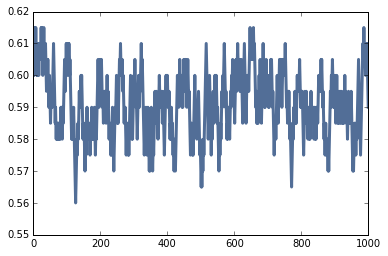

In [31]:
%time ps = find_critical(n=50, iters=1000)
thinkplot.plot(ps)
np.mean(ps)

Larger values of `n` don't seem to change the critical value.

[[ 6 10 11 ..., 10 10  6]
 [ 6  7  5 ...,  6  7  6]
 [ 2  2  2 ...,  2  2  2]
 ..., 
 [ 2  2  2 ...,  3  1  3]
 [ 2  2  1 ...,  2  3  1]
 [ 1  1  0 ...,  1  2  2]]
[[10 10 15 ..., 10 10 10]
 [ 6 15  5 ..., 10 11  6]
 [ 6  2  6 ...,  2  2  6]
 ..., 
 [ 2  2  2 ...,  3  1  3]
 [ 2  2  1 ...,  2  3  1]
 [ 1  1  0 ...,  1  2  2]]
[[10 10 15 ..., 10 10 10]
 [10 15  5 ..., 10 11 10]
 [ 6  6  6 ...,  6  6  6]
 ..., 
 [ 2  2  2 ...,  3  1  3]
 [ 2  2  1 ...,  2  3  1]
 [ 1  1  0 ...,  1  2  2]]
[[10 10 15 ..., 10 10 10]
 [10 15  5 ..., 10 15 10]
 [10  6 10 ..., 10  6 10]
 ..., 
 [ 2  2  2 ...,  3  1  3]
 [ 2  2  1 ...,  2  3  1]
 [ 1  1  0 ...,  1  2  2]]
[[10 10 15 ..., 10 10 10]
 [10 15  5 ..., 10 15 10]
 [10 10 10 ..., 10 10 10]
 ..., 
 [ 2  2  2 ...,  3  1  3]
 [ 2  2  1 ...,  2  3  1]
 [ 1  1  0 ...,  1  2  2]]
[[10 10 15 ..., 10 10 10]
 [10 15  5 ..., 10 15 10]
 [10 10 10 ..., 10 10 10]
 ..., 
 [ 2  2  2 ...,  3  1  3]
 [ 2  2  1 ...,  2  3  1]
 [ 1  1  0 ...,  1  2  2]]
[[10 10 15 ..., 

 [ 2  3  2 ...,  3  2  1]]
[[10 10 15 ..., 15 10 10]
 [10 15 10 ..., 10 20  5]
 [10  5  5 ..., 20  5 15]
 ..., 
 [ 1  3  1 ...,  3  2  1]
 [ 3  3  3 ...,  1  3  2]
 [ 2  3  2 ...,  3  2  1]]
[[10 10 15 ..., 15 10 10]
 [10 15 10 ..., 10 20  5]
 [10  5  5 ..., 20  5 15]
 ..., 
 [ 1  3  1 ...,  3  2  1]
 [ 3  3  3 ...,  1  3  2]
 [ 2  3  2 ...,  3  2  1]]
[[10 10 15 ..., 15 10 10]
 [10 15 10 ..., 10 20  5]
 [10  5  5 ..., 20  5 15]
 ..., 
 [ 1  3  1 ...,  3  2  1]
 [ 3  3  3 ...,  1  3  2]
 [ 2  3  2 ...,  3  2  1]]
[[10 10 15 ..., 15 10 10]
 [10 15 10 ..., 10 20  5]
 [10  5  5 ..., 20  5 15]
 ..., 
 [ 1  3  1 ...,  3  2  1]
 [ 3  3  3 ...,  1  3  2]
 [ 2  3  2 ...,  3  2  1]]
[[10 10 15 ..., 15 10 10]
 [10 15 10 ..., 10 20  5]
 [10  5  5 ..., 20  5 15]
 ..., 
 [ 1  3  1 ...,  3  2  1]
 [ 3  3  3 ...,  1  3  2]
 [ 2  3  2 ...,  3  2  1]]
[[10 10 15 ..., 15 10 10]
 [10 15 10 ..., 10 20  5]
 [10  5  5 ..., 20  5 15]
 ..., 
 [ 1  3  1 ...,  3  2  1]
 [ 3  3  3 ...,  1  3  2]
 [ 2  3  2 ..., 

 [ 2  2  3 ...,  2  1  1]]
[[10 15 10 ..., 15 15 10]
 [15 10 15 ..., 10 20 15]
 [10 15  5 ..., 10 10 10]
 ..., 
 [ 3  4  4 ...,  3  4  1]
 [ 2  4  4 ...,  2  2  2]
 [ 2  2  3 ...,  2  1  1]]
[[10 15 10 ..., 15 15 10]
 [15 10 15 ..., 10 20 15]
 [10 15  5 ..., 10 10 10]
 ..., 
 [ 3  4  4 ...,  3  4  1]
 [ 2  4  4 ...,  2  2  2]
 [ 2  2  3 ...,  2  1  1]]
[[10 15 10 ..., 15 15 10]
 [15 10 15 ..., 10 20 15]
 [10 15  5 ..., 10 10 10]
 ..., 
 [ 3  4  4 ...,  3  4  1]
 [ 2  4  4 ...,  2  2  2]
 [ 2  2  3 ...,  2  1  1]]
[[10 15 10 ..., 15 15 10]
 [15 10 15 ..., 10 20 15]
 [10 15  5 ..., 10 10 10]
 ..., 
 [ 3  4  4 ...,  3  4  1]
 [ 2  4  4 ...,  2  2  2]
 [ 2  2  3 ...,  2  1  1]]
[[10 15 10 ..., 15 15 10]
 [15 10 15 ..., 10 20 15]
 [10 15  5 ..., 10 10 10]
 ..., 
 [ 3  4  4 ...,  3  4  1]
 [ 2  4  4 ...,  2  2  2]
 [ 2  2  3 ...,  2  1  1]]
[[10 15 10 ..., 15 15 10]
 [15 10 15 ..., 10 20 15]
 [10 15  5 ..., 10 10 10]
 ..., 
 [ 3  4  4 ...,  3  4  1]
 [ 2  4  4 ...,  2  2  2]
 [ 2  2  3 ..., 

 [ 1  3  0 ...,  1  2  1]]
[[10 15 15 ..., 15 10  5]
 [15 20 10 ...,  5 10  6]
 [15 15 15 ...,  7  2  1]
 ..., 
 [ 2  3  1 ...,  4  3  2]
 [ 3  1  2 ...,  4  3  2]
 [ 1  3  0 ...,  1  2  1]]
[[10 15 15 ..., 15 10  5]
 [15 20 10 ...,  5 10  6]
 [15 15 15 ...,  7  2  1]
 ..., 
 [ 2  3  1 ...,  4  3  2]
 [ 3  1  2 ...,  4  3  2]
 [ 1  3  0 ...,  1  2  1]]
[[10 15 15 ..., 15 10  5]
 [15 20 10 ...,  5 10  6]
 [15 15 15 ...,  7  2  1]
 ..., 
 [ 2  3  1 ...,  4  3  2]
 [ 3  1  2 ...,  4  3  2]
 [ 1  3  0 ...,  1  2  1]]
[[10 15 15 ..., 15 10  5]
 [15 20 10 ...,  5 10  6]
 [15 15 15 ...,  7  2  1]
 ..., 
 [ 2  3  1 ...,  4  3  2]
 [ 3  1  2 ...,  4  3  2]
 [ 1  3  0 ...,  1  2  1]]
[[10 15 15 ..., 15 10  5]
 [15 20 10 ...,  5 10  6]
 [15 15 15 ...,  7  2  1]
 ..., 
 [ 2  3  1 ...,  4  3  2]
 [ 3  1  2 ...,  4  3  2]
 [ 1  3  0 ...,  1  2  1]]
[[10 15 15 ..., 15 10  5]
 [15 20 10 ...,  5 10  6]
 [15 15 15 ...,  7  2  1]
 ..., 
 [ 2  3  1 ...,  4  3  2]
 [ 3  1  2 ...,  4  3  2]
 [ 1  3  0 ..., 

[[10 15 10 ..., 10 15 10]
 [15 15 15 ..., 15 10 15]
 [10 15 10 ..., 10 10 10]
 ..., 
 [ 2  2  3 ...,  2  4  2]
 [ 0  2  2 ...,  2  2  3]
 [ 0  0  2 ...,  2  2  1]]
[[10 15 10 ..., 10 15 10]
 [15 15 15 ..., 15 10 15]
 [10 15 10 ..., 10 10 10]
 ..., 
 [ 2  2  3 ...,  2  4  2]
 [ 0  2  2 ...,  2  2  3]
 [ 0  0  2 ...,  2  2  1]]
[[10 15 10 ..., 10 15 10]
 [15 15 15 ..., 15 10 15]
 [10 15 10 ..., 10 10 10]
 ..., 
 [ 2  2  3 ...,  2  4  2]
 [ 0  2  2 ...,  2  2  3]
 [ 0  0  2 ...,  2  2  1]]
[[10 15 10 ..., 10 15 10]
 [15 15 15 ..., 15 10 15]
 [10 15 10 ..., 10 10 10]
 ..., 
 [ 2  2  3 ...,  2  4  2]
 [ 0  2  2 ...,  2  2  3]
 [ 0  0  2 ...,  2  2  1]]
[[10 15 10 ..., 10 15 10]
 [15 15 15 ..., 15 10 15]
 [10 15 10 ..., 10 10 10]
 ..., 
 [ 2  2  3 ...,  2  4  2]
 [ 0  2  2 ...,  2  2  3]
 [ 0  0  2 ...,  2  2  1]]
[[10 15 10 ..., 10 15 10]
 [15 15 15 ..., 15 10 15]
 [10 15 10 ..., 10 10 10]
 ..., 
 [ 2  2  3 ...,  2  4  2]
 [ 0  2  2 ...,  2  2  3]
 [ 0  0  2 ...,  2  2  1]]
[[10 15 10 ..., 

[[10 10 10 ..., 10 10 10]
 [10 15 15 ..., 10 15 10]
 [10 15 15 ...,  6  5 10]
 ..., 
 [ 1  4  2 ...,  3  2  2]
 [ 3  1  4 ...,  1  3  3]
 [ 1  3  1 ...,  2  2  2]]
[[10 10 10 ..., 10 10 10]
 [10 15 15 ..., 10 15 10]
 [10 15 15 ...,  6  5 10]
 ..., 
 [ 1  4  2 ...,  3  2  2]
 [ 3  1  4 ...,  1  3  3]
 [ 1  3  1 ...,  2  2  2]]
[[10 10 10 ..., 10 10 10]
 [10 15 15 ..., 10 15 10]
 [10 15 15 ...,  6  5 10]
 ..., 
 [ 1  4  2 ...,  3  2  2]
 [ 3  1  4 ...,  1  3  3]
 [ 1  3  1 ...,  2  2  2]]
[[10 10 10 ..., 10 10 10]
 [10 15 15 ..., 10 15 10]
 [10 15 15 ...,  6  5 10]
 ..., 
 [ 1  4  2 ...,  3  2  2]
 [ 3  1  4 ...,  1  3  3]
 [ 1  3  1 ...,  2  2  2]]
[[10 10 10 ..., 10 10 10]
 [10 15 15 ..., 10 15 10]
 [10 15 15 ...,  6  5 10]
 ..., 
 [ 1  4  2 ...,  3  2  2]
 [ 3  1  4 ...,  1  3  3]
 [ 1  3  1 ...,  2  2  2]]
[[10 10 10 ..., 10 10 10]
 [10 15 15 ..., 10 15 10]
 [10 15 15 ...,  6  5 10]
 ..., 
 [ 1  4  2 ...,  3  2  2]
 [ 3  1  4 ...,  1  3  3]
 [ 1  3  1 ...,  2  2  2]]
[[10 10 10 ..., 

[[10 15 10 ..., 15 10 10]
 [10 15 15 ...,  5 15 10]
 [15 15 10 ...,  6  5  5]
 ..., 
 [ 3  1  3 ...,  4  0  3]
 [ 2  4  1 ...,  2  4  1]
 [ 2  1  3 ...,  2  2  2]]
[[10 15 10 ..., 15 10 10]
 [10 15 15 ...,  5 15 10]
 [15 15 10 ...,  6  5  5]
 ..., 
 [ 3  1  3 ...,  4  0  3]
 [ 2  4  1 ...,  2  4  1]
 [ 2  1  3 ...,  2  2  2]]
[[10 15 10 ..., 15 10 10]
 [10 15 15 ...,  5 15 10]
 [15 15 10 ...,  6  5  5]
 ..., 
 [ 3  1  3 ...,  4  0  3]
 [ 2  4  1 ...,  2  4  1]
 [ 2  1  3 ...,  2  2  2]]
[[10 15 10 ..., 15 10 10]
 [10 15 15 ...,  5 15 10]
 [15 15 10 ...,  6  5  5]
 ..., 
 [ 3  1  3 ...,  4  0  3]
 [ 2  4  1 ...,  2  4  1]
 [ 2  1  3 ...,  2  2  2]]
[[10 15 10 ..., 15 10 10]
 [10 15 15 ...,  5 15 10]
 [15 15 10 ...,  6  5  5]
 ..., 
 [ 3  1  3 ...,  4  0  3]
 [ 2  4  1 ...,  2  4  1]
 [ 2  1  3 ...,  2  2  2]]
[[10 15 10 ..., 15 10 10]
 [10 15 15 ...,  5 15 10]
 [15 15 10 ...,  6  5  5]
 ..., 
 [ 3  1  3 ...,  4  0  3]
 [ 2  4  1 ...,  2  4  1]
 [ 2  1  3 ...,  2  2  2]]
[[10 15 10 ..., 

[[10 10 15 ..., 10 15 10]
 [10 15 10 ..., 15 10 10]
 [ 5 10 15 ..., 10  5 10]
 ..., 
 [ 2  0  1 ...,  3  2  1]
 [ 1  2  1 ...,  2  2  1]
 [ 2  1  2 ...,  1  1  1]]
[[10 10 15 ..., 10 15 10]
 [10 15 10 ..., 15 10 10]
 [ 5 10 15 ..., 10  5 10]
 ..., 
 [ 2  0  1 ...,  3  2  1]
 [ 1  2  1 ...,  2  2  1]
 [ 2  1  2 ...,  1  1  1]]
[[10 10 15 ..., 10 15 10]
 [10 15 10 ..., 15 10 10]
 [ 5 10 15 ..., 10  5 10]
 ..., 
 [ 2  0  1 ...,  3  2  1]
 [ 1  2  1 ...,  2  2  1]
 [ 2  1  2 ...,  1  1  1]]
[[10 10 15 ..., 10 15 10]
 [10 15 10 ..., 15 10 10]
 [ 5 10 15 ..., 10  5 10]
 ..., 
 [ 2  0  1 ...,  3  2  1]
 [ 1  2  1 ...,  2  2  1]
 [ 2  1  2 ...,  1  1  1]]
[[10 10 15 ..., 10 15 10]
 [10 15 10 ..., 15 10 10]
 [ 5 10 15 ..., 10  5 10]
 ..., 
 [ 2  0  1 ...,  3  2  1]
 [ 1  2  1 ...,  2  2  1]
 [ 2  1  2 ...,  1  1  1]]
[[10 10 15 ..., 10 15 10]
 [10 15 10 ..., 15 10 10]
 [ 5 10 15 ..., 10  5 10]
 ..., 
 [ 2  0  1 ...,  3  2  1]
 [ 1  2  1 ...,  2  2  1]
 [ 2  1  2 ...,  1  1  1]]
[[10 10 15 ..., 

[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 15 20 10]
 [15 15 20 ..., 15 10 10]
 ..., 
 [ 1  3  0 ...,  1  2  1]
 [ 2  2  2 ...,  2  2  0]
 [ 2  1  2 ...,  2  1  2]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 15 20 10]
 [15 15 20 ..., 15 10 10]
 ..., 
 [ 1  3  0 ...,  1  2  1]
 [ 2  2  2 ...,  2  2  0]
 [ 2  1  2 ...,  2  1  2]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 15 20 10]
 [15 15 20 ..., 15 10 10]
 ..., 
 [ 1  3  0 ...,  1  2  1]
 [ 2  2  2 ...,  2  2  0]
 [ 2  1  2 ...,  2  1  2]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 15 20 10]
 [15 15 20 ..., 15 10 10]
 ..., 
 [ 1  3  0 ...,  1  2  1]
 [ 2  2  2 ...,  2  2  0]
 [ 2  1  2 ...,  2  1  2]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 15 20 10]
 [15 15 20 ..., 15 10 10]
 ..., 
 [ 1  3  0 ...,  1  2  1]
 [ 2  2  2 ...,  2  2  0]
 [ 2  1  2 ...,  2  1  2]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 15 20 10]
 [15 15 20 ..., 15 10 10]
 ..., 
 [ 1  3  0 ...,  1  2  1]
 [ 2  2  2 ...,  2  2  0]
 [ 2  1  2 ...,  2  1  2]]
[[10 15 15 ..., 

[[10 15 15 ..., 10 15  5]
 [15 15 10 ..., 20 10 10]
 [10 15  5 ..., 15 10  6]
 ..., 
 [ 2  3  2 ...,  2  3  2]
 [ 3  3  4 ...,  4  2  1]
 [ 2  3  1 ...,  0  2  1]]
[[10 15 15 ..., 10 15  5]
 [15 15 10 ..., 20 10 10]
 [10 15  5 ..., 15 10  6]
 ..., 
 [ 2  3  2 ...,  2  3  2]
 [ 3  3  4 ...,  4  2  1]
 [ 2  3  1 ...,  0  2  1]]
[[10 15 15 ..., 10 15  5]
 [15 15 10 ..., 20 10 10]
 [10 15  5 ..., 15 10  6]
 ..., 
 [ 2  3  2 ...,  2  3  2]
 [ 3  3  4 ...,  4  2  1]
 [ 2  3  1 ...,  0  2  1]]
[[10 15 15 ..., 10 15  5]
 [15 15 10 ..., 20 10 10]
 [10 15  5 ..., 15 10  6]
 ..., 
 [ 2  3  2 ...,  2  3  2]
 [ 3  3  4 ...,  4  2  1]
 [ 2  3  1 ...,  0  2  1]]
[[10 15 15 ..., 10 15  5]
 [15 15 10 ..., 20 10 10]
 [10 15  5 ..., 15 10  6]
 ..., 
 [ 2  3  2 ...,  2  3  2]
 [ 3  3  4 ...,  4  2  1]
 [ 2  3  1 ...,  0  2  1]]
[[10 15 15 ..., 10 15  5]
 [15 15 10 ..., 20 10 10]
 [10 15  5 ..., 15 10  6]
 ..., 
 [ 2  3  2 ...,  2  3  2]
 [ 3  3  4 ...,  4  2  1]
 [ 2  3  1 ...,  0  2  1]]
[[10 15 15 ..., 

 [ 2  1  2 ...,  1  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [10 10  5 ..., 15 20 15]
 [ 5 10 10 ..., 20 15 15]
 ..., 
 [ 2  2  1 ...,  2  3  2]
 [ 1  2  2 ...,  2  3  3]
 [ 2  1  2 ...,  1  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [10 10  5 ..., 15 20 15]
 [ 5 10 10 ..., 20 15 15]
 ..., 
 [ 2  2  1 ...,  2  3  2]
 [ 1  2  2 ...,  2  3  3]
 [ 2  1  2 ...,  1  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [10 10  5 ..., 15 20 15]
 [ 5 10 10 ..., 20 15 15]
 ..., 
 [ 2  2  1 ...,  2  3  2]
 [ 1  2  2 ...,  2  3  3]
 [ 2  1  2 ...,  1  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [10 10  5 ..., 15 20 15]
 [ 5 10 10 ..., 20 15 15]
 ..., 
 [ 2  2  1 ...,  2  3  2]
 [ 1  2  2 ...,  2  3  3]
 [ 2  1  2 ...,  1  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [10 10  5 ..., 15 20 15]
 [ 5 10 10 ..., 20 15 15]
 ..., 
 [ 2  2  1 ...,  2  3  2]
 [ 1  2  2 ...,  2  3  3]
 [ 2  1  2 ...,  1  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [10 10  5 ..., 15 20 15]
 [ 5 10 10 ..., 20 15 15]
 ..., 
 [ 2  2  1 ...,  2  3  2]
 [ 1  2  2 ...,  2  3  3]
 [ 2  1  2 ..., 

 [ 2  2  3 ...,  0  1  1]]
[[10 10 10 ..., 15 15  5]
 [10 15  5 ..., 15 15 15]
 [10 10 15 ..., 20 15 10]
 ..., 
 [ 3  3  3 ...,  1  2  2]
 [ 2  4  3 ...,  3  1  1]
 [ 2  2  3 ...,  0  1  1]]
[[10 10 10 ..., 15 15  5]
 [10 15  5 ..., 15 15 15]
 [10 10 15 ..., 20 15 10]
 ..., 
 [ 3  3  3 ...,  1  2  2]
 [ 2  4  3 ...,  3  1  1]
 [ 2  2  3 ...,  0  1  1]]
[[10 10 10 ..., 15 15  5]
 [10 15  5 ..., 15 15 15]
 [10 10 15 ..., 20 15 10]
 ..., 
 [ 3  3  3 ...,  1  2  2]
 [ 2  4  3 ...,  3  1  1]
 [ 2  2  3 ...,  0  1  1]]
[[10 10 10 ..., 15 15  5]
 [10 15  5 ..., 15 15 15]
 [10 10 15 ..., 20 15 10]
 ..., 
 [ 3  3  3 ...,  1  2  2]
 [ 2  4  3 ...,  3  1  1]
 [ 2  2  3 ...,  0  1  1]]
[[10 10 10 ..., 15 15  5]
 [10 15  5 ..., 15 15 15]
 [10 10 15 ..., 20 15 10]
 ..., 
 [ 3  3  3 ...,  1  2  2]
 [ 2  4  3 ...,  3  1  1]
 [ 2  2  3 ...,  0  1  1]]
[[10 10 10 ..., 15 15  5]
 [10 15  5 ..., 15 15 15]
 [10 10 15 ..., 20 15 10]
 ..., 
 [ 3  3  3 ...,  1  2  2]
 [ 2  4  3 ...,  3  1  1]
 [ 2  2  3 ..., 

 [ 1  1  1 ...,  2  1  2]]
[[10 15 15 ..., 15 10  5]
 [15 20 10 ..., 10 15 10]
 [10 10 10 ..., 15 10  5]
 ..., 
 [ 1  2  1 ...,  1  1  2]
 [ 1  1  2 ...,  1  3  2]
 [ 1  1  1 ...,  2  1  2]]
[[10 15 15 ..., 15 10  5]
 [15 20 10 ..., 10 15 10]
 [10 10 10 ..., 15 10  5]
 ..., 
 [ 1  2  1 ...,  1  1  2]
 [ 1  1  2 ...,  1  3  2]
 [ 1  1  1 ...,  2  1  2]]
[[10 15 15 ..., 15 10  5]
 [15 20 10 ..., 10 15 10]
 [10 10 10 ..., 15 10  5]
 ..., 
 [ 1  2  1 ...,  1  1  2]
 [ 1  1  2 ...,  1  3  2]
 [ 1  1  1 ...,  2  1  2]]
[[10 15 15 ..., 15 10  5]
 [15 20 10 ..., 10 15 10]
 [10 10 10 ..., 15 10  5]
 ..., 
 [ 1  2  1 ...,  1  1  2]
 [ 1  1  2 ...,  1  3  2]
 [ 1  1  1 ...,  2  1  2]]
[[10 15 15 ..., 15 10  5]
 [15 20 10 ..., 10 15 10]
 [10 10 10 ..., 15 10  5]
 ..., 
 [ 1  2  1 ...,  1  1  2]
 [ 1  1  2 ...,  1  3  2]
 [ 1  1  1 ...,  2  1  2]]
[[10 15 15 ..., 15 10  5]
 [15 20 10 ..., 10 15 10]
 [10 10 10 ..., 15 10  5]
 ..., 
 [ 1  2  1 ...,  1  1  2]
 [ 1  1  2 ...,  1  3  2]
 [ 1  1  1 ..., 

[[ 5 15 10 ..., 15 15 10]
 [10  5 10 ..., 15 20 10]
 [ 1  6  5 ..., 15 10 11]
 ..., 
 [ 2  1  1 ...,  3  3  2]
 [ 2  2  2 ...,  2  2  2]
 [ 2  2  2 ...,  1  1  0]]
[[ 5 15 10 ..., 15 15 10]
 [10  5 10 ..., 15 20 10]
 [ 1  6  5 ..., 15 10 11]
 ..., 
 [ 2  1  1 ...,  3  3  2]
 [ 2  2  2 ...,  2  2  2]
 [ 2  2  2 ...,  1  1  0]]
[[ 5 15 10 ..., 15 15 10]
 [10  5 10 ..., 15 20 10]
 [ 1  6  5 ..., 15 10 11]
 ..., 
 [ 2  1  1 ...,  3  3  2]
 [ 2  2  2 ...,  2  2  2]
 [ 2  2  2 ...,  1  1  0]]
[[ 5 15 10 ..., 15 15 10]
 [10  5 10 ..., 15 20 10]
 [ 1  6  5 ..., 15 10 11]
 ..., 
 [ 2  1  1 ...,  3  3  2]
 [ 2  2  2 ...,  2  2  2]
 [ 2  2  2 ...,  1  1  0]]
[[ 5 15 10 ..., 15 15 10]
 [10  5 10 ..., 15 20 10]
 [ 1  6  5 ..., 15 10 11]
 ..., 
 [ 2  1  1 ...,  3  3  2]
 [ 2  2  2 ...,  2  2  2]
 [ 2  2  2 ...,  1  1  0]]
[[ 5 15 10 ..., 15 15 10]
 [10  5 10 ..., 15 20 10]
 [ 1  6  5 ..., 15 10 11]
 ..., 
 [ 2  1  1 ...,  3  3  2]
 [ 2  2  2 ...,  2  2  2]
 [ 2  2  2 ...,  1  1  0]]
[[ 5 15 10 ..., 

 [ 2  2  1 ...,  2  2  1]]
[[ 5 10 15 ..., 15 10  5]
 [ 6 11 10 ..., 10 10  6]
 [ 2  2  7 ..., 10 11  0]
 ..., 
 [ 3  2  3 ...,  2  2  1]
 [ 3  3  1 ...,  2  2  3]
 [ 2  2  1 ...,  2  2  1]]
[[ 5 10 15 ..., 15 10  5]
 [ 6 11 10 ..., 10 10  6]
 [ 2  2  7 ..., 10 11  0]
 ..., 
 [ 3  2  3 ...,  2  2  1]
 [ 3  3  1 ...,  2  2  3]
 [ 2  2  1 ...,  2  2  1]]
[[ 5 10 15 ..., 15 10  5]
 [ 6 11 10 ..., 10 10  6]
 [ 2  2  7 ..., 10 11  0]
 ..., 
 [ 3  2  3 ...,  2  2  1]
 [ 3  3  1 ...,  2  2  3]
 [ 2  2  1 ...,  2  2  1]]
[[ 5 10 15 ..., 15 10  5]
 [ 6 11 10 ..., 10 10  6]
 [ 2  2  7 ..., 10 11  0]
 ..., 
 [ 3  2  3 ...,  2  2  1]
 [ 3  3  1 ...,  2  2  3]
 [ 2  2  1 ...,  2  2  1]]
[[ 5 10 15 ..., 15 10  5]
 [ 6 11 10 ..., 10 10  6]
 [ 2  2  7 ..., 10 11  0]
 ..., 
 [ 3  2  3 ...,  2  2  1]
 [ 3  3  1 ...,  2  2  3]
 [ 2  2  1 ...,  2  2  1]]
[[ 5 10 15 ..., 15 10  5]
 [ 6 11 10 ..., 10 10  6]
 [ 2  2  7 ..., 10 11  0]
 ..., 
 [ 3  2  3 ...,  2  2  1]
 [ 3  3  1 ...,  2  2  3]
 [ 2  2  1 ..., 

[[10 10 10 ..., 15 15 10]
 [ 5 15 15 ..., 20 20 15]
 [11  5 15 ..., 20 20 15]
 ..., 
 [ 2  2  2 ...,  3  1  2]
 [ 1  2  2 ...,  2  2  1]
 [ 1  0  1 ...,  1  1  1]]
[[10 10 10 ..., 15 15 10]
 [ 5 15 15 ..., 20 20 15]
 [11  5 15 ..., 20 20 15]
 ..., 
 [ 2  2  2 ...,  3  1  2]
 [ 1  2  2 ...,  2  2  1]
 [ 1  0  1 ...,  1  1  1]]
[[10 10 10 ..., 15 15 10]
 [ 5 15 15 ..., 20 20 15]
 [11  5 15 ..., 20 20 15]
 ..., 
 [ 2  2  2 ...,  3  1  2]
 [ 1  2  2 ...,  2  2  1]
 [ 1  0  1 ...,  1  1  1]]
[[10 10 10 ..., 15 15 10]
 [ 5 15 15 ..., 20 20 15]
 [11  5 15 ..., 20 20 15]
 ..., 
 [ 2  2  2 ...,  3  1  2]
 [ 1  2  2 ...,  2  2  1]
 [ 1  0  1 ...,  1  1  1]]
[[10 10 10 ..., 15 15 10]
 [ 5 15 15 ..., 20 20 15]
 [11  5 15 ..., 20 20 15]
 ..., 
 [ 2  2  2 ...,  3  1  2]
 [ 1  2  2 ...,  2  2  1]
 [ 1  0  1 ...,  1  1  1]]
[[10 10 10 ..., 15 15 10]
 [ 5 15 15 ..., 20 20 15]
 [11  5 15 ..., 20 20 15]
 ..., 
 [ 2  2  2 ...,  3  1  2]
 [ 1  2  2 ...,  2  2  1]
 [ 1  0  1 ...,  1  1  1]]
[[10 10 10 ..., 

[[10 15 15 ..., 15 15 10]
 [10 15 15 ..., 20 20 10]
 [10 15 15 ..., 10 10 10]
 ..., 
 [ 1  4  2 ...,  3  3  3]
 [ 3  3  4 ...,  2  4  1]
 [ 2  3  3 ...,  3  0  2]]
[[10 15 15 ..., 15 15 10]
 [10 15 15 ..., 20 20 10]
 [10 15 15 ..., 10 10 10]
 ..., 
 [ 1  4  2 ...,  3  3  3]
 [ 3  3  4 ...,  2  4  1]
 [ 2  3  3 ...,  3  0  2]]
[[10 15 15 ..., 15 15 10]
 [10 15 15 ..., 20 20 10]
 [10 15 15 ..., 10 10 10]
 ..., 
 [ 1  4  2 ...,  3  3  3]
 [ 3  3  4 ...,  2  4  1]
 [ 2  3  3 ...,  3  0  2]]
[[10 15 15 ..., 15 15 10]
 [10 15 15 ..., 20 20 10]
 [10 15 15 ..., 10 10 10]
 ..., 
 [ 1  4  2 ...,  3  3  3]
 [ 3  3  4 ...,  2  4  1]
 [ 2  3  3 ...,  3  0  2]]
[[10 15 15 ..., 15 15 10]
 [10 15 15 ..., 20 20 10]
 [10 15 15 ..., 10 10 10]
 ..., 
 [ 1  4  2 ...,  3  3  3]
 [ 3  3  4 ...,  2  4  1]
 [ 2  3  3 ...,  3  0  2]]
[[10 15 15 ..., 15 15 10]
 [10 15 15 ..., 20 20 10]
 [10 15 15 ..., 10 10 10]
 ..., 
 [ 1  4  2 ...,  3  3  3]
 [ 3  3  4 ...,  2  4  1]
 [ 2  3  3 ...,  3  0  2]]
[[10 15 15 ..., 

[[ 5 15 10 ..., 10 10 10]
 [15 10 15 ..., 11 10 10]
 [10 10 15 ...,  1  6 10]
 ..., 
 [ 2  1  3 ...,  2  4  2]
 [ 1  2  1 ...,  4  2  3]
 [ 1  1  1 ...,  2  3  1]]
[[ 5 15 10 ..., 10 10 10]
 [15 10 15 ..., 11 10 10]
 [10 10 15 ...,  1  6 10]
 ..., 
 [ 2  1  3 ...,  2  4  2]
 [ 1  2  1 ...,  4  2  3]
 [ 1  1  1 ...,  2  3  1]]
[[ 5 15 10 ..., 10 10 10]
 [15 10 15 ..., 11 10 10]
 [10 10 15 ...,  1  6 10]
 ..., 
 [ 2  1  3 ...,  2  4  2]
 [ 1  2  1 ...,  4  2  3]
 [ 1  1  1 ...,  2  3  1]]
[[ 5 15 10 ..., 10 10 10]
 [15 10 15 ..., 11 10 10]
 [10 10 15 ...,  1  6 10]
 ..., 
 [ 2  1  3 ...,  2  4  2]
 [ 1  2  1 ...,  4  2  3]
 [ 1  1  1 ...,  2  3  1]]
[[ 5 15 10 ..., 10 10 10]
 [15 10 15 ..., 11 10 10]
 [10 10 15 ...,  1  6 10]
 ..., 
 [ 2  1  3 ...,  2  4  2]
 [ 1  2  1 ...,  4  2  3]
 [ 1  1  1 ...,  2  3  1]]
[[ 5 15 10 ..., 10 10 10]
 [15 10 15 ..., 11 10 10]
 [10 10 15 ...,  1  6 10]
 ..., 
 [ 2  1  3 ...,  2  4  2]
 [ 1  2  1 ...,  4  2  3]
 [ 1  1  1 ...,  2  3  1]]
[[ 5 15 10 ..., 

[[10 10 15 ..., 10 15  5]
 [ 5 15 10 ..., 10 10 15]
 [10 10 10 ..., 15 15 10]
 ..., 
 [ 2  2  2 ...,  2  3  3]
 [ 0  2  3 ...,  2  3  3]
 [ 1  1  2 ...,  2  3  1]]
[[10 10 15 ..., 10 15  5]
 [ 5 15 10 ..., 10 10 15]
 [10 10 10 ..., 15 15 10]
 ..., 
 [ 2  2  2 ...,  2  3  3]
 [ 0  2  3 ...,  2  3  3]
 [ 1  1  2 ...,  2  3  1]]
[[10 10 15 ..., 10 15  5]
 [ 5 15 10 ..., 10 10 15]
 [10 10 10 ..., 15 15 10]
 ..., 
 [ 2  2  2 ...,  2  3  3]
 [ 0  2  3 ...,  2  3  3]
 [ 1  1  2 ...,  2  3  1]]
[[10 10 15 ..., 10 15  5]
 [ 5 15 10 ..., 10 10 15]
 [10 10 10 ..., 15 15 10]
 ..., 
 [ 2  2  2 ...,  2  3  3]
 [ 0  2  3 ...,  2  3  3]
 [ 1  1  2 ...,  2  3  1]]
[[10 10 15 ..., 10 15  5]
 [ 5 15 10 ..., 10 10 15]
 [10 10 10 ..., 15 15 10]
 ..., 
 [ 2  2  2 ...,  2  3  3]
 [ 0  2  3 ...,  2  3  3]
 [ 1  1  2 ...,  2  3  1]]
[[10 10 15 ..., 10 15  5]
 [ 5 15 10 ..., 10 10 15]
 [10 10 10 ..., 15 15 10]
 ..., 
 [ 2  2  2 ...,  2  3  3]
 [ 0  2  3 ...,  2  3  3]
 [ 1  1  2 ...,  2  3  1]]
[[10 10 15 ..., 

[[ 5 10 15 ..., 15 15  5]
 [ 6 10 10 ..., 15 10 11]
 [ 1  1 11 ...,  5 11  1]
 ..., 
 [ 2  1  2 ...,  2  3  1]
 [ 2  1  3 ...,  1  3  2]
 [ 1  3  0 ...,  2  1  2]]
[[ 5 10 15 ..., 15 15  5]
 [ 6 10 10 ..., 15 10 11]
 [ 1  1 11 ...,  5 11  1]
 ..., 
 [ 2  1  2 ...,  2  3  1]
 [ 2  1  3 ...,  1  3  2]
 [ 1  3  0 ...,  2  1  2]]
[[ 5 10 15 ..., 15 15  5]
 [ 6 10 10 ..., 15 10 11]
 [ 1  1 11 ...,  5 11  1]
 ..., 
 [ 2  1  2 ...,  2  3  1]
 [ 2  1  3 ...,  1  3  2]
 [ 1  3  0 ...,  2  1  2]]
[[ 5 10 15 ..., 15 15  5]
 [ 6 10 10 ..., 15 10 11]
 [ 1  1 11 ...,  5 11  1]
 ..., 
 [ 2  1  2 ...,  2  3  1]
 [ 2  1  3 ...,  1  3  2]
 [ 1  3  0 ...,  2  1  2]]
[[ 5 10 15 ..., 15 15  5]
 [ 6 10 10 ..., 15 10 11]
 [ 1  1 11 ...,  5 11  1]
 ..., 
 [ 2  1  2 ...,  2  3  1]
 [ 2  1  3 ...,  1  3  2]
 [ 1  3  0 ...,  2  1  2]]
[[ 5 10 15 ..., 15 15  5]
 [ 6 10 10 ..., 15 10 11]
 [ 1  1 11 ...,  5 11  1]
 ..., 
 [ 2  1  2 ...,  2  3  1]
 [ 2  1  3 ...,  1  3  2]
 [ 1  3  0 ...,  2  1  2]]
[[ 5 10 15 ..., 

[[10 15 15 ..., 15 15 10]
 [15 20 10 ..., 20 20 10]
 [10 15 16 ..., 20 10 10]
 ..., 
 [ 2  3  3 ...,  2  2  2]
 [ 3  4  2 ...,  1  2  2]
 [ 2  3  2 ...,  1  1  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 10 ..., 20 20 10]
 [10 15 16 ..., 20 10 10]
 ..., 
 [ 2  3  3 ...,  2  2  2]
 [ 3  4  2 ...,  1  2  2]
 [ 2  3  2 ...,  1  1  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 10 ..., 20 20 10]
 [10 15 16 ..., 20 10 10]
 ..., 
 [ 2  3  3 ...,  2  2  2]
 [ 3  4  2 ...,  1  2  2]
 [ 2  3  2 ...,  1  1  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 10 ..., 20 20 10]
 [10 15 16 ..., 20 10 10]
 ..., 
 [ 2  3  3 ...,  2  2  2]
 [ 3  4  2 ...,  1  2  2]
 [ 2  3  2 ...,  1  1  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 10 ..., 20 20 10]
 [10 15 16 ..., 20 10 10]
 ..., 
 [ 2  3  3 ...,  2  2  2]
 [ 3  4  2 ...,  1  2  2]
 [ 2  3  2 ...,  1  1  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 10 ..., 20 20 10]
 [10 15 16 ..., 20 10 10]
 ..., 
 [ 2  3  3 ...,  2  2  2]
 [ 3  4  2 ...,  1  2  2]
 [ 2  3  2 ...,  1  1  1]]
[[10 15 15 ..., 

[[ 5 15 10 ..., 15 15 10]
 [15 10 20 ..., 15 20 10]
 [10 15  5 ..., 20 15 15]
 ..., 
 [ 1  2  3 ...,  3  2  1]
 [ 1  1  1 ...,  3  2  3]
 [ 0  0  2 ...,  1  3  1]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 20 ..., 15 20 10]
 [10 15  5 ..., 20 15 15]
 ..., 
 [ 1  2  3 ...,  3  2  1]
 [ 1  1  1 ...,  3  2  3]
 [ 0  0  2 ...,  1  3  1]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 20 ..., 15 20 10]
 [10 15  5 ..., 20 15 15]
 ..., 
 [ 1  2  3 ...,  3  2  1]
 [ 1  1  1 ...,  3  2  3]
 [ 0  0  2 ...,  1  3  1]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 20 ..., 15 20 10]
 [10 15  5 ..., 20 15 15]
 ..., 
 [ 1  2  3 ...,  3  2  1]
 [ 1  1  1 ...,  3  2  3]
 [ 0  0  2 ...,  1  3  1]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 20 ..., 15 20 10]
 [10 15  5 ..., 20 15 15]
 ..., 
 [ 1  2  3 ...,  3  2  1]
 [ 1  1  1 ...,  3  2  3]
 [ 0  0  2 ...,  1  3  1]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 20 ..., 15 20 10]
 [10 15  5 ..., 20 15 15]
 ..., 
 [ 1  2  3 ...,  3  2  1]
 [ 1  1  1 ...,  3  2  3]
 [ 0  0  2 ...,  1  3  1]]
[[ 5 15 10 ..., 

[[10 10 15 ..., 15 15  5]
 [10 15 15 ..., 20 15 10]
 [ 5 11 10 ..., 20 15 10]
 ..., 
 [ 3  2  3 ...,  2  3  2]
 [ 2  3  4 ...,  1  2  2]
 [ 1  3  2 ...,  2  1  2]]
[[10 10 15 ..., 15 15  5]
 [10 15 15 ..., 20 15 10]
 [ 5 11 10 ..., 20 15 10]
 ..., 
 [ 3  2  3 ...,  2  3  2]
 [ 2  3  4 ...,  1  2  2]
 [ 1  3  2 ...,  2  1  2]]
[[10 10 15 ..., 15 15  5]
 [10 15 15 ..., 20 15 10]
 [ 5 11 10 ..., 20 15 10]
 ..., 
 [ 3  2  3 ...,  2  3  2]
 [ 2  3  4 ...,  1  2  2]
 [ 1  3  2 ...,  2  1  2]]
[[10 10 15 ..., 15 15  5]
 [10 15 15 ..., 20 15 10]
 [ 5 11 10 ..., 20 15 10]
 ..., 
 [ 3  2  3 ...,  2  3  2]
 [ 2  3  4 ...,  1  2  2]
 [ 1  3  2 ...,  2  1  2]]
[[10 10 15 ..., 15 15  5]
 [10 15 15 ..., 20 15 10]
 [ 5 11 10 ..., 20 15 10]
 ..., 
 [ 3  2  3 ...,  2  3  2]
 [ 2  3  4 ...,  1  2  2]
 [ 1  3  2 ...,  2  1  2]]
[[10 10 15 ..., 15 15  5]
 [10 15 15 ..., 20 15 10]
 [ 5 11 10 ..., 20 15 10]
 ..., 
 [ 3  2  3 ...,  2  3  2]
 [ 2  3  4 ...,  1  2  2]
 [ 1  3  2 ...,  2  1  2]]
[[10 10 15 ..., 

[[ 5 15 15 ..., 10 15  5]
 [15 10 20 ..., 20 10 15]
 [ 5 20 15 ..., 15 20 10]
 ..., 
 [ 3  3  2 ...,  2  1  2]
 [ 2  3  2 ...,  2  2  1]
 [ 2  2  2 ...,  2  2  2]]
[[ 5 15 15 ..., 10 15  5]
 [15 10 20 ..., 20 10 15]
 [ 5 20 15 ..., 15 20 10]
 ..., 
 [ 3  3  2 ...,  2  1  2]
 [ 2  3  2 ...,  2  2  1]
 [ 2  2  2 ...,  2  2  2]]
[[ 5 15 15 ..., 10 15  5]
 [15 10 20 ..., 20 10 15]
 [ 5 20 15 ..., 15 20 10]
 ..., 
 [ 3  3  2 ...,  2  1  2]
 [ 2  3  2 ...,  2  2  1]
 [ 2  2  2 ...,  2  2  2]]
[[ 5 15 15 ..., 10 15  5]
 [15 10 20 ..., 20 10 15]
 [ 5 20 15 ..., 15 20 10]
 ..., 
 [ 3  3  2 ...,  2  1  2]
 [ 2  3  2 ...,  2  2  1]
 [ 2  2  2 ...,  2  2  2]]
[[ 5 15 15 ..., 10 15  5]
 [15 10 20 ..., 20 10 15]
 [ 5 20 15 ..., 15 20 10]
 ..., 
 [ 3  3  2 ...,  2  1  2]
 [ 2  3  2 ...,  2  2  1]
 [ 2  2  2 ...,  2  2  2]]
[[ 5 15 15 ..., 10 15  5]
 [15 10 20 ..., 20 10 15]
 [ 5 20 15 ..., 15 20 10]
 ..., 
 [ 3  3  2 ...,  2  1  2]
 [ 2  3  2 ...,  2  2  1]
 [ 2  2  2 ...,  2  2  2]]
[[ 5 15 15 ..., 

[[ 5 15 15 ..., 15 10 10]
 [10 15 20 ..., 10 15 10]
 [ 5 15 15 ..., 10 11  5]
 ..., 
 [ 1  2  4 ...,  4  4  1]
 [ 1  3  3 ...,  3  2  3]
 [ 1  2  3 ...,  2  2  0]]
[[ 5 15 15 ..., 15 10 10]
 [10 15 20 ..., 10 15 10]
 [ 5 15 15 ..., 10 11  5]
 ..., 
 [ 1  2  4 ...,  4  4  1]
 [ 1  3  3 ...,  3  2  3]
 [ 1  2  3 ...,  2  2  0]]
[[ 5 15 15 ..., 15 10 10]
 [10 15 20 ..., 10 15 10]
 [ 5 15 15 ..., 10 11  5]
 ..., 
 [ 1  2  4 ...,  4  4  1]
 [ 1  3  3 ...,  3  2  3]
 [ 1  2  3 ...,  2  2  0]]
[[ 5 15 15 ..., 15 10 10]
 [10 15 20 ..., 10 15 10]
 [ 5 15 15 ..., 10 11  5]
 ..., 
 [ 1  2  4 ...,  4  4  1]
 [ 1  3  3 ...,  3  2  3]
 [ 1  2  3 ...,  2  2  0]]
[[ 5 15 15 ..., 15 10 10]
 [10 15 20 ..., 10 15 10]
 [ 5 15 15 ..., 10 11  5]
 ..., 
 [ 1  2  4 ...,  4  4  1]
 [ 1  3  3 ...,  3  2  3]
 [ 1  2  3 ...,  2  2  0]]
[[ 5 15 15 ..., 15 10 10]
 [10 15 20 ..., 10 15 10]
 [ 5 15 15 ..., 10 11  5]
 ..., 
 [ 1  2  4 ...,  4  4  1]
 [ 1  3  3 ...,  3  2  3]
 [ 1  2  3 ...,  2  2  0]]
[[ 5 15 15 ..., 

[[ 5 15 15 ..., 15 15 10]
 [15 15 15 ..., 15 20 15]
 [10 15 15 ..., 15 20 10]
 ..., 
 [ 1  2  4 ...,  4  3  1]
 [ 1  2  3 ...,  3  3  2]
 [ 0  2  1 ...,  3  3  1]]
[[ 5 15 15 ..., 15 15 10]
 [15 15 15 ..., 15 20 15]
 [10 15 15 ..., 15 20 10]
 ..., 
 [ 1  2  4 ...,  4  3  1]
 [ 1  2  3 ...,  3  3  2]
 [ 0  2  1 ...,  3  3  1]]
[[ 5 15 15 ..., 15 15 10]
 [15 15 15 ..., 15 20 15]
 [10 15 15 ..., 15 20 10]
 ..., 
 [ 1  2  4 ...,  4  3  1]
 [ 1  2  3 ...,  3  3  2]
 [ 0  2  1 ...,  3  3  1]]
[[ 5 15 15 ..., 15 15 10]
 [15 15 15 ..., 15 20 15]
 [10 15 15 ..., 15 20 10]
 ..., 
 [ 1  2  4 ...,  4  3  1]
 [ 1  2  3 ...,  3  3  2]
 [ 0  2  1 ...,  3  3  1]]
[[ 5 15 15 ..., 15 15 10]
 [15 15 15 ..., 15 20 15]
 [10 15 15 ..., 15 20 10]
 ..., 
 [ 1  2  4 ...,  4  3  1]
 [ 1  2  3 ...,  3  3  2]
 [ 0  2  1 ...,  3  3  1]]
[[ 5 15 15 ..., 15 15 10]
 [15 15 15 ..., 15 20 15]
 [10 15 15 ..., 15 20 10]
 ..., 
 [ 1  2  4 ...,  4  3  1]
 [ 1  2  3 ...,  3  3  2]
 [ 0  2  1 ...,  3  3  1]]
[[ 5 15 15 ..., 

[[ 5 10 15 ..., 15 15  5]
 [ 5 11  5 ..., 10 10 10]
 [ 2  0 11 ...,  6  5  1]
 ..., 
 [ 3  3  3 ...,  3  1  1]
 [ 1  2  1 ...,  1  2  1]
 [ 1  0  1 ...,  1  1  1]]
[[ 5 10 15 ..., 15 15  5]
 [ 5 11  5 ..., 10 10 10]
 [ 2  0 11 ...,  6  5  1]
 ..., 
 [ 3  3  3 ...,  3  1  1]
 [ 1  2  1 ...,  1  2  1]
 [ 1  0  1 ...,  1  1  1]]
[[ 5 10 15 ..., 15 15  5]
 [ 5 11  5 ..., 10 10 10]
 [ 2  0 11 ...,  6  5  1]
 ..., 
 [ 3  3  3 ...,  3  1  1]
 [ 1  2  1 ...,  1  2  1]
 [ 1  0  1 ...,  1  1  1]]
[[ 5 10 15 ..., 15 15  5]
 [ 5 11  5 ..., 10 10 10]
 [ 2  0 11 ...,  6  5  1]
 ..., 
 [ 3  3  3 ...,  3  1  1]
 [ 1  2  1 ...,  1  2  1]
 [ 1  0  1 ...,  1  1  1]]
[[ 5 10 15 ..., 15 15  5]
 [ 5 11  5 ..., 10 10 10]
 [ 2  0 11 ...,  6  5  1]
 ..., 
 [ 3  3  3 ...,  3  1  1]
 [ 1  2  1 ...,  1  2  1]
 [ 1  0  1 ...,  1  1  1]]
[[ 5 10 15 ..., 15 15  5]
 [ 5 11  5 ..., 10 10 10]
 [ 2  0 11 ...,  6  5  1]
 ..., 
 [ 3  3  3 ...,  3  1  1]
 [ 1  2  1 ...,  1  2  1]
 [ 1  0  1 ...,  1  1  1]]
[[ 5 10 15 ..., 

[[10 15 15 ..., 15 15  5]
 [15 20 15 ..., 15 15 15]
 [10 15 20 ..., 11 10 10]
 ..., 
 [ 3  2  3 ...,  1  2  2]
 [ 1  3  3 ...,  3  3  1]
 [ 2  2  2 ...,  2  1  2]]
[[10 15 15 ..., 15 15  5]
 [15 20 15 ..., 15 15 15]
 [10 15 20 ..., 11 10 10]
 ..., 
 [ 3  2  3 ...,  1  2  2]
 [ 1  3  3 ...,  3  3  1]
 [ 2  2  2 ...,  2  1  2]]
[[10 15 15 ..., 15 15  5]
 [15 20 15 ..., 15 15 15]
 [10 15 20 ..., 11 10 10]
 ..., 
 [ 3  2  3 ...,  1  2  2]
 [ 1  3  3 ...,  3  3  1]
 [ 2  2  2 ...,  2  1  2]]
[[10 15 15 ..., 15 15  5]
 [15 20 15 ..., 15 15 15]
 [10 15 20 ..., 11 10 10]
 ..., 
 [ 3  2  3 ...,  1  2  2]
 [ 1  3  3 ...,  3  3  1]
 [ 2  2  2 ...,  2  1  2]]
[[10 15 15 ..., 15 15  5]
 [15 20 15 ..., 15 15 15]
 [10 15 20 ..., 11 10 10]
 ..., 
 [ 3  2  3 ...,  1  2  2]
 [ 1  3  3 ...,  3  3  1]
 [ 2  2  2 ...,  2  1  2]]
[[10 15 15 ..., 15 15  5]
 [15 20 15 ..., 15 15 15]
 [10 15 20 ..., 11 10 10]
 ..., 
 [ 3  2  3 ...,  1  2  2]
 [ 1  3  3 ...,  3  3  1]
 [ 2  2  2 ...,  2  1  2]]
[[10 15 15 ..., 

[[ 5 10 15 ..., 15 15  5]
 [ 5 10 15 ..., 10 15 15]
 [ 5 10 15 ..., 12 10  5]
 ..., 
 [ 0  2  2 ...,  2  3  1]
 [ 2  2  4 ...,  3  2  1]
 [ 1  3  3 ...,  1  1  1]]
[[ 5 10 15 ..., 15 15  5]
 [ 5 10 15 ..., 10 15 15]
 [ 5 10 15 ..., 12 10  5]
 ..., 
 [ 0  2  2 ...,  2  3  1]
 [ 2  2  4 ...,  3  2  1]
 [ 1  3  3 ...,  1  1  1]]
[[ 5 10 15 ..., 15 15  5]
 [ 5 10 15 ..., 10 15 15]
 [ 5 10 15 ..., 12 10  5]
 ..., 
 [ 0  2  2 ...,  2  3  1]
 [ 2  2  4 ...,  3  2  1]
 [ 1  3  3 ...,  1  1  1]]
[[ 6 11 10 ..., 10 11  6]
 [ 6  7  7 ...,  7  7  7]
 [ 3  2  2 ...,  2  2  2]
 ..., 
 [ 2  3  3 ...,  3  1  1]
 [ 2  3  3 ...,  2  3  2]
 [ 2  2  2 ...,  2  2  2]]
[[10 15 10 ..., 10 15 10]
 [10 11 11 ..., 15 11 11]
 [ 7  6  2 ...,  2  6  6]
 ..., 
 [ 2  3  3 ...,  3  1  1]
 [ 2  3  3 ...,  2  3  2]
 [ 2  2  2 ...,  2  2  2]]
[[10 15 10 ..., 10 15 10]
 [10 15 11 ..., 15 15 15]
 [11  6  6 ..., 10 10 10]
 ..., 
 [ 2  3  3 ...,  3  1  1]
 [ 2  3  3 ...,  2  3  2]
 [ 2  2  2 ...,  2  2  2]]
[[10 15 10 ..., 

[[10 10 15 ..., 15 10  5]
 [10 20 10 ..., 15 15  5]
 [10  5 10 ..., 15 10 10]
 ..., 
 [ 1  4  3 ...,  2  4  1]
 [ 2  2  4 ...,  3  2  2]
 [ 1  2  2 ...,  1  2  2]]
[[10 10 15 ..., 15 10  5]
 [10 20 10 ..., 15 15  5]
 [10  5 10 ..., 15 10 10]
 ..., 
 [ 1  4  3 ...,  2  4  1]
 [ 2  2  4 ...,  3  2  2]
 [ 1  2  2 ...,  1  2  2]]
[[10 10 15 ..., 15 10  5]
 [10 20 10 ..., 15 15  5]
 [10  5 10 ..., 15 10 10]
 ..., 
 [ 1  4  3 ...,  2  4  1]
 [ 2  2  4 ...,  3  2  2]
 [ 1  2  2 ...,  1  2  2]]
[[10 10 15 ..., 15 10  5]
 [10 20 10 ..., 15 15  5]
 [10  5 10 ..., 15 10 10]
 ..., 
 [ 1  4  3 ...,  2  4  1]
 [ 2  2  4 ...,  3  2  2]
 [ 1  2  2 ...,  1  2  2]]
[[10 10 15 ..., 15 10  5]
 [10 20 10 ..., 15 15  5]
 [10  5 10 ..., 15 10 10]
 ..., 
 [ 1  4  3 ...,  2  4  1]
 [ 2  2  4 ...,  3  2  2]
 [ 1  2  2 ...,  1  2  2]]
[[10 10 15 ..., 15 10  5]
 [10 20 10 ..., 15 15  5]
 [10  5 10 ..., 15 10 10]
 ..., 
 [ 1  4  3 ...,  2  4  1]
 [ 2  2  4 ...,  3  2  2]
 [ 1  2  2 ...,  1  2  2]]
[[10 10 15 ..., 

[[10 10 15 ..., 15 15  5]
 [ 5 20 15 ..., 15 15 10]
 [10 10 15 ..., 15 10 10]
 ..., 
 [ 2  0  3 ...,  1  3  1]
 [ 1  3  2 ...,  3  0  3]
 [ 1  2  2 ...,  1  3  0]]
[[10 10 15 ..., 15 15  5]
 [ 5 20 15 ..., 15 15 10]
 [10 10 15 ..., 15 10 10]
 ..., 
 [ 2  0  3 ...,  1  3  1]
 [ 1  3  2 ...,  3  0  3]
 [ 1  2  2 ...,  1  3  0]]
[[10 10 15 ..., 15 15  5]
 [ 5 20 15 ..., 15 15 10]
 [10 10 15 ..., 15 10 10]
 ..., 
 [ 2  0  3 ...,  1  3  1]
 [ 1  3  2 ...,  3  0  3]
 [ 1  2  2 ...,  1  3  0]]
[[10 10 15 ..., 15 15  5]
 [ 5 20 15 ..., 15 15 10]
 [10 10 15 ..., 15 10 10]
 ..., 
 [ 2  0  3 ...,  1  3  1]
 [ 1  3  2 ...,  3  0  3]
 [ 1  2  2 ...,  1  3  0]]
[[10 10 15 ..., 15 15  5]
 [ 5 20 15 ..., 15 15 10]
 [10 10 15 ..., 15 10 10]
 ..., 
 [ 2  0  3 ...,  1  3  1]
 [ 1  3  2 ...,  3  0  3]
 [ 1  2  2 ...,  1  3  0]]
[[10 10 15 ..., 15 15  5]
 [ 5 20 15 ..., 15 15 10]
 [10 10 15 ..., 15 10 10]
 ..., 
 [ 2  0  3 ...,  1  3  1]
 [ 1  3  2 ...,  3  0  3]
 [ 1  2  2 ...,  1  3  0]]
[[10 10 15 ..., 

[[10 10 15 ..., 15 15  5]
 [ 5 20 15 ..., 15 15 10]
 [10 10 15 ..., 15 10 10]
 ..., 
 [ 2  0  3 ...,  1  3  1]
 [ 1  3  2 ...,  3  0  3]
 [ 1  2  2 ...,  1  3  0]]
[[10 10 15 ..., 15 15  5]
 [ 5 20 15 ..., 15 15 10]
 [10 10 15 ..., 15 10 10]
 ..., 
 [ 2  0  3 ...,  1  3  1]
 [ 1  3  2 ...,  3  0  3]
 [ 1  2  2 ...,  1  3  0]]
[[10 10 15 ..., 15 15  5]
 [ 5 20 15 ..., 15 15 10]
 [10 10 15 ..., 15 10 10]
 ..., 
 [ 2  0  3 ...,  1  3  1]
 [ 1  3  2 ...,  3  0  3]
 [ 1  2  2 ...,  1  3  0]]
[[10 10 15 ..., 15 15  5]
 [ 5 20 15 ..., 15 15 10]
 [10 10 15 ..., 15 10 10]
 ..., 
 [ 2  0  3 ...,  1  3  1]
 [ 1  3  2 ...,  3  0  3]
 [ 1  2  2 ...,  1  3  0]]
[[10 10 15 ..., 15 15  5]
 [ 5 20 15 ..., 15 15 10]
 [10 10 15 ..., 15 10 10]
 ..., 
 [ 2  0  3 ...,  1  3  1]
 [ 1  3  2 ...,  3  0  3]
 [ 1  2  2 ...,  1  3  0]]
[[10 10 15 ..., 15 15  5]
 [ 5 20 15 ..., 15 15 10]
 [10 10 15 ..., 15 10 10]
 ..., 
 [ 2  0  3 ...,  1  3  1]
 [ 1  3  2 ...,  3  0  3]
 [ 1  2  2 ...,  1  3  0]]
[[10 10 15 ..., 

[[10 15 10 ..., 10 10 10]
 [10 15 15 ...,  6 10 10]
 [15 10 10 ...,  0 11 10]
 ..., 
 [ 2  2  3 ...,  3  3  2]
 [ 3  3  3 ...,  3  3  1]
 [ 1  3  3 ...,  2  1  2]]
[[10 15 10 ..., 10 10 10]
 [10 15 15 ...,  6 10 10]
 [15 10 10 ...,  0 11 10]
 ..., 
 [ 2  2  3 ...,  3  3  2]
 [ 3  3  3 ...,  3  3  1]
 [ 1  3  3 ...,  2  1  2]]
[[ 5 11 11 ..., 11 10  5]
 [ 7  6  6 ...,  7  6  6]
 [ 1  3  2 ...,  3  2  0]
 ..., 
 [ 3  2  3 ...,  1  2  1]
 [ 3  3  3 ...,  1  2  2]
 [ 1  3  1 ...,  1  2  2]]
[[ 5 15 15 ..., 15 10  5]
 [11 10 10 ..., 11 10  6]
 [ 1  7  6 ...,  7  2  0]
 ..., 
 [ 3  2  3 ...,  1  2  1]
 [ 3  3  3 ...,  1  2  2]
 [ 1  3  1 ...,  1  2  2]]
[[ 5 15 15 ..., 15 10  5]
 [11 10 10 ..., 15 10  6]
 [ 1  7  6 ..., 11  6  0]
 ..., 
 [ 3  2  3 ...,  1  2  1]
 [ 3  3  3 ...,  1  2  2]
 [ 1  3  1 ...,  1  2  2]]
[[ 5 15 15 ..., 15 10  5]
 [11 10 10 ..., 15 10  6]
 [ 1  7  6 ..., 15  6  0]
 ..., 
 [ 3  2  3 ...,  1  2  1]
 [ 3  3  3 ...,  1  2  2]
 [ 1  3  1 ...,  1  2  2]]
[[ 5 15 15 ..., 

[[10 15 15 ..., 15 15  5]
 [10 20 15 ..., 15 10 11]
 [10 10 10 ..., 10 11  1]
 ..., 
 [ 1  1  1 ...,  1  3  1]
 [ 1  1  3 ...,  2  2  3]
 [ 0  2  1 ...,  1  3  1]]
[[10 15 15 ..., 15 15  5]
 [10 20 15 ..., 15 10 11]
 [10 10 10 ..., 10 11  1]
 ..., 
 [ 1  1  1 ...,  1  3  1]
 [ 1  1  3 ...,  2  2  3]
 [ 0  2  1 ...,  1  3  1]]
[[10 15 15 ..., 15 15  5]
 [10 20 15 ..., 15 10 11]
 [10 10 10 ..., 10 11  1]
 ..., 
 [ 1  1  1 ...,  1  3  1]
 [ 1  1  3 ...,  2  2  3]
 [ 0  2  1 ...,  1  3  1]]
[[10 15 15 ..., 15 15  5]
 [10 20 15 ..., 15 10 11]
 [10 10 10 ..., 10 11  1]
 ..., 
 [ 1  1  1 ...,  1  3  1]
 [ 1  1  3 ...,  2  2  3]
 [ 0  2  1 ...,  1  3  1]]
[[10 15 15 ..., 15 15  5]
 [10 20 15 ..., 15 10 11]
 [10 10 10 ..., 10 11  1]
 ..., 
 [ 1  1  1 ...,  1  3  1]
 [ 1  1  3 ...,  2  2  3]
 [ 0  2  1 ...,  1  3  1]]
[[10 15 15 ..., 15 15  5]
 [10 20 15 ..., 15 10 11]
 [10 10 10 ..., 10 11  1]
 ..., 
 [ 1  1  1 ...,  1  3  1]
 [ 1  1  3 ...,  2  2  3]
 [ 0  2  1 ...,  1  3  1]]
[[10 15 15 ..., 

 [ 1  3  2 ...,  0  2  0]]
[[ 5 10 15 ..., 15 15 10]
 [ 6 11  5 ..., 10 20 15]
 [ 1  1 16 ..., 10 10 10]
 ..., 
 [ 3  2  4 ...,  1  3  1]
 [ 3  3  2 ...,  3  1  2]
 [ 1  3  2 ...,  0  2  0]]
[[ 5 10 15 ..., 15 15 10]
 [ 6 11  5 ..., 10 20 15]
 [ 1  1 16 ..., 10 10 10]
 ..., 
 [ 3  2  4 ...,  1  3  1]
 [ 3  3  2 ...,  3  1  2]
 [ 1  3  2 ...,  0  2  0]]
[[ 5 10 15 ..., 15 15 10]
 [ 6 11  5 ..., 10 20 15]
 [ 1  1 16 ..., 10 10 10]
 ..., 
 [ 3  2  4 ...,  1  3  1]
 [ 3  3  2 ...,  3  1  2]
 [ 1  3  2 ...,  0  2  0]]
[[ 5 10 15 ..., 15 15 10]
 [ 6 11  5 ..., 10 20 15]
 [ 1  1 16 ..., 10 10 10]
 ..., 
 [ 3  2  4 ...,  1  3  1]
 [ 3  3  2 ...,  3  1  2]
 [ 1  3  2 ...,  0  2  0]]
[[ 5 11 11 ..., 11 10  6]
 [ 7  7  7 ...,  5  7  5]
 [ 2  4  4 ...,  2  0  2]
 ..., 
 [ 1  2  3 ...,  3  2  3]
 [ 1  2  3 ...,  1  4  2]
 [ 1  2  2 ...,  2  1  2]]
[[ 5 15 15 ..., 15 10 10]
 [11 11 11 ...,  5 15  5]
 [ 2  8  8 ...,  6  0  6]
 ..., 
 [ 1  2  3 ...,  3  2  3]
 [ 1  2  3 ...,  1  4  2]
 [ 1  2  2 ..., 

[[ 5 15 10 ..., 15 10 10]
 [10  5 20 ..., 10 20 10]
 [ 0 10 10 ..., 15 10 10]
 ..., 
 [ 2  4  3 ...,  0  2  2]
 [ 3  3  3 ...,  3  2  2]
 [ 2  2  3 ...,  1  2  2]]
[[ 5 15 10 ..., 15 10 10]
 [10  5 20 ..., 10 20 10]
 [ 0 10 10 ..., 15 10 10]
 ..., 
 [ 2  4  3 ...,  0  2  2]
 [ 3  3  3 ...,  3  2  2]
 [ 2  2  3 ...,  1  2  2]]
[[ 5 15 10 ..., 15 10 10]
 [10  5 20 ..., 10 20 10]
 [ 0 10 10 ..., 15 10 10]
 ..., 
 [ 2  4  3 ...,  0  2  2]
 [ 3  3  3 ...,  3  2  2]
 [ 2  2  3 ...,  1  2  2]]
[[ 5 15 10 ..., 15 10 10]
 [10  5 20 ..., 10 20 10]
 [ 0 10 10 ..., 15 10 10]
 ..., 
 [ 2  4  3 ...,  0  2  2]
 [ 3  3  3 ...,  3  2  2]
 [ 2  2  3 ...,  1  2  2]]
[[ 5 15 10 ..., 15 10 10]
 [10  5 20 ..., 10 20 10]
 [ 0 10 10 ..., 15 10 10]
 ..., 
 [ 2  4  3 ...,  0  2  2]
 [ 3  3  3 ...,  3  2  2]
 [ 2  2  3 ...,  1  2  2]]
[[ 5 15 10 ..., 15 10 10]
 [10  5 20 ..., 10 20 10]
 [ 0 10 10 ..., 15 10 10]
 ..., 
 [ 2  4  3 ...,  0  2  2]
 [ 3  3  3 ...,  3  2  2]
 [ 2  2  3 ...,  1  2  2]]
[[ 5 15 10 ..., 

[[ 5 10 15 ..., 15 15 10]
 [10 15 10 ..., 10 15 15]
 [10 15 15 ...,  6 11  5]
 ..., 
 [ 2  3  3 ...,  1  3  1]
 [ 3  2  3 ...,  1  2  3]
 [ 0  2  2 ...,  1  2  2]]
[[ 5 10 15 ..., 15 15 10]
 [10 15 10 ..., 10 15 15]
 [10 15 15 ...,  6 11  5]
 ..., 
 [ 2  3  3 ...,  1  3  1]
 [ 3  2  3 ...,  1  2  3]
 [ 0  2  2 ...,  1  2  2]]
[[ 5 10 15 ..., 15 15 10]
 [10 15 10 ..., 10 15 15]
 [10 15 15 ...,  6 11  5]
 ..., 
 [ 2  3  3 ...,  1  3  1]
 [ 3  2  3 ...,  1  2  3]
 [ 0  2  2 ...,  1  2  2]]
[[ 5 10 15 ..., 15 15 10]
 [10 15 10 ..., 10 15 15]
 [10 15 15 ...,  6 11  5]
 ..., 
 [ 2  3  3 ...,  1  3  1]
 [ 3  2  3 ...,  1  2  3]
 [ 0  2  2 ...,  1  2  2]]
[[ 5 10 15 ..., 15 15 10]
 [10 15 10 ..., 10 15 15]
 [10 15 15 ...,  6 11  5]
 ..., 
 [ 2  3  3 ...,  1  3  1]
 [ 3  2  3 ...,  1  2  3]
 [ 0  2  2 ...,  1  2  2]]
[[ 5 10 15 ..., 15 15 10]
 [10 15 10 ..., 10 15 15]
 [10 15 15 ...,  6 11  5]
 ..., 
 [ 2  3  3 ...,  1  3  1]
 [ 3  2  3 ...,  1  2  3]
 [ 0  2  2 ...,  1  2  2]]
[[ 5 10 15 ..., 

[[ 5 15 10 ..., 10 15 10]
 [15 10 15 ..., 10 15 15]
 [10 20 10 ...,  5 10 15]
 ..., 
 [ 2  3  1 ...,  2  1  1]
 [ 1  2  3 ...,  2  1  1]
 [ 2  1  2 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15 10]
 [15 10 15 ..., 10 15 15]
 [10 20 10 ...,  5 10 15]
 ..., 
 [ 2  3  1 ...,  2  1  1]
 [ 1  2  3 ...,  2  1  1]
 [ 2  1  2 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15 10]
 [15 10 15 ..., 10 15 15]
 [10 20 10 ...,  5 10 15]
 ..., 
 [ 2  3  1 ...,  2  1  1]
 [ 1  2  3 ...,  2  1  1]
 [ 2  1  2 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15 10]
 [15 10 15 ..., 10 15 15]
 [10 20 10 ...,  5 10 15]
 ..., 
 [ 2  3  1 ...,  2  1  1]
 [ 1  2  3 ...,  2  1  1]
 [ 2  1  2 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15 10]
 [15 10 15 ..., 10 15 15]
 [10 20 10 ...,  5 10 15]
 ..., 
 [ 2  3  1 ...,  2  1  1]
 [ 1  2  3 ...,  2  1  1]
 [ 2  1  2 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15 10]
 [15 10 15 ..., 10 15 15]
 [10 20 10 ...,  5 10 15]
 ..., 
 [ 2  3  1 ...,  2  1  1]
 [ 1  2  3 ...,  2  1  1]
 [ 2  1  2 ...,  1  2  0]]
[[ 5 15 10 ..., 

[[ 5 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 10  6]
 [10 10 20 ..., 10  6  1]
 ..., 
 [ 2  2  2 ...,  2  3  3]
 [ 2  2  2 ...,  3  3  2]
 [ 1  2  2 ...,  1  2  2]]
[[ 5 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 10  6]
 [10 10 20 ..., 10  6  1]
 ..., 
 [ 2  2  2 ...,  2  3  3]
 [ 2  2  2 ...,  3  3  2]
 [ 1  2  2 ...,  1  2  2]]
[[ 5 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 10  6]
 [10 10 20 ..., 10  6  1]
 ..., 
 [ 2  2  2 ...,  2  3  3]
 [ 2  2  2 ...,  3  3  2]
 [ 1  2  2 ...,  1  2  2]]
[[ 5 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 10  6]
 [10 10 20 ..., 10  6  1]
 ..., 
 [ 2  2  2 ...,  2  3  3]
 [ 2  2  2 ...,  3  3  2]
 [ 1  2  2 ...,  1  2  2]]
[[ 5 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 10  6]
 [10 10 20 ..., 10  6  1]
 ..., 
 [ 2  2  2 ...,  2  3  3]
 [ 2  2  2 ...,  3  3  2]
 [ 1  2  2 ...,  1  2  2]]
[[ 5 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 10  6]
 [10 10 20 ..., 10  6  1]
 ..., 
 [ 2  2  2 ...,  2  3  3]
 [ 2  2  2 ...,  3  3  2]
 [ 1  2  2 ...,  1  2  2]]
[[ 5 10 15 ..., 

 [ 1  2  2 ...,  1  2  2]]
[[ 5 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 10  6]
 [10 10 20 ..., 10  6  1]
 ..., 
 [ 2  2  2 ...,  2  3  3]
 [ 2  2  2 ...,  3  3  2]
 [ 1  2  2 ...,  1  2  2]]
[[ 5 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 10  6]
 [10 10 20 ..., 10  6  1]
 ..., 
 [ 2  2  2 ...,  2  3  3]
 [ 2  2  2 ...,  3  3  2]
 [ 1  2  2 ...,  1  2  2]]
[[ 5 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 10  6]
 [10 10 20 ..., 10  6  1]
 ..., 
 [ 2  2  2 ...,  2  3  3]
 [ 2  2  2 ...,  3  3  2]
 [ 1  2  2 ...,  1  2  2]]
[[ 5 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 10  6]
 [10 10 20 ..., 10  6  1]
 ..., 
 [ 2  2  2 ...,  2  3  3]
 [ 2  2  2 ...,  3  3  2]
 [ 1  2  2 ...,  1  2  2]]
[[ 5 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 10  6]
 [10 10 20 ..., 10  6  1]
 ..., 
 [ 2  2  2 ...,  2  3  3]
 [ 2  2  2 ...,  3  3  2]
 [ 1  2  2 ...,  1  2  2]]
[[ 5 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 10  6]
 [10 10 20 ..., 10  6  1]
 ..., 
 [ 2  2  2 ...,  2  3  3]
 [ 2  2  2 ...,  3  3  2]
 [ 1  2  2 ..., 

[[ 5 10 10 ..., 10 15  5]
 [ 6  6  6 ..., 15  5 10]
 [ 1  2  3 ..., 10  5  1]
 ..., 
 [ 2  3  1 ...,  3  2  1]
 [ 3  2  2 ...,  3  2  1]
 [ 1  2  0 ...,  2  2  0]]
[[ 5 10 10 ..., 10 15  5]
 [ 6  6  6 ..., 15  5 10]
 [ 1  2  3 ..., 10  5  1]
 ..., 
 [ 2  3  1 ...,  3  2  1]
 [ 3  2  2 ...,  3  2  1]
 [ 1  2  0 ...,  2  2  0]]
[[ 5 10 10 ..., 10 15  5]
 [ 6  6  6 ..., 15  5 10]
 [ 1  2  3 ..., 10  5  1]
 ..., 
 [ 2  3  1 ...,  3  2  1]
 [ 3  2  2 ...,  3  2  1]
 [ 1  2  0 ...,  2  2  0]]
[[ 5 10 10 ..., 10 15  5]
 [ 6  6  6 ..., 15  5 10]
 [ 1  2  3 ..., 10  5  1]
 ..., 
 [ 2  3  1 ...,  3  2  1]
 [ 3  2  2 ...,  3  2  1]
 [ 1  2  0 ...,  2  2  0]]
[[ 5 10 10 ..., 10 15  5]
 [ 6  6  6 ..., 15  5 10]
 [ 1  2  3 ..., 10  5  1]
 ..., 
 [ 2  3  1 ...,  3  2  1]
 [ 3  2  2 ...,  3  2  1]
 [ 1  2  0 ...,  2  2  0]]
[[ 5 10 10 ..., 10 15  5]
 [ 6  6  6 ..., 15  5 10]
 [ 1  2  3 ..., 10  5  1]
 ..., 
 [ 2  3  1 ...,  3  2  1]
 [ 3  2  2 ...,  3  2  1]
 [ 1  2  0 ...,  2  2  0]]
[[ 5 10 10 ..., 

 [ 1  2  3 ...,  0  1  1]]
[[10 15 10 ..., 15 15 10]
 [15 15 15 ..., 20 20 15]
 [10 15 10 ..., 15 15 15]
 ..., 
 [ 2  2  3 ...,  1  1  2]
 [ 2  3  1 ...,  1  1  0]
 [ 1  2  3 ...,  0  1  1]]
[[10 15 10 ..., 15 15 10]
 [15 15 15 ..., 20 20 15]
 [10 15 10 ..., 15 15 15]
 ..., 
 [ 2  2  3 ...,  1  1  2]
 [ 2  3  1 ...,  1  1  0]
 [ 1  2  3 ...,  0  1  1]]
[[10 15 10 ..., 15 15 10]
 [15 15 15 ..., 20 20 15]
 [10 15 10 ..., 15 15 15]
 ..., 
 [ 2  2  3 ...,  1  1  2]
 [ 2  3  1 ...,  1  1  0]
 [ 1  2  3 ...,  0  1  1]]
[[10 15 10 ..., 15 15 10]
 [15 15 15 ..., 20 20 15]
 [10 15 10 ..., 15 15 15]
 ..., 
 [ 2  2  3 ...,  1  1  2]
 [ 2  3  1 ...,  1  1  0]
 [ 1  2  3 ...,  0  1  1]]
[[10 15 10 ..., 15 15 10]
 [15 15 15 ..., 20 20 15]
 [10 15 10 ..., 15 15 15]
 ..., 
 [ 2  2  3 ...,  1  1  2]
 [ 2  3  1 ...,  1  1  0]
 [ 1  2  3 ...,  0  1  1]]
[[10 15 10 ..., 15 15 10]
 [15 15 15 ..., 20 20 15]
 [10 15 10 ..., 15 15 15]
 ..., 
 [ 2  2  3 ...,  1  1  2]
 [ 2  3  1 ...,  1  1  0]
 [ 1  2  3 ..., 

[[10 15 15 ..., 15 15 10]
 [15 20 20 ..., 20 20 10]
 [15 20 15 ..., 20 15 15]
 ..., 
 [ 2  2  4 ...,  2  2  1]
 [ 2  4  3 ...,  2  1  2]
 [ 2  3  3 ...,  1  2  0]]
[[10 15 15 ..., 15 15 10]
 [15 20 20 ..., 20 20 10]
 [15 20 15 ..., 20 15 15]
 ..., 
 [ 2  2  4 ...,  2  2  1]
 [ 2  4  3 ...,  2  1  2]
 [ 2  3  3 ...,  1  2  0]]
[[10 15 15 ..., 15 15 10]
 [15 20 20 ..., 20 20 10]
 [15 20 15 ..., 20 15 15]
 ..., 
 [ 2  2  4 ...,  2  2  1]
 [ 2  4  3 ...,  2  1  2]
 [ 2  3  3 ...,  1  2  0]]
[[10 15 15 ..., 15 15 10]
 [15 20 20 ..., 20 20 10]
 [15 20 15 ..., 20 15 15]
 ..., 
 [ 2  2  4 ...,  2  2  1]
 [ 2  4  3 ...,  2  1  2]
 [ 2  3  3 ...,  1  2  0]]
[[10 15 15 ..., 15 15 10]
 [15 20 20 ..., 20 20 10]
 [15 20 15 ..., 20 15 15]
 ..., 
 [ 2  2  4 ...,  2  2  1]
 [ 2  4  3 ...,  2  1  2]
 [ 2  3  3 ...,  1  2  0]]
[[10 15 15 ..., 15 15 10]
 [15 20 20 ..., 20 20 10]
 [15 20 15 ..., 20 15 15]
 ..., 
 [ 2  2  4 ...,  2  2  1]
 [ 2  4  3 ...,  2  1  2]
 [ 2  3  3 ...,  1  2  0]]
[[10 15 15 ..., 

[[ 5 10 10 ..., 10 15 10]
 [ 5  5  6 ..., 15 15 15]
 [ 1  1  2 ..., 15 15 10]
 ..., 
 [ 1  3  1 ...,  1  1  2]
 [ 3  2  2 ...,  2  3  1]
 [ 2  3  2 ...,  2  2  2]]
[[ 5 10 10 ..., 10 15 10]
 [ 5  5  6 ..., 15 15 15]
 [ 1  1  2 ..., 15 15 10]
 ..., 
 [ 1  3  1 ...,  1  1  2]
 [ 3  2  2 ...,  2  3  1]
 [ 2  3  2 ...,  2  2  2]]
[[ 5 10 10 ..., 10 15 10]
 [ 5  5  6 ..., 15 15 15]
 [ 1  1  2 ..., 15 15 10]
 ..., 
 [ 1  3  1 ...,  1  1  2]
 [ 3  2  2 ...,  2  3  1]
 [ 2  3  2 ...,  2  2  2]]
[[ 5 10 10 ..., 10 15 10]
 [ 5  5  6 ..., 15 15 15]
 [ 1  1  2 ..., 15 15 10]
 ..., 
 [ 1  3  1 ...,  1  1  2]
 [ 3  2  2 ...,  2  3  1]
 [ 2  3  2 ...,  2  2  2]]
[[ 5 10 10 ..., 10 15 10]
 [ 5  5  6 ..., 15 15 15]
 [ 1  1  2 ..., 15 15 10]
 ..., 
 [ 1  3  1 ...,  1  1  2]
 [ 3  2  2 ...,  2  3  1]
 [ 2  3  2 ...,  2  2  2]]
[[ 5 10 10 ..., 10 15 10]
 [ 5  5  6 ..., 15 15 15]
 [ 1  1  2 ..., 15 15 10]
 ..., 
 [ 1  3  1 ...,  1  1  2]
 [ 3  2  2 ...,  2  3  1]
 [ 2  3  2 ...,  2  2  2]]
[[ 5 10 10 ..., 

[[ 5 10 15 ..., 15 15 10]
 [10 15 10 ..., 15 20 15]
 [10 10 15 ..., 15 20 10]
 ..., 
 [ 3  2  2 ...,  3  3  1]
 [ 2  2  1 ...,  2  2  3]
 [ 1  2  0 ...,  2  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [10 15 10 ..., 15 20 15]
 [10 10 15 ..., 15 20 10]
 ..., 
 [ 3  2  2 ...,  3  3  1]
 [ 2  2  1 ...,  2  2  3]
 [ 1  2  0 ...,  2  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [10 15 10 ..., 15 20 15]
 [10 10 15 ..., 15 20 10]
 ..., 
 [ 3  2  2 ...,  3  3  1]
 [ 2  2  1 ...,  2  2  3]
 [ 1  2  0 ...,  2  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [10 15 10 ..., 15 20 15]
 [10 10 15 ..., 15 20 10]
 ..., 
 [ 3  2  2 ...,  3  3  1]
 [ 2  2  1 ...,  2  2  3]
 [ 1  2  0 ...,  2  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [10 15 10 ..., 15 20 15]
 [10 10 15 ..., 15 20 10]
 ..., 
 [ 3  2  2 ...,  3  3  1]
 [ 2  2  1 ...,  2  2  3]
 [ 1  2  0 ...,  2  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [10 15 10 ..., 15 20 15]
 [10 10 15 ..., 15 20 10]
 ..., 
 [ 3  2  2 ...,  3  3  1]
 [ 2  2  1 ...,  2  2  3]
 [ 1  2  0 ...,  2  2  1]]
[[ 5 10 15 ..., 

[[10 15 15 ..., 10 10  5]
 [10 15 10 ..., 10 10 10]
 [ 6  5  6 ..., 10  5 10]
 ..., 
 [ 2  3  2 ...,  2  2  1]
 [ 2  2  3 ...,  0  2  2]
 [ 1  2  1 ...,  2  1  1]]
[[10 15 15 ..., 10 10  5]
 [10 15 10 ..., 10 10 10]
 [ 6  5  6 ..., 10  5 10]
 ..., 
 [ 2  3  2 ...,  2  2  1]
 [ 2  2  3 ...,  0  2  2]
 [ 1  2  1 ...,  2  1  1]]
[[10 15 15 ..., 10 10  5]
 [10 15 10 ..., 10 10 10]
 [ 6  5  6 ..., 10  5 10]
 ..., 
 [ 2  3  2 ...,  2  2  1]
 [ 2  2  3 ...,  0  2  2]
 [ 1  2  1 ...,  2  1  1]]
[[10 15 15 ..., 10 10  5]
 [10 15 10 ..., 10 10 10]
 [ 6  5  6 ..., 10  5 10]
 ..., 
 [ 2  3  2 ...,  2  2  1]
 [ 2  2  3 ...,  0  2  2]
 [ 1  2  1 ...,  2  1  1]]
[[10 15 15 ..., 10 10  5]
 [10 15 10 ..., 10 10 10]
 [ 6  5  6 ..., 10  5 10]
 ..., 
 [ 2  3  2 ...,  2  2  1]
 [ 2  2  3 ...,  0  2  2]
 [ 1  2  1 ...,  2  1  1]]
[[10 15 15 ..., 10 10  5]
 [10 15 10 ..., 10 10 10]
 [ 6  5  6 ..., 10  5 10]
 ..., 
 [ 2  3  2 ...,  2  2  1]
 [ 2  2  3 ...,  0  2  2]
 [ 1  2  1 ...,  2  1  1]]
[[10 15 15 ..., 

 [ 2  3  3 ...,  3  3  2]]
[[ 5 15 15 ..., 15 10 10]
 [10 15 15 ..., 15 20  5]
 [ 5 15 15 ..., 15  5 15]
 ..., 
 [ 1  2  2 ...,  4  4  3]
 [ 3  3  2 ...,  3  4  3]
 [ 2  3  3 ...,  3  3  2]]
[[ 5 15 15 ..., 15 10 10]
 [10 15 15 ..., 15 20  5]
 [ 5 15 15 ..., 15  5 15]
 ..., 
 [ 1  2  2 ...,  4  4  3]
 [ 3  3  2 ...,  3  4  3]
 [ 2  3  3 ...,  3  3  2]]
[[ 5 15 15 ..., 15 10 10]
 [10 15 15 ..., 15 20  5]
 [ 5 15 15 ..., 15  5 15]
 ..., 
 [ 1  2  2 ...,  4  4  3]
 [ 3  3  2 ...,  3  4  3]
 [ 2  3  3 ...,  3  3  2]]
[[ 5 15 15 ..., 15 10 10]
 [10 15 15 ..., 15 20  5]
 [ 5 15 15 ..., 15  5 15]
 ..., 
 [ 1  2  2 ...,  4  4  3]
 [ 3  3  2 ...,  3  4  3]
 [ 2  3  3 ...,  3  3  2]]
[[ 5 15 15 ..., 15 10 10]
 [10 15 15 ..., 15 20  5]
 [ 5 15 15 ..., 15  5 15]
 ..., 
 [ 1  2  2 ...,  4  4  3]
 [ 3  3  2 ...,  3  4  3]
 [ 2  3  3 ...,  3  3  2]]
[[ 5 15 15 ..., 15 10 10]
 [10 15 15 ..., 15 20  5]
 [ 5 15 15 ..., 15  5 15]
 ..., 
 [ 1  2  2 ...,  4  4  3]
 [ 3  3  2 ...,  3  4  3]
 [ 2  3  3 ..., 

[[10 10 15 ..., 15 15 10]
 [ 5 15 10 ..., 10 20 10]
 [ 6  6 10 ..., 11 10 15]
 ..., 
 [ 2  0  3 ...,  1  2  0]
 [ 0  2  2 ...,  0  1  1]
 [ 0  1  2 ...,  2  0  0]]
[[10 10 15 ..., 15 15 10]
 [ 5 15 10 ..., 10 20 10]
 [ 6  6 10 ..., 11 10 15]
 ..., 
 [ 2  0  3 ...,  1  2  0]
 [ 0  2  2 ...,  0  1  1]
 [ 0  1  2 ...,  2  0  0]]
[[10 10 15 ..., 15 15 10]
 [ 5 15 10 ..., 10 20 10]
 [ 6  6 10 ..., 11 10 15]
 ..., 
 [ 2  0  3 ...,  1  2  0]
 [ 0  2  2 ...,  0  1  1]
 [ 0  1  2 ...,  2  0  0]]
[[10 10 15 ..., 15 15 10]
 [ 5 15 10 ..., 10 20 10]
 [ 6  6 10 ..., 11 10 15]
 ..., 
 [ 2  0  3 ...,  1  2  0]
 [ 0  2  2 ...,  0  1  1]
 [ 0  1  2 ...,  2  0  0]]
[[10 10 15 ..., 15 15 10]
 [ 5 15 10 ..., 10 20 10]
 [ 6  6 10 ..., 11 10 15]
 ..., 
 [ 2  0  3 ...,  1  2  0]
 [ 0  2  2 ...,  0  1  1]
 [ 0  1  2 ...,  2  0  0]]
[[10 10 15 ..., 15 15 10]
 [ 5 15 10 ..., 10 20 10]
 [ 6  6 10 ..., 11 10 15]
 ..., 
 [ 2  0  3 ...,  1  2  0]
 [ 0  2  2 ...,  0  1  1]
 [ 0  1  2 ...,  2  0  0]]
[[10 10 15 ..., 

 [ 2  1  3 ...,  1  1  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 10 ..., 10 10 10]
 [ 6  6  6 ...,  5  5 10]
 ..., 
 [ 3  2  4 ...,  2  4  1]
 [ 1  4  1 ...,  3  1  2]
 [ 2  1  3 ...,  1  1  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 10 ..., 10 10 10]
 [ 6  6 10 ...,  5  5 10]
 ..., 
 [ 3  2  4 ...,  2  4  1]
 [ 1  4  1 ...,  3  1  2]
 [ 2  1  3 ...,  1  1  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 10 ..., 10 10 10]
 [ 6  6 10 ...,  5  5 10]
 ..., 
 [ 3  2  4 ...,  2  4  1]
 [ 1  4  1 ...,  3  1  2]
 [ 2  1  3 ...,  1  1  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 10 ..., 10 10 10]
 [ 6  6 10 ...,  5  5 10]
 ..., 
 [ 3  2  4 ...,  2  4  1]
 [ 1  4  1 ...,  3  1  2]
 [ 2  1  3 ...,  1  1  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 10 ..., 10 10 10]
 [ 6  6 10 ...,  5  5 10]
 ..., 
 [ 3  2  4 ...,  2  4  1]
 [ 1  4  1 ...,  3  1  2]
 [ 2  1  3 ...,  1  1  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 10 ..., 10 10 10]
 [ 6  6 10 ...,  5  5 10]
 ..., 
 [ 3  2  4 ...,  2  4  1]
 [ 1  4  1 ...,  3  1  2]
 [ 2  1  3 ..., 

[[10 15 15 ..., 10 15 10]
 [15 15 10 ..., 15 15 10]
 [ 5 10  7 ..., 11  5 11]
 ..., 
 [ 1  2  1 ...,  3  2  3]
 [ 1  2  3 ...,  1  3  1]
 [ 1  2  2 ...,  1  0  1]]
[[10 15 15 ..., 10 15 10]
 [15 15 10 ..., 15 15 10]
 [ 5 10  7 ..., 11  5 11]
 ..., 
 [ 1  2  1 ...,  3  2  3]
 [ 1  2  3 ...,  1  3  1]
 [ 1  2  2 ...,  1  0  1]]
[[10 15 15 ..., 10 15 10]
 [15 15 10 ..., 15 15 10]
 [ 5 10  7 ..., 11  5 11]
 ..., 
 [ 1  2  1 ...,  3  2  3]
 [ 1  2  3 ...,  1  3  1]
 [ 1  2  2 ...,  1  0  1]]
[[10 15 15 ..., 10 15 10]
 [15 15 10 ..., 15 15 10]
 [ 5 10  7 ..., 11  5 11]
 ..., 
 [ 1  2  1 ...,  3  2  3]
 [ 1  2  3 ...,  1  3  1]
 [ 1  2  2 ...,  1  0  1]]
[[10 15 15 ..., 10 15 10]
 [15 15 10 ..., 15 15 10]
 [ 5 10  7 ..., 11  5 11]
 ..., 
 [ 1  2  1 ...,  3  2  3]
 [ 1  2  3 ...,  1  3  1]
 [ 1  2  2 ...,  1  0  1]]
[[10 15 15 ..., 10 15 10]
 [15 15 10 ..., 15 15 10]
 [ 5 10  7 ..., 11  5 11]
 ..., 
 [ 1  2  1 ...,  3  2  3]
 [ 1  2  3 ...,  1  3  1]
 [ 1  2  2 ...,  1  0  1]]
[[10 15 15 ..., 

 [ 1  3  2 ...,  3  2  2]]
[[ 5 10 10 ..., 15 15 10]
 [ 5  5  6 ..., 15 20 15]
 [ 1  2  2 ..., 15 20 15]
 ..., 
 [ 2  3  3 ...,  4  2  3]
 [ 2  3  4 ...,  3  4  2]
 [ 1  3  2 ...,  3  2  2]]
[[ 5 10 10 ..., 15 15 10]
 [ 5  5  6 ..., 15 20 15]
 [ 1  2  2 ..., 15 20 15]
 ..., 
 [ 2  3  3 ...,  4  2  3]
 [ 2  3  4 ...,  3  4  2]
 [ 1  3  2 ...,  3  2  2]]
[[ 5 10 10 ..., 15 15 10]
 [ 5  5  6 ..., 15 20 15]
 [ 1  2  2 ..., 15 20 15]
 ..., 
 [ 2  3  3 ...,  4  2  3]
 [ 2  3  4 ...,  3  4  2]
 [ 1  3  2 ...,  3  2  2]]
[[ 5 10 10 ..., 15 15 10]
 [ 5  5  6 ..., 15 20 15]
 [ 1  2  2 ..., 15 20 15]
 ..., 
 [ 2  3  3 ...,  4  2  3]
 [ 2  3  4 ...,  3  4  2]
 [ 1  3  2 ...,  3  2  2]]
[[ 5 10 10 ..., 15 15 10]
 [ 5  5  6 ..., 15 20 15]
 [ 1  2  2 ..., 15 20 15]
 ..., 
 [ 2  3  3 ...,  4  2  3]
 [ 2  3  4 ...,  3  4  2]
 [ 1  3  2 ...,  3  2  2]]
[[ 5 10 10 ..., 15 15 10]
 [ 5  5  6 ..., 15 20 15]
 [ 1  2  2 ..., 15 20 15]
 ..., 
 [ 2  3  3 ...,  4  2  3]
 [ 2  3  4 ...,  3  4  2]
 [ 1  3  2 ..., 

[[10 15 10 ..., 10 15 10]
 [15 15 20 ..., 20 15 15]
 [10 20  5 ..., 10 20 15]
 ..., 
 [ 1  3  1 ...,  4  0  3]
 [ 2  2  1 ...,  1  4  1]
 [ 2  1  1 ...,  3  1  2]]
[[10 15 10 ..., 10 15 10]
 [15 15 20 ..., 20 15 15]
 [10 20  5 ..., 10 20 15]
 ..., 
 [ 1  3  1 ...,  4  0  3]
 [ 2  2  1 ...,  1  4  1]
 [ 2  1  1 ...,  3  1  2]]
[[10 15 10 ..., 10 15 10]
 [15 15 20 ..., 20 15 15]
 [10 20  5 ..., 10 20 15]
 ..., 
 [ 1  3  1 ...,  4  0  3]
 [ 2  2  1 ...,  1  4  1]
 [ 2  1  1 ...,  3  1  2]]
[[10 15 10 ..., 10 15 10]
 [15 15 20 ..., 20 15 15]
 [10 20  5 ..., 10 20 15]
 ..., 
 [ 1  3  1 ...,  4  0  3]
 [ 2  2  1 ...,  1  4  1]
 [ 2  1  1 ...,  3  1  2]]
[[10 15 10 ..., 10 15 10]
 [15 15 20 ..., 20 15 15]
 [10 20  5 ..., 10 20 15]
 ..., 
 [ 1  3  1 ...,  4  0  3]
 [ 2  2  1 ...,  1  4  1]
 [ 2  1  1 ...,  3  1  2]]
[[10 15 10 ..., 10 15 10]
 [15 15 20 ..., 20 15 15]
 [10 20  5 ..., 10 20 15]
 ..., 
 [ 1  3  1 ...,  4  0  3]
 [ 2  2  1 ...,  1  4  1]
 [ 2  1  1 ...,  3  1  2]]
[[10 15 10 ..., 

[[10 15 15 ..., 15 15  5]
 [10 15 15 ..., 15 15 15]
 [ 5 15 15 ..., 20 10  5]
 ..., 
 [ 1  3  1 ...,  1  3  1]
 [ 2  2  1 ...,  2  0  1]
 [ 1  1  2 ...,  1  1  0]]
[[10 15 15 ..., 15 15  5]
 [10 15 15 ..., 15 15 15]
 [ 5 15 15 ..., 20 10  5]
 ..., 
 [ 1  3  1 ...,  1  3  1]
 [ 2  2  1 ...,  2  0  1]
 [ 1  1  2 ...,  1  1  0]]
[[10 15 15 ..., 15 15  5]
 [10 15 15 ..., 15 15 15]
 [ 5 15 15 ..., 20 10  5]
 ..., 
 [ 1  3  1 ...,  1  3  1]
 [ 2  2  1 ...,  2  0  1]
 [ 1  1  2 ...,  1  1  0]]
[[10 15 15 ..., 15 15  5]
 [10 15 15 ..., 15 15 15]
 [ 5 15 15 ..., 20 10  5]
 ..., 
 [ 1  3  1 ...,  1  3  1]
 [ 2  2  1 ...,  2  0  1]
 [ 1  1  2 ...,  1  1  0]]
[[10 15 15 ..., 15 15  5]
 [10 15 15 ..., 15 15 15]
 [ 5 15 15 ..., 20 10  5]
 ..., 
 [ 1  3  1 ...,  1  3  1]
 [ 2  2  1 ...,  2  0  1]
 [ 1  1  2 ...,  1  1  0]]
[[10 15 15 ..., 15 15  5]
 [10 15 15 ..., 15 15 15]
 [ 5 15 15 ..., 20 10  5]
 ..., 
 [ 1  3  1 ...,  1  3  1]
 [ 2  2  1 ...,  2  0  1]
 [ 1  1  2 ...,  1  1  0]]
[[10 15 15 ..., 

[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 15 20  5]
 [10 10 15 ..., 15  5 11]
 ..., 
 [ 2  3  3 ...,  3  2  1]
 [ 2  2  4 ...,  3  3  2]
 [ 0  3  2 ...,  3  2  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 15 20  5]
 [10 10 15 ..., 15  5 11]
 ..., 
 [ 2  3  3 ...,  3  2  1]
 [ 2  2  4 ...,  3  3  2]
 [ 0  3  2 ...,  3  2  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 15 20  5]
 [10 10 15 ..., 15  5 11]
 ..., 
 [ 2  3  3 ...,  3  2  1]
 [ 2  2  4 ...,  3  3  2]
 [ 0  3  2 ...,  3  2  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 15 20  5]
 [10 10 15 ..., 15  5 11]
 ..., 
 [ 2  3  3 ...,  3  2  1]
 [ 2  2  4 ...,  3  3  2]
 [ 0  3  2 ...,  3  2  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 15 20  5]
 [10 10 15 ..., 15  5 11]
 ..., 
 [ 2  3  3 ...,  3  2  1]
 [ 2  2  4 ...,  3  3  2]
 [ 0  3  2 ...,  3  2  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 15 20  5]
 [10 10 15 ..., 15  5 11]
 ..., 
 [ 2  3  3 ...,  3  2  1]
 [ 2  2  4 ...,  3  3  2]
 [ 0  3  2 ...,  3  2  1]]
[[10 10 15 ..., 

[[ 5 15 15 ..., 15 15 10]
 [15 15 15 ..., 20 15 15]
 [10 15 20 ..., 10 20  5]
 ..., 
 [ 2  3  2 ...,  3  1  2]
 [ 2  2  3 ...,  2  3  1]
 [ 1  2  1 ...,  1  1  2]]
[[ 5 15 15 ..., 15 15 10]
 [15 15 15 ..., 20 15 15]
 [10 15 20 ..., 10 20  5]
 ..., 
 [ 2  3  2 ...,  3  1  2]
 [ 2  2  3 ...,  2  3  1]
 [ 1  2  1 ...,  1  1  2]]
[[ 5 15 15 ..., 15 15 10]
 [15 15 15 ..., 20 15 15]
 [10 15 20 ..., 10 20  5]
 ..., 
 [ 2  3  2 ...,  3  1  2]
 [ 2  2  3 ...,  2  3  1]
 [ 1  2  1 ...,  1  1  2]]
[[ 5 15 15 ..., 15 15 10]
 [15 15 15 ..., 20 15 15]
 [10 15 20 ..., 10 20  5]
 ..., 
 [ 2  3  2 ...,  3  1  2]
 [ 2  2  3 ...,  2  3  1]
 [ 1  2  1 ...,  1  1  2]]
[[ 5 15 15 ..., 15 15 10]
 [15 15 15 ..., 20 15 15]
 [10 15 20 ..., 10 20  5]
 ..., 
 [ 2  3  2 ...,  3  1  2]
 [ 2  2  3 ...,  2  3  1]
 [ 1  2  1 ...,  1  1  2]]
[[ 5 15 15 ..., 15 15 10]
 [15 15 15 ..., 20 15 15]
 [10 15 20 ..., 10 20  5]
 ..., 
 [ 2  3  2 ...,  3  1  2]
 [ 2  2  3 ...,  2  3  1]
 [ 1  2  1 ...,  1  1  2]]
[[ 5 15 15 ..., 

[[10 10 15 ..., 15 15  5]
 [10 20  5 ..., 15 15 10]
 [15  5 15 ..., 20 15  5]
 ..., 
 [ 3  3  2 ...,  1  2  2]
 [ 1  3  2 ...,  1  2  2]
 [ 2  1  2 ...,  2  2  1]]
[[10 10 15 ..., 15 15  5]
 [10 20  5 ..., 15 15 10]
 [15  5 15 ..., 20 15  5]
 ..., 
 [ 3  3  2 ...,  1  2  2]
 [ 1  3  2 ...,  1  2  2]
 [ 2  1  2 ...,  2  2  1]]
[[10 10 15 ..., 15 15  5]
 [10 20  5 ..., 15 15 10]
 [15  5 15 ..., 20 15  5]
 ..., 
 [ 3  3  2 ...,  1  2  2]
 [ 1  3  2 ...,  1  2  2]
 [ 2  1  2 ...,  2  2  1]]
[[10 10 15 ..., 15 15  5]
 [10 20  5 ..., 15 15 10]
 [15  5 15 ..., 20 15  5]
 ..., 
 [ 3  3  2 ...,  1  2  2]
 [ 1  3  2 ...,  1  2  2]
 [ 2  1  2 ...,  2  2  1]]
[[10 10 15 ..., 15 15  5]
 [10 20  5 ..., 15 15 10]
 [15  5 15 ..., 20 15  5]
 ..., 
 [ 3  3  2 ...,  1  2  2]
 [ 1  3  2 ...,  1  2  2]
 [ 2  1  2 ...,  2  2  1]]
[[10 10 15 ..., 15 15  5]
 [10 20  5 ..., 15 15 10]
 [15  5 15 ..., 20 15  5]
 ..., 
 [ 3  3  2 ...,  1  2  2]
 [ 1  3  2 ...,  1  2  2]
 [ 2  1  2 ...,  2  2  1]]
[[10 10 15 ..., 

[[10 15 15 ..., 15 15 10]
 [10 15 10 ..., 15 15 15]
 [ 5 10 15 ..., 10 10 10]
 ..., 
 [ 2  1  2 ...,  2  1  2]
 [ 1  2  1 ...,  0  2  2]
 [ 1  1  2 ...,  1  1  1]]
[[10 15 15 ..., 15 15 10]
 [10 15 10 ..., 15 15 15]
 [ 5 10 15 ..., 10 10 10]
 ..., 
 [ 2  1  2 ...,  2  1  2]
 [ 1  2  1 ...,  0  2  2]
 [ 1  1  2 ...,  1  1  1]]
[[10 15 15 ..., 15 15 10]
 [10 15 10 ..., 15 15 15]
 [ 5 10 15 ..., 10 10 10]
 ..., 
 [ 2  1  2 ...,  2  1  2]
 [ 1  2  1 ...,  0  2  2]
 [ 1  1  2 ...,  1  1  1]]
[[10 15 15 ..., 15 15 10]
 [10 15 10 ..., 15 15 15]
 [ 5 10 15 ..., 10 10 10]
 ..., 
 [ 2  1  2 ...,  2  1  2]
 [ 1  2  1 ...,  0  2  2]
 [ 1  1  2 ...,  1  1  1]]
[[10 15 15 ..., 15 15 10]
 [10 15 10 ..., 15 15 15]
 [ 5 10 15 ..., 10 10 10]
 ..., 
 [ 2  1  2 ...,  2  1  2]
 [ 1  2  1 ...,  0  2  2]
 [ 1  1  2 ...,  1  1  1]]
[[10 15 15 ..., 15 15 10]
 [10 15 10 ..., 15 15 15]
 [ 5 10 15 ..., 10 10 10]
 ..., 
 [ 2  1  2 ...,  2  1  2]
 [ 1  2  1 ...,  0  2  2]
 [ 1  1  2 ...,  1  1  1]]
[[10 15 15 ..., 

[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [10 20 10 ..., 10 10 15]
 ..., 
 [ 1  4  3 ...,  3  1  2]
 [ 3  3  4 ...,  2  3  2]
 [ 1  3  2 ...,  2  3  2]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [10 20 10 ..., 10 10 15]
 ..., 
 [ 1  4  3 ...,  3  1  2]
 [ 3  3  4 ...,  2  3  2]
 [ 1  3  2 ...,  2  3  2]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [10 20 10 ..., 10 10 15]
 ..., 
 [ 1  4  3 ...,  3  1  2]
 [ 3  3  4 ...,  2  3  2]
 [ 1  3  2 ...,  2  3  2]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [10 20 10 ..., 10 10 15]
 ..., 
 [ 1  4  3 ...,  3  1  2]
 [ 3  3  4 ...,  2  3  2]
 [ 1  3  2 ...,  2  3  2]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [10 20 10 ..., 10 10 15]
 ..., 
 [ 1  4  3 ...,  3  1  2]
 [ 3  3  4 ...,  2  3  2]
 [ 1  3  2 ...,  2  3  2]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [10 20 10 ..., 10 10 15]
 ..., 
 [ 1  4  3 ...,  3  1  2]
 [ 3  3  4 ...,  2  3  2]
 [ 1  3  2 ...,  2  3  2]]
[[10 15 10 ..., 

[[10 15 10 ..., 10 10 10]
 [15 15 20 ..., 10 10  5]
 [10 20 15 ...,  5  5  5]
 ..., 
 [ 3  0  1 ...,  1  3  3]
 [ 1  2  2 ...,  3  3  2]
 [ 1  2  1 ...,  2  2  2]]
[[10 15 10 ..., 10 10 10]
 [15 15 20 ..., 10 10  5]
 [10 20 15 ...,  5  5  5]
 ..., 
 [ 3  0  1 ...,  1  3  3]
 [ 1  2  2 ...,  3  3  2]
 [ 1  2  1 ...,  2  2  2]]
[[10 15 10 ..., 10 10 10]
 [15 15 20 ..., 10 10  5]
 [10 20 15 ...,  5  5  5]
 ..., 
 [ 3  0  1 ...,  1  3  3]
 [ 1  2  2 ...,  3  3  2]
 [ 1  2  1 ...,  2  2  2]]
[[10 15 10 ..., 10 10 10]
 [15 15 20 ..., 10 10  5]
 [10 20 15 ...,  5  5  5]
 ..., 
 [ 3  0  1 ...,  1  3  3]
 [ 1  2  2 ...,  3  3  2]
 [ 1  2  1 ...,  2  2  2]]
[[10 15 10 ..., 10 10 10]
 [15 15 20 ..., 10 10  5]
 [10 20 15 ...,  5  5  5]
 ..., 
 [ 3  0  1 ...,  1  3  3]
 [ 1  2  2 ...,  3  3  2]
 [ 1  2  1 ...,  2  2  2]]
[[10 15 10 ..., 10 10 10]
 [15 15 20 ..., 10 10  5]
 [10 20 15 ...,  5  5  5]
 ..., 
 [ 3  0  1 ...,  1  3  3]
 [ 1  2  2 ...,  3  3  2]
 [ 1  2  1 ...,  2  2  2]]
[[10 15 10 ..., 

 [ 2  3  1 ...,  3  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 10 15 ..., 20 15 15]
 [ 5  5 10 ..., 15 20  5]
 ..., 
 [ 2  3  3 ...,  3  2  1]
 [ 3  3  3 ...,  2  2  2]
 [ 2  3  1 ...,  3  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 10 15 ..., 20 15 15]
 [ 5  5 10 ..., 15 20  5]
 ..., 
 [ 2  3  3 ...,  3  2  1]
 [ 3  3  3 ...,  2  2  2]
 [ 2  3  1 ...,  3  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 10 15 ..., 20 15 15]
 [ 5  5 10 ..., 15 20  5]
 ..., 
 [ 2  3  3 ...,  3  2  1]
 [ 3  3  3 ...,  2  2  2]
 [ 2  3  1 ...,  3  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 10 15 ..., 20 15 15]
 [ 5  5 10 ..., 15 20  5]
 ..., 
 [ 2  3  3 ...,  3  2  1]
 [ 3  3  3 ...,  2  2  2]
 [ 2  3  1 ...,  3  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 10 15 ..., 20 15 15]
 [ 5  5 10 ..., 15 20  5]
 ..., 
 [ 2  3  3 ...,  3  2  1]
 [ 3  3  3 ...,  2  2  2]
 [ 2  3  1 ...,  3  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 10 15 ..., 20 15 15]
 [ 5  5 10 ..., 15 20  5]
 ..., 
 [ 2  3  3 ...,  3  2  1]
 [ 3  3  3 ...,  2  2  2]
 [ 2  3  1 ..., 

[[10 15 15 ..., 15 15 10]
 [15 15 15 ..., 20 15 15]
 [ 5 16  5 ..., 10 15 10]
 ..., 
 [ 1  1  1 ...,  2  2  2]
 [ 2  2  1 ...,  3  3  3]
 [ 1  2  3 ...,  1  3  2]]
[[10 15 15 ..., 15 15 10]
 [15 15 15 ..., 20 15 15]
 [ 5 16  5 ..., 10 15 10]
 ..., 
 [ 1  1  1 ...,  2  2  2]
 [ 2  2  1 ...,  3  3  3]
 [ 1  2  3 ...,  1  3  2]]
[[10 15 15 ..., 15 15 10]
 [15 15 15 ..., 20 15 15]
 [ 5 16  5 ..., 10 15 10]
 ..., 
 [ 1  1  1 ...,  2  2  2]
 [ 2  2  1 ...,  3  3  3]
 [ 1  2  3 ...,  1  3  2]]
[[10 15 15 ..., 15 15 10]
 [15 15 15 ..., 20 15 15]
 [ 5 16  5 ..., 10 15 10]
 ..., 
 [ 1  1  1 ...,  2  2  2]
 [ 2  2  1 ...,  3  3  3]
 [ 1  2  3 ...,  1  3  2]]
[[10 15 15 ..., 15 15 10]
 [15 15 15 ..., 20 15 15]
 [ 5 16  5 ..., 10 15 10]
 ..., 
 [ 1  1  1 ...,  2  2  2]
 [ 2  2  1 ...,  3  3  3]
 [ 1  2  3 ...,  1  3  2]]
[[10 15 15 ..., 15 15 10]
 [15 15 15 ..., 20 15 15]
 [ 5 16  5 ..., 10 15 10]
 ..., 
 [ 1  1  1 ...,  2  2  2]
 [ 2  2  1 ...,  3  3  3]
 [ 1  2  3 ...,  1  3  2]]
[[10 15 15 ..., 

[[10 10 15 ..., 10 15 10]
 [10 20 15 ..., 15 15 15]
 [15 10 20 ..., 10 15 10]
 ..., 
 [ 2  2  3 ...,  1  2  1]
 [ 1  3  2 ...,  3  2  2]
 [ 2  1  2 ...,  2  3  2]]
[[10 10 15 ..., 10 15 10]
 [10 20 15 ..., 15 15 15]
 [15 10 20 ..., 10 15 10]
 ..., 
 [ 2  2  3 ...,  1  2  1]
 [ 1  3  2 ...,  3  2  2]
 [ 2  1  2 ...,  2  3  2]]
[[10 10 15 ..., 10 15 10]
 [10 20 15 ..., 15 15 15]
 [15 10 20 ..., 10 15 10]
 ..., 
 [ 2  2  3 ...,  1  2  1]
 [ 1  3  2 ...,  3  2  2]
 [ 2  1  2 ...,  2  3  2]]
[[10 10 15 ..., 10 15 10]
 [10 20 15 ..., 15 15 15]
 [15 10 20 ..., 10 15 10]
 ..., 
 [ 2  2  3 ...,  1  2  1]
 [ 1  3  2 ...,  3  2  2]
 [ 2  1  2 ...,  2  3  2]]
[[10 10 15 ..., 10 15 10]
 [10 20 15 ..., 15 15 15]
 [15 10 20 ..., 10 15 10]
 ..., 
 [ 2  2  3 ...,  1  2  1]
 [ 1  3  2 ...,  3  2  2]
 [ 2  1  2 ...,  2  3  2]]
[[10 10 15 ..., 10 15 10]
 [10 20 15 ..., 15 15 15]
 [15 10 20 ..., 10 15 10]
 ..., 
 [ 2  2  3 ...,  1  2  1]
 [ 1  3  2 ...,  3  2  2]
 [ 2  1  2 ...,  2  3  2]]
[[10 10 15 ..., 

[[ 5 10 10 ..., 10 15 10]
 [10  5 10 ..., 10 10 15]
 [ 5 10 10 ..., 10 15 10]
 ..., 
 [ 2  2  3 ...,  1  4  2]
 [ 1  2  3 ...,  4  2  3]
 [ 1  2  2 ...,  2  3  1]]
[[ 5 10 10 ..., 10 15 10]
 [10  5 10 ..., 10 10 15]
 [ 5 10 10 ..., 10 15 10]
 ..., 
 [ 2  2  3 ...,  1  4  2]
 [ 1  2  3 ...,  4  2  3]
 [ 1  2  2 ...,  2  3  1]]
[[ 5 10 10 ..., 10 15 10]
 [10  5 10 ..., 10 10 15]
 [ 5 10 10 ..., 10 15 10]
 ..., 
 [ 2  2  3 ...,  1  4  2]
 [ 1  2  3 ...,  4  2  3]
 [ 1  2  2 ...,  2  3  1]]
[[ 5 10 10 ..., 10 15 10]
 [10  5 10 ..., 10 10 15]
 [ 5 10 10 ..., 10 15 10]
 ..., 
 [ 2  2  3 ...,  1  4  2]
 [ 1  2  3 ...,  4  2  3]
 [ 1  2  2 ...,  2  3  1]]
[[ 5 10 10 ..., 10 15 10]
 [10  5 10 ..., 10 10 15]
 [ 5 10 10 ..., 10 15 10]
 ..., 
 [ 2  2  3 ...,  1  4  2]
 [ 1  2  3 ...,  4  2  3]
 [ 1  2  2 ...,  2  3  1]]
[[ 5 10 10 ..., 10 15 10]
 [10  5 10 ..., 10 10 15]
 [ 5 10 10 ..., 10 15 10]
 ..., 
 [ 2  2  3 ...,  1  4  2]
 [ 1  2  3 ...,  4  2  3]
 [ 1  2  2 ...,  2  3  1]]
[[ 5 10 10 ..., 

 [ 2  2  3 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [15 15 20 ..., 10 11  5]
 [ 5 15 10 ...,  6  0  6]
 ..., 
 [ 2  3  2 ...,  2  3  2]
 [ 3  3  3 ...,  3  2  2]
 [ 2  2  3 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [15 15 20 ..., 10 11  5]
 [ 5 15 10 ...,  6  0  6]
 ..., 
 [ 2  3  2 ...,  2  3  2]
 [ 3  3  3 ...,  3  2  2]
 [ 2  2  3 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [15 15 20 ..., 10 11  5]
 [ 5 15 10 ...,  6  0  6]
 ..., 
 [ 2  3  2 ...,  2  3  2]
 [ 3  3  3 ...,  3  2  2]
 [ 2  2  3 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [15 15 20 ..., 10 11  5]
 [ 5 15 10 ...,  6  0  6]
 ..., 
 [ 2  3  2 ...,  2  3  2]
 [ 3  3  3 ...,  3  2  2]
 [ 2  2  3 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [15 15 20 ..., 10 11  5]
 [ 5 15 10 ...,  6  0  6]
 ..., 
 [ 2  3  2 ...,  2  3  2]
 [ 3  3  3 ...,  3  2  2]
 [ 2  2  3 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [15 15 20 ..., 10 11  5]
 [ 5 15 10 ...,  6  0  6]
 ..., 
 [ 2  3  2 ...,  2  3  2]
 [ 3  3  3 ...,  3  2  2]
 [ 2  2  3 ..., 

[[ 5 10 15 ..., 15 15 10]
 [10 10 15 ..., 15 20 10]
 [ 5 15 15 ..., 20 10 15]
 ..., 
 [ 3  2  3 ...,  2  3  2]
 [ 2  2  1 ...,  2  2  2]
 [ 1  2  0 ...,  2  1  2]]
[[ 5 10 15 ..., 15 15 10]
 [10 10 15 ..., 15 20 10]
 [ 5 15 15 ..., 20 10 15]
 ..., 
 [ 3  2  3 ...,  2  3  2]
 [ 2  2  1 ...,  2  2  2]
 [ 1  2  0 ...,  2  1  2]]
[[ 5 10 15 ..., 15 15 10]
 [10 10 15 ..., 15 20 10]
 [ 5 15 15 ..., 20 10 15]
 ..., 
 [ 3  2  3 ...,  2  3  2]
 [ 2  2  1 ...,  2  2  2]
 [ 1  2  0 ...,  2  1  2]]
[[ 5 10 15 ..., 15 15 10]
 [10 10 15 ..., 15 20 10]
 [ 5 15 15 ..., 20 10 15]
 ..., 
 [ 3  2  3 ...,  2  3  2]
 [ 2  2  1 ...,  2  2  2]
 [ 1  2  0 ...,  2  1  2]]
[[ 5 10 15 ..., 15 15 10]
 [10 10 15 ..., 15 20 10]
 [ 5 15 15 ..., 20 10 15]
 ..., 
 [ 3  2  3 ...,  2  3  2]
 [ 2  2  1 ...,  2  2  2]
 [ 1  2  0 ...,  2  1  2]]
[[ 5 10 15 ..., 15 15 10]
 [10 10 15 ..., 15 20 10]
 [ 5 15 15 ..., 20 10 15]
 ..., 
 [ 3  2  3 ...,  2  3  2]
 [ 2  2  1 ...,  2  2  2]
 [ 1  2  0 ...,  2  1  2]]
[[ 5 10 15 ..., 

 [ 1  1  1 ...,  0  3  1]]
[[10 10 15 ..., 15 15 10]
 [ 5 20 15 ..., 10 15 15]
 [15 10 10 ..., 15 10  5]
 ..., 
 [ 2  2  3 ...,  5  7  1]
 [ 2  2  2 ...,  7  1  3]
 [ 1  1  1 ...,  0  3  1]]
[[10 10 15 ..., 15 15 10]
 [ 5 20 15 ..., 10 15 15]
 [15 10 10 ..., 15 10  5]
 ..., 
 [ 2  2  3 ...,  5  7  1]
 [ 2  2  2 ...,  7  1  3]
 [ 1  1  1 ...,  0  3  1]]
[[10 10 15 ..., 15 15 10]
 [ 5 20 15 ..., 10 15 15]
 [15 10 10 ..., 15 10  5]
 ..., 
 [ 2  2  3 ...,  5  7  1]
 [ 2  2  2 ...,  7  1  3]
 [ 1  1  1 ...,  0  3  1]]
[[10 10 15 ..., 15 15 10]
 [ 5 20 15 ..., 10 15 15]
 [15 10 10 ..., 15 10  5]
 ..., 
 [ 2  2  3 ...,  5  7  1]
 [ 2  2  2 ...,  7  1  3]
 [ 1  1  1 ...,  0  3  1]]
[[10 10 15 ..., 15 15 10]
 [ 5 20 15 ..., 10 15 15]
 [15 10 10 ..., 15 10  5]
 ..., 
 [ 2  2  3 ...,  5  7  1]
 [ 2  2  2 ...,  7  1  3]
 [ 1  1  1 ...,  0  3  1]]
[[10 10 15 ..., 15 15 10]
 [ 5 20 15 ..., 10 15 15]
 [15 10 10 ..., 15 10  5]
 ..., 
 [ 2  2  3 ...,  5  7  1]
 [ 2  2  2 ...,  7  1  3]
 [ 1  1  1 ..., 

 [ 0  1  2 ...,  1  2  1]]
[[10 10 10 ..., 15 15  5]
 [10 15 10 ..., 20 15 15]
 [10 10 10 ..., 20 15 10]
 ..., 
 [ 1  1  4 ...,  1  1  1]
 [ 0  2  3 ...,  2  1  1]
 [ 0  1  2 ...,  1  2  1]]
[[10 10 10 ..., 15 15  5]
 [10 15 10 ..., 20 15 15]
 [10 10 10 ..., 20 15 10]
 ..., 
 [ 1  1  4 ...,  1  1  1]
 [ 0  2  3 ...,  2  1  1]
 [ 0  1  2 ...,  1  2  1]]
[[10 10 10 ..., 15 15  5]
 [10 15 10 ..., 20 15 15]
 [10 10 10 ..., 20 15 10]
 ..., 
 [ 1  1  4 ...,  1  1  1]
 [ 0  2  3 ...,  2  1  1]
 [ 0  1  2 ...,  1  2  1]]
[[10 10 10 ..., 15 15  5]
 [10 15 10 ..., 20 15 15]
 [10 10 10 ..., 20 15 10]
 ..., 
 [ 1  1  4 ...,  1  1  1]
 [ 0  2  3 ...,  2  1  1]
 [ 0  1  2 ...,  1  2  1]]
[[10 10 10 ..., 15 15  5]
 [10 15 10 ..., 20 15 15]
 [10 10 10 ..., 20 15 10]
 ..., 
 [ 1  1  4 ...,  1  1  1]
 [ 0  2  3 ...,  2  1  1]
 [ 0  1  2 ...,  1  2  1]]
[[10 10 10 ..., 15 15  5]
 [10 15 10 ..., 20 15 15]
 [10 10 10 ..., 20 15 10]
 ..., 
 [ 1  1  4 ...,  1  1  1]
 [ 0  2  3 ...,  2  1  1]
 [ 0  1  2 ..., 

[[10 10 15 ..., 10 15 10]
 [ 5 20  5 ..., 15 10 10]
 [15  5 15 ..., 10 10  5]
 ..., 
 [ 2  2  2 ...,  1  1  2]
 [ 0  3  2 ...,  0  2  1]
 [ 1  1  3 ...,  2  1  2]]
[[10 10 15 ..., 10 15 10]
 [ 5 20  5 ..., 15 10 10]
 [15  5 15 ..., 10 10  5]
 ..., 
 [ 2  2  2 ...,  1  1  2]
 [ 0  3  2 ...,  0  2  1]
 [ 1  1  3 ...,  2  1  2]]
[[10 10 15 ..., 10 15 10]
 [ 5 20  5 ..., 15 10 10]
 [15  5 15 ..., 10 10  5]
 ..., 
 [ 2  2  2 ...,  1  1  2]
 [ 0  3  2 ...,  0  2  1]
 [ 1  1  3 ...,  2  1  2]]
[[10 10 15 ..., 10 15 10]
 [ 5 20  5 ..., 15 10 10]
 [15  5 15 ..., 10 10  5]
 ..., 
 [ 2  2  2 ...,  1  1  2]
 [ 0  3  2 ...,  0  2  1]
 [ 1  1  3 ...,  2  1  2]]
[[10 10 15 ..., 10 15 10]
 [ 5 20  5 ..., 15 10 10]
 [15  5 15 ..., 10 10  5]
 ..., 
 [ 2  2  2 ...,  1  1  2]
 [ 0  3  2 ...,  0  2  1]
 [ 1  1  3 ...,  2  1  2]]
[[10 10 15 ..., 10 15 10]
 [ 5 20  5 ..., 15 10 10]
 [15  5 15 ..., 10 10  5]
 ..., 
 [ 2  2  2 ...,  1  1  2]
 [ 0  3  2 ...,  0  2  1]
 [ 1  1  3 ...,  2  1  2]]
[[10 10 15 ..., 

[[10 10 15 ..., 15 15 10]
 [10 15 10 ..., 10 20 10]
 [ 5  6  6 ..., 15 10 10]
 ..., 
 [ 2  3  2 ...,  1  3  0]
 [ 3  3  2 ...,  3  1  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 10 15 ..., 15 15 10]
 [10 15 10 ..., 10 20 10]
 [ 5  6  6 ..., 15 10 10]
 ..., 
 [ 2  3  2 ...,  1  3  0]
 [ 3  3  2 ...,  3  1  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 10 15 ..., 15 15 10]
 [10 15 10 ..., 10 20 10]
 [ 5  6  6 ..., 15 10 10]
 ..., 
 [ 2  3  2 ...,  1  3  0]
 [ 3  3  2 ...,  3  1  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 10 15 ..., 15 15 10]
 [10 15 10 ..., 10 20 10]
 [ 5  6  6 ..., 15 10 10]
 ..., 
 [ 2  3  2 ...,  1  3  0]
 [ 3  3  2 ...,  3  1  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 10 15 ..., 15 15 10]
 [10 15 10 ..., 10 20 10]
 [ 5  6  6 ..., 15 10 10]
 ..., 
 [ 2  3  2 ...,  1  3  0]
 [ 3  3  2 ...,  3  1  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 10 15 ..., 15 15 10]
 [10 15 10 ..., 10 20 10]
 [ 5  6  6 ..., 15 10 10]
 ..., 
 [ 2  3  2 ...,  1  3  0]
 [ 3  3  2 ...,  3  1  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 10 15 ..., 

[[ 5 10 15 ..., 10 15  5]
 [10 15 15 ..., 11  5 10]
 [ 5 15 15 ...,  2  6  1]
 ..., 
 [ 2  2  3 ...,  2  2  2]
 [ 2  2  1 ...,  3  1  1]
 [ 0  2  2 ...,  0  2  0]]
[[ 5 10 15 ..., 10 15  5]
 [10 15 15 ..., 11  5 10]
 [ 5 15 15 ...,  2  6  1]
 ..., 
 [ 2  2  3 ...,  2  2  2]
 [ 2  2  1 ...,  3  1  1]
 [ 0  2  2 ...,  0  2  0]]
[[ 5 10 15 ..., 10 15  5]
 [10 15 15 ..., 11  5 10]
 [ 5 15 15 ...,  2  6  1]
 ..., 
 [ 2  2  3 ...,  2  2  2]
 [ 2  2  1 ...,  3  1  1]
 [ 0  2  2 ...,  0  2  0]]
[[ 5 10 15 ..., 10 15  5]
 [10 15 15 ..., 11  5 10]
 [ 5 15 15 ...,  2  6  1]
 ..., 
 [ 2  2  3 ...,  2  2  2]
 [ 2  2  1 ...,  3  1  1]
 [ 0  2  2 ...,  0  2  0]]
[[ 5 10 15 ..., 10 15  5]
 [10 15 15 ..., 11  5 10]
 [ 5 15 15 ...,  2  6  1]
 ..., 
 [ 2  2  3 ...,  2  2  2]
 [ 2  2  1 ...,  3  1  1]
 [ 0  2  2 ...,  0  2  0]]
[[ 5 10 15 ..., 10 15  5]
 [10 15 15 ..., 11  5 10]
 [ 5 15 15 ...,  2  6  1]
 ..., 
 [ 2  2  3 ...,  2  2  2]
 [ 2  2  1 ...,  3  1  1]
 [ 0  2  2 ...,  0  2  0]]
[[ 5 10 15 ..., 

[[ 5 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 16  5]
 [ 0  6 15 ..., 11  0 11]
 ..., 
 [ 2  3  3 ...,  3  2  1]
 [ 1  2  4 ...,  2  2  2]
 [ 1  2  0 ...,  2  1  1]]
[[ 5 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 16  5]
 [ 0  6 15 ..., 11  0 11]
 ..., 
 [ 2  3  3 ...,  3  2  1]
 [ 1  2  4 ...,  2  2  2]
 [ 1  2  0 ...,  2  1  1]]
[[ 5 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 16  5]
 [ 0  6 15 ..., 11  0 11]
 ..., 
 [ 2  3  3 ...,  3  2  1]
 [ 1  2  4 ...,  2  2  2]
 [ 1  2  0 ...,  2  1  1]]
[[ 5 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 16  5]
 [ 0  6 15 ..., 11  0 11]
 ..., 
 [ 2  3  3 ...,  3  2  1]
 [ 1  2  4 ...,  2  2  2]
 [ 1  2  0 ...,  2  1  1]]
[[ 5 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 16  5]
 [ 0  6 15 ..., 11  0 11]
 ..., 
 [ 2  3  3 ...,  3  2  1]
 [ 1  2  4 ...,  2  2  2]
 [ 1  2  0 ...,  2  1  1]]
[[ 5 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 16  5]
 [ 0  6 15 ..., 11  0 11]
 ..., 
 [ 2  3  3 ...,  3  2  1]
 [ 1  2  4 ...,  2  2  2]
 [ 1  2  0 ...,  2  1  1]]
[[ 5 10 15 ..., 

[[10 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 10 11  6]
 [ 6  0 15 ...,  6  1  1]
 ..., 
 [ 1  2  2 ...,  2  2  1]
 [ 2  1  3 ...,  3  3  2]
 [ 0  2  2 ...,  3  2  2]]
[[10 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 10 11  6]
 [ 6  0 15 ...,  6  1  1]
 ..., 
 [ 1  2  2 ...,  2  2  1]
 [ 2  1  3 ...,  3  3  2]
 [ 0  2  2 ...,  3  2  2]]
[[10 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 10 11  6]
 [ 6  0 15 ...,  6  1  1]
 ..., 
 [ 1  2  2 ...,  2  2  1]
 [ 2  1  3 ...,  3  3  2]
 [ 0  2  2 ...,  3  2  2]]
[[10 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 10 11  6]
 [ 6  0 15 ...,  6  1  1]
 ..., 
 [ 1  2  2 ...,  2  2  1]
 [ 2  1  3 ...,  3  3  2]
 [ 0  2  2 ...,  3  2  2]]
[[10 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 10 11  6]
 [ 6  0 15 ...,  6  1  1]
 ..., 
 [ 1  2  2 ...,  2  2  1]
 [ 2  1  3 ...,  3  3  2]
 [ 0  2  2 ...,  3  2  2]]
[[10 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 10 11  6]
 [ 6  0 15 ...,  6  1  1]
 ..., 
 [ 1  2  2 ...,  2  2  1]
 [ 2  1  3 ...,  3  3  2]
 [ 0  2  2 ...,  3  2  2]]
[[10 10 15 ..., 

[[ 5 10 10 ..., 10 10 10]
 [ 5  6 11 ..., 15 10 10]
 [ 2  2  1 ...,  5 15 10]
 ..., 
 [ 2  2  0 ...,  3  3  2]
 [ 1  2  1 ...,  2  2  3]
 [ 2  0  1 ...,  2  2  1]]
[[ 5 10 10 ..., 10 10 10]
 [ 5  6 11 ..., 15 10 10]
 [ 2  2  1 ...,  5 15 10]
 ..., 
 [ 2  2  0 ...,  3  3  2]
 [ 1  2  1 ...,  2  2  3]
 [ 2  0  1 ...,  2  2  1]]
[[ 5 10 10 ..., 10 10 10]
 [ 5  6 11 ..., 15 10 10]
 [ 2  2  1 ...,  5 15 10]
 ..., 
 [ 2  2  0 ...,  3  3  2]
 [ 1  2  1 ...,  2  2  3]
 [ 2  0  1 ...,  2  2  1]]
[[ 5 10 10 ..., 10 10 10]
 [ 5  6 11 ..., 15 10 10]
 [ 2  2  1 ...,  5 15 10]
 ..., 
 [ 2  2  0 ...,  3  3  2]
 [ 1  2  1 ...,  2  2  3]
 [ 2  0  1 ...,  2  2  1]]
[[ 5 10 10 ..., 10 10 10]
 [ 5  6 11 ..., 15 10 10]
 [ 2  2  1 ...,  5 15 10]
 ..., 
 [ 2  2  0 ...,  3  3  2]
 [ 1  2  1 ...,  2  2  3]
 [ 2  0  1 ...,  2  2  1]]
[[ 5 10 10 ..., 10 10 10]
 [ 5  6 11 ..., 15 10 10]
 [ 2  2  1 ...,  5 15 10]
 ..., 
 [ 2  2  0 ...,  3  3  2]
 [ 1  2  1 ...,  2  2  3]
 [ 2  0  1 ...,  2  2  1]]
[[ 5 10 10 ..., 

[[ 5 15 15 ..., 15 10 10]
 [15 15 20 ..., 15 15  5]
 [10 15 20 ..., 10 10  5]
 ..., 
 [ 2  2  4 ...,  2  3  2]
 [ 2  3  3 ...,  2  2  1]
 [ 1  2  3 ...,  0  0  1]]
[[ 5 15 15 ..., 15 10 10]
 [15 15 20 ..., 15 15  5]
 [10 15 20 ..., 10 10  5]
 ..., 
 [ 2  2  4 ...,  2  3  2]
 [ 2  3  3 ...,  2  2  1]
 [ 1  2  3 ...,  0  0  1]]
[[ 5 15 15 ..., 15 10 10]
 [15 15 20 ..., 15 15  5]
 [10 15 20 ..., 10 10  5]
 ..., 
 [ 2  2  4 ...,  2  3  2]
 [ 2  3  3 ...,  2  2  1]
 [ 1  2  3 ...,  0  0  1]]
[[ 5 15 15 ..., 15 10 10]
 [15 15 20 ..., 15 15  5]
 [10 15 20 ..., 10 10  5]
 ..., 
 [ 2  2  4 ...,  2  3  2]
 [ 2  3  3 ...,  2  2  1]
 [ 1  2  3 ...,  0  0  1]]
[[ 5 15 15 ..., 15 10 10]
 [15 15 20 ..., 15 15  5]
 [10 15 20 ..., 10 10  5]
 ..., 
 [ 2  2  4 ...,  2  3  2]
 [ 2  3  3 ...,  2  2  1]
 [ 1  2  3 ...,  0  0  1]]
[[ 5 15 15 ..., 15 10 10]
 [15 15 20 ..., 15 15  5]
 [10 15 20 ..., 10 10  5]
 ..., 
 [ 2  2  4 ...,  2  3  2]
 [ 2  3  3 ...,  2  2  1]
 [ 1  2  3 ...,  0  0  1]]
[[ 5 15 15 ..., 

[[ 5 10 15 ..., 10 10  5]
 [10 10 15 ..., 10  6  5]
 [ 5 10 10 ...,  6  0  1]
 ..., 
 [ 1  4  1 ...,  2  3  3]
 [ 2  1  4 ...,  3  3  3]
 [ 1  2  1 ...,  2  3  1]]
[[ 5 10 15 ..., 10 10  5]
 [10 10 15 ..., 10  6  5]
 [ 5 10 10 ...,  6  0  1]
 ..., 
 [ 1  4  1 ...,  2  3  3]
 [ 2  1  4 ...,  3  3  3]
 [ 1  2  1 ...,  2  3  1]]
[[ 5 10 15 ..., 10 10  5]
 [10 10 15 ..., 10  6  5]
 [ 5 10 10 ...,  6  0  1]
 ..., 
 [ 1  4  1 ...,  2  3  3]
 [ 2  1  4 ...,  3  3  3]
 [ 1  2  1 ...,  2  3  1]]
[[ 5 10 15 ..., 10 10  5]
 [10 10 15 ..., 10  6  5]
 [ 5 10 10 ...,  6  0  1]
 ..., 
 [ 1  4  1 ...,  2  3  3]
 [ 2  1  4 ...,  3  3  3]
 [ 1  2  1 ...,  2  3  1]]
[[ 5 10 15 ..., 10 10  5]
 [10 10 15 ..., 10  6  5]
 [ 5 10 10 ...,  6  0  1]
 ..., 
 [ 1  4  1 ...,  2  3  3]
 [ 2  1  4 ...,  3  3  3]
 [ 1  2  1 ...,  2  3  1]]
[[ 5 10 15 ..., 10 10  5]
 [10 10 15 ..., 10  6  5]
 [ 5 10 10 ...,  6  0  1]
 ..., 
 [ 1  4  1 ...,  2  3  3]
 [ 2  1  4 ...,  3  3  3]
 [ 1  2  1 ...,  2  3  1]]
[[ 5 10 15 ..., 

[[ 5 15 15 ..., 15 15 10]
 [15 10 20 ..., 15 15 15]
 [ 5 20 15 ..., 15 15 10]
 ..., 
 [ 3  1  3 ...,  3  3  1]
 [ 0  2  3 ...,  3  3  1]
 [ 1  1  1 ...,  3  1  2]]
[[ 5 15 15 ..., 15 15 10]
 [15 10 20 ..., 15 15 15]
 [ 5 20 15 ..., 15 15 10]
 ..., 
 [ 3  1  3 ...,  3  3  1]
 [ 0  2  3 ...,  3  3  1]
 [ 1  1  1 ...,  3  1  2]]
[[ 5 15 15 ..., 15 15 10]
 [15 10 20 ..., 15 15 15]
 [ 5 20 15 ..., 15 15 10]
 ..., 
 [ 3  1  3 ...,  3  3  1]
 [ 0  2  3 ...,  3  3  1]
 [ 1  1  1 ...,  3  1  2]]
[[ 5 15 15 ..., 15 15 10]
 [15 10 20 ..., 15 15 15]
 [ 5 20 15 ..., 15 15 10]
 ..., 
 [ 3  1  3 ...,  3  3  1]
 [ 0  2  3 ...,  3  3  1]
 [ 1  1  1 ...,  3  1  2]]
[[ 5 15 15 ..., 15 15 10]
 [15 10 20 ..., 15 15 15]
 [ 5 20 15 ..., 15 15 10]
 ..., 
 [ 3  1  3 ...,  3  3  1]
 [ 0  2  3 ...,  3  3  1]
 [ 1  1  1 ...,  3  1  2]]
[[ 5 15 15 ..., 15 15 10]
 [15 10 20 ..., 15 15 15]
 [ 5 20 15 ..., 15 15 10]
 ..., 
 [ 3  1  3 ...,  3  3  1]
 [ 0  2  3 ...,  3  3  1]
 [ 1  1  1 ...,  3  1  2]]
[[ 5 15 15 ..., 

[[ 5 15 15 ..., 15 10 10]
 [11 10 10 ..., 15 15 10]
 [ 1  7  6 ...,  5 15 10]
 ..., 
 [ 1  3  3 ...,  1  4  2]
 [ 2  2  3 ...,  2  2  2]
 [ 1  1  1 ...,  1  1  2]]
[[ 5 15 15 ..., 15 10 10]
 [11 10 10 ..., 15 15 10]
 [ 1  7  6 ...,  5 15 10]
 ..., 
 [ 1  3  3 ...,  1  4  2]
 [ 2  2  3 ...,  2  2  2]
 [ 1  1  1 ...,  1  1  2]]
[[ 5 15 15 ..., 15 10 10]
 [11 10 10 ..., 15 15 10]
 [ 1  7  6 ...,  5 15 10]
 ..., 
 [ 1  3  3 ...,  1  4  2]
 [ 2  2  3 ...,  2  2  2]
 [ 1  1  1 ...,  1  1  2]]
[[ 5 15 15 ..., 15 10 10]
 [11 10 10 ..., 15 15 10]
 [ 1  7  6 ...,  5 15 10]
 ..., 
 [ 1  3  3 ...,  1  4  2]
 [ 2  2  3 ...,  2  2  2]
 [ 1  1  1 ...,  1  1  2]]
[[ 5 15 15 ..., 15 10 10]
 [11 10 10 ..., 15 15 10]
 [ 1  7  6 ...,  5 15 10]
 ..., 
 [ 1  3  3 ...,  1  4  2]
 [ 2  2  3 ...,  2  2  2]
 [ 1  1  1 ...,  1  1  2]]
[[ 5 15 15 ..., 15 10 10]
 [11 10 10 ..., 15 15 10]
 [ 1  7  6 ...,  5 15 10]
 ..., 
 [ 1  3  3 ...,  1  4  2]
 [ 2  2  3 ...,  2  2  2]
 [ 1  1  1 ...,  1  1  2]]
[[ 5 15 15 ..., 

[[10 15 15 ..., 15 15  5]
 [10 15 20 ..., 15 15 15]
 [ 6 10 10 ..., 20 15 10]
 ..., 
 [ 2  2  3 ...,  4  3  2]
 [ 0  4  1 ...,  3  4  2]
 [ 2  0  3 ...,  2  2  2]]
[[10 15 15 ..., 15 15  5]
 [10 15 20 ..., 15 15 15]
 [ 6 10 10 ..., 20 15 10]
 ..., 
 [ 2  2  3 ...,  4  3  2]
 [ 0  4  1 ...,  3  4  2]
 [ 2  0  3 ...,  2  2  2]]
[[10 15 15 ..., 15 15  5]
 [10 15 20 ..., 15 15 15]
 [ 6 10 10 ..., 20 15 10]
 ..., 
 [ 2  2  3 ...,  4  3  2]
 [ 0  4  1 ...,  3  4  2]
 [ 2  0  3 ...,  2  2  2]]
[[10 15 15 ..., 15 15  5]
 [10 15 20 ..., 15 15 15]
 [ 6 10 10 ..., 20 15 10]
 ..., 
 [ 2  2  3 ...,  4  3  2]
 [ 0  4  1 ...,  3  4  2]
 [ 2  0  3 ...,  2  2  2]]
[[10 15 15 ..., 15 15  5]
 [10 15 20 ..., 15 15 15]
 [ 6 10 10 ..., 20 15 10]
 ..., 
 [ 2  2  3 ...,  4  3  2]
 [ 0  4  1 ...,  3  4  2]
 [ 2  0  3 ...,  2  2  2]]
[[10 15 15 ..., 15 15  5]
 [10 15 20 ..., 15 15 15]
 [ 6 10 10 ..., 20 15 10]
 ..., 
 [ 2  2  3 ...,  4  3  2]
 [ 0  4  1 ...,  3  4  2]
 [ 2  0  3 ...,  2  2  2]]
[[10 15 15 ..., 

[[ 5 15 15 ..., 10 15  5]
 [11 10 15 ..., 20 10 10]
 [ 0  7  5 ..., 10 10  6]
 ..., 
 [ 2  3  2 ...,  3  2  1]
 [ 2  3  3 ...,  3  2  0]
 [ 2  1  3 ...,  2  1  1]]
[[ 5 15 15 ..., 10 15  5]
 [11 10 15 ..., 20 10 10]
 [ 0  7  5 ..., 10 10  6]
 ..., 
 [ 2  3  2 ...,  3  2  1]
 [ 2  3  3 ...,  3  2  0]
 [ 2  1  3 ...,  2  1  1]]
[[ 5 15 15 ..., 10 15  5]
 [11 10 15 ..., 20 10 10]
 [ 0  7  5 ..., 10 10  6]
 ..., 
 [ 2  3  2 ...,  3  2  1]
 [ 2  3  3 ...,  3  2  0]
 [ 2  1  3 ...,  2  1  1]]
[[ 5 15 15 ..., 10 15  5]
 [11 10 15 ..., 20 10 10]
 [ 0  7  5 ..., 10 10  6]
 ..., 
 [ 2  3  2 ...,  3  2  1]
 [ 2  3  3 ...,  3  2  0]
 [ 2  1  3 ...,  2  1  1]]
[[ 5 15 15 ..., 10 15  5]
 [11 10 15 ..., 20 10 10]
 [ 0  7  5 ..., 10 10  6]
 ..., 
 [ 2  3  2 ...,  3  2  1]
 [ 2  3  3 ...,  3  2  0]
 [ 2  1  3 ...,  2  1  1]]
[[ 5 15 15 ..., 10 15  5]
 [11 10 15 ..., 20 10 10]
 [ 0  7  5 ..., 10 10  6]
 ..., 
 [ 2  3  2 ...,  3  2  1]
 [ 2  3  3 ...,  3  2  0]
 [ 2  1  3 ...,  2  1  1]]
[[ 5 15 15 ..., 

[[10 10 15 ..., 15 10  5]
 [10 20 15 ..., 15 10  6]
 [15 15 20 ..., 15 11  0]
 ..., 
 [ 3  1  3 ...,  1  2  2]
 [ 2  4  3 ...,  3  1  2]
 [ 2  3  2 ...,  0  2  1]]
[[10 10 15 ..., 15 10  5]
 [10 20 15 ..., 15 10  6]
 [15 15 20 ..., 15 11  0]
 ..., 
 [ 3  1  3 ...,  1  2  2]
 [ 2  4  3 ...,  3  1  2]
 [ 2  3  2 ...,  0  2  1]]
[[10 10 15 ..., 15 10  5]
 [10 20 15 ..., 15 10  6]
 [15 15 20 ..., 15 11  0]
 ..., 
 [ 3  1  3 ...,  1  2  2]
 [ 2  4  3 ...,  3  1  2]
 [ 2  3  2 ...,  0  2  1]]
[[10 10 15 ..., 15 10  5]
 [10 20 15 ..., 15 10  6]
 [15 15 20 ..., 15 11  0]
 ..., 
 [ 3  1  3 ...,  1  2  2]
 [ 2  4  3 ...,  3  1  2]
 [ 2  3  2 ...,  0  2  1]]
[[10 10 15 ..., 15 10  5]
 [10 20 15 ..., 15 10  6]
 [15 15 20 ..., 15 11  0]
 ..., 
 [ 3  1  3 ...,  1  2  2]
 [ 2  4  3 ...,  3  1  2]
 [ 2  3  2 ...,  0  2  1]]
[[10 10 15 ..., 15 10  5]
 [10 20 15 ..., 15 10  6]
 [15 15 20 ..., 15 11  0]
 ..., 
 [ 3  1  3 ...,  1  2  2]
 [ 2  4  3 ...,  3  1  2]
 [ 2  3  2 ...,  0  2  1]]
[[10 10 15 ..., 

[[10 10 15 ..., 15 15  5]
 [ 5 15 15 ..., 15 15 15]
 [ 5 10 15 ..., 15 20 10]
 ..., 
 [ 3  3  3 ...,  2  2  1]
 [ 3  3  4 ...,  2  2  3]
 [ 1  3  2 ...,  2  2  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 15 15 ..., 15 15 15]
 [ 5 10 15 ..., 15 20 10]
 ..., 
 [ 3  3  3 ...,  2  2  1]
 [ 3  3  4 ...,  2  2  3]
 [ 1  3  2 ...,  2  2  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 15 15 ..., 15 15 15]
 [ 5 10 15 ..., 15 20 10]
 ..., 
 [ 3  3  3 ...,  2  2  1]
 [ 3  3  4 ...,  2  2  3]
 [ 1  3  2 ...,  2  2  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 15 15 ..., 15 15 15]
 [ 5 10 15 ..., 15 20 10]
 ..., 
 [ 3  3  3 ...,  2  2  1]
 [ 3  3  4 ...,  2  2  3]
 [ 1  3  2 ...,  2  2  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 15 15 ..., 15 15 15]
 [ 5 10 15 ..., 15 20 10]
 ..., 
 [ 3  3  3 ...,  2  2  1]
 [ 3  3  4 ...,  2  2  3]
 [ 1  3  2 ...,  2  2  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 15 15 ..., 15 15 15]
 [ 5 10 15 ..., 15 20 10]
 ..., 
 [ 3  3  3 ...,  2  2  1]
 [ 3  3  4 ...,  2  2  3]
 [ 1  3  2 ...,  2  2  1]]
[[10 10 15 ..., 

[[10 15 10 ..., 10 10 10]
 [15 10 15 ..., 11 10  5]
 [ 5 20 10 ...,  1  2  5]
 ..., 
 [ 1  2  1 ...,  0  2  2]
 [ 1  2  3 ...,  2  1  2]
 [ 1  1  2 ...,  0  2  1]]
[[10 15 10 ..., 10 10 10]
 [15 10 15 ..., 11 10  5]
 [ 5 20 10 ...,  1  2  5]
 ..., 
 [ 1  2  1 ...,  0  2  2]
 [ 1  2  3 ...,  2  1  2]
 [ 1  1  2 ...,  0  2  1]]
[[10 15 10 ..., 10 10 10]
 [15 10 15 ..., 11 10  5]
 [ 5 20 10 ...,  1  2  5]
 ..., 
 [ 1  2  1 ...,  0  2  2]
 [ 1  2  3 ...,  2  1  2]
 [ 1  1  2 ...,  0  2  1]]
[[10 15 10 ..., 10 10 10]
 [15 10 15 ..., 11 10  5]
 [ 5 20 10 ...,  1  2  5]
 ..., 
 [ 1  2  1 ...,  0  2  2]
 [ 1  2  3 ...,  2  1  2]
 [ 1  1  2 ...,  0  2  1]]
[[10 15 10 ..., 10 10 10]
 [15 10 15 ..., 11 10  5]
 [ 5 20 10 ...,  1  2  5]
 ..., 
 [ 1  2  1 ...,  0  2  2]
 [ 1  2  3 ...,  2  1  2]
 [ 1  1  2 ...,  0  2  1]]
[[10 15 10 ..., 10 10 10]
 [15 10 15 ..., 11 10  5]
 [ 5 20 10 ...,  1  2  5]
 ..., 
 [ 1  2  1 ...,  0  2  2]
 [ 1  2  3 ...,  2  1  2]
 [ 1  1  2 ...,  0  2  1]]
[[10 15 10 ..., 

[[10 15 10 ..., 15 15  5]
 [15 15 15 ..., 15 15 15]
 [15 15 10 ..., 15 15 10]
 ..., 
 [ 3  1  3 ...,  2  3  2]
 [ 1  3  3 ...,  3  3  3]
 [ 2  2  1 ...,  2  3  1]]
[[10 15 10 ..., 15 15  5]
 [15 15 15 ..., 15 15 15]
 [15 15 10 ..., 15 15 10]
 ..., 
 [ 3  1  3 ...,  2  3  2]
 [ 1  3  3 ...,  3  3  3]
 [ 2  2  1 ...,  2  3  1]]
[[10 15 10 ..., 15 15  5]
 [15 15 15 ..., 15 15 15]
 [15 15 10 ..., 15 15 10]
 ..., 
 [ 3  1  3 ...,  2  3  2]
 [ 1  3  3 ...,  3  3  3]
 [ 2  2  1 ...,  2  3  1]]
[[10 15 10 ..., 15 15  5]
 [15 15 15 ..., 15 15 15]
 [15 15 10 ..., 15 15 10]
 ..., 
 [ 3  1  3 ...,  2  3  2]
 [ 1  3  3 ...,  3  3  3]
 [ 2  2  1 ...,  2  3  1]]
[[10 15 10 ..., 15 15  5]
 [15 15 15 ..., 15 15 15]
 [15 15 10 ..., 15 15 10]
 ..., 
 [ 3  1  3 ...,  2  3  2]
 [ 1  3  3 ...,  3  3  3]
 [ 2  2  1 ...,  2  3  1]]
[[10 15 10 ..., 15 15  5]
 [15 15 15 ..., 15 15 15]
 [15 15 10 ..., 15 15 10]
 ..., 
 [ 3  1  3 ...,  2  3  2]
 [ 1  3  3 ...,  3  3  3]
 [ 2  2  1 ...,  2  3  1]]
[[10 15 10 ..., 

[[ 5 15 15 ..., 10 15  5]
 [10 15 20 ..., 11  5 11]
 [ 6 10 15 ...,  0  8  1]
 ..., 
 [ 1  1  3 ...,  4  2  3]
 [ 1  2  2 ...,  4  3  2]
 [ 1  1  2 ...,  1  3  1]]
[[ 5 15 15 ..., 10 15  5]
 [10 15 20 ..., 11  5 11]
 [ 6 10 15 ...,  0  8  1]
 ..., 
 [ 1  1  3 ...,  4  2  3]
 [ 1  2  2 ...,  4  3  2]
 [ 1  1  2 ...,  1  3  1]]
[[ 5 15 15 ..., 10 15  5]
 [10 15 20 ..., 11  5 11]
 [ 6 10 15 ...,  0  8  1]
 ..., 
 [ 1  1  3 ...,  4  2  3]
 [ 1  2  2 ...,  4  3  2]
 [ 1  1  2 ...,  1  3  1]]
[[ 5 15 15 ..., 10 15  5]
 [10 15 20 ..., 11  5 11]
 [ 6 10 15 ...,  0  8  1]
 ..., 
 [ 1  1  3 ...,  4  2  3]
 [ 1  2  2 ...,  4  3  2]
 [ 1  1  2 ...,  1  3  1]]
[[ 5 15 15 ..., 10 15  5]
 [10 15 20 ..., 11  5 11]
 [ 6 10 15 ...,  0  8  1]
 ..., 
 [ 1  1  3 ...,  4  2  3]
 [ 1  2  2 ...,  4  3  2]
 [ 1  1  2 ...,  1  3  1]]
[[ 5 15 15 ..., 10 15  5]
 [10 15 20 ..., 11  5 11]
 [ 6 10 15 ...,  0  8  1]
 ..., 
 [ 1  1  3 ...,  4  2  3]
 [ 1  2  2 ...,  4  3  2]
 [ 1  1  2 ...,  1  3  1]]
[[ 5 15 15 ..., 

[[10 15 10 ..., 15 15 10]
 [10 10 15 ..., 15 20 10]
 [ 5 15  5 ..., 10 15 10]
 ..., 
 [ 2  1  3 ...,  4  2  2]
 [ 2  3  2 ...,  1  3  2]
 [ 1  2  2 ...,  2  2  1]]
[[10 15 10 ..., 15 15 10]
 [10 10 15 ..., 15 20 10]
 [ 5 15  5 ..., 10 15 10]
 ..., 
 [ 2  1  3 ...,  4  2  2]
 [ 2  3  2 ...,  1  3  2]
 [ 1  2  2 ...,  2  2  1]]
[[10 15 10 ..., 15 15 10]
 [10 10 15 ..., 15 20 10]
 [ 5 15  5 ..., 10 15 10]
 ..., 
 [ 2  1  3 ...,  4  2  2]
 [ 2  3  2 ...,  1  3  2]
 [ 1  2  2 ...,  2  2  1]]
[[10 15 10 ..., 15 15 10]
 [10 10 15 ..., 15 20 10]
 [ 5 15  5 ..., 10 15 10]
 ..., 
 [ 2  1  3 ...,  4  2  2]
 [ 2  3  2 ...,  1  3  2]
 [ 1  2  2 ...,  2  2  1]]
[[10 15 10 ..., 15 15 10]
 [10 10 15 ..., 15 20 10]
 [ 5 15  5 ..., 10 15 10]
 ..., 
 [ 2  1  3 ...,  4  2  2]
 [ 2  3  2 ...,  1  3  2]
 [ 1  2  2 ...,  2  2  1]]
[[10 15 10 ..., 15 15 10]
 [10 10 15 ..., 15 20 10]
 [ 5 15  5 ..., 10 15 10]
 ..., 
 [ 2  1  3 ...,  4  2  2]
 [ 2  3  2 ...,  1  3  2]
 [ 1  2  2 ...,  2  2  1]]
[[10 15 10 ..., 

[[10 10 10 ..., 10 10 10]
 [ 5 15 10 ...,  6 11  5]
 [10 10 15 ...,  3  1  7]
 ..., 
 [ 1  3  2 ...,  3  4  1]
 [ 2  3  1 ...,  2  3  3]
 [ 2  1  3 ...,  3  2  2]]
[[10 10 10 ..., 10 10 10]
 [ 5 15 10 ...,  6 11  5]
 [10 10 15 ...,  3  1  7]
 ..., 
 [ 1  3  2 ...,  3  4  1]
 [ 2  3  1 ...,  2  3  3]
 [ 2  1  3 ...,  3  2  2]]
[[10 10 10 ..., 10 10 10]
 [ 5 15 10 ...,  6 11  5]
 [10 10 15 ...,  3  1  7]
 ..., 
 [ 1  3  2 ...,  3  4  1]
 [ 2  3  1 ...,  2  3  3]
 [ 2  1  3 ...,  3  2  2]]
[[10 10 10 ..., 10 10 10]
 [ 5 15 10 ...,  6 11  5]
 [10 10 15 ...,  3  1  7]
 ..., 
 [ 1  3  2 ...,  3  4  1]
 [ 2  3  1 ...,  2  3  3]
 [ 2  1  3 ...,  3  2  2]]
[[10 10 10 ..., 10 10 10]
 [ 5 15 10 ...,  6 11  5]
 [10 10 15 ...,  3  1  7]
 ..., 
 [ 1  3  2 ...,  3  4  1]
 [ 2  3  1 ...,  2  3  3]
 [ 2  1  3 ...,  3  2  2]]
[[10 10 10 ..., 10 10 10]
 [ 5 15 10 ...,  6 11  5]
 [10 10 15 ...,  3  1  7]
 ..., 
 [ 1  3  2 ...,  3  4  1]
 [ 2  3  1 ...,  2  3  3]
 [ 2  1  3 ...,  3  2  2]]
[[10 10 10 ..., 

 [ 1  1  3 ...,  2  1  2]]
[[10 10 10 ..., 15 10  5]
 [10 10 15 ..., 15 15 10]
 [ 5 10 10 ..., 20 15 10]
 ..., 
 [ 0  3  3 ...,  0  1  1]
 [ 1  2  2 ...,  0  2  1]
 [ 1  1  3 ...,  2  1  2]]
[[10 10 10 ..., 15 10  5]
 [10 10 15 ..., 15 15 10]
 [ 5 10 10 ..., 20 15 10]
 ..., 
 [ 0  3  3 ...,  0  1  1]
 [ 1  2  2 ...,  0  2  1]
 [ 1  1  3 ...,  2  1  2]]
[[10 10 10 ..., 15 10  5]
 [10 10 15 ..., 15 15 10]
 [ 5 10 10 ..., 20 15 10]
 ..., 
 [ 0  3  3 ...,  0  1  1]
 [ 1  2  2 ...,  0  2  1]
 [ 1  1  3 ...,  2  1  2]]
[[10 10 10 ..., 15 10  5]
 [10 10 15 ..., 15 15 10]
 [ 5 10 10 ..., 20 15 10]
 ..., 
 [ 0  3  3 ...,  0  1  1]
 [ 1  2  2 ...,  0  2  1]
 [ 1  1  3 ...,  2  1  2]]
[[10 10 10 ..., 15 10  5]
 [10 10 15 ..., 15 15 10]
 [ 5 10 10 ..., 20 15 10]
 ..., 
 [ 0  3  3 ...,  0  1  1]
 [ 1  2  2 ...,  0  2  1]
 [ 1  1  3 ...,  2  1  2]]
[[10 10 10 ..., 15 10  5]
 [10 10 15 ..., 15 15 10]
 [ 5 10 10 ..., 20 15 10]
 ..., 
 [ 0  3  3 ...,  0  1  1]
 [ 1  2  2 ...,  0  2  1]
 [ 1  1  3 ..., 

[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 15 15 10]
 [10  5 15 ..., 15 15  5]
 ..., 
 [ 1  1  2 ...,  2  2  3]
 [ 1  0  1 ...,  3  2  1]
 [ 0  2  0 ...,  0  2  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 15 15 10]
 [10  5 15 ..., 15 15  5]
 ..., 
 [ 1  1  2 ...,  2  2  3]
 [ 1  0  1 ...,  3  2  1]
 [ 0  2  0 ...,  0  2  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 15 15 10]
 [10  5 15 ..., 15 15  5]
 ..., 
 [ 1  1  2 ...,  2  2  3]
 [ 1  0  1 ...,  3  2  1]
 [ 0  2  0 ...,  0  2  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 15 15 10]
 [10  5 15 ..., 15 15  5]
 ..., 
 [ 1  1  2 ...,  2  2  3]
 [ 1  0  1 ...,  3  2  1]
 [ 0  2  0 ...,  0  2  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 15 15 10]
 [10  5 15 ..., 15 15  5]
 ..., 
 [ 1  1  2 ...,  2  2  3]
 [ 1  0  1 ...,  3  2  1]
 [ 0  2  0 ...,  0  2  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 15 15 10]
 [10  5 15 ..., 15 15  5]
 ..., 
 [ 1  1  2 ...,  2  2  3]
 [ 1  0  1 ...,  3  2  1]
 [ 0  2  0 ...,  0  2  1]]
[[10 10 15 ..., 

[[10 10 10 ..., 15 15 10]
 [ 5 10 11 ..., 10 15 15]
 [ 5  2  1 ..., 10 10  5]
 ..., 
 [ 2  2  1 ...,  4  1  1]
 [ 3  1  2 ...,  1  3  0]
 [ 1  3  0 ...,  3  0  1]]
[[10 10 10 ..., 15 15 10]
 [ 5 10 11 ..., 10 15 15]
 [ 5  2  1 ..., 10 10  5]
 ..., 
 [ 2  2  1 ...,  4  1  1]
 [ 3  1  2 ...,  1  3  0]
 [ 1  3  0 ...,  3  0  1]]
[[10 10 10 ..., 15 15 10]
 [ 5 10 11 ..., 10 15 15]
 [ 5  2  1 ..., 10 10  5]
 ..., 
 [ 2  2  1 ...,  4  1  1]
 [ 3  1  2 ...,  1  3  0]
 [ 1  3  0 ...,  3  0  1]]
[[10 10 10 ..., 15 15 10]
 [ 5 10 11 ..., 10 15 15]
 [ 5  2  1 ..., 10 10  5]
 ..., 
 [ 2  2  1 ...,  4  1  1]
 [ 3  1  2 ...,  1  3  0]
 [ 1  3  0 ...,  3  0  1]]
[[10 10 10 ..., 15 15 10]
 [ 5 10 11 ..., 10 15 15]
 [ 5  2  1 ..., 10 10  5]
 ..., 
 [ 2  2  1 ...,  4  1  1]
 [ 3  1  2 ...,  1  3  0]
 [ 1  3  0 ...,  3  0  1]]
[[10 10 10 ..., 15 15 10]
 [ 5 10 11 ..., 10 15 15]
 [ 5  2  1 ..., 10 10  5]
 ..., 
 [ 2  2  1 ...,  4  1  1]
 [ 3  1  2 ...,  1  3  0]
 [ 1  3  0 ...,  3  0  1]]
[[10 10 10 ..., 

[[10 15 15 ..., 15 15  5]
 [15 15 20 ..., 15 10 10]
 [ 5 15  5 ...,  6  6  1]
 ..., 
 [ 2  2  3 ...,  3  3  0]
 [ 1  3  2 ...,  4  1  2]
 [ 1  1  3 ...,  2  3  0]]
[[10 15 15 ..., 15 15  5]
 [15 15 20 ..., 15 10 10]
 [ 5 15  5 ...,  6  6  1]
 ..., 
 [ 2  2  3 ...,  3  3  0]
 [ 1  3  2 ...,  4  1  2]
 [ 1  1  3 ...,  2  3  0]]
[[10 15 15 ..., 15 15  5]
 [15 15 20 ..., 15 10 10]
 [ 5 15  5 ...,  6  6  1]
 ..., 
 [ 2  2  3 ...,  3  3  0]
 [ 1  3  2 ...,  4  1  2]
 [ 1  1  3 ...,  2  3  0]]
[[10 15 15 ..., 15 15  5]
 [15 15 20 ..., 15 10 10]
 [ 5 15  5 ...,  6  6  1]
 ..., 
 [ 2  2  3 ...,  3  3  0]
 [ 1  3  2 ...,  4  1  2]
 [ 1  1  3 ...,  2  3  0]]
[[10 15 15 ..., 15 15  5]
 [15 15 20 ..., 15 10 10]
 [ 5 15  5 ...,  6  6  1]
 ..., 
 [ 2  2  3 ...,  3  3  0]
 [ 1  3  2 ...,  4  1  2]
 [ 1  1  3 ...,  2  3  0]]
[[10 15 15 ..., 15 15  5]
 [15 15 20 ..., 15 10 10]
 [ 5 15  5 ...,  6  6  1]
 ..., 
 [ 2  2  3 ...,  3  3  0]
 [ 1  3  2 ...,  4  1  2]
 [ 1  1  3 ...,  2  3  0]]
[[10 15 15 ..., 

[[ 5 15 15 ..., 15 15  5]
 [10 10 10 ..., 20 15 15]
 [ 0  6  7 ..., 10 15 10]
 ..., 
 [ 3  3  3 ...,  2  2  1]
 [ 3  4  3 ...,  4  1  2]
 [ 2  3  3 ...,  1  3  0]]
[[ 5 15 15 ..., 15 15  5]
 [10 10 10 ..., 20 15 15]
 [ 0  6  7 ..., 10 15 10]
 ..., 
 [ 3  3  3 ...,  2  2  1]
 [ 3  4  3 ...,  4  1  2]
 [ 2  3  3 ...,  1  3  0]]
[[ 5 15 15 ..., 15 15  5]
 [10 10 10 ..., 20 15 15]
 [ 0  6  7 ..., 10 15 10]
 ..., 
 [ 3  3  3 ...,  2  2  1]
 [ 3  4  3 ...,  4  1  2]
 [ 2  3  3 ...,  1  3  0]]
[[ 5 15 15 ..., 15 15  5]
 [10 10 10 ..., 20 15 15]
 [ 0  6  7 ..., 10 15 10]
 ..., 
 [ 3  3  3 ...,  2  2  1]
 [ 3  4  3 ...,  4  1  2]
 [ 2  3  3 ...,  1  3  0]]
[[ 5 15 15 ..., 15 15  5]
 [10 10 10 ..., 20 15 15]
 [ 0  6  7 ..., 10 15 10]
 ..., 
 [ 3  3  3 ...,  2  2  1]
 [ 3  4  3 ...,  4  1  2]
 [ 2  3  3 ...,  1  3  0]]
[[ 5 15 15 ..., 15 15  5]
 [10 10 10 ..., 20 15 15]
 [ 0  6  7 ..., 10 15 10]
 ..., 
 [ 3  3  3 ...,  2  2  1]
 [ 3  4  3 ...,  4  1  2]
 [ 2  3  3 ...,  1  3  0]]
[[ 5 15 15 ..., 

[[ 5 10 15 ..., 15 10  5]
 [ 5 15 15 ..., 15 10  5]
 [ 6  5 20 ..., 10 10  5]
 ..., 
 [ 1  2  3 ...,  1  2  3]
 [ 2  2  1 ...,  2  2  2]
 [ 1  1  2 ...,  1  2  1]]
[[ 5 10 15 ..., 15 10  5]
 [ 5 15 15 ..., 15 10  5]
 [ 6  5 20 ..., 10 10  5]
 ..., 
 [ 1  2  3 ...,  1  2  3]
 [ 2  2  1 ...,  2  2  2]
 [ 1  1  2 ...,  1  2  1]]
[[ 5 10 15 ..., 15 10  5]
 [ 5 15 15 ..., 15 10  5]
 [ 6  5 20 ..., 10 10  5]
 ..., 
 [ 1  2  3 ...,  1  2  3]
 [ 2  2  1 ...,  2  2  2]
 [ 1  1  2 ...,  1  2  1]]
[[ 5 10 15 ..., 15 10  5]
 [ 5 15 15 ..., 15 10  5]
 [ 6  5 20 ..., 10 10  5]
 ..., 
 [ 1  2  3 ...,  1  2  3]
 [ 2  2  1 ...,  2  2  2]
 [ 1  1  2 ...,  1  2  1]]
[[ 5 10 15 ..., 15 10  5]
 [ 5 15 15 ..., 15 10  5]
 [ 6  5 20 ..., 10 10  5]
 ..., 
 [ 1  2  3 ...,  1  2  3]
 [ 2  2  1 ...,  2  2  2]
 [ 1  1  2 ...,  1  2  1]]
[[ 5 10 15 ..., 15 10  5]
 [ 5 15 15 ..., 15 10  5]
 [ 6  5 20 ..., 10 10  5]
 ..., 
 [ 1  2  3 ...,  1  2  3]
 [ 2  2  1 ...,  2  2  2]
 [ 1  1  2 ...,  1  2  1]]
[[ 5 10 15 ..., 

[[10 15 15 ..., 15 10 10]
 [10 15 10 ..., 10 20  5]
 [ 5 10 15 ..., 20  5 15]
 ..., 
 [ 3  2  3 ...,  2  3  2]
 [ 1  4  0 ...,  2  1  3]
 [ 2  0  3 ...,  0  2  0]]
[[10 15 15 ..., 15 10 10]
 [10 15 10 ..., 10 20  5]
 [ 5 10 15 ..., 20  5 15]
 ..., 
 [ 3  2  3 ...,  2  3  2]
 [ 1  4  0 ...,  2  1  3]
 [ 2  0  3 ...,  0  2  0]]
[[10 15 15 ..., 15 10 10]
 [10 15 10 ..., 10 20  5]
 [ 5 10 15 ..., 20  5 15]
 ..., 
 [ 3  2  3 ...,  2  3  2]
 [ 1  4  0 ...,  2  1  3]
 [ 2  0  3 ...,  0  2  0]]
[[10 15 15 ..., 15 10 10]
 [10 15 10 ..., 10 20  5]
 [ 5 10 15 ..., 20  5 15]
 ..., 
 [ 3  2  3 ...,  2  3  2]
 [ 1  4  0 ...,  2  1  3]
 [ 2  0  3 ...,  0  2  0]]
[[10 15 15 ..., 15 10 10]
 [10 15 10 ..., 10 20  5]
 [ 5 10 15 ..., 20  5 15]
 ..., 
 [ 3  2  3 ...,  2  3  2]
 [ 1  4  0 ...,  2  1  3]
 [ 2  0  3 ...,  0  2  0]]
[[10 15 15 ..., 15 10 10]
 [10 15 10 ..., 10 20  5]
 [ 5 10 15 ..., 20  5 15]
 ..., 
 [ 3  2  3 ...,  2  3  2]
 [ 1  4  0 ...,  2  1  3]
 [ 2  0  3 ...,  0  2  0]]
[[10 15 15 ..., 

 [ 1  2  1 ...,  2  2  1]]
[[ 5 15 15 ..., 15 15 10]
 [10 15 20 ..., 15 15 10]
 [ 6 10 15 ..., 15 10  6]
 ..., 
 [ 3  4  2 ...,  1  2  1]
 [ 3  3  3 ...,  2  1  1]
 [ 1  2  1 ...,  2  2  1]]
[[ 5 15 15 ..., 15 15 10]
 [10 15 20 ..., 15 15 10]
 [ 6 10 15 ..., 15 10  6]
 ..., 
 [ 3  4  2 ...,  1  2  1]
 [ 3  3  3 ...,  2  1  1]
 [ 1  2  1 ...,  2  2  1]]
[[ 5 15 15 ..., 15 15 10]
 [10 15 20 ..., 15 15 10]
 [ 6 10 15 ..., 15 10  6]
 ..., 
 [ 3  4  2 ...,  1  2  1]
 [ 3  3  3 ...,  2  1  1]
 [ 1  2  1 ...,  2  2  1]]
[[ 5 15 15 ..., 15 15 10]
 [10 15 20 ..., 15 15 10]
 [ 6 10 15 ..., 15 10  6]
 ..., 
 [ 3  4  2 ...,  1  2  1]
 [ 3  3  3 ...,  2  1  1]
 [ 1  2  1 ...,  2  2  1]]
[[ 5 15 15 ..., 15 15 10]
 [10 15 20 ..., 15 15 10]
 [ 6 10 15 ..., 15 10  6]
 ..., 
 [ 3  4  2 ...,  1  2  1]
 [ 3  3  3 ...,  2  1  1]
 [ 1  2  1 ...,  2  2  1]]
[[ 5 15 15 ..., 15 15 10]
 [10 15 20 ..., 15 15 10]
 [ 6 10 15 ..., 15 10  6]
 ..., 
 [ 3  4  2 ...,  1  2  1]
 [ 3  3  3 ...,  2  1  1]
 [ 1  2  1 ..., 

[[ 5 10 10 ..., 10 15  5]
 [ 6  6  6 ..., 20  5 10]
 [ 1  3  3 ...,  5 10  5]
 ..., 
 [ 2  3  2 ...,  2  3  1]
 [ 1  1  4 ...,  2  2  1]
 [ 0  2  0 ...,  3  1  1]]
[[ 5 10 10 ..., 10 15  5]
 [ 6  6  6 ..., 20  5 10]
 [ 1  3  3 ...,  5 10  5]
 ..., 
 [ 2  3  2 ...,  2  3  1]
 [ 1  1  4 ...,  2  2  1]
 [ 0  2  0 ...,  3  1  1]]
[[ 5 10 10 ..., 10 15  5]
 [ 6  6  6 ..., 20  5 10]
 [ 1  3  3 ...,  5 10  5]
 ..., 
 [ 2  3  2 ...,  2  3  1]
 [ 1  1  4 ...,  2  2  1]
 [ 0  2  0 ...,  3  1  1]]
[[ 5 10 10 ..., 10 15  5]
 [ 6  6  6 ..., 20  5 10]
 [ 1  3  3 ...,  5 10  5]
 ..., 
 [ 2  3  2 ...,  2  3  1]
 [ 1  1  4 ...,  2  2  1]
 [ 0  2  0 ...,  3  1  1]]
[[ 5 10 10 ..., 10 15  5]
 [ 6  6  6 ..., 20  5 10]
 [ 1  3  3 ...,  5 10  5]
 ..., 
 [ 2  3  2 ...,  2  3  1]
 [ 1  1  4 ...,  2  2  1]
 [ 0  2  0 ...,  3  1  1]]
[[ 5 10 10 ..., 10 15  5]
 [ 6  6  6 ..., 20  5 10]
 [ 1  3  3 ...,  5 10  5]
 ..., 
 [ 2  3  2 ...,  2  3  1]
 [ 1  1  4 ...,  2  2  1]
 [ 0  2  0 ...,  3  1  1]]
[[ 5 10 10 ..., 

[[ 5 15 15 ..., 15 10  5]
 [15 15 20 ..., 10 10  5]
 [10 20 20 ..., 10 10  5]
 ..., 
 [ 2  3  2 ...,  3  3  1]
 [ 2  2  1 ...,  2  3  2]
 [ 1  1  1 ...,  3  1  1]]
[[ 5 15 15 ..., 15 10  5]
 [15 15 20 ..., 10 10  5]
 [10 20 20 ..., 10 10  5]
 ..., 
 [ 2  3  2 ...,  3  3  1]
 [ 2  2  1 ...,  2  3  2]
 [ 1  1  1 ...,  3  1  1]]
[[ 5 15 15 ..., 15 10  5]
 [15 15 20 ..., 10 10  5]
 [10 20 20 ..., 10 10  5]
 ..., 
 [ 2  3  2 ...,  3  3  1]
 [ 2  2  1 ...,  2  3  2]
 [ 1  1  1 ...,  3  1  1]]
[[ 5 15 15 ..., 15 10  5]
 [15 15 20 ..., 10 10  5]
 [10 20 20 ..., 10 10  5]
 ..., 
 [ 2  3  2 ...,  3  3  1]
 [ 2  2  1 ...,  2  3  2]
 [ 1  1  1 ...,  3  1  1]]
[[ 5 15 15 ..., 15 10  5]
 [15 15 20 ..., 10 10  5]
 [10 20 20 ..., 10 10  5]
 ..., 
 [ 2  3  2 ...,  3  3  1]
 [ 2  2  1 ...,  2  3  2]
 [ 1  1  1 ...,  3  1  1]]
[[ 5 15 15 ..., 15 10  5]
 [15 15 20 ..., 10 10  5]
 [10 20 20 ..., 10 10  5]
 ..., 
 [ 2  3  2 ...,  3  3  1]
 [ 2  2  1 ...,  2  3  2]
 [ 1  1  1 ...,  3  1  1]]
[[ 5 15 15 ..., 

[[ 5 15 10 ..., 10 15 10]
 [15 10 15 ..., 15 15 10]
 [10 15 10 ..., 15 10 10]
 ..., 
 [ 0  3  1 ...,  3  3  2]
 [ 2  1  4 ...,  2  3  1]
 [ 1  3  1 ...,  3  1  1]]
[[ 5 15 10 ..., 10 15 10]
 [15 10 15 ..., 15 15 10]
 [10 15 10 ..., 15 10 10]
 ..., 
 [ 0  3  1 ...,  3  3  2]
 [ 2  1  4 ...,  2  3  1]
 [ 1  3  1 ...,  3  1  1]]
[[ 5 15 10 ..., 10 15 10]
 [15 10 15 ..., 15 15 10]
 [10 15 10 ..., 15 10 10]
 ..., 
 [ 0  3  1 ...,  3  3  2]
 [ 2  1  4 ...,  2  3  1]
 [ 1  3  1 ...,  3  1  1]]
[[ 5 15 10 ..., 10 15 10]
 [15 10 15 ..., 15 15 10]
 [10 15 10 ..., 15 10 10]
 ..., 
 [ 0  3  1 ...,  3  3  2]
 [ 2  1  4 ...,  2  3  1]
 [ 1  3  1 ...,  3  1  1]]
[[ 5 15 10 ..., 10 15 10]
 [15 10 15 ..., 15 15 10]
 [10 15 10 ..., 15 10 10]
 ..., 
 [ 0  3  1 ...,  3  3  2]
 [ 2  1  4 ...,  2  3  1]
 [ 1  3  1 ...,  3  1  1]]
[[ 5 15 10 ..., 10 15 10]
 [15 10 15 ..., 15 15 10]
 [10 15 10 ..., 15 10 10]
 ..., 
 [ 0  3  1 ...,  3  3  2]
 [ 2  1  4 ...,  2  3  1]
 [ 1  3  1 ...,  3  1  1]]
[[ 5 15 10 ..., 

 [ 0  2  0 ...,  1  2  1]]
[[ 5 15 10 ..., 10 10  5]
 [11  5 15 ..., 10  6  6]
 [ 0 12  5 ...,  6  1  1]
 ..., 
 [ 1  3  1 ...,  3  3  2]
 [ 2  1  2 ...,  3  2  1]
 [ 0  2  0 ...,  1  2  1]]
[[ 5 15 10 ..., 10 10  5]
 [11  5 15 ..., 10  6  6]
 [ 0 12  5 ...,  6  1  1]
 ..., 
 [ 1  3  1 ...,  3  3  2]
 [ 2  1  2 ...,  3  2  1]
 [ 0  2  0 ...,  1  2  1]]
[[ 5 15 10 ..., 10 10  5]
 [11  5 15 ..., 10  6  6]
 [ 0 12  5 ...,  6  1  1]
 ..., 
 [ 1  3  1 ...,  3  3  2]
 [ 2  1  2 ...,  3  2  1]
 [ 0  2  0 ...,  1  2  1]]
[[ 5 15 10 ..., 10 10  5]
 [11  5 15 ..., 10  6  6]
 [ 0 12  5 ...,  6  1  1]
 ..., 
 [ 1  3  1 ...,  3  3  2]
 [ 2  1  2 ...,  3  2  1]
 [ 0  2  0 ...,  1  2  1]]
[[ 5 15 10 ..., 10 10  5]
 [11  5 15 ..., 10  6  6]
 [ 0 12  5 ...,  6  1  1]
 ..., 
 [ 1  3  1 ...,  3  3  2]
 [ 2  1  2 ...,  3  2  1]
 [ 0  2  0 ...,  1  2  1]]
[[ 5 15 10 ..., 10 10  5]
 [11  5 15 ..., 10  6  6]
 [ 0 12  5 ...,  6  1  1]
 ..., 
 [ 1  3  1 ...,  3  3  2]
 [ 2  1  2 ...,  3  2  1]
 [ 0  2  0 ..., 

[[ 5 15 10 ..., 10 10  5]
 [10  5 20 ..., 15 10 10]
 [ 1 11  5 ..., 15 15 10]
 ..., 
 [ 1  1  1 ...,  1  2  1]
 [ 0  2  2 ...,  2  1  2]
 [ 2  0  2 ...,  2  1  1]]
[[ 5 15 10 ..., 10 10  5]
 [10  5 20 ..., 15 10 10]
 [ 1 11  5 ..., 15 15 10]
 ..., 
 [ 1  1  1 ...,  1  2  1]
 [ 0  2  2 ...,  2  1  2]
 [ 2  0  2 ...,  2  1  1]]
[[ 5 15 10 ..., 10 10  5]
 [10  5 20 ..., 15 10 10]
 [ 1 11  5 ..., 15 15 10]
 ..., 
 [ 1  1  1 ...,  1  2  1]
 [ 0  2  2 ...,  2  1  2]
 [ 2  0  2 ...,  2  1  1]]
[[ 5 15 10 ..., 10 10  5]
 [10  5 20 ..., 15 10 10]
 [ 1 11  5 ..., 15 15 10]
 ..., 
 [ 1  1  1 ...,  1  2  1]
 [ 0  2  2 ...,  2  1  2]
 [ 2  0  2 ...,  2  1  1]]
[[ 5 15 10 ..., 10 10  5]
 [10  5 20 ..., 15 10 10]
 [ 1 11  5 ..., 15 15 10]
 ..., 
 [ 1  1  1 ...,  1  2  1]
 [ 0  2  2 ...,  2  1  2]
 [ 2  0  2 ...,  2  1  1]]
[[ 5 15 10 ..., 10 10  5]
 [10  5 20 ..., 15 10 10]
 [ 1 11  5 ..., 15 15 10]
 ..., 
 [ 1  1  1 ...,  1  2  1]
 [ 0  2  2 ...,  2  1  2]
 [ 2  0  2 ...,  2  1  1]]
[[ 5 15 10 ..., 

[[ 5 15 15 ..., 15 10 10]
 [15 10 20 ..., 10 16  5]
 [ 5 20 10 ...,  6  1  7]
 ..., 
 [ 2  1  4 ...,  4  2  2]
 [ 1  4  1 ...,  3  2  1]
 [ 2  1  2 ...,  2  2  0]]
[[ 5 15 15 ..., 15 10 10]
 [15 10 20 ..., 10 16  5]
 [ 5 20 10 ...,  6  1  7]
 ..., 
 [ 2  1  4 ...,  4  2  2]
 [ 1  4  1 ...,  3  2  1]
 [ 2  1  2 ...,  2  2  0]]
[[ 5 15 15 ..., 15 10 10]
 [15 10 20 ..., 10 16  5]
 [ 5 20 10 ...,  6  1  7]
 ..., 
 [ 2  1  4 ...,  4  2  2]
 [ 1  4  1 ...,  3  2  1]
 [ 2  1  2 ...,  2  2  0]]
[[ 5 15 15 ..., 15 10 10]
 [15 10 20 ..., 10 16  5]
 [ 5 20 10 ...,  6  1  7]
 ..., 
 [ 2  1  4 ...,  4  2  2]
 [ 1  4  1 ...,  3  2  1]
 [ 2  1  2 ...,  2  2  0]]
[[ 5 15 15 ..., 15 10 10]
 [15 10 20 ..., 10 16  5]
 [ 5 20 10 ...,  6  1  7]
 ..., 
 [ 2  1  4 ...,  4  2  2]
 [ 1  4  1 ...,  3  2  1]
 [ 2  1  2 ...,  2  2  0]]
[[ 5 15 15 ..., 15 10 10]
 [15 10 20 ..., 10 16  5]
 [ 5 20 10 ...,  6  1  7]
 ..., 
 [ 2  1  4 ...,  4  2  2]
 [ 1  4  1 ...,  3  2  1]
 [ 2  1  2 ...,  2  2  0]]
[[ 5 15 15 ..., 

 [ 0  2  1 ...,  3  1  2]]
[[ 5 15 15 ..., 10 10  5]
 [15 15 15 ..., 10  6  5]
 [10 15 20 ...,  6  1  1]
 ..., 
 [ 1  3  3 ...,  2  0  1]
 [ 3  1  2 ...,  1  3  0]
 [ 0  2  1 ...,  3  1  2]]
[[ 5 15 15 ..., 10 10  5]
 [15 15 15 ..., 10  6  5]
 [10 15 20 ...,  6  1  1]
 ..., 
 [ 1  3  3 ...,  2  0  1]
 [ 3  1  2 ...,  1  3  0]
 [ 0  2  1 ...,  3  1  2]]
[[ 5 15 15 ..., 10 10  5]
 [15 15 15 ..., 10  6  5]
 [10 15 20 ...,  6  1  1]
 ..., 
 [ 1  3  3 ...,  2  0  1]
 [ 3  1  2 ...,  1  3  0]
 [ 0  2  1 ...,  3  1  2]]
[[ 5 15 15 ..., 10 10  5]
 [15 15 15 ..., 10  6  5]
 [10 15 20 ...,  6  1  1]
 ..., 
 [ 1  3  3 ...,  2  0  1]
 [ 3  1  2 ...,  1  3  0]
 [ 0  2  1 ...,  3  1  2]]
[[ 5 15 15 ..., 10 10  5]
 [15 15 15 ..., 10  6  5]
 [10 15 20 ...,  6  1  1]
 ..., 
 [ 1  3  3 ...,  2  0  1]
 [ 3  1  2 ...,  1  3  0]
 [ 0  2  1 ...,  3  1  2]]
[[ 5 15 15 ..., 10 10  5]
 [15 15 15 ..., 10  6  5]
 [10 15 20 ...,  6  1  1]
 ..., 
 [ 1  3  3 ...,  2  0  1]
 [ 3  1  2 ...,  1  3  0]
 [ 0  2  1 ..., 

[[10 15 10 ..., 10 10 10]
 [15 15 20 ...,  5 10 10]
 [15 15  5 ...,  5 10 10]
 ..., 
 [ 1  2  3 ...,  3  1  0]
 [ 2  1  3 ...,  1  1  1]
 [ 0  3  1 ...,  2  1  0]]
[[10 15 10 ..., 10 10 10]
 [15 15 20 ...,  5 10 10]
 [15 15  5 ...,  5 10 10]
 ..., 
 [ 1  2  3 ...,  3  1  0]
 [ 2  1  3 ...,  1  1  1]
 [ 0  3  1 ...,  2  1  0]]
[[10 15 10 ..., 10 10 10]
 [15 15 20 ...,  5 10 10]
 [15 15  5 ...,  5 10 10]
 ..., 
 [ 1  2  3 ...,  3  1  0]
 [ 2  1  3 ...,  1  1  1]
 [ 0  3  1 ...,  2  1  0]]
[[10 15 10 ..., 10 10 10]
 [15 15 20 ...,  5 10 10]
 [15 15  5 ...,  5 10 10]
 ..., 
 [ 1  2  3 ...,  3  1  0]
 [ 2  1  3 ...,  1  1  1]
 [ 0  3  1 ...,  2  1  0]]
[[10 15 10 ..., 10 10 10]
 [15 15 20 ...,  5 10 10]
 [15 15  5 ...,  5 10 10]
 ..., 
 [ 1  2  3 ...,  3  1  0]
 [ 2  1  3 ...,  1  1  1]
 [ 0  3  1 ...,  2  1  0]]
[[10 15 10 ..., 10 10 10]
 [15 15 20 ...,  5 10 10]
 [15 15  5 ...,  5 10 10]
 ..., 
 [ 1  2  3 ...,  3  1  0]
 [ 2  1  3 ...,  1  1  1]
 [ 0  3  1 ...,  2  1  0]]
[[10 15 10 ..., 

[[ 5 15 15 ..., 15 15  5]
 [15 15 15 ..., 20 15 10]
 [ 5 20 20 ..., 20 10 10]
 ..., 
 [ 2  3  3 ...,  3  3  2]
 [ 2  1  1 ...,  2  4  3]
 [ 0  1  1 ...,  2  2  2]]
[[ 5 15 15 ..., 15 15  5]
 [15 15 15 ..., 20 15 10]
 [ 5 20 20 ..., 20 10 10]
 ..., 
 [ 2  3  3 ...,  3  3  2]
 [ 2  1  1 ...,  2  4  3]
 [ 0  1  1 ...,  2  2  2]]
[[ 5 15 15 ..., 15 15  5]
 [15 15 15 ..., 20 15 10]
 [ 5 20 20 ..., 20 10 10]
 ..., 
 [ 2  3  3 ...,  3  3  2]
 [ 2  1  1 ...,  2  4  3]
 [ 0  1  1 ...,  2  2  2]]
[[ 5 15 15 ..., 15 15  5]
 [15 15 15 ..., 20 15 10]
 [ 5 20 20 ..., 20 10 10]
 ..., 
 [ 2  3  3 ...,  3  3  2]
 [ 2  1  1 ...,  2  4  3]
 [ 0  1  1 ...,  2  2  2]]
[[ 5 15 15 ..., 15 15  5]
 [15 15 15 ..., 20 15 10]
 [ 5 20 20 ..., 20 10 10]
 ..., 
 [ 2  3  3 ...,  3  3  2]
 [ 2  1  1 ...,  2  4  3]
 [ 0  1  1 ...,  2  2  2]]
[[ 5 15 15 ..., 15 15  5]
 [15 15 15 ..., 20 15 10]
 [ 5 20 20 ..., 20 10 10]
 ..., 
 [ 2  3  3 ...,  3  3  2]
 [ 2  1  1 ...,  2  4  3]
 [ 0  1  1 ...,  2  2  2]]
[[ 5 15 15 ..., 

[[ 5 15 10 ..., 15 15 10]
 [15 10 15 ..., 20 20 15]
 [10 10  5 ..., 20 20 15]
 ..., 
 [ 0  2  2 ...,  1  1  0]
 [ 2  2  1 ...,  2  1  1]
 [ 1  2  3 ...,  2  2  1]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 15 ..., 20 20 15]
 [10 10  5 ..., 20 20 15]
 ..., 
 [ 0  2  2 ...,  1  1  0]
 [ 2  2  1 ...,  2  1  1]
 [ 1  2  3 ...,  2  2  1]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 15 ..., 20 20 15]
 [10 10  5 ..., 20 20 15]
 ..., 
 [ 0  2  2 ...,  1  1  0]
 [ 2  2  1 ...,  2  1  1]
 [ 1  2  3 ...,  2  2  1]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 15 ..., 20 20 15]
 [10 10  5 ..., 20 20 15]
 ..., 
 [ 0  2  2 ...,  1  1  0]
 [ 2  2  1 ...,  2  1  1]
 [ 1  2  3 ...,  2  2  1]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 15 ..., 20 20 15]
 [10 10  5 ..., 20 20 15]
 ..., 
 [ 0  2  2 ...,  1  1  0]
 [ 2  2  1 ...,  2  1  1]
 [ 1  2  3 ...,  2  2  1]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 15 ..., 20 20 15]
 [10 10  5 ..., 20 20 15]
 ..., 
 [ 0  2  2 ...,  1  1  0]
 [ 2  2  1 ...,  2  1  1]
 [ 1  2  3 ...,  2  2  1]]
[[ 5 15 10 ..., 

 [ 1  3  1 ...,  3  3  1]]
[[ 5 10 10 ..., 10 15 10]
 [ 6  5 11 ..., 15 15 15]
 [ 0  2  0 ..., 10 20 15]
 ..., 
 [ 2  2  2 ...,  2  3  1]
 [ 2  2  3 ...,  3  2  3]
 [ 1  3  1 ...,  3  3  1]]
[[ 5 10 10 ..., 10 15 10]
 [ 6  5 11 ..., 15 15 15]
 [ 0  2  0 ..., 10 20 15]
 ..., 
 [ 2  2  2 ...,  2  3  1]
 [ 2  2  3 ...,  3  2  3]
 [ 1  3  1 ...,  3  3  1]]
[[ 5 10 10 ..., 10 15 10]
 [ 6  5 11 ..., 15 15 15]
 [ 0  2  0 ..., 10 20 15]
 ..., 
 [ 2  2  2 ...,  2  3  1]
 [ 2  2  3 ...,  3  2  3]
 [ 1  3  1 ...,  3  3  1]]
[[ 5 10 10 ..., 10 15 10]
 [ 6  5 11 ..., 15 15 15]
 [ 0  2  0 ..., 10 20 15]
 ..., 
 [ 2  2  2 ...,  2  3  1]
 [ 2  2  3 ...,  3  2  3]
 [ 1  3  1 ...,  3  3  1]]
[[ 5 10 10 ..., 10 15 10]
 [ 6  5 11 ..., 15 15 15]
 [ 0  2  0 ..., 10 20 15]
 ..., 
 [ 2  2  2 ...,  2  3  1]
 [ 2  2  3 ...,  3  2  3]
 [ 1  3  1 ...,  3  3  1]]
[[ 5 10 10 ..., 10 15 10]
 [ 6  5 11 ..., 15 15 15]
 [ 0  2  0 ..., 10 20 15]
 ..., 
 [ 2  2  2 ...,  2  3  1]
 [ 2  2  3 ...,  3  2  3]
 [ 1  3  1 ..., 

[[ 5 10 10 ..., 15 15 10]
 [10  5 10 ..., 20 15 15]
 [ 5 10  5 ...,  5 20 10]
 ..., 
 [ 1  4  1 ...,  3  4  2]
 [ 2  1  3 ...,  4  3  3]
 [ 1  1  2 ...,  2  3  2]]
[[ 5 10 10 ..., 15 15 10]
 [10  5 10 ..., 20 15 15]
 [ 5 10  5 ...,  5 20 10]
 ..., 
 [ 1  4  1 ...,  3  4  2]
 [ 2  1  3 ...,  4  3  3]
 [ 1  1  2 ...,  2  3  2]]
[[ 5 10 10 ..., 15 15 10]
 [10  5 10 ..., 20 15 15]
 [ 5 10  5 ...,  5 20 10]
 ..., 
 [ 1  4  1 ...,  3  4  2]
 [ 2  1  3 ...,  4  3  3]
 [ 1  1  2 ...,  2  3  2]]
[[ 5 10 10 ..., 15 15 10]
 [10  5 10 ..., 20 15 15]
 [ 5 10  5 ...,  5 20 10]
 ..., 
 [ 1  4  1 ...,  3  4  2]
 [ 2  1  3 ...,  4  3  3]
 [ 1  1  2 ...,  2  3  2]]
[[ 5 10 10 ..., 15 15 10]
 [10  5 10 ..., 20 15 15]
 [ 5 10  5 ...,  5 20 10]
 ..., 
 [ 1  4  1 ...,  3  4  2]
 [ 2  1  3 ...,  4  3  3]
 [ 1  1  2 ...,  2  3  2]]
[[ 5 10 10 ..., 15 15 10]
 [10  5 10 ..., 20 15 15]
 [ 5 10  5 ...,  5 20 10]
 ..., 
 [ 1  4  1 ...,  3  4  2]
 [ 2  1  3 ...,  4  3  3]
 [ 1  1  2 ...,  2  3  2]]
[[ 5 10 10 ..., 

[[ 5 10 10 ..., 15 15 10]
 [ 5 10 10 ..., 15 20 15]
 [ 5 10 15 ..., 15 10 15]
 ..., 
 [ 3  1  4 ...,  1  4  2]
 [ 1  3  2 ...,  4  2  2]
 [ 1  1  2 ...,  1  2  1]]
[[ 5 10 10 ..., 15 15 10]
 [ 5 10 10 ..., 15 20 15]
 [ 5 10 15 ..., 15 10 15]
 ..., 
 [ 3  1  4 ...,  1  4  2]
 [ 1  3  2 ...,  4  2  2]
 [ 1  1  2 ...,  1  2  1]]
[[ 5 10 10 ..., 15 15 10]
 [ 5 10 10 ..., 15 20 15]
 [ 5 10 15 ..., 15 10 15]
 ..., 
 [ 3  1  4 ...,  1  4  2]
 [ 1  3  2 ...,  4  2  2]
 [ 1  1  2 ...,  1  2  1]]
[[ 5 10 10 ..., 15 15 10]
 [ 5 10 10 ..., 15 20 15]
 [ 5 10 15 ..., 15 10 15]
 ..., 
 [ 3  1  4 ...,  1  4  2]
 [ 1  3  2 ...,  4  2  2]
 [ 1  1  2 ...,  1  2  1]]
[[ 5 10 10 ..., 15 15 10]
 [ 5 10 10 ..., 15 20 15]
 [ 5 10 15 ..., 15 10 15]
 ..., 
 [ 3  1  4 ...,  1  4  2]
 [ 1  3  2 ...,  4  2  2]
 [ 1  1  2 ...,  1  2  1]]
[[ 5 10 10 ..., 15 15 10]
 [ 5 10 10 ..., 15 20 15]
 [ 5 10 15 ..., 15 10 15]
 ..., 
 [ 3  1  4 ...,  1  4  2]
 [ 1  3  2 ...,  4  2  2]
 [ 1  1  2 ...,  1  2  1]]
[[ 5 10 10 ..., 

[[10 10 15 ..., 10 10 10]
 [10 20 15 ..., 15 15  5]
 [15 10 20 ..., 15  5 11]
 ..., 
 [ 1  0  2 ...,  2  3  2]
 [ 1  2  0 ...,  4  3  1]
 [ 1  1  1 ...,  3  2  2]]
[[10 10 15 ..., 10 10 10]
 [10 20 15 ..., 15 15  5]
 [15 10 20 ..., 15  5 11]
 ..., 
 [ 1  0  2 ...,  2  3  2]
 [ 1  2  0 ...,  4  3  1]
 [ 1  1  1 ...,  3  2  2]]
[[10 10 15 ..., 10 10 10]
 [10 20 15 ..., 15 15  5]
 [15 10 20 ..., 15  5 11]
 ..., 
 [ 1  0  2 ...,  2  3  2]
 [ 1  2  0 ...,  4  3  1]
 [ 1  1  1 ...,  3  2  2]]
[[10 10 15 ..., 10 10 10]
 [10 20 15 ..., 15 15  5]
 [15 10 20 ..., 15  5 11]
 ..., 
 [ 1  0  2 ...,  2  3  2]
 [ 1  2  0 ...,  4  3  1]
 [ 1  1  1 ...,  3  2  2]]
[[10 10 15 ..., 10 10 10]
 [10 20 15 ..., 15 15  5]
 [15 10 20 ..., 15  5 11]
 ..., 
 [ 1  0  2 ...,  2  3  2]
 [ 1  2  0 ...,  4  3  1]
 [ 1  1  1 ...,  3  2  2]]
[[10 10 15 ..., 10 10 10]
 [10 20 15 ..., 15 15  5]
 [15 10 20 ..., 15  5 11]
 ..., 
 [ 1  0  2 ...,  2  3  2]
 [ 1  2  0 ...,  4  3  1]
 [ 1  1  1 ...,  3  2  2]]
[[10 10 15 ..., 

[[ 5 15 15 ..., 10 10  5]
 [10 10 15 ..., 15  5  5]
 [ 1 10 15 ..., 10  5  5]
 ..., 
 [ 0  2  2 ...,  4  4  3]
 [ 1  1  1 ...,  4  4  3]
 [ 0  1  2 ...,  3  3  2]]
[[ 5 15 15 ..., 10 10  5]
 [10 10 15 ..., 15  5  5]
 [ 1 10 15 ..., 10  5  5]
 ..., 
 [ 0  2  2 ...,  4  4  3]
 [ 1  1  1 ...,  4  4  3]
 [ 0  1  2 ...,  3  3  2]]
[[ 5 15 15 ..., 10 10  5]
 [10 10 15 ..., 15  5  5]
 [ 1 10 15 ..., 10  5  5]
 ..., 
 [ 0  2  2 ...,  4  4  3]
 [ 1  1  1 ...,  4  4  3]
 [ 0  1  2 ...,  3  3  2]]
[[ 5 15 15 ..., 10 10  5]
 [10 10 15 ..., 15  5  5]
 [ 1 10 15 ..., 10  5  5]
 ..., 
 [ 0  2  2 ...,  4  4  3]
 [ 1  1  1 ...,  4  4  3]
 [ 0  1  2 ...,  3  3  2]]
[[ 5 15 15 ..., 10 10  5]
 [10 10 15 ..., 15  5  5]
 [ 1 10 15 ..., 10  5  5]
 ..., 
 [ 0  2  2 ...,  4  4  3]
 [ 1  1  1 ...,  4  4  3]
 [ 0  1  2 ...,  3  3  2]]
[[ 5 15 15 ..., 10 10  5]
 [10 10 15 ..., 15  5  5]
 [ 1 10 15 ..., 10  5  5]
 ..., 
 [ 0  2  2 ...,  4  4  3]
 [ 1  1  1 ...,  4  4  3]
 [ 0  1  2 ...,  3  3  2]]
[[ 5 15 15 ..., 

 [ 1  1  2 ...,  2  2  1]]
[[10 15 15 ..., 10 15 10]
 [10 20 15 ..., 16 10 10]
 [10 15 15 ...,  1  7  5]
 ..., 
 [ 0  2  1 ...,  3  2  3]
 [ 1  1  2 ...,  3  3  2]
 [ 1  1  2 ...,  2  2  1]]
[[10 15 15 ..., 10 15 10]
 [10 20 15 ..., 16 10 10]
 [10 15 15 ...,  1  7  5]
 ..., 
 [ 0  2  1 ...,  3  2  3]
 [ 1  1  2 ...,  3  3  2]
 [ 1  1  2 ...,  2  2  1]]
[[10 15 15 ..., 10 15 10]
 [10 20 15 ..., 16 10 10]
 [10 15 15 ...,  1  7  5]
 ..., 
 [ 0  2  1 ...,  3  2  3]
 [ 1  1  2 ...,  3  3  2]
 [ 1  1  2 ...,  2  2  1]]
[[10 15 15 ..., 10 15 10]
 [10 20 15 ..., 16 10 10]
 [10 15 15 ...,  1  7  5]
 ..., 
 [ 0  2  1 ...,  3  2  3]
 [ 1  1  2 ...,  3  3  2]
 [ 1  1  2 ...,  2  2  1]]
[[10 15 15 ..., 10 15 10]
 [10 20 15 ..., 16 10 10]
 [10 15 15 ...,  1  7  5]
 ..., 
 [ 0  2  1 ...,  3  2  3]
 [ 1  1  2 ...,  3  3  2]
 [ 1  1  2 ...,  2  2  1]]
[[10 15 15 ..., 10 15 10]
 [10 20 15 ..., 16 10 10]
 [10 15 15 ...,  1  7  5]
 ..., 
 [ 0  2  1 ...,  3  2  3]
 [ 1  1  2 ...,  3  3  2]
 [ 1  1  2 ..., 

[[10 10 15 ..., 15 15  5]
 [10 15 10 ..., 20 15 15]
 [ 5 15 15 ..., 15 20  5]
 ..., 
 [ 3  2  3 ...,  4  1  3]
 [ 2  2  2 ...,  3  3  1]
 [ 1  2  0 ...,  2  2  1]]
[[10 10 15 ..., 15 15  5]
 [10 15 10 ..., 20 15 15]
 [ 5 15 15 ..., 15 20  5]
 ..., 
 [ 3  2  3 ...,  4  1  3]
 [ 2  2  2 ...,  3  3  1]
 [ 1  2  0 ...,  2  2  1]]
[[10 10 15 ..., 15 15  5]
 [10 15 10 ..., 20 15 15]
 [ 5 15 15 ..., 15 20  5]
 ..., 
 [ 3  2  3 ...,  4  1  3]
 [ 2  2  2 ...,  3  3  1]
 [ 1  2  0 ...,  2  2  1]]
[[10 10 15 ..., 15 15  5]
 [10 15 10 ..., 20 15 15]
 [ 5 15 15 ..., 15 20  5]
 ..., 
 [ 3  2  3 ...,  4  1  3]
 [ 2  2  2 ...,  3  3  1]
 [ 1  2  0 ...,  2  2  1]]
[[10 10 15 ..., 15 15  5]
 [10 15 10 ..., 20 15 15]
 [ 5 15 15 ..., 15 20  5]
 ..., 
 [ 3  2  3 ...,  4  1  3]
 [ 2  2  2 ...,  3  3  1]
 [ 1  2  0 ...,  2  2  1]]
[[10 10 15 ..., 15 15  5]
 [10 15 10 ..., 20 15 15]
 [ 5 15 15 ..., 15 20  5]
 ..., 
 [ 3  2  3 ...,  4  1  3]
 [ 2  2  2 ...,  3  3  1]
 [ 1  2  0 ...,  2  2  1]]
[[10 10 15 ..., 

[[10 15 10 ..., 15 15 10]
 [15 15 10 ..., 20 20 10]
 [15 10  5 ..., 15 15 15]
 ..., 
 [ 2  0  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  3  2]
 [ 1  1  0 ...,  2  1  2]]
[[10 15 10 ..., 15 15 10]
 [15 15 10 ..., 20 20 10]
 [15 10  5 ..., 15 15 15]
 ..., 
 [ 2  0  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  3  2]
 [ 1  1  0 ...,  2  1  2]]
[[10 15 10 ..., 15 15 10]
 [15 15 10 ..., 20 20 10]
 [15 10  5 ..., 15 15 15]
 ..., 
 [ 2  0  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  3  2]
 [ 1  1  0 ...,  2  1  2]]
[[10 15 10 ..., 15 15 10]
 [15 15 10 ..., 20 20 10]
 [15 10  5 ..., 15 15 15]
 ..., 
 [ 2  0  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  3  2]
 [ 1  1  0 ...,  2  1  2]]
[[10 15 10 ..., 15 15 10]
 [15 15 10 ..., 20 20 10]
 [15 10  5 ..., 15 15 15]
 ..., 
 [ 2  0  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  3  2]
 [ 1  1  0 ...,  2  1  2]]
[[10 15 10 ..., 15 15 10]
 [15 15 10 ..., 20 20 10]
 [15 10  5 ..., 15 15 15]
 ..., 
 [ 2  0  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  3  2]
 [ 1  1  0 ...,  2  1  2]]
[[10 15 10 ..., 

 [ 0  1  1 ...,  2  3  1]]
[[ 5 10 15 ..., 15 15 10]
 [10 15 15 ..., 20 15 15]
 [10 15 20 ..., 15 20 10]
 ..., 
 [ 1  4  4 ...,  3  3  2]
 [ 2  2  2 ...,  4  3  3]
 [ 0  1  1 ...,  2  3  1]]
[[ 5 10 15 ..., 15 15 10]
 [10 15 15 ..., 20 15 15]
 [10 15 20 ..., 15 20 10]
 ..., 
 [ 1  4  4 ...,  3  3  2]
 [ 2  2  2 ...,  4  3  3]
 [ 0  1  1 ...,  2  3  1]]
[[ 5 10 15 ..., 15 15 10]
 [10 15 15 ..., 20 15 15]
 [10 15 20 ..., 15 20 10]
 ..., 
 [ 1  4  4 ...,  3  3  2]
 [ 2  2  2 ...,  4  3  3]
 [ 0  1  1 ...,  2  3  1]]
[[ 5 10 15 ..., 15 15 10]
 [10 15 15 ..., 20 15 15]
 [10 15 20 ..., 15 20 10]
 ..., 
 [ 1  4  4 ...,  3  3  2]
 [ 2  2  2 ...,  4  3  3]
 [ 0  1  1 ...,  2  3  1]]
[[ 5 10 15 ..., 15 15 10]
 [10 15 15 ..., 20 15 15]
 [10 15 20 ..., 15 20 10]
 ..., 
 [ 1  4  4 ...,  3  3  2]
 [ 2  2  2 ...,  4  3  3]
 [ 0  1  1 ...,  2  3  1]]
[[ 5 10 15 ..., 15 15 10]
 [10 15 15 ..., 20 15 15]
 [10 15 20 ..., 15 20 10]
 ..., 
 [ 1  4  4 ...,  3  3  2]
 [ 2  2  2 ...,  4  3  3]
 [ 0  1  1 ..., 

[[10 15 15 ..., 15 15  5]
 [15 20 20 ..., 15 10 11]
 [15 20 10 ...,  6  7  0]
 ..., 
 [ 2  2  3 ...,  2  2  2]
 [ 1  3  1 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 15 ..., 15 15  5]
 [15 20 20 ..., 15 10 11]
 [15 20 10 ...,  6  7  0]
 ..., 
 [ 2  2  3 ...,  2  2  2]
 [ 1  3  1 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 15 ..., 15 15  5]
 [15 20 20 ..., 15 10 11]
 [15 20 10 ...,  6  7  0]
 ..., 
 [ 2  2  3 ...,  2  2  2]
 [ 1  3  1 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 15 ..., 15 15  5]
 [15 20 20 ..., 15 10 11]
 [15 20 10 ...,  6  7  0]
 ..., 
 [ 2  2  3 ...,  2  2  2]
 [ 1  3  1 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[ 6 11 11 ..., 11 10  6]
 [ 7  7  7 ...,  7  8  6]
 [ 2  4  2 ...,  2  3  3]
 ..., 
 [ 3  0  4 ...,  2  1  3]
 [ 1  4  1 ...,  3  3  0]
 [ 2  1  3 ...,  1  1  2]]
[[10 15 15 ..., 15 10 10]
 [11 15 11 ..., 11 16  6]
 [ 6  8  6 ...,  6  3  7]
 ..., 
 [ 3  0  4 ...,  2  1  3]
 [ 1  4  1 ...,  3  3  0]
 [ 2  1  3 ...,  1  1  2]]
[[10 15 15 ..., 

[[10 15 15 ..., 15 15  5]
 [10 20 15 ..., 20 15 10]
 [10 15 15 ..., 15 10  5]
 ..., 
 [ 2  2  3 ...,  1  2  3]
 [ 1  4  1 ...,  1  3  2]
 [ 2  0  3 ...,  1  2  2]]
[[10 15 15 ..., 15 15  5]
 [10 20 15 ..., 20 15 10]
 [10 15 15 ..., 15 10  5]
 ..., 
 [ 2  2  3 ...,  1  2  3]
 [ 1  4  1 ...,  1  3  2]
 [ 2  0  3 ...,  1  2  2]]
[[ 6 10 10 ..., 10 11  5]
 [ 6  6  7 ...,  7  6  7]
 [ 2  3  1 ...,  3  4  2]
 ..., 
 [ 0  1  2 ...,  4  4  2]
 [ 0  0  2 ...,  3  3  2]
 [ 0  1  1 ...,  3  1  1]]
[[10 10 10 ..., 10 15  5]
 [ 6 10 11 ..., 11  6 11]
 [ 6  3  1 ...,  3  8  2]
 ..., 
 [ 0  1  2 ...,  4  4  2]
 [ 0  0  2 ...,  3  3  2]
 [ 0  1  1 ...,  3  1  1]]
[[10 10 10 ..., 10 15  5]
 [10 10 11 ..., 11 10 11]
 [ 6  7  5 ...,  7  8  6]
 ..., 
 [ 0  1  2 ...,  4  4  2]
 [ 0  0  2 ...,  3  3  2]
 [ 0  1  1 ...,  3  1  1]]
[[10 10 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 15]
 [10 11  5 ...,  7 20  6]
 ..., 
 [ 0  1  2 ...,  4  4  2]
 [ 0  0  2 ...,  3  3  2]
 [ 0  1  1 ...,  3  1  1]]
[[10 10 10 ..., 

[[10 15 10 ..., 10 10  5]
 [15 15 20 ..., 11  6  6]
 [15 15 10 ...,  2  2  1]
 ..., 
 [ 1  3  3 ...,  3  1  1]
 [ 2  1  2 ...,  1  3  1]
 [ 0  2  1 ...,  2  0  1]]
[[10 15 10 ..., 10 10  5]
 [15 15 20 ..., 11  6  6]
 [15 15 10 ...,  2  2  1]
 ..., 
 [ 1  3  3 ...,  3  1  1]
 [ 2  1  2 ...,  1  3  1]
 [ 0  2  1 ...,  2  0  1]]
[[10 15 10 ..., 10 10  5]
 [15 15 20 ..., 11  6  6]
 [15 15 10 ...,  2  2  1]
 ..., 
 [ 1  3  3 ...,  3  1  1]
 [ 2  1  2 ...,  1  3  1]
 [ 0  2  1 ...,  2  0  1]]
[[10 15 10 ..., 10 10  5]
 [15 15 20 ..., 11  6  6]
 [15 15 10 ...,  2  2  1]
 ..., 
 [ 1  3  3 ...,  3  1  1]
 [ 2  1  2 ...,  1  3  1]
 [ 0  2  1 ...,  2  0  1]]
[[10 15 10 ..., 10 10  5]
 [15 15 20 ..., 11  6  6]
 [15 15 10 ...,  2  2  1]
 ..., 
 [ 1  3  3 ...,  3  1  1]
 [ 2  1  2 ...,  1  3  1]
 [ 0  2  1 ...,  2  0  1]]
[[10 15 10 ..., 10 10  5]
 [15 15 20 ..., 11  6  6]
 [15 15 10 ...,  2  2  1]
 ..., 
 [ 1  3  3 ...,  3  1  1]
 [ 2  1  2 ...,  1  3  1]
 [ 0  2  1 ...,  2  0  1]]
[[10 15 10 ..., 

 [ 2  2  3 ...,  1  2  0]]
[[10 15 15 ..., 15 10 10]
 [15 20 10 ..., 15 15 10]
 [10 15 20 ..., 10 15  5]
 ..., 
 [ 3  3  3 ...,  3  3  1]
 [ 2  4  3 ...,  4  2  2]
 [ 2  2  3 ...,  1  2  0]]
[[10 15 15 ..., 15 10 10]
 [15 20 10 ..., 15 15 10]
 [10 15 20 ..., 10 15  5]
 ..., 
 [ 3  3  3 ...,  3  3  1]
 [ 2  4  3 ...,  4  2  2]
 [ 2  2  3 ...,  1  2  0]]
[[10 15 15 ..., 15 10 10]
 [15 20 10 ..., 15 15 10]
 [10 15 20 ..., 10 15  5]
 ..., 
 [ 3  3  3 ...,  3  3  1]
 [ 2  4  3 ...,  4  2  2]
 [ 2  2  3 ...,  1  2  0]]
[[10 15 15 ..., 15 10 10]
 [15 20 10 ..., 15 15 10]
 [10 15 20 ..., 10 15  5]
 ..., 
 [ 3  3  3 ...,  3  3  1]
 [ 2  4  3 ...,  4  2  2]
 [ 2  2  3 ...,  1  2  0]]
[[10 15 15 ..., 15 10 10]
 [15 20 10 ..., 15 15 10]
 [10 15 20 ..., 10 15  5]
 ..., 
 [ 3  3  3 ...,  3  3  1]
 [ 2  4  3 ...,  4  2  2]
 [ 2  2  3 ...,  1  2  0]]
[[10 15 15 ..., 15 10 10]
 [15 20 10 ..., 15 15 10]
 [10 15 20 ..., 10 15  5]
 ..., 
 [ 3  3  3 ...,  3  3  1]
 [ 2  4  3 ...,  4  2  2]
 [ 2  2  3 ..., 

 [ 0  2  1 ...,  3  1  2]]
[[ 5 15 15 ..., 10 15  5]
 [10 15 20 ..., 15 10 15]
 [ 5 10 15 ..., 10 15  5]
 ..., 
 [ 2  3  3 ...,  4  3  2]
 [ 3  1  3 ...,  3  4  2]
 [ 0  2  1 ...,  3  1  2]]
[[ 5 15 15 ..., 10 15  5]
 [10 15 20 ..., 15 10 15]
 [ 5 10 15 ..., 10 15  5]
 ..., 
 [ 2  3  3 ...,  4  3  2]
 [ 3  1  3 ...,  3  4  2]
 [ 0  2  1 ...,  3  1  2]]
[[ 5 15 15 ..., 10 15  5]
 [10 15 20 ..., 15 10 15]
 [ 5 10 15 ..., 10 15  5]
 ..., 
 [ 2  3  3 ...,  4  3  2]
 [ 3  1  3 ...,  3  4  2]
 [ 0  2  1 ...,  3  1  2]]
[[ 5 15 15 ..., 10 15  5]
 [10 15 20 ..., 15 10 15]
 [ 5 10 15 ..., 10 15  5]
 ..., 
 [ 2  3  3 ...,  4  3  2]
 [ 3  1  3 ...,  3  4  2]
 [ 0  2  1 ...,  3  1  2]]
[[ 5 15 15 ..., 10 15  5]
 [10 15 20 ..., 15 10 15]
 [ 5 10 15 ..., 10 15  5]
 ..., 
 [ 2  3  3 ...,  4  3  2]
 [ 3  1  3 ...,  3  4  2]
 [ 0  2  1 ...,  3  1  2]]
[[ 5 15 15 ..., 10 15  5]
 [10 15 20 ..., 15 10 15]
 [ 5 10 15 ..., 10 15  5]
 ..., 
 [ 2  3  3 ...,  4  3  2]
 [ 3  1  3 ...,  3  4  2]
 [ 0  2  1 ..., 

[[10 15 15 ..., 10 10  5]
 [10 20 15 ..., 15  5  5]
 [10  5 20 ...,  5 10  0]
 ..., 
 [ 2  3  2 ...,  2  3  1]
 [ 2  2  3 ...,  2  2  2]
 [ 1  1  1 ...,  3  2  1]]
[[10 15 15 ..., 10 10  5]
 [10 20 15 ..., 15  5  5]
 [10  5 20 ...,  5 10  0]
 ..., 
 [ 2  3  2 ...,  2  3  1]
 [ 2  2  3 ...,  2  2  2]
 [ 1  1  1 ...,  3  2  1]]
[[10 15 15 ..., 10 10  5]
 [10 20 15 ..., 15  5  5]
 [10  5 20 ...,  5 10  0]
 ..., 
 [ 2  3  2 ...,  2  3  1]
 [ 2  2  3 ...,  2  2  2]
 [ 1  1  1 ...,  3  2  1]]
[[10 15 15 ..., 10 10  5]
 [10 20 15 ..., 15  5  5]
 [10  5 20 ...,  5 10  0]
 ..., 
 [ 2  3  2 ...,  2  3  1]
 [ 2  2  3 ...,  2  2  2]
 [ 1  1  1 ...,  3  2  1]]
[[10 15 15 ..., 10 10  5]
 [10 20 15 ..., 15  5  5]
 [10  5 20 ...,  5 10  0]
 ..., 
 [ 2  3  2 ...,  2  3  1]
 [ 2  2  3 ...,  2  2  2]
 [ 1  1  1 ...,  3  2  1]]
[[10 15 15 ..., 10 10  5]
 [10 20 15 ..., 15  5  5]
 [10  5 20 ...,  5 10  0]
 ..., 
 [ 2  3  2 ...,  2  3  1]
 [ 2  2  3 ...,  2  2  2]
 [ 1  1  1 ...,  3  2  1]]
[[10 15 15 ..., 

 [ 1  2  3 ...,  1  3  0]]
[[ 5 10 10 ..., 10 10  5]
 [ 5  5 10 ..., 15 10 10]
 [ 0  5  5 ..., 15 10 10]
 ..., 
 [ 2  3  2 ...,  2  2  2]
 [ 2  3  3 ...,  4  2  2]
 [ 1  2  3 ...,  1  3  0]]
[[ 5 10 10 ..., 10 10  5]
 [ 5  5 10 ..., 15 10 10]
 [ 0  5  5 ..., 15 10 10]
 ..., 
 [ 2  3  2 ...,  2  2  2]
 [ 2  3  3 ...,  4  2  2]
 [ 1  2  3 ...,  1  3  0]]
[[ 5 10 10 ..., 10 10  5]
 [ 5  5 10 ..., 15 10 10]
 [ 0  5  5 ..., 15 10 10]
 ..., 
 [ 2  3  2 ...,  2  2  2]
 [ 2  3  3 ...,  4  2  2]
 [ 1  2  3 ...,  1  3  0]]
[[ 5 10 10 ..., 10 10  5]
 [ 5  5 10 ..., 15 10 10]
 [ 0  5  5 ..., 15 10 10]
 ..., 
 [ 2  3  2 ...,  2  2  2]
 [ 2  3  3 ...,  4  2  2]
 [ 1  2  3 ...,  1  3  0]]
[[ 5 10 10 ..., 10 10  5]
 [ 5  5 10 ..., 15 10 10]
 [ 0  5  5 ..., 15 10 10]
 ..., 
 [ 2  3  2 ...,  2  2  2]
 [ 2  3  3 ...,  4  2  2]
 [ 1  2  3 ...,  1  3  0]]
[[ 5 10 10 ..., 10 10  5]
 [ 5  5 10 ..., 15 10 10]
 [ 0  5  5 ..., 15 10 10]
 ..., 
 [ 2  3  2 ...,  2  2  2]
 [ 2  3  3 ...,  4  2  2]
 [ 1  2  3 ..., 

[[10 10 10 ..., 15 15  5]
 [ 5 10 10 ..., 10 10 15]
 [10  5  5 ..., 15 15  5]
 ..., 
 [ 1  2  2 ...,  3  2  3]
 [ 2  1  1 ...,  4  4  1]
 [ 1  2  1 ...,  2  2  2]]
[[10 10 10 ..., 15 15  5]
 [ 5 10 10 ..., 10 10 15]
 [10  5  5 ..., 15 15  5]
 ..., 
 [ 1  2  2 ...,  3  2  3]
 [ 2  1  1 ...,  4  4  1]
 [ 1  2  1 ...,  2  2  2]]
[[10 10 10 ..., 15 15  5]
 [ 5 10 10 ..., 10 10 15]
 [10  5  5 ..., 15 15  5]
 ..., 
 [ 1  2  2 ...,  3  2  3]
 [ 2  1  1 ...,  4  4  1]
 [ 1  2  1 ...,  2  2  2]]
[[10 10 10 ..., 15 15  5]
 [ 5 10 10 ..., 10 10 15]
 [10  5  5 ..., 15 15  5]
 ..., 
 [ 1  2  2 ...,  3  2  3]
 [ 2  1  1 ...,  4  4  1]
 [ 1  2  1 ...,  2  2  2]]
[[10 10 10 ..., 15 15  5]
 [ 5 10 10 ..., 10 10 15]
 [10  5  5 ..., 15 15  5]
 ..., 
 [ 1  2  2 ...,  3  2  3]
 [ 2  1  1 ...,  4  4  1]
 [ 1  2  1 ...,  2  2  2]]
[[10 10 10 ..., 15 15  5]
 [ 5 10 10 ..., 10 10 15]
 [10  5  5 ..., 15 15  5]
 ..., 
 [ 1  2  2 ...,  3  2  3]
 [ 2  1  1 ...,  4  4  1]
 [ 1  2  1 ...,  2  2  2]]
[[10 10 10 ..., 

0.593

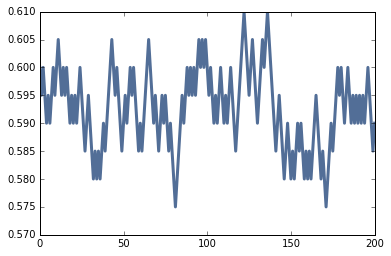

In [32]:
%time ps = find_critical(n=100, iters=200)
thinkplot.plot(ps)
np.mean(ps)

[[ 6 11 11 ..., 10 10  5]
 [ 7  8  7 ...,  5  6  6]
 [ 3  3  3 ...,  3  2  2]
 ..., 
 [ 2  2  3 ...,  2  2  2]
 [ 1  3  2 ...,  3  3  2]
 [ 2  2  2 ...,  2  2  2]]
[[10 15 15 ..., 10 10  5]
 [11 16 15 ...,  5  6  6]
 [ 7  7  7 ...,  3  2  2]
 ..., 
 [ 2  2  3 ...,  2  2  2]
 [ 1  3  2 ...,  3  3  2]
 [ 2  2  2 ...,  2  2  2]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ...,  5  6  6]
 [11 11 11 ...,  3  2  2]
 ..., 
 [ 2  2  3 ...,  2  2  2]
 [ 1  3  2 ...,  3  3  2]
 [ 2  2  2 ...,  2  2  2]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ...,  5  6  6]
 [15 15 11 ...,  3  2  2]
 ..., 
 [ 2  2  3 ...,  2  2  2]
 [ 1  3  2 ...,  3  3  2]
 [ 2  2  2 ...,  2  2  2]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ...,  5  6  6]
 [15 15 15 ...,  3  2  2]
 ..., 
 [ 2  2  3 ...,  2  2  2]
 [ 1  3  2 ...,  3  3  2]
 [ 2  2  2 ...,  2  2  2]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ...,  5  6  6]
 [15 15 15 ...,  3  2  2]
 ..., 
 [ 2  2  3 ...,  2  2  2]
 [ 1  3  2 ...,  3  3  2]
 [ 2  2  2 ...,  2  2  2]]
[[10 15 15 ..., 

[[10 15 15 ..., 10 10  5]
 [15 20 15 ...,  5  6  6]
 [15 15 15 ...,  3  2  2]
 ..., 
 [ 2  2  3 ...,  2  2  2]
 [ 1  3  2 ...,  3  3  2]
 [ 2  2  2 ...,  2  2  2]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ...,  5  6  6]
 [15 15 15 ...,  3  2  2]
 ..., 
 [ 2  2  3 ...,  2  2  2]
 [ 1  3  2 ...,  3  3  2]
 [ 2  2  2 ...,  2  2  2]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ...,  5  6  6]
 [15 15 15 ...,  3  2  2]
 ..., 
 [ 2  2  3 ...,  2  2  2]
 [ 1  3  2 ...,  3  3  2]
 [ 2  2  2 ...,  2  2  2]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ...,  5  6  6]
 [15 15 15 ...,  3  2  2]
 ..., 
 [ 2  2  3 ...,  2  2  2]
 [ 1  3  2 ...,  3  3  2]
 [ 2  2  2 ...,  2  2  2]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ...,  5  6  6]
 [15 15 15 ...,  3  2  2]
 ..., 
 [ 2  2  3 ...,  2  2  2]
 [ 1  3  2 ...,  3  3  2]
 [ 2  2  2 ...,  2  2  2]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ...,  5  6  6]
 [15 15 15 ...,  3  2  2]
 ..., 
 [ 2  2  3 ...,  2  2  2]
 [ 1  3  2 ...,  3  3  2]
 [ 2  2  2 ...,  2  2  2]]
[[10 15 15 ..., 

[[10 15 15 ..., 10 10  5]
 [15 20 15 ...,  5  6  6]
 [15 15 15 ...,  3  2  2]
 ..., 
 [ 2  2  3 ...,  2  2  2]
 [ 1  3  2 ...,  3  3  2]
 [ 2  2  2 ...,  2  2  2]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ...,  5  6  6]
 [15 15 15 ...,  3  2  2]
 ..., 
 [ 2  2  3 ...,  2  2  2]
 [ 1  3  2 ...,  3  3  2]
 [ 2  2  2 ...,  2  2  2]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ...,  5  6  6]
 [15 15 15 ...,  3  2  2]
 ..., 
 [ 2  2  3 ...,  2  2  2]
 [ 1  3  2 ...,  3  3  2]
 [ 2  2  2 ...,  2  2  2]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ...,  5  6  6]
 [15 15 15 ...,  3  2  2]
 ..., 
 [ 2  2  3 ...,  2  2  2]
 [ 1  3  2 ...,  3  3  2]
 [ 2  2  2 ...,  2  2  2]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ...,  5  6  6]
 [15 15 15 ...,  3  2  2]
 ..., 
 [ 2  2  3 ...,  2  2  2]
 [ 1  3  2 ...,  3  3  2]
 [ 2  2  2 ...,  2  2  2]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ...,  5  6  6]
 [15 15 15 ...,  3  2  2]
 ..., 
 [ 2  2  3 ...,  2  2  2]
 [ 1  3  2 ...,  3  3  2]
 [ 2  2  2 ...,  2  2  2]]
[[10 15 15 ..., 

[[10 15 15 ..., 10 10  5]
 [15 20 15 ...,  5  6  6]
 [15 15 15 ...,  3  2  2]
 ..., 
 [ 2  2  3 ...,  2  2  2]
 [ 1  3  2 ...,  3  3  2]
 [ 2  2  2 ...,  2  2  2]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ...,  5  6  6]
 [15 15 15 ...,  3  2  2]
 ..., 
 [ 2  2  3 ...,  2  2  2]
 [ 1  3  2 ...,  3  3  2]
 [ 2  2  2 ...,  2  2  2]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ...,  5  6  6]
 [15 15 15 ...,  3  2  2]
 ..., 
 [ 2  2  3 ...,  2  2  2]
 [ 1  3  2 ...,  3  3  2]
 [ 2  2  2 ...,  2  2  2]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ...,  5  6  6]
 [15 15 15 ...,  3  2  2]
 ..., 
 [ 2  2  3 ...,  2  2  2]
 [ 1  3  2 ...,  3  3  2]
 [ 2  2  2 ...,  2  2  2]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ...,  5  6  6]
 [15 15 15 ...,  3  2  2]
 ..., 
 [ 2  2  3 ...,  2  2  2]
 [ 1  3  2 ...,  3  3  2]
 [ 2  2  2 ...,  2  2  2]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ...,  5  6  6]
 [15 15 15 ...,  3  2  2]
 ..., 
 [ 2  2  3 ...,  2  2  2]
 [ 1  3  2 ...,  3  3  2]
 [ 2  2  2 ...,  2  2  2]]
[[10 15 15 ..., 

[[ 5 15 10 ..., 10 10 10]
 [15 10 15 ...,  6 10 10]
 [ 5 15 15 ...,  2  6 10]
 ..., 
 [ 2  3  2 ...,  2  4  3]
 [ 3  2  3 ...,  2  4  3]
 [ 1  3  0 ...,  2  2  2]]
[[ 5 15 10 ..., 10 10 10]
 [15 10 15 ...,  6 10 10]
 [ 5 15 15 ...,  2  6 10]
 ..., 
 [ 2  3  2 ...,  2  4  3]
 [ 3  2  3 ...,  2  4  3]
 [ 1  3  0 ...,  2  2  2]]
[[ 5 15 10 ..., 10 10 10]
 [15 10 15 ...,  6 10 10]
 [ 5 15 15 ...,  2  6 10]
 ..., 
 [ 2  3  2 ...,  2  4  3]
 [ 3  2  3 ...,  2  4  3]
 [ 1  3  0 ...,  2  2  2]]
[[ 5 15 10 ..., 10 10 10]
 [15 10 15 ...,  6 10 10]
 [ 5 15 15 ...,  2  6 10]
 ..., 
 [ 2  3  2 ...,  2  4  3]
 [ 3  2  3 ...,  2  4  3]
 [ 1  3  0 ...,  2  2  2]]
[[ 5 15 10 ..., 10 10 10]
 [15 10 15 ...,  6 10 10]
 [ 5 15 15 ...,  2  6 10]
 ..., 
 [ 2  3  2 ...,  2  4  3]
 [ 3  2  3 ...,  2  4  3]
 [ 1  3  0 ...,  2  2  2]]
[[ 5 15 10 ..., 10 10 10]
 [15 10 15 ...,  6 10 10]
 [ 5 15 15 ...,  2  6 10]
 ..., 
 [ 2  3  2 ...,  2  4  3]
 [ 3  2  3 ...,  2  4  3]
 [ 1  3  0 ...,  2  2  2]]
[[ 5 15 10 ..., 

[[ 5 15 10 ..., 10 10 10]
 [15 10 15 ..., 10 10 10]
 [ 5 15 15 ..., 10 10 10]
 ..., 
 [ 2  3  2 ...,  2  4  3]
 [ 3  2  3 ...,  2  4  3]
 [ 1  3  0 ...,  2  2  2]]
[[ 5 15 10 ..., 10 10 10]
 [15 10 15 ..., 10 10 10]
 [ 5 15 15 ..., 10 10 10]
 ..., 
 [ 2  3  2 ...,  2  4  3]
 [ 3  2  3 ...,  2  4  3]
 [ 1  3  0 ...,  2  2  2]]
[[ 5 15 10 ..., 10 10 10]
 [15 10 15 ..., 10 10 10]
 [ 5 15 15 ..., 10 10 10]
 ..., 
 [ 2  3  2 ...,  2  4  3]
 [ 3  2  3 ...,  2  4  3]
 [ 1  3  0 ...,  2  2  2]]
[[ 5 15 10 ..., 10 10 10]
 [15 10 15 ..., 10 10 10]
 [ 5 15 15 ..., 10 10 10]
 ..., 
 [ 2  3  2 ...,  2  4  3]
 [ 3  2  3 ...,  2  4  3]
 [ 1  3  0 ...,  2  2  2]]
[[ 5 15 10 ..., 10 10 10]
 [15 10 15 ..., 10 10 10]
 [ 5 15 15 ..., 10 10 10]
 ..., 
 [ 2  3  2 ...,  2  4  3]
 [ 3  2  3 ...,  2  4  3]
 [ 1  3  0 ...,  2  2  2]]
[[ 5 15 10 ..., 10 10 10]
 [15 10 15 ..., 10 10 10]
 [ 5 15 15 ..., 10 10 10]
 ..., 
 [ 2  3  2 ...,  2  4  3]
 [ 3  2  3 ...,  2  4  3]
 [ 1  3  0 ...,  2  2  2]]
[[ 5 15 10 ..., 

 [ 1  3  0 ...,  2  2  2]]
[[ 5 15 10 ..., 10 10 10]
 [15 10 15 ..., 10 10 10]
 [ 5 15 15 ..., 10 10 10]
 ..., 
 [ 2  3  2 ...,  2  4  3]
 [ 3  2  3 ...,  2  4  3]
 [ 1  3  0 ...,  2  2  2]]
[[ 5 15 10 ..., 10 10 10]
 [15 10 15 ..., 10 10 10]
 [ 5 15 15 ..., 10 10 10]
 ..., 
 [ 2  3  2 ...,  2  4  3]
 [ 3  2  3 ...,  2  4  3]
 [ 1  3  0 ...,  2  2  2]]
[[ 5 15 10 ..., 10 10 10]
 [15 10 15 ..., 10 10 10]
 [ 5 15 15 ..., 10 10 10]
 ..., 
 [ 2  3  2 ...,  2  4  3]
 [ 3  2  3 ...,  2  4  3]
 [ 1  3  0 ...,  2  2  2]]
[[ 5 15 10 ..., 10 10 10]
 [15 10 15 ..., 10 10 10]
 [ 5 15 15 ..., 10 10 10]
 ..., 
 [ 2  3  2 ...,  2  4  3]
 [ 3  2  3 ...,  2  4  3]
 [ 1  3  0 ...,  2  2  2]]
[[ 5 15 10 ..., 10 10 10]
 [15 10 15 ..., 10 10 10]
 [ 5 15 15 ..., 10 10 10]
 ..., 
 [ 2  3  2 ...,  2  4  3]
 [ 3  2  3 ...,  2  4  3]
 [ 1  3  0 ...,  2  2  2]]
[[ 5 15 10 ..., 10 10 10]
 [15 10 15 ..., 10 10 10]
 [ 5 15 15 ..., 10 10 10]
 ..., 
 [ 2  3  2 ...,  2  4  3]
 [ 3  2  3 ...,  2  4  3]
 [ 1  3  0 ..., 

[[ 5 15 10 ..., 10 10 10]
 [15 10 15 ..., 10 10 10]
 [ 5 15 15 ..., 10 10 10]
 ..., 
 [ 2  3  2 ...,  2  4  3]
 [ 3  2  3 ...,  2  4  3]
 [ 1  3  0 ...,  2  2  2]]
[[ 5 15 10 ..., 10 10 10]
 [15 10 15 ..., 10 10 10]
 [ 5 15 15 ..., 10 10 10]
 ..., 
 [ 2  3  2 ...,  2  4  3]
 [ 3  2  3 ...,  2  4  3]
 [ 1  3  0 ...,  2  2  2]]
[[ 5 15 10 ..., 10 10 10]
 [15 10 15 ..., 10 10 10]
 [ 5 15 15 ..., 10 10 10]
 ..., 
 [ 2  3  2 ...,  2  4  3]
 [ 3  2  3 ...,  2  4  3]
 [ 1  3  0 ...,  2  2  2]]
[[ 5 15 10 ..., 10 10 10]
 [15 10 15 ..., 10 10 10]
 [ 5 15 15 ..., 10 10 10]
 ..., 
 [ 2  3  2 ...,  2  4  3]
 [ 3  2  3 ...,  2  4  3]
 [ 1  3  0 ...,  2  2  2]]
[[ 5 15 10 ..., 10 10 10]
 [15 10 15 ..., 10 10 10]
 [ 5 15 15 ..., 10 10 10]
 ..., 
 [ 2  3  2 ...,  2  4  3]
 [ 3  2  3 ...,  2  4  3]
 [ 1  3  0 ...,  2  2  2]]
[[ 5 15 10 ..., 10 10 10]
 [15 10 15 ..., 10 10 10]
 [ 5 15 15 ..., 10 10 10]
 ..., 
 [ 2  3  2 ...,  2  4  3]
 [ 3  2  3 ...,  2  4  3]
 [ 1  3  0 ...,  2  2  2]]
[[ 5 15 10 ..., 

[[ 5 15 10 ..., 10 10 10]
 [15 10 15 ..., 10 10 10]
 [ 5 15 15 ..., 10 10 10]
 ..., 
 [ 2  3  2 ...,  2  4  3]
 [ 3  2  3 ...,  2  4  3]
 [ 1  3  0 ...,  2  2  2]]
[[ 5 15 10 ..., 10 10 10]
 [15 10 15 ..., 10 10 10]
 [ 5 15 15 ..., 10 10 10]
 ..., 
 [ 2  3  2 ...,  2  4  3]
 [ 3  2  3 ...,  2  4  3]
 [ 1  3  0 ...,  2  2  2]]
[[ 5 15 10 ..., 10 10 10]
 [15 10 15 ..., 10 10 10]
 [ 5 15 15 ..., 10 10 10]
 ..., 
 [ 2  3  2 ...,  2  4  3]
 [ 3  2  3 ...,  2  4  3]
 [ 1  3  0 ...,  2  2  2]]
[[ 5 15 10 ..., 10 10 10]
 [15 10 15 ..., 10 10 10]
 [ 5 15 15 ..., 10 10 10]
 ..., 
 [ 2  3  2 ...,  2  4  3]
 [ 3  2  3 ...,  2  4  3]
 [ 1  3  0 ...,  2  2  2]]
[[ 5 15 10 ..., 10 10 10]
 [15 10 15 ..., 10 10 10]
 [ 5 15 15 ..., 10 10 10]
 ..., 
 [ 2  3  2 ...,  2  4  3]
 [ 3  2  3 ...,  2  4  3]
 [ 1  3  0 ...,  2  2  2]]
[[ 5 15 10 ..., 10 10 10]
 [15 10 15 ..., 10 10 10]
 [ 5 15 15 ..., 10 10 10]
 ..., 
 [ 2  3  2 ...,  2  4  3]
 [ 3  2  3 ...,  2  4  3]
 [ 1  3  0 ...,  2  2  2]]
[[ 5 15 10 ..., 

[[10 10 10 ..., 15 10 10]
 [10 10  5 ..., 10 20  5]
 [10  5 10 ..., 15  5 11]
 ..., 
 [ 2  3  2 ...,  4  2  3]
 [ 2  2  1 ...,  3  3  3]
 [ 1  1  2 ...,  2  3  1]]
[[10 10 10 ..., 15 10 10]
 [10 10  5 ..., 10 20  5]
 [10  5 10 ..., 15  5 11]
 ..., 
 [ 2  3  2 ...,  4  2  3]
 [ 2  2  1 ...,  3  3  3]
 [ 1  1  2 ...,  2  3  1]]
[[10 10 10 ..., 15 10 10]
 [10 10  5 ..., 10 20  5]
 [10  5 10 ..., 15  5 11]
 ..., 
 [ 2  3  2 ...,  4  2  3]
 [ 2  2  1 ...,  3  3  3]
 [ 1  1  2 ...,  2  3  1]]
[[10 10 10 ..., 15 10 10]
 [10 10  5 ..., 10 20  5]
 [10  5 10 ..., 15  5 11]
 ..., 
 [ 2  3  2 ...,  4  2  3]
 [ 2  2  1 ...,  3  3  3]
 [ 1  1  2 ...,  2  3  1]]
[[10 10 10 ..., 15 10 10]
 [10 10  5 ..., 10 20  5]
 [10  5 10 ..., 15  5 11]
 ..., 
 [ 2  3  2 ...,  4  2  3]
 [ 2  2  1 ...,  3  3  3]
 [ 1  1  2 ...,  2  3  1]]
[[10 10 10 ..., 15 10 10]
 [10 10  5 ..., 10 20  5]
 [10  5 10 ..., 15  5 11]
 ..., 
 [ 2  3  2 ...,  4  2  3]
 [ 2  2  1 ...,  3  3  3]
 [ 1  1  2 ...,  2  3  1]]
[[10 10 10 ..., 

[[10 10 10 ..., 15 10 10]
 [10 10  5 ..., 10 20  5]
 [10  5 10 ..., 15  5 11]
 ..., 
 [ 2  3  2 ...,  4  2  3]
 [ 2  2  1 ...,  3  3  3]
 [ 1  1  2 ...,  2  3  1]]
[[10 10 10 ..., 15 10 10]
 [10 10  5 ..., 10 20  5]
 [10  5 10 ..., 15  5 11]
 ..., 
 [ 2  3  2 ...,  4  2  3]
 [ 2  2  1 ...,  3  3  3]
 [ 1  1  2 ...,  2  3  1]]
[[10 10 10 ..., 15 10 10]
 [10 10  5 ..., 10 20  5]
 [10  5 10 ..., 15  5 11]
 ..., 
 [ 2  3  2 ...,  4  2  3]
 [ 2  2  1 ...,  3  3  3]
 [ 1  1  2 ...,  2  3  1]]
[[10 10 10 ..., 15 10 10]
 [10 10  5 ..., 10 20  5]
 [10  5 10 ..., 15  5 11]
 ..., 
 [ 2  3  2 ...,  4  2  3]
 [ 2  2  1 ...,  3  3  3]
 [ 1  1  2 ...,  2  3  1]]
[[10 10 10 ..., 15 10 10]
 [10 10  5 ..., 10 20  5]
 [10  5 10 ..., 15  5 11]
 ..., 
 [ 2  3  2 ...,  4  2  3]
 [ 2  2  1 ...,  3  3  3]
 [ 1  1  2 ...,  2  3  1]]
[[10 10 10 ..., 15 10 10]
 [10 10  5 ..., 10 20  5]
 [10  5 10 ..., 15  5 11]
 ..., 
 [ 2  3  2 ...,  4  2  3]
 [ 2  2  1 ...,  3  3  3]
 [ 1  1  2 ...,  2  3  1]]
[[10 10 10 ..., 

[[10 10 10 ..., 15 10 10]
 [10 10  5 ..., 10 20  5]
 [10  5 10 ..., 15  5 11]
 ..., 
 [ 2  3  2 ...,  4  2  3]
 [ 2  2  1 ...,  3  3  3]
 [ 1  1  2 ...,  2  3  1]]
[[10 10 10 ..., 15 10 10]
 [10 10  5 ..., 10 20  5]
 [10  5 10 ..., 15  5 11]
 ..., 
 [ 2  3  2 ...,  4  2  3]
 [ 2  2  1 ...,  3  3  3]
 [ 1  1  2 ...,  2  3  1]]
[[10 10 10 ..., 15 10 10]
 [10 10  5 ..., 10 20  5]
 [10  5 10 ..., 15  5 11]
 ..., 
 [ 2  3  2 ...,  4  2  3]
 [ 2  2  1 ...,  3  3  3]
 [ 1  1  2 ...,  2  3  1]]
[[10 10 10 ..., 15 10 10]
 [10 10  5 ..., 10 20  5]
 [10  5 10 ..., 15  5 11]
 ..., 
 [ 2  3  2 ...,  4  2  3]
 [ 2  2  1 ...,  3  3  3]
 [ 1  1  2 ...,  2  3  1]]
[[10 10 10 ..., 15 10 10]
 [10 10  5 ..., 10 20  5]
 [10  5 10 ..., 15  5 11]
 ..., 
 [ 2  3  2 ...,  4  2  3]
 [ 2  2  1 ...,  3  3  3]
 [ 1  1  2 ...,  2  3  1]]
[[10 10 10 ..., 15 10 10]
 [10 10  5 ..., 10 20  5]
 [10  5 10 ..., 15  5 11]
 ..., 
 [ 2  3  2 ...,  4  2  3]
 [ 2  2  1 ...,  3  3  3]
 [ 1  1  2 ...,  2  3  1]]
[[10 10 10 ..., 

[[10 10 10 ..., 15 10 10]
 [10 10  5 ..., 10 20  5]
 [10  5 10 ..., 15  5 11]
 ..., 
 [ 2  3  2 ...,  4  2  3]
 [ 2  2  1 ...,  3  3  3]
 [ 1  1  2 ...,  2  3  1]]
[[10 10 10 ..., 15 10 10]
 [10 10  5 ..., 10 20  5]
 [10  5 10 ..., 15  5 11]
 ..., 
 [ 2  3  2 ...,  4  2  3]
 [ 2  2  1 ...,  3  3  3]
 [ 1  1  2 ...,  2  3  1]]
[[10 10 10 ..., 15 10 10]
 [10 10  5 ..., 10 20  5]
 [10  5 10 ..., 15  5 11]
 ..., 
 [ 2  3  2 ...,  4  2  3]
 [ 2  2  1 ...,  3  3  3]
 [ 1  1  2 ...,  2  3  1]]
[[10 10 10 ..., 15 10 10]
 [10 10  5 ..., 10 20  5]
 [10  5 10 ..., 15  5 11]
 ..., 
 [ 2  3  2 ...,  4  2  3]
 [ 2  2  1 ...,  3  3  3]
 [ 1  1  2 ...,  2  3  1]]
[[10 10 10 ..., 15 10 10]
 [10 10  5 ..., 10 20  5]
 [10  5 10 ..., 15  5 11]
 ..., 
 [ 2  3  2 ...,  4  2  3]
 [ 2  2  1 ...,  3  3  3]
 [ 1  1  2 ...,  2  3  1]]
[[10 10 10 ..., 15 10 10]
 [10 10  5 ..., 10 20  5]
 [10  5 10 ..., 15  5 11]
 ..., 
 [ 2  3  2 ...,  4  2  3]
 [ 2  2  1 ...,  3  3  3]
 [ 1  1  2 ...,  2  3  1]]
[[10 10 10 ..., 

[[ 5 10 15 ..., 15 15 10]
 [10 10 15 ..., 15 20 15]
 [ 5 15 10 ..., 20 15 15]
 ..., 
 [ 2  2  4 ...,  2  2  2]
 [ 3  2  2 ...,  3  2  1]
 [ 0  3  2 ...,  0  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [10 10 15 ..., 15 20 15]
 [ 5 15 10 ..., 20 15 15]
 ..., 
 [ 2  2  4 ...,  2  2  2]
 [ 3  2  2 ...,  3  2  1]
 [ 0  3  2 ...,  0  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [10 10 15 ..., 15 20 15]
 [ 5 15 10 ..., 20 15 15]
 ..., 
 [ 2  2  4 ...,  2  2  2]
 [ 3  2  2 ...,  3  2  1]
 [ 0  3  2 ...,  0  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [10 10 15 ..., 15 20 15]
 [ 5 15 10 ..., 20 15 15]
 ..., 
 [ 2  2  4 ...,  2  2  2]
 [ 3  2  2 ...,  3  2  1]
 [ 0  3  2 ...,  0  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [10 10 15 ..., 15 20 15]
 [ 5 15 10 ..., 20 15 15]
 ..., 
 [ 2  2  4 ...,  2  2  2]
 [ 3  2  2 ...,  3  2  1]
 [ 0  3  2 ...,  0  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [10 10 15 ..., 15 20 15]
 [ 5 15 10 ..., 20 15 15]
 ..., 
 [ 2  2  4 ...,  2  2  2]
 [ 3  2  2 ...,  3  2  1]
 [ 0  3  2 ...,  0  2  1]]
[[ 5 10 15 ..., 

[[ 5 10 15 ..., 15 15 10]
 [10 10 15 ..., 15 20 15]
 [ 5 15 10 ..., 20 15 15]
 ..., 
 [ 2  2  4 ...,  2  2  2]
 [ 3  2  2 ...,  3  2  1]
 [ 0  3  2 ...,  0  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [10 10 15 ..., 15 20 15]
 [ 5 15 10 ..., 20 15 15]
 ..., 
 [ 2  2  4 ...,  2  2  2]
 [ 3  2  2 ...,  3  2  1]
 [ 0  3  2 ...,  0  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [10 10 15 ..., 15 20 15]
 [ 5 15 10 ..., 20 15 15]
 ..., 
 [ 2  2  4 ...,  2  2  2]
 [ 3  2  2 ...,  3  2  1]
 [ 0  3  2 ...,  0  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [10 10 15 ..., 15 20 15]
 [ 5 15 10 ..., 20 15 15]
 ..., 
 [ 2  2  4 ...,  2  2  2]
 [ 3  2  2 ...,  3  2  1]
 [ 0  3  2 ...,  0  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [10 10 15 ..., 15 20 15]
 [ 5 15 10 ..., 20 15 15]
 ..., 
 [ 2  2  4 ...,  2  2  2]
 [ 3  2  2 ...,  3  2  1]
 [ 0  3  2 ...,  0  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [10 10 15 ..., 15 20 15]
 [ 5 15 10 ..., 20 15 15]
 ..., 
 [ 2  2  4 ...,  2  2  2]
 [ 3  2  2 ...,  3  2  1]
 [ 0  3  2 ...,  0  2  1]]
[[ 5 10 15 ..., 

[[ 5 10 15 ..., 15 15 10]
 [10 10 15 ..., 15 20 15]
 [ 5 15 10 ..., 20 15 15]
 ..., 
 [ 2  2  4 ...,  2  2  2]
 [ 3  2  2 ...,  3  2  1]
 [ 0  3  2 ...,  0  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [10 10 15 ..., 15 20 15]
 [ 5 15 10 ..., 20 15 15]
 ..., 
 [ 2  2  4 ...,  2  2  2]
 [ 3  2  2 ...,  3  2  1]
 [ 0  3  2 ...,  0  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [10 10 15 ..., 15 20 15]
 [ 5 15 10 ..., 20 15 15]
 ..., 
 [ 2  2  4 ...,  2  2  2]
 [ 3  2  2 ...,  3  2  1]
 [ 0  3  2 ...,  0  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [10 10 15 ..., 15 20 15]
 [ 5 15 10 ..., 20 15 15]
 ..., 
 [ 2  2  4 ...,  2  2  2]
 [ 3  2  2 ...,  3  2  1]
 [ 0  3  2 ...,  0  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [10 10 15 ..., 15 20 15]
 [ 5 15 10 ..., 20 15 15]
 ..., 
 [ 2  2  4 ...,  2  2  2]
 [ 3  2  2 ...,  3  2  1]
 [ 0  3  2 ...,  0  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [10 10 15 ..., 15 20 15]
 [ 5 15 10 ..., 20 15 15]
 ..., 
 [ 2  2  4 ...,  2  2  2]
 [ 3  2  2 ...,  3  2  1]
 [ 0  3  2 ...,  0  2  1]]
[[ 5 10 15 ..., 

[[ 5 10 15 ..., 15 15 10]
 [10 10 15 ..., 15 20 15]
 [ 5 15 10 ..., 20 15 15]
 ..., 
 [ 2  2  4 ...,  2  2  2]
 [ 3  2  2 ...,  3  2  1]
 [ 0  3  2 ...,  0  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [10 10 15 ..., 15 20 15]
 [ 5 15 10 ..., 20 15 15]
 ..., 
 [ 2  2  4 ...,  2  2  2]
 [ 3  2  2 ...,  3  2  1]
 [ 0  3  2 ...,  0  2  1]]
[[ 6 11 11 ..., 10 10  5]
 [ 7  8  7 ...,  7  6  6]
 [ 2  2  3 ...,  2  2  1]
 ..., 
 [ 1  4  2 ...,  2  3  1]
 [ 3  2  4 ...,  2  0  3]
 [ 1  3  1 ...,  0  2  0]]
[[10 15 15 ..., 10 10  5]
 [11 16 15 ..., 11  6  6]
 [ 6  6  7 ...,  2  2  1]
 ..., 
 [ 1  4  2 ...,  2  3  1]
 [ 3  2  4 ...,  2  0  3]
 [ 1  3  1 ...,  0  2  0]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ..., 11  6  6]
 [10 10 15 ...,  6  2  1]
 ..., 
 [ 1  4  2 ...,  2  3  1]
 [ 3  2  4 ...,  2  0  3]
 [ 1  3  1 ...,  0  2  0]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ..., 15  6  6]
 [10 10 15 ...,  6  6  1]
 ..., 
 [ 1  4  2 ...,  2  3  1]
 [ 3  2  4 ...,  2  0  3]
 [ 1  3  1 ...,  0  2  0]]
[[10 15 15 ..., 

[[10 15 15 ..., 10 10  5]
 [15 20 15 ..., 15 10 10]
 [10 10 15 ..., 10 10  5]
 ..., 
 [ 1  4  2 ...,  2  3  1]
 [ 3  2  4 ...,  2  0  3]
 [ 1  3  1 ...,  0  2  0]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ..., 15 10 10]
 [10 10 15 ..., 10 10  5]
 ..., 
 [ 1  4  2 ...,  2  3  1]
 [ 3  2  4 ...,  2  0  3]
 [ 1  3  1 ...,  0  2  0]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ..., 15 10 10]
 [10 10 15 ..., 10 10  5]
 ..., 
 [ 1  4  2 ...,  2  3  1]
 [ 3  2  4 ...,  2  0  3]
 [ 1  3  1 ...,  0  2  0]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ..., 15 10 10]
 [10 10 15 ..., 10 10  5]
 ..., 
 [ 1  4  2 ...,  2  3  1]
 [ 3  2  4 ...,  2  0  3]
 [ 1  3  1 ...,  0  2  0]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ..., 15 10 10]
 [10 10 15 ..., 10 10  5]
 ..., 
 [ 1  4  2 ...,  2  3  1]
 [ 3  2  4 ...,  2  0  3]
 [ 1  3  1 ...,  0  2  0]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ..., 15 10 10]
 [10 10 15 ..., 10 10  5]
 ..., 
 [ 1  4  2 ...,  2  3  1]
 [ 3  2  4 ...,  2  0  3]
 [ 1  3  1 ...,  0  2  0]]
[[10 15 15 ..., 

[[10 15 15 ..., 10 10  5]
 [15 20 15 ..., 15 10 10]
 [10 10 15 ..., 10 10  5]
 ..., 
 [ 1  4  2 ...,  2  3  1]
 [ 3  2  4 ...,  2  0  3]
 [ 1  3  1 ...,  0  2  0]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ..., 15 10 10]
 [10 10 15 ..., 10 10  5]
 ..., 
 [ 1  4  2 ...,  2  3  1]
 [ 3  2  4 ...,  2  0  3]
 [ 1  3  1 ...,  0  2  0]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ..., 15 10 10]
 [10 10 15 ..., 10 10  5]
 ..., 
 [ 1  4  2 ...,  2  3  1]
 [ 3  2  4 ...,  2  0  3]
 [ 1  3  1 ...,  0  2  0]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ..., 15 10 10]
 [10 10 15 ..., 10 10  5]
 ..., 
 [ 1  4  2 ...,  2  3  1]
 [ 3  2  4 ...,  2  0  3]
 [ 1  3  1 ...,  0  2  0]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ..., 15 10 10]
 [10 10 15 ..., 10 10  5]
 ..., 
 [ 1  4  2 ...,  2  3  1]
 [ 3  2  4 ...,  2  0  3]
 [ 1  3  1 ...,  0  2  0]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ..., 15 10 10]
 [10 10 15 ..., 10 10  5]
 ..., 
 [ 1  4  2 ...,  2  3  1]
 [ 3  2  4 ...,  2  0  3]
 [ 1  3  1 ...,  0  2  0]]
[[10 15 15 ..., 

[[10 15 15 ..., 10 10  5]
 [15 20 15 ..., 15 10 10]
 [10 10 15 ..., 10 10  5]
 ..., 
 [ 1  4  2 ...,  2  3  1]
 [ 3  2  4 ...,  2  0  3]
 [ 1  3  1 ...,  0  2  0]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ..., 15 10 10]
 [10 10 15 ..., 10 10  5]
 ..., 
 [ 1  4  2 ...,  2  3  1]
 [ 3  2  4 ...,  2  0  3]
 [ 1  3  1 ...,  0  2  0]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ..., 15 10 10]
 [10 10 15 ..., 10 10  5]
 ..., 
 [ 1  4  2 ...,  2  3  1]
 [ 3  2  4 ...,  2  0  3]
 [ 1  3  1 ...,  0  2  0]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ..., 15 10 10]
 [10 10 15 ..., 10 10  5]
 ..., 
 [ 1  4  2 ...,  2  3  1]
 [ 3  2  4 ...,  2  0  3]
 [ 1  3  1 ...,  0  2  0]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ..., 15 10 10]
 [10 10 15 ..., 10 10  5]
 ..., 
 [ 1  4  2 ...,  2  3  1]
 [ 3  2  4 ...,  2  0  3]
 [ 1  3  1 ...,  0  2  0]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ..., 15 10 10]
 [10 10 15 ..., 10 10  5]
 ..., 
 [ 1  4  2 ...,  2  3  1]
 [ 3  2  4 ...,  2  0  3]
 [ 1  3  1 ...,  0  2  0]]
[[10 15 15 ..., 

[[10 15 15 ..., 10 10  5]
 [15 20 15 ..., 15 10 10]
 [10 10 15 ..., 10 10  5]
 ..., 
 [ 1  4  2 ...,  2  3  1]
 [ 3  2  4 ...,  2  0  3]
 [ 1  3  1 ...,  0  2  0]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ..., 15 10 10]
 [10 10 15 ..., 10 10  5]
 ..., 
 [ 1  4  2 ...,  2  3  1]
 [ 3  2  4 ...,  2  0  3]
 [ 1  3  1 ...,  0  2  0]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ..., 15 10 10]
 [10 10 15 ..., 10 10  5]
 ..., 
 [ 1  4  2 ...,  2  3  1]
 [ 3  2  4 ...,  2  0  3]
 [ 1  3  1 ...,  0  2  0]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ..., 15 10 10]
 [10 10 15 ..., 10 10  5]
 ..., 
 [ 1  4  2 ...,  2  3  1]
 [ 3  2  4 ...,  2  0  3]
 [ 1  3  1 ...,  0  2  0]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ..., 15 10 10]
 [10 10 15 ..., 10 10  5]
 ..., 
 [ 1  4  2 ...,  2  3  1]
 [ 3  2  4 ...,  2  0  3]
 [ 1  3  1 ...,  0  2  0]]
[[10 15 15 ..., 10 10  5]
 [15 20 15 ..., 15 10 10]
 [10 10 15 ..., 10 10  5]
 ..., 
 [ 1  4  2 ...,  2  3  1]
 [ 3  2  4 ...,  2  0  3]
 [ 1  3  1 ...,  0  2  0]]
[[10 15 15 ..., 

[[ 5 15 10 ..., 15 10  5]
 [10 10 20 ...,  5 10  5]
 [ 5 15  5 ..., 15  5  5]
 ..., 
 [ 1  2  3 ...,  3  1  1]
 [ 2  1  2 ...,  2  3  2]
 [ 0  2  2 ...,  3  3  2]]
[[ 5 15 10 ..., 15 10  5]
 [10 10 20 ...,  5 10  5]
 [ 5 15  5 ..., 15  5  5]
 ..., 
 [ 1  2  3 ...,  3  1  1]
 [ 2  1  2 ...,  2  3  2]
 [ 0  2  2 ...,  3  3  2]]
[[ 5 15 10 ..., 15 10  5]
 [10 10 20 ...,  5 10  5]
 [ 5 15  5 ..., 15  5  5]
 ..., 
 [ 1  2  3 ...,  3  1  1]
 [ 2  1  2 ...,  2  3  2]
 [ 0  2  2 ...,  3  3  2]]
[[ 5 15 10 ..., 15 10  5]
 [10 10 20 ...,  5 10  5]
 [ 5 15  5 ..., 15  5  5]
 ..., 
 [ 1  2  3 ...,  3  1  1]
 [ 2  1  2 ...,  2  3  2]
 [ 0  2  2 ...,  3  3  2]]
[[ 5 15 10 ..., 15 10  5]
 [10 10 20 ...,  5 10  5]
 [ 5 15  5 ..., 15  5  5]
 ..., 
 [ 1  2  3 ...,  3  1  1]
 [ 2  1  2 ...,  2  3  2]
 [ 0  2  2 ...,  3  3  2]]
[[ 5 15 10 ..., 15 10  5]
 [10 10 20 ...,  5 10  5]
 [ 5 15  5 ..., 15  5  5]
 ..., 
 [ 1  2  3 ...,  3  1  1]
 [ 2  1  2 ...,  2  3  2]
 [ 0  2  2 ...,  3  3  2]]
[[ 5 15 10 ..., 

[[ 5 15 10 ..., 15 10  5]
 [10 10 20 ...,  5 10  5]
 [ 5 15  5 ..., 15  5  5]
 ..., 
 [ 1  2  3 ...,  3  1  1]
 [ 2  1  2 ...,  2  3  2]
 [ 0  2  2 ...,  3  3  2]]
[[ 5 15 10 ..., 15 10  5]
 [10 10 20 ...,  5 10  5]
 [ 5 15  5 ..., 15  5  5]
 ..., 
 [ 1  2  3 ...,  3  1  1]
 [ 2  1  2 ...,  2  3  2]
 [ 0  2  2 ...,  3  3  2]]
[[ 5 15 10 ..., 15 10  5]
 [10 10 20 ...,  5 10  5]
 [ 5 15  5 ..., 15  5  5]
 ..., 
 [ 1  2  3 ...,  3  1  1]
 [ 2  1  2 ...,  2  3  2]
 [ 0  2  2 ...,  3  3  2]]
[[ 5 15 10 ..., 15 10  5]
 [10 10 20 ...,  5 10  5]
 [ 5 15  5 ..., 15  5  5]
 ..., 
 [ 1  2  3 ...,  3  1  1]
 [ 2  1  2 ...,  2  3  2]
 [ 0  2  2 ...,  3  3  2]]
[[ 5 15 10 ..., 15 10  5]
 [10 10 20 ...,  5 10  5]
 [ 5 15  5 ..., 15  5  5]
 ..., 
 [ 1  2  3 ...,  3  1  1]
 [ 2  1  2 ...,  2  3  2]
 [ 0  2  2 ...,  3  3  2]]
[[ 5 15 10 ..., 15 10  5]
 [10 10 20 ...,  5 10  5]
 [ 5 15  5 ..., 15  5  5]
 ..., 
 [ 1  2  3 ...,  3  1  1]
 [ 2  1  2 ...,  2  3  2]
 [ 0  2  2 ...,  3  3  2]]
[[ 5 15 10 ..., 

[[ 5 15 10 ..., 15 10  5]
 [10 10 20 ...,  5 10  5]
 [ 5 15  5 ..., 15  5  5]
 ..., 
 [ 1  2  3 ...,  3  1  1]
 [ 2  1  2 ...,  2  3  2]
 [ 0  2  2 ...,  3  3  2]]
[[ 5 15 10 ..., 15 10  5]
 [10 10 20 ...,  5 10  5]
 [ 5 15  5 ..., 15  5  5]
 ..., 
 [ 1  2  3 ...,  3  1  1]
 [ 2  1  2 ...,  2  3  2]
 [ 0  2  2 ...,  3  3  2]]
[[ 5 15 10 ..., 15 10  5]
 [10 10 20 ...,  5 10  5]
 [ 5 15  5 ..., 15  5  5]
 ..., 
 [ 1  2  3 ...,  3  1  1]
 [ 2  1  2 ...,  2  3  2]
 [ 0  2  2 ...,  3  3  2]]
[[ 5 15 10 ..., 15 10  5]
 [10 10 20 ...,  5 10  5]
 [ 5 15  5 ..., 15  5  5]
 ..., 
 [ 1  2  3 ...,  3  1  1]
 [ 2  1  2 ...,  2  3  2]
 [ 0  2  2 ...,  3  3  2]]
[[ 5 15 10 ..., 15 10  5]
 [10 10 20 ...,  5 10  5]
 [ 5 15  5 ..., 15  5  5]
 ..., 
 [ 1  2  3 ...,  3  1  1]
 [ 2  1  2 ...,  2  3  2]
 [ 0  2  2 ...,  3  3  2]]
[[ 5 15 10 ..., 15 10  5]
 [10 10 20 ...,  5 10  5]
 [ 5 15  5 ..., 15  5  5]
 ..., 
 [ 1  2  3 ...,  3  1  1]
 [ 2  1  2 ...,  2  3  2]
 [ 0  2  2 ...,  3  3  2]]
[[ 5 15 10 ..., 

[[ 5 10 10 ..., 15 15 10]
 [10  5 10 ..., 20 20 15]
 [ 5 10 10 ..., 15 15 15]
 ..., 
 [ 2  2  4 ...,  3  4  2]
 [ 1  3  2 ...,  3  2  3]
 [ 1  1  2 ...,  1  3  1]]
[[ 5 10 10 ..., 15 15 10]
 [10  5 10 ..., 20 20 15]
 [ 5 10 10 ..., 15 15 15]
 ..., 
 [ 2  2  4 ...,  3  4  2]
 [ 1  3  2 ...,  3  2  3]
 [ 1  1  2 ...,  1  3  1]]
[[ 5 10 10 ..., 15 15 10]
 [10  5 10 ..., 20 20 15]
 [ 5 10 10 ..., 15 15 15]
 ..., 
 [ 2  2  4 ...,  3  4  2]
 [ 1  3  2 ...,  3  2  3]
 [ 1  1  2 ...,  1  3  1]]
[[ 5 10 10 ..., 15 15 10]
 [10  5 10 ..., 20 20 15]
 [ 5 10 10 ..., 15 15 15]
 ..., 
 [ 2  2  4 ...,  3  4  2]
 [ 1  3  2 ...,  3  2  3]
 [ 1  1  2 ...,  1  3  1]]
[[ 5 10 10 ..., 15 15 10]
 [10  5 10 ..., 20 20 15]
 [ 5 10 10 ..., 15 15 15]
 ..., 
 [ 2  2  4 ...,  3  4  2]
 [ 1  3  2 ...,  3  2  3]
 [ 1  1  2 ...,  1  3  1]]
[[ 5 10 10 ..., 15 15 10]
 [10  5 10 ..., 20 20 15]
 [ 5 10 10 ..., 15 15 15]
 ..., 
 [ 2  2  4 ...,  3  4  2]
 [ 1  3  2 ...,  3  2  3]
 [ 1  1  2 ...,  1  3  1]]
[[ 5 10 10 ..., 

[[ 5 10 10 ..., 15 15 10]
 [10  5 10 ..., 20 20 15]
 [ 5 10 10 ..., 15 15 15]
 ..., 
 [ 2  2  4 ...,  3  4  2]
 [ 1  3  2 ...,  3  2  3]
 [ 1  1  2 ...,  1  3  1]]
[[ 5 10 10 ..., 15 15 10]
 [10  5 10 ..., 20 20 15]
 [ 5 10 10 ..., 15 15 15]
 ..., 
 [ 2  2  4 ...,  3  4  2]
 [ 1  3  2 ...,  3  2  3]
 [ 1  1  2 ...,  1  3  1]]
[[ 5 10 10 ..., 15 15 10]
 [10  5 10 ..., 20 20 15]
 [ 5 10 10 ..., 15 15 15]
 ..., 
 [ 2  2  4 ...,  3  4  2]
 [ 1  3  2 ...,  3  2  3]
 [ 1  1  2 ...,  1  3  1]]
[[ 5 10 10 ..., 15 15 10]
 [10  5 10 ..., 20 20 15]
 [ 5 10 10 ..., 15 15 15]
 ..., 
 [ 2  2  4 ...,  3  4  2]
 [ 1  3  2 ...,  3  2  3]
 [ 1  1  2 ...,  1  3  1]]
[[ 5 10 10 ..., 15 15 10]
 [10  5 10 ..., 20 20 15]
 [ 5 10 10 ..., 15 15 15]
 ..., 
 [ 2  2  4 ...,  3  4  2]
 [ 1  3  2 ...,  3  2  3]
 [ 1  1  2 ...,  1  3  1]]
[[ 5 10 10 ..., 15 15 10]
 [10  5 10 ..., 20 20 15]
 [ 5 10 10 ..., 15 15 15]
 ..., 
 [ 2  2  4 ...,  3  4  2]
 [ 1  3  2 ...,  3  2  3]
 [ 1  1  2 ...,  1  3  1]]
[[ 5 10 10 ..., 

 [ 1  1  2 ...,  1  3  1]]
[[ 5 10 10 ..., 15 15 10]
 [10  5 10 ..., 20 20 15]
 [ 5 10 10 ..., 15 15 15]
 ..., 
 [ 2  2  4 ...,  3  4  2]
 [ 1  3  2 ...,  3  2  3]
 [ 1  1  2 ...,  1  3  1]]
[[ 5 10 10 ..., 15 15 10]
 [10  5 10 ..., 20 20 15]
 [ 5 10 10 ..., 15 15 15]
 ..., 
 [ 2  2  4 ...,  3  4  2]
 [ 1  3  2 ...,  3  2  3]
 [ 1  1  2 ...,  1  3  1]]
[[ 5 10 10 ..., 15 15 10]
 [10  5 10 ..., 20 20 15]
 [ 5 10 10 ..., 15 15 15]
 ..., 
 [ 2  2  4 ...,  3  4  2]
 [ 1  3  2 ...,  3  2  3]
 [ 1  1  2 ...,  1  3  1]]
[[ 5 10 10 ..., 15 15 10]
 [10  5 10 ..., 20 20 15]
 [ 5 10 10 ..., 15 15 15]
 ..., 
 [ 2  2  4 ...,  3  4  2]
 [ 1  3  2 ...,  3  2  3]
 [ 1  1  2 ...,  1  3  1]]
[[ 5 10 10 ..., 15 15 10]
 [10  5 10 ..., 20 20 15]
 [ 5 10 10 ..., 15 15 15]
 ..., 
 [ 2  2  4 ...,  3  4  2]
 [ 1  3  2 ...,  3  2  3]
 [ 1  1  2 ...,  1  3  1]]
[[ 5 10 10 ..., 15 15 10]
 [10  5 10 ..., 20 20 15]
 [ 5 10 10 ..., 15 15 15]
 ..., 
 [ 2  2  4 ...,  3  4  2]
 [ 1  3  2 ...,  3  2  3]
 [ 1  1  2 ..., 

[[ 5 15 15 ..., 15 15 10]
 [15 10 20 ..., 20 20 15]
 [ 5 20 15 ..., 20 20 15]
 ..., 
 [ 3  1  4 ...,  3  2  3]
 [ 0  3  0 ...,  3  4  3]
 [ 1  0  2 ...,  2  3  2]]
[[ 5 15 15 ..., 15 15 10]
 [15 10 20 ..., 20 20 15]
 [ 5 20 15 ..., 20 20 15]
 ..., 
 [ 3  1  4 ...,  3  2  3]
 [ 0  3  0 ...,  3  4  3]
 [ 1  0  2 ...,  2  3  2]]
[[ 5 15 15 ..., 15 15 10]
 [15 10 20 ..., 20 20 15]
 [ 5 20 15 ..., 20 20 15]
 ..., 
 [ 3  1  4 ...,  3  2  3]
 [ 0  3  0 ...,  3  4  3]
 [ 1  0  2 ...,  2  3  2]]
[[ 5 15 15 ..., 15 15 10]
 [15 10 20 ..., 20 20 15]
 [ 5 20 15 ..., 20 20 15]
 ..., 
 [ 3  1  4 ...,  3  2  3]
 [ 0  3  0 ...,  3  4  3]
 [ 1  0  2 ...,  2  3  2]]
[[ 5 15 15 ..., 15 15 10]
 [15 10 20 ..., 20 20 15]
 [ 5 20 15 ..., 20 20 15]
 ..., 
 [ 3  1  4 ...,  3  2  3]
 [ 0  3  0 ...,  3  4  3]
 [ 1  0  2 ...,  2  3  2]]
[[ 5 15 15 ..., 15 15 10]
 [15 10 20 ..., 20 20 15]
 [ 5 20 15 ..., 20 20 15]
 ..., 
 [ 3  1  4 ...,  3  2  3]
 [ 0  3  0 ...,  3  4  3]
 [ 1  0  2 ...,  2  3  2]]
[[ 5 15 15 ..., 

[[ 5 15 15 ..., 15 15 10]
 [15 10 20 ..., 20 20 15]
 [ 5 20 15 ..., 20 20 15]
 ..., 
 [ 3  1  4 ...,  3  2  3]
 [ 0  3  0 ...,  3  4  3]
 [ 1  0  2 ...,  2  3  2]]
[[ 5 15 15 ..., 15 15 10]
 [15 10 20 ..., 20 20 15]
 [ 5 20 15 ..., 20 20 15]
 ..., 
 [ 3  1  4 ...,  3  2  3]
 [ 0  3  0 ...,  3  4  3]
 [ 1  0  2 ...,  2  3  2]]
[[ 5 15 15 ..., 15 15 10]
 [15 10 20 ..., 20 20 15]
 [ 5 20 15 ..., 20 20 15]
 ..., 
 [ 3  1  4 ...,  3  2  3]
 [ 0  3  0 ...,  3  4  3]
 [ 1  0  2 ...,  2  3  2]]
[[ 5 15 15 ..., 15 15 10]
 [15 10 20 ..., 20 20 15]
 [ 5 20 15 ..., 20 20 15]
 ..., 
 [ 3  1  4 ...,  3  2  3]
 [ 0  3  0 ...,  3  4  3]
 [ 1  0  2 ...,  2  3  2]]
[[ 5 15 15 ..., 15 15 10]
 [15 10 20 ..., 20 20 15]
 [ 5 20 15 ..., 20 20 15]
 ..., 
 [ 3  1  4 ...,  3  2  3]
 [ 0  3  0 ...,  3  4  3]
 [ 1  0  2 ...,  2  3  2]]
[[ 5 15 15 ..., 15 15 10]
 [15 10 20 ..., 20 20 15]
 [ 5 20 15 ..., 20 20 15]
 ..., 
 [ 3  1  4 ...,  3  2  3]
 [ 0  3  0 ...,  3  4  3]
 [ 1  0  2 ...,  2  3  2]]
[[ 5 15 15 ..., 

[[ 5 15 15 ..., 15 15 10]
 [15 10 20 ..., 20 20 15]
 [ 5 20 15 ..., 20 20 15]
 ..., 
 [ 3  1  4 ...,  3  2  3]
 [ 0  3  0 ...,  3  4  3]
 [ 1  0  2 ...,  2  3  2]]
[[ 5 15 15 ..., 15 15 10]
 [15 10 20 ..., 20 20 15]
 [ 5 20 15 ..., 20 20 15]
 ..., 
 [ 3  1  4 ...,  3  2  3]
 [ 0  3  0 ...,  3  4  3]
 [ 1  0  2 ...,  2  3  2]]
[[ 5 15 15 ..., 15 15 10]
 [15 10 20 ..., 20 20 15]
 [ 5 20 15 ..., 20 20 15]
 ..., 
 [ 3  1  4 ...,  3  2  3]
 [ 0  3  0 ...,  3  4  3]
 [ 1  0  2 ...,  2  3  2]]
[[ 5 15 15 ..., 15 15 10]
 [15 10 20 ..., 20 20 15]
 [ 5 20 15 ..., 20 20 15]
 ..., 
 [ 3  1  4 ...,  3  2  3]
 [ 0  3  0 ...,  3  4  3]
 [ 1  0  2 ...,  2  3  2]]
[[ 5 15 15 ..., 15 15 10]
 [15 10 20 ..., 20 20 15]
 [ 5 20 15 ..., 20 20 15]
 ..., 
 [ 3  1  4 ...,  3  2  3]
 [ 0  3  0 ...,  3  4  3]
 [ 1  0  2 ...,  2  3  2]]
[[ 5 15 15 ..., 15 15 10]
 [15 10 20 ..., 20 20 15]
 [ 5 20 15 ..., 20 20 15]
 ..., 
 [ 3  1  4 ...,  3  2  3]
 [ 0  3  0 ...,  3  4  3]
 [ 1  0  2 ...,  2  3  2]]
[[ 5 15 15 ..., 

[[10 15 10 ..., 15 15  5]
 [15 15 15 ..., 15 15 15]
 [15 15 10 ..., 10 20  5]
 ..., 
 [ 2  1  4 ...,  2  0  1]
 [ 1  2  3 ...,  2  3  1]
 [ 0  2  2 ...,  2  2  2]]
[[10 15 10 ..., 15 15  5]
 [15 15 15 ..., 15 15 15]
 [15 15 10 ..., 10 20  5]
 ..., 
 [ 2  1  4 ...,  2  0  1]
 [ 1  2  3 ...,  2  3  1]
 [ 0  2  2 ...,  2  2  2]]
[[10 15 10 ..., 15 15  5]
 [15 15 15 ..., 15 15 15]
 [15 15 10 ..., 10 20  5]
 ..., 
 [ 2  1  4 ...,  2  0  1]
 [ 1  2  3 ...,  2  3  1]
 [ 0  2  2 ...,  2  2  2]]
[[10 15 10 ..., 15 15  5]
 [15 15 15 ..., 15 15 15]
 [15 15 10 ..., 10 20  5]
 ..., 
 [ 2  1  4 ...,  2  0  1]
 [ 1  2  3 ...,  2  3  1]
 [ 0  2  2 ...,  2  2  2]]
[[10 15 10 ..., 15 15  5]
 [15 15 15 ..., 15 15 15]
 [15 15 10 ..., 10 20  5]
 ..., 
 [ 2  1  4 ...,  2  0  1]
 [ 1  2  3 ...,  2  3  1]
 [ 0  2  2 ...,  2  2  2]]
[[10 15 10 ..., 15 15  5]
 [15 15 15 ..., 15 15 15]
 [15 15 10 ..., 10 20  5]
 ..., 
 [ 2  1  4 ...,  2  0  1]
 [ 1  2  3 ...,  2  3  1]
 [ 0  2  2 ...,  2  2  2]]
[[10 15 10 ..., 

[[10 15 10 ..., 15 15  5]
 [15 15 15 ..., 15 15 15]
 [15 15 10 ..., 10 20  5]
 ..., 
 [ 2  1  4 ...,  2  0  1]
 [ 1  2  3 ...,  2  3  1]
 [ 0  2  2 ...,  2  2  2]]
[[10 15 10 ..., 15 15  5]
 [15 15 15 ..., 15 15 15]
 [15 15 10 ..., 10 20  5]
 ..., 
 [ 2  1  4 ...,  2  0  1]
 [ 1  2  3 ...,  2  3  1]
 [ 0  2  2 ...,  2  2  2]]
[[10 15 10 ..., 15 15  5]
 [15 15 15 ..., 15 15 15]
 [15 15 10 ..., 10 20  5]
 ..., 
 [ 2  1  4 ...,  2  0  1]
 [ 1  2  3 ...,  2  3  1]
 [ 0  2  2 ...,  2  2  2]]
[[10 15 10 ..., 15 15  5]
 [15 15 15 ..., 15 15 15]
 [15 15 10 ..., 10 20  5]
 ..., 
 [ 2  1  4 ...,  2  0  1]
 [ 1  2  3 ...,  2  3  1]
 [ 0  2  2 ...,  2  2  2]]
[[10 15 10 ..., 15 15  5]
 [15 15 15 ..., 15 15 15]
 [15 15 10 ..., 10 20  5]
 ..., 
 [ 2  1  4 ...,  2  0  1]
 [ 1  2  3 ...,  2  3  1]
 [ 0  2  2 ...,  2  2  2]]
[[10 15 10 ..., 15 15  5]
 [15 15 15 ..., 15 15 15]
 [15 15 10 ..., 10 20  5]
 ..., 
 [ 2  1  4 ...,  2  0  1]
 [ 1  2  3 ...,  2  3  1]
 [ 0  2  2 ...,  2  2  2]]
[[10 15 10 ..., 

[[10 15 10 ..., 15 15  5]
 [15 15 15 ..., 15 15 15]
 [15 15 10 ..., 10 20  5]
 ..., 
 [ 2  1  4 ...,  2  0  1]
 [ 1  2  3 ...,  2  3  1]
 [ 0  2  2 ...,  2  2  2]]
[[10 15 10 ..., 15 15  5]
 [15 15 15 ..., 15 15 15]
 [15 15 10 ..., 10 20  5]
 ..., 
 [ 2  1  4 ...,  2  0  1]
 [ 1  2  3 ...,  2  3  1]
 [ 0  2  2 ...,  2  2  2]]
[[10 15 10 ..., 15 15  5]
 [15 15 15 ..., 15 15 15]
 [15 15 10 ..., 10 20  5]
 ..., 
 [ 2  1  4 ...,  2  0  1]
 [ 1  2  3 ...,  2  3  1]
 [ 0  2  2 ...,  2  2  2]]
[[10 15 10 ..., 15 15  5]
 [15 15 15 ..., 15 15 15]
 [15 15 10 ..., 10 20  5]
 ..., 
 [ 2  1  4 ...,  2  0  1]
 [ 1  2  3 ...,  2  3  1]
 [ 0  2  2 ...,  2  2  2]]
[[10 15 10 ..., 15 15  5]
 [15 15 15 ..., 15 15 15]
 [15 15 10 ..., 10 20  5]
 ..., 
 [ 2  1  4 ...,  2  0  1]
 [ 1  2  3 ...,  2  3  1]
 [ 0  2  2 ...,  2  2  2]]
[[10 15 10 ..., 15 15  5]
 [15 15 15 ..., 15 15 15]
 [15 15 10 ..., 10 20  5]
 ..., 
 [ 2  1  4 ...,  2  0  1]
 [ 1  2  3 ...,  2  3  1]
 [ 0  2  2 ...,  2  2  2]]
[[10 15 10 ..., 

 [ 0  2  2 ...,  2  2  2]]
[[10 15 10 ..., 15 15  5]
 [15 15 15 ..., 15 15 15]
 [15 15 10 ..., 10 20  5]
 ..., 
 [ 2  1  4 ...,  2  0  1]
 [ 1  2  3 ...,  2  3  1]
 [ 0  2  2 ...,  2  2  2]]
[[10 15 10 ..., 15 15  5]
 [15 15 15 ..., 15 15 15]
 [15 15 10 ..., 10 20  5]
 ..., 
 [ 2  1  4 ...,  2  0  1]
 [ 1  2  3 ...,  2  3  1]
 [ 0  2  2 ...,  2  2  2]]
[[10 15 10 ..., 15 15  5]
 [15 15 15 ..., 15 15 15]
 [15 15 10 ..., 10 20  5]
 ..., 
 [ 2  1  4 ...,  2  0  1]
 [ 1  2  3 ...,  2  3  1]
 [ 0  2  2 ...,  2  2  2]]
[[10 15 10 ..., 15 15  5]
 [15 15 15 ..., 15 15 15]
 [15 15 10 ..., 10 20  5]
 ..., 
 [ 2  1  4 ...,  2  0  1]
 [ 1  2  3 ...,  2  3  1]
 [ 0  2  2 ...,  2  2  2]]
[[10 15 10 ..., 15 15  5]
 [15 15 15 ..., 15 15 15]
 [15 15 10 ..., 10 20  5]
 ..., 
 [ 2  1  4 ...,  2  0  1]
 [ 1  2  3 ...,  2  3  1]
 [ 0  2  2 ...,  2  2  2]]
[[10 15 10 ..., 15 15  5]
 [15 15 15 ..., 15 15 15]
 [15 15 10 ..., 10 20  5]
 ..., 
 [ 2  1  4 ...,  2  0  1]
 [ 1  2  3 ...,  2  3  1]
 [ 0  2  2 ..., 

[[ 5 15 15 ..., 15 10  5]
 [15 10 15 ..., 10 10  5]
 [ 5 20 10 ..., 10 10  0]
 ..., 
 [ 3  3  1 ...,  3  3  3]
 [ 2  2  2 ...,  3  2  1]
 [ 1  2  0 ...,  1  1  1]]
[[ 5 15 15 ..., 15 10  5]
 [15 10 15 ..., 10 10  5]
 [ 5 20 10 ..., 10 10  0]
 ..., 
 [ 3  3  1 ...,  3  3  3]
 [ 2  2  2 ...,  3  2  1]
 [ 1  2  0 ...,  1  1  1]]
[[ 5 15 15 ..., 15 10  5]
 [15 10 15 ..., 10 10  5]
 [ 5 20 10 ..., 10 10  0]
 ..., 
 [ 3  3  1 ...,  3  3  3]
 [ 2  2  2 ...,  3  2  1]
 [ 1  2  0 ...,  1  1  1]]
[[ 5 15 15 ..., 15 10  5]
 [15 10 15 ..., 10 10  5]
 [ 5 20 10 ..., 10 10  0]
 ..., 
 [ 3  3  1 ...,  3  3  3]
 [ 2  2  2 ...,  3  2  1]
 [ 1  2  0 ...,  1  1  1]]
[[ 5 15 15 ..., 15 10  5]
 [15 10 15 ..., 10 10  5]
 [ 5 20 10 ..., 10 10  0]
 ..., 
 [ 3  3  1 ...,  3  3  3]
 [ 2  2  2 ...,  3  2  1]
 [ 1  2  0 ...,  1  1  1]]
[[ 5 15 15 ..., 15 10  5]
 [15 10 15 ..., 10 10  5]
 [ 5 20 10 ..., 10 10  0]
 ..., 
 [ 3  3  1 ...,  3  3  3]
 [ 2  2  2 ...,  3  2  1]
 [ 1  2  0 ...,  1  1  1]]
[[ 5 15 15 ..., 

[[ 5 15 15 ..., 15 10  5]
 [15 10 15 ..., 10 10  5]
 [ 5 20 10 ..., 10 10  0]
 ..., 
 [ 3  3  1 ...,  3  3  3]
 [ 2  2  2 ...,  3  2  1]
 [ 1  2  0 ...,  1  1  1]]
[[ 5 15 15 ..., 15 10  5]
 [15 10 15 ..., 10 10  5]
 [ 5 20 10 ..., 10 10  0]
 ..., 
 [ 3  3  1 ...,  3  3  3]
 [ 2  2  2 ...,  3  2  1]
 [ 1  2  0 ...,  1  1  1]]
[[ 5 15 15 ..., 15 10  5]
 [15 10 15 ..., 10 10  5]
 [ 5 20 10 ..., 10 10  0]
 ..., 
 [ 3  3  1 ...,  3  3  3]
 [ 2  2  2 ...,  3  2  1]
 [ 1  2  0 ...,  1  1  1]]
[[ 5 15 15 ..., 15 10  5]
 [15 10 15 ..., 10 10  5]
 [ 5 20 10 ..., 10 10  0]
 ..., 
 [ 3  3  1 ...,  3  3  3]
 [ 2  2  2 ...,  3  2  1]
 [ 1  2  0 ...,  1  1  1]]
[[ 5 15 15 ..., 15 10  5]
 [15 10 15 ..., 10 10  5]
 [ 5 20 10 ..., 10 10  0]
 ..., 
 [ 3  3  1 ...,  3  3  3]
 [ 2  2  2 ...,  3  2  1]
 [ 1  2  0 ...,  1  1  1]]
[[ 5 15 15 ..., 15 10  5]
 [15 10 15 ..., 10 10  5]
 [ 5 20 10 ..., 10 10  0]
 ..., 
 [ 3  3  1 ...,  3  3  3]
 [ 2  2  2 ...,  3  2  1]
 [ 1  2  0 ...,  1  1  1]]
[[ 5 15 15 ..., 

[[10 15 15 ..., 10 15 10]
 [10 20 15 ..., 20 15 15]
 [15 10 20 ...,  5 15 15]
 ..., 
 [ 2  2  2 ...,  4  4  2]
 [ 2  1  1 ...,  2  4  3]
 [ 0  2  1 ...,  3  2  2]]
[[10 15 15 ..., 10 15 10]
 [10 20 15 ..., 20 15 15]
 [15 10 20 ...,  5 15 15]
 ..., 
 [ 2  2  2 ...,  4  4  2]
 [ 2  1  1 ...,  2  4  3]
 [ 0  2  1 ...,  3  2  2]]
[[10 15 15 ..., 10 15 10]
 [10 20 15 ..., 20 15 15]
 [15 10 20 ...,  5 15 15]
 ..., 
 [ 2  2  2 ...,  4  4  2]
 [ 2  1  1 ...,  2  4  3]
 [ 0  2  1 ...,  3  2  2]]
[[10 15 15 ..., 10 15 10]
 [10 20 15 ..., 20 15 15]
 [15 10 20 ...,  5 15 15]
 ..., 
 [ 2  2  2 ...,  4  4  2]
 [ 2  1  1 ...,  2  4  3]
 [ 0  2  1 ...,  3  2  2]]
[[10 15 15 ..., 10 15 10]
 [10 20 15 ..., 20 15 15]
 [15 10 20 ...,  5 15 15]
 ..., 
 [ 2  2  2 ...,  4  4  2]
 [ 2  1  1 ...,  2  4  3]
 [ 0  2  1 ...,  3  2  2]]
[[10 15 15 ..., 10 15 10]
 [10 20 15 ..., 20 15 15]
 [15 10 20 ...,  5 15 15]
 ..., 
 [ 2  2  2 ...,  4  4  2]
 [ 2  1  1 ...,  2  4  3]
 [ 0  2  1 ...,  3  2  2]]
[[10 15 15 ..., 

[[10 15 15 ..., 10 15 10]
 [10 20 15 ..., 20 15 15]
 [15 10 20 ...,  5 15 15]
 ..., 
 [ 2  2  2 ...,  4  4  2]
 [ 2  1  1 ...,  2  4  3]
 [ 0  2  1 ...,  3  2  2]]
[[10 15 15 ..., 10 15 10]
 [10 20 15 ..., 20 15 15]
 [15 10 20 ...,  5 15 15]
 ..., 
 [ 2  2  2 ...,  4  4  2]
 [ 2  1  1 ...,  2  4  3]
 [ 0  2  1 ...,  3  2  2]]
[[10 15 15 ..., 10 15 10]
 [10 20 15 ..., 20 15 15]
 [15 10 20 ...,  5 15 15]
 ..., 
 [ 2  2  2 ...,  4  4  2]
 [ 2  1  1 ...,  2  4  3]
 [ 0  2  1 ...,  3  2  2]]
[[10 15 15 ..., 10 15 10]
 [10 20 15 ..., 20 15 15]
 [15 10 20 ...,  5 15 15]
 ..., 
 [ 2  2  2 ...,  4  4  2]
 [ 2  1  1 ...,  2  4  3]
 [ 0  2  1 ...,  3  2  2]]
[[10 15 15 ..., 10 15 10]
 [10 20 15 ..., 20 15 15]
 [15 10 20 ...,  5 15 15]
 ..., 
 [ 2  2  2 ...,  4  4  2]
 [ 2  1  1 ...,  2  4  3]
 [ 0  2  1 ...,  3  2  2]]
[[10 15 15 ..., 10 15 10]
 [10 20 15 ..., 20 15 15]
 [15 10 20 ...,  5 15 15]
 ..., 
 [ 2  2  2 ...,  4  4  2]
 [ 2  1  1 ...,  2  4  3]
 [ 0  2  1 ...,  3  2  2]]
[[10 15 15 ..., 

[[10 15 15 ..., 15 15 10]
 [10 15 20 ..., 15 20 15]
 [10 15 15 ..., 15 10 15]
 ..., 
 [ 1  3  1 ...,  3  1  1]
 [ 3  1  1 ...,  2  1  2]
 [ 1  2  2 ...,  2  3  0]]
[[10 15 15 ..., 15 15 10]
 [10 15 20 ..., 15 20 15]
 [10 15 15 ..., 15 10 15]
 ..., 
 [ 1  3  1 ...,  3  1  1]
 [ 3  1  1 ...,  2  1  2]
 [ 1  2  2 ...,  2  3  0]]
[[10 15 15 ..., 15 15 10]
 [10 15 20 ..., 15 20 15]
 [10 15 15 ..., 15 10 15]
 ..., 
 [ 1  3  1 ...,  3  1  1]
 [ 3  1  1 ...,  2  1  2]
 [ 1  2  2 ...,  2  3  0]]
[[10 15 15 ..., 15 15 10]
 [10 15 20 ..., 15 20 15]
 [10 15 15 ..., 15 10 15]
 ..., 
 [ 1  3  1 ...,  3  1  1]
 [ 3  1  1 ...,  2  1  2]
 [ 1  2  2 ...,  2  3  0]]
[[10 15 15 ..., 15 15 10]
 [10 15 20 ..., 15 20 15]
 [10 15 15 ..., 15 10 15]
 ..., 
 [ 1  3  1 ...,  3  1  1]
 [ 3  1  1 ...,  2  1  2]
 [ 1  2  2 ...,  2  3  0]]
[[10 15 15 ..., 15 15 10]
 [10 15 20 ..., 15 20 15]
 [10 15 15 ..., 15 10 15]
 ..., 
 [ 1  3  1 ...,  3  1  1]
 [ 3  1  1 ...,  2  1  2]
 [ 1  2  2 ...,  2  3  0]]
[[10 15 15 ..., 

[[10 15 15 ..., 15 15 10]
 [10 15 20 ..., 15 20 15]
 [10 15 15 ..., 15 10 15]
 ..., 
 [ 1  3  1 ...,  3  1  1]
 [ 3  1  1 ...,  2  1  2]
 [ 1  2  2 ...,  2  3  0]]
[[10 15 15 ..., 15 15 10]
 [10 15 20 ..., 15 20 15]
 [10 15 15 ..., 15 10 15]
 ..., 
 [ 1  3  1 ...,  3  1  1]
 [ 3  1  1 ...,  2  1  2]
 [ 1  2  2 ...,  2  3  0]]
[[10 15 15 ..., 15 15 10]
 [10 15 20 ..., 15 20 15]
 [10 15 15 ..., 15 10 15]
 ..., 
 [ 1  3  1 ...,  3  1  1]
 [ 3  1  1 ...,  2  1  2]
 [ 1  2  2 ...,  2  3  0]]
[[10 15 15 ..., 15 15 10]
 [10 15 20 ..., 15 20 15]
 [10 15 15 ..., 15 10 15]
 ..., 
 [ 1  3  1 ...,  3  1  1]
 [ 3  1  1 ...,  2  1  2]
 [ 1  2  2 ...,  2  3  0]]
[[10 15 15 ..., 15 15 10]
 [10 15 20 ..., 15 20 15]
 [10 15 15 ..., 15 10 15]
 ..., 
 [ 1  3  1 ...,  3  1  1]
 [ 3  1  1 ...,  2  1  2]
 [ 1  2  2 ...,  2  3  0]]
[[10 15 15 ..., 15 15 10]
 [10 15 20 ..., 15 20 15]
 [10 15 15 ..., 15 10 15]
 ..., 
 [ 1  3  1 ...,  3  1  1]
 [ 3  1  1 ...,  2  1  2]
 [ 1  2  2 ...,  2  3  0]]
[[10 15 15 ..., 

[[10 15 15 ..., 15 15 10]
 [10 15 20 ..., 15 20 15]
 [10 15 15 ..., 15 10 15]
 ..., 
 [ 1  3  1 ...,  3  1  1]
 [ 3  1  1 ...,  2  1  2]
 [ 1  2  2 ...,  2  3  0]]
[[10 15 15 ..., 15 15 10]
 [10 15 20 ..., 15 20 15]
 [10 15 15 ..., 15 10 15]
 ..., 
 [ 1  3  1 ...,  3  1  1]
 [ 3  1  1 ...,  2  1  2]
 [ 1  2  2 ...,  2  3  0]]
[[10 15 15 ..., 15 15 10]
 [10 15 20 ..., 15 20 15]
 [10 15 15 ..., 15 10 15]
 ..., 
 [ 1  3  1 ...,  3  1  1]
 [ 3  1  1 ...,  2  1  2]
 [ 1  2  2 ...,  2  3  0]]
[[10 15 15 ..., 15 15 10]
 [10 15 20 ..., 15 20 15]
 [10 15 15 ..., 15 10 15]
 ..., 
 [ 1  3  1 ...,  3  1  1]
 [ 3  1  1 ...,  2  1  2]
 [ 1  2  2 ...,  2  3  0]]
[[10 15 15 ..., 15 15 10]
 [10 15 20 ..., 15 20 15]
 [10 15 15 ..., 15 10 15]
 ..., 
 [ 1  3  1 ...,  3  1  1]
 [ 3  1  1 ...,  2  1  2]
 [ 1  2  2 ...,  2  3  0]]
[[10 15 15 ..., 15 15 10]
 [10 15 20 ..., 15 20 15]
 [10 15 15 ..., 15 10 15]
 ..., 
 [ 1  3  1 ...,  3  1  1]
 [ 3  1  1 ...,  2  1  2]
 [ 1  2  2 ...,  2  3  0]]
[[10 15 15 ..., 

[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 20 15 15]
 [10 10 10 ..., 20 15  5]
 ..., 
 [ 2  2  1 ...,  2  1  2]
 [ 1  3  3 ...,  2  2  1]
 [ 2  1  3 ...,  1  1  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 20 15 15]
 [10 10 10 ..., 20 15  5]
 ..., 
 [ 2  2  1 ...,  2  1  2]
 [ 1  3  3 ...,  2  2  1]
 [ 2  1  3 ...,  1  1  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 20 15 15]
 [10 10 10 ..., 20 15  5]
 ..., 
 [ 2  2  1 ...,  2  1  2]
 [ 1  3  3 ...,  2  2  1]
 [ 2  1  3 ...,  1  1  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 20 15 15]
 [10 10 10 ..., 20 15  5]
 ..., 
 [ 2  2  1 ...,  2  1  2]
 [ 1  3  3 ...,  2  2  1]
 [ 2  1  3 ...,  1  1  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 20 15 15]
 [10 10 10 ..., 20 15  5]
 ..., 
 [ 2  2  1 ...,  2  1  2]
 [ 1  3  3 ...,  2  2  1]
 [ 2  1  3 ...,  1  1  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 20 15 15]
 [10 10 10 ..., 20 15  5]
 ..., 
 [ 2  2  1 ...,  2  1  2]
 [ 1  3  3 ...,  2  2  1]
 [ 2  1  3 ...,  1  1  1]]
[[10 10 15 ..., 

[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 20 15 15]
 [10 10 10 ..., 20 15  5]
 ..., 
 [ 2  2  1 ...,  2  1  2]
 [ 1  3  3 ...,  2  2  1]
 [ 2  1  3 ...,  1  1  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 20 15 15]
 [10 10 10 ..., 20 15  5]
 ..., 
 [ 2  2  1 ...,  2  1  2]
 [ 1  3  3 ...,  2  2  1]
 [ 2  1  3 ...,  1  1  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 20 15 15]
 [10 10 10 ..., 20 15  5]
 ..., 
 [ 2  2  1 ...,  2  1  2]
 [ 1  3  3 ...,  2  2  1]
 [ 2  1  3 ...,  1  1  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 20 15 15]
 [10 10 10 ..., 20 15  5]
 ..., 
 [ 2  2  1 ...,  2  1  2]
 [ 1  3  3 ...,  2  2  1]
 [ 2  1  3 ...,  1  1  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 20 15 15]
 [10 10 10 ..., 20 15  5]
 ..., 
 [ 2  2  1 ...,  2  1  2]
 [ 1  3  3 ...,  2  2  1]
 [ 2  1  3 ...,  1  1  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 20 15 15]
 [10 10 10 ..., 20 15  5]
 ..., 
 [ 2  2  1 ...,  2  1  2]
 [ 1  3  3 ...,  2  2  1]
 [ 2  1  3 ...,  1  1  1]]
[[10 10 15 ..., 

[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 20 15 15]
 [10 10 10 ..., 20 15  5]
 ..., 
 [ 2  2  1 ...,  2  1  2]
 [ 1  3  3 ...,  2  2  1]
 [ 2  1  3 ...,  1  1  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 20 15 15]
 [10 10 10 ..., 20 15  5]
 ..., 
 [ 2  2  1 ...,  2  1  2]
 [ 1  3  3 ...,  2  2  1]
 [ 2  1  3 ...,  1  1  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 20 15 15]
 [10 10 10 ..., 20 15  5]
 ..., 
 [ 2  2  1 ...,  2  1  2]
 [ 1  3  3 ...,  2  2  1]
 [ 2  1  3 ...,  1  1  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 20 15 15]
 [10 10 10 ..., 20 15  5]
 ..., 
 [ 2  2  1 ...,  2  1  2]
 [ 1  3  3 ...,  2  2  1]
 [ 2  1  3 ...,  1  1  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 20 15 15]
 [10 10 10 ..., 20 15  5]
 ..., 
 [ 2  2  1 ...,  2  1  2]
 [ 1  3  3 ...,  2  2  1]
 [ 2  1  3 ...,  1  1  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 20 15 15]
 [10 10 10 ..., 20 15  5]
 ..., 
 [ 2  2  1 ...,  2  1  2]
 [ 1  3  3 ...,  2  2  1]
 [ 2  1  3 ...,  1  1  1]]
[[10 10 15 ..., 

[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 20 15 15]
 [10 10 10 ..., 20 15  5]
 ..., 
 [ 2  2  1 ...,  2  1  2]
 [ 1  3  3 ...,  2  2  1]
 [ 2  1  3 ...,  1  1  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 20 15 15]
 [10 10 10 ..., 20 15  5]
 ..., 
 [ 2  2  1 ...,  2  1  2]
 [ 1  3  3 ...,  2  2  1]
 [ 2  1  3 ...,  1  1  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 20 15 15]
 [10 10 10 ..., 20 15  5]
 ..., 
 [ 2  2  1 ...,  2  1  2]
 [ 1  3  3 ...,  2  2  1]
 [ 2  1  3 ...,  1  1  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 20 15 15]
 [10 10 10 ..., 20 15  5]
 ..., 
 [ 2  2  1 ...,  2  1  2]
 [ 1  3  3 ...,  2  2  1]
 [ 2  1  3 ...,  1  1  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 20 15 15]
 [10 10 10 ..., 20 15  5]
 ..., 
 [ 2  2  1 ...,  2  1  2]
 [ 1  3  3 ...,  2  2  1]
 [ 2  1  3 ...,  1  1  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 20 15 15]
 [10 10 10 ..., 20 15  5]
 ..., 
 [ 2  2  1 ...,  2  1  2]
 [ 1  3  3 ...,  2  2  1]
 [ 2  1  3 ...,  1  1  1]]
[[10 10 15 ..., 

[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 20 15 15]
 [10 10 10 ..., 20 15  5]
 ..., 
 [ 2  2  1 ...,  2  1  2]
 [ 1  3  3 ...,  2  2  1]
 [ 2  1  3 ...,  1  1  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 20 15 15]
 [10 10 10 ..., 20 15  5]
 ..., 
 [ 2  2  1 ...,  2  1  2]
 [ 1  3  3 ...,  2  2  1]
 [ 2  1  3 ...,  1  1  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 20 15 15]
 [10 10 10 ..., 20 15  5]
 ..., 
 [ 2  2  1 ...,  2  1  2]
 [ 1  3  3 ...,  2  2  1]
 [ 2  1  3 ...,  1  1  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 20 15 15]
 [10 10 10 ..., 20 15  5]
 ..., 
 [ 2  2  1 ...,  2  1  2]
 [ 1  3  3 ...,  2  2  1]
 [ 2  1  3 ...,  1  1  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 20 15 15]
 [10 10 10 ..., 20 15  5]
 ..., 
 [ 2  2  1 ...,  2  1  2]
 [ 1  3  3 ...,  2  2  1]
 [ 2  1  3 ...,  1  1  1]]
[[10 10 15 ..., 15 15  5]
 [ 5 15 10 ..., 20 15 15]
 [10 10 10 ..., 20 15  5]
 ..., 
 [ 2  2  1 ...,  2  1  2]
 [ 1  3  3 ...,  2  2  1]
 [ 2  1  3 ...,  1  1  1]]
[[10 10 15 ..., 

[[10 10 15 ..., 10 10 10]
 [ 5 20 10 ..., 10 10  5]
 [15  5 15 ..., 10  5  5]
 ..., 
 [ 1  1  3 ...,  3  4  2]
 [ 2  2  2 ...,  3  3  3]
 [ 1  2  2 ...,  1  2  2]]
[[10 10 15 ..., 10 10 10]
 [ 5 20 10 ..., 10 10  5]
 [15  5 15 ..., 10  5  5]
 ..., 
 [ 1  1  3 ...,  3  4  2]
 [ 2  2  2 ...,  3  3  3]
 [ 1  2  2 ...,  1  2  2]]
[[10 10 15 ..., 10 10 10]
 [ 5 20 10 ..., 10 10  5]
 [15  5 15 ..., 10  5  5]
 ..., 
 [ 1  1  3 ...,  3  4  2]
 [ 2  2  2 ...,  3  3  3]
 [ 1  2  2 ...,  1  2  2]]
[[10 10 15 ..., 10 10 10]
 [ 5 20 10 ..., 10 10  5]
 [15  5 15 ..., 10  5  5]
 ..., 
 [ 1  1  3 ...,  3  4  2]
 [ 2  2  2 ...,  3  3  3]
 [ 1  2  2 ...,  1  2  2]]
[[10 10 15 ..., 10 10 10]
 [ 5 20 10 ..., 10 10  5]
 [15  5 15 ..., 10  5  5]
 ..., 
 [ 1  1  3 ...,  3  4  2]
 [ 2  2  2 ...,  3  3  3]
 [ 1  2  2 ...,  1  2  2]]
[[10 10 15 ..., 10 10 10]
 [ 5 20 10 ..., 10 10  5]
 [15  5 15 ..., 10  5  5]
 ..., 
 [ 1  1  3 ...,  3  4  2]
 [ 2  2  2 ...,  3  3  3]
 [ 1  2  2 ...,  1  2  2]]
[[10 10 15 ..., 

[[10 10 15 ..., 10 10 10]
 [ 5 20 10 ..., 10 10  5]
 [15  5 15 ..., 10  5  5]
 ..., 
 [ 1  1  3 ...,  3  4  2]
 [ 2  2  2 ...,  3  3  3]
 [ 1  2  2 ...,  1  2  2]]
[[10 10 15 ..., 10 10 10]
 [ 5 20 10 ..., 10 10  5]
 [15  5 15 ..., 10  5  5]
 ..., 
 [ 1  1  3 ...,  3  4  2]
 [ 2  2  2 ...,  3  3  3]
 [ 1  2  2 ...,  1  2  2]]
[[10 10 15 ..., 10 10 10]
 [ 5 20 10 ..., 10 10  5]
 [15  5 15 ..., 10  5  5]
 ..., 
 [ 1  1  3 ...,  3  4  2]
 [ 2  2  2 ...,  3  3  3]
 [ 1  2  2 ...,  1  2  2]]
[[10 10 15 ..., 10 10 10]
 [ 5 20 10 ..., 10 10  5]
 [15  5 15 ..., 10  5  5]
 ..., 
 [ 1  1  3 ...,  3  4  2]
 [ 2  2  2 ...,  3  3  3]
 [ 1  2  2 ...,  1  2  2]]
[[10 10 15 ..., 10 10 10]
 [ 5 20 10 ..., 10 10  5]
 [15  5 15 ..., 10  5  5]
 ..., 
 [ 1  1  3 ...,  3  4  2]
 [ 2  2  2 ...,  3  3  3]
 [ 1  2  2 ...,  1  2  2]]
[[10 10 15 ..., 10 10 10]
 [ 5 20 10 ..., 10 10  5]
 [15  5 15 ..., 10  5  5]
 ..., 
 [ 1  1  3 ...,  3  4  2]
 [ 2  2  2 ...,  3  3  3]
 [ 1  2  2 ...,  1  2  2]]
[[10 10 15 ..., 

[[10 10 15 ..., 10 10 10]
 [ 5 20 10 ..., 10 10  5]
 [15  5 15 ..., 10  5  5]
 ..., 
 [ 1  1  3 ...,  3  4  2]
 [ 2  2  2 ...,  3  3  3]
 [ 1  2  2 ...,  1  2  2]]
[[10 10 15 ..., 10 10 10]
 [ 5 20 10 ..., 10 10  5]
 [15  5 15 ..., 10  5  5]
 ..., 
 [ 1  1  3 ...,  3  4  2]
 [ 2  2  2 ...,  3  3  3]
 [ 1  2  2 ...,  1  2  2]]
[[10 10 15 ..., 10 10 10]
 [ 5 20 10 ..., 10 10  5]
 [15  5 15 ..., 10  5  5]
 ..., 
 [ 1  1  3 ...,  3  4  2]
 [ 2  2  2 ...,  3  3  3]
 [ 1  2  2 ...,  1  2  2]]
[[10 10 15 ..., 10 10 10]
 [ 5 20 10 ..., 10 10  5]
 [15  5 15 ..., 10  5  5]
 ..., 
 [ 1  1  3 ...,  3  4  2]
 [ 2  2  2 ...,  3  3  3]
 [ 1  2  2 ...,  1  2  2]]
[[10 10 15 ..., 10 10 10]
 [ 5 20 10 ..., 10 10  5]
 [15  5 15 ..., 10  5  5]
 ..., 
 [ 1  1  3 ...,  3  4  2]
 [ 2  2  2 ...,  3  3  3]
 [ 1  2  2 ...,  1  2  2]]
[[10 10 15 ..., 10 10 10]
 [ 5 20 10 ..., 10 10  5]
 [15  5 15 ..., 10  5  5]
 ..., 
 [ 1  1  3 ...,  3  4  2]
 [ 2  2  2 ...,  3  3  3]
 [ 1  2  2 ...,  1  2  2]]
[[10 10 15 ..., 

[[10 10 15 ..., 10 10 10]
 [10 20 10 ..., 15 10  5]
 [15  5 20 ..., 10 10 10]
 ..., 
 [ 2  3  3 ...,  1  2  0]
 [ 1  3  4 ...,  1  2  2]
 [ 2  2  3 ...,  3  1  1]]
[[10 10 15 ..., 10 10 10]
 [10 20 10 ..., 15 10  5]
 [15  5 20 ..., 10 10 10]
 ..., 
 [ 2  3  3 ...,  1  2  0]
 [ 1  3  4 ...,  1  2  2]
 [ 2  2  3 ...,  3  1  1]]
[[10 10 15 ..., 10 10 10]
 [10 20 10 ..., 15 10  5]
 [15  5 20 ..., 10 10 10]
 ..., 
 [ 2  3  3 ...,  1  2  0]
 [ 1  3  4 ...,  1  2  2]
 [ 2  2  3 ...,  3  1  1]]
[[10 10 15 ..., 10 10 10]
 [10 20 10 ..., 15 10  5]
 [15  5 20 ..., 10 10 10]
 ..., 
 [ 2  3  3 ...,  1  2  0]
 [ 1  3  4 ...,  1  2  2]
 [ 2  2  3 ...,  3  1  1]]
[[10 10 15 ..., 10 10 10]
 [10 20 10 ..., 15 10  5]
 [15  5 20 ..., 10 10 10]
 ..., 
 [ 2  3  3 ...,  1  2  0]
 [ 1  3  4 ...,  1  2  2]
 [ 2  2  3 ...,  3  1  1]]
[[10 10 15 ..., 10 10 10]
 [10 20 10 ..., 15 10  5]
 [15  5 20 ..., 10 10 10]
 ..., 
 [ 2  3  3 ...,  1  2  0]
 [ 1  3  4 ...,  1  2  2]
 [ 2  2  3 ...,  3  1  1]]
[[10 10 15 ..., 

 [ 2  2  3 ...,  3  1  1]]
[[10 10 15 ..., 10 10 10]
 [10 20 10 ..., 15 10  5]
 [15  5 20 ..., 10 10 10]
 ..., 
 [ 2  3  3 ...,  1  2  0]
 [ 1  3  4 ...,  1  2  2]
 [ 2  2  3 ...,  3  1  1]]
[[10 10 15 ..., 10 10 10]
 [10 20 10 ..., 15 10  5]
 [15  5 20 ..., 10 10 10]
 ..., 
 [ 2  3  3 ...,  1  2  0]
 [ 1  3  4 ...,  1  2  2]
 [ 2  2  3 ...,  3  1  1]]
[[10 10 15 ..., 10 10 10]
 [10 20 10 ..., 15 10  5]
 [15  5 20 ..., 10 10 10]
 ..., 
 [ 2  3  3 ...,  1  2  0]
 [ 1  3  4 ...,  1  2  2]
 [ 2  2  3 ...,  3  1  1]]
[[10 10 15 ..., 10 10 10]
 [10 20 10 ..., 15 10  5]
 [15  5 20 ..., 10 10 10]
 ..., 
 [ 2  3  3 ...,  1  2  0]
 [ 1  3  4 ...,  1  2  2]
 [ 2  2  3 ...,  3  1  1]]
[[10 10 15 ..., 10 10 10]
 [10 20 10 ..., 15 10  5]
 [15  5 20 ..., 10 10 10]
 ..., 
 [ 2  3  3 ...,  1  2  0]
 [ 1  3  4 ...,  1  2  2]
 [ 2  2  3 ...,  3  1  1]]
[[10 10 15 ..., 10 10 10]
 [10 20 10 ..., 15 10  5]
 [15  5 20 ..., 10 10 10]
 ..., 
 [ 2  3  3 ...,  1  2  0]
 [ 1  3  4 ...,  1  2  2]
 [ 2  2  3 ..., 

[[10 10 15 ..., 10 10 10]
 [10 20 10 ..., 15 10  5]
 [15  5 20 ..., 10 10 10]
 ..., 
 [ 2  3  3 ...,  1  2  0]
 [ 1  3  4 ...,  1  2  2]
 [ 2  2  3 ...,  3  1  1]]
[[10 10 15 ..., 10 10 10]
 [10 20 10 ..., 15 10  5]
 [15  5 20 ..., 10 10 10]
 ..., 
 [ 2  3  3 ...,  1  2  0]
 [ 1  3  4 ...,  1  2  2]
 [ 2  2  3 ...,  3  1  1]]
[[10 10 15 ..., 10 10 10]
 [10 20 10 ..., 15 10  5]
 [15  5 20 ..., 10 10 10]
 ..., 
 [ 2  3  3 ...,  1  2  0]
 [ 1  3  4 ...,  1  2  2]
 [ 2  2  3 ...,  3  1  1]]
[[10 10 15 ..., 10 10 10]
 [10 20 10 ..., 15 10  5]
 [15  5 20 ..., 10 10 10]
 ..., 
 [ 2  3  3 ...,  1  2  0]
 [ 1  3  4 ...,  1  2  2]
 [ 2  2  3 ...,  3  1  1]]
[[10 10 15 ..., 10 10 10]
 [10 20 10 ..., 15 10  5]
 [15  5 20 ..., 10 10 10]
 ..., 
 [ 2  3  3 ...,  1  2  0]
 [ 1  3  4 ...,  1  2  2]
 [ 2  2  3 ...,  3  1  1]]
[[10 10 15 ..., 10 10 10]
 [10 20 10 ..., 15 10  5]
 [15  5 20 ..., 10 10 10]
 ..., 
 [ 2  3  3 ...,  1  2  0]
 [ 1  3  4 ...,  1  2  2]
 [ 2  2  3 ...,  3  1  1]]
[[10 10 15 ..., 

[[10 10 15 ..., 10 10 10]
 [10 20 10 ..., 15 10  5]
 [15  5 20 ..., 10 10 10]
 ..., 
 [ 2  3  3 ...,  1  2  0]
 [ 1  3  4 ...,  1  2  2]
 [ 2  2  3 ...,  3  1  1]]
[[10 10 15 ..., 10 10 10]
 [10 20 10 ..., 15 10  5]
 [15  5 20 ..., 10 10 10]
 ..., 
 [ 2  3  3 ...,  1  2  0]
 [ 1  3  4 ...,  1  2  2]
 [ 2  2  3 ...,  3  1  1]]
[[10 10 15 ..., 10 10 10]
 [10 20 10 ..., 15 10  5]
 [15  5 20 ..., 10 10 10]
 ..., 
 [ 2  3  3 ...,  1  2  0]
 [ 1  3  4 ...,  1  2  2]
 [ 2  2  3 ...,  3  1  1]]
[[10 10 15 ..., 10 10 10]
 [10 20 10 ..., 15 10  5]
 [15  5 20 ..., 10 10 10]
 ..., 
 [ 2  3  3 ...,  1  2  0]
 [ 1  3  4 ...,  1  2  2]
 [ 2  2  3 ...,  3  1  1]]
[[10 10 15 ..., 10 10 10]
 [10 20 10 ..., 15 10  5]
 [15  5 20 ..., 10 10 10]
 ..., 
 [ 2  3  3 ...,  1  2  0]
 [ 1  3  4 ...,  1  2  2]
 [ 2  2  3 ...,  3  1  1]]
[[10 10 15 ..., 10 10 10]
 [10 20 10 ..., 15 10  5]
 [15  5 20 ..., 10 10 10]
 ..., 
 [ 2  3  3 ...,  1  2  0]
 [ 1  3  4 ...,  1  2  2]
 [ 2  2  3 ...,  3  1  1]]
[[10 10 15 ..., 

[[ 5 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 15 20 10]
 [ 1  6 10 ..., 15 15 10]
 ..., 
 [ 3  2  2 ...,  0  1  1]
 [ 2  4  2 ...,  2  0  1]
 [ 2  2  3 ...,  0  1  0]]
[[ 5 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 15 20 10]
 [ 1  6 10 ..., 15 15 10]
 ..., 
 [ 3  2  2 ...,  0  1  1]
 [ 2  4  2 ...,  2  0  1]
 [ 2  2  3 ...,  0  1  0]]
[[ 5 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 15 20 10]
 [ 1  6 10 ..., 15 15 10]
 ..., 
 [ 3  2  2 ...,  0  1  1]
 [ 2  4  2 ...,  2  0  1]
 [ 2  2  3 ...,  0  1  0]]
[[ 5 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 15 20 10]
 [ 1  6 10 ..., 15 15 10]
 ..., 
 [ 3  2  2 ...,  0  1  1]
 [ 2  4  2 ...,  2  0  1]
 [ 2  2  3 ...,  0  1  0]]
[[ 5 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 15 20 10]
 [ 1  6 10 ..., 15 15 10]
 ..., 
 [ 3  2  2 ...,  0  1  1]
 [ 2  4  2 ...,  2  0  1]
 [ 2  2  3 ...,  0  1  0]]
[[ 5 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 15 20 10]
 [ 1  6 10 ..., 15 15 10]
 ..., 
 [ 3  2  2 ...,  0  1  1]
 [ 2  4  2 ...,  2  0  1]
 [ 2  2  3 ...,  0  1  0]]
[[ 5 10 15 ..., 

[[ 5 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 15 20 10]
 [ 1  6 10 ..., 15 15 10]
 ..., 
 [ 3  2  2 ...,  0  1  1]
 [ 2  4  2 ...,  2  0  1]
 [ 2  2  3 ...,  0  1  0]]
[[ 5 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 15 20 10]
 [ 1  6 10 ..., 15 15 10]
 ..., 
 [ 3  2  2 ...,  0  1  1]
 [ 2  4  2 ...,  2  0  1]
 [ 2  2  3 ...,  0  1  0]]
[[ 5 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 15 20 10]
 [ 1  6 10 ..., 15 15 10]
 ..., 
 [ 3  2  2 ...,  0  1  1]
 [ 2  4  2 ...,  2  0  1]
 [ 2  2  3 ...,  0  1  0]]
[[ 5 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 15 20 10]
 [ 1  6 10 ..., 15 15 10]
 ..., 
 [ 3  2  2 ...,  0  1  1]
 [ 2  4  2 ...,  2  0  1]
 [ 2  2  3 ...,  0  1  0]]
[[ 5 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 15 20 10]
 [ 1  6 10 ..., 15 15 10]
 ..., 
 [ 3  2  2 ...,  0  1  1]
 [ 2  4  2 ...,  2  0  1]
 [ 2  2  3 ...,  0  1  0]]
[[ 5 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 15 20 10]
 [ 1  6 10 ..., 15 15 10]
 ..., 
 [ 3  2  2 ...,  0  1  1]
 [ 2  4  2 ...,  2  0  1]
 [ 2  2  3 ...,  0  1  0]]
[[ 5 10 15 ..., 

[[ 5 15 10 ..., 10 15 10]
 [15 10 20 ..., 16 10 15]
 [10 20 10 ...,  0 11  5]
 ..., 
 [ 0  2  3 ...,  0  3  0]
 [ 1  2  2 ...,  2  0  1]
 [ 1  0  2 ...,  1  0  0]]
[[ 5 15 10 ..., 10 15 10]
 [15 10 20 ..., 16 10 15]
 [10 20 10 ...,  0 11  5]
 ..., 
 [ 0  2  3 ...,  0  3  0]
 [ 1  2  2 ...,  2  0  1]
 [ 1  0  2 ...,  1  0  0]]
[[ 5 15 10 ..., 10 15 10]
 [15 10 20 ..., 16 10 15]
 [10 20 10 ...,  0 11  5]
 ..., 
 [ 0  2  3 ...,  0  3  0]
 [ 1  2  2 ...,  2  0  1]
 [ 1  0  2 ...,  1  0  0]]
[[ 5 15 10 ..., 10 15 10]
 [15 10 20 ..., 16 10 15]
 [10 20 10 ...,  0 11  5]
 ..., 
 [ 0  2  3 ...,  0  3  0]
 [ 1  2  2 ...,  2  0  1]
 [ 1  0  2 ...,  1  0  0]]
[[ 5 15 10 ..., 10 15 10]
 [15 10 20 ..., 16 10 15]
 [10 20 10 ...,  0 11  5]
 ..., 
 [ 0  2  3 ...,  0  3  0]
 [ 1  2  2 ...,  2  0  1]
 [ 1  0  2 ...,  1  0  0]]
[[ 5 15 10 ..., 10 15 10]
 [15 10 20 ..., 16 10 15]
 [10 20 10 ...,  0 11  5]
 ..., 
 [ 0  2  3 ...,  0  3  0]
 [ 1  2  2 ...,  2  0  1]
 [ 1  0  2 ...,  1  0  0]]
[[ 5 15 10 ..., 

[[ 5 15 10 ..., 10 15 10]
 [15 10 20 ..., 16 10 15]
 [10 20 10 ...,  0 11  5]
 ..., 
 [ 0  2  3 ...,  0  3  0]
 [ 1  2  2 ...,  2  0  1]
 [ 1  0  2 ...,  1  0  0]]
[[ 5 15 10 ..., 10 15 10]
 [15 10 20 ..., 16 10 15]
 [10 20 10 ...,  0 11  5]
 ..., 
 [ 0  2  3 ...,  0  3  0]
 [ 1  2  2 ...,  2  0  1]
 [ 1  0  2 ...,  1  0  0]]
[[ 5 15 10 ..., 10 15 10]
 [15 10 20 ..., 16 10 15]
 [10 20 10 ...,  0 11  5]
 ..., 
 [ 0  2  3 ...,  0  3  0]
 [ 1  2  2 ...,  2  0  1]
 [ 1  0  2 ...,  1  0  0]]
[[ 5 15 10 ..., 10 15 10]
 [15 10 20 ..., 16 10 15]
 [10 20 10 ...,  0 11  5]
 ..., 
 [ 0  2  3 ...,  0  3  0]
 [ 1  2  2 ...,  2  0  1]
 [ 1  0  2 ...,  1  0  0]]
[[ 5 15 10 ..., 10 15 10]
 [15 10 20 ..., 16 10 15]
 [10 20 10 ...,  0 11  5]
 ..., 
 [ 0  2  3 ...,  0  3  0]
 [ 1  2  2 ...,  2  0  1]
 [ 1  0  2 ...,  1  0  0]]
[[ 5 15 10 ..., 10 15 10]
 [15 10 20 ..., 16 10 15]
 [10 20 10 ...,  0 11  5]
 ..., 
 [ 0  2  3 ...,  0  3  0]
 [ 1  2  2 ...,  2  0  1]
 [ 1  0  2 ...,  1  0  0]]
[[ 5 15 10 ..., 

[[ 5 15 10 ..., 10 15 10]
 [15 10 20 ..., 16 10 15]
 [10 20 10 ...,  0 11  5]
 ..., 
 [ 0  2  3 ...,  0  3  0]
 [ 1  2  2 ...,  2  0  1]
 [ 1  0  2 ...,  1  0  0]]
[[ 5 15 10 ..., 10 15 10]
 [15 10 20 ..., 16 10 15]
 [10 20 10 ...,  0 11  5]
 ..., 
 [ 0  2  3 ...,  0  3  0]
 [ 1  2  2 ...,  2  0  1]
 [ 1  0  2 ...,  1  0  0]]
[[ 5 15 10 ..., 10 15 10]
 [15 10 20 ..., 16 10 15]
 [10 20 10 ...,  0 11  5]
 ..., 
 [ 0  2  3 ...,  0  3  0]
 [ 1  2  2 ...,  2  0  1]
 [ 1  0  2 ...,  1  0  0]]
[[ 5 15 10 ..., 10 15 10]
 [15 10 20 ..., 16 10 15]
 [10 20 10 ...,  0 11  5]
 ..., 
 [ 0  2  3 ...,  0  3  0]
 [ 1  2  2 ...,  2  0  1]
 [ 1  0  2 ...,  1  0  0]]
[[ 5 15 10 ..., 10 15 10]
 [15 10 20 ..., 16 10 15]
 [10 20 10 ...,  0 11  5]
 ..., 
 [ 0  2  3 ...,  0  3  0]
 [ 1  2  2 ...,  2  0  1]
 [ 1  0  2 ...,  1  0  0]]
[[ 5 15 10 ..., 10 15 10]
 [15 10 20 ..., 16 10 15]
 [10 20 10 ...,  0 11  5]
 ..., 
 [ 0  2  3 ...,  0  3  0]
 [ 1  2  2 ...,  2  0  1]
 [ 1  0  2 ...,  1  0  0]]
[[ 5 15 10 ..., 

[[ 5 10 10 ..., 10 10 10]
 [ 5  6 11 ..., 15 15  5]
 [ 2  2  1 ...,  5 10 15]
 ..., 
 [ 1  3  1 ...,  4  4  1]
 [ 3  2  3 ...,  3  3  2]
 [ 2  3  1 ...,  3  2  1]]
[[ 5 10 10 ..., 10 10 10]
 [ 5  6 11 ..., 15 15  5]
 [ 2  2  1 ...,  5 10 15]
 ..., 
 [ 1  3  1 ...,  4  4  1]
 [ 3  2  3 ...,  3  3  2]
 [ 2  3  1 ...,  3  2  1]]
[[ 5 10 10 ..., 10 10 10]
 [ 5  6 11 ..., 15 15  5]
 [ 2  2  1 ...,  5 10 15]
 ..., 
 [ 1  3  1 ...,  4  4  1]
 [ 3  2  3 ...,  3  3  2]
 [ 2  3  1 ...,  3  2  1]]
[[ 5 10 10 ..., 10 10 10]
 [ 5  6 11 ..., 15 15  5]
 [ 2  2  1 ...,  5 10 15]
 ..., 
 [ 1  3  1 ...,  4  4  1]
 [ 3  2  3 ...,  3  3  2]
 [ 2  3  1 ...,  3  2  1]]
[[ 5 10 10 ..., 10 10 10]
 [ 5  6 11 ..., 15 15  5]
 [ 2  2  1 ...,  5 10 15]
 ..., 
 [ 1  3  1 ...,  4  4  1]
 [ 3  2  3 ...,  3  3  2]
 [ 2  3  1 ...,  3  2  1]]
[[ 5 10 10 ..., 10 10 10]
 [ 5  6 11 ..., 15 15  5]
 [ 2  2  1 ...,  5 10 15]
 ..., 
 [ 1  3  1 ...,  4  4  1]
 [ 3  2  3 ...,  3  3  2]
 [ 2  3  1 ...,  3  2  1]]
[[ 5 10 10 ..., 

[[ 5 10 10 ..., 10 10 10]
 [ 5  6 11 ..., 15 15  5]
 [ 2  2  1 ...,  5 10 15]
 ..., 
 [ 1  3  1 ...,  4  4  1]
 [ 3  2  3 ...,  3  3  2]
 [ 2  3  1 ...,  3  2  1]]
[[ 5 10 10 ..., 10 10 10]
 [ 5  6 11 ..., 15 15  5]
 [ 2  2  1 ...,  5 10 15]
 ..., 
 [ 1  3  1 ...,  4  4  1]
 [ 3  2  3 ...,  3  3  2]
 [ 2  3  1 ...,  3  2  1]]
[[ 5 10 10 ..., 10 10 10]
 [ 5  6 11 ..., 15 15  5]
 [ 2  2  1 ...,  5 10 15]
 ..., 
 [ 1  3  1 ...,  4  4  1]
 [ 3  2  3 ...,  3  3  2]
 [ 2  3  1 ...,  3  2  1]]
[[ 5 10 10 ..., 10 10 10]
 [ 5  6 11 ..., 15 15  5]
 [ 2  2  1 ...,  5 10 15]
 ..., 
 [ 1  3  1 ...,  4  4  1]
 [ 3  2  3 ...,  3  3  2]
 [ 2  3  1 ...,  3  2  1]]
[[ 5 10 10 ..., 10 10 10]
 [ 5  6 11 ..., 15 15  5]
 [ 2  2  1 ...,  5 10 15]
 ..., 
 [ 1  3  1 ...,  4  4  1]
 [ 3  2  3 ...,  3  3  2]
 [ 2  3  1 ...,  3  2  1]]
[[ 5 10 10 ..., 10 10 10]
 [ 5  6 11 ..., 15 15  5]
 [ 2  2  1 ...,  5 10 15]
 ..., 
 [ 1  3  1 ...,  4  4  1]
 [ 3  2  3 ...,  3  3  2]
 [ 2  3  1 ...,  3  2  1]]
[[ 5 10 10 ..., 

[[ 5 10 10 ..., 10 10 10]
 [ 5  6 11 ..., 15 15  5]
 [ 2  2  1 ...,  5 10 15]
 ..., 
 [ 1  3  1 ...,  4  4  1]
 [ 3  2  3 ...,  3  3  2]
 [ 2  3  1 ...,  3  2  1]]
[[ 5 10 10 ..., 10 10 10]
 [ 5  6 11 ..., 15 15  5]
 [ 2  2  1 ...,  5 10 15]
 ..., 
 [ 1  3  1 ...,  4  4  1]
 [ 3  2  3 ...,  3  3  2]
 [ 2  3  1 ...,  3  2  1]]
[[ 5 10 10 ..., 10 10 10]
 [ 5  6 11 ..., 15 15  5]
 [ 2  2  1 ...,  5 10 15]
 ..., 
 [ 1  3  1 ...,  4  4  1]
 [ 3  2  3 ...,  3  3  2]
 [ 2  3  1 ...,  3  2  1]]
[[ 5 10 10 ..., 10 10 10]
 [ 5  6 11 ..., 15 15  5]
 [ 2  2  1 ...,  5 10 15]
 ..., 
 [ 1  3  1 ...,  4  4  1]
 [ 3  2  3 ...,  3  3  2]
 [ 2  3  1 ...,  3  2  1]]
[[ 5 10 10 ..., 10 10 10]
 [ 5  6 11 ..., 15 15  5]
 [ 2  2  1 ...,  5 10 15]
 ..., 
 [ 1  3  1 ...,  4  4  1]
 [ 3  2  3 ...,  3  3  2]
 [ 2  3  1 ...,  3  2  1]]
[[ 5 10 10 ..., 10 10 10]
 [ 5  6 11 ..., 15 15  5]
 [ 2  2  1 ...,  5 10 15]
 ..., 
 [ 1  3  1 ...,  4  4  1]
 [ 3  2  3 ...,  3  3  2]
 [ 2  3  1 ...,  3  2  1]]
[[ 5 10 10 ..., 

[[10 15 15 ..., 15 10 10]
 [15 20 15 ...,  5 20 10]
 [15 20 15 ..., 11  5 15]
 ..., 
 [ 2  2  2 ...,  1  4  1]
 [ 1  1  3 ...,  4  0  3]
 [ 0  1  1 ...,  0  3  0]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ...,  5 20 10]
 [15 20 15 ..., 11  5 15]
 ..., 
 [ 2  2  2 ...,  1  4  1]
 [ 1  1  3 ...,  4  0  3]
 [ 0  1  1 ...,  0  3  0]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ...,  5 20 10]
 [15 20 15 ..., 11  5 15]
 ..., 
 [ 2  2  2 ...,  1  4  1]
 [ 1  1  3 ...,  4  0  3]
 [ 0  1  1 ...,  0  3  0]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ...,  5 20 10]
 [15 20 15 ..., 11  5 15]
 ..., 
 [ 2  2  2 ...,  1  4  1]
 [ 1  1  3 ...,  4  0  3]
 [ 0  1  1 ...,  0  3  0]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ...,  5 20 10]
 [15 20 15 ..., 11  5 15]
 ..., 
 [ 2  2  2 ...,  1  4  1]
 [ 1  1  3 ...,  4  0  3]
 [ 0  1  1 ...,  0  3  0]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ...,  5 20 10]
 [15 20 15 ..., 11  5 15]
 ..., 
 [ 2  2  2 ...,  1  4  1]
 [ 1  1  3 ...,  4  0  3]
 [ 0  1  1 ...,  0  3  0]]
[[10 15 15 ..., 

[[10 15 15 ..., 15 10 10]
 [15 20 15 ...,  5 20 10]
 [15 20 15 ..., 11  5 15]
 ..., 
 [ 2  2  2 ...,  1  4  1]
 [ 1  1  3 ...,  4  0  3]
 [ 0  1  1 ...,  0  3  0]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ...,  5 20 10]
 [15 20 15 ..., 11  5 15]
 ..., 
 [ 2  2  2 ...,  1  4  1]
 [ 1  1  3 ...,  4  0  3]
 [ 0  1  1 ...,  0  3  0]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ...,  5 20 10]
 [15 20 15 ..., 11  5 15]
 ..., 
 [ 2  2  2 ...,  1  4  1]
 [ 1  1  3 ...,  4  0  3]
 [ 0  1  1 ...,  0  3  0]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ...,  5 20 10]
 [15 20 15 ..., 11  5 15]
 ..., 
 [ 2  2  2 ...,  1  4  1]
 [ 1  1  3 ...,  4  0  3]
 [ 0  1  1 ...,  0  3  0]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ...,  5 20 10]
 [15 20 15 ..., 11  5 15]
 ..., 
 [ 2  2  2 ...,  1  4  1]
 [ 1  1  3 ...,  4  0  3]
 [ 0  1  1 ...,  0  3  0]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ...,  5 20 10]
 [15 20 15 ..., 11  5 15]
 ..., 
 [ 2  2  2 ...,  1  4  1]
 [ 1  1  3 ...,  4  0  3]
 [ 0  1  1 ...,  0  3  0]]
[[10 15 15 ..., 

 [ 0  1  1 ...,  0  3  0]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ...,  5 20 10]
 [15 20 15 ..., 11  5 15]
 ..., 
 [ 2  2  2 ...,  1  4  1]
 [ 1  1  3 ...,  4  0  3]
 [ 0  1  1 ...,  0  3  0]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ...,  5 20 10]
 [15 20 15 ..., 11  5 15]
 ..., 
 [ 2  2  2 ...,  1  4  1]
 [ 1  1  3 ...,  4  0  3]
 [ 0  1  1 ...,  0  3  0]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ...,  5 20 10]
 [15 20 15 ..., 11  5 15]
 ..., 
 [ 2  2  2 ...,  1  4  1]
 [ 1  1  3 ...,  4  0  3]
 [ 0  1  1 ...,  0  3  0]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ...,  5 20 10]
 [15 20 15 ..., 11  5 15]
 ..., 
 [ 2  2  2 ...,  1  4  1]
 [ 1  1  3 ...,  4  0  3]
 [ 0  1  1 ...,  0  3  0]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ...,  5 20 10]
 [15 20 15 ..., 11  5 15]
 ..., 
 [ 2  2  2 ...,  1  4  1]
 [ 1  1  3 ...,  4  0  3]
 [ 0  1  1 ...,  0  3  0]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ...,  5 20 10]
 [15 20 15 ..., 11  5 15]
 ..., 
 [ 2  2  2 ...,  1  4  1]
 [ 1  1  3 ...,  4  0  3]
 [ 0  1  1 ..., 

[[10 15 15 ..., 10 10 10]
 [15 20 20 ..., 10 10  5]
 [15 15 10 ...,  0  0  6]
 ..., 
 [ 2  2  3 ...,  1  1  1]
 [ 3  2  2 ...,  2  2  0]
 [ 1  2  2 ...,  2  1  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 20 ..., 10 10  5]
 [15 15 10 ...,  0  0  6]
 ..., 
 [ 2  2  3 ...,  1  1  1]
 [ 3  2  2 ...,  2  2  0]
 [ 1  2  2 ...,  2  1  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 20 ..., 10 10  5]
 [15 15 10 ...,  0  0  6]
 ..., 
 [ 2  2  3 ...,  1  1  1]
 [ 3  2  2 ...,  2  2  0]
 [ 1  2  2 ...,  2  1  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 20 ..., 10 10  5]
 [15 15 10 ...,  0  0  6]
 ..., 
 [ 2  2  3 ...,  1  1  1]
 [ 3  2  2 ...,  2  2  0]
 [ 1  2  2 ...,  2  1  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 20 ..., 10 10  5]
 [15 15 10 ...,  0  0  6]
 ..., 
 [ 2  2  3 ...,  1  1  1]
 [ 3  2  2 ...,  2  2  0]
 [ 1  2  2 ...,  2  1  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 20 ..., 10 10  5]
 [15 15 10 ...,  0  0  6]
 ..., 
 [ 2  2  3 ...,  1  1  1]
 [ 3  2  2 ...,  2  2  0]
 [ 1  2  2 ...,  2  1  2]]
[[10 15 15 ..., 

[[10 15 15 ..., 10 10 10]
 [15 20 20 ..., 10 10  5]
 [15 15 10 ...,  0  0  6]
 ..., 
 [ 2  2  3 ...,  1  1  1]
 [ 3  2  2 ...,  2  2  0]
 [ 1  2  2 ...,  2  1  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 20 ..., 10 10  5]
 [15 15 10 ...,  0  0  6]
 ..., 
 [ 2  2  3 ...,  1  1  1]
 [ 3  2  2 ...,  2  2  0]
 [ 1  2  2 ...,  2  1  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 20 ..., 10 10  5]
 [15 15 10 ...,  0  0  6]
 ..., 
 [ 2  2  3 ...,  1  1  1]
 [ 3  2  2 ...,  2  2  0]
 [ 1  2  2 ...,  2  1  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 20 ..., 10 10  5]
 [15 15 10 ...,  0  0  6]
 ..., 
 [ 2  2  3 ...,  1  1  1]
 [ 3  2  2 ...,  2  2  0]
 [ 1  2  2 ...,  2  1  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 20 ..., 10 10  5]
 [15 15 10 ...,  0  0  6]
 ..., 
 [ 2  2  3 ...,  1  1  1]
 [ 3  2  2 ...,  2  2  0]
 [ 1  2  2 ...,  2  1  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 20 ..., 10 10  5]
 [15 15 10 ...,  0  0  6]
 ..., 
 [ 2  2  3 ...,  1  1  1]
 [ 3  2  2 ...,  2  2  0]
 [ 1  2  2 ...,  2  1  2]]
[[10 15 15 ..., 

[[10 15 15 ..., 10 10 10]
 [15 20 20 ..., 10 10  5]
 [15 15 10 ...,  0  0  6]
 ..., 
 [ 2  2  3 ...,  1  1  1]
 [ 3  2  2 ...,  2  2  0]
 [ 1  2  2 ...,  2  1  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 20 ..., 10 10  5]
 [15 15 10 ...,  0  0  6]
 ..., 
 [ 2  2  3 ...,  1  1  1]
 [ 3  2  2 ...,  2  2  0]
 [ 1  2  2 ...,  2  1  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 20 ..., 10 10  5]
 [15 15 10 ...,  0  0  6]
 ..., 
 [ 2  2  3 ...,  1  1  1]
 [ 3  2  2 ...,  2  2  0]
 [ 1  2  2 ...,  2  1  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 20 ..., 10 10  5]
 [15 15 10 ...,  0  0  6]
 ..., 
 [ 2  2  3 ...,  1  1  1]
 [ 3  2  2 ...,  2  2  0]
 [ 1  2  2 ...,  2  1  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 20 ..., 10 10  5]
 [15 15 10 ...,  0  0  6]
 ..., 
 [ 2  2  3 ...,  1  1  1]
 [ 3  2  2 ...,  2  2  0]
 [ 1  2  2 ...,  2  1  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 20 ..., 10 10  5]
 [15 15 10 ...,  0  0  6]
 ..., 
 [ 2  2  3 ...,  1  1  1]
 [ 3  2  2 ...,  2  2  0]
 [ 1  2  2 ...,  2  1  2]]
[[10 15 15 ..., 

[[10 15 15 ..., 10 10 10]
 [15 20 20 ..., 10 10  5]
 [15 15 10 ...,  0  0  6]
 ..., 
 [ 2  2  3 ...,  1  1  1]
 [ 3  2  2 ...,  2  2  0]
 [ 1  2  2 ...,  2  1  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 20 ..., 10 10  5]
 [15 15 10 ...,  0  0  6]
 ..., 
 [ 2  2  3 ...,  1  1  1]
 [ 3  2  2 ...,  2  2  0]
 [ 1  2  2 ...,  2  1  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 20 ..., 10 10  5]
 [15 15 10 ...,  0  0  6]
 ..., 
 [ 2  2  3 ...,  1  1  1]
 [ 3  2  2 ...,  2  2  0]
 [ 1  2  2 ...,  2  1  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 20 ..., 10 10  5]
 [15 15 10 ...,  0  0  6]
 ..., 
 [ 2  2  3 ...,  1  1  1]
 [ 3  2  2 ...,  2  2  0]
 [ 1  2  2 ...,  2  1  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 20 ..., 10 10  5]
 [15 15 10 ...,  0  0  6]
 ..., 
 [ 2  2  3 ...,  1  1  1]
 [ 3  2  2 ...,  2  2  0]
 [ 1  2  2 ...,  2  1  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 20 ..., 10 10  5]
 [15 15 10 ...,  0  0  6]
 ..., 
 [ 2  2  3 ...,  1  1  1]
 [ 3  2  2 ...,  2  2  0]
 [ 1  2  2 ...,  2  1  2]]
[[10 15 15 ..., 

 [ 1  3  2 ...,  2  2  2]]
[[10 15 10 ..., 10 15 10]
 [15 10 15 ..., 20 15 15]
 [ 5 20 10 ..., 10 20 10]
 ..., 
 [ 1  4  1 ...,  1  3  1]
 [ 3  2  3 ...,  4  2  2]
 [ 1  3  2 ...,  2  2  2]]
[[10 15 10 ..., 10 15 10]
 [15 10 15 ..., 20 15 15]
 [ 5 20 10 ..., 10 20 10]
 ..., 
 [ 1  4  1 ...,  1  3  1]
 [ 3  2  3 ...,  4  2  2]
 [ 1  3  2 ...,  2  2  2]]
[[10 15 10 ..., 10 15 10]
 [15 10 15 ..., 20 15 15]
 [ 5 20 10 ..., 10 20 10]
 ..., 
 [ 1  4  1 ...,  1  3  1]
 [ 3  2  3 ...,  4  2  2]
 [ 1  3  2 ...,  2  2  2]]
[[10 15 10 ..., 10 15 10]
 [15 10 15 ..., 20 15 15]
 [ 5 20 10 ..., 10 20 10]
 ..., 
 [ 1  4  1 ...,  1  3  1]
 [ 3  2  3 ...,  4  2  2]
 [ 1  3  2 ...,  2  2  2]]
[[10 15 10 ..., 10 15 10]
 [15 10 15 ..., 20 15 15]
 [ 5 20 10 ..., 10 20 10]
 ..., 
 [ 1  4  1 ...,  1  3  1]
 [ 3  2  3 ...,  4  2  2]
 [ 1  3  2 ...,  2  2  2]]
[[10 15 10 ..., 10 15 10]
 [15 10 15 ..., 20 15 15]
 [ 5 20 10 ..., 10 20 10]
 ..., 
 [ 1  4  1 ...,  1  3  1]
 [ 3  2  3 ...,  4  2  2]
 [ 1  3  2 ..., 

[[10 15 10 ..., 10 15 10]
 [15 10 15 ..., 20 15 15]
 [ 5 20 10 ..., 10 20 10]
 ..., 
 [ 1  4  1 ...,  1  3  1]
 [ 3  2  3 ...,  4  2  2]
 [ 1  3  2 ...,  2  2  2]]
[[10 15 10 ..., 10 15 10]
 [15 10 15 ..., 20 15 15]
 [ 5 20 10 ..., 10 20 10]
 ..., 
 [ 1  4  1 ...,  1  3  1]
 [ 3  2  3 ...,  4  2  2]
 [ 1  3  2 ...,  2  2  2]]
[[10 15 10 ..., 10 15 10]
 [15 10 15 ..., 20 15 15]
 [ 5 20 10 ..., 10 20 10]
 ..., 
 [ 1  4  1 ...,  1  3  1]
 [ 3  2  3 ...,  4  2  2]
 [ 1  3  2 ...,  2  2  2]]
[[10 15 10 ..., 10 15 10]
 [15 10 15 ..., 20 15 15]
 [ 5 20 10 ..., 10 20 10]
 ..., 
 [ 1  4  1 ...,  1  3  1]
 [ 3  2  3 ...,  4  2  2]
 [ 1  3  2 ...,  2  2  2]]
[[10 15 10 ..., 10 15 10]
 [15 10 15 ..., 20 15 15]
 [ 5 20 10 ..., 10 20 10]
 ..., 
 [ 1  4  1 ...,  1  3  1]
 [ 3  2  3 ...,  4  2  2]
 [ 1  3  2 ...,  2  2  2]]
[[10 15 10 ..., 10 15 10]
 [15 10 15 ..., 20 15 15]
 [ 5 20 10 ..., 10 20 10]
 ..., 
 [ 1  4  1 ...,  1  3  1]
 [ 3  2  3 ...,  4  2  2]
 [ 1  3  2 ...,  2  2  2]]
[[10 15 10 ..., 

[[10 15 10 ..., 10 15 10]
 [15 10 15 ..., 20 15 15]
 [ 5 20 10 ..., 10 20 10]
 ..., 
 [ 1  4  1 ...,  1  3  1]
 [ 3  2  3 ...,  4  2  2]
 [ 1  3  2 ...,  2  2  2]]
[[10 15 10 ..., 10 15 10]
 [15 10 15 ..., 20 15 15]
 [ 5 20 10 ..., 10 20 10]
 ..., 
 [ 1  4  1 ...,  1  3  1]
 [ 3  2  3 ...,  4  2  2]
 [ 1  3  2 ...,  2  2  2]]
[[10 15 10 ..., 10 15 10]
 [15 10 15 ..., 20 15 15]
 [ 5 20 10 ..., 10 20 10]
 ..., 
 [ 1  4  1 ...,  1  3  1]
 [ 3  2  3 ...,  4  2  2]
 [ 1  3  2 ...,  2  2  2]]
[[10 15 10 ..., 10 15 10]
 [15 10 15 ..., 20 15 15]
 [ 5 20 10 ..., 10 20 10]
 ..., 
 [ 1  4  1 ...,  1  3  1]
 [ 3  2  3 ...,  4  2  2]
 [ 1  3  2 ...,  2  2  2]]
[[10 15 10 ..., 10 15 10]
 [15 10 15 ..., 20 15 15]
 [ 5 20 10 ..., 10 20 10]
 ..., 
 [ 1  4  1 ...,  1  3  1]
 [ 3  2  3 ...,  4  2  2]
 [ 1  3  2 ...,  2  2  2]]
[[10 15 10 ..., 10 15 10]
 [15 10 15 ..., 20 15 15]
 [ 5 20 10 ..., 10 20 10]
 ..., 
 [ 1  4  1 ...,  1  3  1]
 [ 3  2  3 ...,  4  2  2]
 [ 1  3  2 ...,  2  2  2]]
[[10 15 10 ..., 

[[ 5 15 10 ..., 15 15 10]
 [10  5 15 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 10]
 ..., 
 [ 2  2  3 ...,  2  3  2]
 [ 1  4  2 ...,  2  1  3]
 [ 2  2  2 ...,  1  3  0]]
[[ 5 15 10 ..., 15 15 10]
 [10  5 15 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 10]
 ..., 
 [ 2  2  3 ...,  2  3  2]
 [ 1  4  2 ...,  2  1  3]
 [ 2  2  2 ...,  1  3  0]]
[[ 5 15 10 ..., 15 15 10]
 [10  5 15 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 10]
 ..., 
 [ 2  2  3 ...,  2  3  2]
 [ 1  4  2 ...,  2  1  3]
 [ 2  2  2 ...,  1  3  0]]
[[ 5 15 10 ..., 15 15 10]
 [10  5 15 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 10]
 ..., 
 [ 2  2  3 ...,  2  3  2]
 [ 1  4  2 ...,  2  1  3]
 [ 2  2  2 ...,  1  3  0]]
[[ 5 15 10 ..., 15 15 10]
 [10  5 15 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 10]
 ..., 
 [ 2  2  3 ...,  2  3  2]
 [ 1  4  2 ...,  2  1  3]
 [ 2  2  2 ...,  1  3  0]]
[[ 5 15 10 ..., 15 15 10]
 [10  5 15 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 10]
 ..., 
 [ 2  2  3 ...,  2  3  2]
 [ 1  4  2 ...,  2  1  3]
 [ 2  2  2 ...,  1  3  0]]
[[ 5 15 10 ..., 

[[ 5 15 10 ..., 15 15 10]
 [10  5 15 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 10]
 ..., 
 [ 2  2  3 ...,  2  3  2]
 [ 1  4  2 ...,  2  1  3]
 [ 2  2  2 ...,  1  3  0]]
[[ 5 15 10 ..., 15 15 10]
 [10  5 15 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 10]
 ..., 
 [ 2  2  3 ...,  2  3  2]
 [ 1  4  2 ...,  2  1  3]
 [ 2  2  2 ...,  1  3  0]]
[[ 5 15 10 ..., 15 15 10]
 [10  5 15 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 10]
 ..., 
 [ 2  2  3 ...,  2  3  2]
 [ 1  4  2 ...,  2  1  3]
 [ 2  2  2 ...,  1  3  0]]
[[ 5 15 10 ..., 15 15 10]
 [10  5 15 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 10]
 ..., 
 [ 2  2  3 ...,  2  3  2]
 [ 1  4  2 ...,  2  1  3]
 [ 2  2  2 ...,  1  3  0]]
[[ 5 15 10 ..., 15 15 10]
 [10  5 15 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 10]
 ..., 
 [ 2  2  3 ...,  2  3  2]
 [ 1  4  2 ...,  2  1  3]
 [ 2  2  2 ...,  1  3  0]]
[[ 5 15 10 ..., 15 15 10]
 [10  5 15 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 10]
 ..., 
 [ 2  2  3 ...,  2  3  2]
 [ 1  4  2 ...,  2  1  3]
 [ 2  2  2 ...,  1  3  0]]
[[ 5 15 10 ..., 

[[ 5 15 10 ..., 15 15 10]
 [10  5 15 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 10]
 ..., 
 [ 2  2  3 ...,  2  3  2]
 [ 1  4  2 ...,  2  1  3]
 [ 2  2  2 ...,  1  3  0]]
[[ 5 15 10 ..., 15 15 10]
 [10  5 15 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 10]
 ..., 
 [ 2  2  3 ...,  2  3  2]
 [ 1  4  2 ...,  2  1  3]
 [ 2  2  2 ...,  1  3  0]]
[[ 5 15 10 ..., 15 15 10]
 [10  5 15 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 10]
 ..., 
 [ 2  2  3 ...,  2  3  2]
 [ 1  4  2 ...,  2  1  3]
 [ 2  2  2 ...,  1  3  0]]
[[ 5 15 10 ..., 15 15 10]
 [10  5 15 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 10]
 ..., 
 [ 2  2  3 ...,  2  3  2]
 [ 1  4  2 ...,  2  1  3]
 [ 2  2  2 ...,  1  3  0]]
[[ 5 15 10 ..., 15 15 10]
 [10  5 15 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 10]
 ..., 
 [ 2  2  3 ...,  2  3  2]
 [ 1  4  2 ...,  2  1  3]
 [ 2  2  2 ...,  1  3  0]]
[[ 5 15 10 ..., 15 15 10]
 [10  5 15 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 10]
 ..., 
 [ 2  2  3 ...,  2  3  2]
 [ 1  4  2 ...,  2  1  3]
 [ 2  2  2 ...,  1  3  0]]
[[ 5 15 10 ..., 

[[ 5 15 10 ..., 15 15 10]
 [15 10 10 ..., 10 15 15]
 [ 5 15 10 ..., 10 15  5]
 ..., 
 [ 1  4  4 ...,  2  4  2]
 [ 3  3  3 ...,  3  3  2]
 [ 1  3  3 ...,  2  2  2]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 10 ..., 10 15 15]
 [ 5 15 10 ..., 10 15  5]
 ..., 
 [ 1  4  4 ...,  2  4  2]
 [ 3  3  3 ...,  3  3  2]
 [ 1  3  3 ...,  2  2  2]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 10 ..., 10 15 15]
 [ 5 15 10 ..., 10 15  5]
 ..., 
 [ 1  4  4 ...,  2  4  2]
 [ 3  3  3 ...,  3  3  2]
 [ 1  3  3 ...,  2  2  2]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 10 ..., 10 15 15]
 [ 5 15 10 ..., 10 15  5]
 ..., 
 [ 1  4  4 ...,  2  4  2]
 [ 3  3  3 ...,  3  3  2]
 [ 1  3  3 ...,  2  2  2]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 10 ..., 10 15 15]
 [ 5 15 10 ..., 10 15  5]
 ..., 
 [ 1  4  4 ...,  2  4  2]
 [ 3  3  3 ...,  3  3  2]
 [ 1  3  3 ...,  2  2  2]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 10 ..., 10 15 15]
 [ 5 15 10 ..., 10 15  5]
 ..., 
 [ 1  4  4 ...,  2  4  2]
 [ 3  3  3 ...,  3  3  2]
 [ 1  3  3 ...,  2  2  2]]
[[ 5 15 10 ..., 

[[ 5 15 10 ..., 15 15 10]
 [15 10 10 ..., 10 15 15]
 [ 5 15 10 ..., 10 15  5]
 ..., 
 [ 1  4  4 ...,  2  4  2]
 [ 3  3  3 ...,  3  3  2]
 [ 1  3  3 ...,  2  2  2]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 10 ..., 10 15 15]
 [ 5 15 10 ..., 10 15  5]
 ..., 
 [ 1  4  4 ...,  2  4  2]
 [ 3  3  3 ...,  3  3  2]
 [ 1  3  3 ...,  2  2  2]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 10 ..., 10 15 15]
 [ 5 15 10 ..., 10 15  5]
 ..., 
 [ 1  4  4 ...,  2  4  2]
 [ 3  3  3 ...,  3  3  2]
 [ 1  3  3 ...,  2  2  2]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 10 ..., 10 15 15]
 [ 5 15 10 ..., 10 15  5]
 ..., 
 [ 1  4  4 ...,  2  4  2]
 [ 3  3  3 ...,  3  3  2]
 [ 1  3  3 ...,  2  2  2]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 10 ..., 10 15 15]
 [ 5 15 10 ..., 10 15  5]
 ..., 
 [ 1  4  4 ...,  2  4  2]
 [ 3  3  3 ...,  3  3  2]
 [ 1  3  3 ...,  2  2  2]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 10 ..., 10 15 15]
 [ 5 15 10 ..., 10 15  5]
 ..., 
 [ 1  4  4 ...,  2  4  2]
 [ 3  3  3 ...,  3  3  2]
 [ 1  3  3 ...,  2  2  2]]
[[ 5 15 10 ..., 

[[ 5 15 10 ..., 15 15 10]
 [15 10 10 ..., 10 15 15]
 [ 5 15 10 ..., 10 15  5]
 ..., 
 [ 1  4  4 ...,  2  4  2]
 [ 3  3  3 ...,  3  3  2]
 [ 1  3  3 ...,  2  2  2]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 10 ..., 10 15 15]
 [ 5 15 10 ..., 10 15  5]
 ..., 
 [ 1  4  4 ...,  2  4  2]
 [ 3  3  3 ...,  3  3  2]
 [ 1  3  3 ...,  2  2  2]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 10 ..., 10 15 15]
 [ 5 15 10 ..., 10 15  5]
 ..., 
 [ 1  4  4 ...,  2  4  2]
 [ 3  3  3 ...,  3  3  2]
 [ 1  3  3 ...,  2  2  2]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 10 ..., 10 15 15]
 [ 5 15 10 ..., 10 15  5]
 ..., 
 [ 1  4  4 ...,  2  4  2]
 [ 3  3  3 ...,  3  3  2]
 [ 1  3  3 ...,  2  2  2]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 10 ..., 10 15 15]
 [ 5 15 10 ..., 10 15  5]
 ..., 
 [ 1  4  4 ...,  2  4  2]
 [ 3  3  3 ...,  3  3  2]
 [ 1  3  3 ...,  2  2  2]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 10 ..., 10 15 15]
 [ 5 15 10 ..., 10 15  5]
 ..., 
 [ 1  4  4 ...,  2  4  2]
 [ 3  3  3 ...,  3  3  2]
 [ 1  3  3 ...,  2  2  2]]
[[ 5 15 10 ..., 

[[ 5 15 10 ..., 15 15 10]
 [15 10 10 ..., 10 15 15]
 [ 5 15 10 ..., 10 15  5]
 ..., 
 [ 1  4  4 ...,  2  4  2]
 [ 3  3  3 ...,  3  3  2]
 [ 1  3  3 ...,  2  2  2]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 10 ..., 10 15 15]
 [ 5 15 10 ..., 10 15  5]
 ..., 
 [ 1  4  4 ...,  2  4  2]
 [ 3  3  3 ...,  3  3  2]
 [ 1  3  3 ...,  2  2  2]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 10 ..., 10 15 15]
 [ 5 15 10 ..., 10 15  5]
 ..., 
 [ 1  4  4 ...,  2  4  2]
 [ 3  3  3 ...,  3  3  2]
 [ 1  3  3 ...,  2  2  2]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 10 ..., 10 15 15]
 [ 5 15 10 ..., 10 15  5]
 ..., 
 [ 1  4  4 ...,  2  4  2]
 [ 3  3  3 ...,  3  3  2]
 [ 1  3  3 ...,  2  2  2]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 10 ..., 10 15 15]
 [ 5 15 10 ..., 10 15  5]
 ..., 
 [ 1  4  4 ...,  2  4  2]
 [ 3  3  3 ...,  3  3  2]
 [ 1  3  3 ...,  2  2  2]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 10 ..., 10 15 15]
 [ 5 15 10 ..., 10 15  5]
 ..., 
 [ 1  4  4 ...,  2  4  2]
 [ 3  3  3 ...,  3  3  2]
 [ 1  3  3 ...,  2  2  2]]
[[ 5 15 10 ..., 

[[ 5 15 10 ..., 15 15 10]
 [15 10 10 ..., 10 15 15]
 [ 5 15 10 ..., 10 15  5]
 ..., 
 [ 1  4  4 ...,  2  4  2]
 [ 3  3  3 ...,  3  3  2]
 [ 1  3  3 ...,  2  2  2]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 10 ..., 10 15 15]
 [ 5 15 10 ..., 10 15  5]
 ..., 
 [ 1  4  4 ...,  2  4  2]
 [ 3  3  3 ...,  3  3  2]
 [ 1  3  3 ...,  2  2  2]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 10 ..., 10 15 15]
 [ 5 15 10 ..., 10 15  5]
 ..., 
 [ 1  4  4 ...,  2  4  2]
 [ 3  3  3 ...,  3  3  2]
 [ 1  3  3 ...,  2  2  2]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 10 ..., 10 15 15]
 [ 5 15 10 ..., 10 15  5]
 ..., 
 [ 1  4  4 ...,  2  4  2]
 [ 3  3  3 ...,  3  3  2]
 [ 1  3  3 ...,  2  2  2]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 10 ..., 10 15 15]
 [ 5 15 10 ..., 10 15  5]
 ..., 
 [ 1  4  4 ...,  2  4  2]
 [ 3  3  3 ...,  3  3  2]
 [ 1  3  3 ...,  2  2  2]]
[[ 5 15 10 ..., 15 15 10]
 [15 10 10 ..., 10 15 15]
 [ 5 15 10 ..., 10 15  5]
 ..., 
 [ 1  4  4 ...,  2  4  2]
 [ 3  3  3 ...,  3  3  2]
 [ 1  3  3 ...,  2  2  2]]
[[ 5 15 10 ..., 

[[ 5 10 15 ..., 10 15  5]
 [ 5 15 10 ..., 11  5 11]
 [ 6  5 20 ...,  0  7  1]
 ..., 
 [ 0  2  2 ...,  4  2  3]
 [ 0  1  1 ...,  2  4  1]
 [ 0  0  1 ...,  3  2  2]]
[[ 5 10 15 ..., 10 15  5]
 [ 5 15 10 ..., 11  5 11]
 [ 6  5 20 ...,  0  7  1]
 ..., 
 [ 0  2  2 ...,  4  2  3]
 [ 0  1  1 ...,  2  4  1]
 [ 0  0  1 ...,  3  2  2]]
[[ 5 10 15 ..., 10 15  5]
 [ 5 15 10 ..., 11  5 11]
 [ 6  5 20 ...,  0  7  1]
 ..., 
 [ 0  2  2 ...,  4  2  3]
 [ 0  1  1 ...,  2  4  1]
 [ 0  0  1 ...,  3  2  2]]
[[ 5 10 15 ..., 10 15  5]
 [ 5 15 10 ..., 11  5 11]
 [ 6  5 20 ...,  0  7  1]
 ..., 
 [ 0  2  2 ...,  4  2  3]
 [ 0  1  1 ...,  2  4  1]
 [ 0  0  1 ...,  3  2  2]]
[[ 5 10 15 ..., 10 15  5]
 [ 5 15 10 ..., 11  5 11]
 [ 6  5 20 ...,  0  7  1]
 ..., 
 [ 0  2  2 ...,  4  2  3]
 [ 0  1  1 ...,  2  4  1]
 [ 0  0  1 ...,  3  2  2]]
[[ 5 10 15 ..., 10 15  5]
 [ 5 15 10 ..., 11  5 11]
 [ 6  5 20 ...,  0  7  1]
 ..., 
 [ 0  2  2 ...,  4  2  3]
 [ 0  1  1 ...,  2  4  1]
 [ 0  0  1 ...,  3  2  2]]
[[ 5 10 15 ..., 

[[ 5 15 15 ..., 15 10 10]
 [15 15 20 ..., 15 15  5]
 [10 20 15 ..., 10  6  6]
 ..., 
 [ 1  1  2 ...,  3  2  2]
 [ 1  2  2 ...,  3  3  1]
 [ 1  2  2 ...,  3  2  1]]
[[ 5 15 15 ..., 15 10 10]
 [15 15 20 ..., 15 15  5]
 [10 20 15 ..., 10  6  6]
 ..., 
 [ 1  1  2 ...,  3  2  2]
 [ 1  2  2 ...,  3  3  1]
 [ 1  2  2 ...,  3  2  1]]
[[ 5 15 15 ..., 15 10 10]
 [15 15 20 ..., 15 15  5]
 [10 20 15 ..., 10  6  6]
 ..., 
 [ 1  1  2 ...,  3  2  2]
 [ 1  2  2 ...,  3  3  1]
 [ 1  2  2 ...,  3  2  1]]
[[ 5 15 15 ..., 15 10 10]
 [15 15 20 ..., 15 15  5]
 [10 20 15 ..., 10  6  6]
 ..., 
 [ 1  1  2 ...,  3  2  2]
 [ 1  2  2 ...,  3  3  1]
 [ 1  2  2 ...,  3  2  1]]
[[ 5 15 15 ..., 15 10 10]
 [15 15 20 ..., 15 15  5]
 [10 20 15 ..., 10  6  6]
 ..., 
 [ 1  1  2 ...,  3  2  2]
 [ 1  2  2 ...,  3  3  1]
 [ 1  2  2 ...,  3  2  1]]
[[ 5 15 15 ..., 15 10 10]
 [15 15 20 ..., 15 15  5]
 [10 20 15 ..., 10  6  6]
 ..., 
 [ 1  1  2 ...,  3  2  2]
 [ 1  2  2 ...,  3  3  1]
 [ 1  2  2 ...,  3  2  1]]
[[ 5 15 15 ..., 

[[ 5 15 15 ..., 15 10 10]
 [15 15 20 ..., 15 15  5]
 [10 20 15 ..., 10  6  6]
 ..., 
 [ 1  1  2 ...,  3  2  2]
 [ 1  2  2 ...,  3  3  1]
 [ 1  2  2 ...,  3  2  1]]
[[ 5 15 15 ..., 15 10 10]
 [15 15 20 ..., 15 15  5]
 [10 20 15 ..., 10  6  6]
 ..., 
 [ 1  1  2 ...,  3  2  2]
 [ 1  2  2 ...,  3  3  1]
 [ 1  2  2 ...,  3  2  1]]
[[ 5 15 15 ..., 15 10 10]
 [15 15 20 ..., 15 15  5]
 [10 20 15 ..., 10  6  6]
 ..., 
 [ 1  1  2 ...,  3  2  2]
 [ 1  2  2 ...,  3  3  1]
 [ 1  2  2 ...,  3  2  1]]
[[ 5 15 15 ..., 15 10 10]
 [15 15 20 ..., 15 15  5]
 [10 20 15 ..., 10  6  6]
 ..., 
 [ 1  1  2 ...,  3  2  2]
 [ 1  2  2 ...,  3  3  1]
 [ 1  2  2 ...,  3  2  1]]
[[ 5 15 15 ..., 15 10 10]
 [15 15 20 ..., 15 15  5]
 [10 20 15 ..., 10  6  6]
 ..., 
 [ 1  1  2 ...,  3  2  2]
 [ 1  2  2 ...,  3  3  1]
 [ 1  2  2 ...,  3  2  1]]
[[ 5 15 15 ..., 15 10 10]
 [15 15 20 ..., 15 15  5]
 [10 20 15 ..., 10  6  6]
 ..., 
 [ 1  1  2 ...,  3  2  2]
 [ 1  2  2 ...,  3  3  1]
 [ 1  2  2 ...,  3  2  1]]
[[ 5 15 15 ..., 

[[ 5 15 15 ..., 15 10 10]
 [15 15 20 ..., 15 15  5]
 [10 20 15 ..., 10  6  6]
 ..., 
 [ 1  1  2 ...,  3  2  2]
 [ 1  2  2 ...,  3  3  1]
 [ 1  2  2 ...,  3  2  1]]
[[ 5 15 15 ..., 15 10 10]
 [15 15 20 ..., 15 15  5]
 [10 20 15 ..., 10  6  6]
 ..., 
 [ 1  1  2 ...,  3  2  2]
 [ 1  2  2 ...,  3  3  1]
 [ 1  2  2 ...,  3  2  1]]
[[ 5 15 15 ..., 15 10 10]
 [15 15 20 ..., 15 15  5]
 [10 20 15 ..., 10  6  6]
 ..., 
 [ 1  1  2 ...,  3  2  2]
 [ 1  2  2 ...,  3  3  1]
 [ 1  2  2 ...,  3  2  1]]
[[ 5 15 15 ..., 15 10 10]
 [15 15 20 ..., 15 15  5]
 [10 20 15 ..., 10  6  6]
 ..., 
 [ 1  1  2 ...,  3  2  2]
 [ 1  2  2 ...,  3  3  1]
 [ 1  2  2 ...,  3  2  1]]
[[ 5 15 15 ..., 15 10 10]
 [15 15 20 ..., 15 15  5]
 [10 20 15 ..., 10  6  6]
 ..., 
 [ 1  1  2 ...,  3  2  2]
 [ 1  2  2 ...,  3  3  1]
 [ 1  2  2 ...,  3  2  1]]
[[ 5 15 15 ..., 15 10 10]
 [15 15 20 ..., 15 15  5]
 [10 20 15 ..., 10  6  6]
 ..., 
 [ 1  1  2 ...,  3  2  2]
 [ 1  2  2 ...,  3  3  1]
 [ 1  2  2 ...,  3  2  1]]
[[ 5 15 15 ..., 

[[10 10 15 ..., 15 15  5]
 [10 20 15 ..., 15 15 10]
 [15 15 15 ..., 15 15 10]
 ..., 
 [ 2  3  3 ...,  2  2  1]
 [ 1  2  2 ...,  3  2  2]
 [ 0  1  1 ...,  2  2  1]]
[[10 10 15 ..., 15 15  5]
 [10 20 15 ..., 15 15 10]
 [15 15 15 ..., 15 15 10]
 ..., 
 [ 2  3  3 ...,  2  2  1]
 [ 1  2  2 ...,  3  2  2]
 [ 0  1  1 ...,  2  2  1]]
[[10 10 15 ..., 15 15  5]
 [10 20 15 ..., 15 15 10]
 [15 15 15 ..., 15 15 10]
 ..., 
 [ 2  3  3 ...,  2  2  1]
 [ 1  2  2 ...,  3  2  2]
 [ 0  1  1 ...,  2  2  1]]
[[10 10 15 ..., 15 15  5]
 [10 20 15 ..., 15 15 10]
 [15 15 15 ..., 15 15 10]
 ..., 
 [ 2  3  3 ...,  2  2  1]
 [ 1  2  2 ...,  3  2  2]
 [ 0  1  1 ...,  2  2  1]]
[[10 10 15 ..., 15 15  5]
 [10 20 15 ..., 15 15 10]
 [15 15 15 ..., 15 15 10]
 ..., 
 [ 2  3  3 ...,  2  2  1]
 [ 1  2  2 ...,  3  2  2]
 [ 0  1  1 ...,  2  2  1]]
[[10 10 15 ..., 15 15  5]
 [10 20 15 ..., 15 15 10]
 [15 15 15 ..., 15 15 10]
 ..., 
 [ 2  3  3 ...,  2  2  1]
 [ 1  2  2 ...,  3  2  2]
 [ 0  1  1 ...,  2  2  1]]
[[10 10 15 ..., 

[[10 10 15 ..., 15 15  5]
 [10 20 15 ..., 15 15 10]
 [15 15 15 ..., 15 15 10]
 ..., 
 [ 2  3  3 ...,  2  2  1]
 [ 1  2  2 ...,  3  2  2]
 [ 0  1  1 ...,  2  2  1]]
[[10 10 15 ..., 15 15  5]
 [10 20 15 ..., 15 15 10]
 [15 15 15 ..., 15 15 10]
 ..., 
 [ 2  3  3 ...,  2  2  1]
 [ 1  2  2 ...,  3  2  2]
 [ 0  1  1 ...,  2  2  1]]
[[10 10 15 ..., 15 15  5]
 [10 20 15 ..., 15 15 10]
 [15 15 15 ..., 15 15 10]
 ..., 
 [ 2  3  3 ...,  2  2  1]
 [ 1  2  2 ...,  3  2  2]
 [ 0  1  1 ...,  2  2  1]]
[[10 10 15 ..., 15 15  5]
 [10 20 15 ..., 15 15 10]
 [15 15 15 ..., 15 15 10]
 ..., 
 [ 2  3  3 ...,  2  2  1]
 [ 1  2  2 ...,  3  2  2]
 [ 0  1  1 ...,  2  2  1]]
[[10 10 15 ..., 15 15  5]
 [10 20 15 ..., 15 15 10]
 [15 15 15 ..., 15 15 10]
 ..., 
 [ 2  3  3 ...,  2  2  1]
 [ 1  2  2 ...,  3  2  2]
 [ 0  1  1 ...,  2  2  1]]
[[10 10 15 ..., 15 15  5]
 [10 20 15 ..., 15 15 10]
 [15 15 15 ..., 15 15 10]
 ..., 
 [ 2  3  3 ...,  2  2  1]
 [ 1  2  2 ...,  3  2  2]
 [ 0  1  1 ...,  2  2  1]]
[[10 10 15 ..., 

 [ 0  1  1 ...,  2  2  1]]
[[10 10 15 ..., 15 15  5]
 [10 20 15 ..., 15 15 10]
 [15 15 15 ..., 15 15 10]
 ..., 
 [ 2  3  3 ...,  2  2  1]
 [ 1  2  2 ...,  3  2  2]
 [ 0  1  1 ...,  2  2  1]]
[[10 10 15 ..., 15 15  5]
 [10 20 15 ..., 15 15 10]
 [15 15 15 ..., 15 15 10]
 ..., 
 [ 2  3  3 ...,  2  2  1]
 [ 1  2  2 ...,  3  2  2]
 [ 0  1  1 ...,  2  2  1]]
[[10 10 15 ..., 15 15  5]
 [10 20 15 ..., 15 15 10]
 [15 15 15 ..., 15 15 10]
 ..., 
 [ 2  3  3 ...,  2  2  1]
 [ 1  2  2 ...,  3  2  2]
 [ 0  1  1 ...,  2  2  1]]
[[10 10 15 ..., 15 15  5]
 [10 20 15 ..., 15 15 10]
 [15 15 15 ..., 15 15 10]
 ..., 
 [ 2  3  3 ...,  2  2  1]
 [ 1  2  2 ...,  3  2  2]
 [ 0  1  1 ...,  2  2  1]]
[[10 10 15 ..., 15 15  5]
 [10 20 15 ..., 15 15 10]
 [15 15 15 ..., 15 15 10]
 ..., 
 [ 2  3  3 ...,  2  2  1]
 [ 1  2  2 ...,  3  2  2]
 [ 0  1  1 ...,  2  2  1]]
[[10 10 15 ..., 15 15  5]
 [10 20 15 ..., 15 15 10]
 [15 15 15 ..., 15 15 10]
 ..., 
 [ 2  3  3 ...,  2  2  1]
 [ 1  2  2 ...,  3  2  2]
 [ 0  1  1 ..., 

[[ 5 15 15 ..., 10 10 10]
 [10 15 10 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 15]
 ..., 
 [ 2  3  2 ...,  2  3  2]
 [ 2  3  2 ...,  2  2  3]
 [ 2  2  2 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [10 15 10 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 15]
 ..., 
 [ 2  3  2 ...,  2  3  2]
 [ 2  3  2 ...,  2  2  3]
 [ 2  2  2 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [10 15 10 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 15]
 ..., 
 [ 2  3  2 ...,  2  3  2]
 [ 2  3  2 ...,  2  2  3]
 [ 2  2  2 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [10 15 10 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 15]
 ..., 
 [ 2  3  2 ...,  2  3  2]
 [ 2  3  2 ...,  2  2  3]
 [ 2  2  2 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [10 15 10 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 15]
 ..., 
 [ 2  3  2 ...,  2  3  2]
 [ 2  3  2 ...,  2  2  3]
 [ 2  2  2 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [10 15 10 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 15]
 ..., 
 [ 2  3  2 ...,  2  3  2]
 [ 2  3  2 ...,  2  2  3]
 [ 2  2  2 ...,  2  2  1]]
[[ 5 15 15 ..., 

[[ 5 15 15 ..., 10 10 10]
 [10 15 10 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 15]
 ..., 
 [ 2  3  2 ...,  2  3  2]
 [ 2  3  2 ...,  2  2  3]
 [ 2  2  2 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [10 15 10 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 15]
 ..., 
 [ 2  3  2 ...,  2  3  2]
 [ 2  3  2 ...,  2  2  3]
 [ 2  2  2 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [10 15 10 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 15]
 ..., 
 [ 2  3  2 ...,  2  3  2]
 [ 2  3  2 ...,  2  2  3]
 [ 2  2  2 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [10 15 10 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 15]
 ..., 
 [ 2  3  2 ...,  2  3  2]
 [ 2  3  2 ...,  2  2  3]
 [ 2  2  2 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [10 15 10 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 15]
 ..., 
 [ 2  3  2 ...,  2  3  2]
 [ 2  3  2 ...,  2  2  3]
 [ 2  2  2 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [10 15 10 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 15]
 ..., 
 [ 2  3  2 ...,  2  3  2]
 [ 2  3  2 ...,  2  2  3]
 [ 2  2  2 ...,  2  2  1]]
[[ 5 15 15 ..., 

[[ 5 15 15 ..., 10 10 10]
 [10 15 10 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 15]
 ..., 
 [ 2  3  2 ...,  2  3  2]
 [ 2  3  2 ...,  2  2  3]
 [ 2  2  2 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [10 15 10 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 15]
 ..., 
 [ 2  3  2 ...,  2  3  2]
 [ 2  3  2 ...,  2  2  3]
 [ 2  2  2 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [10 15 10 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 15]
 ..., 
 [ 2  3  2 ...,  2  3  2]
 [ 2  3  2 ...,  2  2  3]
 [ 2  2  2 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [10 15 10 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 15]
 ..., 
 [ 2  3  2 ...,  2  3  2]
 [ 2  3  2 ...,  2  2  3]
 [ 2  2  2 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [10 15 10 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 15]
 ..., 
 [ 2  3  2 ...,  2  3  2]
 [ 2  3  2 ...,  2  2  3]
 [ 2  2  2 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [10 15 10 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 15]
 ..., 
 [ 2  3  2 ...,  2  3  2]
 [ 2  3  2 ...,  2  2  3]
 [ 2  2  2 ...,  2  2  1]]
[[ 5 15 15 ..., 

 [ 2  2  2 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [10 15 10 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 15]
 ..., 
 [ 2  3  2 ...,  2  3  2]
 [ 2  3  2 ...,  2  2  3]
 [ 2  2  2 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [10 15 10 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 15]
 ..., 
 [ 2  3  2 ...,  2  3  2]
 [ 2  3  2 ...,  2  2  3]
 [ 2  2  2 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [10 15 10 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 15]
 ..., 
 [ 2  3  2 ...,  2  3  2]
 [ 2  3  2 ...,  2  2  3]
 [ 2  2  2 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [10 15 10 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 15]
 ..., 
 [ 2  3  2 ...,  2  3  2]
 [ 2  3  2 ...,  2  2  3]
 [ 2  2  2 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [10 15 10 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 15]
 ..., 
 [ 2  3  2 ...,  2  3  2]
 [ 2  3  2 ...,  2  2  3]
 [ 2  2  2 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [10 15 10 ..., 15 15 10]
 [ 5 10 10 ..., 15 10 15]
 ..., 
 [ 2  3  2 ...,  2  3  2]
 [ 2  3  2 ...,  2  2  3]
 [ 2  2  2 ..., 

[[ 5 10 15 ..., 15 15 10]
 [ 5 10  5 ..., 16 16 11]
 [ 1  1  6 ...,  8  8  7]
 ..., 
 [ 0  2  3 ...,  3  1  3]
 [ 2  1  3 ...,  3  2  1]
 [ 0  2  1 ...,  1  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 10  5 ..., 20 20 15]
 [ 1  1  6 ..., 16 16 11]
 ..., 
 [ 0  2  3 ...,  3  1  3]
 [ 2  1  3 ...,  3  2  1]
 [ 0  2  1 ...,  1  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 10  5 ..., 20 20 15]
 [ 1  1  6 ..., 20 20 15]
 ..., 
 [ 0  2  3 ...,  3  1  3]
 [ 2  1  3 ...,  3  2  1]
 [ 0  2  1 ...,  1  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 10  5 ..., 20 20 15]
 [ 1  1  6 ..., 20 20 15]
 ..., 
 [ 0  2  3 ...,  3  1  3]
 [ 2  1  3 ...,  3  2  1]
 [ 0  2  1 ...,  1  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 10  5 ..., 20 20 15]
 [ 1  1  6 ..., 20 20 15]
 ..., 
 [ 0  2  3 ...,  3  1  3]
 [ 2  1  3 ...,  3  2  1]
 [ 0  2  1 ...,  1  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 10  5 ..., 20 20 15]
 [ 1  1  6 ..., 20 20 15]
 ..., 
 [ 0  2  3 ...,  3  1  3]
 [ 2  1  3 ...,  3  2  1]
 [ 0  2  1 ...,  1  2  1]]
[[ 5 10 15 ..., 

[[ 5 10 15 ..., 15 15 10]
 [ 5 10  5 ..., 20 20 15]
 [ 5  5 10 ..., 20 20 15]
 ..., 
 [ 0  2  3 ...,  3  1  3]
 [ 2  1  3 ...,  3  2  1]
 [ 0  2  1 ...,  1  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 10  5 ..., 20 20 15]
 [ 5  5 10 ..., 20 20 15]
 ..., 
 [ 0  2  3 ...,  3  1  3]
 [ 2  1  3 ...,  3  2  1]
 [ 0  2  1 ...,  1  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 10  5 ..., 20 20 15]
 [ 5  5 10 ..., 20 20 15]
 ..., 
 [ 0  2  3 ...,  3  1  3]
 [ 2  1  3 ...,  3  2  1]
 [ 0  2  1 ...,  1  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 10  5 ..., 20 20 15]
 [ 5  5 10 ..., 20 20 15]
 ..., 
 [ 0  2  3 ...,  3  1  3]
 [ 2  1  3 ...,  3  2  1]
 [ 0  2  1 ...,  1  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 10  5 ..., 20 20 15]
 [ 5  5 10 ..., 20 20 15]
 ..., 
 [ 0  2  3 ...,  3  1  3]
 [ 2  1  3 ...,  3  2  1]
 [ 0  2  1 ...,  1  2  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 10  5 ..., 20 20 15]
 [ 5  5 10 ..., 20 20 15]
 ..., 
 [ 0  2  3 ...,  3  1  3]
 [ 2  1  3 ...,  3  2  1]
 [ 0  2  1 ...,  1  2  1]]
[[ 5 10 15 ..., 

[[10 15 15 ..., 15 15 10]
 [10 20 15 ..., 20 20 10]
 [11  5 15 ..., 20 10 11]
 ..., 
 [ 2  3  3 ...,  3  1  3]
 [ 3  3  3 ...,  3  3  1]
 [ 1  2  2 ...,  1  2  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 15 ..., 20 20 10]
 [11  5 15 ..., 20 10 11]
 ..., 
 [ 2  3  3 ...,  3  1  3]
 [ 3  3  3 ...,  3  3  1]
 [ 1  2  2 ...,  1  2  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 15 ..., 20 20 10]
 [11  5 15 ..., 20 10 11]
 ..., 
 [ 2  3  3 ...,  3  1  3]
 [ 3  3  3 ...,  3  3  1]
 [ 1  2  2 ...,  1  2  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 15 ..., 20 20 10]
 [11  5 15 ..., 20 10 11]
 ..., 
 [ 2  3  3 ...,  3  1  3]
 [ 3  3  3 ...,  3  3  1]
 [ 1  2  2 ...,  1  2  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 15 ..., 20 20 10]
 [11  5 15 ..., 20 10 11]
 ..., 
 [ 2  3  3 ...,  3  1  3]
 [ 3  3  3 ...,  3  3  1]
 [ 1  2  2 ...,  1  2  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 15 ..., 20 20 10]
 [11  5 15 ..., 20 10 11]
 ..., 
 [ 2  3  3 ...,  3  1  3]
 [ 3  3  3 ...,  3  3  1]
 [ 1  2  2 ...,  1  2  2]]
[[10 15 15 ..., 

[[10 15 15 ..., 15 15 10]
 [10 20 15 ..., 20 20 10]
 [11  5 15 ..., 20 10 11]
 ..., 
 [ 2  3  3 ...,  3  1  3]
 [ 3  3  3 ...,  3  3  1]
 [ 1  2  2 ...,  1  2  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 15 ..., 20 20 10]
 [11  5 15 ..., 20 10 11]
 ..., 
 [ 2  3  3 ...,  3  1  3]
 [ 3  3  3 ...,  3  3  1]
 [ 1  2  2 ...,  1  2  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 15 ..., 20 20 10]
 [11  5 15 ..., 20 10 11]
 ..., 
 [ 2  3  3 ...,  3  1  3]
 [ 3  3  3 ...,  3  3  1]
 [ 1  2  2 ...,  1  2  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 15 ..., 20 20 10]
 [11  5 15 ..., 20 10 11]
 ..., 
 [ 2  3  3 ...,  3  1  3]
 [ 3  3  3 ...,  3  3  1]
 [ 1  2  2 ...,  1  2  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 15 ..., 20 20 10]
 [11  5 15 ..., 20 10 11]
 ..., 
 [ 2  3  3 ...,  3  1  3]
 [ 3  3  3 ...,  3  3  1]
 [ 1  2  2 ...,  1  2  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 15 ..., 20 20 10]
 [11  5 15 ..., 20 10 11]
 ..., 
 [ 2  3  3 ...,  3  1  3]
 [ 3  3  3 ...,  3  3  1]
 [ 1  2  2 ...,  1  2  2]]
[[10 15 15 ..., 

 [ 1  2  2 ...,  1  2  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 15 ..., 20 20 10]
 [11  5 15 ..., 20 10 11]
 ..., 
 [ 2  3  3 ...,  3  1  3]
 [ 3  3  3 ...,  3  3  1]
 [ 1  2  2 ...,  1  2  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 15 ..., 20 20 10]
 [11  5 15 ..., 20 10 11]
 ..., 
 [ 2  3  3 ...,  3  1  3]
 [ 3  3  3 ...,  3  3  1]
 [ 1  2  2 ...,  1  2  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 15 ..., 20 20 10]
 [11  5 15 ..., 20 10 11]
 ..., 
 [ 2  3  3 ...,  3  1  3]
 [ 3  3  3 ...,  3  3  1]
 [ 1  2  2 ...,  1  2  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 15 ..., 20 20 10]
 [11  5 15 ..., 20 10 11]
 ..., 
 [ 2  3  3 ...,  3  1  3]
 [ 3  3  3 ...,  3  3  1]
 [ 1  2  2 ...,  1  2  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 15 ..., 20 20 10]
 [11  5 15 ..., 20 10 11]
 ..., 
 [ 2  3  3 ...,  3  1  3]
 [ 3  3  3 ...,  3  3  1]
 [ 1  2  2 ...,  1  2  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 15 ..., 20 20 10]
 [11  5 15 ..., 20 10 11]
 ..., 
 [ 2  3  3 ...,  3  1  3]
 [ 3  3  3 ...,  3  3  1]
 [ 1  2  2 ..., 

[[10 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 15  5]
 [ 6  0 11 ..., 20 10 10]
 ..., 
 [ 2  2  2 ...,  2  2  2]
 [ 2  3  1 ...,  1  3  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 15  5]
 [ 6  0 15 ..., 20 10 10]
 ..., 
 [ 2  2  2 ...,  2  2  2]
 [ 2  3  1 ...,  1  3  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 15  5]
 [ 6  0 15 ..., 20 10 10]
 ..., 
 [ 2  2  2 ...,  2  2  2]
 [ 2  3  1 ...,  1  3  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 15  5]
 [ 6  0 15 ..., 20 10 10]
 ..., 
 [ 2  2  2 ...,  2  2  2]
 [ 2  3  1 ...,  1  3  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 15  5]
 [ 6  0 15 ..., 20 10 10]
 ..., 
 [ 2  2  2 ...,  2  2  2]
 [ 2  3  1 ...,  1  3  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 15  5]
 [ 6  0 15 ..., 20 10 10]
 ..., 
 [ 2  2  2 ...,  2  2  2]
 [ 2  3  1 ...,  1  3  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 10 15 ..., 

[[10 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 15  5]
 [ 6  0 15 ..., 20 10 10]
 ..., 
 [ 2  2  2 ...,  2  2  2]
 [ 2  3  1 ...,  1  3  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 15  5]
 [ 6  0 15 ..., 20 10 10]
 ..., 
 [ 2  2  2 ...,  2  2  2]
 [ 2  3  1 ...,  1  3  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 15  5]
 [ 6  0 15 ..., 20 10 10]
 ..., 
 [ 2  2  2 ...,  2  2  2]
 [ 2  3  1 ...,  1  3  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 15  5]
 [ 6  0 15 ..., 20 10 10]
 ..., 
 [ 2  2  2 ...,  2  2  2]
 [ 2  3  1 ...,  1  3  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 15  5]
 [ 6  0 15 ..., 20 10 10]
 ..., 
 [ 2  2  2 ...,  2  2  2]
 [ 2  3  1 ...,  1  3  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 15  5]
 [ 6  0 15 ..., 20 10 10]
 ..., 
 [ 2  2  2 ...,  2  2  2]
 [ 2  3  1 ...,  1  3  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 10 15 ..., 

[[10 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 15  5]
 [ 6  0 15 ..., 20 10 10]
 ..., 
 [ 2  2  2 ...,  2  2  2]
 [ 2  3  1 ...,  1  3  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 15  5]
 [ 6  0 15 ..., 20 10 10]
 ..., 
 [ 2  2  2 ...,  2  2  2]
 [ 2  3  1 ...,  1  3  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 15  5]
 [ 6  0 15 ..., 20 10 10]
 ..., 
 [ 2  2  2 ...,  2  2  2]
 [ 2  3  1 ...,  1  3  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 15  5]
 [ 6  0 15 ..., 20 10 10]
 ..., 
 [ 2  2  2 ...,  2  2  2]
 [ 2  3  1 ...,  1  3  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 15  5]
 [ 6  0 15 ..., 20 10 10]
 ..., 
 [ 2  2  2 ...,  2  2  2]
 [ 2  3  1 ...,  1  3  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 15  5]
 [ 6  0 15 ..., 20 10 10]
 ..., 
 [ 2  2  2 ...,  2  2  2]
 [ 2  3  1 ...,  1  3  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 10 15 ..., 

[[10 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 15  5]
 [ 6  0 15 ..., 20 10 10]
 ..., 
 [ 2  2  2 ...,  2  2  2]
 [ 2  3  1 ...,  1  3  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 15  5]
 [ 6  0 15 ..., 20 10 10]
 ..., 
 [ 2  2  2 ...,  2  2  2]
 [ 2  3  1 ...,  1  3  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 15  5]
 [ 6  0 15 ..., 20 10 10]
 ..., 
 [ 2  2  2 ...,  2  2  2]
 [ 2  3  1 ...,  1  3  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 15  5]
 [ 6  0 15 ..., 20 10 10]
 ..., 
 [ 2  2  2 ...,  2  2  2]
 [ 2  3  1 ...,  1  3  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 15  5]
 [ 6  0 15 ..., 20 10 10]
 ..., 
 [ 2  2  2 ...,  2  2  2]
 [ 2  3  1 ...,  1  3  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 15  5]
 [ 6  0 15 ..., 20 10 10]
 ..., 
 [ 2  2  2 ...,  2  2  2]
 [ 2  3  1 ...,  1  3  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 10 15 ..., 

[[10 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 15  5]
 [ 6  0 15 ..., 20 10 10]
 ..., 
 [ 2  2  2 ...,  2  2  2]
 [ 2  3  1 ...,  1  3  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 15  5]
 [ 6  0 15 ..., 20 10 10]
 ..., 
 [ 2  2  2 ...,  2  2  2]
 [ 2  3  1 ...,  1  3  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 15  5]
 [ 6  0 15 ..., 20 10 10]
 ..., 
 [ 2  2  2 ...,  2  2  2]
 [ 2  3  1 ...,  1  3  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 10 15 ..., 15 10  5]
 [ 5 15 10 ..., 15 15  5]
 [ 6  0 15 ..., 20 10 10]
 ..., 
 [ 2  2  2 ...,  2  2  2]
 [ 2  3  1 ...,  1  3  1]
 [ 2  2  2 ...,  2  1  1]]
[[ 6 10 10 ..., 10 11  6]
 [ 6  7  6 ...,  6  7  6]
 [ 3  2  3 ...,  1  1  3]
 ..., 
 [ 0  3  2 ...,  1  2  2]
 [ 1  2  3 ...,  2  2  2]
 [ 1  1  3 ...,  2  2  1]]
[[10 10 10 ..., 10 15 10]
 [ 6 11  6 ..., 10 11 10]
 [ 7  2  3 ...,  1  5  7]
 ..., 
 [ 0  3  2 ...,  1  2  2]
 [ 1  2  3 ...,  2  2  2]
 [ 1  1  3 ...,  2  2  1]]
[[10 10 10 ..., 

[[10 10 10 ..., 10 15 10]
 [10 15 10 ..., 10 15 10]
 [15 10 15 ...,  5  5 15]
 ..., 
 [ 0  3  2 ...,  1  2  2]
 [ 1  2  3 ...,  2  2  2]
 [ 1  1  3 ...,  2  2  1]]
[[10 10 10 ..., 10 15 10]
 [10 15 10 ..., 10 15 10]
 [15 10 15 ...,  5  5 15]
 ..., 
 [ 0  3  2 ...,  1  2  2]
 [ 1  2  3 ...,  2  2  2]
 [ 1  1  3 ...,  2  2  1]]
[[10 10 10 ..., 10 15 10]
 [10 15 10 ..., 10 15 10]
 [15 10 15 ...,  5  5 15]
 ..., 
 [ 0  3  2 ...,  1  2  2]
 [ 1  2  3 ...,  2  2  2]
 [ 1  1  3 ...,  2  2  1]]
[[10 10 10 ..., 10 15 10]
 [10 15 10 ..., 10 15 10]
 [15 10 15 ...,  5  5 15]
 ..., 
 [ 0  3  2 ...,  1  2  2]
 [ 1  2  3 ...,  2  2  2]
 [ 1  1  3 ...,  2  2  1]]
[[10 10 10 ..., 10 15 10]
 [10 15 10 ..., 10 15 10]
 [15 10 15 ...,  5  5 15]
 ..., 
 [ 0  3  2 ...,  1  2  2]
 [ 1  2  3 ...,  2  2  2]
 [ 1  1  3 ...,  2  2  1]]
[[10 10 10 ..., 10 15 10]
 [10 15 10 ..., 10 15 10]
 [15 10 15 ...,  5  5 15]
 ..., 
 [ 0  3  2 ...,  1  2  2]
 [ 1  2  3 ...,  2  2  2]
 [ 1  1  3 ...,  2  2  1]]
[[10 10 10 ..., 

[[10 10 10 ..., 10 15 10]
 [10 15 10 ..., 10 15 10]
 [15 10 15 ...,  5  5 15]
 ..., 
 [ 0  3  2 ...,  1  2  2]
 [ 1  2  3 ...,  2  2  2]
 [ 1  1  3 ...,  2  2  1]]
[[10 10 10 ..., 10 15 10]
 [10 15 10 ..., 10 15 10]
 [15 10 15 ...,  5  5 15]
 ..., 
 [ 0  3  2 ...,  1  2  2]
 [ 1  2  3 ...,  2  2  2]
 [ 1  1  3 ...,  2  2  1]]
[[10 10 10 ..., 10 15 10]
 [10 15 10 ..., 10 15 10]
 [15 10 15 ...,  5  5 15]
 ..., 
 [ 0  3  2 ...,  1  2  2]
 [ 1  2  3 ...,  2  2  2]
 [ 1  1  3 ...,  2  2  1]]
[[10 10 10 ..., 10 15 10]
 [10 15 10 ..., 10 15 10]
 [15 10 15 ...,  5  5 15]
 ..., 
 [ 0  3  2 ...,  1  2  2]
 [ 1  2  3 ...,  2  2  2]
 [ 1  1  3 ...,  2  2  1]]
[[10 10 10 ..., 10 15 10]
 [10 15 10 ..., 10 15 10]
 [15 10 15 ...,  5  5 15]
 ..., 
 [ 0  3  2 ...,  1  2  2]
 [ 1  2  3 ...,  2  2  2]
 [ 1  1  3 ...,  2  2  1]]
[[10 10 10 ..., 10 15 10]
 [10 15 10 ..., 10 15 10]
 [15 10 15 ...,  5  5 15]
 ..., 
 [ 0  3  2 ...,  1  2  2]
 [ 1  2  3 ...,  2  2  2]
 [ 1  1  3 ...,  2  2  1]]
[[10 10 10 ..., 

[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 20 15]
 [10 10 20 ..., 10 20 15]
 ..., 
 [ 3  2  3 ...,  2  1  2]
 [ 2  3  2 ...,  2  3  0]
 [ 2  2  2 ...,  1  1  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 20 15]
 [10 10 20 ..., 10 20 15]
 ..., 
 [ 3  2  3 ...,  2  1  2]
 [ 2  3  2 ...,  2  3  0]
 [ 2  2  2 ...,  1  1  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 20 15]
 [10 10 20 ..., 10 20 15]
 ..., 
 [ 3  2  3 ...,  2  1  2]
 [ 2  3  2 ...,  2  3  0]
 [ 2  2  2 ...,  1  1  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 20 15]
 [10 10 20 ..., 10 20 15]
 ..., 
 [ 3  2  3 ...,  2  1  2]
 [ 2  3  2 ...,  2  3  0]
 [ 2  2  2 ...,  1  1  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 20 15]
 [10 10 20 ..., 10 20 15]
 ..., 
 [ 3  2  3 ...,  2  1  2]
 [ 2  3  2 ...,  2  3  0]
 [ 2  2  2 ...,  1  1  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 20 15]
 [10 10 20 ..., 10 20 15]
 ..., 
 [ 3  2  3 ...,  2  1  2]
 [ 2  3  2 ...,  2  3  0]
 [ 2  2  2 ...,  1  1  2]]
[[10 15 15 ..., 

[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 20 15]
 [10 10 20 ..., 10 20 15]
 ..., 
 [ 3  2  3 ...,  2  1  2]
 [ 2  3  2 ...,  2  3  0]
 [ 2  2  2 ...,  1  1  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 20 15]
 [10 10 20 ..., 10 20 15]
 ..., 
 [ 3  2  3 ...,  2  1  2]
 [ 2  3  2 ...,  2  3  0]
 [ 2  2  2 ...,  1  1  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 20 15]
 [10 10 20 ..., 10 20 15]
 ..., 
 [ 3  2  3 ...,  2  1  2]
 [ 2  3  2 ...,  2  3  0]
 [ 2  2  2 ...,  1  1  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 20 15]
 [10 10 20 ..., 10 20 15]
 ..., 
 [ 3  2  3 ...,  2  1  2]
 [ 2  3  2 ...,  2  3  0]
 [ 2  2  2 ...,  1  1  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 20 15]
 [10 10 20 ..., 10 20 15]
 ..., 
 [ 3  2  3 ...,  2  1  2]
 [ 2  3  2 ...,  2  3  0]
 [ 2  2  2 ...,  1  1  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 20 15]
 [10 10 20 ..., 10 20 15]
 ..., 
 [ 3  2  3 ...,  2  1  2]
 [ 2  3  2 ...,  2  3  0]
 [ 2  2  2 ...,  1  1  2]]
[[10 15 15 ..., 

[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 20 15]
 [10 10 20 ..., 10 20 15]
 ..., 
 [ 3  2  3 ...,  2  1  2]
 [ 2  3  2 ...,  2  3  0]
 [ 2  2  2 ...,  1  1  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 20 15]
 [10 10 20 ..., 10 20 15]
 ..., 
 [ 3  2  3 ...,  2  1  2]
 [ 2  3  2 ...,  2  3  0]
 [ 2  2  2 ...,  1  1  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 20 15]
 [10 10 20 ..., 10 20 15]
 ..., 
 [ 3  2  3 ...,  2  1  2]
 [ 2  3  2 ...,  2  3  0]
 [ 2  2  2 ...,  1  1  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 20 15]
 [10 10 20 ..., 10 20 15]
 ..., 
 [ 3  2  3 ...,  2  1  2]
 [ 2  3  2 ...,  2  3  0]
 [ 2  2  2 ...,  1  1  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 20 15]
 [10 10 20 ..., 10 20 15]
 ..., 
 [ 3  2  3 ...,  2  1  2]
 [ 2  3  2 ...,  2  3  0]
 [ 2  2  2 ...,  1  1  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 20 15]
 [10 10 20 ..., 10 20 15]
 ..., 
 [ 3  2  3 ...,  2  1  2]
 [ 2  3  2 ...,  2  3  0]
 [ 2  2  2 ...,  1  1  2]]
[[10 15 15 ..., 

[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 20 15]
 [10 10 20 ..., 10 20 15]
 ..., 
 [ 3  2  3 ...,  2  1  2]
 [ 2  3  2 ...,  2  3  0]
 [ 2  2  2 ...,  1  1  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 20 15]
 [10 10 20 ..., 10 20 15]
 ..., 
 [ 3  2  3 ...,  2  1  2]
 [ 2  3  2 ...,  2  3  0]
 [ 2  2  2 ...,  1  1  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 20 15]
 [10 10 20 ..., 10 20 15]
 ..., 
 [ 3  2  3 ...,  2  1  2]
 [ 2  3  2 ...,  2  3  0]
 [ 2  2  2 ...,  1  1  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 20 15]
 [10 10 20 ..., 10 20 15]
 ..., 
 [ 3  2  3 ...,  2  1  2]
 [ 2  3  2 ...,  2  3  0]
 [ 2  2  2 ...,  1  1  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 20 15]
 [10 10 20 ..., 10 20 15]
 ..., 
 [ 3  2  3 ...,  2  1  2]
 [ 2  3  2 ...,  2  3  0]
 [ 2  2  2 ...,  1  1  2]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 20 15]
 [10 10 20 ..., 10 20 15]
 ..., 
 [ 3  2  3 ...,  2  1  2]
 [ 2  3  2 ...,  2  3  0]
 [ 2  2  2 ...,  1  1  2]]
[[10 15 15 ..., 

[[ 5 10 15 ..., 15 15 10]
 [ 5 10 15 ..., 20 20 15]
 [ 1  5 10 ..., 20 20 10]
 ..., 
 [ 2  1  1 ...,  1  3  3]
 [ 2  2  1 ...,  2  2  1]
 [ 2  2  2 ...,  0  1  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 10 15 ..., 20 20 15]
 [ 1  5 10 ..., 20 20 10]
 ..., 
 [ 2  1  1 ...,  1  3  3]
 [ 2  2  1 ...,  2  2  1]
 [ 2  2  2 ...,  0  1  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 10 15 ..., 20 20 15]
 [ 1  5 10 ..., 20 20 10]
 ..., 
 [ 2  1  1 ...,  1  3  3]
 [ 2  2  1 ...,  2  2  1]
 [ 2  2  2 ...,  0  1  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 10 15 ..., 20 20 15]
 [ 1  5 10 ..., 20 20 10]
 ..., 
 [ 2  1  1 ...,  1  3  3]
 [ 2  2  1 ...,  2  2  1]
 [ 2  2  2 ...,  0  1  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 10 15 ..., 20 20 15]
 [ 1  5 10 ..., 20 20 10]
 ..., 
 [ 2  1  1 ...,  1  3  3]
 [ 2  2  1 ...,  2  2  1]
 [ 2  2  2 ...,  0  1  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 10 15 ..., 20 20 15]
 [ 1  5 10 ..., 20 20 10]
 ..., 
 [ 2  1  1 ...,  1  3  3]
 [ 2  2  1 ...,  2  2  1]
 [ 2  2  2 ...,  0  1  1]]
[[ 5 10 15 ..., 

[[ 5 10 15 ..., 15 15 10]
 [ 5 10 15 ..., 20 20 15]
 [ 1  5 10 ..., 20 20 10]
 ..., 
 [ 2  1  1 ...,  1  3  3]
 [ 2  2  1 ...,  2  2  1]
 [ 2  2  2 ...,  0  1  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 10 15 ..., 20 20 15]
 [ 1  5 10 ..., 20 20 10]
 ..., 
 [ 2  1  1 ...,  1  3  3]
 [ 2  2  1 ...,  2  2  1]
 [ 2  2  2 ...,  0  1  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 10 15 ..., 20 20 15]
 [ 1  5 10 ..., 20 20 10]
 ..., 
 [ 2  1  1 ...,  1  3  3]
 [ 2  2  1 ...,  2  2  1]
 [ 2  2  2 ...,  0  1  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 10 15 ..., 20 20 15]
 [ 1  5 10 ..., 20 20 10]
 ..., 
 [ 2  1  1 ...,  1  3  3]
 [ 2  2  1 ...,  2  2  1]
 [ 2  2  2 ...,  0  1  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 10 15 ..., 20 20 15]
 [ 1  5 10 ..., 20 20 10]
 ..., 
 [ 2  1  1 ...,  1  3  3]
 [ 2  2  1 ...,  2  2  1]
 [ 2  2  2 ...,  0  1  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 10 15 ..., 20 20 15]
 [ 1  5 10 ..., 20 20 10]
 ..., 
 [ 2  1  1 ...,  1  3  3]
 [ 2  2  1 ...,  2  2  1]
 [ 2  2  2 ...,  0  1  1]]
[[ 5 10 15 ..., 

 [ 2  2  2 ...,  0  1  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 10 15 ..., 20 20 15]
 [ 1  5 10 ..., 20 20 10]
 ..., 
 [ 2  1  1 ...,  1  3  3]
 [ 2  2  1 ...,  2  2  1]
 [ 2  2  2 ...,  0  1  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 10 15 ..., 20 20 15]
 [ 1  5 10 ..., 20 20 10]
 ..., 
 [ 2  1  1 ...,  1  3  3]
 [ 2  2  1 ...,  2  2  1]
 [ 2  2  2 ...,  0  1  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 10 15 ..., 20 20 15]
 [ 1  5 10 ..., 20 20 10]
 ..., 
 [ 2  1  1 ...,  1  3  3]
 [ 2  2  1 ...,  2  2  1]
 [ 2  2  2 ...,  0  1  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 10 15 ..., 20 20 15]
 [ 1  5 10 ..., 20 20 10]
 ..., 
 [ 2  1  1 ...,  1  3  3]
 [ 2  2  1 ...,  2  2  1]
 [ 2  2  2 ...,  0  1  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 10 15 ..., 20 20 15]
 [ 1  5 10 ..., 20 20 10]
 ..., 
 [ 2  1  1 ...,  1  3  3]
 [ 2  2  1 ...,  2  2  1]
 [ 2  2  2 ...,  0  1  1]]
[[ 5 10 15 ..., 15 15 10]
 [ 5 10 15 ..., 20 20 15]
 [ 1  5 10 ..., 20 20 10]
 ..., 
 [ 2  1  1 ...,  1  3  3]
 [ 2  2  1 ...,  2  2  1]
 [ 2  2  2 ..., 

[[ 5 10 10 ..., 15 15  5]
 [ 6  6 10 ..., 15 15 15]
 [ 2  1  6 ..., 15 15 10]
 ..., 
 [ 2  3  3 ...,  2  4  2]
 [ 2  3  4 ...,  4  2  3]
 [ 2  3  2 ...,  2  3  0]]
[[ 5 10 10 ..., 15 15  5]
 [ 6  6 10 ..., 15 15 15]
 [ 2  1  6 ..., 15 15 10]
 ..., 
 [ 2  3  3 ...,  2  4  2]
 [ 2  3  4 ...,  4  2  3]
 [ 2  3  2 ...,  2  3  0]]
[[ 5 10 10 ..., 15 15  5]
 [ 6  6 10 ..., 15 15 15]
 [ 2  1  6 ..., 15 15 10]
 ..., 
 [ 2  3  3 ...,  2  4  2]
 [ 2  3  4 ...,  4  2  3]
 [ 2  3  2 ...,  2  3  0]]
[[ 5 10 10 ..., 15 15  5]
 [ 6  6 10 ..., 15 15 15]
 [ 2  1  6 ..., 15 15 10]
 ..., 
 [ 2  3  3 ...,  2  4  2]
 [ 2  3  4 ...,  4  2  3]
 [ 2  3  2 ...,  2  3  0]]
[[ 5 10 10 ..., 15 15  5]
 [ 6  6 10 ..., 15 15 15]
 [ 2  1  6 ..., 15 15 10]
 ..., 
 [ 2  3  3 ...,  2  4  2]
 [ 2  3  4 ...,  4  2  3]
 [ 2  3  2 ...,  2  3  0]]
[[ 5 10 10 ..., 15 15  5]
 [ 6  6 10 ..., 15 15 15]
 [ 2  1  6 ..., 15 15 10]
 ..., 
 [ 2  3  3 ...,  2  4  2]
 [ 2  3  4 ...,  4  2  3]
 [ 2  3  2 ...,  2  3  0]]
[[ 5 10 10 ..., 

 [ 2  3  2 ...,  2  3  0]]
[[ 5 10 10 ..., 15 15  5]
 [ 6  6 10 ..., 15 15 15]
 [ 2  1  6 ..., 15 15 10]
 ..., 
 [ 2  3  3 ...,  2  4  2]
 [ 2  3  4 ...,  4  2  3]
 [ 2  3  2 ...,  2  3  0]]
[[ 5 10 10 ..., 15 15  5]
 [ 6  6 10 ..., 15 15 15]
 [ 2  1  6 ..., 15 15 10]
 ..., 
 [ 2  3  3 ...,  2  4  2]
 [ 2  3  4 ...,  4  2  3]
 [ 2  3  2 ...,  2  3  0]]
[[ 5 10 10 ..., 15 15  5]
 [ 6  6 10 ..., 15 15 15]
 [ 2  1  6 ..., 15 15 10]
 ..., 
 [ 2  3  3 ...,  2  4  2]
 [ 2  3  4 ...,  4  2  3]
 [ 2  3  2 ...,  2  3  0]]
[[ 5 10 10 ..., 15 15  5]
 [ 6  6 10 ..., 15 15 15]
 [ 2  1  6 ..., 15 15 10]
 ..., 
 [ 2  3  3 ...,  2  4  2]
 [ 2  3  4 ...,  4  2  3]
 [ 2  3  2 ...,  2  3  0]]
[[ 5 10 10 ..., 15 15  5]
 [ 6  6 10 ..., 15 15 15]
 [ 2  1  6 ..., 15 15 10]
 ..., 
 [ 2  3  3 ...,  2  4  2]
 [ 2  3  4 ...,  4  2  3]
 [ 2  3  2 ...,  2  3  0]]
[[ 5 10 10 ..., 15 15  5]
 [ 6  6 10 ..., 15 15 15]
 [ 2  1  6 ..., 15 15 10]
 ..., 
 [ 2  3  3 ...,  2  4  2]
 [ 2  3  4 ...,  4  2  3]
 [ 2  3  2 ..., 

[[10 10 10 ..., 10 15 10]
 [ 5 11  5 ..., 20 15 15]
 [ 6  0  1 ..., 15 20 10]
 ..., 
 [ 2  2  3 ...,  2  1  1]
 [ 2  4  3 ...,  2  3  0]
 [ 2  2  2 ...,  3  0  2]]
[[10 10 10 ..., 10 15 10]
 [ 5 11  5 ..., 20 15 15]
 [ 6  0  1 ..., 15 20 10]
 ..., 
 [ 2  2  3 ...,  2  1  1]
 [ 2  4  3 ...,  2  3  0]
 [ 2  2  2 ...,  3  0  2]]
[[10 10 10 ..., 10 15 10]
 [ 5 11  5 ..., 20 15 15]
 [ 6  0  1 ..., 15 20 10]
 ..., 
 [ 2  2  3 ...,  2  1  1]
 [ 2  4  3 ...,  2  3  0]
 [ 2  2  2 ...,  3  0  2]]
[[10 10 10 ..., 10 15 10]
 [ 5 11  5 ..., 20 15 15]
 [ 6  0  1 ..., 15 20 10]
 ..., 
 [ 2  2  3 ...,  2  1  1]
 [ 2  4  3 ...,  2  3  0]
 [ 2  2  2 ...,  3  0  2]]
[[10 10 10 ..., 10 15 10]
 [ 5 11  5 ..., 20 15 15]
 [ 6  0  1 ..., 15 20 10]
 ..., 
 [ 2  2  3 ...,  2  1  1]
 [ 2  4  3 ...,  2  3  0]
 [ 2  2  2 ...,  3  0  2]]
[[10 10 10 ..., 10 15 10]
 [ 5 11  5 ..., 20 15 15]
 [ 6  0  1 ..., 15 20 10]
 ..., 
 [ 2  2  3 ...,  2  1  1]
 [ 2  4  3 ...,  2  3  0]
 [ 2  2  2 ...,  3  0  2]]
[[10 10 10 ..., 

[[10 10 10 ..., 10 15 10]
 [ 5 11  5 ..., 20 15 15]
 [ 6  0  1 ..., 15 20 10]
 ..., 
 [ 2  2  3 ...,  2  1  1]
 [ 2  4  3 ...,  2  3  0]
 [ 2  2  2 ...,  3  0  2]]
[[10 10 10 ..., 10 15 10]
 [ 5 11  5 ..., 20 15 15]
 [ 6  0  1 ..., 15 20 10]
 ..., 
 [ 2  2  3 ...,  2  1  1]
 [ 2  4  3 ...,  2  3  0]
 [ 2  2  2 ...,  3  0  2]]
[[10 10 10 ..., 10 15 10]
 [ 5 11  5 ..., 20 15 15]
 [ 6  0  1 ..., 15 20 10]
 ..., 
 [ 2  2  3 ...,  2  1  1]
 [ 2  4  3 ...,  2  3  0]
 [ 2  2  2 ...,  3  0  2]]
[[10 10 10 ..., 10 15 10]
 [ 5 11  5 ..., 20 15 15]
 [ 6  0  1 ..., 15 20 10]
 ..., 
 [ 2  2  3 ...,  2  1  1]
 [ 2  4  3 ...,  2  3  0]
 [ 2  2  2 ...,  3  0  2]]
[[10 10 10 ..., 10 15 10]
 [ 5 11  5 ..., 20 15 15]
 [ 6  0  1 ..., 15 20 10]
 ..., 
 [ 2  2  3 ...,  2  1  1]
 [ 2  4  3 ...,  2  3  0]
 [ 2  2  2 ...,  3  0  2]]
[[10 10 10 ..., 10 15 10]
 [ 5 11  5 ..., 20 15 15]
 [ 6  0  1 ..., 15 20 10]
 ..., 
 [ 2  2  3 ...,  2  1  1]
 [ 2  4  3 ...,  2  3  0]
 [ 2  2  2 ...,  3  0  2]]
[[10 10 10 ..., 

[[10 15 10 ..., 10 15  5]
 [10 15 15 ..., 10  5 10]
 [15 15 10 ...,  1 10  5]
 ..., 
 [ 2  2  1 ...,  4  2  3]
 [ 1  2  3 ...,  3  3  1]
 [ 2  2  1 ...,  2  2  1]]
[[10 15 10 ..., 10 15  5]
 [10 15 15 ..., 10  5 10]
 [15 15 10 ...,  1 10  5]
 ..., 
 [ 2  2  1 ...,  4  2  3]
 [ 1  2  3 ...,  3  3  1]
 [ 2  2  1 ...,  2  2  1]]
[[10 15 10 ..., 10 15  5]
 [10 15 15 ..., 10  5 10]
 [15 15 10 ...,  1 10  5]
 ..., 
 [ 2  2  1 ...,  4  2  3]
 [ 1  2  3 ...,  3  3  1]
 [ 2  2  1 ...,  2  2  1]]
[[10 15 10 ..., 10 15  5]
 [10 15 15 ..., 10  5 10]
 [15 15 10 ...,  1 10  5]
 ..., 
 [ 2  2  1 ...,  4  2  3]
 [ 1  2  3 ...,  3  3  1]
 [ 2  2  1 ...,  2  2  1]]
[[10 15 10 ..., 10 15  5]
 [10 15 15 ..., 10  5 10]
 [15 15 10 ...,  1 10  5]
 ..., 
 [ 2  2  1 ...,  4  2  3]
 [ 1  2  3 ...,  3  3  1]
 [ 2  2  1 ...,  2  2  1]]
[[10 15 10 ..., 10 15  5]
 [10 15 15 ..., 10  5 10]
 [15 15 10 ...,  1 10  5]
 ..., 
 [ 2  2  1 ...,  4  2  3]
 [ 1  2  3 ...,  3  3  1]
 [ 2  2  1 ...,  2  2  1]]
[[10 15 10 ..., 

[[10 15 10 ..., 10 15  5]
 [10 15 15 ..., 10  5 10]
 [15 15 10 ...,  1 10  5]
 ..., 
 [ 2  2  1 ...,  4  2  3]
 [ 1  2  3 ...,  3  3  1]
 [ 2  2  1 ...,  2  2  1]]
[[10 15 10 ..., 10 15  5]
 [10 15 15 ..., 10  5 10]
 [15 15 10 ...,  1 10  5]
 ..., 
 [ 2  2  1 ...,  4  2  3]
 [ 1  2  3 ...,  3  3  1]
 [ 2  2  1 ...,  2  2  1]]
[[10 15 10 ..., 10 15  5]
 [10 15 15 ..., 10  5 10]
 [15 15 10 ...,  1 10  5]
 ..., 
 [ 2  2  1 ...,  4  2  3]
 [ 1  2  3 ...,  3  3  1]
 [ 2  2  1 ...,  2  2  1]]
[[10 15 10 ..., 10 15  5]
 [10 15 15 ..., 10  5 10]
 [15 15 10 ...,  1 10  5]
 ..., 
 [ 2  2  1 ...,  4  2  3]
 [ 1  2  3 ...,  3  3  1]
 [ 2  2  1 ...,  2  2  1]]
[[10 15 10 ..., 10 15  5]
 [10 15 15 ..., 10  5 10]
 [15 15 10 ...,  1 10  5]
 ..., 
 [ 2  2  1 ...,  4  2  3]
 [ 1  2  3 ...,  3  3  1]
 [ 2  2  1 ...,  2  2  1]]
[[10 15 10 ..., 10 15  5]
 [10 15 15 ..., 10  5 10]
 [15 15 10 ...,  1 10  5]
 ..., 
 [ 2  2  1 ...,  4  2  3]
 [ 1  2  3 ...,  3  3  1]
 [ 2  2  1 ...,  2  2  1]]
[[10 15 10 ..., 

[[10 15 10 ..., 10 15  5]
 [10 15 15 ..., 10  5 10]
 [15 15 10 ...,  1 10  5]
 ..., 
 [ 2  2  1 ...,  4  2  3]
 [ 1  2  3 ...,  3  3  1]
 [ 2  2  1 ...,  2  2  1]]
[[10 15 10 ..., 10 15  5]
 [10 15 15 ..., 10  5 10]
 [15 15 10 ...,  1 10  5]
 ..., 
 [ 2  2  1 ...,  4  2  3]
 [ 1  2  3 ...,  3  3  1]
 [ 2  2  1 ...,  2  2  1]]
[[10 15 10 ..., 10 15  5]
 [10 15 15 ..., 10  5 10]
 [15 15 10 ...,  1 10  5]
 ..., 
 [ 2  2  1 ...,  4  2  3]
 [ 1  2  3 ...,  3  3  1]
 [ 2  2  1 ...,  2  2  1]]
[[10 15 10 ..., 10 15  5]
 [10 15 15 ..., 10  5 10]
 [15 15 10 ...,  1 10  5]
 ..., 
 [ 2  2  1 ...,  4  2  3]
 [ 1  2  3 ...,  3  3  1]
 [ 2  2  1 ...,  2  2  1]]
[[10 15 10 ..., 10 15  5]
 [10 15 15 ..., 10  5 10]
 [15 15 10 ...,  1 10  5]
 ..., 
 [ 2  2  1 ...,  4  2  3]
 [ 1  2  3 ...,  3  3  1]
 [ 2  2  1 ...,  2  2  1]]
[[10 15 10 ..., 10 15  5]
 [10 15 15 ..., 10  5 10]
 [15 15 10 ...,  1 10  5]
 ..., 
 [ 2  2  1 ...,  4  2  3]
 [ 1  2  3 ...,  3  3  1]
 [ 2  2  1 ...,  2  2  1]]
[[10 15 10 ..., 

[[ 5 10 10 ..., 15 10 10]
 [ 5  6  6 ..., 15 15 10]
 [ 2  1  3 ...,  5 10  5]
 ..., 
 [ 2  2  2 ...,  2  3  2]
 [ 2  2  3 ...,  4  3  3]
 [ 1  3  1 ...,  3  3  1]]
[[ 5 10 10 ..., 15 10 10]
 [ 5  6  6 ..., 15 15 10]
 [ 2  1  3 ...,  5 10  5]
 ..., 
 [ 2  2  2 ...,  2  3  2]
 [ 2  2  3 ...,  4  3  3]
 [ 1  3  1 ...,  3  3  1]]
[[ 5 10 10 ..., 15 10 10]
 [ 5  6  6 ..., 15 15 10]
 [ 2  1  3 ...,  5 10  5]
 ..., 
 [ 2  2  2 ...,  2  3  2]
 [ 2  2  3 ...,  4  3  3]
 [ 1  3  1 ...,  3  3  1]]
[[ 5 10 10 ..., 15 10 10]
 [ 5  6  6 ..., 15 15 10]
 [ 2  1  3 ...,  5 10  5]
 ..., 
 [ 2  2  2 ...,  2  3  2]
 [ 2  2  3 ...,  4  3  3]
 [ 1  3  1 ...,  3  3  1]]
[[ 5 10 10 ..., 15 10 10]
 [ 5  6  6 ..., 15 15 10]
 [ 2  1  3 ...,  5 10  5]
 ..., 
 [ 2  2  2 ...,  2  3  2]
 [ 2  2  3 ...,  4  3  3]
 [ 1  3  1 ...,  3  3  1]]
[[ 5 10 10 ..., 15 10 10]
 [ 5  6  6 ..., 15 15 10]
 [ 2  1  3 ...,  5 10  5]
 ..., 
 [ 2  2  2 ...,  2  3  2]
 [ 2  2  3 ...,  4  3  3]
 [ 1  3  1 ...,  3  3  1]]
[[ 5 10 10 ..., 

[[ 5 10 10 ..., 15 10 10]
 [ 5  6  6 ..., 15 15 10]
 [ 2  1  3 ...,  5 10  5]
 ..., 
 [ 2  2  2 ...,  2  3  2]
 [ 2  2  3 ...,  4  3  3]
 [ 1  3  1 ...,  3  3  1]]
[[ 5 10 10 ..., 15 10 10]
 [ 5  6  6 ..., 15 15 10]
 [ 2  1  3 ...,  5 10  5]
 ..., 
 [ 2  2  2 ...,  2  3  2]
 [ 2  2  3 ...,  4  3  3]
 [ 1  3  1 ...,  3  3  1]]
[[ 5 10 10 ..., 15 10 10]
 [ 5  6  6 ..., 15 15 10]
 [ 2  1  3 ...,  5 10  5]
 ..., 
 [ 2  2  2 ...,  2  3  2]
 [ 2  2  3 ...,  4  3  3]
 [ 1  3  1 ...,  3  3  1]]
[[ 5 10 10 ..., 15 10 10]
 [ 5  6  6 ..., 15 15 10]
 [ 2  1  3 ...,  5 10  5]
 ..., 
 [ 2  2  2 ...,  2  3  2]
 [ 2  2  3 ...,  4  3  3]
 [ 1  3  1 ...,  3  3  1]]
[[ 5 10 10 ..., 15 10 10]
 [ 5  6  6 ..., 15 15 10]
 [ 2  1  3 ...,  5 10  5]
 ..., 
 [ 2  2  2 ...,  2  3  2]
 [ 2  2  3 ...,  4  3  3]
 [ 1  3  1 ...,  3  3  1]]
[[ 5 10 10 ..., 15 10 10]
 [ 5  6  6 ..., 15 15 10]
 [ 2  1  3 ...,  5 10  5]
 ..., 
 [ 2  2  2 ...,  2  3  2]
 [ 2  2  3 ...,  4  3  3]
 [ 1  3  1 ...,  3  3  1]]
[[ 5 10 10 ..., 

[[ 5 10 10 ..., 15 10 10]
 [ 5  6  6 ..., 15 15 10]
 [ 2  1  3 ...,  5 10  5]
 ..., 
 [ 2  2  2 ...,  2  3  2]
 [ 2  2  3 ...,  4  3  3]
 [ 1  3  1 ...,  3  3  1]]
[[ 5 10 10 ..., 15 10 10]
 [ 5  6  6 ..., 15 15 10]
 [ 2  1  3 ...,  5 10  5]
 ..., 
 [ 2  2  2 ...,  2  3  2]
 [ 2  2  3 ...,  4  3  3]
 [ 1  3  1 ...,  3  3  1]]
[[ 5 10 10 ..., 15 10 10]
 [ 5  6  6 ..., 15 15 10]
 [ 2  1  3 ...,  5 10  5]
 ..., 
 [ 2  2  2 ...,  2  3  2]
 [ 2  2  3 ...,  4  3  3]
 [ 1  3  1 ...,  3  3  1]]
[[ 5 10 10 ..., 15 10 10]
 [ 5  6  6 ..., 15 15 10]
 [ 2  1  3 ...,  5 10  5]
 ..., 
 [ 2  2  2 ...,  2  3  2]
 [ 2  2  3 ...,  4  3  3]
 [ 1  3  1 ...,  3  3  1]]
[[ 5 10 10 ..., 15 10 10]
 [ 5  6  6 ..., 15 15 10]
 [ 2  1  3 ...,  5 10  5]
 ..., 
 [ 2  2  2 ...,  2  3  2]
 [ 2  2  3 ...,  4  3  3]
 [ 1  3  1 ...,  3  3  1]]
[[ 5 10 10 ..., 15 10 10]
 [ 5  6  6 ..., 15 15 10]
 [ 2  1  3 ...,  5 10  5]
 ..., 
 [ 2  2  2 ...,  2  3  2]
 [ 2  2  3 ...,  4  3  3]
 [ 1  3  1 ...,  3  3  1]]
[[ 5 10 10 ..., 

[[10 15 10 ..., 10 15 10]
 [15 15 20 ..., 15 15 15]
 [10 20 15 ..., 10 15 10]
 ..., 
 [ 2  4  0 ...,  3  2  1]
 [ 3  1  4 ...,  2  3  1]
 [ 1  3  1 ...,  2  2  2]]
[[10 15 10 ..., 10 15 10]
 [15 15 20 ..., 15 15 15]
 [10 20 15 ..., 10 15 10]
 ..., 
 [ 2  4  0 ...,  3  2  1]
 [ 3  1  4 ...,  2  3  1]
 [ 1  3  1 ...,  2  2  2]]
[[10 15 10 ..., 10 15 10]
 [15 15 20 ..., 15 15 15]
 [10 20 15 ..., 10 15 10]
 ..., 
 [ 2  4  0 ...,  3  2  1]
 [ 3  1  4 ...,  2  3  1]
 [ 1  3  1 ...,  2  2  2]]
[[10 15 10 ..., 10 15 10]
 [15 15 20 ..., 15 15 15]
 [10 20 15 ..., 10 15 10]
 ..., 
 [ 2  4  0 ...,  3  2  1]
 [ 3  1  4 ...,  2  3  1]
 [ 1  3  1 ...,  2  2  2]]
[[10 15 10 ..., 10 15 10]
 [15 15 20 ..., 15 15 15]
 [10 20 15 ..., 10 15 10]
 ..., 
 [ 2  4  0 ...,  3  2  1]
 [ 3  1  4 ...,  2  3  1]
 [ 1  3  1 ...,  2  2  2]]
[[10 15 10 ..., 10 15 10]
 [15 15 20 ..., 15 15 15]
 [10 20 15 ..., 10 15 10]
 ..., 
 [ 2  4  0 ...,  3  2  1]
 [ 3  1  4 ...,  2  3  1]
 [ 1  3  1 ...,  2  2  2]]
[[10 15 10 ..., 

[[10 15 10 ..., 10 15 10]
 [15 15 20 ..., 15 15 15]
 [10 20 15 ..., 10 15 10]
 ..., 
 [ 2  4  0 ...,  3  2  1]
 [ 3  1  4 ...,  2  3  1]
 [ 1  3  1 ...,  2  2  2]]
[[10 15 10 ..., 10 15 10]
 [15 15 20 ..., 15 15 15]
 [10 20 15 ..., 10 15 10]
 ..., 
 [ 2  4  0 ...,  3  2  1]
 [ 3  1  4 ...,  2  3  1]
 [ 1  3  1 ...,  2  2  2]]
[[10 15 10 ..., 10 15 10]
 [15 15 20 ..., 15 15 15]
 [10 20 15 ..., 10 15 10]
 ..., 
 [ 2  4  0 ...,  3  2  1]
 [ 3  1  4 ...,  2  3  1]
 [ 1  3  1 ...,  2  2  2]]
[[10 15 10 ..., 10 15 10]
 [15 15 20 ..., 15 15 15]
 [10 20 15 ..., 10 15 10]
 ..., 
 [ 2  4  0 ...,  3  2  1]
 [ 3  1  4 ...,  2  3  1]
 [ 1  3  1 ...,  2  2  2]]
[[10 15 10 ..., 10 15 10]
 [15 15 20 ..., 15 15 15]
 [10 20 15 ..., 10 15 10]
 ..., 
 [ 2  4  0 ...,  3  2  1]
 [ 3  1  4 ...,  2  3  1]
 [ 1  3  1 ...,  2  2  2]]
[[10 15 10 ..., 10 15 10]
 [15 15 20 ..., 15 15 15]
 [10 20 15 ..., 10 15 10]
 ..., 
 [ 2  4  0 ...,  3  2  1]
 [ 3  1  4 ...,  2  3  1]
 [ 1  3  1 ...,  2  2  2]]
[[10 15 10 ..., 

[[10 15 10 ..., 10 15 10]
 [15 15 20 ..., 15 15 15]
 [10 20 15 ..., 10 15 10]
 ..., 
 [ 2  4  0 ...,  3  2  1]
 [ 3  1  4 ...,  2  3  1]
 [ 1  3  1 ...,  2  2  2]]
[[10 15 10 ..., 10 15 10]
 [15 15 20 ..., 15 15 15]
 [10 20 15 ..., 10 15 10]
 ..., 
 [ 2  4  0 ...,  3  2  1]
 [ 3  1  4 ...,  2  3  1]
 [ 1  3  1 ...,  2  2  2]]
[[10 15 10 ..., 10 15 10]
 [15 15 20 ..., 15 15 15]
 [10 20 15 ..., 10 15 10]
 ..., 
 [ 2  4  0 ...,  3  2  1]
 [ 3  1  4 ...,  2  3  1]
 [ 1  3  1 ...,  2  2  2]]
[[10 15 10 ..., 10 15 10]
 [15 15 20 ..., 15 15 15]
 [10 20 15 ..., 10 15 10]
 ..., 
 [ 2  4  0 ...,  3  2  1]
 [ 3  1  4 ...,  2  3  1]
 [ 1  3  1 ...,  2  2  2]]
[[10 15 10 ..., 10 15 10]
 [15 15 20 ..., 15 15 15]
 [10 20 15 ..., 10 15 10]
 ..., 
 [ 2  4  0 ...,  3  2  1]
 [ 3  1  4 ...,  2  3  1]
 [ 1  3  1 ...,  2  2  2]]
[[10 15 10 ..., 10 15 10]
 [15 15 20 ..., 15 15 15]
 [10 20 15 ..., 10 15 10]
 ..., 
 [ 2  4  0 ...,  3  2  1]
 [ 3  1  4 ...,  2  3  1]
 [ 1  3  1 ...,  2  2  2]]
[[10 15 10 ..., 

[[10 15 10 ..., 10 15 10]
 [15 15 20 ..., 15 15 15]
 [10 20 15 ..., 10 15 10]
 ..., 
 [ 2  4  0 ...,  3  2  1]
 [ 3  1  4 ...,  2  3  1]
 [ 1  3  1 ...,  2  2  2]]
[[10 15 10 ..., 10 15 10]
 [15 15 20 ..., 15 15 15]
 [10 20 15 ..., 10 15 10]
 ..., 
 [ 2  4  0 ...,  3  2  1]
 [ 3  1  4 ...,  2  3  1]
 [ 1  3  1 ...,  2  2  2]]
[[10 15 10 ..., 10 15 10]
 [15 15 20 ..., 15 15 15]
 [10 20 15 ..., 10 15 10]
 ..., 
 [ 2  4  0 ...,  3  2  1]
 [ 3  1  4 ...,  2  3  1]
 [ 1  3  1 ...,  2  2  2]]
[[10 15 10 ..., 10 15 10]
 [15 15 20 ..., 15 15 15]
 [10 20 15 ..., 10 15 10]
 ..., 
 [ 2  4  0 ...,  3  2  1]
 [ 3  1  4 ...,  2  3  1]
 [ 1  3  1 ...,  2  2  2]]
[[10 15 10 ..., 10 15 10]
 [15 15 20 ..., 15 15 15]
 [10 20 15 ..., 10 15 10]
 ..., 
 [ 2  4  0 ...,  3  2  1]
 [ 3  1  4 ...,  2  3  1]
 [ 1  3  1 ...,  2  2  2]]
[[10 15 10 ..., 10 15 10]
 [15 15 20 ..., 15 15 15]
 [10 20 15 ..., 10 15 10]
 ..., 
 [ 2  4  0 ...,  3  2  1]
 [ 3  1  4 ...,  2  3  1]
 [ 1  3  1 ...,  2  2  2]]
[[10 15 10 ..., 

[[10 10 15 ..., 10 15 10]
 [ 5 20 15 ..., 10 15 10]
 [15 10 20 ..., 15 10 15]
 ..., 
 [ 1  3  4 ...,  3  2  3]
 [ 2  3  2 ...,  0  4  2]
 [ 1  1  2 ...,  3  1  2]]
[[10 10 15 ..., 10 15 10]
 [ 5 20 15 ..., 10 15 10]
 [15 10 20 ..., 15 10 15]
 ..., 
 [ 1  3  4 ...,  3  2  3]
 [ 2  3  2 ...,  0  4  2]
 [ 1  1  2 ...,  3  1  2]]
[[10 10 15 ..., 10 15 10]
 [ 5 20 15 ..., 10 15 10]
 [15 10 20 ..., 15 10 15]
 ..., 
 [ 1  3  4 ...,  3  2  3]
 [ 2  3  2 ...,  0  4  2]
 [ 1  1  2 ...,  3  1  2]]
[[10 10 15 ..., 10 15 10]
 [ 5 20 15 ..., 10 15 10]
 [15 10 20 ..., 15 10 15]
 ..., 
 [ 1  3  4 ...,  3  2  3]
 [ 2  3  2 ...,  0  4  2]
 [ 1  1  2 ...,  3  1  2]]
[[10 10 15 ..., 10 15 10]
 [ 5 20 15 ..., 10 15 10]
 [15 10 20 ..., 15 10 15]
 ..., 
 [ 1  3  4 ...,  3  2  3]
 [ 2  3  2 ...,  0  4  2]
 [ 1  1  2 ...,  3  1  2]]
[[10 10 15 ..., 10 15 10]
 [ 5 20 15 ..., 10 15 10]
 [15 10 20 ..., 15 10 15]
 ..., 
 [ 1  3  4 ...,  3  2  3]
 [ 2  3  2 ...,  0  4  2]
 [ 1  1  2 ...,  3  1  2]]
[[10 10 15 ..., 

[[10 10 15 ..., 10 15 10]
 [ 5 20 15 ..., 10 15 10]
 [15 10 20 ..., 15 10 15]
 ..., 
 [ 1  3  4 ...,  3  2  3]
 [ 2  3  2 ...,  0  4  2]
 [ 1  1  2 ...,  3  1  2]]
[[10 10 15 ..., 10 15 10]
 [ 5 20 15 ..., 10 15 10]
 [15 10 20 ..., 15 10 15]
 ..., 
 [ 1  3  4 ...,  3  2  3]
 [ 2  3  2 ...,  0  4  2]
 [ 1  1  2 ...,  3  1  2]]
[[10 10 15 ..., 10 15 10]
 [ 5 20 15 ..., 10 15 10]
 [15 10 20 ..., 15 10 15]
 ..., 
 [ 1  3  4 ...,  3  2  3]
 [ 2  3  2 ...,  0  4  2]
 [ 1  1  2 ...,  3  1  2]]
[[10 10 15 ..., 10 15 10]
 [ 5 20 15 ..., 10 15 10]
 [15 10 20 ..., 15 10 15]
 ..., 
 [ 1  3  4 ...,  3  2  3]
 [ 2  3  2 ...,  0  4  2]
 [ 1  1  2 ...,  3  1  2]]
[[10 10 15 ..., 10 15 10]
 [ 5 20 15 ..., 10 15 10]
 [15 10 20 ..., 15 10 15]
 ..., 
 [ 1  3  4 ...,  3  2  3]
 [ 2  3  2 ...,  0  4  2]
 [ 1  1  2 ...,  3  1  2]]
[[10 10 15 ..., 10 15 10]
 [ 5 20 15 ..., 10 15 10]
 [15 10 20 ..., 15 10 15]
 ..., 
 [ 1  3  4 ...,  3  2  3]
 [ 2  3  2 ...,  0  4  2]
 [ 1  1  2 ...,  3  1  2]]
[[10 10 15 ..., 

[[10 10 15 ..., 10 15 10]
 [ 5 20 15 ..., 10 15 10]
 [15 10 20 ..., 15 10 15]
 ..., 
 [ 1  3  4 ...,  3  2  3]
 [ 2  3  2 ...,  0  4  2]
 [ 1  1  2 ...,  3  1  2]]
[[10 10 15 ..., 10 15 10]
 [ 5 20 15 ..., 10 15 10]
 [15 10 20 ..., 15 10 15]
 ..., 
 [ 1  3  4 ...,  3  2  3]
 [ 2  3  2 ...,  0  4  2]
 [ 1  1  2 ...,  3  1  2]]
[[10 10 15 ..., 10 15 10]
 [ 5 20 15 ..., 10 15 10]
 [15 10 20 ..., 15 10 15]
 ..., 
 [ 1  3  4 ...,  3  2  3]
 [ 2  3  2 ...,  0  4  2]
 [ 1  1  2 ...,  3  1  2]]
[[10 10 15 ..., 10 15 10]
 [ 5 20 15 ..., 10 15 10]
 [15 10 20 ..., 15 10 15]
 ..., 
 [ 1  3  4 ...,  3  2  3]
 [ 2  3  2 ...,  0  4  2]
 [ 1  1  2 ...,  3  1  2]]
[[10 10 15 ..., 10 15 10]
 [ 5 20 15 ..., 10 15 10]
 [15 10 20 ..., 15 10 15]
 ..., 
 [ 1  3  4 ...,  3  2  3]
 [ 2  3  2 ...,  0  4  2]
 [ 1  1  2 ...,  3  1  2]]
[[10 10 15 ..., 10 15 10]
 [ 5 20 15 ..., 10 15 10]
 [15 10 20 ..., 15 10 15]
 ..., 
 [ 1  3  4 ...,  3  2  3]
 [ 2  3  2 ...,  0  4  2]
 [ 1  1  2 ...,  3  1  2]]
[[10 10 15 ..., 

[[10 10 15 ..., 10 15 10]
 [ 5 20 15 ..., 10 15 10]
 [15 10 20 ..., 15 10 15]
 ..., 
 [ 1  3  4 ...,  3  2  3]
 [ 2  3  2 ...,  0  4  2]
 [ 1  1  2 ...,  3  1  2]]
[[10 10 15 ..., 10 15 10]
 [ 5 20 15 ..., 10 15 10]
 [15 10 20 ..., 15 10 15]
 ..., 
 [ 1  3  4 ...,  3  2  3]
 [ 2  3  2 ...,  0  4  2]
 [ 1  1  2 ...,  3  1  2]]
[[10 10 15 ..., 10 15 10]
 [ 5 20 15 ..., 10 15 10]
 [15 10 20 ..., 15 10 15]
 ..., 
 [ 1  3  4 ...,  3  2  3]
 [ 2  3  2 ...,  0  4  2]
 [ 1  1  2 ...,  3  1  2]]
[[10 10 15 ..., 10 15 10]
 [ 5 20 15 ..., 10 15 10]
 [15 10 20 ..., 15 10 15]
 ..., 
 [ 1  3  4 ...,  3  2  3]
 [ 2  3  2 ...,  0  4  2]
 [ 1  1  2 ...,  3  1  2]]
[[10 10 15 ..., 10 15 10]
 [ 5 20 15 ..., 10 15 10]
 [15 10 20 ..., 15 10 15]
 ..., 
 [ 1  3  4 ...,  3  2  3]
 [ 2  3  2 ...,  0  4  2]
 [ 1  1  2 ...,  3  1  2]]
[[10 10 15 ..., 10 15 10]
 [ 5 20 15 ..., 10 15 10]
 [15 10 20 ..., 15 10 15]
 ..., 
 [ 1  3  4 ...,  3  2  3]
 [ 2  3  2 ...,  0  4  2]
 [ 1  1  2 ...,  3  1  2]]
[[10 10 15 ..., 

[[ 5 15 15 ..., 10 10 10]
 [11 10 20 ..., 10 15 10]
 [ 0 11 10 ..., 10 15 10]
 ..., 
 [ 1  2  2 ...,  2  4  2]
 [ 2  2  1 ...,  3  3  2]
 [ 1  1  2 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [11 10 20 ..., 10 15 10]
 [ 0 11 10 ..., 10 15 10]
 ..., 
 [ 1  2  2 ...,  2  4  2]
 [ 2  2  1 ...,  3  3  2]
 [ 1  1  2 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [11 10 20 ..., 10 15 10]
 [ 0 11 10 ..., 10 15 10]
 ..., 
 [ 1  2  2 ...,  2  4  2]
 [ 2  2  1 ...,  3  3  2]
 [ 1  1  2 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [11 10 20 ..., 10 15 10]
 [ 0 11 10 ..., 10 15 10]
 ..., 
 [ 1  2  2 ...,  2  4  2]
 [ 2  2  1 ...,  3  3  2]
 [ 1  1  2 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [11 10 20 ..., 10 15 10]
 [ 0 11 10 ..., 10 15 10]
 ..., 
 [ 1  2  2 ...,  2  4  2]
 [ 2  2  1 ...,  3  3  2]
 [ 1  1  2 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [11 10 20 ..., 10 15 10]
 [ 0 11 10 ..., 10 15 10]
 ..., 
 [ 1  2  2 ...,  2  4  2]
 [ 2  2  1 ...,  3  3  2]
 [ 1  1  2 ...,  2  2  1]]
[[ 5 15 15 ..., 

[[ 5 15 15 ..., 10 10 10]
 [11 10 20 ..., 10 15 10]
 [ 0 11 10 ..., 10 15 10]
 ..., 
 [ 1  2  2 ...,  2  4  2]
 [ 2  2  1 ...,  3  3  2]
 [ 1  1  2 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [11 10 20 ..., 10 15 10]
 [ 0 11 10 ..., 10 15 10]
 ..., 
 [ 1  2  2 ...,  2  4  2]
 [ 2  2  1 ...,  3  3  2]
 [ 1  1  2 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [11 10 20 ..., 10 15 10]
 [ 0 11 10 ..., 10 15 10]
 ..., 
 [ 1  2  2 ...,  2  4  2]
 [ 2  2  1 ...,  3  3  2]
 [ 1  1  2 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [11 10 20 ..., 10 15 10]
 [ 0 11 10 ..., 10 15 10]
 ..., 
 [ 1  2  2 ...,  2  4  2]
 [ 2  2  1 ...,  3  3  2]
 [ 1  1  2 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [11 10 20 ..., 10 15 10]
 [ 0 11 10 ..., 10 15 10]
 ..., 
 [ 1  2  2 ...,  2  4  2]
 [ 2  2  1 ...,  3  3  2]
 [ 1  1  2 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [11 10 20 ..., 10 15 10]
 [ 0 11 10 ..., 10 15 10]
 ..., 
 [ 1  2  2 ...,  2  4  2]
 [ 2  2  1 ...,  3  3  2]
 [ 1  1  2 ...,  2  2  1]]
[[ 5 15 15 ..., 

 [ 1  1  2 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [11 10 20 ..., 10 15 10]
 [ 0 11 10 ..., 10 15 10]
 ..., 
 [ 1  2  2 ...,  2  4  2]
 [ 2  2  1 ...,  3  3  2]
 [ 1  1  2 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [11 10 20 ..., 10 15 10]
 [ 0 11 10 ..., 10 15 10]
 ..., 
 [ 1  2  2 ...,  2  4  2]
 [ 2  2  1 ...,  3  3  2]
 [ 1  1  2 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [11 10 20 ..., 10 15 10]
 [ 0 11 10 ..., 10 15 10]
 ..., 
 [ 1  2  2 ...,  2  4  2]
 [ 2  2  1 ...,  3  3  2]
 [ 1  1  2 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [11 10 20 ..., 10 15 10]
 [ 0 11 10 ..., 10 15 10]
 ..., 
 [ 1  2  2 ...,  2  4  2]
 [ 2  2  1 ...,  3  3  2]
 [ 1  1  2 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [11 10 20 ..., 10 15 10]
 [ 0 11 10 ..., 10 15 10]
 ..., 
 [ 1  2  2 ...,  2  4  2]
 [ 2  2  1 ...,  3  3  2]
 [ 1  1  2 ...,  2  2  1]]
[[ 5 15 15 ..., 10 10 10]
 [11 10 20 ..., 10 15 10]
 [ 0 11 10 ..., 10 15 10]
 ..., 
 [ 1  2  2 ...,  2  4  2]
 [ 2  2  1 ...,  3  3  2]
 [ 1  1  2 ..., 

0.592

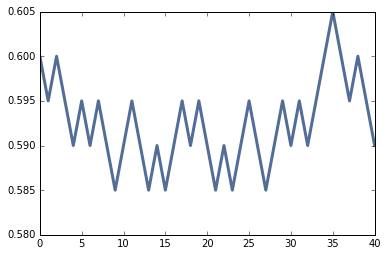

In [33]:
%time ps = find_critical(n=200, iters=40)
thinkplot.plot(ps)
np.mean(ps)

[[ 5 11 10 ..., 11 11  5]
 [ 7  6  8 ...,  6  7  7]
 [ 1  3  3 ...,  3  3  1]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [11  6 16 ..., 10 11 11]
 [ 1  7  3 ...,  7  7  1]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [11 10 16 ..., 10 15 11]
 [ 5  7 11 ..., 11  7  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 11 ..., 11 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 11 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 11 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 

[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 

[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 

[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 

[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 

[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 

[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 

 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ..., 

[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 

[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 

[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 

[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 15 15  5]
 [15 10 20 ..., 10 15 15]
 [ 5 15 15 ..., 15 15  5]
 ..., 
 [ 2  3  2 ...,  4  2  1]
 [ 2  2  3 ...,  2  2  1]
 [ 2  2  1 ...,  2  1  0]]
[[ 5 15 10 ..., 

[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 

[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 

[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 

[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 

[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 

[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 

[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 

[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 

[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 

 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ..., 

[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 

[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 10 10 10]
 [15 20 15 ..., 11 10 10]
 [15 20 20 ...,  1  6 10]
 ..., 
 [ 1  2  2 ...,  1  3  2]
 [ 2  0  2 ...,  4  3  2]
 [ 0  2  0 ...,  2  2  2]]
[[10 15 15 ..., 

[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 

[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 

[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 

[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 

[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 

[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 

[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 

[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 

 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ..., 

[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 

[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 

[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 

[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 

[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 

[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 

[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 15 10 10]
 [15 20 15 ..., 10 16  5]
 [10 20 15 ..., 16  0  6]
 ..., 
 [ 3  2  2 ...,  1  1  2]
 [ 2  3  3 ...,  1  2  1]
 [ 2  2  2 ...,  2  1  1]]
[[10 15 15 ..., 

[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 

[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 

[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 

[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 

[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 

[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 

[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 

[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 

[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 

[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 

[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 

[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 

[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 20 10]
 [15 10 15 ..., 10 10 15]
 ..., 
 [ 3  2  1 ...,  4  2  2]
 [ 3  2  2 ...,  2  3  2]
 [ 1  2  1 ...,  2  2  1]]
[[10 15 10 ..., 

[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 

[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 

[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 

[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 

[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 

[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 

[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 

[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 

 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ..., 

[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 

[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 

[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 

[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 

[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 10 15  5]
 [10 10 15 ..., 15 10 10]
 [ 6 10 10 ..., 10 10  5]
 ..., 
 [ 3  2  3 ...,  1  3  0]
 [ 1  2  2 ...,  3  1  2]
 [ 1  1  0 ...,  1  2  0]]
[[ 5 15 10 ..., 

[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5  6 11 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5  6 11 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5  6 11 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5  6 11 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5  6 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 

[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 

[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 

[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 

[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 

[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 

[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 

[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 

[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 

[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 

[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 

[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 15 10  5]
 [10 15 10 ..., 15 10  5]
 [ 5 10 15 ..., 10 10  5]
 ..., 
 [ 1  3  1 ...,  2  3  2]
 [ 2  1  4 ...,  3  2  1]
 [ 1  2  1 ...,  0  1  1]]
[[10 10 15 ..., 

[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 15 20 10]
 [10 15 15 ..., 20 15 10]
 ..., 
 [ 1  1  1 ...,  1  4  2]
 [ 1  1  0 ...,  3  1  3]
 [ 1  1  1 ...,  0  3  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 15 20 10]
 [10 15 15 ..., 20 15 10]
 ..., 
 [ 1  1  1 ...,  1  4  2]
 [ 1  1  0 ...,  3  1  3]
 [ 1  1  1 ...,  0  3  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 15 20 10]
 [10 15 15 ..., 20 15 10]
 ..., 
 [ 1  1  1 ...,  1  4  2]
 [ 1  1  0 ...,  3  1  3]
 [ 1  1  1 ...,  0  3  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 15 20 10]
 [10 15 15 ..., 20 15 10]
 ..., 
 [ 1  1  1 ...,  1  4  2]
 [ 1  1  0 ...,  3  1  3]
 [ 1  1  1 ...,  0  3  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 15 20 10]
 [10 15 15 ..., 20 15 10]
 ..., 
 [ 1  1  1 ...,  1  4  2]
 [ 1  1  0 ...,  3  1  3]
 [ 1  1  1 ...,  0  3  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 15 20 10]
 [10 15 15 ..., 20 15 10]
 ..., 
 [ 1  1  1 ...,  1  4  2]
 [ 1  1  0 ...,  3  1  3]
 [ 1  1  1 ...,  0  3  1]]
[[10 15 15 ..., 

[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 15 20 10]
 [10 15 15 ..., 20 15 10]
 ..., 
 [ 1  1  1 ...,  1  4  2]
 [ 1  1  0 ...,  3  1  3]
 [ 1  1  1 ...,  0  3  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 15 20 10]
 [10 15 15 ..., 20 15 10]
 ..., 
 [ 1  1  1 ...,  1  4  2]
 [ 1  1  0 ...,  3  1  3]
 [ 1  1  1 ...,  0  3  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 15 20 10]
 [10 15 15 ..., 20 15 10]
 ..., 
 [ 1  1  1 ...,  1  4  2]
 [ 1  1  0 ...,  3  1  3]
 [ 1  1  1 ...,  0  3  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 15 20 10]
 [10 15 15 ..., 20 15 10]
 ..., 
 [ 1  1  1 ...,  1  4  2]
 [ 1  1  0 ...,  3  1  3]
 [ 1  1  1 ...,  0  3  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 15 20 10]
 [10 15 15 ..., 20 15 10]
 ..., 
 [ 1  1  1 ...,  1  4  2]
 [ 1  1  0 ...,  3  1  3]
 [ 1  1  1 ...,  0  3  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 15 20 10]
 [10 15 15 ..., 20 15 10]
 ..., 
 [ 1  1  1 ...,  1  4  2]
 [ 1  1  0 ...,  3  1  3]
 [ 1  1  1 ...,  0  3  1]]
[[10 15 15 ..., 

[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 15 20 10]
 [10 15 15 ..., 20 15 10]
 ..., 
 [ 1  1  1 ...,  1  4  2]
 [ 1  1  0 ...,  3  1  3]
 [ 1  1  1 ...,  0  3  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 15 20 10]
 [10 15 15 ..., 20 15 10]
 ..., 
 [ 1  1  1 ...,  1  4  2]
 [ 1  1  0 ...,  3  1  3]
 [ 1  1  1 ...,  0  3  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 15 20 10]
 [10 15 15 ..., 20 15 10]
 ..., 
 [ 1  1  1 ...,  1  4  2]
 [ 1  1  0 ...,  3  1  3]
 [ 1  1  1 ...,  0  3  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 15 20 10]
 [10 15 15 ..., 20 15 10]
 ..., 
 [ 1  1  1 ...,  1  4  2]
 [ 1  1  0 ...,  3  1  3]
 [ 1  1  1 ...,  0  3  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 15 20 10]
 [10 15 15 ..., 20 15 10]
 ..., 
 [ 1  1  1 ...,  1  4  2]
 [ 1  1  0 ...,  3  1  3]
 [ 1  1  1 ...,  0  3  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 15 20 10]
 [10 15 15 ..., 20 15 10]
 ..., 
 [ 1  1  1 ...,  1  4  2]
 [ 1  1  0 ...,  3  1  3]
 [ 1  1  1 ...,  0  3  1]]
[[10 15 15 ..., 

[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 15 20 10]
 [10 15 15 ..., 20 15 10]
 ..., 
 [ 1  1  1 ...,  1  4  2]
 [ 1  1  0 ...,  3  1  3]
 [ 1  1  1 ...,  0  3  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 15 20 10]
 [10 15 15 ..., 20 15 10]
 ..., 
 [ 1  1  1 ...,  1  4  2]
 [ 1  1  0 ...,  3  1  3]
 [ 1  1  1 ...,  0  3  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 15 20 10]
 [10 15 15 ..., 20 15 10]
 ..., 
 [ 1  1  1 ...,  1  4  2]
 [ 1  1  0 ...,  3  1  3]
 [ 1  1  1 ...,  0  3  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 15 20 10]
 [10 15 15 ..., 20 15 10]
 ..., 
 [ 1  1  1 ...,  1  4  2]
 [ 1  1  0 ...,  3  1  3]
 [ 1  1  1 ...,  0  3  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 15 20 10]
 [10 15 15 ..., 20 15 10]
 ..., 
 [ 1  1  1 ...,  1  4  2]
 [ 1  1  0 ...,  3  1  3]
 [ 1  1  1 ...,  0  3  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 15 20 10]
 [10 15 15 ..., 20 15 10]
 ..., 
 [ 1  1  1 ...,  1  4  2]
 [ 1  1  0 ...,  3  1  3]
 [ 1  1  1 ...,  0  3  1]]
[[10 15 15 ..., 

[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 15 20 10]
 [10 15 15 ..., 20 15 10]
 ..., 
 [ 1  1  1 ...,  1  4  2]
 [ 1  1  0 ...,  3  1  3]
 [ 1  1  1 ...,  0  3  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 15 20 10]
 [10 15 15 ..., 20 15 10]
 ..., 
 [ 1  1  1 ...,  1  4  2]
 [ 1  1  0 ...,  3  1  3]
 [ 1  1  1 ...,  0  3  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 15 20 10]
 [10 15 15 ..., 20 15 10]
 ..., 
 [ 1  1  1 ...,  1  4  2]
 [ 1  1  0 ...,  3  1  3]
 [ 1  1  1 ...,  0  3  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 15 20 10]
 [10 15 15 ..., 20 15 10]
 ..., 
 [ 1  1  1 ...,  1  4  2]
 [ 1  1  0 ...,  3  1  3]
 [ 1  1  1 ...,  0  3  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 15 20 10]
 [10 15 15 ..., 20 15 10]
 ..., 
 [ 1  1  1 ...,  1  4  2]
 [ 1  1  0 ...,  3  1  3]
 [ 1  1  1 ...,  0  3  1]]
[[10 15 15 ..., 15 15 10]
 [15 20 15 ..., 15 20 10]
 [10 15 15 ..., 20 15 10]
 ..., 
 [ 1  1  1 ...,  1  4  2]
 [ 1  1  0 ...,  3  1  3]
 [ 1  1  1 ...,  0  3  1]]
[[10 15 15 ..., 

[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 

[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 

[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 

[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 

[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 

[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 

[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 

 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ..., 

[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 

[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 

[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 10 15 10]
 [10 10  5 ..., 11 10 15]
 [ 5  5  1 ...,  0 11 10]
 ..., 
 [ 1  4  1 ...,  3  2  1]
 [ 3  2  3 ...,  1  1  3]
 [ 2  3  2 ...,  1  2  0]]
[[10 10 10 ..., 

[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 

[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 

[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 

[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 

[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 

[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 

[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 

[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 

[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 

[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 

[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 15 10 10]
 [10 20 15 ..., 10 15 10]
 [10 10 15 ..., 10 15  5]
 ..., 
 [ 1  3  2 ...,  1  1  1]
 [ 2  2  3 ...,  1  1  1]
 [ 1  2  2 ...,  1  1  1]]
[[10 10 15 ..., 

[[10 15 10 ..., 15 15 10]
 [10 15 15 ..., 20 20 10]
 [10  5 15 ..., 15 10 11]
 ..., 
 [ 1  4  4 ...,  3  3  2]
 [ 3  2  2 ...,  2  2  1]
 [ 0  2  2 ...,  2  1  0]]
[[10 15 10 ..., 15 15 10]
 [10 15 15 ..., 20 20 10]
 [10  5 15 ..., 15 10 11]
 ..., 
 [ 1  4  4 ...,  3  3  2]
 [ 3  2  2 ...,  2  2  1]
 [ 0  2  2 ...,  2  1  0]]
[[10 15 10 ..., 15 15 10]
 [10 15 15 ..., 20 20 10]
 [10  5 15 ..., 15 10 11]
 ..., 
 [ 1  4  4 ...,  3  3  2]
 [ 3  2  2 ...,  2  2  1]
 [ 0  2  2 ...,  2  1  0]]
[[10 15 10 ..., 15 15 10]
 [10 15 15 ..., 20 20 10]
 [10  5 15 ..., 15 10 11]
 ..., 
 [ 1  4  4 ...,  3  3  2]
 [ 3  2  2 ...,  2  2  1]
 [ 0  2  2 ...,  2  1  0]]
[[10 15 10 ..., 15 15 10]
 [10 15 15 ..., 20 20 10]
 [10  5 15 ..., 15 10 11]
 ..., 
 [ 1  4  4 ...,  3  3  2]
 [ 3  2  2 ...,  2  2  1]
 [ 0  2  2 ...,  2  1  0]]
[[10 15 10 ..., 15 15 10]
 [10 15 15 ..., 20 20 10]
 [10  5 15 ..., 15 10 11]
 ..., 
 [ 1  4  4 ...,  3  3  2]
 [ 3  2  2 ...,  2  2  1]
 [ 0  2  2 ...,  2  1  0]]
[[10 15 10 ..., 

[[10 15 10 ..., 15 15 10]
 [10 15 15 ..., 20 20 10]
 [10  5 15 ..., 15 10 11]
 ..., 
 [ 1  4  4 ...,  3  3  2]
 [ 3  2  2 ...,  2  2  1]
 [ 0  2  2 ...,  2  1  0]]
[[10 15 10 ..., 15 15 10]
 [10 15 15 ..., 20 20 10]
 [10  5 15 ..., 15 10 11]
 ..., 
 [ 1  4  4 ...,  3  3  2]
 [ 3  2  2 ...,  2  2  1]
 [ 0  2  2 ...,  2  1  0]]
[[10 15 10 ..., 15 15 10]
 [10 15 15 ..., 20 20 10]
 [10  5 15 ..., 15 10 11]
 ..., 
 [ 1  4  4 ...,  3  3  2]
 [ 3  2  2 ...,  2  2  1]
 [ 0  2  2 ...,  2  1  0]]
[[10 15 10 ..., 15 15 10]
 [10 15 15 ..., 20 20 10]
 [10  5 15 ..., 15 10 11]
 ..., 
 [ 1  4  4 ...,  3  3  2]
 [ 3  2  2 ...,  2  2  1]
 [ 0  2  2 ...,  2  1  0]]
[[10 15 10 ..., 15 15 10]
 [10 15 15 ..., 20 20 10]
 [10  5 15 ..., 15 10 11]
 ..., 
 [ 1  4  4 ...,  3  3  2]
 [ 3  2  2 ...,  2  2  1]
 [ 0  2  2 ...,  2  1  0]]
[[10 15 10 ..., 15 15 10]
 [10 15 15 ..., 20 20 10]
 [10  5 15 ..., 15 10 11]
 ..., 
 [ 1  4  4 ...,  3  3  2]
 [ 3  2  2 ...,  2  2  1]
 [ 0  2  2 ...,  2  1  0]]
[[10 15 10 ..., 

[[10 15 10 ..., 15 15 10]
 [10 15 15 ..., 20 20 10]
 [10  5 15 ..., 15 10 11]
 ..., 
 [ 1  4  4 ...,  3  3  2]
 [ 3  2  2 ...,  2  2  1]
 [ 0  2  2 ...,  2  1  0]]
[[10 15 10 ..., 15 15 10]
 [10 15 15 ..., 20 20 10]
 [10  5 15 ..., 15 10 11]
 ..., 
 [ 1  4  4 ...,  3  3  2]
 [ 3  2  2 ...,  2  2  1]
 [ 0  2  2 ...,  2  1  0]]
[[10 15 10 ..., 15 15 10]
 [10 15 15 ..., 20 20 10]
 [10  5 15 ..., 15 10 11]
 ..., 
 [ 1  4  4 ...,  3  3  2]
 [ 3  2  2 ...,  2  2  1]
 [ 0  2  2 ...,  2  1  0]]
[[10 15 10 ..., 15 15 10]
 [10 15 15 ..., 20 20 10]
 [10  5 15 ..., 15 10 11]
 ..., 
 [ 1  4  4 ...,  3  3  2]
 [ 3  2  2 ...,  2  2  1]
 [ 0  2  2 ...,  2  1  0]]
[[10 15 10 ..., 15 15 10]
 [10 15 15 ..., 20 20 10]
 [10  5 15 ..., 15 10 11]
 ..., 
 [ 1  4  4 ...,  3  3  2]
 [ 3  2  2 ...,  2  2  1]
 [ 0  2  2 ...,  2  1  0]]
[[10 15 10 ..., 15 15 10]
 [10 15 15 ..., 20 20 10]
 [10  5 15 ..., 15 10 11]
 ..., 
 [ 1  4  4 ...,  3  3  2]
 [ 3  2  2 ...,  2  2  1]
 [ 0  2  2 ...,  2  1  0]]
[[10 15 10 ..., 

[[10 15 10 ..., 15 15 10]
 [10 15 15 ..., 20 20 10]
 [10  5 15 ..., 15 10 11]
 ..., 
 [ 1  4  4 ...,  3  3  2]
 [ 3  2  2 ...,  2  2  1]
 [ 0  2  2 ...,  2  1  0]]
[[10 15 10 ..., 15 15 10]
 [10 15 15 ..., 20 20 10]
 [10  5 15 ..., 15 10 11]
 ..., 
 [ 1  4  4 ...,  3  3  2]
 [ 3  2  2 ...,  2  2  1]
 [ 0  2  2 ...,  2  1  0]]
[[10 15 10 ..., 15 15 10]
 [10 15 15 ..., 20 20 10]
 [10  5 15 ..., 15 10 11]
 ..., 
 [ 1  4  4 ...,  3  3  2]
 [ 3  2  2 ...,  2  2  1]
 [ 0  2  2 ...,  2  1  0]]
[[10 15 10 ..., 15 15 10]
 [10 15 15 ..., 20 20 10]
 [10  5 15 ..., 15 10 11]
 ..., 
 [ 1  4  4 ...,  3  3  2]
 [ 3  2  2 ...,  2  2  1]
 [ 0  2  2 ...,  2  1  0]]
[[10 15 10 ..., 15 15 10]
 [10 15 15 ..., 20 20 10]
 [10  5 15 ..., 15 10 11]
 ..., 
 [ 1  4  4 ...,  3  3  2]
 [ 3  2  2 ...,  2  2  1]
 [ 0  2  2 ...,  2  1  0]]
[[10 15 10 ..., 15 15 10]
 [10 15 15 ..., 20 20 10]
 [10  5 15 ..., 15 10 11]
 ..., 
 [ 1  4  4 ...,  3  3  2]
 [ 3  2  2 ...,  2  2  1]
 [ 0  2  2 ...,  2  1  0]]
[[10 15 10 ..., 

[[10 15 10 ..., 15 15 10]
 [10 15 15 ..., 20 20 10]
 [10  5 15 ..., 15 10 11]
 ..., 
 [ 1  4  4 ...,  3  3  2]
 [ 3  2  2 ...,  2  2  1]
 [ 0  2  2 ...,  2  1  0]]
[[10 15 10 ..., 15 15 10]
 [10 15 15 ..., 20 20 10]
 [10  5 15 ..., 15 10 11]
 ..., 
 [ 1  4  4 ...,  3  3  2]
 [ 3  2  2 ...,  2  2  1]
 [ 0  2  2 ...,  2  1  0]]
[[10 15 10 ..., 15 15 10]
 [10 15 15 ..., 20 20 10]
 [10  5 15 ..., 15 10 11]
 ..., 
 [ 1  4  4 ...,  3  3  2]
 [ 3  2  2 ...,  2  2  1]
 [ 0  2  2 ...,  2  1  0]]
[[10 15 10 ..., 15 15 10]
 [10 15 15 ..., 20 20 10]
 [10  5 15 ..., 15 10 11]
 ..., 
 [ 1  4  4 ...,  3  3  2]
 [ 3  2  2 ...,  2  2  1]
 [ 0  2  2 ...,  2  1  0]]
[[10 15 10 ..., 15 15 10]
 [10 15 15 ..., 20 20 10]
 [10  5 15 ..., 15 10 11]
 ..., 
 [ 1  4  4 ...,  3  3  2]
 [ 3  2  2 ...,  2  2  1]
 [ 0  2  2 ...,  2  1  0]]
[[10 15 10 ..., 15 15 10]
 [10 15 15 ..., 20 20 10]
 [10  5 15 ..., 15 10 11]
 ..., 
 [ 1  4  4 ...,  3  3  2]
 [ 3  2  2 ...,  2  2  1]
 [ 0  2  2 ...,  2  1  0]]
[[10 15 10 ..., 

0.591

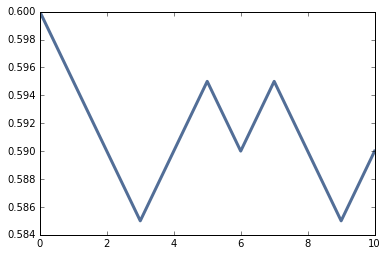

In [34]:
%time ps = find_critical(n=400, iters=10)
thinkplot.plot(ps)
np.mean(ps)

## Fractals

Near the critical point, the cluster of wet cells forms a fractal.  We can see that visually in these examples:

[[ 6 11 10 ..., 11 10  6]
 [ 7  7  7 ...,  6  7  6]
 [ 3  4  3 ...,  2  2  2]
 ..., 
 [ 3  3  4 ...,  4  2  2]
 [ 2  4  4 ...,  3  3  2]
 [ 2  3  3 ...,  2  3  1]]
[[10 15 10 ..., 15 10 10]
 [11 11 11 ..., 10 15  6]
 [ 7  8  3 ...,  6  2  6]
 ..., 
 [ 3  3  4 ...,  4  2  2]
 [ 2  4  4 ...,  3  3  2]
 [ 2  3  3 ...,  2  3  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 11 ..., 10 15 10]
 [11 12  7 ...,  6  6  6]
 ..., 
 [ 3  3  4 ...,  4  2  2]
 [ 2  4  4 ...,  3  3  2]
 [ 2  3  3 ...,  2  3  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 15 10]
 [15 20 11 ...,  6  6 10]
 ..., 
 [ 3  3  4 ...,  4  2  2]
 [ 2  4  4 ...,  3  3  2]
 [ 2  3  3 ...,  2  3  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 15 10]
 [15 20 15 ...,  6 10 10]
 ..., 
 [ 3  3  4 ...,  4  2  2]
 [ 2  4  4 ...,  3  3  2]
 [ 2  3  3 ...,  2  3  1]]
[[10 15 10 ..., 15 10 10]
 [15 15 15 ..., 10 15 10]
 [15 20 15 ..., 10 10 10]
 ..., 
 [ 3  3  4 ...,  4  2  2]
 [ 2  4  4 ...,  3  3  2]
 [ 2  3  3 ...,  2  3  1]]
[[10 15 10 ..., 

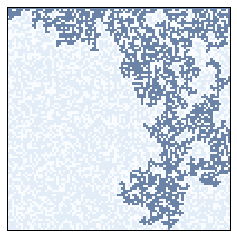

In [35]:
seed = 22
perc1 = Percolation(100, p=0.6, seed=seed)
flag, num_steps = test_perc(perc1)
print(flag, num_steps)
viewer = PercolationViewer(perc1)
viewer.draw()

[[ 6 11 11 ..., 11 11  6]
 [ 6  8  8 ...,  7  7  7]
 [ 2  2  3 ...,  2  2  2]
 ..., 
 [ 1  2  3 ...,  2  4  1]
 [ 0  2  3 ...,  4  2  2]
 [ 0  1  1 ...,  1  2  1]]
[[10 15 15 ..., 15 15 10]
 [10 16 16 ..., 15 15 11]
 [ 6  6  7 ...,  6  6  6]
 ..., 
 [ 1  2  3 ...,  2  4  1]
 [ 0  2  3 ...,  4  2  2]
 [ 0  1  1 ...,  1  2  1]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 15 15]
 [10 10 11 ...,  6 10  6]
 ..., 
 [ 1  2  3 ...,  2  4  1]
 [ 0  2  3 ...,  4  2  2]
 [ 0  1  1 ...,  1  2  1]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 15 15]
 [10 10 15 ...,  6 10 10]
 ..., 
 [ 1  2  3 ...,  2  4  1]
 [ 0  2  3 ...,  4  2  2]
 [ 0  1  1 ...,  1  2  1]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 15 15]
 [10 10 15 ...,  6 10 10]
 ..., 
 [ 1  2  3 ...,  2  4  1]
 [ 0  2  3 ...,  4  2  2]
 [ 0  1  1 ...,  1  2  1]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 15 15]
 [10 10 15 ...,  6 10 10]
 ..., 
 [ 1  2  3 ...,  2  4  1]
 [ 0  2  3 ...,  4  2  2]
 [ 0  1  1 ...,  1  2  1]]
[[10 15 15 ..., 

[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 15 15]
 [10 10 15 ..., 10 10 10]
 ..., 
 [ 1  2  3 ...,  2  4  1]
 [ 0  2  3 ...,  4  2  2]
 [ 0  1  1 ...,  1  2  1]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 15 15]
 [10 10 15 ..., 10 10 10]
 ..., 
 [ 1  2  3 ...,  2  4  1]
 [ 0  2  3 ...,  4  2  2]
 [ 0  1  1 ...,  1  2  1]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 15 15]
 [10 10 15 ..., 10 10 10]
 ..., 
 [ 1  2  3 ...,  2  4  1]
 [ 0  2  3 ...,  4  2  2]
 [ 0  1  1 ...,  1  2  1]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 15 15]
 [10 10 15 ..., 10 10 10]
 ..., 
 [ 1  2  3 ...,  2  4  1]
 [ 0  2  3 ...,  4  2  2]
 [ 0  1  1 ...,  1  2  1]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 15 15]
 [10 10 15 ..., 10 10 10]
 ..., 
 [ 1  2  3 ...,  2  4  1]
 [ 0  2  3 ...,  4  2  2]
 [ 0  1  1 ...,  1  2  1]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 15 15]
 [10 10 15 ..., 10 10 10]
 ..., 
 [ 1  2  3 ...,  2  4  1]
 [ 0  2  3 ...,  4  2  2]
 [ 0  1  1 ...,  1  2  1]]
[[10 15 15 ..., 

[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 15 15]
 [10 10 15 ..., 10 10 10]
 ..., 
 [ 1  2  3 ...,  2  4  1]
 [ 0  2  3 ...,  4  2  2]
 [ 0  1  1 ...,  1  2  1]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 15 15]
 [10 10 15 ..., 10 10 10]
 ..., 
 [ 1  2  3 ...,  2  4  1]
 [ 0  2  3 ...,  4  2  2]
 [ 0  1  1 ...,  1  2  1]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 15 15]
 [10 10 15 ..., 10 10 10]
 ..., 
 [ 1  2  3 ...,  2  4  1]
 [ 0  2  3 ...,  4  2  2]
 [ 0  1  1 ...,  1  2  1]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 15 15]
 [10 10 15 ..., 10 10 10]
 ..., 
 [ 1  2  3 ...,  2  4  1]
 [ 0  2  3 ...,  4  2  2]
 [ 0  1  1 ...,  1  2  1]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 15 15]
 [10 10 15 ..., 10 10 10]
 ..., 
 [ 1  2  3 ...,  2  4  1]
 [ 0  2  3 ...,  4  2  2]
 [ 0  1  1 ...,  1  2  1]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 15 15]
 [10 10 15 ..., 10 10 10]
 ..., 
 [ 1  2  3 ...,  2  4  1]
 [ 0  2  3 ...,  4  2  2]
 [ 0  1  1 ...,  1  2  1]]
[[10 15 15 ..., 

[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 15 15]
 [10 10 15 ..., 10 10 10]
 ..., 
 [ 1  2  3 ...,  2  4  1]
 [ 0  2  3 ...,  4  2  2]
 [ 0  1  1 ...,  1  2  1]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 15 15]
 [10 10 15 ..., 10 10 10]
 ..., 
 [ 1  2  3 ...,  2  4  1]
 [ 0  2  3 ...,  4  2  2]
 [ 0  1  1 ...,  1  2  1]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 15 15]
 [10 10 15 ..., 10 10 10]
 ..., 
 [ 1  2  3 ...,  2  4  1]
 [ 0  2  3 ...,  4  2  2]
 [ 0  1  1 ...,  1  2  1]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 15 15]
 [10 10 15 ..., 10 10 10]
 ..., 
 [ 1  2  3 ...,  2  4  1]
 [ 0  2  3 ...,  4  2  2]
 [ 0  1  1 ...,  1  2  1]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 15 15]
 [10 10 15 ..., 10 10 10]
 ..., 
 [ 1  2  3 ...,  2  4  1]
 [ 0  2  3 ...,  4  2  2]
 [ 0  1  1 ...,  1  2  1]]
[[10 15 15 ..., 15 15 10]
 [10 20 20 ..., 15 15 15]
 [10 10 15 ..., 10 10 10]
 ..., 
 [ 1  2  3 ...,  2  4  1]
 [ 0  2  3 ...,  4  2  2]
 [ 0  1  1 ...,  1  2  1]]
[[10 15 15 ..., 

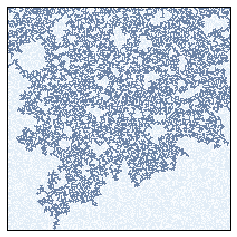

In [36]:
seed = 22
perc2 = Percolation(200, p=0.6, seed=seed)
flag, num_steps = test_perc(perc2)
print(flag, num_steps)
viewer2 = PercolationViewer(perc2)
viewer2.draw()

[[ 6 11 11 ..., 10 10  6]
 [ 6  7  8 ...,  6  7  6]
 [ 2  3  2 ...,  2  3  2]
 ..., 
 [ 0  3  2 ...,  4  2  2]
 [ 1  2  3 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 16 ...,  6 11  6]
 [ 6  7  6 ...,  2  3  6]
 ..., 
 [ 0  3  2 ...,  4  2  2]
 [ 1  2  3 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 20 ...,  6 11 10]
 [ 6 11 10 ...,  2  7  6]
 ..., 
 [ 0  3  2 ...,  4  2  2]
 [ 1  2  3 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 20 ...,  6 15 10]
 [ 6 11 10 ...,  6  7 10]
 ..., 
 [ 0  3  2 ...,  4  2  2]
 [ 1  2  3 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 20 ..., 10 15 10]
 [ 6 11 10 ...,  6 15 10]
 ..., 
 [ 0  3  2 ...,  4  2  2]
 [ 1  2  3 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 20 ..., 10 15 10]
 [ 6 11 10 ..., 10 15 10]
 ..., 
 [ 0  3  2 ...,  4  2  2]
 [ 1  2  3 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 15 ..., 

[[10 15 15 ..., 10 10 10]
 [10 15 20 ..., 10 15 10]
 [ 6 11 10 ..., 10 15 10]
 ..., 
 [ 0  3  2 ...,  4  2  2]
 [ 1  2  3 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 20 ..., 10 15 10]
 [ 6 11 10 ..., 10 15 10]
 ..., 
 [ 0  3  2 ...,  4  2  2]
 [ 1  2  3 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 20 ..., 10 15 10]
 [ 6 11 10 ..., 10 15 10]
 ..., 
 [ 0  3  2 ...,  4  2  2]
 [ 1  2  3 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 20 ..., 10 15 10]
 [ 6 11 10 ..., 10 15 10]
 ..., 
 [ 0  3  2 ...,  4  2  2]
 [ 1  2  3 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 20 ..., 10 15 10]
 [ 6 11 10 ..., 10 15 10]
 ..., 
 [ 0  3  2 ...,  4  2  2]
 [ 1  2  3 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 20 ..., 10 15 10]
 [ 6 11 10 ..., 10 15 10]
 ..., 
 [ 0  3  2 ...,  4  2  2]
 [ 1  2  3 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 15 ..., 

[[10 15 15 ..., 10 10 10]
 [10 15 20 ..., 10 15 10]
 [ 6 11 10 ..., 10 15 10]
 ..., 
 [ 0  3  2 ...,  4  2  2]
 [ 1  2  3 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 20 ..., 10 15 10]
 [ 6 11 10 ..., 10 15 10]
 ..., 
 [ 0  3  2 ...,  4  2  2]
 [ 1  2  3 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 20 ..., 10 15 10]
 [ 6 11 10 ..., 10 15 10]
 ..., 
 [ 0  3  2 ...,  4  2  2]
 [ 1  2  3 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 20 ..., 10 15 10]
 [ 6 11 10 ..., 10 15 10]
 ..., 
 [ 0  3  2 ...,  4  2  2]
 [ 1  2  3 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 20 ..., 10 15 10]
 [ 6 11 10 ..., 10 15 10]
 ..., 
 [ 0  3  2 ...,  4  2  2]
 [ 1  2  3 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 20 ..., 10 15 10]
 [ 6 11 10 ..., 10 15 10]
 ..., 
 [ 0  3  2 ...,  4  2  2]
 [ 1  2  3 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 15 ..., 

[[10 15 15 ..., 10 10 10]
 [10 15 20 ..., 10 15 10]
 [ 6 11 10 ..., 10 15 10]
 ..., 
 [ 0  3  2 ...,  4  2  2]
 [ 1  2  3 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 20 ..., 10 15 10]
 [ 6 11 10 ..., 10 15 10]
 ..., 
 [ 0  3  2 ...,  4  2  2]
 [ 1  2  3 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 20 ..., 10 15 10]
 [ 6 11 10 ..., 10 15 10]
 ..., 
 [ 0  3  2 ...,  4  2  2]
 [ 1  2  3 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 20 ..., 10 15 10]
 [ 6 11 10 ..., 10 15 10]
 ..., 
 [ 0  3  2 ...,  4  2  2]
 [ 1  2  3 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 20 ..., 10 15 10]
 [ 6 11 10 ..., 10 15 10]
 ..., 
 [ 0  3  2 ...,  4  2  2]
 [ 1  2  3 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 20 ..., 10 15 10]
 [ 6 11 10 ..., 10 15 10]
 ..., 
 [ 0  3  2 ...,  4  2  2]
 [ 1  2  3 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 15 ..., 

[[10 15 15 ..., 10 10 10]
 [10 15 20 ..., 10 15 10]
 [ 6 11 10 ..., 10 15 10]
 ..., 
 [ 0  3  2 ...,  4  2  2]
 [ 1  2  3 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 20 ..., 10 15 10]
 [ 6 11 10 ..., 10 15 10]
 ..., 
 [ 0  3  2 ...,  4  2  2]
 [ 1  2  3 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 20 ..., 10 15 10]
 [ 6 11 10 ..., 10 15 10]
 ..., 
 [ 0  3  2 ...,  4  2  2]
 [ 1  2  3 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 20 ..., 10 15 10]
 [ 6 11 10 ..., 10 15 10]
 ..., 
 [ 0  3  2 ...,  4  2  2]
 [ 1  2  3 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 20 ..., 10 15 10]
 [ 6 11 10 ..., 10 15 10]
 ..., 
 [ 0  3  2 ...,  4  2  2]
 [ 1  2  3 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 20 ..., 10 15 10]
 [ 6 11 10 ..., 10 15 10]
 ..., 
 [ 0  3  2 ...,  4  2  2]
 [ 1  2  3 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 15 ..., 

[[10 15 15 ..., 10 10 10]
 [10 15 20 ..., 10 15 10]
 [ 6 11 10 ..., 10 15 10]
 ..., 
 [ 0  3  2 ...,  4  2  2]
 [ 1  2  3 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 20 ..., 10 15 10]
 [ 6 11 10 ..., 10 15 10]
 ..., 
 [ 0  3  2 ...,  4  2  2]
 [ 1  2  3 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 20 ..., 10 15 10]
 [ 6 11 10 ..., 10 15 10]
 ..., 
 [ 0  3  2 ...,  4  2  2]
 [ 1  2  3 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 20 ..., 10 15 10]
 [ 6 11 10 ..., 10 15 10]
 ..., 
 [ 0  3  2 ...,  4  2  2]
 [ 1  2  3 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 20 ..., 10 15 10]
 [ 6 11 10 ..., 10 15 10]
 ..., 
 [ 0  3  2 ...,  4  2  2]
 [ 1  2  3 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 20 ..., 10 15 10]
 [ 6 11 10 ..., 10 15 10]
 ..., 
 [ 0  3  2 ...,  4  2  2]
 [ 1  2  3 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 15 ..., 

[[10 15 15 ..., 10 10 10]
 [10 15 20 ..., 10 15 10]
 [ 6 11 10 ..., 10 15 10]
 ..., 
 [ 0  3  2 ...,  4  2  2]
 [ 1  2  3 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 20 ..., 10 15 10]
 [ 6 11 10 ..., 10 15 10]
 ..., 
 [ 0  3  2 ...,  4  2  2]
 [ 1  2  3 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 20 ..., 10 15 10]
 [ 6 11 10 ..., 10 15 10]
 ..., 
 [ 0  3  2 ...,  4  2  2]
 [ 1  2  3 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 20 ..., 10 15 10]
 [ 6 11 10 ..., 10 15 10]
 ..., 
 [ 0  3  2 ...,  4  2  2]
 [ 1  2  3 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 20 ..., 10 15 10]
 [ 6 11 10 ..., 10 15 10]
 ..., 
 [ 0  3  2 ...,  4  2  2]
 [ 1  2  3 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 15 ..., 10 10 10]
 [10 15 20 ..., 10 15 10]
 [ 6 11 10 ..., 10 15 10]
 ..., 
 [ 0  3  2 ...,  4  2  2]
 [ 1  2  3 ...,  3  3  1]
 [ 1  1  3 ...,  3  2  1]]
[[10 15 15 ..., 

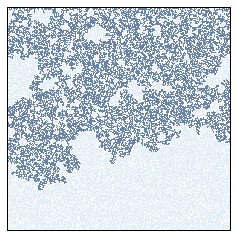

In [37]:
perc3 = Percolation(300, p=0.6, seed=seed)
flag, num_steps = test_perc(perc3)
print(flag, num_steps)
viewer3 = PercolationViewer(perc3)
viewer3.draw()

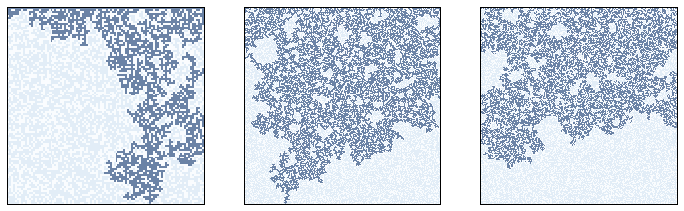

In [38]:
thinkplot.preplot(cols=3)
viewer.draw()

thinkplot.subplot(2)
viewer2.draw()

thinkplot.subplot(3)
viewer3.draw()

plt.savefig('chap07-6.pdf')

To measure fractal dimension, let's start with 1D CAs.

In [39]:
from Cell1D import Cell1D, Cell1DViewer

def draw_ca(rule, n=32):
    ca = Cell1D(rule, n)
    ca.start_single()
    ca.loop(n-1)
    viewer = Cell1DViewer(ca)
    viewer.draw()

Here's one rule that seems clearly 1D, one that is clearly 2D, and one that we can't obviously classify.

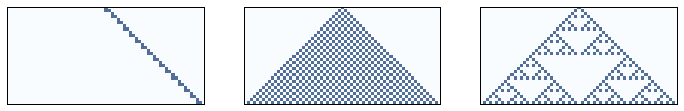

In [40]:
thinkplot.preplot(cols=3)
draw_ca(20)

thinkplot.subplot(2)
draw_ca(50)

thinkplot.subplot(3)
draw_ca(18)

plt.savefig('chap07-7.pdf')

The following function creates a 1D CA and steps through time, counting the number of on cells after each time step.

In [41]:
def count_cells(rule, n=500):
    ca = Cell1D(rule, n)
    ca.start_single()
    
    res = []
    for i in range(1, n):
        cells = np.sum(ca.array)
        res.append((i, i**2, cells))
        ca.step()
        
    return res

This function plots the results, comparing the rate of cell growth to `size` and `size**2`.

And it uses linregress to estimate the slope of the line on a log-log scale.

In [42]:
from scipy.stats import linregress

def test_fractal(rule, ylabel=''):
    res = count_cells(rule)
    steps, steps2, cells = zip(*res)

    thinkplot.plot(steps, steps2, label='d=2', linestyle='dashed')
    thinkplot.plot(steps, cells, label='rule=%d' % rule)
    thinkplot.plot(steps, steps, label='d=1', linestyle='dashed')

    thinkplot.config(xscale='log', yscale='log',
                     xlabel='time steps', ylabel=ylabel,
                     xlim=[1, 600], loc='upper left')

    for ys in [cells]:
        params = linregress(np.log(steps), np.log(ys))
        print(params[0])

The linear rule has dimension close to 1.

1.0079212646


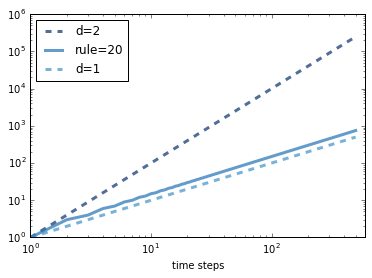

In [43]:
test_fractal(20)

The triangular rule has dimension close to 2.

1.97128088363


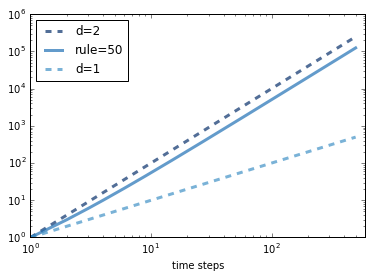

In [44]:
test_fractal(50)

And the Sierpinski triangle has fractal dimension approximately 1.57

1.57392944118


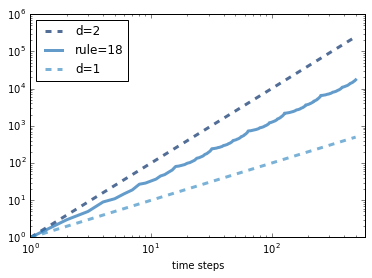

In [45]:
test_fractal(18)

1.0079212646
1.97128088363
1.57392944118


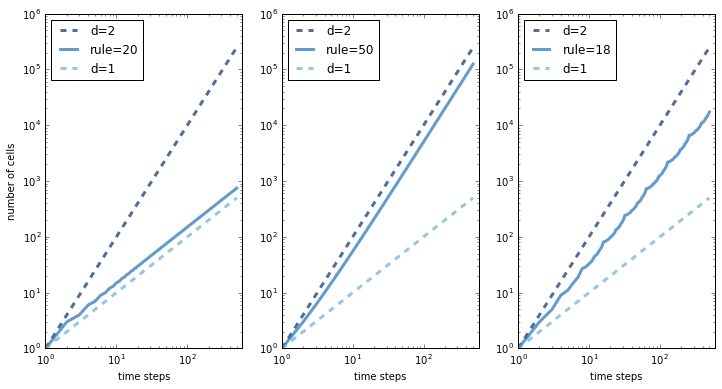

In [46]:
thinkplot.preplot(num=3, cols=3)
test_fractal(20, ylabel='number of cells')

thinkplot.subplot(2)
thinkplot.preplot(num=3)
test_fractal(50)

thinkplot.subplot(3)
thinkplot.preplot(num=3)
test_fractal(18)

plt.savefig('chap07-8.pdf')

Mathematically, the fractal dimension is supposed to be:

In [47]:
np.log(3) / np.log(2)

1.585

## Fractals in percolation models

We can measure the fractal dimension of a percolation model by measuring how the number of wet cells scales as we increase the size of a bounding box.

The following function takes a percolation model that has run to completion.  It computes bounding boxes with sizes from 10 up to `n-1`, positioned in the center of the array.

For each bounding box it counts the number of wet cells.

In [48]:
from scipy.stats import linregress

def plot_perc_scaling(sizes, p):
    res = []
    
    for size in sizes:
        perc = Percolation(size, p=p)
        flag, _ = test_perc(perc)
        if flag:
            num_filled = perc.num_wet() - size
            res.append((size, size**2, num_filled))
        
    sizes, cells, filled = zip(*res)
    
    thinkplot.plot(sizes, cells, label='d=2')
    thinkplot.plot(sizes, filled, label='filled', style='.')
    thinkplot.plot(sizes, sizes, label='d=1')
    
    thinkplot.config(xlabel='size',
                    ylabel='cell count',
                    xscale='log', xlim=[9, 110], 
                    yscale='log', ylim=[9, 20000],
                    loc='top left')
    
    for ys in [cells, filled, sizes]:
        params = linregress(np.log(sizes), np.log(ys))
        print(params[0])

If we plot the number of cells versus the size of the box on a log-log scale, the slope is the fractal dimension.

When `p` is near the critical point, the fractal dimension of the wet cells is near 1.85, but it varies from one run to the next.

[[ 5 11 10 11 10 10 10 11 10  6]
 [ 7  6  8  5  7  5  6  6  8  6]
 [ 2  3  2  4  1  1  1  2  3  3]
 [ 1  3  2  3  2  1  0  3  3  3]
 [ 2  0  3  2  3  1  1  2  4  3]
 [ 0  3  2  4  3  1  3  3  4  3]
 [ 3  1  4  4  3  3  2  3  4  3]
 [ 1  4  2  3  3  2  2  4  2  2]
 [ 3  1  2  2  1  3  2  2  3  2]
 [ 1  2  0  0  2  0  3  2  2  1]]
[[ 5 15 10 15 10 10 10 15 10 10]
 [11  6 16  5 11  5 10  6 16  6]
 [ 2  7  2  8  1  1  1  6  3  7]
 [ 1  3  2  3  2  1  0  3  3  3]
 [ 2  0  3  2  3  1  1  2  4  3]
 [ 0  3  2  4  3  1  3  3  4  3]
 [ 3  1  4  4  3  3  2  3  4  3]
 [ 1  4  2  3  3  2  2  4  2  2]
 [ 3  1  2  2  1  3  2  2  3  2]
 [ 1  2  0  0  2  0  3  2  2  1]]
[[ 5 15 10 15 10 10 10 15 10 10]
 [11 10 16  5 11  5 10 10 16 10]
 [ 6  7  6  8  1  1  5  6 11  7]
 [ 1  7  2  3  2  1  0  7  3  7]
 [ 2  0  3  2  3  1  1  2  4  3]
 [ 0  3  2  4  3  1  3  3  4  3]
 [ 3  1  4  4  3  3  2  3  4  3]
 [ 1  4  2  3  3  2  2  4  2  2]
 [ 3  1  2  2  1  3  2  2  3  2]
 [ 1  2  0  0  2  0  3  2  2  1]]
[[ 5 15

[[ 5 10 15 10 10 10 15 15 10 10 15 10 10 15 15 10 15 10 10 15  5]
 [ 6 10 10 15  5 15 15 15 15 15 10 15 15 15 15 15 10 15 15 10 10]
 [ 1  7 10 10 15  5 15 20 10 10 15 10 10 20 15 15 15 15 10 15 10]
 [ 3  1 16 15  5 10 15 10 15  5  6  5 15 15 20 15 20 10 20 15  5]
 [ 1 12 10 15 15  5 10 20 10  6  5 11  5 20 20 20 15 20  5 10 11]
 [11 10 20 20 10 15 15 20 10 15 11 10 20 15 15 20 15 10 15 11  5]
 [ 6 20 20 20 20 15 20 10 16  6 20 20 15 15 20 10 20 15 10 15  7]
 [10 12 15 15 20 20 15 11  2 11 11 20 15 20 15 20 15 10 16  6 11]
 [ 3  6  7 11 11 16 15  7  1  2 10  6 15 10 15 15 10 11  1  8  2]
 [ 2  4  3  3  8 11  7  6  3  1  1  5  2  5  6  6  6  2  2  3  3]
 [ 2  4  3  3  3  2  6  2  2  1  2  3  1  2  1  3  3  1  4  2  2]
 [ 2  2  2  3  2  1  1  2  1  3  1  3  3  1  2  3  3  3  1  3  2]
 [ 2  1  2  1  2  2  2  2  2  1  4  2  2  2  2  3  3  2  3  2  2]
 [ 1  2  1  2  1  1  3  3  3  2  1  2  3  2  3  4  2  3  2  3  2]
 [ 1  3  1  2  2  1  3  3  2  2  1  2  2  4  3  3  3  1  3  2  2]
 [ 3  0  3

   1  3  0]]
[[10 10 15 15 10 15 15 15 15 15 15 15 10 10 10 10 15 10 10 15 15 10 15 10
  15 10  5]
 [ 5 20 15 10 20 10 20 20 15 20 20 15 10  5 10 10  5 11 10 15 15 20  5 20
   5 15  5]
 [15 10 15 20  5 20 10 15 20 15 20 15 10 10  5  5  6  0  7 10 20  5 20  5
  20  5 10]
 [ 5 15 15 10 20 10 15 15 15 15 20 20 10 15 15 10  5  7  0 16 10 20 10 15
  10 20  5]
 [ 6  6  5 10 10 15 15 15 15 20 15 10 15 10 20 15 15  5 16 10 20 15 15 15
  10 10 15]
 [ 2  2  1  0 11 10 15 15 20 10 15 10  0 10 15 20 15 15 10 20 20 15 15 10
  10 10  5]
 [ 3  3  2  1  1 11 10 20 10 20  5  6  0  5 10 20 15 15 10 20 15 15 10 10
   5  5  6]
 [ 2  4  2  3  2  6 10 15 15 10 16  0  6  5 15 15 20 10 20 10 20  5 10  5
   6  1  0]
 [ 3  3  4  3  3  2 11  5 15 15  5 16  5 10 15 20 20 15 10 20  5 11  0  7
   0  1  1]
 [ 2  3  4  3  4  3  1  6 10 10 20  5 15 15 15 15 10 16 10  6 12  1  3  0
   3  0  0]
 [ 1  3  1  3  3  2  2 10 10 20 10 20 10 15 15 10  7  0  7  6  3  3  1  4
   1  1  0]
 [ 2  0  2  2  2  3  6  5 15 15 15 10 20 

[[ 5 15 10 15 15 10 15 10 15 10 15 15 15 10 10 15 10 15 15 10 15 10 15 10
  15 10 15 15 15 10 10]
 [10 10 20 15 10 20 10 15 10 15 15 15 10 15 10 10 15 10 10 15  5 20 10 20
   5 20 15 20 15 20  5]
 [ 5 15 15 15 15 10 10 15 10 15  5 10 15  5 15 10 10 10 10  0 10 10 20  5
  20  5 20 20 15 10 10]
 [ 5 10 20 15 15  5 15 10 15  5 11  6  5 20 15 20 15 10 10  5 10 15 10 15
   5 20 15 10 15 10 10]
 [ 5 15 15 20 10 15 10 10 10  7  1  2 11 15 20 15 10 20 10 10 10 15 10 10
  15 15 10 10  5 10  5]
 [10 10 15 20 20 15 10 15  6  1  4  2  6 10 15 15 15 10 15 10 10 10 10 10
  15 15 10  0  0  6  6]
 [10 15 10 15 20 15 15 10 11  2  3  2  2 11 10 10 10 15 15  5  6  6  6  5
  15 10 10  0  2  1  2]
 [10 10 11 10 15 10 15 15  5  8  1  4  2  1  6  6  5 10 10  6  2  2  2  7
   6 10 10  6  1  4  2]
 [10  6  5  7  6 15 10 15 16  0  4  2  3  3  1  0  2  5 10  7  2  4  3  2
   2 16 10 11  2  2  3]
 [ 1  6  2  2  6  6 15 20 10  8  2  3  4  2  2  2  0  6  7  6  4  2  3  4
   7  7 15  5  6  2  1]
 [ 2  1  2  2  2  5 

[[10 10 15 ..., 15 15 10]
 [ 5 15 10 ..., 10 15 15]
 [10  5 15 ..., 15 10 10]
 ..., 
 [ 0  1  3 ...,  3  1  2]
 [ 0  1  1 ...,  2  2  1]
 [ 0  0  1 ...,  2  1  1]]
[[10 10 15 ..., 15 15 10]
 [ 5 15 10 ..., 10 15 15]
 [10  5 15 ..., 15 10 10]
 ..., 
 [ 0  1  3 ...,  3  1  2]
 [ 0  1  1 ...,  2  2  1]
 [ 0  0  1 ...,  2  1  1]]
[[10 10 15 ..., 15 15 10]
 [ 5 15 10 ..., 10 15 15]
 [10  5 15 ..., 15 10 10]
 ..., 
 [ 0  1  3 ...,  3  1  2]
 [ 0  1  1 ...,  2  2  1]
 [ 0  0  1 ...,  2  1  1]]
[[10 10 15 ..., 15 15 10]
 [ 5 15 10 ..., 10 15 15]
 [10  5 15 ..., 15 10 10]
 ..., 
 [ 0  1  3 ...,  3  1  2]
 [ 0  1  1 ...,  2  2  1]
 [ 0  0  1 ...,  2  1  1]]
[[10 10 15 ..., 15 15 10]
 [ 5 15 10 ..., 10 15 15]
 [10  5 15 ..., 15 10 10]
 ..., 
 [ 0  1  3 ...,  3  1  2]
 [ 0  1  1 ...,  2  2  1]
 [ 0  0  1 ...,  2  1  1]]
[[10 10 15 ..., 15 15 10]
 [ 5 15 10 ..., 10 15 15]
 [10  5 15 ..., 15 10 10]
 ..., 
 [ 0  1  3 ...,  3  1  2]
 [ 0  1  1 ...,  2  2  1]
 [ 0  0  1 ...,  2  1  1]]
[[10 10 15 ..., 

[[10 15 10 ..., 15 10 10]
 [10 15 10 ..., 15 20 10]
 [10 10 10 ..., 20 10 15]
 ..., 
 [ 2  2  3 ...,  2  2  1]
 [ 1  2  3 ...,  2  1  2]
 [ 1  1  0 ...,  1  2  1]]
[[10 15 10 ..., 15 10 10]
 [10 15 10 ..., 15 20 10]
 [10 10 10 ..., 20 10 15]
 ..., 
 [ 2  2  3 ...,  2  2  1]
 [ 1  2  3 ...,  2  1  2]
 [ 1  1  0 ...,  1  2  1]]
[[10 15 10 ..., 15 10 10]
 [10 15 10 ..., 15 20 10]
 [10 10 10 ..., 20 10 15]
 ..., 
 [ 2  2  3 ...,  2  2  1]
 [ 1  2  3 ...,  2  1  2]
 [ 1  1  0 ...,  1  2  1]]
[[10 15 10 ..., 15 10 10]
 [10 15 10 ..., 15 20 10]
 [10 10 10 ..., 20 10 15]
 ..., 
 [ 2  2  3 ...,  2  2  1]
 [ 1  2  3 ...,  2  1  2]
 [ 1  1  0 ...,  1  2  1]]
[[10 15 10 ..., 15 10 10]
 [10 15 10 ..., 15 20 10]
 [10 10 10 ..., 20 10 15]
 ..., 
 [ 2  2  3 ...,  2  2  1]
 [ 1  2  3 ...,  2  1  2]
 [ 1  1  0 ...,  1  2  1]]
[[10 15 10 ..., 15 10 10]
 [10 15 10 ..., 15 20 10]
 [10 10 10 ..., 20 10 15]
 ..., 
 [ 2  2  3 ...,  2  2  1]
 [ 1  2  3 ...,  2  1  2]
 [ 1  1  0 ...,  1  2  1]]
[[10 15 10 ..., 

[[10 15 15 ..., 10 15 10]
 [10 20 20 ..., 20 10 10]
 [10 10 15 ..., 10 15 10]
 ..., 
 [ 2  3  2 ...,  2  3  2]
 [ 2  2  2 ...,  3  1  3]
 [ 2  2  2 ...,  1  3  0]]
[[10 15 15 ..., 10 15 10]
 [10 20 20 ..., 20 10 10]
 [10 10 15 ..., 10 15 10]
 ..., 
 [ 2  3  2 ...,  2  3  2]
 [ 2  2  2 ...,  3  1  3]
 [ 2  2  2 ...,  1  3  0]]
[[10 15 15 ..., 10 15 10]
 [10 20 20 ..., 20 10 10]
 [10 10 15 ..., 10 15 10]
 ..., 
 [ 2  3  2 ...,  2  3  2]
 [ 2  2  2 ...,  3  1  3]
 [ 2  2  2 ...,  1  3  0]]
[[10 15 15 ..., 10 15 10]
 [10 20 20 ..., 20 10 10]
 [10 10 15 ..., 10 15 10]
 ..., 
 [ 2  3  2 ...,  2  3  2]
 [ 2  2  2 ...,  3  1  3]
 [ 2  2  2 ...,  1  3  0]]
[[10 15 15 ..., 10 15 10]
 [10 20 20 ..., 20 10 10]
 [10 10 15 ..., 10 15 10]
 ..., 
 [ 2  3  2 ...,  2  3  2]
 [ 2  2  2 ...,  3  1  3]
 [ 2  2  2 ...,  1  3  0]]
[[10 15 15 ..., 10 15 10]
 [10 20 20 ..., 20 10 10]
 [10 10 15 ..., 10 15 10]
 ..., 
 [ 2  3  2 ...,  2  3  2]
 [ 2  2  2 ...,  3  1  3]
 [ 2  2  2 ...,  1  3  0]]
[[10 15 15 ..., 

[[ 5 10 15 ..., 15 15  5]
 [ 6 11 15 ..., 20 15 10]
 [ 2  7  6 ..., 16 11  6]
 ..., 
 [ 1  0  2 ...,  1  1  1]
 [ 1  1  1 ...,  3  1  1]
 [ 0  2  2 ...,  1  2  1]]
[[ 5 10 15 ..., 15 15  5]
 [ 6 15 15 ..., 20 15 10]
 [ 6  7 10 ..., 20 15  6]
 ..., 
 [ 1  0  2 ...,  1  1  1]
 [ 1  1  1 ...,  3  1  1]
 [ 0  2  2 ...,  1  2  1]]
[[ 5 10 15 ..., 15 15  5]
 [10 15 15 ..., 20 15 10]
 [ 6 15 10 ..., 20 15 10]
 ..., 
 [ 1  0  2 ...,  1  1  1]
 [ 1  1  1 ...,  3  1  1]
 [ 0  2  2 ...,  1  2  1]]
[[ 5 10 15 ..., 15 15  5]
 [10 15 15 ..., 20 15 10]
 [10 15 10 ..., 20 15 10]
 ..., 
 [ 1  0  2 ...,  1  1  1]
 [ 1  1  1 ...,  3  1  1]
 [ 0  2  2 ...,  1  2  1]]
[[ 5 10 15 ..., 15 15  5]
 [10 15 15 ..., 20 15 10]
 [10 15 10 ..., 20 15 10]
 ..., 
 [ 1  0  2 ...,  1  1  1]
 [ 1  1  1 ...,  3  1  1]
 [ 0  2  2 ...,  1  2  1]]
[[ 5 10 15 ..., 15 15  5]
 [10 15 15 ..., 20 15 10]
 [10 15 10 ..., 20 15 10]
 ..., 
 [ 1  0  2 ...,  1  1  1]
 [ 1  1  1 ...,  3  1  1]
 [ 0  2  2 ...,  1  2  1]]
[[ 5 10 15 ..., 

[[10 15 10 ..., 15 15  5]
 [15 10 16 ..., 15 15 10]
 [ 5 12  1 ..., 20 15  5]
 ..., 
 [ 0  2  2 ...,  2  1  3]
 [ 2  1  1 ...,  2  4  1]
 [ 0  1  2 ...,  2  2  2]]
[[10 15 10 ..., 15 15  5]
 [15 10 16 ..., 15 15 10]
 [ 5 12  1 ..., 20 15  5]
 ..., 
 [ 0  2  2 ...,  2  1  3]
 [ 2  1  1 ...,  2  4  1]
 [ 0  1  2 ...,  2  2  2]]
[[10 15 10 ..., 15 15  5]
 [15 10 16 ..., 15 15 10]
 [ 5 12  1 ..., 20 15  5]
 ..., 
 [ 0  2  2 ...,  2  1  3]
 [ 2  1  1 ...,  2  4  1]
 [ 0  1  2 ...,  2  2  2]]
[[10 15 10 ..., 15 15  5]
 [15 10 16 ..., 15 15 10]
 [ 5 12  1 ..., 20 15  5]
 ..., 
 [ 0  2  2 ...,  2  1  3]
 [ 2  1  1 ...,  2  4  1]
 [ 0  1  2 ...,  2  2  2]]
[[10 15 10 ..., 15 15  5]
 [15 10 16 ..., 15 15 10]
 [ 5 12  1 ..., 20 15  5]
 ..., 
 [ 0  2  2 ...,  2  1  3]
 [ 2  1  1 ...,  2  4  1]
 [ 0  1  2 ...,  2  2  2]]
[[10 15 10 ..., 15 15  5]
 [15 10 16 ..., 15 15 10]
 [ 5 12  1 ..., 20 15  5]
 ..., 
 [ 0  2  2 ...,  2  1  3]
 [ 2  1  1 ...,  2  4  1]
 [ 0  1  2 ...,  2  2  2]]
[[10 15 10 ..., 

 [ 0  2  1 ...,  3  2  1]]
[[ 5 15 10 ..., 15 10 10]
 [11  5 15 ..., 15 20 10]
 [ 1 12  5 ..., 20 10 15]
 ..., 
 [ 1  4  1 ...,  4  3  1]
 [ 3  1  2 ...,  3  3  2]
 [ 0  2  1 ...,  3  2  1]]
[[ 5 15 10 ..., 15 10 10]
 [11  5 15 ..., 15 20 10]
 [ 1 12  5 ..., 20 10 15]
 ..., 
 [ 1  4  1 ...,  4  3  1]
 [ 3  1  2 ...,  3  3  2]
 [ 0  2  1 ...,  3  2  1]]
[[ 5 15 10 ..., 15 10 10]
 [11  5 15 ..., 15 20 10]
 [ 1 12  5 ..., 20 10 15]
 ..., 
 [ 1  4  1 ...,  4  3  1]
 [ 3  1  2 ...,  3  3  2]
 [ 0  2  1 ...,  3  2  1]]
[[ 5 15 10 ..., 15 10 10]
 [11  5 15 ..., 15 20 10]
 [ 1 12  5 ..., 20 10 15]
 ..., 
 [ 1  4  1 ...,  4  3  1]
 [ 3  1  2 ...,  3  3  2]
 [ 0  2  1 ...,  3  2  1]]
[[ 5 15 10 ..., 15 10 10]
 [11  5 15 ..., 15 20 10]
 [ 1 12  5 ..., 20 10 15]
 ..., 
 [ 1  4  1 ...,  4  3  1]
 [ 3  1  2 ...,  3  3  2]
 [ 0  2  1 ...,  3  2  1]]
[[ 5 15 10 ..., 15 10 10]
 [11  5 15 ..., 15 20 10]
 [ 1 12  5 ..., 20 10 15]
 ..., 
 [ 1  4  1 ...,  4  3  1]
 [ 3  1  2 ...,  3  3  2]
 [ 0  2  1 ..., 

 [ 1  1  2 ...,  3  2  2]]
[[10 10 10 ..., 15 15 10]
 [10 15 10 ..., 15 15 10]
 [15 15 15 ..., 10  6  5]
 ..., 
 [ 1  0  2 ...,  3  3  2]
 [ 1  2  0 ...,  2  4  3]
 [ 1  1  2 ...,  3  2  2]]
[[10 10 10 ..., 15 15 10]
 [10 15 10 ..., 15 15 10]
 [15 15 15 ..., 10  6  5]
 ..., 
 [ 1  0  2 ...,  3  3  2]
 [ 1  2  0 ...,  2  4  3]
 [ 1  1  2 ...,  3  2  2]]
[[10 10 10 ..., 15 15 10]
 [10 15 10 ..., 15 15 10]
 [15 15 15 ..., 10  6  5]
 ..., 
 [ 1  0  2 ...,  3  3  2]
 [ 1  2  0 ...,  2  4  3]
 [ 1  1  2 ...,  3  2  2]]
[[10 10 10 ..., 15 15 10]
 [10 15 10 ..., 15 15 10]
 [15 15 15 ..., 10  6  5]
 ..., 
 [ 1  0  2 ...,  3  3  2]
 [ 1  2  0 ...,  2  4  3]
 [ 1  1  2 ...,  3  2  2]]
[[10 10 10 ..., 15 15 10]
 [10 15 10 ..., 15 15 10]
 [15 15 15 ..., 10  6  5]
 ..., 
 [ 1  0  2 ...,  3  3  2]
 [ 1  2  0 ...,  2  4  3]
 [ 1  1  2 ...,  3  2  2]]
[[10 10 10 ..., 15 15 10]
 [10 15 10 ..., 15 15 10]
 [15 15 15 ..., 10  6  5]
 ..., 
 [ 1  0  2 ...,  3  3  2]
 [ 1  2  0 ...,  2  4  3]
 [ 1  1  2 ..., 

[[10 15 15 ..., 10 15 10]
 [10 20 15 ..., 15 15 15]
 [10 10 15 ..., 15 15 15]
 ..., 
 [ 0  3  3 ...,  2  3  2]
 [ 3  1  4 ...,  3  2  1]
 [ 0  3  2 ...,  2  2  0]]
[[10 15 15 ..., 10 15 10]
 [10 20 15 ..., 15 15 15]
 [10 10 15 ..., 15 15 15]
 ..., 
 [ 0  3  3 ...,  2  3  2]
 [ 3  1  4 ...,  3  2  1]
 [ 0  3  2 ...,  2  2  0]]
[[10 15 15 ..., 10 15 10]
 [10 20 15 ..., 15 15 15]
 [10 10 15 ..., 15 15 15]
 ..., 
 [ 0  3  3 ...,  2  3  2]
 [ 3  1  4 ...,  3  2  1]
 [ 0  3  2 ...,  2  2  0]]
[[10 15 15 ..., 10 15 10]
 [10 20 15 ..., 15 15 15]
 [10 10 15 ..., 15 15 15]
 ..., 
 [ 0  3  3 ...,  2  3  2]
 [ 3  1  4 ...,  3  2  1]
 [ 0  3  2 ...,  2  2  0]]
[[10 15 15 ..., 10 15 10]
 [10 20 15 ..., 15 15 15]
 [10 10 15 ..., 15 15 15]
 ..., 
 [ 0  3  3 ...,  2  3  2]
 [ 3  1  4 ...,  3  2  1]
 [ 0  3  2 ...,  2  2  0]]
[[10 15 15 ..., 10 15 10]
 [10 20 15 ..., 15 15 15]
 [10 10 15 ..., 15 15 15]
 ..., 
 [ 0  3  3 ...,  2  3  2]
 [ 3  1  4 ...,  3  2  1]
 [ 0  3  2 ...,  2  2  0]]
[[10 15 15 ..., 

[[10 15 15 ..., 15 10  5]
 [15 15 15 ..., 15 10  6]
 [ 5 15  5 ...,  5  6  1]
 ..., 
 [ 2  3  2 ...,  4  3  1]
 [ 2  1  2 ...,  3  2  2]
 [ 0  1  1 ...,  1  2  0]]
[[10 15 15 ..., 15 10  5]
 [15 15 15 ..., 15 10  6]
 [ 5 15  5 ...,  5  6  1]
 ..., 
 [ 2  3  2 ...,  4  3  1]
 [ 2  1  2 ...,  3  2  2]
 [ 0  1  1 ...,  1  2  0]]
[[10 15 15 ..., 15 10  5]
 [15 15 15 ..., 15 10  6]
 [ 5 15  5 ...,  5  6  1]
 ..., 
 [ 2  3  2 ...,  4  3  1]
 [ 2  1  2 ...,  3  2  2]
 [ 0  1  1 ...,  1  2  0]]
[[10 15 15 ..., 15 10  5]
 [15 15 15 ..., 15 10  6]
 [ 5 15  5 ...,  5  6  1]
 ..., 
 [ 2  3  2 ...,  4  3  1]
 [ 2  1  2 ...,  3  2  2]
 [ 0  1  1 ...,  1  2  0]]
[[10 15 15 ..., 15 10  5]
 [15 15 15 ..., 15 10  6]
 [ 5 15  5 ...,  5  6  1]
 ..., 
 [ 2  3  2 ...,  4  3  1]
 [ 2  1  2 ...,  3  2  2]
 [ 0  1  1 ...,  1  2  0]]
[[10 15 15 ..., 15 10  5]
 [15 15 15 ..., 15 10  6]
 [ 5 15  5 ...,  5  6  1]
 ..., 
 [ 2  3  2 ...,  4  3  1]
 [ 2  1  2 ...,  3  2  2]
 [ 0  1  1 ...,  1  2  0]]
[[10 15 15 ..., 

 [ 2  2  1 ...,  0  2  1]]
[[ 5 10 15 ..., 15 15  5]
 [ 6 10 10 ..., 15 15 10]
 [ 0  2 11 ..., 10 15 10]
 ..., 
 [ 3  3  3 ...,  2  2  2]
 [ 2  3  3 ...,  2  1  3]
 [ 2  2  1 ...,  0  2  1]]
[[ 5 10 15 ..., 15 15  5]
 [ 6 10 10 ..., 15 15 10]
 [ 0  2 11 ..., 10 15 10]
 ..., 
 [ 3  3  3 ...,  2  2  2]
 [ 2  3  3 ...,  2  1  3]
 [ 2  2  1 ...,  0  2  1]]
[[ 5 10 15 ..., 15 15  5]
 [ 6 10 10 ..., 15 15 10]
 [ 0  2 11 ..., 10 15 10]
 ..., 
 [ 3  3  3 ...,  2  2  2]
 [ 2  3  3 ...,  2  1  3]
 [ 2  2  1 ...,  0  2  1]]
[[ 5 10 15 ..., 15 15  5]
 [ 6 10 10 ..., 15 15 10]
 [ 0  2 11 ..., 10 15 10]
 ..., 
 [ 3  3  3 ...,  2  2  2]
 [ 2  3  3 ...,  2  1  3]
 [ 2  2  1 ...,  0  2  1]]
[[ 5 10 15 ..., 15 15  5]
 [ 6 10 10 ..., 15 15 10]
 [ 0  2 11 ..., 10 15 10]
 ..., 
 [ 3  3  3 ...,  2  2  2]
 [ 2  3  3 ...,  2  1  3]
 [ 2  2  1 ...,  0  2  1]]
[[ 5 10 15 ..., 15 15  5]
 [ 6 10 10 ..., 15 15 10]
 [ 0  2 11 ..., 10 15 10]
 ..., 
 [ 3  3  3 ...,  2  2  2]
 [ 2  3  3 ...,  2  1  3]
 [ 2  2  1 ..., 

[[10 10 10 ..., 10 10 10]
 [10 10 15 ...,  6 10 10]
 [ 5 15 10 ...,  1  6 10]
 ..., 
 [ 2  1  1 ...,  4  1  3]
 [ 1  2  2 ...,  3  4  1]
 [ 1  1  1 ...,  2  2  2]]
[[10 10 10 ..., 10 10 10]
 [10 10 15 ...,  6 10 10]
 [ 5 15 10 ...,  1  6 10]
 ..., 
 [ 2  1  1 ...,  4  1  3]
 [ 1  2  2 ...,  3  4  1]
 [ 1  1  1 ...,  2  2  2]]
[[10 10 10 ..., 10 10 10]
 [10 10 15 ...,  6 10 10]
 [ 5 15 10 ...,  1  6 10]
 ..., 
 [ 2  1  1 ...,  4  1  3]
 [ 1  2  2 ...,  3  4  1]
 [ 1  1  1 ...,  2  2  2]]
[[10 10 10 ..., 10 10 10]
 [10 10 15 ...,  6 10 10]
 [ 5 15 10 ...,  1  6 10]
 ..., 
 [ 2  1  1 ...,  4  1  3]
 [ 1  2  2 ...,  3  4  1]
 [ 1  1  1 ...,  2  2  2]]
[[10 10 10 ..., 10 10 10]
 [10 10 15 ...,  6 10 10]
 [ 5 15 10 ...,  1  6 10]
 ..., 
 [ 2  1  1 ...,  4  1  3]
 [ 1  2  2 ...,  3  4  1]
 [ 1  1  1 ...,  2  2  2]]
[[10 10 10 ..., 10 10 10]
 [10 10 15 ...,  6 10 10]
 [ 5 15 10 ...,  1  6 10]
 ..., 
 [ 2  1  1 ...,  4  1  3]
 [ 1  2  2 ...,  3  4  1]
 [ 1  1  1 ...,  2  2  2]]
[[10 10 10 ..., 

[[ 5 10 10 ..., 15 10  5]
 [ 5  5 10 ..., 10 11  5]
 [ 1  6  6 ..., 16  0  2]
 ..., 
 [ 1  1  2 ...,  1  3  2]
 [ 0  1  1 ...,  4  2  3]
 [ 1  0  1 ...,  1  3  2]]
[[ 5 10 10 ..., 15 10  5]
 [ 5  5 10 ..., 10 11  5]
 [ 1  6 10 ..., 16  0  2]
 ..., 
 [ 1  1  2 ...,  1  3  2]
 [ 0  1  1 ...,  4  2  3]
 [ 1  0  1 ...,  1  3  2]]
[[ 5 10 10 ..., 15 10  5]
 [ 5  5 10 ..., 10 11  5]
 [ 1 10 10 ..., 16  0  2]
 ..., 
 [ 1  1  2 ...,  1  3  2]
 [ 0  1  1 ...,  4  2  3]
 [ 1  0  1 ...,  1  3  2]]
[[ 5 10 10 ..., 15 10  5]
 [ 5  5 10 ..., 10 11  5]
 [ 5 10 10 ..., 16  0  2]
 ..., 
 [ 1  1  2 ...,  1  3  2]
 [ 0  1  1 ...,  4  2  3]
 [ 1  0  1 ...,  1  3  2]]
[[ 5 10 10 ..., 15 10  5]
 [ 5  5 10 ..., 10 11  5]
 [ 5 10 10 ..., 16  0  2]
 ..., 
 [ 1  1  2 ...,  1  3  2]
 [ 0  1  1 ...,  4  2  3]
 [ 1  0  1 ...,  1  3  2]]
[[ 5 10 10 ..., 15 10  5]
 [ 5  5 10 ..., 10 11  5]
 [ 5 10 10 ..., 16  0  2]
 ..., 
 [ 1  1  2 ...,  1  3  2]
 [ 0  1  1 ...,  4  2  3]
 [ 1  0  1 ...,  1  3  2]]
[[ 5 10 10 ..., 

 [ 2  3  3 ...,  3  3  2]]
[[10 15 15 ..., 10 10 10]
 [15 15 15 ..., 10 15 10]
 [ 5 10 10 ..., 10 10 10]
 ..., 
 [ 2  3  4 ...,  2  3  2]
 [ 3  4  4 ...,  2  3  3]
 [ 2  3  3 ...,  3  3  2]]
[[10 15 15 ..., 10 10 10]
 [15 15 15 ..., 10 15 10]
 [ 5 10 10 ..., 10 10 10]
 ..., 
 [ 2  3  4 ...,  2  3  2]
 [ 3  4  4 ...,  2  3  3]
 [ 2  3  3 ...,  3  3  2]]
[[10 15 15 ..., 10 10 10]
 [15 15 15 ..., 10 15 10]
 [ 5 10 10 ..., 10 10 10]
 ..., 
 [ 2  3  4 ...,  2  3  2]
 [ 3  4  4 ...,  2  3  3]
 [ 2  3  3 ...,  3  3  2]]
[[10 15 15 ..., 10 10 10]
 [15 15 15 ..., 10 15 10]
 [ 5 10 10 ..., 10 10 10]
 ..., 
 [ 2  3  4 ...,  2  3  2]
 [ 3  4  4 ...,  2  3  3]
 [ 2  3  3 ...,  3  3  2]]
[[10 15 15 ..., 10 10 10]
 [15 15 15 ..., 10 15 10]
 [ 5 10 10 ..., 10 10 10]
 ..., 
 [ 2  3  4 ...,  2  3  2]
 [ 3  4  4 ...,  2  3  3]
 [ 2  3  3 ...,  3  3  2]]
[[10 15 15 ..., 10 10 10]
 [15 15 15 ..., 10 15 10]
 [ 5 10 10 ..., 10 10 10]
 ..., 
 [ 2  3  4 ...,  2  3  2]
 [ 3  4  4 ...,  2  3  3]
 [ 2  3  3 ..., 

[[ 5 10 10 ..., 15 15 10]
 [ 6  5  6 ..., 16 16 11]
 [ 0  3  2 ...,  7  7  7]
 ..., 
 [ 1  3  2 ...,  4  3  3]
 [ 3  3  3 ...,  2  4  2]
 [ 2  3  3 ...,  2  2  2]]
[[ 5 10 10 ..., 15 15 10]
 [ 6  5  6 ..., 20 20 15]
 [ 0  3  2 ..., 11 15 11]
 ..., 
 [ 1  3  2 ...,  4  3  3]
 [ 3  3  3 ...,  2  4  2]
 [ 2  3  3 ...,  2  2  2]]
[[ 5 10 10 ..., 15 15 10]
 [ 6  5  6 ..., 20 20 15]
 [ 0  3  2 ..., 15 15 15]
 ..., 
 [ 1  3  2 ...,  4  3  3]
 [ 3  3  3 ...,  2  4  2]
 [ 2  3  3 ...,  2  2  2]]
[[ 5 10 10 ..., 15 15 10]
 [ 6  5  6 ..., 20 20 15]
 [ 0  3  2 ..., 15 15 15]
 ..., 
 [ 1  3  2 ...,  4  3  3]
 [ 3  3  3 ...,  2  4  2]
 [ 2  3  3 ...,  2  2  2]]
[[ 5 10 10 ..., 15 15 10]
 [ 6  5  6 ..., 20 20 15]
 [ 0  3  2 ..., 15 15 15]
 ..., 
 [ 1  3  2 ...,  4  3  3]
 [ 3  3  3 ...,  2  4  2]
 [ 2  3  3 ...,  2  2  2]]
[[ 5 10 10 ..., 15 15 10]
 [ 6  5  6 ..., 20 20 15]
 [ 0  3  2 ..., 15 15 15]
 ..., 
 [ 1  3  2 ...,  4  3  3]
 [ 3  3  3 ...,  2  4  2]
 [ 2  3  3 ...,  2  2  2]]
[[ 5 10 10 ..., 

[[10 10 15 ..., 15 10  5]
 [ 5 16  5 ..., 10 11  5]
 [ 6  0 11 ..., 11  1  2]
 ..., 
 [ 3  2  4 ...,  3  3  2]
 [ 1  4  2 ...,  3  4  2]
 [ 2  2  3 ...,  3  2  2]]
[[10 10 15 ..., 15 10  5]
 [ 5 16  5 ..., 10 11  5]
 [ 6  0 11 ..., 11  1  2]
 ..., 
 [ 3  2  4 ...,  3  3  2]
 [ 1  4  2 ...,  3  4  2]
 [ 2  2  3 ...,  3  2  2]]
[[10 10 15 ..., 15 10  5]
 [ 5 16  5 ..., 10 11  5]
 [ 6  0 11 ..., 11  1  2]
 ..., 
 [ 3  2  4 ...,  3  3  2]
 [ 1  4  2 ...,  3  4  2]
 [ 2  2  3 ...,  3  2  2]]
[[10 10 15 ..., 15 10  5]
 [ 5 16  5 ..., 10 11  5]
 [ 6  0 11 ..., 11  1  2]
 ..., 
 [ 3  2  4 ...,  3  3  2]
 [ 1  4  2 ...,  3  4  2]
 [ 2  2  3 ...,  3  2  2]]
[[10 10 15 ..., 15 10  5]
 [ 5 16  5 ..., 10 11  5]
 [ 6  0 11 ..., 11  1  2]
 ..., 
 [ 3  2  4 ...,  3  3  2]
 [ 1  4  2 ...,  3  4  2]
 [ 2  2  3 ...,  3  2  2]]
[[10 10 15 ..., 15 10  5]
 [ 5 16  5 ..., 10 11  5]
 [ 6  0 11 ..., 11  1  2]
 ..., 
 [ 3  2  4 ...,  3  3  2]
 [ 1  4  2 ...,  3  4  2]
 [ 2  2  3 ...,  3  2  2]]
[[10 10 15 ..., 

[[10 10 15 ..., 15 15  5]
 [ 5 16 10 ..., 20 15 15]
 [ 7  0 11 ..., 15 15 10]
 ..., 
 [ 2  1  1 ...,  3  1  0]
 [ 1  3  2 ...,  0  1  1]
 [ 2  2  2 ...,  2  0  0]]
[[10 10 15 ..., 15 15  5]
 [ 5 16 10 ..., 20 15 15]
 [ 7  0 11 ..., 15 15 10]
 ..., 
 [ 2  1  1 ...,  3  1  0]
 [ 1  3  2 ...,  0  1  1]
 [ 2  2  2 ...,  2  0  0]]
[[10 10 15 ..., 15 15  5]
 [ 5 16 10 ..., 20 15 15]
 [ 7  0 11 ..., 15 15 10]
 ..., 
 [ 2  1  1 ...,  3  1  0]
 [ 1  3  2 ...,  0  1  1]
 [ 2  2  2 ...,  2  0  0]]
[[10 10 15 ..., 15 15  5]
 [ 5 16 10 ..., 20 15 15]
 [ 7  0 11 ..., 15 15 10]
 ..., 
 [ 2  1  1 ...,  3  1  0]
 [ 1  3  2 ...,  0  1  1]
 [ 2  2  2 ...,  2  0  0]]
[[10 10 15 ..., 15 15  5]
 [ 5 16 10 ..., 20 15 15]
 [ 7  0 11 ..., 15 15 10]
 ..., 
 [ 2  1  1 ...,  3  1  0]
 [ 1  3  2 ...,  0  1  1]
 [ 2  2  2 ...,  2  0  0]]
[[10 10 15 ..., 15 15  5]
 [ 5 16 10 ..., 20 15 15]
 [ 7  0 11 ..., 15 15 10]
 ..., 
 [ 2  1  1 ...,  3  1  0]
 [ 1  3  2 ...,  0  1  1]
 [ 2  2  2 ...,  2  0  0]]
[[10 10 15 ..., 

[[10 15 15 ..., 10 15  5]
 [10 20 15 ..., 15  5 15]
 [10  5 20 ...,  5 20  5]
 ..., 
 [ 2  1  3 ...,  0  2  1]
 [ 2  2  1 ...,  3  1  2]
 [ 0  1  1 ...,  0  2  1]]
[[10 15 15 ..., 10 15  5]
 [10 20 15 ..., 15  5 15]
 [10  5 20 ...,  5 20  5]
 ..., 
 [ 2  1  3 ...,  0  2  1]
 [ 2  2  1 ...,  3  1  2]
 [ 0  1  1 ...,  0  2  1]]
[[10 15 15 ..., 10 15  5]
 [10 20 15 ..., 15  5 15]
 [10  5 20 ...,  5 20  5]
 ..., 
 [ 2  1  3 ...,  0  2  1]
 [ 2  2  1 ...,  3  1  2]
 [ 0  1  1 ...,  0  2  1]]
[[10 15 15 ..., 10 15  5]
 [10 20 15 ..., 15  5 15]
 [10  5 20 ...,  5 20  5]
 ..., 
 [ 2  1  3 ...,  0  2  1]
 [ 2  2  1 ...,  3  1  2]
 [ 0  1  1 ...,  0  2  1]]
[[10 15 15 ..., 10 15  5]
 [10 20 15 ..., 15  5 15]
 [10  5 20 ...,  5 20  5]
 ..., 
 [ 2  1  3 ...,  0  2  1]
 [ 2  2  1 ...,  3  1  2]
 [ 0  1  1 ...,  0  2  1]]
[[10 15 15 ..., 10 15  5]
 [10 20 15 ..., 15  5 15]
 [10  5 20 ...,  5 20  5]
 ..., 
 [ 2  1  3 ...,  0  2  1]
 [ 2  2  1 ...,  3  1  2]
 [ 0  1  1 ...,  0  2  1]]
[[10 15 15 ..., 

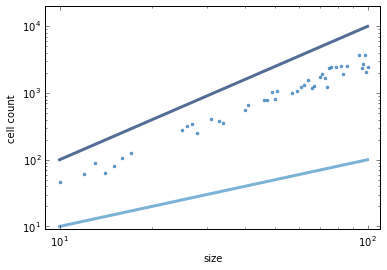

In [49]:
sizes = np.arange(10, 101)
plot_perc_scaling(sizes, p=0.59)

plt.savefig('chap07-9.pdf')

**Exercise:** In Chapter 7 we showed that the Rule 18 CA produces a fractal.
Can you find other rules that produce fractals?  For each one,
estimate its fractal dimension.

Note: the `Cell1D` object in `Cell1D.py` does not wrap around from the left edge to the right, which creates some artifacts at the boundaries.  You might want to use `Wrap1D`, which is a child class of `Cell1D` that wraps around.  It is also defined in `Cell1D.py`.

In [50]:
from Cell1D import Wrap1D, Cell1DViewer

def count_cells(rule, n=500):
    ca = Wrap1D(rule, n)
    ca.start_single()
    res = []
    for i in range(1, n):
        cells = np.sum(ca.array)
        res.append((i, i**2, cells))
        ca.step()
    return res

In [51]:
i_on, i_sq, cells = zip(*count_cells(22))

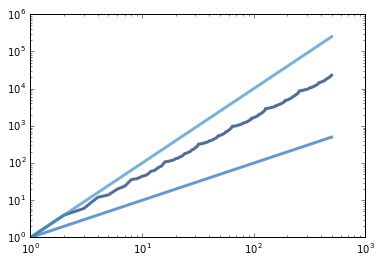

In [52]:
ranges = range(1,500)
thinkplot.plot(ranges, cells, label='cells')
thinkplot.plot(ranges, i_on, label='d=1')
thinkplot.plot(ranges, i_sq, label='d=2')
thinkplot.config(xscale='log',
                 yscale='log',
                 loc='top left')

In [53]:
from scipy.stats import linregress

for i in [cells]:
    lin = linregress(np.log(ranges), np.log(i))
    print(lin[0])

1.57993794937


In [54]:
i_on, i_sq, cells = zip(*count_cells(60))
lin = linregress(np.log(ranges), np.log(cells))
print(lin[0])

1.57392944118


In [55]:
i_on, i_sq, cells = zip(*count_cells(54))
lin = linregress(np.log(ranges), np.log(cells))
print(lin[0])

1.96143233001


There are many rules that produce fractal graphs. I may have looked at different ca graphs and determined if they were fractal before implementing them as rules in order to come up with these specific rules.

**Exercise:** In 1990 Bak, Chen and Tang proposed a cellular automaton that is
an abstract model of a forest fire.  Each cell is in one of three
states: empty, occupied by a tree, or on fire.

The rules of the CA are:

* An empty cell becomes occupied with probability $p$.

* A cell with a tree burns if any of its neighbors
  is on fire.

* A cell with a tree spontaneously burns, with
  probability $f$, even if none of its neighbors is on fire.

* A cell with a burning tree becomes an empty cell in the next
  time step.

Write a
program that implements it.  You might want to inherit from `Cell2D`.
Typical values for the parameters are
$p=0.01$ and $f=0.001$, but you might want to experiment with other
values.

Starting from a random initial condition, run the CA until it reaches
a steady state where the number of trees no longer increases or
decreases consistently.  

In steady state, is the geometry of the forest fractal?
What is its fractal dimension?

In [56]:
from scipy.signal import correlate2d

class Forest_firing(Cell2D):

    kernel = np.array([[0, 1, 0],
                       [1, 11, 1],
                       [0, 1, 0]])

    def __init__(self, n, m=None, p=0.01, f=.001, seed=None):
        """Initializes the attributes.

        n: number of rows
        m: number of columns
        """
        self.p = p
        self.f = f
        m = n if m is None else m
        if seed is not None:
            np.random.seed(seed)
        self.array = np.random.choice([0, 1], (n, m), p = [1-p, p])
        

    def step(self):
        """Executes one time step."""
        a = self.array
        c = correlate2d(a, self.kernel, mode='same', boundary='wrap')
        rg = np.random.random(a.shape)
        tree = (a==0) & (self.p > rg)
        fire = (a==1) & ((c > 4) | (self.f > rg))
        a[a==5] = 0
        a[tree] = 1
        a[fire] = 5
    
    def num_trees(self, i=None):
        a = self.array[:i,:i]
        return np.sum(a==1)
        
    def num_fires(self, i=None):
        a = self.array[:i,:i]
        return np.sum(a==10)
        
        


In [57]:
class ForestViewer(Cell2DViewer):
    cmap = plt.get_cmap('Reds')
    options = dict(alpha=0.6,
                   interpolation='none', 
                   vmin=0, vmax=5)
    

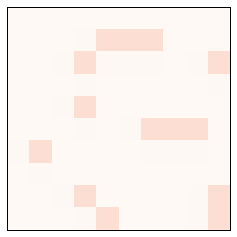

In [58]:
forest = Forest_firing(10,p=.2, f=.1)
viewer = ForestViewer(forest)
anim = viewer.animate(frames=20)

In [59]:
anim

In steady state, is the geometry of the forest fractal? What is its fractal dimension?

In [60]:
def num_on(n=500):
    ca = Forest_firing(n,p=.2, f=.1)
    res = []
    for i in range(100,n):
        #cells = np.sum(ca.array)
        #res.append((i,i**2,cells))
        ca.step()
        res.append([i**2,ca.num_trees(i),ca.num_fires(i)])
    return res


In [61]:
res = num_on()
cells, trees, fires = zip(*res)

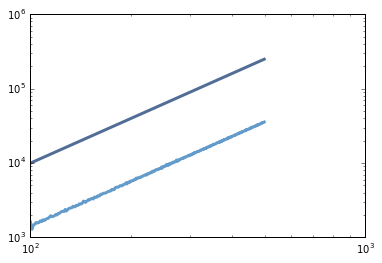

In [62]:
ranges = range(100,500)
thinkplot.plot(ranges, cells, label='cells')
thinkplot.plot(ranges, trees, label='trees')
thinkplot.plot(ranges, fires, label='fires')
thinkplot.config(xscale='log',
                 yscale='log',
                 loc='top left')

In [63]:
from scipy.stats import linregress

for i in [cells,trees]:
    lin = linregress(np.log(ranges), np.log(i))
    print(lin[0])

2.0
2.0006648489


I'm not quite sure if its a fractal dimension, because there was a lot of noise in the beginning of the range, but it seems that it is not considering that the linear regression of the log of the steps and trees is close to two.